In [5]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.offline as pyo
import plotly.graph_objects as go
pyo.init_notebook_mode()
import datetime
from sympy import Point, Line
from sklearn.metrics import r2_score, mean_squared_error
import sys
sys.path.insert(1, '../Scripts')
from funciones import SampleIDD, simbologia, grafico_posicion_section,graficar_sections, graficar_versus_core,graficar_versus_core_rock, graficar2, grafico_edades, grafico_posicion, simbologia_core


from scipy.spatial import ConvexHull, convex_hull_plot_2d
from scatter_hull import ScatterHull

from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from scipy.interpolate import interp1d

In [6]:
sh = ScatterHull()
all_volcanoes = sh.get_all_volcanoes()

In [7]:
all_volcanoes

['Aguilera',
 'Antillanca-Casablanca',
 'Apagado',
 'Caburga-Huelemolle',
 'Calbuco',
 'Carrán-Los Venados',
 'Cay',
 'Chaitén',
 'Corcovado',
 'Cordón Cabrera',
 'Hornopirén',
 'Huanquihue Group',
 'Hudson',
 'Huequi',
 'Lanín',
 'Lautaro',
 'Llaima',
 'Macá',
 'Melimoyu',
 'Mentolat',
 'Michinmahuida',
 'Mocho-Choshuenco',
 'Monte Burney',
 'Osorno',
 'Puyehue-Cordón Caulle',
 'Quetrupillán',
 'Reclus',
 'Sollipulli',
 'Subsidiary Vcha dome',
 'Villarrica',
 'Yanteles',
 'Yate']

In [8]:
#-------------------- Load data
Data = pd.read_excel("../Data/TephraDataBase_normalizado.xlsx")
Data = Data.replace('-',np.nan)
Data = Data.replace('not determined',np.nan)
Data = Data.replace('Not analyzed',np.nan)
Data = Data.replace('n.a.',np.nan)
Data = Data.replace('n.d.',np.nan)
Data = Data.replace('Over range',np.nan)
Data = Data.replace('bdl',np.nan)
Data = Data.replace('<1',np.nan)
Data = Data.replace('<4',np.nan)
Data = Data.replace('<6',np.nan)
Data = Data.replace('<5',np.nan)
Data = Data.replace('<10',np.nan)
Data = Data.replace('<0.01',np.nan)
Data = Data.replace('<0.1',np.nan)
Data.Flag = Data.Flag.astype(str)
Data = Data[(Data.Flag.str.contains('|'.join(['Outlier','VolcanicSource_Issue'])) == False)]
Data = Data[Data.Volcano!='Unknown']

No handles with labels found to put in legend.


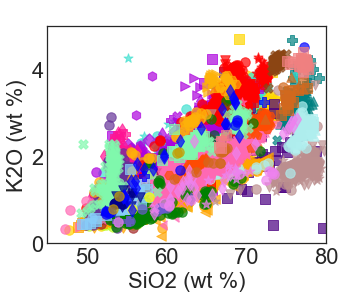

In [9]:
#Plot all data except samples for which the volcano originating the volcanic products is still unknown
graficar_versus_core('SiO2','K2O',Data[Data.Volcano!='Unknown'] ,Xmin=45,Xmax=80,Ymin=0,Ymax=5)

### 1.- Calculate and visualize 'effusive' and 'bulk pyroclastic' products linear regressions (SiO2 versus K2O)

In [10]:
Data = Data.dropna(subset=['SiO2','K2O'],axis=0,how='all')
Data

,Unnamed: 0,Volcano,Event,Vei,Magnitude,SampleID,ISGN,Comments,Location,Latitude,...,Hf,Ta,Pb,Th,U,87Sr_86Sr,2SE_87Sr_86Sr,143Nd_144Nd,2SE_143Nd_144Nd,Map?
4,4,Puyehue-Cordón Caulle,PCC2011,NaN,5.0,PCC-1 (2),NaN,NaN,"Bariloche (BSI), km 7.600",-41.130000,...,5.78,0.44,20.11,5.76,1.54,NaN,NaN,NaN,NaN,NaN
5,5,Puyehue-Cordón Caulle,PCC2011,NaN,5.0,PCC-10 (2),NaN,NaN,Villa Traful,-40.595329,...,8.43,0.62,25.77,8.57,2.28,NaN,NaN,NaN,NaN,NaN
6,6,Puyehue-Cordón Caulle,PCC2011,NaN,5.0,PCC-11 (2),NaN,NaN,"Población Gonález, La Lipela",-40.750952,...,8.99,0.58,27.16,9.08,2.44,NaN,NaN,NaN,NaN,NaN
7,7,Puyehue-Cordón Caulle,PCC2011,NaN,5.0,PCC-12 (2),NaN,NaN,Villa La Angostura (near Las Piedritas),-40.672188,...,8.33,0.55,25.38,8.35,2.24,NaN,NaN,NaN,NaN,NaN
8,8,Puyehue-Cordón Caulle,PCC2011,NaN,5.0,PCC-14 (2),NaN,NaN,Villa La Angostura,-40.672188,...,8.66,0.58,26.07,8.59,2.29,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16730,16730,Mentolat,∼11.7 ka MEN,5.0,5.2,RM,NaN,NaN,Río Maniguales,-45.006567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16731,16731,Mentolat,∼11.7 ka MEN,5.0,5.2,RM,NaN,NaN,Río Maniguales,-45.006567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16732,16732,Mentolat,∼11.7 ka MEN,5.0,5.2,RM,NaN,NaN,Río Maniguales,-45.006567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16733,16733,Mentolat,∼11.7 ka MEN,5.0,5.2,RM,NaN,NaN,Río Maniguales,-45.006567,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

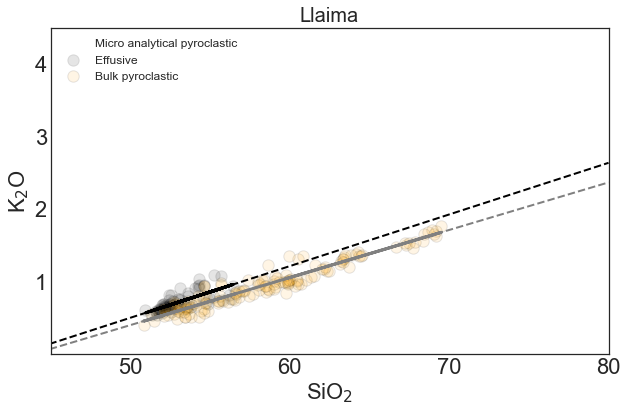

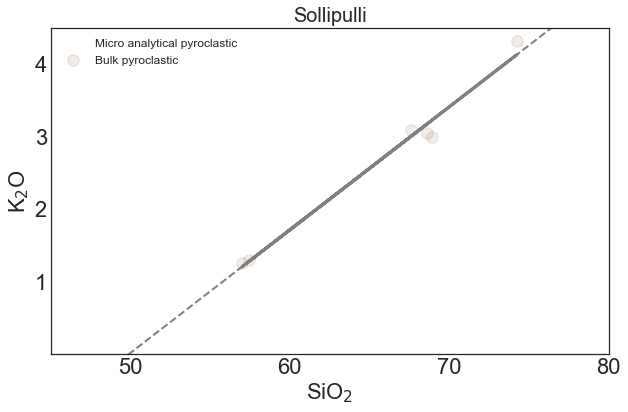

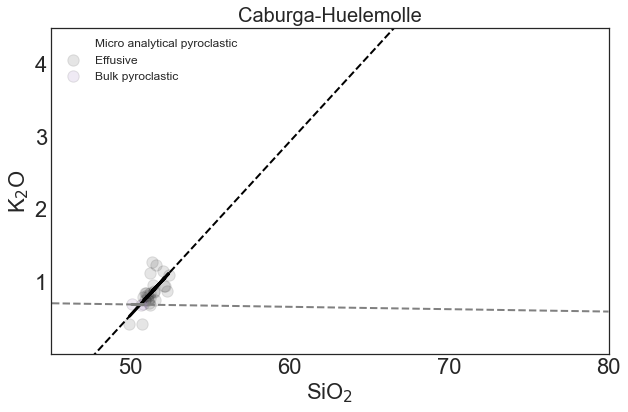

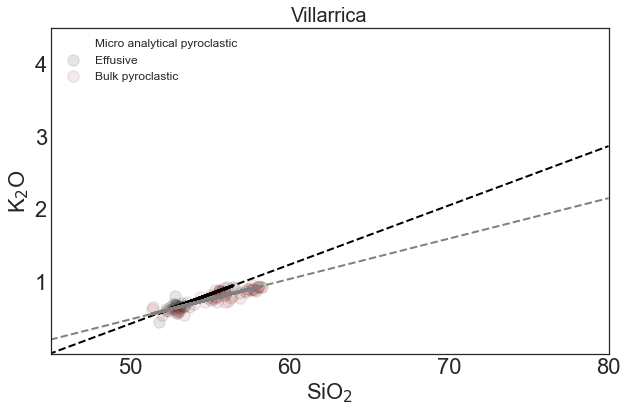

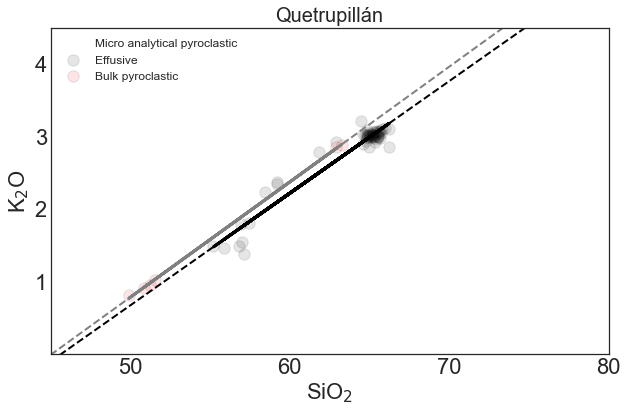

...

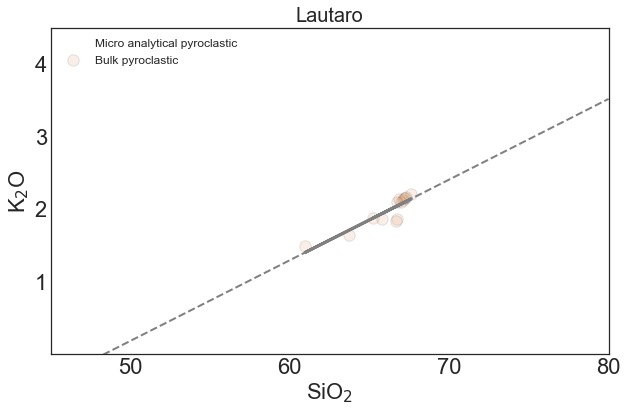

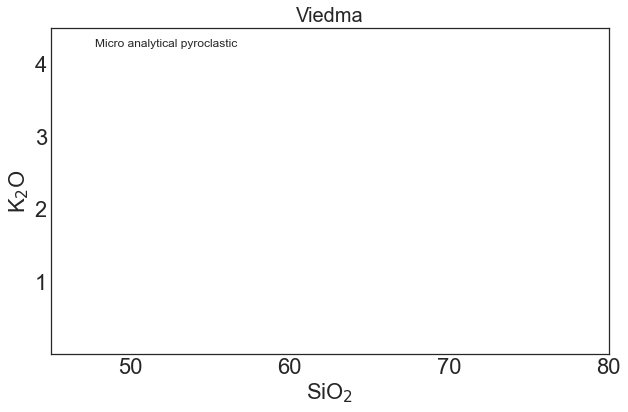

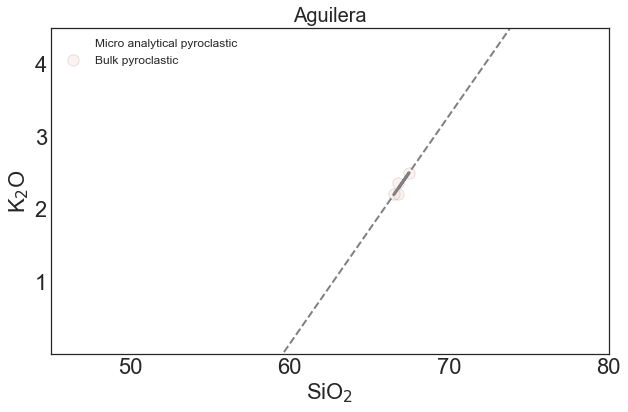

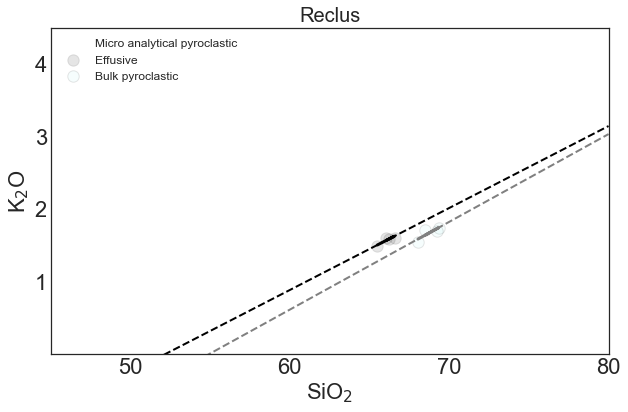

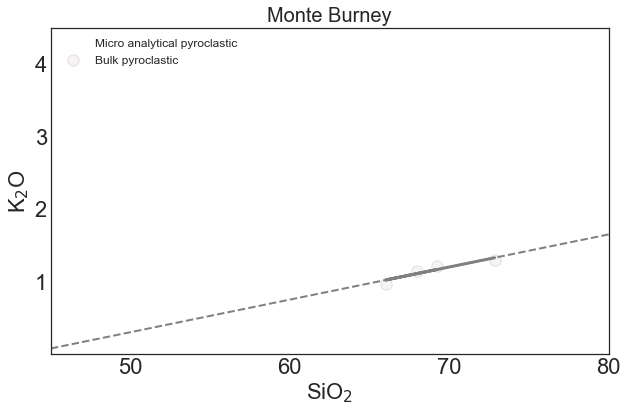

In [11]:
Data = Data.dropna(subset=['SiO2','K2O'],axis=0,how='all')
Data_glass = Data[(Data.TypeOfRegister=='Pyroclastic material')&(Data.TypeOfAnalysis=='Micro Analytical')]
Data_bulk = Data[(Data.TypeOfRegister=='Pyroclastic material')&(Data.TypeOfAnalysis=='Bulk')]
Data_effusive = Data[(Data.TypeOfRegister=='Effusive material')]

volcanoes_by_latitude = ['Llaima','Sollipulli','Caburga-Huelemolle','Villarrica','Quetrupillán','Lanín',
              'Huanquihue Group','Mocho-Choshuenco','Carrán-Los Venados','Puyehue-Cordón Caulle','Antillanca-Casablanca',
              'Osorno','Calbuco','Yate','Apagado','Hornopirén','Huequi','Michinmahuida','Chaitén','Corcovado',
              'Yanteles','Melimoyu','Mentolat','Cay','Macá','Hudson',
              'Lautaro','Viedma','Aguilera','Reclus','Monte Burney']

fit_info = pd.DataFrame()
fit_info['Volcano'] = volcanoes_by_latitude
# fit_info['Latitude'] = np.nan
# fit_info['Longitude'] = np.nan
# fit_info['Color'] = np.nan
fit_info['number of samples'] = np.nan

fit_info['polinomial fit coeff a/effusive regression'] = np.nan #considering a linear regression: y = a + bx
fit_info['polinomial fit coeff b/effusive regression'] = np.nan
fit_info['number of samples for effusive regression'] = np.nan
fit_info['polinomial fit coeff a/bulk pyroclastic regression'] = np.nan
fit_info['polinomial fit coeff b/bulk pyroclastic regression'] = np.nan
fit_info['number of samples for bulk pyroclastic regression'] = np.nan
fit_info['fit case'] = np.nan

# R2 and RMSE are measures of the fit of the data to the regression
fit_info['R2_effusive_regression'] = np.nan;fit_info['RMSE_effusive_regression'] = np.nan
fit_info['R2_bulk_pyroclastic_regression'] = np.nan;fit_info['RMSE_bulk_pyroclastic_regression'] = np.nan

# In order to check if 'bulk pyroclastic' data fits the 'effusive' products regression, I calculated R2 and RMSE of
#    the 'bulk pyroclastic' products to the 'effusive' linear regression and viceversa
fit_info['R2_effusive_to_bulk_pyroclastic_regression'] = np.nan;fit_info['RMSE_effusive_to_bulk_pyroclastic_regression'] = np.nan
fit_info['R2_bulk_pyroclastic_to_effusive_regression'] = np.nan;fit_info['RMSE_bulk_pyroclastic_to_effusive_regression'] = np.nan


for volcan in volcanoes_by_latitude:
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))
    Color, Marker  = simbologia(volcan,'Unknown')
    index = fit_info.index[fit_info.Volcano == volcan].tolist()[0]
    plt.scatter(Data[Data.Volcano == volcan].SiO2,Data[Data.Volcano == volcan].K2O,color=Color,edgecolors =Color,s=130,alpha=0,label='Micro analytical pyroclastic')
    
    fit_info.loc[index,'number of samples'] = len(Data[Data.Volcano == volcan])
    
    #----------- 'effusive' products 
    if len(Data_effusive[Data_effusive.Volcano == volcan].SiO2)>2:
        z, rmse, rank, singular_values, rcond = np.polyfit(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,1,full=True)
        p = np.poly1d(z)
        r2 = r2_score(Data_effusive[Data_effusive.Volcano == volcan].K2O, p(Data_effusive[Data_effusive.Volcano == volcan].SiO2))
                
        #---------------- plot 'effusive' data and regression
        plt.scatter(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,color='black',edgecolors ='black',s=130,alpha=0.1,label='Effusive')
        plt.plot(Data_effusive[Data_effusive.Volcano == volcan].SiO2,p(Data_effusive[Data_effusive.Volcano == volcan].SiO2),color='black',linewidth=3)
        plt.plot(np.array([40,80]),p(np.array([40,80])),color='black',linestyle='--',linewidth=2)
        #print ("y=%.6fx+(%.6f)"%(z[0],z[1])) 
            
#         ax.text(82,4.2,"Effusive: y = {}x + {}".format(np.around(z[0],3),np.around(z[1],3)),rotation=0,color='black',fontsize=14)
#         ax.text(82,3.7,"$r^{2}$ = "+str(np.around(r2,3)),rotation=0,color='black',fontsize=14)
#         ax.text(82,3.2,"RMSE = "+str(np.around(rmse[0],3)),rotation=0,color='black',fontsize=14)    
     
        #---------------- save 'effusive' regression's R2 and RMSE
        fit_info.loc[index,'R2_effusive_regression'] = r2
        fit_info.loc[index,'RMSE_effusive_regression'] = rmse
        fit_info.loc[index,'polinomial fit coeff a/effusive regression'] = np.around(z[1],3)
        fit_info.loc[index,'polinomial fit coeff b/effusive regression'] = np.around(z[0],3)
        fit_info.loc[index,'number of samples for effusive regression'] = len(Data_effusive[Data_effusive.Volcano == volcan].SiO2)

    #----------- 'bulk pyroclastic' products    
    if len(Data_bulk[Data_bulk.Volcano == volcan].SiO2)>2:
        z_bulk, rmse_bulk, rank_bulk, singular_values_bulk, rcond_bulk  = np.polyfit(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,1,full=True)
        p_bulk = np.poly1d(z_bulk)
        r2_bulk = r2_score(Data_bulk[Data_bulk.Volcano == volcan].K2O, p_bulk(Data_bulk[Data_bulk.Volcano == volcan].SiO2))

        #---------------- plot 'bulk pyroclastic' data and regression
        plt.scatter(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,color=Color,edgecolors ='black',s=130,alpha=0.1,label='Bulk pyroclastic')
        plt.plot(Data_bulk[Data_bulk.Volcano == volcan].SiO2,p_bulk(Data_bulk[Data_bulk.Volcano == volcan].SiO2),color='grey',linewidth=3)
        plt.plot(np.array([40,80]),p_bulk(np.array([40,80])),color='grey',linestyle='--',linewidth=2)
        #print ("y=%.6fx+(%.6f)"%(z[0],z[1])) 
            
#         ax.text(82,2.3,"Bulk pyroclastic: y = {}x + {}".format(np.around(z_bulk[0],3),np.around(z_bulk[1],3)),rotation=0,color='black',fontsize=14)
#         ax.text(82,1.8,"$r^{2}$ = "+str(np.around(r2_bulk,3)),rotation=0,color='black',fontsize=14)
#         ax.text(82,1.3,"RMSE = "+str(np.around(rmse_bulk[0],3)),rotation=0,color='black',fontsize=14)

        #---------------- save 'bulk pyroclastic' regression's R2 and RMSE
        fit_info.loc[index,'R2_bulk_pyroclastic_regression'] = r2_bulk
        fit_info.loc[index,'RMSE_bulk_pyroclastic_regression'] = rmse_bulk
        fit_info.loc[index,'polinomial fit coeff a/bulk pyroclastic regression'] = np.around(z[1],3)
        fit_info.loc[index,'polinomial fit coeff b/bulk pyroclastic regression'] = np.around(z[0],3)
        fit_info.loc[index,'number of samples for bulk pyroclastic regression'] = len(Data_bulk[Data_bulk.Volcano == volcan].SiO2)
        
    if (len(Data_bulk[Data_bulk.Volcano == volcan].SiO2)>2) & (len(Data_effusive[Data_effusive.Volcano == volcan].SiO2)>2):
        #--------------------------- 'bulk pyroclastic' data fit to 'effusive' regression
        r2 = r2_score(Data_bulk[Data_bulk.Volcano == volcan].K2O, p(Data_bulk[Data_bulk.Volcano == volcan].SiO2))
        rmse = np.sqrt(mean_squared_error(Data_bulk[Data_bulk.Volcano == volcan].K2O, p(Data_bulk[Data_bulk.Volcano == volcan].SiO2)))
#         ax.text(82,.3,"Pyroclastic fit to effusive regression: R2 = "+str(np.around(r2,3))+" RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14)
        fit_info.loc[index,'R2_bulk_pyroclastic_to_effusive_regression'] = r2
        fit_info.loc[index,'RMSE_bulk_pyroclastic_to_effusive_regression'] = rmse       
        
        #--------------------------- 'effusive' data fit to 'bulk pyroclastic' regression 
        r2 = r2_score(Data_effusive[Data_effusive.Volcano == volcan].K2O, p_bulk(Data_effusive[Data_effusive.Volcano == volcan].SiO2))
        rmse = np.sqrt(mean_squared_error(Data_effusive[Data_effusive.Volcano == volcan].K2O, p_bulk(Data_effusive[Data_effusive.Volcano == volcan].SiO2)))
#         ax.text(82,.6,"Effusive fit to pyroclastic regression: R2 = "+str(np.around(r2,3))+" RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14)
        fit_info.loc[index,'R2_effusive_to_bulk_pyroclastic_regression'] = r2
        fit_info.loc[index,'RMSE_effusive_to_bulk_pyroclastic_regression'] = rmse
    
    leg=plt.legend(fancybox=True,ncol=1,loc='upper left',fontsize=12)
    ax.set_xticks([50,60,70,80])
    ax.set_yticks([1,2,3,4])    
    plt.title(volcan, fontsize = 20)
    plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22)
    plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
    ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
    plt.xlim(45,80)
    plt.ylim(0,4.5)
#     plt.savefig('../Plots/'+volcan+'_trend.png',dpi = 300,bbox_inches='tight', transparent='True')

In [12]:
fit_info

,Volcano,number of samples,polinomial fit coeff a/effusive regression,polinomial fit coeff b/effusive regression,number of samples for effusive regression,polinomial fit coeff a/bulk pyroclastic regression,polinomial fit coeff b/bulk pyroclastic regression,number of samples for bulk pyroclastic regression,fit case,R2_effusive_regression,RMSE_effusive_regression,R2_bulk_pyroclastic_regression,RMSE_bulk_pyroclastic_regression,R2_effusive_to_bulk_pyroclastic_regression,RMSE_effusive_to_bulk_pyroclastic_regression,R2_bulk_pyroclastic_to_effusive_regression,RMSE_bulk_pyroclastic_to_effusive_regression
0,Llaima,1412.0,-3.069,0.071,63.0,-3.069,0.071,137.0,NaN,0.528294,0.515120,0.925180,1.072397,-0.286909,0.149356,0.703003,0.176273
1,Sollipulli,70.0,NaN,NaN,NaN,-3.069,0.071,6.0,NaN,NaN,NaN,0.983495,0.116088,NaN,NaN,NaN,NaN
2,Caburga-Huelemolle,134.0,-11.452,0.240,25.0,-11.452,0.240,3.0,NaN,0.411723,0.613415,0.091208,0.000033,-0.767707,0.271532,-533.039535,0.080152
3,Villarrica,859.0,-3.675,0.082,20.0,-3.675,0.082,60.0,NaN,0.773000,0.058499,0.806907,0.160161,0.648959,0.067255,0.190124,0.105811
4,Quetrupillán,1205.0,-7.067,0.155,55.0,-7.067,0.155,6.0,NaN,0.930734,0.953471,0.999351,0.003292,0.812614,0.216562,0.977520,0.137806
5,Lanín,81.0,-6.265,0.142,34.0,-6.265,0.142,3.0,NaN,0.871612,1.895911,0.788769,0.008535,0.589312,0.422342,-0.617249,0.147587
6,Huanquihue Group,176.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Mocho-Choshuenco,2659.0,NaN,NaN,NaN,-6.265,0.142,121.0,NaN,NaN,NaN,0.857260,2.903823,NaN,NaN,NaN,NaN
8,Carrán-Los Venados,155.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Puyehue-Cordón Caulle,1573.0,-5.231,0.114,55.0,-5.231,0.114,35.0,NaN,0.981687,0.730957,0.975565,0.146977,0.973206,0.139445,0.966527,0.075846


### 2.- Filter volcanoes by fit of data to regressions
I considered a good fit of data to the regression when R2 > 0.56 and RMSE < 0.3. Each user might consider different thresholds. 

In [13]:
r2_threshold = 0.56
RMSE_threshold = 1.1
fit_info = fit_info.replace(np.nan,-1)

In [14]:
print('\033[1m'+ 'Case 0: Volcanoes whith not enough data for the regressions' + '\033[0m')
Volcanoes_no_fit = fit_info[(fit_info.R2_effusive_regression == -1)
                            & (fit_info.R2_bulk_pyroclastic_regression == -1)].Volcano
index = fit_info[fit_info.Volcano.isin(Volcanoes_no_fit.tolist())].index.values
fit_info.loc[index,'fit case'] = 'Case 0'
print(Volcanoes_no_fit.tolist())
print(" ")

print('\033[1m'+ 'Volcanoes with both "effusive" and "bulk pyroclastic" data' + '\033[0m')
print('\033[1m'+ '    Case 1: Volcanoes where "effusive" data fit "bulk pyroclastic" regression, and viceversa' + '\033[0m')
Volcanoes_both_fit = fit_info[
     ((fit_info.R2_effusive_regression > r2_threshold) & (fit_info.RMSE_effusive_regression < RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_regression > r2_threshold)&(fit_info.RMSE_bulk_pyroclastic_regression < RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_to_effusive_regression > r2_threshold) & (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression < RMSE_threshold))
    &((fit_info.R2_effusive_to_bulk_pyroclastic_regression > r2_threshold) & (fit_info.RMSE_effusive_to_bulk_pyroclastic_regression < RMSE_threshold))].Volcano
print(Volcanoes_both_fit.tolist())
Data_volcanoes_both_fit = Data[Data.Volcano.isin(Volcanoes_both_fit.tolist())]
index = fit_info[fit_info.Volcano.isin(Volcanoes_both_fit.tolist())].index.values
fit_info.loc[index,'fit case'] = 'Case 1'
print(" ")

print('\033[1m'+ '    Case 2: Volcanoes where only "effusive" data fit "bulk pyroclastic" regression' + '\033[0m')
Volcanoes_effusive_fit_pyro = fit_info[
    ((fit_info.R2_bulk_pyroclastic_regression > r2_threshold) & (fit_info.RMSE_bulk_pyroclastic_regression < RMSE_threshold))
    &((fit_info.R2_effusive_to_bulk_pyroclastic_regression > r2_threshold) & (fit_info.RMSE_effusive_to_bulk_pyroclastic_regression < RMSE_threshold))
    &(((fit_info.R2_bulk_pyroclastic_to_effusive_regression < r2_threshold) | (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression > RMSE_threshold))
    |((fit_info.R2_effusive_to_bulk_pyroclastic_regression < r2_threshold) | (fit_info.RMSE_effusive_to_bulk_pyroclastic_regression > RMSE_threshold)))].Volcano

print(Volcanoes_effusive_fit_pyro.tolist())
Data_volcanoes_effusive_fit_pyro = Data[Data.Volcano.isin(Volcanoes_effusive_fit_pyro.tolist())]
index = fit_info[fit_info.Volcano.isin(Volcanoes_effusive_fit_pyro)].index.values
fit_info.loc[index,'fit case'] =  'Case 2'
print(" ")

print('\033[1m'+ '    Case 3: Volcanoes where only "bulk pyroclastic" data fit "effusive" regression' + '\033[0m')
Volcanoes_pyro_fit_effusive = fit_info[
    ((fit_info.R2_effusive_regression > r2_threshold) & (fit_info.RMSE_effusive_regression < RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_to_effusive_regression > r2_threshold) & (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression < RMSE_threshold))
    &(((fit_info.R2_bulk_pyroclastic_regression < r2_threshold) | (fit_info.RMSE_bulk_pyroclastic_regression > RMSE_threshold))
    |((fit_info.R2_effusive_to_bulk_pyroclastic_regression < r2_threshold) | (fit_info.RMSE_effusive_to_bulk_pyroclastic_regression > RMSE_threshold)))].Volcano

print(Volcanoes_pyro_fit_effusive.tolist())
Data_volcanoes_pyro_fit_effusive = Data[Data.Volcano.isin(Volcanoes_pyro_fit_effusive.tolist())]
index = fit_info[fit_info.Volcano.isin(Volcanoes_pyro_fit_effusive.tolist())].index.values
fit_info.loc[index,'fit case'] = 'Case 3'
print(" ")

print('\033[1m'+ '    Case 6: Volcanoes where only "effusive" ("pyroclastic") data fits "effusive" ("pyroclastic") regression' + '\033[0m')
VolcanoesX = fit_info[
     ((fit_info.R2_effusive_regression != -1)&(fit_info.R2_bulk_pyroclastic_regression != -1))
    &(((fit_info.R2_effusive_regression > r2_threshold) & (fit_info.RMSE_effusive_regression < RMSE_threshold))
    |((fit_info.R2_bulk_pyroclastic_regression > r2_threshold)&(fit_info.RMSE_bulk_pyroclastic_regression < RMSE_threshold)))
    &(((fit_info.R2_bulk_pyroclastic_to_effusive_regression < r2_threshold) | (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression > RMSE_threshold))
    &((fit_info.R2_effusive_to_bulk_pyroclastic_regression < r2_threshold) | (fit_info.RMSE_effusive_to_bulk_pyroclastic_regression > RMSE_threshold)))].Volcano
index = fit_info[fit_info.Volcano.isin(VolcanoesX.tolist())].index.values
fit_info.loc[index,'fit case'] = 'Case 6'
print(VolcanoesX.tolist())
print(" ")

print('\033[1m'+ '    Case 7: Volcanoes where "effusive" data fits "bulk pyroclastic" regression but "bulk pyroclastic" regression doesnt meet the criteria or viceversa' + '\033[0m')
VolcanoesY = fit_info[
     ((fit_info.R2_effusive_regression != -1)&(fit_info.R2_bulk_pyroclastic_regression != -1))
    &((((fit_info.R2_effusive_regression < r2_threshold) | (fit_info.RMSE_effusive_regression > RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_regression > r2_threshold) & (fit_info.RMSE_bulk_pyroclastic_regression < RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_to_effusive_regression > r2_threshold) & (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression < RMSE_threshold))
    &((fit_info.R2_effusive_to_bulk_pyroclastic_regression < r2_threshold) | (fit_info.RMSE_effusive_to_bulk_pyroclastic_regression > RMSE_threshold))))
    
    |((((fit_info.R2_effusive_regression > r2_threshold) & (fit_info.RMSE_effusive_regression < RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_regression < r2_threshold) | (fit_info.RMSE_bulk_pyroclastic_regression > RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_to_effusive_regression < r2_threshold) | (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression > RMSE_threshold))
    &((fit_info.R2_effusive_to_bulk_pyroclastic_regression > r2_threshold) & (fit_info.RMSE_effusive_to_bulk_pyroclastic_regression < RMSE_threshold))))].Volcano
print(VolcanoesY.tolist())
index = fit_info[fit_info.Volcano.isin(VolcanoesY.tolist())].index.values
fit_info.loc[index,'fit case'] = 'Case 7'
print(" ")

print('\033[1m'+ '    Case 8.1: Volcanoes where nothing fits' + '\033[0m')
VolcanoesZ = fit_info[
     ((fit_info.R2_effusive_regression != -1)&(fit_info.R2_bulk_pyroclastic_regression != -1))
    &(((fit_info.R2_effusive_regression < r2_threshold) | (fit_info.RMSE_effusive_regression > RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_regression < r2_threshold) | (fit_info.RMSE_bulk_pyroclastic_regression > RMSE_threshold))
    &((fit_info.R2_bulk_pyroclastic_to_effusive_regression < r2_threshold) | (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression > RMSE_threshold))
    &((fit_info.R2_effusive_to_bulk_pyroclastic_regression < r2_threshold) | (fit_info.RMSE_effusive_to_bulk_pyroclastic_regression > RMSE_threshold)))].Volcano
print(VolcanoesZ.tolist())
index = fit_info[fit_info.Volcano.isin(VolcanoesZ.tolist())].index.values
fit_info.loc[index,'fit case'] = 'Case 8.1'
print(" ")


print('\033[1m'+ 'Volcanoes with only "effusive" data or "bulk pyroclastic" data' + '\033[0m')
print('\033[1m'+ '    Case 4: Volcanoes where only "effusive" data fit well the regression' + '\033[0m')
Volcanoes_good_effusive_fit = fit_info[
    ((fit_info.R2_effusive_regression > r2_threshold) & (fit_info.RMSE_effusive_regression < RMSE_threshold))
    & ((fit_info.R2_bulk_pyroclastic_regression == -1))].Volcano

print(Volcanoes_good_effusive_fit.tolist())
Data_volcanoes_good_effusive_fit = Data[Data.Volcano.isin(Volcanoes_good_effusive_fit.tolist())]
index = fit_info[fit_info.Volcano.isin(Volcanoes_good_effusive_fit.tolist())].index.values
fit_info.loc[index,'fit case'] = 'Case 4'
print(" ")

print('\033[1m'+ '    Case 5: Volcanoes where only "bulk pyroclastic" data fit well the regression' + '\033[0m')
Volcanoes_good_bulk_pyro_fit = fit_info[
    (fit_info.R2_effusive_regression == -1)
    & ((fit_info.R2_bulk_pyroclastic_regression > r2_threshold)&(fit_info.RMSE_bulk_pyroclastic_regression < RMSE_threshold))].Volcano

print(Volcanoes_good_bulk_pyro_fit.tolist())
Data_volcanoes_good_bulk_pyro_fit = Data[Data.Volcano.isin(Volcanoes_good_bulk_pyro_fit.tolist())]
index = fit_info[fit_info.Volcano.isin(Volcanoes_good_bulk_pyro_fit.tolist())].index.values
fit_info.loc[index,'fit case'] = 'Case 5'
print(" ")

print('\033[1m'+ '    Case 8.2: Volcanoes where neither "effusive" nor "bulk pyroclastic" products fit well their respective regressions' + '\033[0m')
Volcanoes_bad_effusive_bulk_pyro_fit = fit_info[
    ((fit_info.R2_effusive_regression == -1)
  & ((fit_info.R2_bulk_pyroclastic_regression < r2_threshold)|(fit_info.RMSE_bulk_pyroclastic_regression > RMSE_threshold)))
  | ((fit_info.R2_effusive_regression < r2_threshold) | (fit_info.RMSE_effusive_regression > RMSE_threshold))
  & ((fit_info.R2_bulk_pyroclastic_regression == -1))].Volcano
print([item for item in Volcanoes_bad_effusive_bulk_pyro_fit.tolist() if item not in (Volcanoes_no_fit.tolist())])
index = fit_info[fit_info.Volcano.isin([item for item in Volcanoes_bad_effusive_bulk_pyro_fit.tolist() if item not in (Volcanoes_no_fit.tolist())])].index.values
fit_info.loc[index,'fit case'] = 'Case 8.2'
print(" ")

Case 0: Volcanoes whith not enough data for the regressions
['Huanquihue Group', 'Carrán-Los Venados', 'Yanteles', 'Viedma']
 
Volcanoes with both "effusive" and "bulk pyroclastic" data
    Case 1: Volcanoes where "effusive" data fit "bulk pyroclastic" regression, and viceversa
['Quetrupillán', 'Puyehue-Cordón Caulle', 'Yate', 'Huequi']
 
    Case 2: Volcanoes where only "effusive" data fit "bulk pyroclastic" regression
['Villarrica', 'Lanín']
 
    Case 3: Volcanoes where only "bulk pyroclastic" data fit "effusive" regression
['Melimoyu', 'Hudson']
 
    Case 6: Volcanoes where only "effusive" ("pyroclastic") data fits "effusive" ("pyroclastic") regression
['Calbuco', 'Reclus']
 
    Case 7: Volcanoes where "effusive" data fits "bulk pyroclastic" regression but "bulk pyroclastic" regression doesnt meet the criteria or viceversa
['Llaima', 'Michinmahuida']
 
    Case 8.1: Volcanoes where nothing fits
['Caburga-Huelemolle']
 
Volcanoes with only "effusive" data or "bulk pyroclastic" dat

qualitative order:

Case 0 < Case 9 < Case 8.1 and 8.2 < Case 7 < Case 6 < Case 5 < Case 4 < Case 3 & Case 2 < Case 1 

### 3.- For case 1, 2, 3, 6, 7, 8.1: Re calculate regression with both type of products and mesure the distance of each  'micro analytical pyroclastic' sample to that regression.

In [15]:
# pip install spectra

In [16]:
import spectra
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import matplotlib as mpl

In [17]:
sampleNumbers = []
for volcan in volcanoes_by_latitude:
    sampleNumbers.append(len(Data[Data.Volcano == volcan]))
# normalize
# norm = [float(i)/max(sampleNumbers) for i in sampleNumbers]


In [18]:
sample_distance_to_fit = pd.DataFrame()
sample_distance_to_fit['Volcano'] = np.nan
sample_distance_to_fit['SampleID'] = Data_glass.SampleID.unique()

In [19]:
import matplotlib.cm as cm
from scipy.ndimage.filters import gaussian_filter

In [20]:
def myplot(x, y, s, bins=1000, normMin=-1, normMax=-1):
    heatmap, xedges, yedges = np.histogram2d(x, y, bins=bins)
    
    if normMin != -1 and normMax != -1:
        heatmap = (heatmap - normMin) / (normMax - normMin)
    
#     heatmap = gaussian_filter(heatmap, sigma=s)

    extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
    return heatmap.T, extent

In [21]:
# Calculate min an max for the heatmap of all volcanoes
all_min = 100000
all_max = 0
bins = 50

for v in all_volcanoes:
    v_samples = Data[Data.Volcano==v]
    v_samples.head()
    points = []
    x_dim = 'SiO2'
    y_dim = 'K2O'
    x_points = []
    y_points = []
    for i, row in v_samples.iterrows():
        if np.isnan(row[x_dim]) or np.isnan(row[y_dim]): continue
        x_points.append(row[x_dim])
        y_points.append(row[y_dim])
    heatmap, xedges, yedges = np.histogram2d(x_points, y_points, bins=bins)
    
    all_min = min(all_min, np.min(heatmap))
    all_max = max(all_max, np.max(heatmap))

In [22]:
print(all_min)
print(all_max)

0.0
112.0


In [23]:
from numpy import interp
from scipy.interpolate import interp1d

In [24]:
colorArray = ["#fff5f0","#fff4ef","#fff4ee","#fff3ed","#fff2ec","#fff2eb","#fff1ea","#fff0e9","#fff0e8","#ffefe7","#ffeee6","#ffeee6","#ffede5","#ffece4","#ffece3","#ffebe2","#feeae1","#fee9e0","#fee9de","#fee8dd","#fee7dc","#fee6db","#fee6da","#fee5d9","#fee4d8","#fee3d7","#fee2d6","#fee2d5","#fee1d4","#fee0d2","#fedfd1","#feded0","#feddcf","#fedccd","#fedbcc","#fedacb","#fed9ca","#fed8c8","#fed7c7","#fdd6c6","#fdd5c4","#fdd4c3","#fdd3c1","#fdd2c0","#fdd1bf","#fdd0bd","#fdcfbc","#fdceba","#fdcdb9","#fdccb7","#fdcbb6","#fdc9b4","#fdc8b3","#fdc7b2","#fdc6b0","#fdc5af","#fdc4ad","#fdc2ac","#fdc1aa","#fdc0a8","#fcbfa7","#fcbea5","#fcbca4","#fcbba2","#fcbaa1","#fcb99f","#fcb89e","#fcb69c","#fcb59b","#fcb499","#fcb398","#fcb196","#fcb095","#fcaf94","#fcae92","#fcac91","#fcab8f","#fcaa8e","#fca98c","#fca78b","#fca689","#fca588","#fca486","#fca285","#fca183","#fca082","#fc9e81","#fc9d7f","#fc9c7e","#fc9b7c","#fc997b","#fc987a","#fc9778","#fc9677","#fc9475","#fc9374","#fc9273","#fc9071","#fc8f70","#fc8e6f","#fc8d6d","#fc8b6c","#fc8a6b","#fc8969","#fc8868","#fc8667","#fc8565","#fc8464","#fb8263","#fb8162","#fb8060","#fb7f5f","#fb7d5e","#fb7c5d","#fb7b5b","#fb795a","#fb7859","#fb7758","#fb7657","#fb7455","#fa7354","#fa7253","#fa7052","#fa6f51","#fa6e50","#fa6c4e","#f96b4d","#f96a4c","#f9684b","#f9674a","#f96549","#f86448","#f86347","#f86146","#f86045","#f75e44","#f75d43","#f75c42","#f65a41","#f65940","#f6573f","#f5563e","#f5553d","#f4533c","#f4523b","#f4503a","#f34f39","#f34e38","#f24c37","#f24b37","#f14936","#f14835","#f04734","#ef4533","#ef4433","#ee4332","#ed4131","#ed4030","#ec3f2f","#eb3d2f","#eb3c2e","#ea3b2d","#e93a2d","#e8382c","#e7372b","#e6362b","#e6352a","#e5342a","#e43229","#e33128","#e23028","#e12f27","#e02e27","#df2d26","#de2c26","#dd2b25","#dc2a25","#db2924","#da2824","#d92723","#d72623","#d62522","#d52422","#d42321","#d32221","#d22121","#d12020","#d01f20","#ce1f1f","#cd1e1f","#cc1d1f","#cb1d1e","#ca1c1e","#c91b1e","#c71b1d","#c61a1d","#c5191d","#c4191c","#c3181c","#c2181c","#c0171b","#bf171b","#be161b","#bd161a","#bb151a","#ba151a","#b91419","#b81419","#b61419","#b51319","#b41318","#b21218","#b11218","#b01218","#ae1117","#ad1117","#ac1117","#aa1017","#a91016","#a71016","#a60f16","#a40f16","#a30e15","#a10e15","#a00e15","#9e0d15","#9c0d14","#9b0c14","#990c14","#970c14","#960b13","#940b13","#920a13","#900a13","#8f0a12","#8d0912","#8b0912","#890812","#870811","#860711","#840711","#820711","#800610","#7e0610","#7c0510","#7a0510","#78040f","#76040f","#75030f","#73030f","#71020e","#6f020e","#6d010e","#6b010e","#69000d","#67000d"]
SN = fit_info['number of samples'].values
print(max(SN))

2659.0


In [25]:
 #my Volcano Color Map : input sample number, out index value on color array
myVCM = interp1d([0, max(SN)],[0, len(colorArray)-1])

No handles with labels found to put in legend.


Llaima


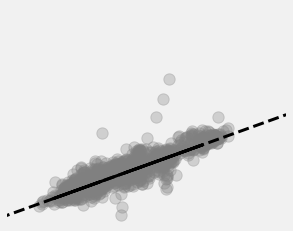

No handles with labels found to put in legend.


Caburga-Huelemolle


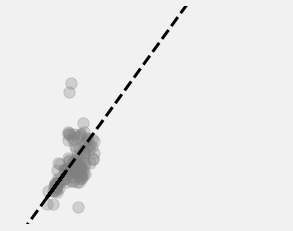

No handles with labels found to put in legend.


Villarrica


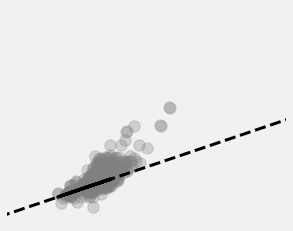

No handles with labels found to put in legend.


Quetrupillán


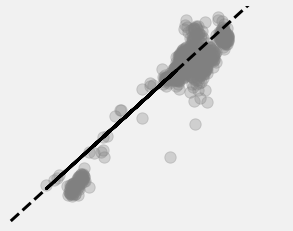

No handles with labels found to put in legend.


Lanín


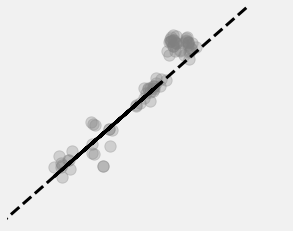

Puyehue-Cordón Caulle


No handles with labels found to put in legend.


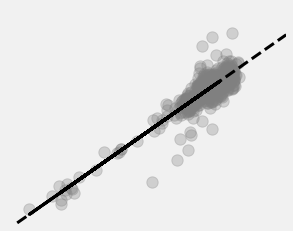

No handles with labels found to put in legend.


Calbuco


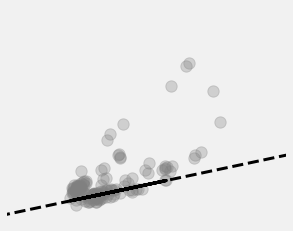

Yate


No handles with labels found to put in legend.


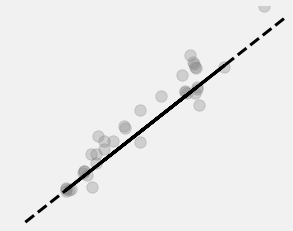

Huequi


No handles with labels found to put in legend.


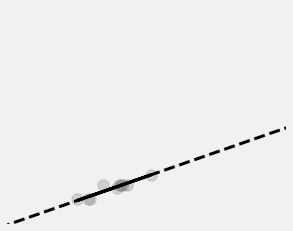

Michinmahuida


No handles with labels found to put in legend.


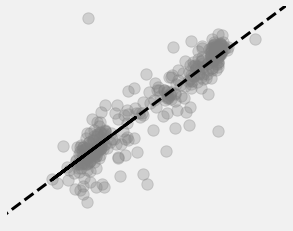

No handles with labels found to put in legend.


Melimoyu


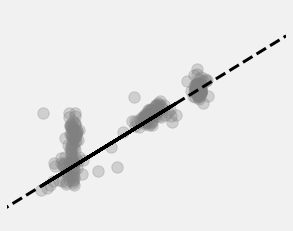

No handles with labels found to put in legend.


Hudson


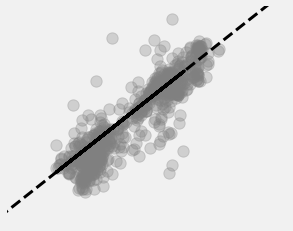

No handles with labels found to put in legend.


Reclus


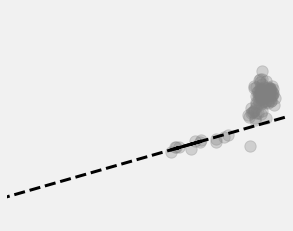

In [26]:
#RMSE is what measures the distance of the sample to the regression
sample_distance_to_fit['sample_RMSE_to_regression'] = np.nan
#joint regression reffers to the regression calculated using effusive material and bulk pyroclastic material together
fit_info['polinomial fit coeff a/joint regression'] = np.nan
fit_info['polinomial fit coeff b/joint regression'] = np.nan
fit_info['number of samples for joint regression'] = np.nan

for volcan in fit_info[fit_info['fit case'].isin(['Case 1', 'Case 2', 'Case 3', 'Case 6', 'Case 7', 'Case 8.1'])].Volcano :
    print(volcan)
    index = fit_info.index[fit_info.Volcano == volcan].tolist()[0]
    fig, ax = plt.subplots(figsize=(5,4))
    # ref : https://stackoverflow.com/questions/4581504/how-to-set-opacity-of-background-colour-of-graph-with-matplotlib
    fig.patch.set_facecolor('#D3D3D3')
    fig.patch.set_alpha(0.3)
    fig.patch.set_edgecolor('#808080')
    
    Color, Marker  = simbologia(volcan,'Unknown')
    
    numberSamples = fit_info[fit_info['Volcano'] == volcan]['number of samples'].values[0]
    colorIndex = np.round(myVCM(numberSamples))
    colorIndex = colorIndex.astype(int)
    
    #-- only in Reds color, to see the transition is smooth or not 
#     plt.scatter(Data[Data.Volcano == volcan].SiO2,Data[Data.Volcano == volcan].K2O,color = colorArray[colorIndex],edgecolors = colorArray[colorIndex],s=130,alpha=0.3)
    plt.scatter(Data[Data.Volcano == volcan].SiO2,Data[Data.Volcano == volcan].K2O,color = 'gray',edgecolors = 'gray',s=130,alpha=0.3)
    #-- have label to differentiate data source 
    #-- have label to differentiate data source 
#     plt.scatter(Data[Data.Volcano == volcan].SiO2,Data[Data.Volcano == volcan].K2O,color = colorArray[colorIndex],edgecolors = colorArray[colorIndex],s=130,alpha=0.5,label='All samples')
#     plt.scatter(Data_glass[Data_glass.Volcano == volcan].SiO2,Data_glass[Data_glass.Volcano == volcan].K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label='Micro analytical pyroclastic')

            
    #---------------- plot 'effusive' and 'bulk pyroclastic' data and joint regression
    Data_regression = Data[((Data.TypeOfRegister=='Pyroclastic material')&(Data.TypeOfAnalysis=='Bulk'))|(Data.TypeOfRegister=='Effusive material')]
    z, rmse, rank, singular_values, rcond = np.polyfit(Data_regression[Data_regression.Volcano == volcan].SiO2,Data_regression[Data_regression.Volcano == volcan].K2O,1,full=True)
    p = np.poly1d(z)
    r2 = r2_score(Data_regression[Data_regression.Volcano == volcan].K2O, p(Data_regression[Data_regression.Volcano == volcan].SiO2))
#     plt.scatter(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,color='black',edgecolors ='black',s=130,alpha=0.5,label='Effusive')
#     plt.scatter(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,color=Color,edgecolors ='black',s=130,alpha=0.3,label='Bulk pyroclastic')
    plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
    plt.plot(np.array([40,80]),p(np.array([40,80])),color='black',linestyle='--',linewidth=3)
    
#     ax.text(82,4.2,"Effusive: y = {}x + {}".format(np.around(z[0],3),np.around(z[1],3)),rotation=0,color='black',fontsize=14)
#     ax.text(82,3.7,"$r^{2}$ = "+str(np.around(r2,3)),rotation=0,color='black',fontsize=14)
#     ax.text(82,3.2,"RMSE = "+str(np.around(rmse[0],3)),rotation=0,color='black',fontsize=14)    
    fit_info.loc[index,'polinomial fit coeff a/joint regression'] = np.around(z[1],3)
    fit_info.loc[index,'polinomial fit coeff b/joint regression'] = np.around(z[0],3)
    fit_info.loc[index,'number of samples for joint regression'] = len(Data_regression[Data_regression.Volcano == volcan].SiO2)

    leg=plt.legend(fancybox=True,ncol=1,loc='upper left',fontsize=12) # lengend = "micro analytical pyroclastic"
    ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
    plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
    ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
    plt.xlim(45,80);plt.ylim(0,4.5)
#     plt.title(volcan, fontsize = 20)    
    plt.axis('off')
    plt.savefig('../Plots/'+volcan+'.png',dpi = 300,bbox_inches='tight', facecolor=fig.get_facecolor(), edgecolor=fig.get_edgecolor())
    plt.show()
    
    temp = Data_glass[(Data_glass.Volcano==volcan)]
        
    for sample in temp.SampleID.unique():
        #print(sample)
#         plt.figure(figsize=(5,4));ax = plt.axes()
        temp2 = temp[temp.SampleID==sample]
#         plt.scatter(temp2.SiO2,temp2.K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label=sample)
#         plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
#         plt.plot(np.array([40,80]),p(np.array([40,80])),color='black',linestyle='--',linewidth=3)

        # calculate distance (RMSE) of 'Sample' to the regression
        rmse = np.sqrt(mean_squared_error(temp2.K2O, p(temp2.SiO2)))
#         ax.text(82,3.2,"RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14)    
        index =  sample_distance_to_fit.index[sample_distance_to_fit.SampleID == sample].tolist()[0]   
        
        # save distance (RMSE) of 'Sample'
        sample_distance_to_fit.loc[index,'sample_RMSE_to_regression'] = rmse  
        sample_distance_to_fit.loc[index,'Volcano'] = volcan
        
#         leg=plt.legend(fancybox=True,ncol=1,loc='lower right',fontsize=14)
#         ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
#         plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
#         ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
#         plt.xlim(45,80);plt.ylim(0,4.5)

           

### 4.- For case 4, 5, and 8.2 Mesure the distance of each 'micro analytical pyroclastic' sample to the respective 'effusive' or 'bulk pyroclastic' regression.

No handles with labels found to put in legend.


Sollipulli


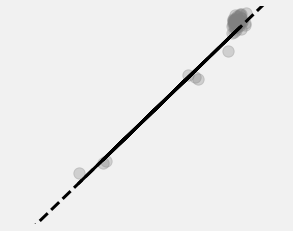

No handles with labels found to put in legend.


Mocho-Choshuenco


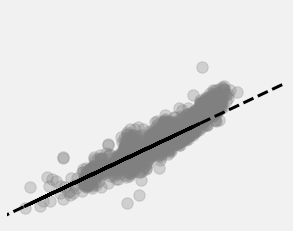

No handles with labels found to put in legend.


Antillanca-Casablanca


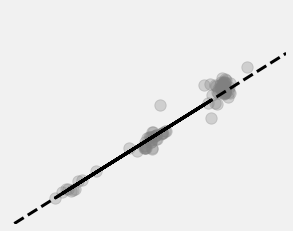

Osorno


No handles with labels found to put in legend.


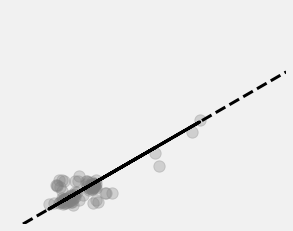

No handles with labels found to put in legend.


Apagado


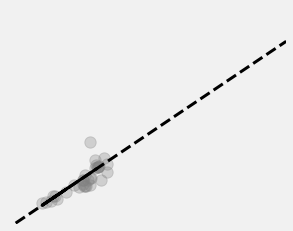

Hornopirén


No handles with labels found to put in legend.


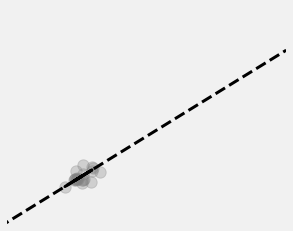

Chaitén


No handles with labels found to put in legend.


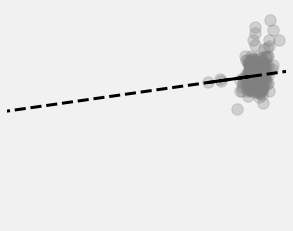

No handles with labels found to put in legend.


Corcovado


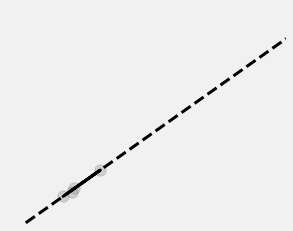

Mentolat


No handles with labels found to put in legend.


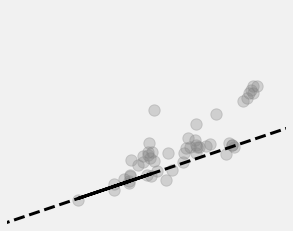

No handles with labels found to put in legend.


Cay


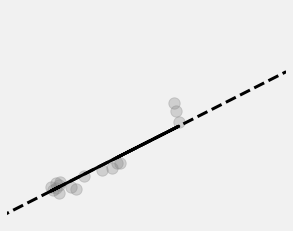

Macá


No handles with labels found to put in legend.


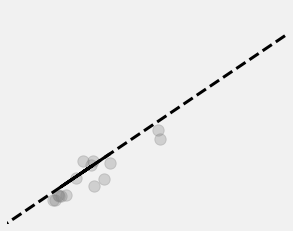

Lautaro


No handles with labels found to put in legend.


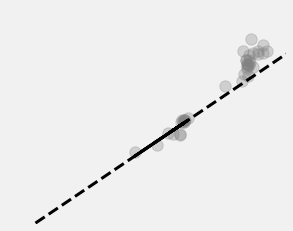

Aguilera


No handles with labels found to put in legend.


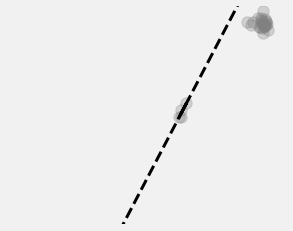

Monte Burney


No handles with labels found to put in legend.


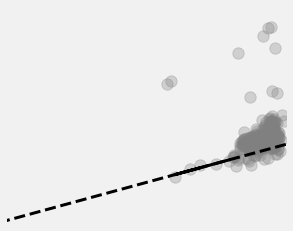

In [27]:
for volcan in fit_info[fit_info['fit case'].isin(['Case 4', 'Case 5', 'Case 8.2'])].Volcano :
    print(volcan)
    fig, ax = plt.subplots(figsize=(5,4))
    fig.patch.set_facecolor('#D3D3D3')
    fig.patch.set_alpha(0.3)
    Color, Marker  = simbologia(volcan,'Unknown')
    
    numberSamples = fit_info[fit_info['Volcano'] == volcan]['number of samples'].values[0]
    colorIndex = np.round(myVCM(numberSamples))
    colorIndex = colorIndex.astype(int)
    #-- only in Reds color, to see the transition is smooth or not 
#     plt.scatter(Data[Data.Volcano == volcan].SiO2,Data[Data.Volcano == volcan].K2O,color = colorArray[colorIndex],edgecolors = colorArray[colorIndex],s=130,alpha=0.3)
    plt.scatter(Data[Data.Volcano == volcan].SiO2,Data[Data.Volcano == volcan].K2O,color = 'gray',edgecolors = 'gray',s=130,alpha=0.3)
    #-- have label to differentiate data source
#     plt.scatter(Data[Data.Volcano == volcan].SiO2,Data[Data.Volcano == volcan].K2O,color = colorArray[colorIndex],edgecolors = colorArray[colorIndex],s=130,alpha=0.5,label='All samples')
    
    numberSamples_glass = len(Data_glass[Data_glass.Volcano == volcan])
    colorIndex_glass = np.round(myVCM(numberSamples_glass))
    colorIndex_glass = colorIndex_glass.astype(int)
#     plt.scatter(Data_glass[Data_glass.Volcano == volcan].SiO2,Data_glass[Data_glass.Volcano == volcan].K2O,color= colorArray[colorIndex_glass],edgecolors = colorArray[colorIndex_glass],s=130,alpha=0.5,label='Micro analytical pyroclastic')
    
    #---------------- plot 'effusive' and 'bulk pyroclastic' data and joint regression
    Data_regression = Data[((Data.TypeOfRegister=='Pyroclastic material')&(Data.TypeOfAnalysis=='Bulk'))|(Data.TypeOfRegister=='Effusive material')]
    z, rmse, rank, singular_values, rcond = np.polyfit(Data_regression[Data_regression.Volcano == volcan].SiO2,Data_regression[Data_regression.Volcano == volcan].K2O,1,full=True)
    p = np.poly1d(z)
    r2 = r2_score(Data_regression[Data_regression.Volcano == volcan].K2O, p(Data_regression[Data_regression.Volcano == volcan].SiO2))
#     plt.scatter(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,color='black',edgecolors ='black',s=130,alpha=0.3,label='Effusive')
    
# #     numberSamples_bulk = len(Data_bulk[Data_bulk.Volcano == volcan])
# #     colorIndex_bulk = np.round(myVCM(numberSamples_bulk))
# #     colorIndex_bulk = colorIndex_bulk.astype(int)
    
#     plt.scatter(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,color= Color,edgecolors ='black',s=130,alpha=0.3,label='Bulk pyroclastic')
    plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
    plt.plot(np.array([40,80]),p(np.array([40,80])),color='black',linestyle='--',linewidth=3)
    
#     ax.text(82,4.2,"Regression: y = {}x + {}".format(np.around(z[0],3),np.around(z[1],3)),rotation=0,color='black',fontsize=14)
#     ax.text(82,3.7,"$r^{2}$ = "+str(np.around(r2,3)),rotation=0,color='black',fontsize=14)
#     ax.text(82,3.2,"RMSE = "+str(np.around(rmse[0],3)),rotation=0,color='black',fontsize=14)    

    leg=plt.legend(fancybox=True,ncol=1,loc='upper left',fontsize=12)
    ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
    plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
#     ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
    plt.xlim(45,80);plt.ylim(0,4.5)
#     plt.title(volcan, fontsize = 20)
    plt.axis('off')
    plt.savefig('../Plots/'+volcan+'.png',dpi = 300,bbox_inches='tight', facecolor=fig.get_facecolor(), edgecolor=fig.get_edgecolor())
    plt.show()
    
    temp = Data_glass[(Data_glass.Volcano==volcan)]
        
    for sample in temp.SampleID.unique():
        #print(sample)
        temp2 = temp[temp.SampleID==sample]
        
        if len(temp2.SiO2)>2:
            #plot 'Sample'
#             plt.figure(figsize=(5,4));ax = plt.axes()
#             plt.scatter(temp2.SiO2,temp2.K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label=sample)
#             plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
#             plt.plot(np.array([40,80]),p(np.array([40,80])),color='black',linestyle='--',linewidth=3)

            # calculate distance (RMSE) of 'Sample' to the regression
            rmse = np.sqrt(mean_squared_error(temp2.K2O, p(temp2.SiO2)))
#             ax.text(82,3.2,"RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14)    
        
            # save distance (RMSE) of 'Sample'
            index =  sample_distance_to_fit.index[sample_distance_to_fit.SampleID == sample].tolist()[0] 
            sample_distance_to_fit.loc[index,'sample_RMSE_to_regression'] = rmse  
            sample_distance_to_fit.loc[index,'Volcano'] = volcan
        
#             leg=plt.legend(fancybox=True,ncol=1,loc='lower right',fontsize=14)
#             ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
#             plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
#             ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
#             plt.xlim(45,80);plt.ylim(0,4.5)
        

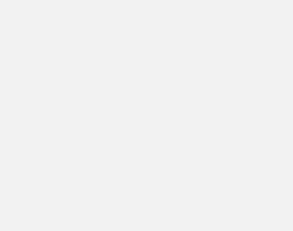

In [28]:
fig, ax = plt.subplots(figsize=(5,4))
fig.patch.set_facecolor('#D3D3D3')
fig.patch.set_alpha(0.3)

plt.axis('off')
plt.savefig('../Plots/blank.png',dpi = 300,bbox_inches='tight', facecolor=fig.get_facecolor(), edgecolor=fig.get_edgecolor())
plt.show()

In [29]:
sample_distance_to_fit.to_excel("../Data/sample_distance_to_fit.xlsx")

In [30]:
#-------------------- Load data
sample_distance_to_fit = pd.read_excel("../Data/sample_distance_to_fit.xlsx")

In [31]:
sample_distance_to_fit = sample_distance_to_fit.dropna(subset=['Volcano'])
fig = px.scatter(sample_distance_to_fit, sample_distance_to_fit.Volcano, sample_distance_to_fit.sample_RMSE_to_regression,
                 color = 'Volcano', hover_data = ['SampleID','sample_RMSE_to_regression'],width=800, height=500)
fig.show()

In [32]:
fit_info.to_csv(r'../Data/fit_info.csv', index=False)

### 5.- For all 'Samples' measure the distance to the regression of each 'SampleObservation'

In [48]:
VzDic = []

for volcan in fit_info[fit_info['fit case'] != 'Case 0'].Volcano :
    z, rmse, rank, singular_values, rcond = np.polyfit(Data_regression[Data_regression.Volcano == volcan].SiO2,Data_regression[Data_regression.Volcano == volcan].K2O,1,full=True)
    
    VzDic.append({"name": volcan, "z": z})

VzDic
    

[{'name': 'Llaima', 'z': array([ 0.05948031, -2.49994929])},
 {'name': 'Sollipulli', 'z': array([ 0.15948277, -7.76866868])},
 {'name': 'Caburga-Huelemolle', 'z': array([  0.22742404, -10.82490836])},
 {'name': 'Villarrica', 'z': array([ 0.05581515, -2.31143143])},
 {'name': 'Quetrupillán', 'z': array([ 0.14993654, -6.75631317])},
 {'name': 'Lanín', 'z': array([ 0.14487771, -6.39448368])},
 {'name': 'Mocho-Choshuenco', 'z': array([ 0.07794776, -3.31650958])},
 {'name': 'Puyehue-Cordón Caulle', 'z': array([ 0.11539815, -5.31901274])},
 {'name': 'Antillanca-Casablanca', 'z': array([ 0.1033169, -4.7363299])},
 {'name': 'Osorno', 'z': array([ 0.09536215, -4.48504703])},
 {'name': 'Calbuco', 'z': array([ 0.03494047, -1.37436844])},
 {'name': 'Yate', 'z': array([ 0.12985063, -6.10492654])},
 {'name': 'Apagado', 'z': array([ 0.11087161, -5.09283113])},
 {'name': 'Hornopirén', 'z': array([ 0.10168371, -4.5420168 ])},
 {'name': 'Huequi', 'z': array([ 0.0573888 , -2.60495056])},
 {'name': 'Michi

In [51]:
sampleObs_distance_to_all_volcan = pd.DataFrame()
sampleObs_distance_to_all_volcan['SampleObservationID'] = Data_glass.SampleObservationID.unique() 

# SampleObservationID, Llaima, Sollipulli ...
for dic in VzDic:
    sampleObs_distance_to_all_volcan[dic['name']] = np.nan

sampleObs_distance_to_all_volcan

,SampleObservationID,Llaima,Sollipulli,Caburga-Huelemolle,Villarrica,Quetrupillán,Lanín,Mocho-Choshuenco,Puyehue-Cordón Caulle,Antillanca-Casablanca,...,Corcovado,Melimoyu,Mentolat,Cay,Macá,Hudson,Lautaro,Aguilera,Reclus,Monte Burney
0,PCC-1_1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,PCC-1_2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,PCC-1_3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,PCC-1_4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,PCC-1_5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10815,RM-4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10816,RM-5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10817,RM-6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10818,RM-7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [75]:
test = []
for volcan in fit_info[fit_info['fit case'] != 'Case 0'].Volcano :
    temp = Data_glass[(Data_glass.Volcano==volcan)]
    for sample in temp.SampleID.unique():
        temp2 = temp[temp.SampleID==sample]
        if len(temp2.SiO2)>2:                    
            for sampleObs in temp2.SampleObservationID.unique().tolist():
                temp3 = temp2[temp2.SampleObservationID==sampleObs]
                print(temp3)
                sdd = {}
                sdd['SampleObservationID'] = sampleObs
                for dic in VzDic:
                    z = dic['z']
                    a = -z[0]; c = -z[1]; b = 1
                    shortestDistance = np.linalg.norm(a*temp3.SiO2+b*temp3.K2O+c)/np.sqrt(a*a+b*b)
                    
                    sdd[dic['name']] = shortestDistance
                print(sdd)
                test.append(sdd)

#             break
#     break

      Unnamed: 0 Volcano        Event  Vei  Magnitude     SampleID ISGN  \
3518        3518  Llaima  2008 Llaima  NaN        NaN  2008 Llaima  NaN   

     Comments Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
3518      NaN      NaN -38.699337  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
3518           NaN         NaN             NaN   

                                      Map?  
3518  Modified from Moreno & Naranjo, 2005  

[1 rows x 83 columns]
{'SampleObservationID': '8LM-331A_A13', 'Llaima': 0.08923795889929496, 'Sollipulli': 0.14609364121627458, 'Caburga-Huelemolle': 0.8117640222574974, 'Villarrica': 0.10251911568664625, 'Quetrupillán': 0.6276716508902801, 'Lanín': 0.7105638094462792, 'Mocho-Choshuenco': 0.11051144033880156, 'Puyehue-Cordón Caulle': 0.16920925628437464, 'Antillanca-Casablanca': 0.08736609557341193, 'Osorno': 0.09842161364117637, 'Calbuco': 0.3147669184467096, 'Yate': 0.17866043398888423, 'Apagado': 0

[1 rows x 83 columns]
{'SampleObservationID': '8LM-331A_A21b', 'Llaima': 0.020424255368443677, 'Sollipulli': 0.259454639407931, 'Caburga-Huelemolle': 0.9540795514376268, 'Villarrica': 0.03536904608071371, 'Quetrupillán': 0.7368670362623856, 'Lanín': 0.81754305501931, 'Mocho-Choshuenco': 0.18768132656092124, 'Puyehue-Cordón Caulle': 0.263163395477502, 'Antillanca-Casablanca': 0.17593219100534366, 'Osorno': 0.013417536527137544, 'Calbuco': 0.2571200455587798, 'Yate': 0.27902300173845657, 'Apagado': 0.23832789413843328, 'Hornopirén': 0.2790716905000881, 'Huequi': 0.24118075317730636, 'Michinmahuida': 0.6871496497846195, 'Chaitén': 1.756319252984319, 'Corcovado': 0.15211779855909263, 'Melimoyu': 0.5876870589813692, 'Mentolat': 0.2078247697361252, 'Cay': 0.27538856176999715, 'Macá': 0.3601348112974406, 'Hudson': 0.8076387469930232, 'Lautaro': 0.032345868442527896, 'Aguilera': 2.0027519453055906, 'Reclus': 0.23334692166307447, 'Monte Burney': 0.27805312445981334}
      Unnamed: 0 Volcano    

[1 rows x 83 columns]
{'SampleObservationID': '8LM-331A_A24c', 'Llaima': 0.12322013595927851, 'Sollipulli': 0.17626313309266492, 'Caburga-Huelemolle': 0.7207954121399863, 'Villarrica': 0.11665413923944343, 'Quetrupillán': 0.6750930409595044, 'Lanín': 0.7671456926552579, 'Mocho-Choshuenco': 0.28914103760423154, 'Puyehue-Cordón Caulle': 0.2793855632152465, 'Antillanca-Casablanca': 0.21959123521233484, 'Osorno': 0.04834133415574032, 'Calbuco': 0.05735957933118192, 'Yate': 0.26252013419051745, 'Apagado': 0.26482201243188724, 'Hornopirén': 0.32644474023872483, 'Huequi': 0.09275522630836774, 'Michinmahuida': 0.6868741796432335, 'Chaitén': 1.9823216925371876, 'Corcovado': 0.16539690295840412, 'Melimoyu': 0.6362317883872374, 'Mentolat': 0.055225048272884145, 'Cay': 0.36373492320331824, 'Macá': 0.38568712127384436, 'Hudson': 0.7900848955891587, 'Lautaro': 0.006834053430513249, 'Aguilera': 2.421910965601867, 'Reclus': 0.4050498867755392, 'Monte Burney': 0.10123752606687708}
      Unnamed: 0 Volc

[1 rows x 83 columns]
{'SampleObservationID': '8LM-331A_A31b', 'Llaima': 0.10651935382240321, 'Sollipulli': 0.0019887244870012083, 'Caburga-Huelemolle': 0.5776714458669301, 'Villarrica': 0.11495028717725027, 'Quetrupillán': 0.49189755463747803, 'Lanín': 0.5813312088444915, 'Mocho-Choshuenco': 0.06883098066937413, 'Puyehue-Cordón Caulle': 0.07833179420120281, 'Antillanca-Casablanca': 0.012309462835919896, 'Osorno': 0.1630335849463861, 'Calbuco': 0.2995388509827854, 'Yate': 0.06893152822818403, 'Apagado': 0.06143327906646245, 'Hornopirén': 0.11832207322183866, 'Huequi': 0.32355921580376235, 'Michinmahuida': 0.4895788146688522, 'Chaitén': 1.7343659049465632, 'Corcovado': 0.034987138216887294, 'Melimoyu': 0.4278439462752934, 'Mentolat': 0.2869577019910573, 'Cay': 0.14636965298999213, 'Macá': 0.18251231052624334, 'Hudson': 0.596736700855232, 'Lautaro': 0.2099996653968262, 'Aguilera': 2.520344105568053, 'Reclus': 0.16907555714000144, 'Monte Burney': 0.3383447314627341}
      Unnamed: 0 Volca

[1 rows x 83 columns]
{'SampleObservationID': '8LM-331A_B14', 'Llaima': 0.17264086728913297, 'Sollipulli': 0.14801918868108493, 'Caburga-Huelemolle': 0.8703075019311401, 'Villarrica': 0.18906836323188012, 'Quetrupillán': 0.6215283591727853, 'Lanín': 0.7001355212967866, 'Mocho-Choshuenco': 0.04295535859099424, 'Puyehue-Cordón Caulle': 0.13370325957949192, 'Antillanca-Casablanca': 0.04153916867382618, 'Osorno': 0.15105485777947292, 'Calbuco': 0.4192345830781414, 'Yate': 0.15547009359901817, 'Apagado': 0.10701884821698841, 'Hornopirén': 0.14401231181231106, 'Huequi': 0.3942436386221711, 'Michinmahuida': 0.5606643122055612, 'Chaitén': 1.5896022284539486, 'Corcovado': 0.023187868127536034, 'Melimoyu': 0.4524175294449857, 'Mentolat': 0.3616260480713404, 'Cay': 0.1329998187816182, 'Macá': 0.22899518185352913, 'Hudson': 0.6842759781104357, 'Lautaro': 0.16347821300388052, 'Aguilera': 2.0515036680681793, 'Reclus': 0.07617174415888346, 'Monte Burney': 0.4361297697040953}
      Unnamed: 0 Volcano 

[1 rows x 83 columns]
{'SampleObservationID': '8LM-331A_B21c', 'Llaima': 0.47891382209422445, 'Sollipulli': 0.14896021372837054, 'Caburga-Huelemolle': 0.5810920171732658, 'Villarrica': 0.49562837708180674, 'Quetrupillán': 0.3235461548520287, 'Lanín': 0.4016312771265577, 'Mocho-Choshuenco': 0.26181132357421094, 'Puyehue-Cordón Caulle': 0.16771000454992602, 'Antillanca-Casablanca': 0.26099869798028086, 'Osorno': 0.45431114210899404, 'Calbuco': 0.7273532393091839, 'Yate': 0.14454576902246166, 'Apagado': 0.19482046982804596, 'Hornopirén': 0.15867449290699787, 'Huequi': 0.7006808886776771, 'Michinmahuida': 0.2599478985529178, 'Chaitén': 1.2806826090922285, 'Corcovado': 0.27810221823334785, 'Melimoyu': 0.14968390137494667, 'Mentolat': 0.6682056662627214, 'Cay': 0.17127791658039673, 'Macá': 0.0728053225699744, 'Hudson': 0.38430600428055967, 'Lautaro': 0.46527704742434034, 'Aguilera': 2.3292934513977563, 'Reclus': 0.23104667652089075, 'Monte Burney': 0.7435156020965554}
      Unnamed: 0 Volcan

{'SampleObservationID': '8LM-331A_D11', 'Llaima': 0.05216100294584267, 'Sollipulli': 0.021858194614460077, 'Caburga-Huelemolle': 0.5811412588973736, 'Villarrica': 0.05947147232935313, 'Quetrupillán': 0.5186399351457183, 'Lanín': 0.6096103711550686, 'Mocho-Choshuenco': 0.11754101908249226, 'Puyehue-Cordón Caulle': 0.11559281922687067, 'Antillanca-Casablanca': 0.05326104879291238, 'Osorno': 0.11965011137479149, 'Calbuco': 0.23768527593434807, 'Yate': 0.10178414001342893, 'Apagado': 0.1000765796509659, 'Hornopirén': 0.15977284943301318, 'Huequi': 0.26856144455363595, 'Michinmahuida': 0.524618319728064, 'Chaitén': 1.799717277078434, 'Corcovado': 0.0018777156093199975, 'Melimoyu': 0.4694521860224878, 'Mentolat': 0.23140180642714062, 'Cay': 0.1933214651259222, 'Macá': 0.22102890305226836, 'Hudson': 0.6294476159890692, 'Lautaro': 0.17148852107360657, 'Aguilera': 2.5423205394692676, 'Reclus': 0.2271842274896101, 'Monte Burney': 0.279553272006712}
      Unnamed: 0 Volcano        Event  Vei  Mag

{'SampleObservationID': '8LM-331A_D7m2', 'Llaima': 0.20889832318134616, 'Sollipulli': 0.1357184086894145, 'Caburga-Huelemolle': 0.42385462936928453, 'Villarrica': 0.21614835552937275, 'Quetrupillán': 0.3610769649436917, 'Lanín': 0.4520602091446144, 'Mocho-Choshuenco': 0.03946863731693282, 'Puyehue-Cordón Caulle': 0.04180487957973179, 'Antillanca-Casablanca': 0.10403539827203839, 'Osorno': 0.27686747535041634, 'Calbuco': 0.3939775928031586, 'Yate': 0.055704983667956225, 'Apagado': 0.05728584015818995, 'Hornopirén': 0.0024918330848685806, 'Huequi': 0.4252645359360024, 'Michinmahuida': 0.36717054147878436, 'Chaitén': 1.6436656022490173, 'Corcovado': 0.1555295115076589, 'Melimoyu': 0.3121761230536596, 'Mentolat': 0.38807445358683995, 'Cay': 0.03623799598178368, 'Macá': 0.06366311763773869, 'Hudson': 0.47195608514967013, 'Lautaro': 0.32885445060629753, 'Aguilera': 2.698299986164307, 'Reclus': 0.07065758220037563, 'Monte Burney': 0.43603898287221643}
      Unnamed: 0 Volcano        Event  Ve

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-V-G_11', 'Llaima': 0.0800252064975249, 'Sollipulli': 0.06835181620723448, 'Caburga-Huelemolle': 0.5705150418203636, 'Villarrica': 0.07586543889682856, 'Quetrupillán': 0.5732570323712204, 'Lanín': 0.6685397682875694, 'Mocho-Choshuenco': 0.23384857489205563, 'Puyehue-Cordón Caulle': 0.19973589517265447, 'Antillanca-Casablanca': 0.14776917977895832, 'Osorno': 0.01831034815520455, 'Calbuco': 0.0844175128656808, 'Yate': 0.17354987161353214, 'Apagado': 0.18810147719110293, 'Hornopirén': 0.2556831963686119, 'Huequi': 0.1345772432917817, 'Michinmahuida': 0.602523594653805, 'Chaitén': 1.9628274389682632, 'Corcovado': 0.08490830598070968, 'Melimoyu': 0.5658048561669138, 'Mentolat': 0.09584813703613838, 'Cay': 0.3046876773840588, 'Macá': 0.30869795139856027, 'Hudson': 0.7008155797539225, 'Lautaro': 0.083834773481017, 'Aguilera': 2.6241537671345436, 'Reclus': 0.3699172770748218, 'Monte Burney': 0.13489971421989355}
      Unnamed: 0 Volcano       E

{'SampleObservationID': 'FXV-V-G_6', 'Llaima': 0.24496413388387592, 'Sollipulli': 0.16650368394486198, 'Caburga-Huelemolle': 0.39673925364297485, 'Villarrica': 0.2524030924835146, 'Quetrupillán': 0.3297794581099937, 'Lanín': 0.42049177142889216, 'Mocho-Choshuenco': 0.07457661499988631, 'Puyehue-Cordón Caulle': 0.07494372338998358, 'Antillanca-Casablanca': 0.13781300269071778, 'Osorno': 0.31106390684439483, 'Calbuco': 0.4313003458534222, 'Yate': 0.08807584771929469, 'Apagado': 0.09066437307119767, 'Hornopirén': 0.03137187860745388, 'Huequi': 0.4614382060361244, 'Michinmahuida': 0.3344180284300419, 'Chaitén': 1.6057618267621432, 'Corcovado': 0.18859956030031602, 'Melimoyu': 0.2782852643416706, 'Mentolat': 0.4243421742503753, 'Cay': 0.0014300225292872707, 'Macá': 0.030306533943218854, 'Hudson': 0.4396099952891586, 'Lautaro': 0.36221009042616104, 'Aguilera': 2.7206732936508042, 'Reclus': 0.03396082671324313, 'Monte Burney': 0.4728501747368433}
      Unnamed: 0 Volcano       Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': '12F3-B_2', 'Llaima': 0.08926480437988457, 'Sollipulli': 0.8450069344752889, 'Caburga-Huelemolle': 1.852291466248686, 'Villarrica': 0.05666579292896386, 'Quetrupillán': 1.277660503595084, 'Lanín': 1.3345468138428354, 'Mocho-Choshuenco': 0.386170527731861, 'Puyehue-Cordón Caulle': 0.6406564233594437, 'Antillanca-Casablanca': 0.49586799487166316, 'Osorno': 0.26851623971245686, 'Calbuco': 0.2657733880193386, 'Yate': 0.7250900940429357, 'Apagado': 0.5942792387584201, 'Hornopirén': 0.5912117263233682, 'Huequi': 0.1415649299854566, 'Michinmahuida': 1.0992232760028366, 'Chaitén': 1.6922395316671548, 'Corcovado': 0.5357813173162531, 'Melimoyu': 0.8973674938749939, 'Mentolat': 0.11700490175318747, 'Cay': 0.5014534530524133, 'Macá': 0.718061598878255, 'Hudson': 1.2559067533329547, 'Lautaro': 0.3256658557772237, 'Aguilera': 0.7198198715435156, 'Reclus': 0.2838945701796375, 'Monte Burney': 0.23828845830488563}
      Unnamed: 0 Volcano          Event  V

{'SampleObservationID': '12F3-B_9', 'Llaima': 0.0351906596377469, 'Sollipulli': 0.8282746968677891, 'Caburga-Huelemolle': 1.860431142888463, 'Villarrica': 0.0012180194577184763, 'Quetrupillán': 1.2573898042501666, 'Lanín': 1.312397618238024, 'Mocho-Choshuenco': 0.3390183666867868, 'Puyehue-Cordón Caulle': 0.6075220758122113, 'Antillanca-Casablanca': 0.4582169157625047, 'Osorno': 0.2278878965056851, 'Calbuco': 0.32903948001158634, 'Yate': 0.6973487057199743, 'Apagado': 0.5594533869259487, 'Hornopirén': 0.5529495714361682, 'Huequi': 0.19642294926460752, 'Michinmahuida': 1.068806903495762, 'Chaitén': 1.6246812376679183, 'Corcovado': 0.5031317225099026, 'Melimoyu': 0.858912575750609, 'Mentolat': 0.17254717821494714, 'Cay': 0.4564551284287053, 'Macá': 0.6833908113171893, 'Hudson': 1.2283386654323483, 'Lautaro': 0.29100173563464177, 'Aguilera': 0.6806953612413348, 'Reclus': 0.22522207498055702, 'Monte Burney': 0.2977983394165435}
      Unnamed: 0 Volcano          Event  Vei  Magnitude Sample

{'SampleObservationID': '12F3-D_1', 'Llaima': 0.07685410604333298, 'Sollipulli': 1.7418441257414568, 'Caburga-Huelemolle': 3.347731131028651, 'Villarrica': 0.010564132247182863, 'Quetrupillán': 2.088882882467076, 'Lanín': 2.100272058604495, 'Mocho-Choshuenco': 0.5432691438509535, 'Puyehue-Cordón Caulle': 1.1396810966388635, 'Antillanca-Casablanca': 0.8849157722792577, 'Osorno': 0.5849693653007798, 'Calbuco': 0.5039698194428431, 'Yate': 1.355183401002693, 'Apagado': 1.052139644203313, 'Hornopirén': 0.9653662517522643, 'Huequi': 0.1731995543310893, 'Michinmahuida': 1.6643377341236822, 'Chaitén': 1.3483406829705995, 'Corcovado': 1.0465980760719842, 'Melimoyu': 1.266823249736765, 'Mentolat': 0.1654250800594641, 'Cay': 0.711206163438773, 'Macá': 1.179696717674578, 'Hudson': 1.8902075119339028, 'Lautaro': 0.7874632739286304, 'Aguilera': 1.5135335161838537, 'Reclus': 0.15863122864089882, 'Monte Burney': 0.3841241269349564}
      Unnamed: 0 Volcano          Event  Vei  Magnitude SampleID ISGN 

{'SampleObservationID': '12F3-E_17', 'Llaima': 0.11457446101840592, 'Sollipulli': 1.605363564090122, 'Caburga-Huelemolle': 3.2484504213474925, 'Villarrica': 0.182864770403568, 'Quetrupillán': 1.9471488658030278, 'Lanín': 1.9557530362133675, 'Mocho-Choshuenco': 0.3619434750083028, 'Puyehue-Cordón Caulle': 0.9789307256139829, 'Antillanca-Casablanca': 0.7175189172247436, 'Osorno': 0.41320013142907874, 'Calbuco': 0.7087553497114052, 'Yate': 1.2023897746831131, 'Apagado': 0.888898312842801, 'Hornopirén': 0.7970714100496304, 'Huequi': 0.36576981648576934, 'Michinmahuida': 1.507594615124171, 'Chaitén': 1.1373413478398626, 'Corcovado': 0.8865619787293081, 'Melimoyu': 1.0982451997972402, 'Mentolat': 0.3589915466146381, 'Cay': 0.5330318390469679, 'Macá': 1.0166836455246222, 'Hudson': 1.7376699480406592, 'Lautaro': 0.6244600168382417, 'Aguilera': 1.461265387685008, 'Reclus': 0.03948773081568036, 'Monte Burney': 0.5834596255619404}
      Unnamed: 0 Volcano          Event  Vei  Magnitude SampleID I

{'SampleObservationID': '12F3-E_25', 'Llaima': 0.25229992277519675, 'Sollipulli': 1.7931543735621691, 'Caburga-Huelemolle': 3.3163829432222838, 'Villarrica': 0.19057710527018876, 'Quetrupillán': 2.151954226843541, 'Lanín': 2.1695872783504444, 'Mocho-Choshuenco': 0.6957010468595903, 'Puyehue-Cordón Caulle': 1.245511639455069, 'Antillanca-Casablanca': 1.0057612625160859, 'Osorno': 0.7157124961826579, 'Calbuco': 0.2979607357994412, 'Yate': 1.4430869619191677, 'Apagado': 1.163593173916914, 'Hornopirén': 1.0882431853397385, 'Huequi': 0.004852547266028958, 'Michinmahuida': 1.7611332227713943, 'Chaitén': 1.568622254871816, 'Corcovado': 1.150817194396826, 'Melimoyu': 1.390341002420042, 'Mentolat': 0.014902106584194517, 'Cay': 0.8564773820848023, 'Macá': 1.2906347710474193, 'Hudson': 1.9775350114978674, 'Lautaro': 0.8983791629825703, 'Aguilera': 1.3792372612182662, 'Reclus': 0.34936625575171987, 'Monte Burney': 0.19060477703575376}
      Unnamed: 0 Volcano          Event  Vei  Magnitude SampleI

[1 rows x 83 columns]
{'SampleObservationID': '12F3-F_11', 'Llaima': 0.026141921152860192, 'Sollipulli': 0.7807531224510793, 'Caburga-Huelemolle': 1.8223306768208847, 'Villarrica': 0.06061486539045034, 'Quetrupillán': 1.2085422763852467, 'Lanín': 1.2628476268032154, 'Mocho-Choshuenco': 0.28021534663111963, 'Puyehue-Cordón Caulle': 0.5538844841197441, 'Antillanca-Casablanca': 0.40290872930360727, 'Osorno': 0.17148174470046326, 'Calbuco': 0.39370934078077907, 'Yate': 0.6457135089601963, 'Apagado': 0.5051894711052864, 'Hornopirén': 0.49741582084602126, 'Huequi': 0.2580411014807814, 'Michinmahuida': 1.016177443076837, 'Chaitén': 1.5584616212591904, 'Corcovado': 0.4496737756117072, 'Melimoyu': 0.803307693628715, 'Mentolat': 0.23441446257673756, 'Cay': 0.3984420629553682, 'Macá': 0.6291842777281246, 'Hudson': 1.1767679536559443, 'Lautaro': 0.23679766950959705, 'Aguilera': 0.7068117026684135, 'Reclus': 0.16221686631898713, 'Monte Burney': 0.3611074708395712}
      Unnamed: 0 Volcano          

{'SampleObservationID': '12F3-F_8', 'Llaima': 0.002562166524813543, 'Sollipulli': 0.9033704016041573, 'Caburga-Huelemolle': 2.0100152093955885, 'Villarrica': 0.04070947996102908, 'Quetrupillán': 1.3218445800054506, 'Lanín': 1.3711989127507611, 'Mocho-Choshuenco': 0.3222769038629863, 'Puyehue-Cordón Caulle': 0.6332009913116905, 'Antillanca-Casablanca': 0.4702463233056211, 'Osorno': 0.23091022954066218, 'Calbuco': 0.3947603563971916, 'Yate': 0.7393016338915391, 'Apagado': 0.5800226969062575, 'Hornopirén': 0.5631309373167641, 'Huequi': 0.2365578862032877, 'Michinmahuida': 1.1026908751238116, 'Chaitén': 1.545874481035091, 'Corcovado': 0.5302744901205567, 'Melimoyu': 0.8685109105151787, 'Mentolat': 0.2147619491762651, 'Cay': 0.4462428439081772, 'Macá': 0.704428635752856, 'Hudson': 1.270814129755999, 'Lautaro': 0.31205970467527416, 'Aguilera': 0.43906803595641164, 'Reclus': 0.17348749223778115, 'Monte Burney': 0.352081124029125}
      Unnamed: 0 Volcano          Event  Vei  Magnitude SampleI

{'SampleObservationID': 'LV6-C_17', 'Llaima': 0.024948385499477983, 'Sollipulli': 0.8599629489636864, 'Caburga-Huelemolle': 1.9528903145514387, 'Villarrica': 0.06231254157410975, 'Quetrupillán': 1.2804070284653257, 'Lanín': 1.3308090041088356, 'Mocho-Choshuenco': 0.29595497699264717, 'Puyehue-Cordón Caulle': 0.598963474898709, 'Antillanca-Casablanca': 0.4385513648779619, 'Osorno': 0.2008953598779633, 'Calbuco': 0.4118923305444865, 'Yate': 0.7020381694208118, 'Apagado': 0.5467364791041885, 'Hornopirén': 0.5317805449228884, 'Huequi': 0.25849727584350435, 'Michinmahuida': 1.0669269851069405, 'Chaitén': 1.531206974659945, 'Corcovado': 0.4957645443795544, 'Melimoyu': 0.8372692398159823, 'Mentolat': 0.23631110496611035, 'Cay': 0.4186999412474577, 'Macá': 0.6710551661382271, 'Hudson': 1.233453605251834, 'Lautaro': 0.2786824836260587, 'Aguilera': 0.5129654246710545, 'Reclus': 0.15372576041420158, 'Monte Burney': 0.3713640624383814}
      Unnamed: 0 Volcano          Event  Vei  Magnitude       

{'SampleObservationID': 'LV6-C_8', 'Llaima': 0.03791016233023108, 'Sollipulli': 0.9216159871515252, 'Caburga-Huelemolle': 2.0637301390869776, 'Villarrica': 0.0780368349850248, 'Quetrupillán': 1.3350293504962292, 'Lanín': 1.3816955106259716, 'Mocho-Choshuenco': 0.2968946662811278, 'Puyehue-Cordón Caulle': 0.6279568249244867, 'Antillanca-Casablanca': 0.4585197569886773, 'Osorno': 0.21490740051497878, 'Calbuco': 0.4433645378232524, 'Yate': 0.7417895423645128, 'Apagado': 0.5723515947126956, 'Hornopirén': 0.5505268933814621, 'Huequi': 0.27303535291937087, 'Michinmahuida': 1.1013446358036014, 'Chaitén': 1.4910715036121658, 'Corcovado': 0.5257256813607244, 'Melimoyu': 0.8556300442021485, 'Mentolat': 0.25222550116550385, 'Cay': 0.4239586165880951, 'Macá': 0.6969800517904844, 'Hudson': 1.27355036312638, 'Lautaro': 0.3046206883422088, 'Aguilera': 0.34141933324310825, 'Reclus': 0.13151117087396783, 'Monte Burney': 0.39526518879319467}
      Unnamed: 0 Volcano          Event  Vei  Magnitude       

{'SampleObservationID': 'LL35-1-5', 'Llaima': 0.06157180577625796, 'Sollipulli': 0.6468793218869605, 'Caburga-Huelemolle': 1.623844074641536, 'Villarrica': 0.09239015972446692, 'Quetrupillán': 1.0839226167891105, 'Lanín': 1.1431470766787446, 'Mocho-Choshuenco': 0.22640557095235003, 'Puyehue-Cordón Caulle': 0.463037515508392, 'Antillanca-Casablanca': 0.3239688548852958, 'Osorno': 0.1004044977370009, 'Calbuco': 0.40463798692697656, 'Yate': 0.540682724710256, 'Apagado': 0.4187987041955517, 'Hornopirén': 0.42008882798207425, 'Huequi': 0.29138575187964405, 'Michinmahuida': 0.9181775221194796, 'Chaitén': 1.5590109000571843, 'Corcovado': 0.3575504006984288, 'Melimoyu': 0.7264895792761675, 'Mentolat': 0.2659382401988076, 'Cay': 0.3389255345528535, 'Macá': 0.542384851905409, 'Hudson': 1.0712819766495851, 'Lautaro': 0.14998067293421924, 'Aguilera': 0.9847254741640444, 'Reclus': 0.13903048010209787, 'Monte Burney': 0.3820613508257705}
       Unnamed: 0 Volcano       Event  Vei  Magnitude SampleID

{'SampleObservationID': 'JK193-14', 'Llaima': 0.09045435244447474, 'Sollipulli': 0.13874227447337967, 'Caburga-Huelemolle': 0.6803205173144032, 'Villarrica': 0.0840706935517414, 'Quetrupillán': 0.638006223782387, 'Lanín': 0.7302906975419531, 'Mocho-Choshuenco': 0.25546450592128034, 'Puyehue-Cordón Caulle': 0.24390569816805568, 'Antillanca-Casablanca': 0.18468645907818457, 'Osorno': 0.013818733755964475, 'Calbuco': 0.0888950222628045, 'Yate': 0.22636101310716147, 'Apagado': 0.22955685408563123, 'Hornopirén': 0.29161820363936564, 'Huequi': 0.12541702227694357, 'Michinmahuida': 0.6510509743879269, 'Chaitén': 1.951369005747664, 'Corcovado': 0.1298556531772976, 'Melimoyu': 0.6014299539026589, 'Mentolat': 0.087795929868822, 'Cay': 0.3297777472421818, 'Macá': 0.3504022472375731, 'Hudson': 0.7539040801397161, 'Lautaro': 0.04211977504810626, 'Aguilera': 2.4658284644074757, 'Reclus': 0.3728965938894141, 'Monte Burney': 0.13327863592215217}
       Unnamed: 0 Volcano       Event  Vei  Magnitude Sa

[1 rows x 83 columns]
{'SampleObservationID': 'JK263b-4', 'Llaima': 0.021094245416095416, 'Sollipulli': 1.7074050231758926, 'Caburga-Huelemolle': 3.3556250883745955, 'Villarrica': 0.08971929868700673, 'Quetrupillán': 2.0484232455515805, 'Lanín': 2.0566164553027653, 'Mocho-Choshuenco': 0.45708893445772936, 'Puyehue-Cordón Caulle': 1.077338919768089, 'Antillanca-Casablanca': 0.8148917541409655, 'Osorno': 0.5098822259995193, 'Calbuco': 0.6175423466164812, 'Yate': 1.302014427565913, 'Apagado': 0.9869205376907325, 'Hornopirén': 0.8943030107225685, 'Huequi': 0.2724804513577186, 'Michinmahuida': 1.6066185702346916, 'Chaitén': 1.2274736530661052, 'Corcovado': 0.9850803941916061, 'Melimoyu': 1.195432190143624, 'Mentolat': 0.2658691569721152, 'Cay': 0.6286881292995175, 'Macá': 1.1147413412508747, 'Hudson': 1.8373333355387425, 'Lautaro': 0.7225192373342114, 'Aguilera': 1.574200806520606, 'Reclus': 0.05286629701979081, 'Monte Burney': 0.4913124051992629}
       Unnamed: 0 Volcano          Event  V

{'SampleObservationID': 'JK263c-2', 'Llaima': 0.02612269270844204, 'Sollipulli': 1.7483607795601268, 'Caburga-Huelemolle': 3.4268781549910807, 'Villarrica': 0.0964508053454116, 'Quetrupillán': 2.0850472917843903, 'Lanín': 2.090938714966897, 'Mocho-Choshuenco': 0.4606299796533506, 'Puyehue-Cordón Caulle': 1.0981704626983768, 'Antillanca-Casablanca': 0.830161330150978, 'Osorno': 0.5214807469954619, 'Calbuco': 0.6339830145609674, 'Yate': 1.3294754511535176, 'Apagado': 1.0056701671234067, 'Hornopirén': 0.9088194242942965, 'Huequi': 0.27848066458873677, 'Michinmahuida': 1.6307928374612284, 'Chaitén': 1.2056912194328024, 'Corcovado': 1.0065083468490914, 'Melimoyu': 1.2097109859546096, 'Mentolat': 0.27271786124409375, 'Cay': 0.6348913891307084, 'Macá': 1.1336818759563925, 'Hudson': 1.8650071877815713, 'Lautaro': 0.7414679803094463, 'Aguilera': 1.6828288641648628, 'Reclus': 0.04213344265386314, 'Monte Burney': 0.5030850660753667}
       Unnamed: 0 Volcano          Event  Vei  Magnitude SampleI

{'SampleObservationID': 'JK201-2', 'Llaima': 0.029508686136210643, 'Sollipulli': 1.1393986483205556, 'Caburga-Huelemolle': 2.3801312681705684, 'Villarrica': 0.016202519008077197, 'Quetrupillán': 1.538682732528178, 'Lanín': 1.5778378932387733, 'Mocho-Choshuenco': 0.3923969015290876, 'Puyehue-Cordón Caulle': 0.7800360319357194, 'Antillanca-Casablanca': 0.5924120210123407, 'Osorno': 0.3367892166590714, 'Calbuco': 0.41338910339922236, 'Yate': 0.9155306837315786, 'Apagado': 0.7176246038466912, 'Hornopirén': 0.6819554898165364, 'Huequi': 0.20880290238459356, 'Michinmahuida': 1.2643483768666763, 'Chaitén': 1.5035033459665552, 'Corcovado': 0.67975436370384, 'Melimoyu': 0.9862813243305569, 'Mentolat': 0.1907755311630247, 'Cay': 0.528179518866351, 'Macá': 0.8428772388673964, 'Hudson': 1.4479866432589865, 'Lautaro': 0.4505447126063318, 'Aguilera': 0.09613057319322209, 'Reclus': 0.18022018928634254, 'Monte Burney': 0.3499679758963216}
       Unnamed: 0 Volcano          Event  Vei  Magnitude Sample

{'SampleObservationID': 'JK203-14', 'Llaima': 0.11766986278556651, 'Sollipulli': 1.205238789387524, 'Caburga-Huelemolle': 2.4308041536373746, 'Villarrica': 0.07276928968657272, 'Quetrupillán': 1.6066612758129064, 'Lanín': 1.646949700792249, 'Mocho-Choshuenco': 0.4764617553613043, 'Puyehue-Cordón Caulle': 0.8557475718801644, 'Antillanca-Casablanca': 0.6708235199972497, 'Osorno': 0.4169760668579216, 'Calbuco': 0.3198177430461848, 'Yate': 0.9880080656878247, 'Apagado': 0.7943482045736566, 'Hornopirén': 0.7607316581831952, 'Huequi': 0.12017903874976613, 'Michinmahuida': 1.3384313619831485, 'Chaitén': 1.5995893929406626, 'Corcovado': 0.7551756606697021, 'Melimoyu': 1.06517249696272, 'Mentolat': 0.10174798016276079, 'Cay': 0.6109659027711617, 'Macá': 0.9195081080303538, 'Hudson': 1.5203599093165945, 'Lautaro': 0.5271715943079902, 'Aguilera': 0.12757405252699616, 'Reclus': 0.271092078335662, 'Monte Burney': 0.2586033589061415}
       Unnamed: 0 Volcano          Event  Vei  Magnitude SampleID 

{'SampleObservationID': 'JK204-14', 'Llaima': 0.14310134778661937, 'Sollipulli': 1.0177156961985985, 'Caburga-Huelemolle': 2.102961549436665, 'Villarrica': 0.10608730532472975, 'Quetrupillán': 1.4391993900766311, 'Lanín': 1.4901478746363088, 'Mocho-Choshuenco': 0.4622091833501966, 'Puyehue-Cordón Caulle': 0.7614230449084176, 'Antillanca-Casablanca': 0.6022566747934894, 'Osorno': 0.3654098504158235, 'Calbuco': 0.24153907154180315, 'Yate': 0.8629817598400199, 'Apagado': 0.7096651345609604, 'Hornopirén': 0.6956527135497196, 'Huequi': 0.09024749463490432, 'Michinmahuida': 1.2286264034983518, 'Chaitén': 1.7026040249734804, 'Corcovado': 0.6580891192433777, 'Melimoyu': 1.0011939606936542, 'Mentolat': 0.06788724663993781, 'Cay': 0.5843848594842128, 'Macá': 0.8339409468896297, 'Hudson': 1.394347965753782, 'Lautaro': 0.441566420283339, 'Aguilera': 0.37338074512718933, 'Reclus': 0.3229394300613694, 'Monte Burney': 0.20194092433236413}
       Unnamed: 0 Volcano          Event  Vei  Magnitude Sampl

[1 rows x 83 columns]
{'SampleObservationID': 'JK205-5', 'Llaima': 0.06459042548236557, 'Sollipulli': 0.9622773724022461, 'Caburga-Huelemolle': 2.1488642980495314, 'Villarrica': 0.10720753101519652, 'Quetrupillán': 1.3693390965935286, 'Lanín': 1.4126308044351201, 'Mocho-Choshuenco': 0.2827497327250415, 'Puyehue-Cordón Caulle': 0.6391240661024946, 'Antillanca-Casablanca': 0.4615417335065543, 'Osorno': 0.2125547819743658, 'Calbuco': 0.48672829224411934, 'Yate': 0.7626689807203386, 'Apagado': 0.5804696390738907, 'Hornopirén': 0.5524461072907371, 'Huequi': 0.3011366890545083, 'Michinmahuida': 1.1174084817737457, 'Chaitén': 1.439902622068961, 'Corcovado': 0.5377665029690852, 'Melimoyu': 0.8572013542929285, 'Mentolat': 0.2815675691643605, 'Cay': 0.4137092612698625, 'Macá': 0.7053776823376783, 'Hudson': 1.2947416607384301, 'Lautaro': 0.31303034020601084, 'Aguilera': 0.20130627999370812, 'Reclus': 0.09649020357057558, 'Monte Burney': 0.4318061982581958}
       Unnamed: 0 Volcano          Event

[1 rows x 83 columns]
{'SampleObservationID': 'JK207a-4', 'Llaima': 0.03202146951120595, 'Sollipulli': 1.7837383490935348, 'Caburga-Huelemolle': 3.489458644763205, 'Villarrica': 0.10387802324186944, 'Quetrupillán': 2.116536053274642, 'Lanín': 2.1203610885997235, 'Mocho-Choshuenco': 0.46242232779965936, 'Puyehue-Cordón Caulle': 1.1154824694493943, 'Antillanca-Casablanca': 0.8424808011770364, 'Osorno': 0.5305051118844036, 'Calbuco': 0.6501235395272411, 'Yate': 1.3527384743128927, 'Apagado': 1.0211133824187297, 'Hornopirén': 0.9204628564398537, 'Huequi': 0.2852515723825582, 'Michinmahuida': 1.6511054373296208, 'Chaitén': 1.184757082412479, 'Corcovado': 1.02435571495596, 'Melimoyu': 1.2211411330626136, 'Mentolat': 0.28025025955521116, 'Cay': 0.6390731719171009, 'Macá': 1.149296452713762, 'Hudson': 1.888461263271314, 'Lautaro': 0.7570899250251534, 'Aguilera': 1.7789754679393681, 'Reclus': 0.03111521646184932, 'Monte Burney': 0.5150364495877189}
       Unnamed: 0 Volcano          Event  Vei 

[1 rows x 83 columns]
{'SampleObservationID': 'JK207b-10', 'Llaima': 0.0850643601126001, 'Sollipulli': 1.6382225797502308, 'Caburga-Huelemolle': 3.2833553311552093, 'Villarrica': 0.15348429098151417, 'Quetrupillán': 1.9797048778863915, 'Lanín': 1.9881469781643242, 'Mocho-Choshuenco': 0.3920997555240498, 'Puyehue-Cordón Caulle': 1.0103600344747032, 'Antillanca-Casablanca': 0.7485432119812294, 'Osorno': 0.4439547710236329, 'Calbuco': 0.6801214666556841, 'Yate': 1.2342962582612433, 'Apagado': 0.9201765191462388, 'Hornopirén': 0.828040532996498, 'Huequi': 0.33633362874939954, 'Michinmahuida': 1.5392652839715952, 'Chaitén': 1.1655589336876535, 'Corcovado': 0.9180344640922162, 'Melimoyu': 1.1291969001936863, 'Mentolat': 0.3296200018859922, 'Cay': 0.5633868070864502, 'Macá': 1.0479757323675603, 'Hudson': 1.7695916499702344, 'Lautaro': 0.6557527003839645, 'Aguilera': 1.4985132519199669, 'Reclus': 0.010413367692336624, 'Monte Burney': 0.5544651716853168}
       Unnamed: 0 Volcano          Event

[1 rows x 83 columns]
{'SampleObservationID': 'JK207b-4', 'Llaima': 0.006224857400262774, 'Sollipulli': 1.878097794402415, 'Caburga-Huelemolle': 3.6288126800681146, 'Villarrica': 0.08062691854425276, 'Quetrupillán': 2.2044507723421174, 'Lanín': 2.2048500242502675, 'Mocho-Choshuenco': 0.5010207363611472, 'Puyehue-Cordón Caulle': 1.1798765388514088, 'Antillanca-Casablanca': 0.8985819870592231, 'Osorno': 0.5811301593016585, 'Calbuco': 0.6413928970474174, 'Yate': 1.4270108766553882, 'Apagado': 1.082403878605218, 'Hornopirén': 0.9754407132362942, 'Huequi': 0.26090737273702974, 'Michinmahuida': 1.720481216196583, 'Chaitén': 1.1854927181418955, 'Corcovado': 1.089638748157047, 'Melimoyu': 1.2757645689085404, 'Mentolat': 0.2571743426655024, 'Cay': 0.6816463195836922, 'Macá': 1.2108715650605384, 'Hudson': 1.9630506813003128, 'Lautaro': 0.8186772747617678, 'Aguilera': 1.9736336020005372, 'Reclus': 0.04838388748121229, 'Monte Burney': 0.4993228000189768}
       Unnamed: 0 Volcano          Event  V

{'SampleObservationID': 'JK261-6', 'Llaima': 0.017571738922258797, 'Sollipulli': 1.826571521137764, 'Caburga-Huelemolle': 3.5508982794353665, 'Villarrica': 0.09048278010358164, 'Quetrupillán': 2.156702829390988, 'Lanín': 2.159110371007319, 'Mocho-Choshuenco': 0.48217449590581873, 'Puyehue-Cordón Caulle': 1.1459151920937685, 'Antillanca-Casablanca': 0.8694804664384819, 'Osorno': 0.5552374908909857, 'Calbuco': 0.6427444203108542, 'Yate': 1.3872598893672206, 'Apagado': 1.050261362261653, 'Hornopirén': 0.9469974487117975, 'Huequi': 0.27140350378402245, 'Michinmahuida': 1.683600210716712, 'Chaitén': 1.188823010518414, 'Corcovado': 1.0551564156101703, 'Melimoyu': 1.2475289883627971, 'Mentolat': 0.2669275905706685, 'Cay': 0.660471397332516, 'Macá': 1.178562254269419, 'Hudson': 1.9231138800362209, 'Lautaro': 0.7863607924427849, 'Aguilera': 1.8632619038273612, 'Reclus': 0.04203201294461379, 'Monte Burney': 0.5047639242236358}
       Unnamed: 0 Volcano          Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': 'JK261a-3', 'Llaima': 0.11506737195072778, 'Sollipulli': 1.6869999063509502, 'Caburga-Huelemolle': 3.3841531024222298, 'Villarrica': 0.18640098833860502, 'Quetrupillán': 2.0210521768115286, 'Lanín': 2.0255468636089766, 'Mocho-Choshuenco': 0.37676222520806985, 'Puyehue-Cordón Caulle': 1.0246347777487217, 'Antillanca-Casablanca': 0.7532891334135418, 'Osorno': 0.4424130725333497, 'Calbuco': 0.7296436620038023, 'Yate': 1.259932689938415, 'Apagado': 0.9308841482929838, 'Hornopirén': 0.8314963629606977, 'Huequi': 0.36799922498221865, 'Michinmahuida': 1.5592682877890363, 'Chaitén': 1.106904724280723, 'Corcovado': 0.9333311641933564, 'Melimoyu': 1.1322457264491297, 'Mentolat': 0.3627371967183493, 'Cay': 0.552606754579715, 'Macá': 1.0590104374508325, 'Hudson': 1.7955929021010264, 'Lautaro': 0.6668014686874917, 'Aguilera': 1.6636133251209908, 'Reclus': 0.05017466194922731, 'Monte Burney': 0.5960048726016294}
       Unnamed: 0 Volcano          Event  Vei  Magnitude SampleI

{'SampleObservationID': 'JK261c-1', 'Llaima': 0.12599686196614052, 'Sollipulli': 1.8294108347250841, 'Caburga-Huelemolle': 3.627563043297669, 'Villarrica': 0.20301064819641843, 'Quetrupillán': 2.14902087966244, 'Lanín': 2.1458410414311877, 'Mocho-Choshuenco': 0.3944131589411276, 'Puyehue-Cordón Caulle': 1.0999458642741828, 'Antillanca-Casablanca': 0.81005311426869, 'Osorno': 0.48693498441743716, 'Calbuco': 0.778637525975529, 'Yate': 1.3573495569014744, 'Apagado': 0.9992529197134468, 'Hornopirén': 0.8857487611933812, 'Huequi': 0.38216981124133464, 'Michinmahuida': 1.645725724343176, 'Chaitén': 1.0400927058803662, 'Corcovado': 1.0106310074339866, 'Melimoyu': 1.1857057338319785, 'Mentolat': 0.37973774561155965, 'Cay': 0.5791361346866755, 'Macá': 1.128015803372088, 'Hudson': 1.893719419409281, 'Lautaro': 0.7358342059593824, 'Aguilera': 2.0315810641926615, 'Reclus': 0.08013022008577841, 'Monte Burney': 0.6294286206874763}
       Unnamed: 0 Volcano          Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': 'JK261c-7', 'Llaima': 0.036597802438033324, 'Sollipulli': 1.5627015164820133, 'Caburga-Huelemolle': 3.1259557284727357, 'Villarrica': 0.10043229281507798, 'Quetrupillán': 1.9158780069165815, 'Lanín': 1.9305329352117535, 'Mocho-Choshuenco': 0.4174861182881463, 'Puyehue-Cordón Caulle': 0.9891420026985731, 'Antillanca-Casablanca': 0.7423220200069394, 'Osorno': 0.44762918861243156, 'Calbuco': 0.6009367254906952, 'Yate': 1.1951965156110895, 'Apagado': 0.9045725746643433, 'Hornopirén': 0.8238497247490809, 'Huequi': 0.28525056091801837, 'Michinmahuida': 1.5090318016923994, 'Chaitén': 1.2591148628745044, 'Corcovado': 0.8952080253448428, 'Melimoyu': 1.1256466456238303, 'Mentolat': 0.27625246951053795, 'Cay': 0.5816006310298707, 'Macá': 1.0318570218617888, 'Hudson': 1.7299177266789922, 'Lautaro': 0.6396118565791576, 'Aguilera': 1.2398963231888662, 'Reclus': 0.05341031480527039, 'Monte Burney': 0.48784273678824225}
       Unnamed: 0 Volcano          Event  Vei  Magnitude S

[1 rows x 83 columns]
{'SampleObservationID': 'LLA03-37', 'Llaima': 0.13213056064234346, 'Sollipulli': 1.5037960222791364, 'Caburga-Huelemolle': 3.0916745538107424, 'Villarrica': 0.19730443800795497, 'Quetrupillán': 1.8534840416629925, 'Lanín': 1.8662885113771626, 'Mocho-Choshuenco': 0.3287114604222354, 'Puyehue-Cordón Caulle': 0.9140972533641658, 'Antillanca-Casablanca': 0.6628469083563492, 'Osorno': 0.3652370645411998, 'Calbuco': 0.7054213787651156, 'Yate': 1.1254495289960527, 'Apagado': 0.8278679560031867, 'Hornopirén': 0.7437756883628205, 'Huequi': 0.38154772325943626, 'Michinmahuida': 1.4366559729021462, 'Chaitén': 1.1504589371604896, 'Corcovado': 0.820639119344652, 'Melimoyu': 1.0453837021102654, 'Mentolat': 0.37321674092046225, 'Cay': 0.49493175549970536, 'Macá': 0.9553045320436269, 'Hudson': 1.6603411241710766, 'Lautaro': 0.5630659081227657, 'Aguilera': 1.2365460178269359, 'Reclus': 0.046603918357456114, 'Monte Burney': 0.5886723809537671}
       Unnamed: 0 Volcano          Eve

[1 rows x 83 columns]
{'SampleObservationID': 'JK280-3', 'Llaima': 0.07590764565891384, 'Sollipulli': 0.08326806620166123, 'Caburga-Huelemolle': 0.6987352290123874, 'Villarrica': 0.08636924850361807, 'Quetrupillán': 0.5720220445150421, 'Lanín': 0.6587271958343339, 'Mocho-Choshuenco': 0.10965324505245493, 'Puyehue-Cordón Caulle': 0.13971803449304082, 'Antillanca-Casablanca': 0.0670862307883274, 'Osorno': 0.11262211392462994, 'Calbuco': 0.2825440177612218, 'Yate': 0.1381889771109752, 'Apagado': 0.12034612294854682, 'Hornopirén': 0.17220343167407257, 'Huequi': 0.2941061481199241, 'Michinmahuida': 0.5549348134941775, 'Chaitén': 1.7449794842989466, 'Corcovado': 0.027107525783677894, 'Melimoyu': 0.48144278910988103, 'Mentolat': 0.25851642369207717, 'Cay': 0.19036143031059144, 'Macá': 0.24165198797361387, 'Hudson': 0.6662467188886725, 'Lautaro': 0.15085023502475664, 'Aguilera': 2.3553300508464536, 'Reclus': 0.19288360373408237, 'Monte Burney': 0.31577745564997795}
       Unnamed: 0 Volcano   

[1 rows x 83 columns]
{'SampleObservationID': 'C180-3', 'Llaima': 0.13023352301602237, 'Sollipulli': 0.6354480401842995, 'Caburga-Huelemolle': 1.650455248912389, 'Villarrica': 0.16315976893427725, 'Quetrupillán': 1.0670741963163926, 'Lanín': 1.1234223078577552, 'Mocho-Choshuenco': 0.16836303444426945, 'Puyehue-Cordón Caulle': 0.4264853328596453, 'Antillanca-Casablanca': 0.28049432560150483, 'Osorno': 0.0523659004571992, 'Calbuco': 0.4874087909081524, 'Yate': 0.5123931442977759, 'Apagado': 0.3796543581449, 'Hornopirén': 0.3756776075760881, 'Huequi': 0.36125033467946044, 'Michinmahuida': 0.8857899340868152, 'Chaitén': 1.469648868332652, 'Corcovado': 0.3217410300821218, 'Melimoyu': 0.6817828728833559, 'Mentolat': 0.3368528753115251, 'Cay': 0.2841862667871483, 'Macá': 0.5034781475483575, 'Hudson': 1.0432578636456276, 'Lautaro': 0.11108418658740901, 'Aguilera': 0.9108070376599898, 'Reclus': 0.06331164572615124, 'Monte Burney': 0.4590655577740661}
       Unnamed: 0 Volcano    Event  Vei  Mag

       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN Comments  \
14465       14465  Llaima  Unknown  NaN        NaN    JK199  NaN      NaN   

      Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
14465      NaN    -38.77  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

      143Nd_144Nd 2SE_143Nd_144Nd Map?  
14465         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'JK199-8', 'Llaima': 0.2885851778907046, 'Sollipulli': 0.5732063820900933, 'Caburga-Huelemolle': 1.652331594016913, 'Villarrica': 0.3250432579737249, 'Quetrupillán': 0.9957173024003025, 'Lanín': 1.0472269998069272, 'Mocho-Choshuenco': 0.027812893827292892, 'Puyehue-Cordón Caulle': 0.3220051533258482, 'Antillanca-Casablanca': 0.1643890232748548, 'Osorno': 0.07140075888588508, 'Calbuco': 0.6693895866197435, 'Yate': 0.4217968921462249, 'Apagado': 0.27082027974429185, 'Hornopirén': 0.257999734246988, 'Huequi': 0.5216174965049687, 'Michinmahuida': 0.7883

{'SampleObservationID': 'JK196-7', 'Llaima': 0.22718341284591825, 'Sollipulli': 0.8574148164934279, 'Caburga-Huelemolle': 2.0828782080312633, 'Villarrica': 0.2719093572745861, 'Quetrupillán': 1.258973138063126, 'Lanín': 1.2993459890828476, 'Mocho-Choshuenco': 0.13079970947429737, 'Puyehue-Cordón Caulle': 0.508809023584078, 'Antillanca-Casablanca': 0.32424371061618673, 'Osorno': 0.07066000630497953, 'Calbuco': 0.6634127596092659, 'Yate': 0.6407063265874535, 'Apagado': 0.44753816840709315, 'Hornopirén': 0.4142042122127222, 'Huequi': 0.46493323585006097, 'Michinmahuida': 0.991300922899727, 'Chaitén': 1.256654531140606, 'Corcovado': 0.40820156971583943, 'Melimoyu': 0.7186617585838907, 'Mentolat': 0.4464144403929672, 'Cay': 0.26507635518505884, 'Macá': 0.5726860001777222, 'Hudson': 1.1730476724414176, 'Lautaro': 0.180348968715817, 'Aguilera': 0.21838792258779804, 'Reclus': 0.07315813981757399, 'Monte Burney': 0.6027380773699358}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'JK195a-1', 'Llaima': 0.053628857772676966, 'Sollipulli': 1.1812605652739832, 'Caburga-Huelemolle': 2.5047241485493745, 'Villarrica': 0.10395650902942842, 'Quetrupillán': 1.5687407237193245, 'Lanín': 1.6016259722803945, 'Mocho-Choshuenco': 0.33250256894882063, 'Puyehue-Cordón Caulle': 0.7671105864748081, 'Antillanca-Casablanca': 0.5643672918961651, 'Osorno': 0.29877076200936337, 'Calbuco': 0.5274437819413176, 'Yate': 0.9206393418229025, 'Apagado': 0.6990386612899019, 'Hornopirén': 0.6518641755055019, 'Huequi': 0.29457470479330367, 'Michinmahuida': 1.2605143442086661, 'Chaitén': 1.3749914839031996, 'Corcovado': 0.6684507477209514, 'Melimoyu': 0.9555443636374376, 'Mentolat': 0.27884717210345217, 'Cay': 0.4755107462586545, 'Macá': 0.8248102891891571, 'Hudson': 1.4536744906400398, 'Lautaro': 0.43250007809763336, 'Aguilera': 0.32320157027438134, 'Reclus': 0.08162348306075012, 'Monte Burney': 0.45138147599639417}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Samp

[1 rows x 83 columns]
{'SampleObservationID': 'JK195a-7', 'Llaima': 0.11380572774773494, 'Sollipulli': 1.095413322329701, 'Caburga-Huelemolle': 2.402302170507862, 'Villarrica': 0.16317086889573823, 'Quetrupillán': 1.485285352684128, 'Lanín': 1.5194438299635131, 'Mocho-Choshuenco': 0.2674952789519803, 'Puyehue-Cordón Caulle': 0.6924218900163578, 'Antillanca-Casablanca': 0.4927834205917365, 'Osorno': 0.22924108421208675, 'Calbuco': 0.5811547904494193, 'Yate': 0.8422616592524632, 'Apagado': 0.6255110870270821, 'Hornopirén': 0.5807014285190425, 'Huequi': 0.35420246937509625, 'Michinmahuida': 1.1839639841259457, 'Chaitén': 1.324319969151278, 'Corcovado': 0.5934296545570283, 'Melimoyu': 0.8845145127570532, 'Mentolat': 0.33799526501408506, 'Cay': 0.4090071629541062, 'Macá': 0.7511761910153201, 'Hudson': 1.3751785911966767, 'Lautaro': 0.35886139999969907, 'Aguilera': 0.20071418890076523, 'Reclus': 0.024673855751423564, 'Monte Burney': 0.5077418204396109}
       Unnamed: 0 Volcano    Event  Vei

[1 rows x 83 columns]
{'SampleObservationID': 'JK195b-2', 'Llaima': 0.007120986478601491, 'Sollipulli': 1.2435048038963172, 'Caburga-Huelemolle': 2.5676255839768336, 'Villarrica': 0.04327341187029403, 'Quetrupillán': 1.6308696027757257, 'Lanín': 1.6636913904861477, 'Mocho-Choshuenco': 0.3935759322017394, 'Puyehue-Cordón Caulle': 0.8287740016202831, 'Antillanca-Casablanca': 0.6258500563415763, 'Osorno': 0.3601295323465409, 'Calbuco': 0.4671567524174477, 'Yate': 0.9825067153108075, 'Apagado': 0.7606354745572502, 'Hornopirén': 0.7133218094783917, 'Huequi': 0.233862846806051, 'Michinmahuida': 1.3222821457379852, 'Chaitén': 1.4350493178828494, 'Corcovado': 0.730133017884112, 'Melimoyu': 1.0169940360631438, 'Mentolat': 0.21816869811843184, 'Cay': 0.5366804229708958, 'Macá': 0.886413260386497, 'Hudson': 1.5155482068429524, 'Lautaro': 0.4941033138351107, 'Aguilera': 0.38654494982546717, 'Reclus': 0.1421465567940832, 'Monte Burney': 0.39090072184896785}
       Unnamed: 0 Volcano    Event  Vei  

{'SampleObservationID': 'JK194-14', 'Llaima': 0.32504712588862233, 'Sollipulli': 1.1951312753444225, 'Caburga-Huelemolle': 2.707852509242247, 'Villarrica': 0.38589570573487364, 'Quetrupillán': 1.5556370057479598, 'Lanín': 1.574197089951125, 'Mocho-Choshuenco': 0.11407241321763405, 'Puyehue-Cordón Caulle': 0.6558408026384065, 'Antillanca-Casablanca': 0.4185903024978406, 'Osorno': 0.13023681391749395, 'Calbuco': 0.8693016239087465, 'Yate': 0.8505445842236313, 'Apagado': 0.5748483862223014, 'Hornopirén': 0.5014170975166036, 'Huequi': 0.5719966093311358, 'Michinmahuida': 1.1699997810578548, 'Chaitén': 1.0002122449059379, 'Corcovado': 0.5608832071772994, 'Melimoyu': 0.8036240339666818, 'Mentolat': 0.5615102583322513, 'Cay': 0.27355850718045577, 'Macá': 0.7018045846360287, 'Hudson': 1.384902398636154, 'Lautaro': 0.3095453069055405, 'Aguilera': 0.7612539400061189, 'Reclus': 0.2250220727652869, 'Monte Burney': 0.7644444273497938}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': 'JK194a-13', 'Llaima': 0.12054084495085818, 'Sollipulli': 1.4105821902454252, 'Caburga-Huelemolle': 2.769414790895043, 'Villarrica': 0.06813687302324463, 'Quetrupillán': 1.7929422174956033, 'Lanín': 1.8231003348926944, 'Mocho-Choshuenco': 0.5170834416469903, 'Puyehue-Cordón Caulle': 0.9725123692325504, 'Antillanca-Casablanca': 0.7630985387342515, 'Osorno': 0.4930851867748664, 'Calbuco': 0.36723350543498323, 'Yate': 1.1339583222323484, 'Apagado': 0.9019465907209837, 'Hornopirén': 0.8496901690588639, 'Huequi': 0.12158945620886397, 'Michinmahuida': 1.4699127197661694, 'Chaitén': 1.5286305455350122, 'Corcovado': 0.8745662851061191, 'Melimoyu': 1.1530846580043557, 'Mentolat': 0.10689676247398792, 'Cay': 0.663313572617709, 'Macá': 1.0279470476425991, 'Hudson': 1.6672470331996179, 'Lautaro': 0.6356466747321008, 'Aguilera': 0.6304327357121471, 'Reclus': 0.24882906900445137, 'Monte Burney': 0.2854482277466343}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID I

{'SampleObservationID': 'JK200-3', 'Llaima': 0.1417645262846232, 'Sollipulli': 0.7099613405893698, 'Caburga-Huelemolle': 1.7816713996863138, 'Villarrica': 0.17787709016805334, 'Quetrupillán': 1.1334812415081552, 'Lanín': 1.1855219218891235, 'Mocho-Choshuenco': 0.17286544758357464, 'Puyehue-Cordón Caulle': 0.46334024171914756, 'Antillanca-Casablanca': 0.3069418402702852, 'Osorno': 0.07194440727247531, 'Calbuco': 0.5202908065850707, 'Yate': 0.5616533445627199, 'Apagado': 0.4126136142656049, 'Hornopirén': 0.40071584939837074, 'Huequi': 0.37459945494453306, 'Michinmahuida': 0.9288997992591458, 'Chaitén': 1.4267734329484683, 'Corcovado': 0.3597119418279088, 'Melimoyu': 0.7063764996081063, 'Mentolat': 0.35178946493637686, 'Cay': 0.29366979720268477, 'Macá': 0.5367946216660138, 'Hudson': 1.0929163226844298, 'Lautaro': 0.14441601985754457, 'Aguilera': 0.7096289754075713, 'Reclus': 0.04110816373312772, 'Monte Burney': 0.4832143983758831}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sample

[1 rows x 83 columns]
{'SampleObservationID': 'JK198a-15', 'Llaima': 0.21596148146451896, 'Sollipulli': 0.3414768653870299, 'Caburga-Huelemolle': 1.2198634131256116, 'Villarrica': 0.24115497637084368, 'Quetrupillán': 0.7926742593424032, 'Lanín': 0.8594259954540397, 'Mocho-Choshuenco': 0.04374722637220152, 'Puyehue-Cordón Caulle': 0.22351796270978072, 'Antillanca-Casablanca': 0.10271459442352542, 'Osorno': 0.10878080091985866, 'Calbuco': 0.5212918116372582, 'Yate': 0.27942409026411785, 'Apagado': 0.18611322184524579, 'Hornopirén': 0.20130979919927044, 'Huequi': 0.4425661616752996, 'Michinmahuida': 0.6676923264280314, 'Chaitén': 1.4600555027705668, 'Corcovado': 0.11607370872828823, 'Melimoyu': 0.5084915624199973, 'Mentolat': 0.41431589302042193, 'Cay': 0.14749695237141955, 'Macá': 0.30907256328139915, 'Hudson': 0.809326019733609, 'Lautaro': 0.08335856555800988, 'Aguilera': 1.5092782791739465, 'Reclus': 0.0034902821885007713, 'Monte Burney': 0.5141628825922132}
       Unnamed: 0 Volcano  

{'SampleObservationID': 'JK198b-15', 'Llaima': 0.00671585398931713, 'Sollipulli': 0.4004688500763669, 'Caburga-Huelemolle': 1.1788223976287897, 'Villarrica': 0.026380681924631597, 'Quetrupillán': 0.8659005714905433, 'Lanín': 0.9402093120037109, 'Mocho-Choshuenco': 0.22513452007421147, 'Puyehue-Cordón Caulle': 0.3484975499310476, 'Antillanca-Casablanca': 0.2458682627584553, 'Osorno': 0.046353207546250566, 'Calbuco': 0.275047718114023, 'Yate': 0.3827054529843299, 'Apagado': 0.31789881616008364, 'Hornopirén': 0.3469223591937334, 'Huequi': 0.23016556057627383, 'Michinmahuida': 0.7817361047398411, 'Chaitén': 1.7235778525970586, 'Corcovado': 0.23910285533772616, 'Melimoyu': 0.6548797818314566, 'Mentolat': 0.19916123289688398, 'Cay': 0.320216455776058, 'Macá': 0.44023422759736613, 'Hudson': 0.9119101473563762, 'Lautaro': 0.047776271188341435, 'Aguilera': 1.674888094629223, 'Reclus': 0.2312440795840851, 'Monte Burney': 0.28303850605717906}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sam

{'SampleObservationID': 'JK266-13', 'Llaima': 0.04519057989825863, 'Sollipulli': 0.23953746705674506, 'Caburga-Huelemolle': 0.937487575464705, 'Villarrica': 0.060310426345568914, 'Quetrupillán': 0.7164829629579351, 'Lanín': 0.7969117394473897, 'Mocho-Choshuenco': 0.16380076144756678, 'Puyehue-Cordón Caulle': 0.24109495923815383, 'Antillanca-Casablanca': 0.1532771904834222, 'Osorno': 0.03645779229433489, 'Calbuco': 0.2830532369095943, 'Yate': 0.2576582314526492, 'Apagado': 0.21603949457006888, 'Hornopirén': 0.25633752736161264, 'Huequi': 0.266047004180155, 'Michinmahuida': 0.665435401565154, 'Chaitén': 1.7298448803298743, 'Corcovado': 0.13011246497706896, 'Melimoyu': 0.5649279337113997, 'Mentolat': 0.23277818472322914, 'Cay': 0.2517848360722458, 'Macá': 0.3378665615251003, 'Hudson': 0.7862966483328979, 'Lautaro': 0.05461325175161009, 'Aguilera': 2.015095204799009, 'Reclus': 0.20799552045841496, 'Monte Burney': 0.3035107828369146}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sample

{'SampleObservationID': 'JK267-5', 'Llaima': 0.1602986696399264, 'Sollipulli': 0.24164896707267502, 'Caburga-Huelemolle': 1.0173805787225314, 'Villarrica': 0.17974068572573226, 'Quetrupillán': 0.7075097080884769, 'Lanín': 0.7820518902530357, 'Mocho-Choshuenco': 0.07046178536306871, 'Puyehue-Cordón Caulle': 0.19178439946949957, 'Antillanca-Casablanca': 0.08978829750187675, 'Osorno': 0.10929679244062282, 'Calbuco': 0.4270981370319114, 'Yate': 0.22526635085227198, 'Apagado': 0.1614200986958764, 'Hornopirén': 0.19092982602110553, 'Huequi': 0.38362149190639105, 'Michinmahuida': 0.6246530008801728, 'Chaitén': 1.5722765050090584, 'Corcovado': 0.08232311468402322, 'Melimoyu': 0.498914916541974, 'Mentolat': 0.35250582799672797, 'Cay': 0.1652157325058991, 'Macá': 0.2837338849254894, 'Hudson': 0.7544482586199, 'Lautaro': 0.10872500071183351, 'Aguilera': 1.8386310709129894, 'Reclus': 0.07841567375959431, 'Monte Burney': 0.4357269079495939}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleI

{'SampleObservationID': 'JK268-5', 'Llaima': 0.1284736669837386, 'Sollipulli': 0.665307327632063, 'Caburga-Huelemolle': 1.6988022493788275, 'Villarrica': 0.16244150086328724, 'Quetrupillán': 1.0942885345416036, 'Lanín': 1.149231000037036, 'Mocho-Choshuenco': 0.17536299720765183, 'Puyehue-Cordón Caulle': 0.44405318188983733, 'Antillanca-Casablanca': 0.2946634480439228, 'Osorno': 0.06429138990737651, 'Calbuco': 0.4926298609437003, 'Yate': 0.5340111391932524, 'Apagado': 0.3959501022368142, 'Hornopirén': 0.3893864453721076, 'Huequi': 0.3600848009948518, 'Michinmahuida': 0.9054000749576805, 'Chaitén': 1.4611592103714004, 'Corcovado': 0.3396732836235603, 'Melimoyu': 0.6953464913001135, 'Mentolat': 0.3362062874574262, 'Cay': 0.2928137984130673, 'Macá': 0.5198905439030228, 'Hudson': 1.0650058655965742, 'Lautaro': 0.1275015985696856, 'Aguilera': 0.8396827117949557, 'Reclus': 0.061582443000352524, 'Monte Burney': 0.46143082855914247}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': 'JK206-3', 'Llaima': 0.1109695730171096, 'Sollipulli': 0.8954386143362457, 'Caburga-Huelemolle': 2.068806761134075, 'Villarrica': 0.1528198420813347, 'Quetrupillán': 1.3044073507933431, 'Lanín': 1.3487141326473728, 'Mocho-Choshuenco': 0.23252184945766938, 'Puyehue-Cordón Caulle': 0.5811807112046239, 'Antillanca-Casablanca': 0.4060729660082271, 'Osorno': 0.15872311066357092, 'Calbuco': 0.5279564554503031, 'Yate': 0.7017851590066742, 'Apagado': 0.5234517406275175, 'Hornopirén': 0.4973129641804237, 'Huequi': 0.34707835910415885, 'Michinmahuida': 1.057981247222618, 'Chaitén': 1.4010955291600287, 'Corcovado': 0.4795582100164448, 'Melimoyu': 0.8021741248317406, 'Mentolat': 0.3271270857933289, 'Cay': 0.3622890679223813, 'Macá': 0.6482748817948016, 'Hudson': 1.2337636037807942, 'Lautaro': 0.2559238893484783, 'Aguilera': 0.29737627059607, 'Reclus': 0.05268213376938645, 'Monte Burney': 0.4751448237573733}
       Unnamed: 0 Volcano    Event  Vei  Magn

       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN Comments  \
14609       14609  Llaima  Unknown  NaN        NaN   JK208b  NaN      NaN   

      Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
14609      NaN    -38.83  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

      143Nd_144Nd 2SE_143Nd_144Nd Map?  
14609         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'JK208b-13', 'Llaima': 0.15383605034782086, 'Sollipulli': 0.936588832626847, 'Caburga-Huelemolle': 2.165493530972681, 'Villarrica': 0.19879163686520462, 'Quetrupillán': 1.3376291491620593, 'Lanín': 1.377724117627277, 'Mocho-Choshuenco': 0.2052876015594968, 'Puyehue-Cordón Caulle': 0.5855219778973724, 'Antillanca-Casablanca': 0.4002520326525167, 'Osorno': 0.14619747027312888, 'Calbuco': 0.5916231081683463, 'Yate': 0.718245350360081, 'Apagado': 0.5239886064467836, 'Hornopirén': 0.49011630652672705, 'Huequi': 0.39171678614538774, 'Michinmahuida': 1.068

{'SampleObservationID': 'JK208-4', 'Llaima': 0.2114819388989941, 'Sollipulli': 1.3202146390801062, 'Caburga-Huelemolle': 2.8399076026747343, 'Villarrica': 0.2727785946714101, 'Quetrupillán': 1.679683261270579, 'Lanín': 1.6976881726932531, 'Mocho-Choshuenco': 0.22986897621317356, 'Puyehue-Cordón Caulle': 0.7760213651629626, 'Antillanca-Casablanca': 0.5373778894899404, 'Osorno': 0.24809602576914738, 'Calbuco': 0.7587682958202246, 'Yate': 0.972364054140847, 'Apagado': 0.6945094595044949, 'Hornopirén': 0.6200147982968497, 'Huequi': 0.4586869067133047, 'Michinmahuida': 1.2910096301485707, 'Chaitén': 1.1093027544960872, 'Corcovado': 0.6812121654878565, 'Melimoyu': 0.9221617646046326, 'Mentolat': 0.4484240384138727, 'Cay': 0.3900403723225986, 'Macá': 0.8215133891759132, 'Hudson': 1.506774096498841, 'Lautaro': 0.42925616329231653, 'Aguilera': 0.9012142443024274, 'Reclus': 0.11296375223574781, 'Monte Burney': 0.6526626344193333}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN C

{'SampleObservationID': 'JK237a-2', 'Llaima': 0.10669125912468644, 'Sollipulli': 1.6616116393134437, 'Caburga-Huelemolle': 3.336493544406104, 'Villarrica': 0.17677526314394337, 'Quetrupillán': 1.9988464670897275, 'Lanín': 2.0050321368062294, 'Mocho-Choshuenco': 0.3788495614400687, 'Puyehue-Cordón Caulle': 1.0140285504082531, 'Antillanca-Casablanca': 0.7467668459866543, 'Osorno': 0.4385859346303691, 'Calbuco': 0.7128950772153995, 'Yate': 1.2444578142149396, 'Apagado': 0.9218066688049762, 'Hornopirén': 0.825527042583283, 'Huequi': 0.3589100754830473, 'Michinmahuida': 1.5462073039102806, 'Chaitén': 1.1275712808158376, 'Corcovado': 0.9222869762755254, 'Melimoyu': 1.1264508609719266, 'Mentolat': 0.3530254805868017, 'Cay': 0.552740085350475, 'Macá': 1.0497927802349951, 'Hudson': 1.7799617106021588, 'Lautaro': 0.6575777842941305, 'Aguilera': 1.5884513768895612, 'Reclus': 0.03761321147906641, 'Monte Burney': 0.5826805891428478}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN C

{'SampleObservationID': 'JK214c-14', 'Llaima': 0.07454443731724215, 'Sollipulli': 1.1907984222953434, 'Caburga-Huelemolle': 2.534421181978756, 'Villarrica': 0.12599666291549003, 'Quetrupillán': 1.5754025317813716, 'Lanín': 1.6067601277130337, 'Mocho-Choshuenco': 0.3172492105779069, 'Puyehue-Cordón Caulle': 0.7632998842803327, 'Antillanca-Casablanca': 0.5568730995412715, 'Osorno': 0.2888467363408272, 'Calbuco': 0.5558906604184981, 'Yate': 0.921222386633765, 'Apagado': 0.6938488889745633, 'Hornopirén': 0.643871383678829, 'Huequi': 0.3161319953966067, 'Michinmahuida': 1.258918615734673, 'Chaitén': 1.3430230261046636, 'Corcovado': 0.6650351751987102, 'Melimoyu': 0.9473942765211613, 'Mentolat': 0.3009647059831393, 'Cay': 0.4620176342442896, 'Macá': 0.8197469588530851, 'Hudson': 1.454398648719406, 'Lautaro': 0.4274421843978124, 'Aguilera': 0.3778735813454454, 'Reclus': 0.056942059382269754, 'Monte Burney': 0.4767490585361077}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN C

[1 rows x 83 columns]
{'SampleObservationID': 'JK214c-1', 'Llaima': 0.12167804821902888, 'Sollipulli': 1.1338247096342664, 'Caburga-Huelemolle': 2.471223309949763, 'Villarrica': 0.17275681493621717, 'Quetrupillán': 1.5193356437947247, 'Lanín': 1.5511768190638506, 'Mocho-Choshuenco': 0.2682461877375587, 'Puyehue-Cordón Caulle': 0.710574614026404, 'Antillanca-Casablanca': 0.5053379467943493, 'Osorno': 0.2381008616447658, 'Calbuco': 0.6005094185806862, 'Yate': 0.8670875731184103, 'Apagado': 0.6415682888901519, 'Hornopirén': 0.5924979169805705, 'Huequi': 0.363052589460419, 'Michinmahuida': 1.2054814001741923, 'Chaitén': 1.2995913492333224, 'Corcovado': 0.6121826971528435, 'Melimoyu': 0.8960718468573213, 'Mentolat': 0.34769913441085276, 'Cay': 0.41243717377968153, 'Macá': 0.7674255436824434, 'Hudson': 1.4002187463925897, 'Lautaro': 0.37511901450069446, 'Aguilera': 0.3072894083027691, 'Reclus': 0.011061884362202306, 'Monte Burney': 0.5223999772400126}
       Unnamed: 0 Volcano    Event  Vei 

[1 rows x 83 columns]
{'SampleObservationID': 'JK214d-6', 'Llaima': 0.04825763042433196, 'Sollipulli': 1.1726795549808204, 'Caburga-Huelemolle': 2.486929849613083, 'Villarrica': 0.09806926989167646, 'Quetrupillán': 1.561475617965945, 'Lanín': 1.595059976191289, 'Mocho-Choshuenco': 0.3352765374775705, 'Puyehue-Cordón Caulle': 0.764640157865579, 'Antillanca-Casablanca': 0.5635844467248528, 'Osorno': 0.2991014690204411, 'Calbuco': 0.5186157347461132, 'Yate': 0.9161567127652053, 'Apagado': 0.6971999804449612, 'Hornopirén': 0.6513098088398893, 'Huequi': 0.2889090347476014, 'Michinmahuida': 1.2570294192131748, 'Chaitén': 1.3854367859969767, 'Corcovado': 0.6657993269496889, 'Melimoyu': 0.9550620783405992, 'Mentolat': 0.27292442502299896, 'Cay': 0.47747758086477754, 'Macá': 0.8229136821570653, 'Hudson': 1.4491272502273664, 'Lautaro': 0.4306009804243531, 'Aguilera': 0.2940184073396476, 'Reclus': 0.08872289277758676, 'Monte Burney': 0.44396711311350856}
       Unnamed: 0 Volcano    Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': 'JK215a-10', 'Llaima': 0.3550380065757606, 'Sollipulli': 1.0127699474600724, 'Caburga-Huelemolle': 2.425350621758144, 'Villarrica': 0.4102347010120423, 'Quetrupillán': 1.3876095048726427, 'Lanín': 1.4137879612103932, 'Mocho-Choshuenco': 0.05565169966522078, 'Puyehue-Cordón Caulle': 0.5401057961454341, 'Antillanca-Casablanca': 0.32128501152669237, 'Osorno': 0.04509930019781499, 'Calbuco': 0.8614072514042954, 'Yate': 0.7128513331299078, 'Apagado': 0.46601107218663396, 'Hornopirén': 0.4066079406232605, 'Huequi': 0.5987625996369305, 'Michinmahuida': 1.0431917791578411, 'Chaitén': 1.0258493483652982, 'Corcovado': 0.44317237756100847, 'Melimoyu': 0.7096024161541707, 'Mentolat': 0.5854602909520351, 'Cay': 0.20630893861352484, 'Macá': 0.5923347338684833, 'Hudson': 1.2465043709758197, 'Lautaro': 0.20004825941133988, 'Aguilera': 0.35550034477791975, 'Reclus': 0.23607947956856679, 'Monte Burney': 0.7720498633669939}
       Unnamed: 0 Volcano    Event 

{'SampleObservationID': 'JK215b-8', 'Llaima': 0.10665212364467926, 'Sollipulli': 1.2843788004316699, 'Caburga-Huelemolle': 2.7109115322113535, 'Villarrica': 0.16275586361050287, 'Quetrupillán': 1.6571354382186843, 'Lanín': 1.6821981694787427, 'Mocho-Choshuenco': 0.3085508393346874, 'Puyehue-Cordón Caulle': 0.8018529351567407, 'Antillanca-Casablanca': 0.5802236631314691, 'Osorno': 0.3021646644740601, 'Calbuco': 0.6191635133670781, 'Yate': 0.9778991791601244, 'Apagado': 0.7267111526243241, 'Hornopirén': 0.6651635347621035, 'Huequi': 0.350893866581884, 'Michinmahuida': 1.306609574136195, 'Chaitén': 1.2651663513547393, 'Corcovado': 0.7052185444317234, 'Melimoyu': 0.9680370220557356, 'Mentolat': 0.33804399594653994, 'Cay': 0.4605929084316908, 'Macá': 0.8531310354628269, 'Hudson': 1.5116573361998202, 'Lautaro': 0.460848697238212, 'Aguilera': 0.6567534757532215, 'Reclus': 0.009255064042803521, 'Monte Burney': 0.527275573439194}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN 

{'SampleObservationID': 'JK213-11', 'Llaima': 0.024680176978383508, 'Sollipulli': 0.38160752721475316, 'Caburga-Huelemolle': 1.1594671586971275, 'Villarrica': 0.04430840312760867, 'Quetrupillán': 0.8471162105469194, 'Lanín': 0.9214664879274277, 'Mocho-Choshuenco': 0.2069896826878315, 'Puyehue-Cordón Caulle': 0.3300070862001279, 'Antillanca-Casablanca': 0.2274862643586688, 'Osorno': 0.02804421065822439, 'Calbuco': 0.2927621635824662, 'Yate': 0.3640890760395478, 'Apagado': 0.2994486505104285, 'Hornopirén': 0.32855524649356543, 'Huequi': 0.24810902812558677, 'Michinmahuida': 0.7631816943924814, 'Chaitén': 1.7059840938814266, 'Corcovado': 0.22060091392353737, 'Melimoyu': 0.636517375271001, 'Mentolat': 0.21708642644453663, 'Cay': 0.30201678235804597, 'Macá': 0.4217803516890033, 'Hudson': 0.8932897889716535, 'Lautaro': 0.029322235819723305, 'Aguilera': 1.6947432793691253, 'Reclus': 0.21340330359507706, 'Monte Burney': 0.3008564700884581}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sam

{'SampleObservationID': 'JK236-2', 'Llaima': 0.27702953306835726, 'Sollipulli': 0.8317286052359073, 'Caburga-Huelemolle': 2.073363796929331, 'Villarrica': 0.3226414226239253, 'Quetrupillán': 1.2309913712876714, 'Lanín': 1.2701460833926972, 'Mocho-Choshuenco': 0.08542107107963229, 'Puyehue-Cordón Caulle': 0.47249292960569705, 'Antillanca-Casablanca': 0.28500530330235163, 'Osorno': 0.029496478153844253, 'Calbuco': 0.7191835645554779, 'Yate': 0.6078822354634787, 'Apagado': 0.41012742731198315, 'Hornopirén': 0.37457060346253135, 'Huequi': 0.5152849537123575, 'Michinmahuida': 0.956744372309424, 'Chaitén': 1.198120270624472, 'Corcovado': 0.37219923539555627, 'Melimoyu': 0.6789034920095903, 'Mentolat': 0.4972074497006566, 'Cay': 0.2210888413017295, 'Macá': 0.5353755956486358, 'Hudson': 1.1403358452589063, 'Lautaro': 0.14304287849172673, 'Aguilera': 0.2076668968050368, 'Reclus': 0.125969257908276, 'Monte Burney': 0.6560888967995882}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID I

[1 rows x 83 columns]
{'SampleObservationID': 'JK216-2', 'Llaima': 0.05161123469670778, 'Sollipulli': 0.653501514553498, 'Caburga-Huelemolle': 1.6282151565567888, 'Villarrica': 0.08230774528787432, 'Quetrupillán': 1.090863287709102, 'Lanín': 1.150256640331524, 'Mocho-Choshuenco': 0.23575110391135534, 'Puyehue-Cordón Caulle': 0.47113222012273487, 'Antillanca-Casablanca': 0.3324673653322245, 'Osorno': 0.10916878166034877, 'Calbuco': 0.39386339033544443, 'Yate': 0.5482943303723992, 'Apagado': 0.4270447187146332, 'Hornopirén': 0.42864191374216504, 'Huequi': 0.28135564126606294, 'Michinmahuida': 0.9260288816102807, 'Chaitén': 1.570164541799184, 'Corcovado': 0.3656017239033207, 'Melimoyu': 0.7350598779798699, 'Mentolat': 0.255847445710117, 'Cay': 0.34807933832762605, 'Macá': 0.5506169997487668, 'Hudson': 1.0788780409098297, 'Lautaro': 0.1582122245220669, 'Aguilera': 0.9831894723059096, 'Reclus': 0.14939866199553753, 'Monte Burney': 0.37161902405884745}
       Unnamed: 0 Volcano    Event  Vei

{'SampleObservationID': 'JK217-12', 'Llaima': 0.26281650144305996, 'Sollipulli': 0.5567411992650994, 'Caburga-Huelemolle': 1.6079263839984765, 'Villarrica': 0.2977143776582379, 'Quetrupillán': 0.9832393711148011, 'Lanín': 1.0368670661292858, 'Mocho-Choshuenco': 0.045726616419093924, 'Puyehue-Cordón Caulle': 0.3240483159940167, 'Antillanca-Casablanca': 0.171540569672184, 'Osorno': 0.06087918778583821, 'Calbuco': 0.6331713622703333, 'Yate': 0.41774726791252337, 'Apagado': 0.27477592751774593, 'Hornopirén': 0.2658427900851527, 'Huequi': 0.4949585328920587, 'Michinmahuida': 0.7872781589083627, 'Chaitén': 1.3177434012769256, 'Corcovado': 0.22000387670222232, 'Melimoyu': 0.5716701550441107, 'Mentolat': 0.47154310139659716, 'Cay': 0.164648583797241, 'Macá': 0.39882348177445825, 'Hudson': 0.9488625355530592, 'Lautaro': 0.006439142409757577, 'Aguilera': 0.9079394665110803, 'Reclus': 0.07586866250065025, 'Monte Burney': 0.5994463898948774}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sampl

[1 rows x 83 columns]
{'SampleObservationID': 'JK217-4', 'Llaima': 0.2547595318887393, 'Sollipulli': 0.4587199206509995, 'Caburga-Huelemolle': 1.4400330694295818, 'Villarrica': 0.28572805775342053, 'Quetrupillán': 0.8952091812045143, 'Lanín': 0.9541460722255843, 'Mocho-Choshuenco': 0.03401251010556647, 'Puyehue-Cordón Caulle': 0.27244614292526464, 'Antillanca-Casablanca': 0.13276896421399112, 'Osorno': 0.09118197997407015, 'Calbuco': 0.5987828663003396, 'Yate': 0.35085260487966524, 'Apagado': 0.22797633651685204, 'Hornopirén': 0.22880864869838877, 'Huequi': 0.48465948121284413, 'Michinmahuida': 0.727965099177706, 'Chaitén': 1.3644577353183933, 'Corcovado': 0.1670259118564513, 'Melimoyu': 0.5351841739861091, 'Mentolat': 0.45928637785468757, 'Cay': 0.14679260170237654, 'Macá': 0.35158350533745764, 'Hudson': 0.8814769440170834, 'Lautaro': 0.04081976907201866, 'Aguilera': 1.1620060039977311, 'Reclus': 0.05465012534171519, 'Monte Burney': 0.5758286883997519}
       Unnamed: 0 Volcano    Eve

{'SampleObservationID': 'JK218-10', 'Llaima': 0.05831332861714886, 'Sollipulli': 0.9486367189885679, 'Caburga-Huelemolle': 2.122078535151791, 'Villarrica': 0.10019353259274047, 'Quetrupillán': 1.3575764045423153, 'Lanín': 1.4018658791231948, 'Mocho-Choshuenco': 0.2853180412969648, 'Puyehue-Cordón Caulle': 0.6342050052189963, 'Antillanca-Casablanca': 0.4590318082644209, 'Osorno': 0.21163463390653026, 'Calbuco': 0.47551425531154673, 'Yate': 0.754877631664332, 'Apagado': 0.5764524161688099, 'Hornopirén': 0.5502623652979711, 'Huequi': 0.2944391093414094, 'Michinmahuida': 1.1110412565269168, 'Chaitén': 1.453426667647989, 'Corcovado': 0.5325890757305857, 'Melimoyu': 0.8551205187308623, 'Mentolat': 0.2745028621889669, 'Cay': 0.4151251086386913, 'Macá': 0.7012777669876542, 'Hudson': 1.2868580877615972, 'Lautaro': 0.30892686934999164, 'Aguilera': 0.24433276573219684, 'Reclus': 0.10523534102118884, 'Monte Burney': 0.42261124944715334}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID I

{'SampleObservationID': 'JK219-11', 'Llaima': 0.09796364706768794, 'Sollipulli': 0.8022491580831533, 'Caburga-Huelemolle': 1.9056415621064657, 'Villarrica': 0.1358811515291381, 'Quetrupillán': 1.2212220765704809, 'Lanín': 1.2708448368505052, 'Mocho-Choshuenco': 0.22573851960519112, 'Puyehue-Cordón Caulle': 0.5344675518685064, 'Antillanca-Casablanca': 0.37220455036726885, 'Osorno': 0.1333324792146303, 'Calbuco': 0.4885973835720265, 'Yate': 0.639761691835918, 'Apagado': 0.4815465521328775, 'Hornopirén': 0.4651838781026635, 'Huequi': 0.33182839478280235, 'Michinmahuida': 1.003548342381121, 'Chaitén': 1.4527895405191154, 'Corcovado': 0.4314676969745556, 'Melimoyu': 0.7705937849548472, 'Mentolat': 0.3099177590729471, 'Cay': 0.3493578748100454, 'Macá': 0.6059288178409721, 'Hudson': 1.1712486194781457, 'Lautaro': 0.21355886926195555, 'Aguilera': 0.5468725103029707, 'Reclus': 0.0788608040058335, 'Monte Burney': 0.44656503158925825}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': 'JK219-7', 'Llaima': 0.0009595871627116595, 'Sollipulli': 0.9082929109551442, 'Caburga-Huelemolle': 2.015840872915887, 'Villarrica': 0.037240292139902965, 'Quetrupillán': 1.3266366713675763, 'Lanín': 1.3759215721533995, 'Mocho-Choshuenco': 0.32606241515134904, 'Puyehue-Cordón Caulle': 0.6375148980726795, 'Antillanca-Casablanca': 0.47439080942036416, 'Osorno': 0.23494260610500342, 'Calbuco': 0.39159178483075213, 'Yate': 0.7438167927230198, 'Apagado': 0.5842732488212595, 'Hornopirén': 0.5672524413769531, 'Huequi': 0.23306612059613113, 'Michinmahuida': 1.107106350720887, 'Chaitén': 1.548876979185815, 'Corcovado': 0.5346065327178381, 'Melimoyu': 0.8726251618954798, 'Mentolat': 0.21129638052864574, 'Cay': 0.450110041749243, 'Macá': 0.7086850001796431, 'Hudson': 1.2753357370868499, 'Lautaro': 0.31631631900620955, 'Aguilera': 0.43215048324111055, 'Reclus': 0.17683298315256438, 'Monte Burney': 0.3487678218539834}
       Unnamed: 0 Volcano    Event 

[1 rows x 83 columns]
{'SampleObservationID': 'JK221-1', 'Llaima': 0.05308197691484282, 'Sollipulli': 0.33362440338720245, 'Caburga-Huelemolle': 1.0987467836180547, 'Villarrica': 0.0719792773777941, 'Quetrupillán': 0.8009649044329565, 'Lanín': 0.8762896577128951, 'Mocho-Choshuenco': 0.17491618218367352, 'Puyehue-Cordón Caulle': 0.29055670912933196, 'Antillanca-Casablanca': 0.19040427281236366, 'Osorno': 0.0074721931252732, 'Calbuco': 0.31625822908781, 'Yate': 0.32182144543514685, 'Apagado': 0.2608842792331287, 'Hornopirén': 0.2917943000165598, 'Huequi': 0.27609381171189834, 'Michinmahuida': 0.7223100232009234, 'Chaitén': 1.6847905757270185, 'Corcovado': 0.1808968336778127, 'Melimoyu': 0.5998577329585972, 'Mentolat': 0.2447069863662017, 'Cay': 0.26880472618510454, 'Macá': 0.38313471087686135, 'Hudson': 0.8509318178493703, 'Lautaro': 0.009326899187566375, 'Aguilera': 1.7709915113040933, 'Reclus': 0.18745134833628038, 'Monte Burney': 0.3263613713915804}
       Unnamed: 0 Volcano    Event 

{'SampleObservationID': 'JK222-1', 'Llaima': 0.2213118520288098, 'Sollipulli': 0.4007442293594664, 'Caburga-Huelemolle': 1.3216958177219824, 'Villarrica': 0.2488988341720291, 'Quetrupillán': 0.8458553510637503, 'Lanín': 0.9093728995472465, 'Mocho-Choshuenco': 0.05044011122840191, 'Puyehue-Cordón Caulle': 0.25450852278885816, 'Antillanca-Casablanca': 0.12588939297962795, 'Osorno': 0.09076475942989418, 'Calbuco': 0.542681405806746, 'Yate': 0.3197301784982876, 'Apagado': 0.21417827370486078, 'Hornopirén': 0.22342622348923907, 'Huequi': 0.44928225362217017, 'Michinmahuida': 0.7033800162878535, 'Chaitén': 1.4311580084781736, 'Corcovado': 0.14790233839752556, 'Melimoyu': 0.5302740757082204, 'Mentolat': 0.4222244617134592, 'Cay': 0.15793109952229592, 'Macá': 0.3374058769687024, 'Hudson': 0.8499311620184847, 'Lautaro': 0.05501371754182761, 'Aguilera': 1.3549477055919183, 'Reclus': 0.009877177698496822, 'Monte Burney': 0.5289917353274913}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sampl

[1 rows x 83 columns]
{'SampleObservationID': 'JK222-6', 'Llaima': 0.16903037992927317, 'Sollipulli': 0.6157513496467585, 'Caburga-Huelemolle': 1.6435402639635681, 'Villarrica': 0.2026571441459926, 'Quetrupillán': 1.045562956612107, 'Lanín': 1.1009481542976927, 'Mocho-Choshuenco': 0.1330984980689871, 'Puyehue-Cordón Caulle': 0.398385679324573, 'Antillanca-Casablanca': 0.2500843717134582, 'Osorno': 0.02043395143991092, 'Calbuco': 0.5308904631976628, 'Yate': 0.4870540581116309, 'Apagado': 0.35068931697512223, 'Hornopirén': 0.3449552116374144, 'Huequi': 0.4004469674869916, 'Michinmahuida': 0.859081285134247, 'Chaitén': 1.4239819263948934, 'Corcovado': 0.29388942111231325, 'Melimoyu': 0.6509619234638435, 'Mentolat': 0.37639843931595907, 'Cay': 0.25002161371148973, 'Macá': 0.474592429274599, 'Hudson': 1.0180075245284117, 'Lautaro': 0.0822018790635839, 'Aguilera': 0.9017321763512982, 'Reclus': 0.022170327643583645, 'Monte Burney': 0.5006336344631935}
       Unnamed: 0 Volcano    Event  Vei  

[1 rows x 83 columns]
{'SampleObservationID': 'JK223-4', 'Llaima': 0.191399479485986, 'Sollipulli': 0.39006373745780293, 'Caburga-Huelemolle': 1.2841332534921133, 'Villarrica': 0.21748784239028504, 'Quetrupillán': 0.8390093326201159, 'Lanín': 0.9045635420367926, 'Mocho-Choshuenco': 0.07280653700610916, 'Puyehue-Cordón Caulle': 0.2616234158367168, 'Antillanca-Casablanca': 0.13791419234233215, 'Osorno': 0.07550127385031875, 'Calbuco': 0.5027332677039643, 'Yate': 0.32098804943707454, 'Apagado': 0.22313143153416873, 'Hornopirén': 0.2361156084662339, 'Huequi': 0.41851472704145004, 'Michinmahuida': 0.7075423216106475, 'Chaitén': 1.4757983750561219, 'Corcovado': 0.1544905263253804, 'Melimoyu': 0.5431731192235904, 'Mentolat': 0.3907103535640794, 'Cay': 0.1779515344213921, 'Macá': 0.34619049260484414, 'Hudson': 0.8510009170788706, 'Lautaro': 0.04623634873598344, 'Aguilera': 1.425826418136586, 'Reclus': 0.02505349001362417, 'Monte Burney': 0.4931467377695493}
       Unnamed: 0 Volcano    Event  

{'SampleObservationID': 'JK224-3', 'Llaima': 0.14026436447814802, 'Sollipulli': 0.1447200712262779, 'Caburga-Huelemolle': 0.8433499698231298, 'Villarrica': 0.15537591684826735, 'Quetrupillán': 0.6216017633039054, 'Lanín': 0.7020000076200669, 'Mocho-Choshuenco': 0.06870449802255156, 'Puyehue-Cordón Caulle': 0.146051183859457, 'Antillanca-Casablanca': 0.058202244636017905, 'Osorno': 0.13154588498327058, 'Calbuco': 0.37804719237795226, 'Yate': 0.16266934217467188, 'Apagado': 0.12098246337530869, 'Hornopirén': 0.16125940297920152, 'Huequi': 0.36111621162666496, 'Michinmahuida': 0.5704168881936823, 'Chaitén': 1.6349078948752778, 'Corcovado': 0.03507283739176847, 'Melimoyu': 0.46984885809098037, 'Mentolat': 0.327843057789924, 'Cay': 0.15668812961242096, 'Macá': 0.2428106666836075, 'Hudson': 0.6913098410085619, 'Lautaro': 0.14966909737547462, 'Aguilera': 2.107818793627375, 'Reclus': 0.11295451121677338, 'Monte Burney': 0.3985442830390875}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sam

[1 rows x 83 columns]
{'SampleObservationID': 'JK225-3', 'Llaima': 0.6952636598985932, 'Sollipulli': 1.3544618706767542, 'Caburga-Huelemolle': 2.294936682582879, 'Villarrica': 0.6661287764197722, 'Quetrupillán': 1.7964582846693058, 'Lanín': 1.85828807657939, 'Mocho-Choshuenco': 0.9746178745457097, 'Puyehue-Cordón Caulle': 1.1930774667250452, 'Antillanca-Casablanca': 1.059967395639659, 'Osorno': 0.8402771599402332, 'Calbuco': 0.3632867057180831, 'Yate': 1.2634802476261755, 'Apagado': 1.1510815872636178, 'Hornopirén': 1.1568859979995574, 'Huequi': 0.46641153146847103, 'Michinmahuida': 1.6445847633388282, 'Chaitén': 2.3319711799332015, 'Corcovado': 1.0869450448264024, 'Melimoyu': 1.4635383038243681, 'Mentolat': 0.4926961765382215, 'Cay': 1.0844072416857347, 'Macá': 1.2744626906950165, 'Hudson': 1.793844463839668, 'Lautaro': 0.8820496926923627, 'Aguilera': 0.36319653179838013, 'Reclus': 0.901465254016576, 'Monte Burney': 0.38138193834865175}
       Unnamed: 0 Volcano    Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': 'JK226-14', 'Llaima': 0.3488409849158583, 'Sollipulli': 0.5408432905869792, 'Caburga-Huelemolle': 1.6386534698420623, 'Villarrica': 0.38632138543633177, 'Quetrupillán': 0.9607028526382676, 'Lanín': 1.0108056992934062, 'Mocho-Choshuenco': 0.027287188789400414, 'Puyehue-Cordón Caulle': 0.2773665646139949, 'Antillanca-Casablanca': 0.11637660710828171, 'Osorno': 0.12163552645853609, 'Calbuco': 0.736481379085727, 'Yate': 0.3811903459717397, 'Apagado': 0.22491786942056094, 'Hornopirén': 0.20953108546264984, 'Huequi': 0.5824567333030187, 'Michinmahuida': 0.7456995715144407, 'Chaitén': 1.2063586344797577, 'Corcovado': 0.17423233681050462, 'Melimoyu': 0.5149963879175702, 'Mentolat': 0.5603277895096446, 'Cay': 0.0956820921740533, 'Macá': 0.34925661628750154, 'Hudson': 0.912630918481898, 'Lautaro': 0.04311520250169703, 'Aguilera': 0.819221054614905, 'Reclus': 0.17053920858365884, 'Monte Burney': 0.6956916859468198}
       Unnamed: 0 Volcano    Event  

       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN Comments  \
14860       14860  Llaima  Unknown  NaN        NaN    JK226  NaN      NaN   

      Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
14860      NaN    -38.77  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

      143Nd_144Nd 2SE_143Nd_144Nd Map?  
14860         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'JK226-9', 'Llaima': 0.3165937595034435, 'Sollipulli': 0.5321384024966817, 'Caburga-Huelemolle': 1.6028174748180803, 'Villarrica': 0.35256266538696124, 'Quetrupillán': 0.9558672369381859, 'Lanín': 1.0080251545627106, 'Mocho-Choshuenco': 0.0026511619231157552, 'Puyehue-Cordón Caulle': 0.2866170383729434, 'Antillanca-Casablanca': 0.13058044358874885, 'Osorno': 0.10416450067512316, 'Calbuco': 0.6941126956228677, 'Yate': 0.3845315722913248, 'Apagado': 0.2360229125967964, 'Hornopirén': 0.22440536694322305, 'Huequi': 0.5493470033936791, 'Michinmahuida': 0

[1 rows x 83 columns]
{'SampleObservationID': 'JK227-6', 'Llaima': 0.05199304537077904, 'Sollipulli': 0.34271425120732174, 'Caburga-Huelemolle': 1.1130975870475726, 'Villarrica': 0.07118703332141814, 'Quetrupillán': 0.8093018855529908, 'Lanín': 0.8842265104324465, 'Mocho-Choshuenco': 0.17749759465400358, 'Puyehue-Cordón Caulle': 0.2961474495891269, 'Antillanca-Casablanca': 0.1950272748580129, 'Osorno': 0.00348807917109776, 'Calbuco': 0.3171579049193299, 'Yate': 0.32856529688488045, 'Apagado': 0.2661128159685018, 'Hornopirén': 0.29628623619594324, 'Huequi': 0.2751741668820675, 'Michinmahuida': 0.728482236450857, 'Chaitén': 1.6829596790911157, 'Corcovado': 0.18659132808932702, 'Melimoyu': 0.6043083176597651, 'Mentolat': 0.24393516009944352, 'Cay': 0.27184966044783965, 'Macá': 0.38839646225172747, 'Hudson': 0.8577126814348943, 'Lautaro': 0.004063719704917154, 'Aguilera': 1.7501626426854895, 'Reclus': 0.18754642025351564, 'Monte Burney': 0.32644749316992555}
       Unnamed: 0 Volcano    Ev

{'SampleObservationID': 'JK228-15', 'Llaima': 0.21043472164175206, 'Sollipulli': 0.07868488735111395, 'Caburga-Huelemolle': 0.7804140312588953, 'Villarrica': 0.22568637416018494, 'Quetrupillán': 0.5551479606364589, 'Lanín': 0.6353262324557561, 'Mocho-Choshuenco': 0.0007467757361324128, 'Puyehue-Cordón Caulle': 0.07812256079483092, 'Antillanca-Casablanca': 0.010226660419068324, 'Osorno': 0.20029954272274486, 'Calbuco': 0.44913857405731833, 'Yate': 0.09535002830000415, 'Apagado': 0.05286541346115033, 'Hornopirén': 0.09276351784322821, 'Huequi': 0.43136662399614073, 'Michinmahuida': 0.5027937219161035, 'Chaitén': 1.5633997854321162, 'Corcovado': 0.03280154966669462, 'Melimoyu': 0.40133187900993894, 'Mentolat': 0.39816312198930714, 'Cay': 0.08746504510001095, 'Macá': 0.17471083688113004, 'Hudson': 0.6240103226829404, 'Lautaro': 0.2177681865095595, 'Aguilera': 2.1665093945447738, 'Reclus': 0.04231855122113542, 'Monte Burney': 0.4692639879621659}
       Unnamed: 0 Volcano    Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'JK235-11', 'Llaima': 0.0086107420470709, 'Sollipulli': 0.7570693270944551, 'Caburga-Huelemolle': 1.759992788943873, 'Villarrica': 0.023703272845415815, 'Quetrupillán': 1.190375025625185, 'Lanín': 1.2476107543855615, 'Mocho-Choshuenco': 0.3040989144963785, 'Puyehue-Cordón Caulle': 0.5558084931503484, 'Antillanca-Casablanca': 0.41190090106892613, 'Osorno': 0.18513688704074951, 'Calbuco': 0.344496903436006, 'Yate': 0.6392074641776913, 'Apagado': 0.5097596554578632, 'Hornopirén': 0.5073648024452667, 'Huequi': 0.22205650646814873, 'Michinmahuida': 1.0138515607412515, 'Chaitén': 1.6144364553210737, 'Corcovado': 0.45083962519993215, 'Melimoyu': 0.8135585270045854, 'Mentolat': 0.19735431522888439, 'Cay': 0.41894706556205297, 'Macá': 0.6335118393013306, 'Hudson': 1.1699911802875096, 'Lautaro': 0.2411147990313595, 'Aguilera': 0.8170052828657859, 'Reclus': 0.2041993853512553, 'Monte Burney': 0.3178075425466766}
       Unnamed: 0 Volcano    Event  Vei

{'SampleObservationID': 'JK234-1', 'Llaima': 0.2453294068294255, 'Sollipulli': 0.043285783517374936, 'Caburga-Huelemolle': 0.7448704376760674, 'Villarrica': 0.2605558362955884, 'Quetrupillán': 0.5197817923384305, 'Lanín': 0.599978805376867, 'Mocho-Choshuenco': 0.03576129829826353, 'Puyehue-Cordón Caulle': 0.04290222320352347, 'Antillanca-Casablanca': 0.0453860451906351, 'Osorno': 0.23541596605418347, 'Calbuco': 0.4838553220159776, 'Yate': 0.06006355988267102, 'Apagado': 0.017667307218281948, 'Hornopirén': 0.05761277016279875, 'Huequi': 0.4662469740744773, 'Michinmahuida': 0.4675391525666345, 'Chaitén': 1.5287735340240634, 'Corcovado': 0.06802812707643702, 'Melimoyu': 0.3661838752372051, 'Mentolat': 0.43303083121510877, 'Cay': 0.05241569860173, 'Macá': 0.1395106629792936, 'Hudson': 0.5887218488849185, 'Lautaro': 0.25296844918184397, 'Aguilera': 2.20201963970507, 'Reclus': 0.007510187267616273, 'Monte Burney': 0.5040560528350674}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleI

{'SampleObservationID': 'JK234-7', 'Llaima': 0.11424938738954986, 'Sollipulli': 0.25018969969103294, 'Caburga-Huelemolle': 1.0009828335310302, 'Villarrica': 0.13231009759983028, 'Quetrupillán': 0.7196012446765021, 'Lanín': 0.7960287668677977, 'Mocho-Choshuenco': 0.10955208334032726, 'Puyehue-Cordón Caulle': 0.21679050842127645, 'Antillanca-Casablanca': 0.11933128059173206, 'Osorno': 0.0767626221259565, 'Calbuco': 0.3718034107345876, 'Yate': 0.24485699264889388, 'Apagado': 0.18812511714104005, 'Hornopirén': 0.22108670066213523, 'Huequi': 0.33678396769430985, 'Michinmahuida': 0.6469295816444534, 'Chaitén': 1.6318901327431, 'Corcovado': 0.10684237916067606, 'Melimoyu': 0.5292654471418801, 'Mentolat': 0.30498020462085806, 'Cay': 0.20214125285387852, 'Macá': 0.3102831533644382, 'Hudson': 0.7738649044868932, 'Lautaro': 0.08218242914528105, 'Aguilera': 1.8860470689290223, 'Reclus': 0.12908944374510078, 'Monte Burney': 0.38421085784331593}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sam

[1 rows x 83 columns]
{'SampleObservationID': 'JK233-2', 'Llaima': 0.1944396299176885, 'Sollipulli': 0.6290733730430408, 'Caburga-Huelemolle': 1.6824947155744212, 'Villarrica': 0.22949687270021207, 'Quetrupillán': 1.0552276620795489, 'Lanín': 1.1086701833010635, 'Mocho-Choshuenco': 0.11489145201744554, 'Puyehue-Cordón Caulle': 0.39473217670666594, 'Antillanca-Casablanca': 0.24174613660897495, 'Osorno': 0.009005315242726299, 'Calbuco': 0.5658799643095316, 'Yate': 0.48898838375744225, 'Apagado': 0.34528190679482534, 'Hornopirén': 0.33598283522213934, 'Huequi': 0.426672483401772, 'Michinmahuida': 0.8582447461574391, 'Chaitén': 1.3845125245257364, 'Corcovado': 0.2907384417913242, 'Melimoyu': 0.6417894911535009, 'Mentolat': 0.4033365971853032, 'Cay': 0.2340534748849263, 'Macá': 0.4693458295626808, 'Hudson': 1.020121309551278, 'Lautaro': 0.07696219372819704, 'Aguilera': 0.8310291770608093, 'Reclus': 0.008029205864983024, 'Monte Burney': 0.5317060049920007}
       Unnamed: 0 Volcano    Event 

[1 rows x 83 columns]
{'SampleObservationID': 'JK232-8', 'Llaima': 0.03268137813601756, 'Sollipulli': 0.6326166784524926, 'Caburga-Huelemolle': 1.5810195300260665, 'Villarrica': 0.061906050001589115, 'Quetrupillán': 1.0737350750338979, 'Lanín': 1.1351241072035863, 'Mocho-Choshuenco': 0.2472719762243824, 'Puyehue-Cordón Caulle': 0.46768912446316746, 'Antillanca-Casablanca': 0.3338400348469981, 'Osorno': 0.11371885307142145, 'Calbuco': 0.3650744443289502, 'Yate': 0.539108455519386, 'Apagado': 0.4254044675268371, 'Hornopirén': 0.4306665404503338, 'Huequi': 0.2615859294576822, 'Michinmahuida': 0.919690525289072, 'Chaitén': 1.6035652664501565, 'Corcovado': 0.3616421102193744, 'Melimoyu': 0.7372901849558526, 'Mentolat': 0.23534447163103597, 'Cay': 0.35729751866810466, 'Macá': 0.5488114452281129, 'Hudson': 1.0695077544415776, 'Lautaro': 0.15639956247204706, 'Aguilera': 1.0629305347091924, 'Reclus': 0.17325768485972612, 'Monte Burney': 0.3468617419094839}
       Unnamed: 0 Volcano    Event  Ve

       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN Comments  \
14941       14941  Llaima  Unknown  NaN        NaN    JK230  NaN      NaN   

      Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
14941      NaN    -38.76  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

      143Nd_144Nd 2SE_143Nd_144Nd Map?  
14941         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'JK230-11', 'Llaima': 0.22472618264022776, 'Sollipulli': 0.9118930343248437, 'Caburga-Huelemolle': 1.8733080319961863, 'Villarrica': 0.19464295726370243, 'Quetrupillán': 1.3510597764708008, 'Lanín': 1.4114025205244973, 'Mocho-Choshuenco': 0.5089469927903644, 'Puyehue-Cordón Caulle': 0.7377070578264725, 'Antillanca-Casablanca': 0.601213288358732, 'Osorno': 0.37932624350802274, 'Calbuco': 0.1134863469148159, 'Yate': 0.8122301930215056, 'Apagado': 0.6944368058125001, 'Hornopirén': 0.6976788208477969, 'Huequi': 0.0046678344894057824, 'Michinmahuida': 1.

{'SampleObservationID': 'JK240-10', 'Llaima': 0.1316708824756743, 'Sollipulli': 0.782474525990418, 'Caburga-Huelemolle': 1.8952195981483873, 'Villarrica': 0.17009836752785665, 'Quetrupillán': 1.2001215671321686, 'Lanín': 1.2490409237455866, 'Mocho-Choshuenco': 0.19460393617034719, 'Puyehue-Cordón Caulle': 0.5085568890331048, 'Antillanca-Casablanca': 0.3446086314577156, 'Osorno': 0.10462675849406895, 'Calbuco': 0.5257137933687476, 'Yate': 0.6158657425514366, 'Apagado': 0.45500453913198347, 'Hornopirén': 0.4373601066223884, 'Huequi': 0.36582667783856937, 'Michinmahuida': 0.9786527237306535, 'Chaitén': 1.4140840224398339, 'Corcovado': 0.40573801686543876, 'Melimoyu': 0.7426981449594992, 'Mentolat': 0.3441700540566229, 'Cay': 0.3190247308930448, 'Macá': 0.579444670965152, 'Hudson': 1.1474174576142153, 'Lautaro': 0.1870772105517041, 'Aguilera': 0.5455621068445314, 'Reclus': 0.04344707682208564, 'Monte Burney': 0.48228930057255304}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': 'JK240-7', 'Llaima': 0.11332015763222353, 'Sollipulli': 0.799006271134164, 'Caburga-Huelemolle': 1.9104553191943612, 'Villarrica': 0.15168367287013582, 'Quetrupillán': 1.2168322328240477, 'Lanín': 1.2658460203666013, 'Mocho-Choshuenco': 0.2126290988538286, 'Puyehue-Cordón Caulle': 0.5259064852325465, 'Antillanca-Casablanca': 0.3621782706879843, 'Osorno': 0.1223402140095572, 'Calbuco': 0.5069390373915031, 'Yate': 0.6329496759917401, 'Apagado': 0.4724368035159724, 'Hornopirén': 0.45495934346424494, 'Huequi': 0.34743942211785167, 'Michinmahuida': 0.9958688279324737, 'Chaitén': 1.4330535124564823, 'Corcovado': 0.423063864038064, 'Melimoyu': 0.760306709803188, 'Mentolat': 0.3257509661699503, 'Cay': 0.33694750476198043, 'Macá': 0.5968693700416361, 'Hudson': 1.1644928012860734, 'Lautaro': 0.20450158427756543, 'Aguilera': 0.5320350649908466, 'Reclus': 0.0620111151174064, 'Monte Burney': 0.46368667233089483}
       Unnamed: 0 Volcano    Event  Vei  

[1 rows x 83 columns]
{'SampleObservationID': 'JK239-1', 'Llaima': 0.002026790826790654, 'Sollipulli': 1.6909041099959559, 'Caburga-Huelemolle': 3.3156078975619314, 'Villarrica': 0.06933738385418808, 'Quetrupillán': 2.0352792032848246, 'Lanín': 2.045255650513963, 'Mocho-Choshuenco': 0.4695391834430771, 'Puyehue-Cordón Caulle': 1.076422137439304, 'Antillanca-Casablanca': 0.8182771286098243, 'Osorno': 0.5161059593188154, 'Calbuco': 0.5896705512050554, 'Yate': 1.2959669394707938, 'Apagado': 0.9876143598799638, 'Hornopirén': 0.8982707865497163, 'Huequi': 0.25266294072242357, 'Michinmahuida': 1.6031151628857847, 'Chaitén': 1.2594634023815094, 'Corcovado': 0.983702162965368, 'Melimoyu': 1.199583701506715, 'Mentolat': 0.2453967937886335, 'Cay': 0.6390816203325461, 'Macá': 1.1152874884403527, 'Hudson': 1.8311210834205374, 'Lautaro': 0.7230590349497085, 'Aguilera': 1.5050818677089548, 'Reclus': 0.07633574615840018, 'Monte Burney': 0.4670408000267561}
       Unnamed: 0 Volcano    Event  Vei  Mag

{'SampleObservationID': 'JK239-7', 'Llaima': 0.014687370100441782, 'Sollipulli': 1.8023305999933197, 'Caburga-Huelemolle': 3.489291372171974, 'Villarrica': 0.056136031726153224, 'Quetrupillán': 2.1377950894238, 'Lanín': 2.143035654577508, 'Mocho-Choshuenco': 0.5039236904478326, 'Puyehue-Cordón Caulle': 1.1464318889613059, 'Antillanca-Casablanca': 0.8768311037295674, 'Osorno': 0.5670966837188164, 'Calbuco': 0.5965026700098512, 'Yate': 1.379626134974244, 'Apagado': 1.0533365239911539, 'Hornopirén': 0.9552732041230606, 'Huequi': 0.23795314476058896, 'Michinmahuida': 1.6800079398126544, 'Chaitén': 1.2416042946099006, 'Corcovado': 1.0549400880295436, 'Melimoyu': 1.2560965982629388, 'Mentolat': 0.23243719215692646, 'Cay': 0.6789537674301751, 'Macá': 1.1814028341071805, 'Hudson': 1.9152183809214418, 'Lautaro': 0.7891912859682002, 'Aguilera': 1.7554021364476724, 'Reclus': 0.08128231146944966, 'Monte Burney': 0.4642396839932083}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN C

[1 rows x 83 columns]
{'SampleObservationID': 'JK257-13 (2)', 'Llaima': 0.07175979680565675, 'Sollipulli': 0.3847146635621863, 'Caburga-Huelemolle': 1.1006171997398382, 'Villarrica': 0.05557208176063469, 'Quetrupillán': 0.8590512722568561, 'Lanín': 0.9380894782460892, 'Mocho-Choshuenco': 0.2861001449158729, 'Puyehue-Cordón Caulle': 0.3740633592496275, 'Antillanca-Casablanca': 0.28283164882820766, 'Osorno': 0.09083398899876863, 'Calbuco': 0.17328928691089746, 'Yate': 0.3946734185124245, 'Apagado': 0.3477320196456796, 'Hornopirén': 0.3854283773133389, 'Huequi': 0.14970575711676315, 'Michinmahuida': 0.8004473242821173, 'Chaitén': 1.8362202908744032, 'Corcovado': 0.2634459248110866, 'Melimoyu': 0.6938724531576179, 'Mentolat': 0.11696922193046785, 'Cay': 0.3757376920464623, 'Macá': 0.4696761805172552, 'Hudson': 0.9234413468394373, 'Lautaro': 0.07720140142339786, 'Aguilera': 1.8305460536334137, 'Reclus': 0.32136275772278855, 'Monte Burney': 0.19079862299031253}
       Unnamed: 0 Volcano    E

[1 rows x 83 columns]
{'SampleObservationID': 'JK257-4 (2)', 'Llaima': 0.09279979776847498, 'Sollipulli': 0.30070599373220286, 'Caburga-Huelemolle': 1.0705177417789902, 'Villarrica': 0.11194162472595813, 'Quetrupillán': 0.7673897308786044, 'Lanín': 0.8423668752806467, 'Mocho-Choshuenco': 0.1364366711227824, 'Puyehue-Cordón Caulle': 0.25461583296964907, 'Antillanca-Casablanca': 0.15364091631863558, 'Osorno': 0.04477536451642381, 'Calbuco': 0.35760468075160884, 'Yate': 0.2868681806475085, 'Apagado': 0.22463488713537288, 'Hornopirén': 0.2549199964456838, 'Huequi': 0.3159512231723556, 'Michinmahuida': 0.6868661322155243, 'Chaitén': 1.6426898428618448, 'Corcovado': 0.1450444823408143, 'Melimoyu': 0.5629484474659188, 'Mentolat': 0.2846861418944367, 'Cay': 0.23071259266888278, 'Macá': 0.34691357631009884, 'Hudson': 0.8160103899006319, 'Lautaro': 0.04554681863080447, 'Aguilera': 1.7931997567937947, 'Reclus': 0.14691653253810544, 'Monte Burney': 0.3670444807375265}
       Unnamed: 0 Volcano    

{'SampleObservationID': 'JK257-8 (2)', 'Llaima': 0.06242404369491188, 'Sollipulli': 0.33260475769082076, 'Caburga-Huelemolle': 1.1032557982956848, 'Villarrica': 0.08162799303634043, 'Quetrupillán': 0.7991577692687755, 'Lanín': 0.8740643650957988, 'Mocho-Choshuenco': 0.16711882639159456, 'Puyehue-Cordón Caulle': 0.2858847667187404, 'Antillanca-Casablanca': 0.18472568732082345, 'Osorno': 0.01381453259031671, 'Calbuco': 0.3276530021970613, 'Yate': 0.3183509252843396, 'Apagado': 0.2558353968705361, 'Hornopirén': 0.2859794944718546, 'Huequi': 0.28561086618202997, 'Michinmahuida': 0.7182436492468388, 'Chaitén': 1.672436722987863, 'Corcovado': 0.17633290505713345, 'Melimoyu': 0.5939999554642938, 'Mentolat': 0.2543768002119486, 'Cay': 0.26148783343287535, 'Macá': 0.3781203857630653, 'Hudson': 0.8474998957813225, 'Lautaro': 0.014339738426805172, 'Aguilera': 1.7596112506929371, 'Reclus': 0.17708260245450794, 'Monte Burney': 0.3369171254818884}
       Unnamed: 0 Volcano    Event  Vei  Magnitude S

{'SampleObservationID': 'JK258-7', 'Llaima': 0.24913919195319942, 'Sollipulli': 1.1318204600587811, 'Caburga-Huelemolle': 2.2218066234356577, 'Villarrica': 0.2118063729742567, 'Quetrupillán': 1.5525888562306314, 'Lanín': 1.6031534522939799, 'Mocho-Choshuenco': 0.5698293932781884, 'Puyehue-Cordón Caulle': 0.8721258964614226, 'Antillanca-Casablanca': 0.7119839804300859, 'Osorno': 0.47448491387939623, 'Calbuco': 0.13766463257746048, 'Yate': 0.9748274463148049, 'Apagado': 0.8200046138792007, 'Hornopirén': 0.8052467450469113, 'Huequi': 0.015608630492834093, 'Michinmahuida': 1.3399082107296316, 'Chaitén': 1.8054437766089302, 'Corcovado': 0.7688956725855705, 'Melimoyu': 1.1107458870712954, 'Mentolat': 0.03780983160510286, 'Cay': 0.6924892927579618, 'Macá': 0.9443138354164734, 'Hudson': 1.5062299811845479, 'Lautaro': 0.5519407448880557, 'Aguilera': 0.2493352996977885, 'Reclus': 0.42790391224026575, 'Monte Burney': 0.09717382237263002}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID

{'SampleObservationID': 'JK259b-10', 'Llaima': 0.13667447569049843, 'Sollipulli': 1.305399713516088, 'Caburga-Huelemolle': 2.5842861545649325, 'Villarrica': 0.0887629998017463, 'Quetrupillán': 1.6991889095449155, 'Lanín': 1.73542016332402, 'Mocho-Choshuenco': 0.5106110486673747, 'Puyehue-Cordón Caulle': 0.9204252915007199, 'Antillanca-Casablanca': 0.7256851172503794, 'Osorno': 0.465356568151773, 'Calbuco': 0.32099633803402383, 'Yate': 1.064380724090003, 'Apagado': 0.8553520932159371, 'Hornopirén': 0.8142637194441683, 'Huequi': 0.10289240184153146, 'Michinmahuida': 1.409006624681107, 'Chaitén': 1.5889578093658026, 'Corcovado': 0.8209057268786735, 'Melimoyu': 1.118285083297947, 'Mentolat': 0.08596148181206442, 'Cay': 0.6498181525206456, 'Macá': 0.9808488992627528, 'Hudson': 1.597107920797114, 'Lautaro': 0.588526871087177, 'Aguilera': 0.3466645518809667, 'Reclus': 0.28001019020825485, 'Monte Burney': 0.2515242773198676}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN Comm

{'SampleObservationID': 'JK259b-7', 'Llaima': 0.06593973419718208, 'Sollipulli': 1.124041928163937, 'Caburga-Huelemolle': 2.418009995234451, 'Villarrica': 0.11460096960528411, 'Quetrupillán': 1.5157452112113132, 'Lanín': 1.5508751570621582, 'Mocho-Choshuenco': 0.3118100726686122, 'Puyehue-Cordón Caulle': 0.729524387889659, 'Antillanca-Casablanca': 0.5322128314400146, 'Osorno': 0.27020274753002016, 'Calbuco': 0.5285835923502302, 'Yate': 0.8765820994137342, 'Apagado': 0.6634853421511486, 'Hornopirén': 0.6204454316872421, 'Huequi': 0.305934752245618, 'Michinmahuida': 1.219664871359406, 'Chaitén': 1.3790841130449039, 'Corcovado': 0.6302822497720706, 'Melimoyu': 0.9243577428893351, 'Mentolat': 0.28937694826693167, 'Cay': 0.4522155852609287, 'Macá': 0.7890705467099052, 'Hudson': 1.4094095638996922, 'Lautaro': 0.3967523201212608, 'Aguilera': 0.2002057875672475, 'Reclus': 0.07489518096683323, 'Monte Burney': 0.4570919013276266}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN C

{'SampleObservationID': 'JK259c-4', 'Llaima': 0.2135205270121177, 'Sollipulli': 1.336061782814832, 'Caburga-Huelemolle': 2.5841333892259377, 'Villarrica': 0.16730607148313126, 'Quetrupillán': 1.7342314604874078, 'Lanín': 1.772787869959839, 'Mocho-Choshuenco': 0.5789034494845438, 'Puyehue-Cordón Caulle': 0.9713852497641022, 'Antillanca-Casablanca': 0.7822313266980028, 'Osorno': 0.5255842510396884, 'Calbuco': 0.2327968518074099, 'Yate': 1.1086688613168394, 'Apagado': 0.9084042546672987, 'Hornopirén': 0.8715655923623766, 'Huequi': 0.025077913001318432, 'Michinmahuida': 1.4566043322607647, 'Chaitén': 1.6824567366492722, 'Corcovado': 0.8712660630413843, 'Melimoyu': 1.1758253240819787, 'Mentolat': 0.007301663351607727, 'Cay': 0.7154483197948491, 'Macá': 1.033709271707493, 'Hudson': 1.6411816284347023, 'Lautaro': 0.6413789969939999, 'Aguilera': 0.30806371023920576, 'Reclus': 0.36253664833337346, 'Monte Burney': 0.16796354677454545}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID I

{'SampleObservationID': 'JK260-13', 'Llaima': 0.04747487523533162, 'Sollipulli': 0.15472280528694102, 'Caburga-Huelemolle': 0.7353439991422256, 'Villarrica': 0.038914426041234816, 'Quetrupillán': 0.6484174834110582, 'Lanín': 0.7377438507757568, 'Mocho-Choshuenco': 0.22344565229455995, 'Puyehue-Cordón Caulle': 0.234039488147985, 'Antillanca-Casablanca': 0.16768874730569586, 'Osorno': 0.007883115787859963, 'Calbuco': 0.1464518756733667, 'Yate': 0.22500187686439607, 'Apagado': 0.21702062363772742, 'Hornopirén': 0.273655194702903, 'Huequi': 0.1696386361263319, 'Michinmahuida': 0.6454732834448239, 'Chaitén': 1.8869963941834766, 'Corcovado': 0.12075446366861604, 'Melimoyu': 0.5831624199256961, 'Mentolat': 0.1331019772888667, 'Cay': 0.301166455375183, 'Macá': 0.33811081928969194, 'Hudson': 0.7528181725819446, 'Lautaro': 0.05440067719325482, 'Aguilera': 2.362420131610504, 'Reclus': 0.3226278647512545, 'Monte Burney': 0.18487546920185935}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sampl

[1 rows x 83 columns]
{'SampleObservationID': 'JK260-7', 'Llaima': 0.15761985401988593, 'Sollipulli': 0.26618295814080495, 'Caburga-Huelemolle': 0.8470778766431598, 'Villarrica': 0.14899005371725793, 'Quetrupillán': 0.7597997581609404, 'Lanín': 0.8490808298992248, 'Mocho-Choshuenco': 0.33391724995536465, 'Puyehue-Cordón Caulle': 0.34505656348035574, 'Antillanca-Casablanca': 0.2785469320595216, 'Osorno': 0.1028615791175029, 'Calbuco': 0.03679975905890083, 'Yate': 0.336187761791138, 'Apagado': 0.3279800672972565, 'Hornopirén': 0.38449065409366123, 'Huequi': 0.05953304869334177, 'Michinmahuida': 0.7565782758113623, 'Chaitén': 1.99639506665874, 'Corcovado': 0.23178764229000287, 'Melimoyu': 0.6939906497758124, 'Mentolat': 0.023031176230185354, 'Cay': 0.4117319318800975, 'Macá': 0.4490756394640126, 'Hudson': 0.864009105631944, 'Lautaro': 0.05656437373687891, 'Aguilera': 2.2510162917092393, 'Reclus': 0.43253475636033345, 'Monte Burney': 0.0750137572630918}
       Unnamed: 0 Volcano    Event  

[1 rows x 83 columns]
{'SampleObservationID': 'JK262-12', 'Llaima': 0.16186528178646944, 'Sollipulli': 0.561394097204843, 'Caburga-Huelemolle': 1.3338018463240051, 'Villarrica': 0.14245259892866174, 'Quetrupillán': 1.027616983908038, 'Lanín': 1.102340183223422, 'Mocho-Choshuenco': 0.392412923036381, 'Puyehue-Cordón Caulle': 0.5129747732612203, 'Antillanca-Casablanca': 0.4112717764439399, 'Osorno': 0.21235499205385966, 'Calbuco': 0.10481975418987198, 'Yate': 0.546047305508477, 'Apagado': 0.4827255646981749, 'Hornopirén': 0.5124494649842402, 'Huequi': 0.06144027639776426, 'Michinmahuida': 0.9456451082679641, 'Chaitén': 1.8945420554879768, 'Corcovado': 0.40347933114796164, 'Melimoyu': 0.8204457891000765, 'Mentolat': 0.03031068281484722, 'Cay': 0.48707860652265206, 'Macá': 0.6050290654314281, 'Hudson': 1.0752149860261866, 'Lautaro': 0.2125697363395129, 'Aguilera': 1.5282589771517414, 'Reclus': 0.4006609624537832, 'Monte Burney': 0.11347199072583225}
       Unnamed: 0 Volcano    Event  Vei 

{'SampleObservationID': 'JK262-5', 'Llaima': 0.052377594922547566, 'Sollipulli': 0.3425503714177826, 'Caburga-Huelemolle': 1.1130810357244119, 'Villarrica': 0.07157968808353969, 'Quetrupillán': 0.8091170683179344, 'Lanín': 0.8840305802324366, 'Mocho-Choshuenco': 0.1771539021001889, 'Puyehue-Cordón Caulle': 0.2958865644295932, 'Antillanca-Casablanca': 0.1947396982350949, 'Osorno': 0.003793244750652366, 'Calbuco': 0.31759667562117055, 'Yate': 0.32833629335210024, 'Apagado': 0.26584193383875077, 'Hornopirén': 0.2959950491554512, 'Huequi': 0.27556334185766634, 'Michinmahuida': 0.7282374175323256, 'Chaitén': 1.6824956032093161, 'Corcovado': 0.18633330810954385, 'Melimoyu': 0.6040159917519924, 'Mentolat': 0.2443283724521703, 'Cay': 0.27151868540690466, 'Macá': 0.38812649651419784, 'Hudson': 0.8574847026228744, 'Lautaro': 0.004333646039375452, 'Aguilera': 1.7499952664630718, 'Reclus': 0.18713474119197118, 'Monte Burney': 0.326864111612994}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sa

[1 rows x 83 columns]
{'SampleObservationID': 'JK264-13', 'Llaima': 0.2372766711741035, 'Sollipulli': 0.1107763160299851, 'Caburga-Huelemolle': 0.8514441429817177, 'Villarrica': 0.2547071476402617, 'Quetrupillán': 0.5816793578372131, 'Lanín': 0.6589038606544086, 'Mocho-Choshuenco': 0.016621137477641112, 'Puyehue-Cordón Caulle': 0.08439828471110164, 'Antillanca-Casablanca': 0.011079190241363432, 'Osorno': 0.20585532723883915, 'Calbuco': 0.4905756439381388, 'Yate': 0.11012594428749276, 'Apagado': 0.05647260234920843, 'Hornopirén': 0.09094595373455286, 'Huequi': 0.45945184417593266, 'Michinmahuida': 0.5133549045829597, 'Chaitén': 1.5151353239063816, 'Corcovado': 0.02576129024257778, 'Melimoyu': 0.3992098640427849, 'Mentolat': 0.42733382324894653, 'Cay': 0.07499929837755764, 'Macá': 0.17856270550134926, 'Hudson': 0.6390591921201991, 'Lautaro': 0.21390579742603547, 'Aguilera': 2.04732073921016, 'Reclus': 0.008179690239224326, 'Monte Burney': 0.504732609799308}
       Unnamed: 0 Volcano    E

       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN Comments  \
15099       15099  Llaima  Unknown  NaN        NaN    JK264  NaN      NaN   

      Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
15099      NaN -38.75473  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

      143Nd_144Nd 2SE_143Nd_144Nd Map?  
15099         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'JK264-8', 'Llaima': 0.24619659135382083, 'Sollipulli': 0.09656525061895517, 'Caburga-Huelemolle': 0.8337979894000151, 'Villarrica': 0.2634293284715814, 'Quetrupillán': 0.5679627554223543, 'Lanín': 0.6454503432425166, 'Mocho-Choshuenco': 0.026534122645310222, 'Puyehue-Cordón Caulle': 0.07249138977945263, 'Antillanca-Casablanca': 0.022346116650845543, 'Osorno': 0.21669911419543983, 'Calbuco': 0.49816808694627107, 'Yate': 0.09745802322573499, 'Apagado': 0.044805096875917085, 'Hornopirén': 0.07976579152950862, 'Huequi': 0.46825894978967936, 'Michinmahu

[1 rows x 83 columns]
{'SampleObservationID': 'JK265-4', 'Llaima': 0.12900795250205552, 'Sollipulli': 0.13604173631727373, 'Caburga-Huelemolle': 0.8214885734669005, 'Villarrica': 0.14338290545892318, 'Quetrupillán': 0.6148050673756827, 'Lanín': 0.6962028560607741, 'Mocho-Choshuenco': 0.07625263364891986, 'Puyehue-Cordón Caulle': 0.14610785901391238, 'Antillanca-Casablanca': 0.06067011957725074, 'Osorno': 0.1274872593948381, 'Calbuco': 0.36185713497573824, 'Yate': 0.15985034017441566, 'Apagado': 0.1219418323224181, 'Hornopirén': 0.16405368609493134, 'Huequi': 0.34943948106436573, 'Michinmahuida': 0.5690238165404795, 'Chaitén': 1.6534053921408325, 'Corcovado': 0.03487088267570387, 'Melimoyu': 0.4727461158991933, 'Mentolat': 0.3157993610840989, 'Cay': 0.16308362056844444, 'Macá': 0.24368726885598488, 'Hudson': 0.6883984895355686, 'Lautaro': 0.14879605392378462, 'Aguilera': 2.145997864988441, 'Reclus': 0.1266776901995336, 'Monte Burney': 0.3843716052167289}
       Unnamed: 0 Volcano    Eve

[1 rows x 83 columns]
{'SampleObservationID': '12F4-D_17', 'Llaima': 2.2978496552960905, 'Sollipulli': 0.17340620678114219, 'Caburga-Huelemolle': 1.7476916995894933, 'Villarrica': 2.380720762968718, 'Quetrupillán': 0.12938231605659598, 'Lanín': 0.11734024303987364, 'Mocho-Choshuenco': 1.747530377820591, 'Puyehue-Cordón Caulle': 0.9794336019940799, 'Antillanca-Casablanca': 1.2897754868231917, 'Osorno': 1.6262223655390795, 'Calbuco': 2.989190878322106, 'Yate': 0.6972541898486927, 'Apagado': 1.0878168976412093, 'Hornopirén': 1.2168253022730098, 'Huequi': 2.557368315406265, 'Michinmahuida': 0.4212159633827819, 'Chaitén': 1.1881312261801595, 'Corcovado': 1.0665374511739116, 'Melimoyu': 0.9177333364814051, 'Mentolat': 2.5578498800118674, 'Cay': 1.5533675587076152, 'Macá': 0.9583506252574572, 'Hudson': 0.16008169504664088, 'Lautaro': 1.3505019712569726, 'Aguilera': 0.31641330772397175, 'Reclus': 2.271488994018246, 'Monte Burney': 2.8243081987737217}
      Unnamed: 0     Volcano    Event  Vei 

[1 rows x 83 columns]
{'SampleObservationID': '12F4-D_32', 'Llaima': 1.749201036049593, 'Sollipulli': 0.24677931273597897, 'Caburga-Huelemolle': 2.0803641332336116, 'Villarrica': 1.8274144775480177, 'Quetrupillán': 0.5618920839347833, 'Lanín': 0.5563799108813283, 'Mocho-Choshuenco': 1.2224266138840547, 'Puyehue-Cordón Caulle': 0.5023861686361384, 'Antillanca-Casablanca': 0.7971890499386756, 'Osorno': 1.1234215200046331, 'Calbuco': 2.40946758430044, 'Yate': 0.23882791869827277, 'Apagado': 0.604944087927245, 'Hornopirén': 0.722140545708274, 'Huequi': 2.0060611566594777, 'Michinmahuida': 0.04645585711660206, 'Chaitén': 0.5939729460299178, 'Corcovado': 0.5911607952231791, 'Melimoyu': 0.42238686401279046, 'Mentolat': 2.004223335474319, 'Cay': 1.0356150707022789, 'Macá': 0.47601153994100265, 'Hudson': 0.297744974613985, 'Lautaro': 0.8681858362683478, 'Aguilera': 0.5378923751469116, 'Reclus': 1.7072675864924125, 'Monte Burney': 2.2572567960097873}
      Unnamed: 0     Volcano    Event  Vei  M

{'SampleObservationID': '12F4-E_13', 'Llaima': 2.1785720157504858, 'Sollipulli': 0.039468116684242965, 'Caburga-Huelemolle': 1.890639297709016, 'Villarrica': 2.2620087093174024, 'Quetrupillán': 0.26198982239546975, 'Lanín': 0.24923641454760276, 'Mocho-Choshuenco': 1.6254312998725182, 'Puyehue-Cordón Caulle': 0.8517662014461098, 'Antillanca-Casablanca': 1.1638811218050604, 'Osorno': 1.501507699177354, 'Calbuco': 2.8737340785149574, 'Yate': 0.567496006528186, 'Apagado': 0.9608111463229523, 'Hornopirén': 1.0911723549341337, 'Huequi': 2.4384132015324766, 'Michinmahuida': 0.29249127741686254, 'Chaitén': 1.0744877955402818, 'Corcovado': 0.9386809523223932, 'Melimoyu': 0.7921566204072985, 'Mentolat': 2.439176807037115, 'Cay': 1.4304002854500932, 'Macá': 0.8312841019894498, 'Hudson': 0.030256797443963437, 'Lautaro': 1.2234328354600317, 'Aguilera': 0.46974327105162655, 'Reclus': 2.15411213946447, 'Monte Burney': 2.7072797735730703}
      Unnamed: 0     Volcano    Event  Vei  Magnitude SampleID 

{'SampleObservationID': '12F4-E_23', 'Llaima': 2.3140488102342194, 'Sollipulli': 0.22726703259679884, 'Caburga-Huelemolle': 1.6691261814730816, 'Villarrica': 2.3955212869541525, 'Quetrupillán': 0.07906074189480491, 'Lanín': 0.06890007921076166, 'Mocho-Choshuenco': 1.7707630793367641, 'Puyehue-Cordón Caulle': 1.0168368376475563, 'Antillanca-Casablanca': 1.3226234320652819, 'Osorno': 1.6560621031102094, 'Calbuco': 2.9960126070483284, 'Yate': 0.7400832265277754, 'Apagado': 1.1235153708820318, 'Hornopirén': 1.2490561793100363, 'Huequi': 2.5727694445394484, 'Michinmahuida': 0.4613555183739529, 'Chaitén': 1.1905594332553333, 'Corcovado': 1.1044289784664867, 'Melimoyu': 0.9497695215632317, 'Mentolat': 2.572554145931277, 'Cay': 1.5787839169288242, 'Macá': 0.9942054370617653, 'Hudson': 0.20308484982215133, 'Lautaro': 1.3863635050048588, 'Aguilera': 0.2074948999404242, 'Reclus': 2.283002358986533, 'Monte Burney': 2.8349671039729487}
      Unnamed: 0     Volcano    Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': 'LV5A_1', 'Llaima': 2.379042724395204, 'Sollipulli': 0.31522359261432165, 'Caburga-Huelemolle': 1.5664032085612927, 'Villarrica': 2.4596521275225363, 'Quetrupillán': 0.0067609000888587045, 'Lanín': 0.0157847139591068, 'Mocho-Choshuenco': 1.8400861507103876, 'Puyehue-Cordón Caulle': 1.0948252732840895, 'Antillanca-Casablanca': 1.3978345601684685, 'Osorno': 1.7294348553204215, 'Calbuco': 3.0552058314998027, 'Yate': 0.8213694263880388, 'Apagado': 1.2004653537980405, 'Hornopirén': 1.323890483647245, 'Huequi': 2.6372709991937335, 'Michinmahuida': 0.5410084700519462, 'Chaitén': 1.247023581179773, 'Corcovado': 1.1827146527842582, 'Melimoyu': 1.0244849038721753, 'Mentolat': 2.636625560140315, 'Cay': 1.6494472472686805, 'Macá': 1.0712506992285311, 'Hudson': 0.2844766917976437, 'Lautaro': 1.4634128635969845, 'Aguilera': 0.08696465421094, 'Reclus': 2.3451018561024606, 'Monte Burney': 2.8965379130962825}
      Unnamed: 0     Volcano    Event  Vei  Magn

{'SampleObservationID': 'LV5A_2', 'Llaima': 2.276969499152066, 'Sollipulli': 0.19780610990579736, 'Caburga-Huelemolle': 1.6933728054121193, 'Villarrica': 2.3581666073351037, 'Quetrupillán': 0.10925443798555577, 'Lanín': 0.09948187093395519, 'Mocho-Choshuenco': 1.7350767170474153, 'Puyehue-Cordón Caulle': 0.9839983139918002, 'Antillanca-Casablanca': 1.2888633741942161, 'Osorno': 1.621696638825096, 'Calbuco': 2.9570972962196196, 'Yate': 0.7083498706474987, 'Apagado': 1.0903312997756958, 'Hornopirén': 1.2151717312637114, 'Huequi': 2.535532948838666, 'Michinmahuida': 0.4290733235679027, 'Chaitén': 1.150792214493826, 'Corcovado': 1.071689578064694, 'Melimoyu': 0.91584584890653, 'Mentolat': 2.535180534368746, 'Cay': 1.5435327849027993, 'Macá': 0.9610530214381937, 'Hudson': 0.17138709555452297, 'Lautaro': 1.3532124505947594, 'Aguilera': 0.22508968491664358, 'Reclus': 2.2450026040136617, 'Monte Burney': 2.796800154597776}
      Unnamed: 0     Volcano    Event  Vei  Magnitude       SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': 'LV5A_5', 'Llaima': 2.276095355459545, 'Sollipulli': 0.19554777010977373, 'Caburga-Huelemolle': 1.6965376293619496, 'Villarrica': 2.3573439203236135, 'Quetrupillán': 0.11138281439413741, 'Lanín': 0.10154115094291723, 'Mocho-Choshuenco': 1.7339438602273274, 'Puyehue-Cordón Caulle': 0.9823445124347006, 'Antillanca-Casablanca': 1.2873769947800733, 'Osorno': 1.6203208428762261, 'Calbuco': 2.956568225998854, 'Yate': 0.7064967047851746, 'Apagado': 1.0887401492747117, 'Hornopirén': 1.213708034225115, 'Huequi': 2.5346881646588844, 'Michinmahuida': 0.4273189722811054, 'Chaitén': 1.1504248757718234, 'Corcovado': 1.0700178325205623, 'Melimoyu': 0.91438930856359, 'Mentolat': 2.5343613889001655, 'Cay': 1.5423196263436787, 'Macá': 0.9594561251676186, 'Hudson': 0.16952753287846994, 'Lautaro': 1.3516153072797317, 'Aguilera': 0.2293665459822003, 'Reclus': 2.2443008686545363, 'Monte Burney': 2.7961298626058717}
      Unnamed: 0     Volcano    Event  Vei  Mag

{'SampleObservationID': '12F2-B_14', 'Llaima': 0.9449449585144015, 'Sollipulli': 0.7210532834261103, 'Caburga-Huelemolle': 0.058314154534143396, 'Villarrica': 0.9576420330799219, 'Quetrupillán': 0.2387551464679122, 'Lanín': 0.1554499239717533, 'Mocho-Choshuenco': 0.7479609447896409, 'Puyehue-Cordón Caulle': 0.6939606129082448, 'Antillanca-Casablanca': 0.7744215064622043, 'Osorno': 0.9592299206340942, 'Calbuco': 1.1663413281409818, 'Yate': 0.6859971162745025, 'Apagado': 0.7162774546316324, 'Hornopirén': 0.670355012880208, 'Huequi': 1.1644204314135322, 'Michinmahuida': 0.273979368263139, 'Chaitén': 0.8544511877224845, 'Corcovado': 0.8057243043452108, 'Melimoyu': 0.36144667896766636, 'Mentolat': 1.1299426210750556, 'Cay': 0.6636447174720376, 'Macá': 0.5947022662172311, 'Hudson': 0.15763173017680113, 'Lautaro': 0.9871929059869348, 'Aguilera': 3.048845929667418, 'Reclus': 0.683596141791344, 'Monte Burney': 1.19359989905237}
      Unnamed: 0             Volcano    Event  Vei  Magnitude Sampl

{'SampleObservationID': '12F2-D_10', 'Llaima': 0.7741705156075795, 'Sollipulli': 0.48043233227196164, 'Caburga-Huelemolle': 0.2273671517992576, 'Villarrica': 0.789487801093737, 'Quetrupillán': 0.004639302016916254, 'Lanín': 0.07520290369985762, 'Mocho-Choshuenco': 0.5640382103840083, 'Puyehue-Cordón Caulle': 0.48369249074709947, 'Antillanca-Casablanca': 0.5726012901107917, 'Osorno': 0.7629995008662213, 'Calbuco': 1.0131704700551172, 'Yate': 0.4656929605690966, 'Apagado': 0.5091685073716522, 'Hornopirén': 0.46968070912938165, 'Huequi': 0.9951407894320613, 'Michinmahuida': 0.0586463368503928, 'Chaitén': 0.999345463297276, 'Corcovado': 0.5945518250246243, 'Melimoyu': 0.16113399985312452, 'Mentolat': 0.9619687889470916, 'Cay': 0.4756495870285058, 'Macá': 0.38730348341580495, 'Hudson': 0.06299401546621251, 'Lautaro': 0.7797816619273783, 'Aguilera': 2.7086579654713425, 'Reclus': 0.5216074851899115, 'Monte Burney': 1.0332156074845706}
      Unnamed: 0             Volcano    Event  Vei  Magnit

{'SampleObservationID': '12F2-D_2', 'Llaima': 0.49759498495762194, 'Sollipulli': 0.2924297390465556, 'Caburga-Huelemolle': 0.35557775862792756, 'Villarrica': 0.5096818590259529, 'Quetrupillán': 0.1918182018493708, 'Lanín': 0.27614371426750073, 'Mocho-Choshuenco': 0.3037716063722207, 'Puyehue-Cordón Caulle': 0.25660683484750735, 'Antillanca-Casablanca': 0.33480194835982274, 'Osorno': 0.5181496781876703, 'Calbuco': 0.7150160103708593, 'Yate': 0.25142707338785364, 'Apagado': 0.2780681253781255, 'Hornopirén': 0.23043352233562822, 'Huequi': 0.716721548968022, 'Michinmahuida': 0.16198209561782684, 'Chaitén': 1.3075454137099196, 'Corcovado': 0.3686172592171414, 'Melimoyu': 0.07856982765608926, 'Mentolat': 0.6819406741682805, 'Cay': 0.22046791002832533, 'Macá': 0.15657101756068345, 'Hudson': 0.27684744654414034, 'Lautaro': 0.5490650162062447, 'Aguilera': 2.655823000542845, 'Reclus': 0.23422569705944685, 'Monte Burney': 0.7438683506104342}
      Unnamed: 0             Volcano    Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': '12F2-E_29', 'Llaima': 0.47360640872441, 'Sollipulli': 0.4753759621021833, 'Caburga-Huelemolle': 0.03628245411551905, 'Villarrica': 0.4780295523086568, 'Quetrupillán': 0.028365795972754224, 'Lanín': 0.12304989564606718, 'Mocho-Choshuenco': 0.3183458373607579, 'Puyehue-Cordón Caulle': 0.3489898892490782, 'Antillanca-Casablanca': 0.40215543780083324, 'Osorno': 0.5689830551839498, 'Calbuco': 0.6396730338596257, 'Yate': 0.37364389529627284, 'Apagado': 0.36108227912317586, 'Hornopirén': 0.29439769905797847, 'Huequi': 0.6883600447063506, 'Michinmahuida': 0.05455625946763525, 'Chaitén': 1.4069257779174134, 'Corcovado': 0.46368424545742476, 'Melimoyu': 0.01567495590967253, 'Mentolat': 0.6497609813806925, 'Cay': 0.24702222873399252, 'Macá': 0.24044427048537184, 'Hudson': 0.1536728556499653, 'Lautaro': 0.6329752074441316, 'Aguilera': 3.1433277962673847, 'Reclus': 0.1845674832570975, 'Monte Burney': 0.6895310648813257}
      Unnamed: 0             Vol

{'SampleObservationID': '12F2-F_11', 'Llaima': 0.4238414316576599, 'Sollipulli': 0.27150798064690956, 'Caburga-Huelemolle': 0.3413252108771861, 'Villarrica': 0.43398436376321536, 'Quetrupillán': 0.2177450721703012, 'Lanín': 0.30472779217134616, 'Mocho-Choshuenco': 0.23981339547357855, 'Puyehue-Cordón Caulle': 0.21248247214509847, 'Antillanca-Casablanca': 0.28428726224694373, 'Osorno': 0.46342250985204375, 'Calbuco': 0.6282534231164871, 'Yate': 0.21493221770596252, 'Apagado': 0.2315506490652679, 'Hornopirén': 0.1790542490597852, 'Huequi': 0.6418586708920053, 'Michinmahuida': 0.2022612251614649, 'Chaitén': 1.4003831729655063, 'Corcovado': 0.3251787069176541, 'Melimoyu': 0.13022183557355888, 'Mentolat': 0.6061094381112975, 'Cay': 0.1595574161863675, 'Macá': 0.1102729260261047, 'Hudson': 0.3130971405477924, 'Lautaro': 0.5027763577183919, 'Aguilera': 2.7138783780657527, 'Reclus': 0.1539644709395343, 'Monte Burney': 0.6624219953054564}
      Unnamed: 0             Volcano    Event  Vei  Magn

{'SampleObservationID': 'LRa2-A_14', 'Llaima': 0.3306389566058245, 'Sollipulli': 0.36332456739953145, 'Caburga-Huelemolle': 0.12721411909188116, 'Villarrica': 0.3339432272089106, 'Quetrupillán': 0.14338771605945744, 'Lanín': 0.23964534305785767, 'Mocho-Choshuenco': 0.18103663462957978, 'Puyehue-Cordón Caulle': 0.22324092097469336, 'Antillanca-Casablanca': 0.27266681916171703, 'Osorno': 0.43703706867204534, 'Calbuco': 0.4892436156519906, 'Yate': 0.25237837536673036, 'Apagado': 0.23393118048522527, 'Hornopirén': 0.16440421409465367, 'Huequi': 0.5447539351660226, 'Michinmahuida': 0.1780481216980104, 'Chaitén': 1.560819158634707, 'Corcovado': 0.3383374627097357, 'Melimoyu': 0.14582764711910323, 'Mentolat': 0.5055977285393813, 'Cay': 0.11148043362586428, 'Macá': 0.11342162676486528, 'Hudson': 0.27479397193833754, 'Lautaro': 0.5059580873692685, 'Aguilera': 3.079294670487874, 'Reclus': 0.0378596944300836, 'Monte Burney': 0.5421437366809422}
      Unnamed: 0             Volcano    Event  Vei  

{'SampleObservationID': 'LRa2-A_5', 'Llaima': 0.4818875464147329, 'Sollipulli': 0.3981152795031027, 'Caburga-Huelemolle': 0.1698977466688299, 'Villarrica': 0.48947899610624024, 'Quetrupillán': 0.09756889015709971, 'Lanín': 0.18797130591460545, 'Mocho-Choshuenco': 0.3106848383795313, 'Puyehue-Cordón Caulle': 0.30916385684245623, 'Antillanca-Casablanca': 0.37267601692672114, 'Osorno': 0.5463327735347439, 'Calbuco': 0.6691853014544866, 'Yate': 0.32148561630558087, 'Apagado': 0.3251290943586024, 'Hornopirén': 0.2663193553084528, 'Huequi': 0.6984490165982267, 'Michinmahuida': 0.10060049854658519, 'Chaitén': 1.3674755455369523, 'Corcovado': 0.4227487549617183, 'Melimoyu': 0.043311268524186035, 'Mentolat': 0.6614284556354401, 'Cay': 0.2344086894595392, 'Macá': 0.20413595622224365, 'Hudson': 0.20622703767562858, 'Lautaro': 0.5966516238388159, 'Aguilera': 2.9401995268017194, 'Reclus': 0.20346093673124035, 'Monte Burney': 0.7103589619761714}
      Unnamed: 0             Volcano    Event  Vei  Ma

{'SampleObservationID': 'LRa2-B_18', 'Llaima': 0.44252609185779074, 'Sollipulli': 0.28752597298821125, 'Caburga-Huelemolle': 0.32716305000929213, 'Villarrica': 0.45276434338987853, 'Quetrupillán': 0.20146820644779515, 'Lanín': 0.2883140186968948, 'Mocho-Choshuenco': 0.25801469895537915, 'Puyehue-Cordón Caulle': 0.22968958180273602, 'Antillanca-Casablanca': 0.30181694649430646, 'Osorno': 0.48116366525526916, 'Calbuco': 0.6475721270165096, 'Yate': 0.23175140905448888, 'Apagado': 0.24887880977845142, 'Hornopirén': 0.19662741237561962, 'Huequi': 0.6605977504576267, 'Michinmahuida': 0.18524924521042527, 'Chaitén': 1.3807714833267402, 'Corcovado': 0.3423510710449727, 'Melimoyu': 0.11263496487907664, 'Mentolat': 0.6248959682011668, 'Cay': 0.17760729349952745, 'Macá': 0.12759000203765786, 'Hudson': 0.2962904645945982, 'Lautaro': 0.520092957056577, 'Aguilera': 2.7256398166271545, 'Reclus': 0.17296743762068628, 'Monte Burney': 0.6814826862993084}
      Unnamed: 0             Volcano    Event  Ve

{'SampleObservationID': 'LRa2-B_9', 'Llaima': 0.16281389067572125, 'Sollipulli': 0.05476544401686302, 'Caburga-Huelemolle': 0.5275129995584349, 'Villarrica': 0.17136464442820937, 'Quetrupillán': 0.4387661318943186, 'Lanín': 0.5280132872231632, 'Mocho-Choshuenco': 0.01315068566539792, 'Puyehue-Cordón Caulle': 0.02394839840757408, 'Antillanca-Casablanca': 0.04249952022400545, 'Osorno': 0.21811909900018414, 'Calbuco': 0.3566220406216189, 'Yate': 0.015065834398899053, 'Apagado': 0.006889646341363913, 'Hornopirén': 0.06345607328176797, 'Huequi': 0.37992221364752043, 'Michinmahuida': 0.4354550358848678, 'Chaitén': 1.6769250992389078, 'Corcovado': 0.08932442452655051, 'Melimoyu': 0.3729599882220575, 'Mentolat': 0.34338027734003446, 'Cay': 0.09088402678051807, 'Macá': 0.12798332448245617, 'Hudson': 0.5428878151956263, 'Lautaro': 0.2645280214729296, 'Aguilera': 2.5669341428113515, 'Reclus': 0.1123826190230312, 'Monte Burney': 0.39510938788422084}
      Unnamed: 0             Volcano    Event  V

{'SampleObservationID': 'LV6-A_18', 'Llaima': 1.2342823249972386, 'Sollipulli': 1.2150995011348853, 'Caburga-Huelemolle': 0.6855600586754527, 'Villarrica': 1.2393395093568063, 'Quetrupillán': 0.7136478457157946, 'Lanín': 0.6201537568583085, 'Mocho-Choshuenco': 1.0756777305243501, 'Puyehue-Cordón Caulle': 1.0987939064236845, 'Antillanca-Casablanca': 1.1544949966319236, 'Osorno': 1.3229368854433134, 'Calbuco': 1.4044041670288105, 'Yate': 1.1202842270508273, 'Apagado': 1.1118480545844125, 'Hornopirén': 1.0470722860285986, 'Huequi': 1.4493989852500746, 'Michinmahuida': 0.6936718121439499, 'Chaitén': 0.6404529263728539, 'Corcovado': 1.2132099502103866, 'Melimoyu': 0.73710491874502, 'Mentolat': 1.411114198136153, 'Cay': 1.0032630754459155, 'Macá': 0.9911224872482559, 'Hudson': 0.592863358417397, 'Lautaro': 1.3836496566250145, 'Aguilera': 3.8385207546770745, 'Reclus': 0.947327272600151, 'Monte Burney': 1.4526584595489653}
      Unnamed: 0             Volcano    Event  Vei  Magnitude       Sam

[1 rows x 83 columns]
{'SampleObservationID': 'LV6-A_8', 'Llaima': 2.077950833994758, 'Sollipulli': 2.0463153649820627, 'Caburga-Huelemolle': 1.5040439830924943, 'Villarrica': 2.0833115575821615, 'Quetrupillán': 1.5463881491283422, 'Lanín': 1.4536742353015688, 'Mocho-Choshuenco': 1.9176482396345171, 'Puyehue-Cordón Caulle': 1.9364712963923871, 'Antillanca-Casablanca': 1.9936799934752383, 'Osorno': 2.163051130391645, 'Calbuco': 2.2498917859493344, 'Yate': 1.9560075012443394, 'Apagado': 1.950103836478928, 'Hornopirén': 1.886452194954695, 'Huequi': 2.2932420715572714, 'Michinmahuida': 1.530385277486526, 'Chaitén': 0.2057124373083865, 'Corcovado': 2.0507185420810514, 'Melimoyu': 1.5765458641339611, 'Mentolat': 2.2551067210883904, 'Cay': 1.844648119928868, 'Macá': 1.8293259338994294, 'Hudson': 1.4285210637002954, 'Lautaro': 2.2218508498651186, 'Aguilera': 4.636198999321559, 'Reclus': 1.791968228073978, 'Monte Burney': 2.297463073012685}
      Unnamed: 0             Volcano    Event  Vei  Ma

[1 rows x 83 columns]
{'SampleObservationID': 'LV6-B_16', 'Llaima': 0.46760260188650377, 'Sollipulli': 0.46936205121633334, 'Caburga-Huelemolle': 0.04227074615988924, 'Villarrica': 0.47202724361558884, 'Quetrupillán': 0.0343812602391073, 'Lanín': 0.12906597231235423, 'Mocho-Choshuenco': 0.31233570866915533, 'Puyehue-Cordón Caulle': 0.3429731867274107, 'Antillanca-Casablanca': 0.396139947340856, 'Osorno': 0.5629688339219519, 'Calbuco': 0.6336807982281766, 'Yate': 0.3676268684403861, 'Apagado': 0.3550659299424662, 'Hornopirén': 0.28838243858171925, 'Huequi': 0.6823570828877598, 'Michinmahuida': 0.06057327795944592, 'Chaitén': 1.4129113587971776, 'Corcovado': 0.4576674638498711, 'Melimoyu': 0.021690140569521812, 'Mentolat': 0.6437587787325133, 'Cay': 0.2410105492932674, 'Macá': 0.2344278839027287, 'Hudson': 0.15968987270547857, 'Lautaro': 0.6269588192759753, 'Aguilera': 3.1374074625368196, 'Reclus': 0.17856900999832073, 'Monte Burney': 0.6835336607957513}
      Unnamed: 0             Volc

{'SampleObservationID': '12F1-A_13', 'Llaima': 0.08136613116528836, 'Sollipulli': 0.30063374652093483, 'Caburga-Huelemolle': 0.9548126107445118, 'Villarrica': 0.06864831303783914, 'Quetrupillán': 0.7837954241764002, 'Lanín': 0.8675231229101985, 'Mocho-Choshuenco': 0.27824670314765343, 'Puyehue-Cordón Caulle': 0.33098232527776517, 'Antillanca-Casablanca': 0.25108244844879357, 'Osorno': 0.06656416823813291, 'Calbuco': 0.14043096996872256, 'Yate': 0.338085740202723, 'Apagado': 0.30889262146539626, 'Hornopirén': 0.35521366113508646, 'Huequi': 0.1381195000817026, 'Michinmahuida': 0.7505559384926602, 'Chaitén': 1.8799623919227926, 'Corcovado': 0.21914978370447888, 'Melimoyu': 0.6641418569276858, 'Mentolat': 0.1036542061574532, 'Cay': 0.36246020736291124, 'Macá': 0.43044783642434975, 'Hudson': 0.8664200619093788, 'Lautaro': 0.03795633399724184, 'Aguilera': 2.0524895654442905, 'Reclus': 0.34259156517766465, 'Monte Burney': 0.16745124618257248}
      Unnamed: 0     Volcano      Event  Vei  Magn

{'SampleObservationID': '12F1-B_5', 'Llaima': 0.007452360747576352, 'Sollipulli': 0.3732920097276132, 'Caburga-Huelemolle': 1.1342444875602127, 'Villarrica': 0.026137272146583616, 'Quetrupillán': 0.8412128960336803, 'Lanín': 0.9168444590860358, 'Mocho-Choshuenco': 0.21946798217328362, 'Puyehue-Cordón Caulle': 0.3328875189923431, 'Antillanca-Casablanca': 0.23345628614069663, 'Osorno': 0.03605232042878651, 'Calbuco': 0.2692168671333305, 'Yate': 0.36328423889169864, 'Apagado': 0.3034857961637618, 'Hornopirén': 0.33494348038294197, 'Huequi': 0.23034293274085507, 'Michinmahuida': 0.7642043025943135, 'Chaitén': 1.7324834623560317, 'Corcovado': 0.22314992776663506, 'Melimoyu': 0.6430375444784865, 'Mentolat': 0.19885038746998362, 'Cay': 0.31301859477452776, 'Macá': 0.42571144223775115, 'Hudson': 0.8923665936607825, 'Lautaro': 0.0332487663095479, 'Aguilera': 1.740910132605759, 'Reclus': 0.23378999948754062, 'Monte Burney': 0.27989420270693804}
      Unnamed: 0     Volcano      Event  Vei  Magni

{'SampleObservationID': 'FXV-III-B_12', 'Llaima': 0.014259203058179685, 'Sollipulli': 0.33679519854288853, 'Caburga-Huelemolle': 1.0593138208208464, 'Villarrica': 0.002272790018662102, 'Quetrupillán': 0.810205713788414, 'Lanín': 0.8887538145004881, 'Mocho-Choshuenco': 0.23034333401056356, 'Puyehue-Cordón Caulle': 0.32188305937610295, 'Antillanca-Casablanca': 0.22949237986147594, 'Osorno': 0.036734178781157464, 'Calbuco': 0.2330824881157994, 'Yate': 0.3438850624337324, 'Apagado': 0.2951169598133935, 'Hornopirén': 0.3319327880132141, 'Huequi': 0.2074028883038255, 'Michinmahuida': 0.7489674388462548, 'Chaitén': 1.7753656232723838, 'Corcovado': 0.211390379558109, 'Melimoyu': 0.6403275764571863, 'Mentolat': 0.1748377578019054, 'Cay': 0.32052649262907124, 'Macá': 0.41710093985872343, 'Hudson': 0.872697866865195, 'Lautaro': 0.02462787306513884, 'Aguilera': 1.8633460037302625, 'Reclus': 0.26271196911776157, 'Monte Burney': 0.24965815901533572}
      Unnamed: 0     Volcano      Event  Vei  Magn

{'SampleObservationID': 'FXV-III-B_8', 'Llaima': 0.08860053645149187, 'Sollipulli': 0.43917137114019317, 'Caburga-Huelemolle': 1.1797450660033446, 'Villarrica': 0.07101576394711627, 'Quetrupillán': 0.9099732989735482, 'Lanín': 0.9871325008762094, 'Mocho-Choshuenco': 0.3099663846332663, 'Puyehue-Cordón Caulle': 0.4120832425019309, 'Antillanca-Casablanca': 0.3163017706834386, 'Osorno': 0.12129950274769079, 'Calbuco': 0.1658155919014609, 'Yate': 0.4381123938164007, 'Apagado': 0.38404922070234054, 'Hornopirén': 0.4182821726823927, 'Huequi': 0.13366214439904855, 'Michinmahuida': 0.8412001602253141, 'Chaitén': 1.8393051922781218, 'Corcovado': 0.30195350143205646, 'Melimoyu': 0.7265317902334754, 'Mentolat': 0.10162168984119366, 'Cay': 0.40178504492126005, 'Macá': 0.5061495299179191, 'Hudson': 0.967054222716427, 'Lautaro': 0.1136814645864549, 'Aguilera': 1.7211105190260032, 'Reclus': 0.3335229443735767, 'Monte Burney': 0.17949195178522864}
      Unnamed: 0     Volcano      Event  Vei  Magnitud

      Unnamed: 0     Volcano      Event  Vei  Magnitude SampleID ISGN  \
8764        8764  Villarrica  Chaimilla  4.0        4.8  CLD412B  NaN   

     Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
8764      NaN      NaN -39.36626  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
8764           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-III-C_5', 'Llaima': 0.1101023179284073, 'Sollipulli': 0.36862743404233106, 'Caburga-Huelemolle': 1.0484941007852815, 'Villarrica': 0.09592438688832507, 'Quetrupillán': 0.8481048360432363, 'Lanín': 0.9298736105422796, 'Mocho-Choshuenco': 0.3143232275478864, 'Puyehue-Cordón Caulle': 0.38183530447766556, 'Antillanca-Casablanca': 0.2971871367534114, 'Osorno': 0.10953226987407896, 'Calbuco': 0.12148744402692171, 'Yate': 0.3945921920423004, 'Apagado': 0.35796880819163, 'Hornopirén': 0.4006750070613597, 'Huequi': 0.11021639994688018, 'Michinmahu

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-II-G_9', 'Llaima': 0.09070773008154634, 'Sollipulli': 0.5723536644317885, 'Caburga-Huelemolle': 1.5195960638247878, 'Villarrica': 0.11983865897695409, 'Quetrupillán': 1.0136584445150483, 'Lanín': 1.0751485845325304, 'Mocho-Choshuenco': 0.18878573149705077, 'Puyehue-Cordón Caulle': 0.40833494903467804, 'Antillanca-Casablanca': 0.2747562946898354, 'Osorno': 0.05481816090934736, 'Calbuco': 0.42245775602853813, 'Yate': 0.4794428117481988, 'Apagado': 0.36615054561605465, 'Hornopirén': 0.37162005978287976, 'Huequi': 0.3195588869648899, 'Michinmahuida': 0.8601778217369017, 'Chaitén': 1.546494964200553, 'Corcovado': 0.30225942978327436, 'Melimoyu': 0.6782554910265299, 'Mentolat': 0.2932706009833324, 'Cay': 0.2986724125231667, 'Macá': 0.48954828183297006, 'Hudson': 1.0098323076282232, 'Lautaro': 0.09713600194457983, 'Aguilera': 1.1254327617333424, 'Reclus': 0.11554838743604161, 'Monte Burney': 0.4045123053310226}
      Unnamed: 0     Volcano  E

{'SampleObservationID': 'LV6-F_2', 'Llaima': 0.09936390431168754, 'Sollipulli': 0.4820292951224783, 'Caburga-Huelemolle': 1.3755580348089245, 'Villarrica': 0.12546689884700846, 'Quetrupillán': 0.9310198789406267, 'Lanín': 0.9965947295797637, 'Mocho-Choshuenco': 0.16489709185886992, 'Puyehue-Cordón Caulle': 0.35373016559163006, 'Antillanca-Casablanca': 0.2300295651884478, 'Osorno': 0.016612599735119336, 'Calbuco': 0.4108192196805596, 'Yate': 0.4130673510570641, 'Apagado': 0.31524294690957266, 'Hornopirén': 0.3282311397361123, 'Huequi': 0.32648735014605873, 'Michinmahuida': 0.7996375675534932, 'Chaitén': 1.5676365577460352, 'Corcovado': 0.24659557161426265, 'Melimoyu': 0.6352886505437604, 'Mentolat': 0.2986904620995875, 'Cay': 0.2700528367417004, 'Macá': 0.4383016476390366, 'Hudson': 0.9430790277543682, 'Lautaro': 0.04587479045780775, 'Aguilera': 1.335625894674841, 'Reclus': 0.11703522075195578, 'Monte Burney': 0.40117630784329433}
      Unnamed: 0     Volcano  Event  Vei  Magnitude     

{'SampleObservationID': 'LV6-F_7', 'Llaima': 0.015504048857001473, 'Sollipulli': 0.40706304153817513, 'Caburga-Huelemolle': 1.1750111328036636, 'Villarrica': 0.003585908237436158, 'Quetrupillán': 0.8739752613849362, 'Lanín': 0.9490699823090923, 'Mocho-Choshuenco': 0.24445761947158545, 'Puyehue-Cordón Caulle': 0.3619547106487865, 'Antillanca-Casablanca': 0.26121544794767404, 'Osorno': 0.06294625951020599, 'Calbuco': 0.2489808323881021, 'Yate': 0.39390600813476695, 'Apagado': 0.3320637793447967, 'Hornopirén': 0.36252525325980395, 'Huequi': 0.2076176027882871, 'Michinmahuida': 0.7940559578998928, 'Chaitén': 1.7514411810075095, 'Corcovado': 0.2523571749218329, 'Melimoyu': 0.6705633392257836, 'Mentolat': 0.17632690901017364, 'Cay': 0.3386382173552914, 'Macá': 0.45433430448619483, 'Hudson': 0.9230381888275945, 'Lautaro': 0.061873558112425016, 'Aguilera': 1.6916597872154682, 'Reclus': 0.25538843781227316, 'Monte Burney': 0.25854368687244506}
      Unnamed: 0     Volcano  Event  Vei  Magnitude

{'SampleObservationID': '12F1-C_2', 'Llaima': 0.019722299669775102, 'Sollipulli': 0.4265141848250698, 'Caburga-Huelemolle': 1.2044670458039135, 'Villarrica': 6.707971126425688e-05, 'Quetrupillán': 0.8919939215438092, 'Lanín': 0.9663272400339192, 'Mocho-Choshuenco': 0.2515189806511562, 'Puyehue-Cordón Caulle': 0.3747465029515732, 'Antillanca-Casablanca': 0.27216477297049346, 'Osorno': 0.07267904441606961, 'Calbuco': 0.24855191588115735, 'Yate': 0.40889279646075144, 'Apagado': 0.34416601152321613, 'Hornopirén': 0.3732250197944672, 'Huequi': 0.20372188142893904, 'Michinmahuida': 0.8079546629647733, 'Chaitén': 1.7500951943832086, 'Corcovado': 0.2653464851369353, 'Melimoyu': 0.6811843685179105, 'Mentolat': 0.17271282304026003, 'Cay': 0.3465824196535612, 'Macá': 0.46649977217708405, 'Hudson': 0.9380954241124398, 'Lautaro': 0.07404174469053641, 'Aguilera': 1.6498975372864855, 'Reclus': 0.25771302825275477, 'Monte Burney': 0.25656437024023604}
      Unnamed: 0     Volcano  Event  Vei  Magnitud

      Unnamed: 0     Volcano  Event  Vei  Magnitude SampleID ISGN Comments  \
8812        8812  Villarrica  Pucón  5.0        5.7  CLD034C  NaN      NaN   

     Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
8812      NaN   -39.419  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

     143Nd_144Nd 2SE_143Nd_144Nd Map?  
8812         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '12F1-E_14', 'Llaima': 0.09611460844240284, 'Sollipulli': 0.3042669782903448, 'Caburga-Huelemolle': 1.0786227119757634, 'Villarrica': 0.11551060591589218, 'Quetrupillán': 0.7703019465742292, 'Lanín': 0.8449344387395175, 'Mocho-Choshuenco': 0.13440132060633966, 'Puyehue-Cordón Caulle': 0.25516466260516996, 'Antillanca-Casablanca': 0.15335808768779594, 'Osorno': 0.04560691079709881, 'Calbuco': 0.3626220370963787, 'Yate': 0.2884087677078104, 'Apagado': 0.2248723738932698, 'Hornopirén': 0.25452457860940875, 'Huequi': 0.31941106777441775, 'Michinmahuida': 

{'SampleObservationID': '12F1-E_26', 'Llaima': 0.06156667858441836, 'Sollipulli': 0.45061398004971176, 'Caburga-Huelemolle': 1.298378630085489, 'Villarrica': 0.08511199280265049, 'Quetrupillán': 0.906136993531184, 'Lanín': 0.9751819778825362, 'Mocho-Choshuenco': 0.18981840005412914, 'Puyehue-Cordón Caulle': 0.35264086786694315, 'Antillanca-Casablanca': 0.23731184206534958, 'Osorno': 0.02941798995825554, 'Calbuco': 0.3558906610455829, 'Yate': 0.40199407436070794, 'Apagado': 0.31728773898978374, 'Hornopirén': 0.3366467048478601, 'Huequi': 0.28723066218701565, 'Michinmahuida': 0.7935149039200865, 'Chaitén': 1.6305776158267307, 'Corcovado': 0.24460833377600166, 'Melimoyu': 0.6440617441861992, 'Mentolat': 0.2581595617499338, 'Cay': 0.29097200810884316, 'Macá': 0.4400590781880004, 'Hudson': 0.9316851299597531, 'Lautaro': 0.047619865335932085, 'Aguilera': 1.4694432361098284, 'Reclus': 0.1633978229092569, 'Monte Burney': 0.3532528861811001}
      Unnamed: 0     Volcano  Event  Vei  Magnitude S

[1 rows x 83 columns]
{'SampleObservationID': '12F1-F_1', 'Llaima': 0.17784565588551335, 'Sollipulli': 0.31640031803068125, 'Caburga-Huelemolle': 1.1529839937189457, 'Villarrica': 0.2007046147412509, 'Quetrupillán': 0.7735634496346537, 'Lanín': 0.8434841556800091, 'Mocho-Choshuenco': 0.0701097588519484, 'Puyehue-Cordón Caulle': 0.22613398100835944, 'Antillanca-Casablanca': 0.11297402642130097, 'Osorno': 0.09347893863822543, 'Calbuco': 0.46754019473446884, 'Yate': 0.2729238648589681, 'Apagado': 0.19159078657839956, 'Hornopirén': 0.21260390629060683, 'Huequi': 0.40311819841966867, 'Michinmahuida': 0.6657125340829898, 'Chaitén': 1.5211193932384115, 'Corcovado': 0.11786985933070367, 'Melimoyu': 0.5201120857190661, 'Mentolat': 0.37370489344539104, 'Cay': 0.17020603741492432, 'Macá': 0.3142877587130851, 'Hudson': 0.8025330271662691, 'Lautaro': 0.0781546512209792, 'Aguilera': 1.6279149617063773, 'Reclus': 0.04942400986937781, 'Monte Burney': 0.46680460174326766}
      Unnamed: 0     Volcano  

{'SampleObservationID': '12F1-F_24', 'Llaima': 0.09085513268075104, 'Sollipulli': 0.4530063980265904, 'Caburga-Huelemolle': 1.3217832190883396, 'Villarrica': 0.11556893821116618, 'Quetrupillán': 0.9055343011000879, 'Lanín': 0.9729886581653873, 'Mocho-Choshuenco': 0.1664148186165739, 'Puyehue-Cordón Caulle': 0.3411376632975595, 'Antillanca-Casablanca': 0.2219766704686057, 'Osorno': 0.011555629868542933, 'Calbuco': 0.3930026001595175, 'Yate': 0.3950631280908459, 'Apagado': 0.30434974988167685, 'Hornopirén': 0.32079291843828855, 'Huequi': 0.31718589984851675, 'Michinmahuida': 0.7843164731022652, 'Chaitén': 1.5898090319313933, 'Corcovado': 0.2335162498650954, 'Melimoyu': 0.6280443522495166, 'Mentolat': 0.28869690529372377, 'Cay': 0.2693984092744294, 'Macá': 0.42725263304334493, 'Hudson': 0.9249010555034987, 'Lautaro': 0.034819076226351324, 'Aguilera': 1.4199615307048865, 'Reclus': 0.13019685744357284, 'Monte Burney': 0.38716661216649995}
      Unnamed: 0     Volcano  Event  Vei  Magnitude 

{'SampleObservationID': '12F1-G_10', 'Llaima': 0.05977912666921116, 'Sollipulli': 0.5295242149153022, 'Caburga-Huelemolle': 1.4280472430204425, 'Villarrica': 0.08618265017921291, 'Quetrupillán': 0.9777865388438529, 'Lanín': 1.0429729712981872, 'Mocho-Choshuenco': 0.20598588318062366, 'Puyehue-Cordón Caulle': 0.3978119356603683, 'Antillanca-Casablanca': 0.2731546408114092, 'Osorno': 0.05910306944018195, 'Calbuco': 0.3732586107350529, 'Yate': 0.45828188800054637, 'Apagado': 0.35896729029182667, 'Hornopirén': 0.37122622292075946, 'Huequi': 0.2870739882186513, 'Michinmahuida': 0.8442915294399286, 'Chaitén': 1.604241362472628, 'Corcovado': 0.2907795852739301, 'Melimoyu': 0.6782427000283912, 'Mentolat': 0.2594269144750777, 'Cay': 0.3116060843505017, 'Macá': 0.4820587996763578, 'Hudson': 0.9883297941750292, 'Lautaro': 0.08963335300187644, 'Aguilera': 1.2772205839868942, 'Reclus': 0.1556112494016336, 'Monte Burney': 0.3627848083760914}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sample

{'SampleObservationID': '12F1-G_3', 'Llaima': 0.170608354237604, 'Sollipulli': 0.40311236519661886, 'Caburga-Huelemolle': 1.2919734324569747, 'Villarrica': 0.196413700945906, 'Quetrupillán': 0.8527956239234584, 'Lanín': 0.9187411058485656, 'Mocho-Choshuenco': 0.09216953439900828, 'Puyehue-Cordón Caulle': 0.27808437604523284, 'Antillanca-Casablanca': 0.1553116709276208, 'Osorno': 0.057487225118790904, 'Calbuco': 0.48005073635192036, 'Yate': 0.33632902326596703, 'Apagado': 0.2399432755308382, 'Hornopirén': 0.25363968505514145, 'Huequi': 0.3975620800840986, 'Michinmahuida': 0.7234390672977989, 'Chaitén': 1.4993621110144257, 'Corcovado': 0.17085089466357184, 'Melimoyu': 0.5607371258229027, 'Mentolat': 0.3696167458906149, 'Cay': 0.19686949451335276, 'Macá': 0.36297017821439304, 'Hudson': 0.8663058684399018, 'Lautaro': 0.029458045901601115, 'Aguilera': 1.4245321680535805, 'Reclus': 0.04679153162363845, 'Monte Burney': 0.47123641309640135}
      Unnamed: 0     Volcano  Event  Vei  Magnitude S

{'SampleObservationID': '12F2-A_12', 'Llaima': 0.03042439557488371, 'Sollipulli': 0.48903508025401665, 'Caburga-Huelemolle': 1.3010414732784188, 'Villarrica': 0.00884696394095744, 'Quetrupillán': 0.9496403169062573, 'Lanín': 1.0213828401106733, 'Mocho-Choshuenco': 0.2718899884364384, 'Puyehue-Cordón Caulle': 0.4146094351888003, 'Antillanca-Casablanca': 0.3057600488272628, 'Osorno': 0.10213621133145556, 'Calbuco': 0.25073475915641635, 'Yate': 0.45622328853527166, 'Apagado': 0.3816831554450264, 'Hornopirén': 0.4059713941986827, 'Huequi': 0.19411657302983334, 'Michinmahuida': 0.8515833122520914, 'Chaitén': 1.7418778677502813, 'Corcovado': 0.3058813594825733, 'Melimoyu': 0.7136629112554532, 'Mentolat': 0.16406522563168804, 'Cay': 0.3699560634149415, 'Macá': 0.5042320315410761, 'Hudson': 0.9856655949095031, 'Lautaro': 0.11178325321649388, 'Aguilera': 1.5114135131211932, 'Reclus': 0.2619758050688203, 'Monte Burney': 0.2534756249269073}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Samp

      Unnamed: 0     Volcano  Event  Vei  Magnitude SampleID ISGN Comments  \
8872        8872  Villarrica  Pucón  5.0        5.7  CLD041B  NaN      NaN   

     Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
8872      NaN -39.450707  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

     143Nd_144Nd 2SE_143Nd_144Nd Map?  
8872         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '12F2-A_2', 'Llaima': 0.05886898459342868, 'Sollipulli': 0.531836517695497, 'Caburga-Huelemolle': 1.3531407868760061, 'Villarrica': 0.03675421855040875, 'Quetrupillán': 0.991101861523951, 'Lanín': 1.0621313269028192, 'Mocho-Choshuenco': 0.303032268145474, 'Puyehue-Cordón Caulle': 0.4511638948171173, 'Antillanca-Casablanca': 0.34057804251832413, 'Osorno': 0.13580574330372816, 'Calbuco': 0.22589851231739552, 'Yate': 0.49484189577434257, 'Apagado': 0.4175881358203891, 'Hornopirén': 0.4405539187222609, 'Huequi': 0.16597853801312665, 'Michinmahuida': 0.8

{'SampleObservationID': '12F2-A_25', 'Llaima': 0.09424813637004925, 'Sollipulli': 0.5884690418185669, 'Caburga-Huelemolle': 1.4235737282388123, 'Villarrica': 0.07133917890917892, 'Quetrupillán': 1.045748048187403, 'Lanín': 1.1157206748553834, 'Mocho-Choshuenco': 0.3424000118276497, 'Puyehue-Cordón Caulle': 0.49854052959849504, 'Antillanca-Casablanca': 0.38538406305862893, 'Osorno': 0.17891213995267824, 'Calbuco': 0.1958508662603686, 'Yate': 0.5452754908558017, 'Apagado': 0.4640031877355922, 'Hornopirén': 0.48501143127828933, 'Huequi': 0.13105249031083327, 'Michinmahuida': 0.9380982965396257, 'Chaitén': 1.7925632813566705, 'Corcovado': 0.3902737282944755, 'Melimoyu': 0.7925186706701614, 'Mentolat': 0.10166467410335213, 'Cay': 0.4425386001249776, 'Macá': 0.5866998498377045, 'Hudson': 1.0748819741016107, 'Lautaro': 0.19425742554745207, 'Aguilera': 1.3607970032320655, 'Reclus': 0.32133603419952045, 'Monte Burney': 0.19493010377048425}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sam

{'SampleObservationID': '12F2-A_6', 'Llaima': 0.1320874231724345, 'Sollipulli': 0.35197732645971885, 'Caburga-Huelemolle': 1.1816130022059057, 'Villarrica': 0.15457766891940403, 'Quetrupillán': 0.8101181543332107, 'Lanín': 0.8805568053031688, 'Mocho-Choshuenco': 0.11400364795135075, 'Puyehue-Cordón Caulle': 0.26622026148022077, 'Antillanca-Casablanca': 0.1542918400744377, 'Osorno': 0.05135176675478004, 'Calbuco': 0.4193226020864236, 'Yate': 0.3115339132127618, 'Apagado': 0.2321387913263679, 'Hornopirén': 0.25408799589168074, 'Huequi': 0.3571495049228724, 'Michinmahuida': 0.7050556004185004, 'Chaitén': 1.5704789403169028, 'Corcovado': 0.157823704191321, 'Melimoyu': 0.5616486100575211, 'Mentolat': 0.32755259621066196, 'Cay': 0.21351767392120685, 'Macá': 0.354793461904513, 'Hudson': 0.8410955332223681, 'Lautaro': 0.0376507670192206, 'Aguilera': 1.6081273460109133, 'Reclus': 0.09641490333272744, 'Monte Burney': 0.41958973820885614}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sample

[1 rows x 83 columns]
{'SampleObservationID': '12F2-G_17', 'Llaima': 0.12747836041585678, 'Sollipulli': 0.30191628335648335, 'Caburga-Huelemolle': 1.095539184927968, 'Villarrica': 0.1479436016425666, 'Quetrupillán': 0.7652064618048251, 'Lanín': 0.8383814261452256, 'Mocho-Choshuenco': 0.10842352472861033, 'Puyehue-Cordón Caulle': 0.24008302607924328, 'Antillanca-Casablanca': 0.13476716269359096, 'Osorno': 0.06651186238440736, 'Calbuco': 0.4011436111044095, 'Yate': 0.2775152205372339, 'Apagado': 0.2084766958768415, 'Hornopirén': 0.23545875962196444, 'Huequi': 0.35138497651228556, 'Michinmahuida': 0.6749443328867458, 'Chaitén': 1.5950099465759189, 'Corcovado': 0.13097741577893526, 'Melimoyu': 0.5433018802703382, 'Mentolat': 0.3207791756928244, 'Cay': 0.20477225325749576, 'Macá': 0.33090440234596413, 'Hudson': 0.8068238238346653, 'Lautaro': 0.0615495852481818, 'Aguilera': 1.7386185044866436, 'Reclus': 0.1078068022418299, 'Monte Burney': 0.4069614332694218}
      Unnamed: 0     Volcano  Eve

[1 rows x 83 columns]
{'SampleObservationID': '12F2-G_23', 'Llaima': 0.15542089894748126, 'Sollipulli': 0.34946868410209353, 'Caburga-Huelemolle': 1.1929382570779241, 'Villarrica': 0.17867846689252417, 'Quetrupillán': 0.8056390290702179, 'Lanín': 0.8750313507417508, 'Mocho-Choshuenco': 0.09453546712098257, 'Puyehue-Cordón Caulle': 0.25457268679988415, 'Antillanca-Casablanca': 0.14012538613237283, 'Osorno': 0.06717910677918108, 'Calbuco': 0.44779254046353967, 'Yate': 0.3028925972936736, 'Apagado': 0.21954801688987066, 'Hornopirén': 0.23958068395770626, 'Huequi': 0.3809208493054161, 'Michinmahuida': 0.6949233104483006, 'Chaitén': 1.5396090995264478, 'Corcovado': 0.14644640736387596, 'Melimoyu': 0.5470337711091919, 'Mentolat': 0.35170618783472196, 'Cay': 0.1952517418018332, 'Macá': 0.34228915854089936, 'Hudson': 0.8325507992092466, 'Lautaro': 0.050151352344908404, 'Aguilera': 1.5796090129387845, 'Reclus': 0.07051238389543386, 'Monte Burney': 0.4459602061659628}
      Unnamed: 0     Volcan

{'SampleObservationID': '12F2-G_29', 'Llaima': 0.11422686665491474, 'Sollipulli': 0.5870623912015906, 'Caburga-Huelemolle': 1.4079822171689687, 'Villarrica': 0.09210663106485555, 'Quetrupillán': 1.046363258892172, 'Lanín': 1.1174096375412144, 'Mocho-Choshuenco': 0.35840645987422004, 'Puyehue-Cordón Caulle': 0.5065140219054883, 'Antillanca-Casablanca': 0.3959442292851766, 'Osorno': 0.19117820556528342, 'Calbuco': 0.17059140233258496, 'Yate': 0.5501625551931507, 'Apagado': 0.4729451990977057, 'Hornopirén': 0.49592167323560793, 'Huequi': 0.11062368634957605, 'Michinmahuida': 0.9445159944109838, 'Chaitén': 1.820290881835693, 'Corcovado': 0.3979697020735754, 'Melimoyu': 0.8035393496308264, 'Mentolat': 0.08084295398094349, 'Cay': 0.45730979765153323, 'Macá': 0.5955530655772651, 'Hudson': 1.0796698943298504, 'Lautaro': 0.20310682331433086, 'Aguilera': 1.3939938621100865, 'Reclus': 0.34395566597224453, 'Monte Burney': 0.17182936998389453}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sam

{'SampleObservationID': '12F2-G_7', 'Llaima': 0.03260332610727875, 'Sollipulli': 0.45845784692504493, 'Caburga-Huelemolle': 1.248889942510116, 'Villarrica': 0.012239306094049555, 'Quetrupillán': 0.9221481275863722, 'Lanín': 0.9955300329804123, 'Mocho-Choshuenco': 0.26796353127572115, 'Puyehue-Cordón Caulle': 0.39836570074697897, 'Antillanca-Casablanca': 0.2934782964827967, 'Osorno': 0.0924695885248794, 'Calbuco': 0.24042438524769824, 'Yate': 0.4352574066718502, 'Apagado': 0.36692241680647336, 'Hornopirén': 0.39422616098840413, 'Huequi': 0.191245271933219, 'Michinmahuida': 0.8329585356377364, 'Chaitén': 1.7559946496371328, 'Corcovado': 0.2892127935788423, 'Melimoyu': 0.7020869470396285, 'Mentolat': 0.16058938074090032, 'Cay': 0.36413299158729273, 'Macá': 0.4893353054315316, 'Hudson': 0.9645481209335997, 'Lautaro': 0.09688068011899621, 'Aguilera': 1.5901707663209257, 'Reclus': 0.2682191384776967, 'Monte Burney': 0.2464914043851929}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Samp

{'SampleObservationID': 'Qu06-D_5', 'Llaima': 0.17295200593693344, 'Sollipulli': 0.26369789248755454, 'Caburga-Huelemolle': 1.0623411697329026, 'Villarrica': 0.19367758817870623, 'Quetrupillán': 0.7262859861320096, 'Lanín': 0.7990894613778288, 'Mocho-Choshuenco': 0.06426892084463119, 'Puyehue-Cordón Caulle': 0.19863582208122602, 'Antillanca-Casablanca': 0.0924423327753947, 'Osorno': 0.10941245899658282, 'Calbuco': 0.44835040487297356, 'Yate': 0.23712242222986513, 'Apagado': 0.16670023890767122, 'Hornopirén': 0.1930155777757185, 'Huequi': 0.3970072457414467, 'Michinmahuida': 0.6340276483249381, 'Chaitén': 1.5470011266043198, 'Corcovado': 0.08962469821537525, 'Melimoyu': 0.5008213834167546, 'Mentolat': 0.36653105589809803, 'Cay': 0.16103049986418866, 'Macá': 0.2891580996793849, 'Hudson': 0.7664650258951453, 'Lautaro': 0.1032945912150708, 'Aguilera': 1.7653528446153584, 'Reclus': 0.061463490775986916, 'Monte Burney': 0.45346254708456696}
      Unnamed: 0     Volcano  Event  Vei  Magnitude

{'SampleObservationID': 'Qu06-Db-4', 'Llaima': 0.26431055675150045, 'Sollipulli': 0.42009646260676003, 'Caburga-Huelemolle': 1.3823232720245906, 'Villarrica': 0.2941999806263102, 'Quetrupillán': 0.8593190343340418, 'Lanín': 0.9197088054062599, 'Mocho-Choshuenco': 0.01903421455925542, 'Puyehue-Cordón Caulle': 0.24653045407093066, 'Antillanca-Casablanca': 0.11036967703326625, 'Osorno': 0.11125934819875756, 'Calbuco': 0.6010995681313533, 'Yate': 0.3207479830600863, 'Apagado': 0.20337666787392594, 'Hornopirén': 0.20688566750776813, 'Huequi': 0.4935947911356203, 'Michinmahuida': 0.6999369386140741, 'Chaitén': 1.3655298589330096, 'Corcovado': 0.14073326711230696, 'Melimoyu': 0.5134114710875369, 'Mentolat': 0.4676840350699026, 'Cay': 0.1301291360356868, 'Macá': 0.326863150953856, 'Hudson': 0.8512378861920278, 'Lautaro': 0.06554531247912543, 'Aguilera': 1.2431837836154942, 'Reclus': 0.060586023007345106, 'Monte Burney': 0.5811054105696448}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sa

{'SampleObservationID': 'Qu07-B_14', 'Llaima': 0.010484427970790442, 'Sollipulli': 0.4046544942476948, 'Caburga-Huelemolle': 1.188264365962772, 'Villarrica': 0.030443303763207735, 'Quetrupillán': 0.86933571929626, 'Lanín': 0.9432457634695056, 'Mocho-Choshuenco': 0.2228461299911781, 'Puyehue-Cordón Caulle': 0.34919868209487415, 'Antillanca-Casablanca': 0.24560729667853107, 'Osorno': 0.04545745599409046, 'Calbuco': 0.28078597060686605, 'Yate': 0.38455388068066837, 'Apagado': 0.31823977452580343, 'Hornopirén': 0.3465311443271882, 'Huequi': 0.234101923052237, 'Michinmahuida': 0.7830156539804008, 'Chaitén': 1.716918242371125, 'Corcovado': 0.23990717786183594, 'Melimoyu': 0.6544474759082061, 'Mentolat': 0.20324408848870257, 'Cay': 0.3183881018735918, 'Macá': 0.4406082104142037, 'Hudson': 0.9137954168603402, 'Lautaro': 0.04815167395384964, 'Aguilera': 1.658944335445723, 'Reclus': 0.2264907429445945, 'Monte Burney': 0.28797129966841584}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sampl

{'SampleObservationID': 'Qu07-B_21', 'Llaima': 0.04996953557491358, 'Sollipulli': 0.4503652877441146, 'Caburga-Huelemolle': 1.223945152952317, 'Villarrica': 0.030545670747577247, 'Quetrupillán': 0.9164598669471611, 'Lanín': 0.9911188525135984, 'Mocho-Choshuenco': 0.2805960924542049, 'Puyehue-Cordón Caulle': 0.40143226072060495, 'Antillanca-Casablanca': 0.2996242172220853, 'Osorno': 0.10064683480020489, 'Calbuco': 0.216761905508769, 'Yate': 0.4346508604967299, 'Apagado': 0.3711418635567561, 'Hornopirén': 0.40078890718172255, 'Huequi': 0.17334258591805507, 'Michinmahuida': 0.8341734080095464, 'Chaitén': 1.7826012431209777, 'Corcovado': 0.2919490301248, 'Melimoyu': 0.7087811909910133, 'Mentolat': 0.1422183255946984, 'Cay': 0.375293985261783, 'Macá': 0.49344904804076223, 'Hudson': 0.963823606597162, 'Lautaro': 0.10098987775897168, 'Aguilera': 1.6359928780537387, 'Reclus': 0.28873363687030584, 'Monte Burney': 0.22540326738031743}
      Unnamed: 0     Volcano  Event  Vei  Magnitude SampleID 

{'SampleObservationID': 'Qu07-B_7', 'Llaima': 0.02196434426310131, 'Sollipulli': 0.3867364625336585, 'Caburga-Huelemolle': 1.1661699833244328, 'Villarrica': 0.041682499181054315, 'Quetrupillán': 0.8520190747979929, 'Lanín': 0.9262491166965788, 'Mocho-Choshuenco': 0.21015741734330376, 'Puyehue-Cordón Caulle': 0.33408354717072924, 'Antillanca-Casablanca': 0.23127085624833052, 'Osorno': 0.03163592789958604, 'Calbuco': 0.29064970485065666, 'Yate': 0.3685128688725991, 'Apagado': 0.30341591104283494, 'Hornopirén': 0.332300282847282, 'Huequi': 0.24544450390572783, 'Michinmahuida': 0.7674333630703799, 'Chaitén': 1.7078135142450679, 'Corcovado': 0.22470864676743857, 'Melimoyu': 0.640249930498427, 'Mentolat': 0.21446671249296642, 'Cay': 0.3053247006795499, 'Macá': 0.42575762805852174, 'Hudson': 0.8977247222974678, 'Lautaro': 0.03329994282453295, 'Aguilera': 1.6861169326361292, 'Reclus': 0.2158177628139004, 'Monte Burney': 0.2984969937239158}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sa

{'SampleObservationID': 'Qu07-C_6', 'Llaima': 0.05830460790325252, 'Sollipulli': 0.34767464490402256, 'Caburga-Huelemolle': 1.1255119595793668, 'Villarrica': 0.07791511055746163, 'Quetrupillán': 0.8131983425396292, 'Lanín': 0.8875577923197628, 'Mocho-Choshuenco': 0.1732828891452852, 'Puyehue-Cordón Caulle': 0.2961687600127729, 'Antillanca-Casablanca': 0.19368519015891877, 'Osorno': 0.005729646246668679, 'Calbuco': 0.32625924146486207, 'Yate': 0.33021262778771926, 'Apagado': 0.2656237057403152, 'Hornopirén': 0.2947595858192968, 'Huequi': 0.2817234010768179, 'Michinmahuida': 0.7293232918458871, 'Chaitén': 1.6725535689768531, 'Corcovado': 0.1867588784127686, 'Melimoyu': 0.6027234407899887, 'Mentolat': 0.2506918976880616, 'Cay': 0.2682867179743964, 'Macá': 0.3879541518481497, 'Hudson': 0.8594122301668878, 'Lautaro': 0.004504017857952826, 'Aguilera': 1.728522236662748, 'Reclus': 0.17984000622162807, 'Monte Burney': 0.33440808048073456}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sam

[1 rows x 83 columns]
{'SampleObservationID': 'Qu11-F-8', 'Llaima': 0.0536352804838965, 'Sollipulli': 0.40220319093976586, 'Caburga-Huelemolle': 1.2128365189768284, 'Villarrica': 0.07509425101440177, 'Quetrupillán': 0.8630343747526257, 'Lanín': 0.9348999548259691, 'Mocho-Choshuenco': 0.18725132833579233, 'Puyehue-Cordón Caulle': 0.32888941611058753, 'Antillanca-Casablanca': 0.22037519828280236, 'Osorno': 0.016979173290817988, 'Calbuco': 0.3339791012677134, 'Yate': 0.37011951159829265, 'Apagado': 0.2960871843261673, 'Hornopirén': 0.3206328550123141, 'Huequi': 0.2781087931586743, 'Michinmahuida': 0.7656676528085027, 'Chaitén': 1.6590325630142666, 'Corcovado': 0.22012611514225305, 'Melimoyu': 0.6283390287683467, 'Mentolat': 0.2479982471504696, 'Cay': 0.28514334021636345, 'Macá': 0.4186246153258727, 'Hudson': 0.8995497820190042, 'Lautaro': 0.026175345219606714, 'Aguilera': 1.6008015444599621, 'Reclus': 0.17831734808622027, 'Monte Burney': 0.33705958497902744}
      Unnamed: 0     Volcano  

{'SampleObservationID': 'Qu11-G-6', 'Llaima': 0.1764142619339881, 'Sollipulli': 0.6985878840774633, 'Caburga-Huelemolle': 1.5516515260589772, 'Villarrica': 0.15245410363569648, 'Quetrupillán': 1.1532692996397516, 'Lanín': 1.2218585935991981, 'Mocho-Choshuenco': 0.4298383280170838, 'Puyehue-Cordón Caulle': 0.5965287107981984, 'Antillanca-Casablanca': 0.47999139808517965, 'Osorno': 0.2712813621499702, 'Calbuco': 0.12075059388641005, 'Yate': 0.64727750698474, 'Apagado': 0.5607273002700378, 'Hornopirén': 0.5791600212724304, 'Huequi': 0.04948604070717586, 'Michinmahuida': 1.0381125015347945, 'Chaitén': 1.8643386323816924, 'Corcovado': 0.48862371549025824, 'Melimoyu': 0.8865224834059339, 'Mentolat': 0.020622130587640432, 'Cay': 0.5316089206097946, 'Macá': 0.6835399446913044, 'Hudson': 1.1770125609883568, 'Lautaro': 0.29110250692030065, 'Aguilera': 1.2110808547808352, 'Reclus': 0.39997667843245804, 'Monte Burney': 0.11693346481521434}
      Unnamed: 0     Volcano  Event  Vei  Magnitude Sample

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-II-C_14', 'Llaima': 0.16575389747270478, 'Sollipulli': 0.2549871899758123, 'Caburga-Huelemolle': 1.0431193945757984, 'Villarrica': 0.18589130665869127, 'Quetrupillán': 0.7190761701848786, 'Lanín': 0.792676993725226, 'Mocho-Choshuenco': 0.06850634103775939, 'Puyehue-Cordón Caulle': 0.19689390022648445, 'Antillanca-Casablanca': 0.09262465215781507, 'Osorno': 0.10796051263907791, 'Calbuco': 0.437212334604644, 'Yate': 0.23308591923514968, 'Apagado': 0.1656786757330819, 'Hornopirén': 0.19345840450970303, 'Huequi': 0.38947351671176306, 'Michinmahuida': 0.6311288887136329, 'Chaitén': 1.5599822653598605, 'Corcovado': 0.087676393714807, 'Melimoyu': 0.5013463955331194, 'Mentolat': 0.3587043013827632, 'Cay': 0.16434777146985738, 'Macá': 0.28807048630376836, 'Hudson': 0.7623548407451571, 'Lautaro': 0.10438504454259519, 'Aguilera': 1.797574204852204, 'Reclus': 0.07063140142965568, 'Monte Burney': 0.4439356665434177}
      Unnamed: 0     Volcano  Ev

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-II-C_22', 'Llaima': 0.004974871799533153, 'Sollipulli': 0.47918539692889356, 'Caburga-Huelemolle': 1.3082007284702173, 'Villarrica': 0.02749244866331348, 'Quetrupillán': 0.937370261187037, 'Lanín': 1.0078278022928944, 'Mocho-Choshuenco': 0.24122797059004766, 'Puyehue-Cordón Caulle': 0.3935392382877991, 'Antillanca-Casablanca': 0.2815994764875761, 'Osorno': 0.07593845172589156, 'Calbuco': 0.29242563158412593, 'Yate': 0.4388426891576454, 'Apagado': 0.359455647651329, 'Hornopirén': 0.38139270253200314, 'Huequi': 0.2300523407516743, 'Michinmahuida': 0.8323726607376788, 'Chaitén': 1.6972487826831417, 'Corcovado': 0.28514281983424317, 'Melimoyu': 0.6889523234011203, 'Mentolat': 0.20046931919340247, 'Cay': 0.34076797204711373, 'Macá': 0.4821106185548633, 'Hudson': 0.9684035537878899, 'Lautaro': 0.08966640206479974, 'Aguilera': 1.4830745044501474, 'Reclus': 0.2234292291615078, 'Monte Burney': 0.2925953697188468}
      Unnamed: 0     Volcano  E

{'SampleObservationID': 'FXV-II-C_4', 'Llaima': 0.08237327988796803, 'Sollipulli': 0.3362751246817317, 'Caburga-Huelemolle': 1.1225816013877423, 'Villarrica': 0.10244874844173345, 'Quetrupillán': 0.8005959255185303, 'Lanín': 0.8743169840581217, 'Mocho-Choshuenco': 0.15155843849372475, 'Puyehue-Cordón Caulle': 0.2791975498941411, 'Antillanca-Casablanca': 0.175181559227003, 'Osorno': 0.025242945736195815, 'Calbuco': 0.35343786784427283, 'Yate': 0.3150721896114308, 'Apagado': 0.24807851236045678, 'Hornopirén': 0.2760486940033536, 'Huequi': 0.30605741977952916, 'Michinmahuida': 0.7132746198311786, 'Chaitén': 1.6439239319183008, 'Corcovado': 0.16995218199196147, 'Melimoyu': 0.5839471718451289, 'Mentolat': 0.27525752149455723, 'Cay': 0.24729208840744382, 'Macá': 0.3704615721320309, 'Hudson': 0.8443306422875986, 'Lautaro': 0.021994335282082292, 'Aguilera': 1.7208676442417068, 'Reclus': 0.1542151202176267, 'Monte Burney': 0.3603162688690373}
      Unnamed: 0     Volcano  Event  Vei  Magnitude 

{'SampleObservationID': 'LRa1-B_12', 'Llaima': 0.17137865105444436, 'Sollipulli': 0.45180645139399983, 'Caburga-Huelemolle': 1.1457617658430457, 'Villarrica': 0.15637762040406228, 'Quetrupillán': 0.9292471844157918, 'Lanín': 1.0099314537395514, 'Mocho-Choshuenco': 0.3797283525349649, 'Puyehue-Cordón Caulle': 0.45550546678683373, 'Antillanca-Casablanca': 0.3682081915561903, 'Osorno': 0.1787998639525439, 'Calbuco': 0.06574295639538524, 'Yate': 0.471408028221007, 'Apagado': 0.4306484405852881, 'Hornopirén': 0.4713366400853016, 'Huequi': 0.04940962343755689, 'Michinmahuida': 0.8795182504181406, 'Chaitén': 1.9474574545758794, 'Corcovado': 0.344465328857613, 'Melimoyu': 0.7799484179615325, 'Mentolat': 0.016082067667564422, 'Cay': 0.46749822391565604, 'Macá': 0.5524574913168434, 'Hudson': 1.0000245066686935, 'Lautaro': 0.1599769025897774, 'Aguilera': 1.8130573210811751, 'Reclus': 0.4249513704515179, 'Monte Burney': 0.0864879488015483}
      Unnamed: 0     Volcano  Event  Vei  Magnitude       

[1 rows x 83 columns]
{'SampleObservationID': 'LRa1-B_7', 'Llaima': 0.12880927958935975, 'Sollipulli': 0.5270656323536909, 'Caburga-Huelemolle': 1.2988134242298814, 'Villarrica': 0.10944993644305286, 'Quetrupillán': 0.9933945363469252, 'Lanín': 1.068175248853674, 'Mocho-Choshuenco': 0.35909524993856085, 'Puyehue-Cordón Caulle': 0.4791633040555286, 'Antillanca-Casablanca': 0.37761416088537186, 'Osorno': 0.17880151799538044, 'Calbuco': 0.13750985679804617, 'Yate': 0.5120586467224905, 'Apagado': 0.44897113010072265, 'Hornopirén': 0.47881304724994717, 'Huequi': 0.09446589724522111, 'Michinmahuida': 0.9117434536751539, 'Chaitén': 1.8620300678332957, 'Corcovado': 0.3696516454992033, 'Melimoyu': 0.7868160771495473, 'Mentolat': 0.06330965837843783, 'Cay': 0.453681926474856, 'Macá': 0.5712693732811668, 'Hudson': 1.0412207505931608, 'Lautaro': 0.1788098182577306, 'Aguilera': 1.5638605586392498, 'Reclus': 0.3677853661991459, 'Monte Burney': 0.14631416635383798}
      Unnamed: 0     Volcano  Event

{'SampleObservationID': 'LV2A_15', 'Llaima': 0.2153704216691859, 'Sollipulli': 0.30366041246104747, 'Caburga-Huelemolle': 1.1567610519911462, 'Villarrica': 0.23914079015635273, 'Quetrupillán': 0.7584742870048361, 'Lanín': 0.8271478786306666, 'Mocho-Choshuenco': 0.03717809771455213, 'Puyehue-Cordón Caulle': 0.20250557664383947, 'Antillanca-Casablanca': 0.08634773921594725, 'Osorno': 0.12208119277341181, 'Calbuco': 0.5111634443461612, 'Yate': 0.2528752253899254, 'Apagado': 0.16683965553572222, 'Hornopirén': 0.18557204868235083, 'Huequi': 0.441163071627351, 'Michinmahuida': 0.643888239093878, 'Chaitén': 1.4746487816961493, 'Corcovado': 0.09456321295666618, 'Melimoyu': 0.49295229222418646, 'Mentolat': 0.4122037712662458, 'Cay': 0.13870367445038362, 'Macá': 0.2896395493683004, 'Hudson': 0.7825994273919262, 'Lautaro': 0.10279843515570555, 'Aguilera': 1.603551679247778, 'Reclus': 0.008848301684517237, 'Monte Burney': 0.5079358774019938}
      Unnamed: 0     Volcano  Event  Vei  Magnitude     

{'SampleObservationID': 'LV2A_24', 'Llaima': 0.23015495826191926, 'Sollipulli': 0.22499732204949402, 'Caburga-Huelemolle': 1.0361277295211864, 'Villarrica': 0.2515554621195028, 'Quetrupillán': 0.6858194717157946, 'Lanín': 0.7576865162703805, 'Mocho-Choshuenco': 0.010473233258400093, 'Puyehue-Cordón Caulle': 0.1517717098137628, 'Antillanca-Casablanca': 0.0433401935451245, 'Osorno': 0.1599874475840089, 'Calbuco': 0.5100619360123532, 'Yate': 0.19293617871151836, 'Apagado': 0.1189974831567281, 'Hornopirén': 0.1436109858223757, 'Huequi': 0.4545953987037834, 'Michinmahuida': 0.5885123733617557, 'Chaitén': 1.4831906275099165, 'Corcovado': 0.04300103715799493, 'Melimoyu': 0.4513213995712678, 'Mentolat': 0.4244553481018513, 'Cay': 0.10829711656595012, 'Macá': 0.24153219908009768, 'Hudson': 0.7223649367173096, 'Lautaro': 0.15091718709929744, 'Aguilera': 1.7758279997011672, 'Reclus': 0.002002784119038435, 'Monte Burney': 0.5133339090566317}
      Unnamed: 0     Volcano  Event  Vei  Magnitude     

{'SampleObservationID': 'LV2A_5', 'Llaima': 0.12957477194288658, 'Sollipulli': 0.23808561013656665, 'Caburga-Huelemolle': 0.9910816171051982, 'Villarrica': 0.1477519827147875, 'Quetrupillán': 0.7071874626405008, 'Lanín': 0.7834509514691378, 'Mocho-Choshuenco': 0.09481594236966026, 'Puyehue-Cordón Caulle': 0.2032586865526033, 'Antillanca-Casablanca': 0.10540980557051698, 'Osorno': 0.09094010926724021, 'Calbuco': 0.3879056465959979, 'Yate': 0.23179240403748325, 'Apagado': 0.17444719302602793, 'Hornopirén': 0.20711262575955466, 'Huequi': 0.35217585197806245, 'Michinmahuida': 0.6336329685703649, 'Chaitén': 1.6154273611992191, 'Corcovado': 0.09335246667755297, 'Melimoyu': 0.5152747854490553, 'Mentolat': 0.3204300994778485, 'Cay': 0.1875891977322647, 'Macá': 0.29661861391923916, 'Hudson': 0.7608153660362554, 'Lautaro': 0.09584639303928953, 'Aguilera': 1.8931401546230846, 'Reclus': 0.11337462667421154, 'Monte Burney': 0.39999641939221764}
      Unnamed: 0     Volcano  Event  Vei  Magnitude   

[1 rows x 83 columns]
{'SampleObservationID': 'LV5B_14', 'Llaima': 0.1797537748404763, 'Sollipulli': 0.25679271303533296, 'Caburga-Huelemolle': 1.0554044767193107, 'Villarrica': 0.20047425199782862, 'Quetrupillán': 0.7193877056104927, 'Lanín': 0.7921950885215284, 'Mocho-Choshuenco': 0.05744284433511339, 'Puyehue-Cordón Caulle': 0.19176771419185118, 'Antillanca-Casablanca': 0.08558672137493716, 'Osorno': 0.11625929001162547, 'Calbuco': 0.45511622622694015, 'Yate': 0.2302406905304429, 'Apagado': 0.15983669475557152, 'Hornopirén': 0.18616173327975363, 'Huequi': 0.4038061128273216, 'Michinmahuida': 0.6271524980733731, 'Chaitén': 1.5402535366301666, 'Corcovado': 0.08275530805905842, 'Melimoyu': 0.4939681000640076, 'Mentolat': 0.3733273650605888, 'Cay': 0.15419734072940447, 'Macá': 0.2822941313714006, 'Hudson': 0.7595828797584291, 'Lautaro': 0.1101585777346116, 'Aguilera': 1.772287165514639, 'Reclus': 0.05467917938220404, 'Monte Burney': 0.46024356629029883}
      Unnamed: 0     Volcano  Eve

{'SampleObservationID': 'LV5B_22', 'Llaima': 0.24550029562806225, 'Sollipulli': 0.21639282276386226, 'Caburga-Huelemolle': 1.032043040201301, 'Villarrica': 0.26714771725769293, 'Quetrupillán': 0.6765738913691708, 'Lanín': 0.7481007961658755, 'Mocho-Choshuenco': 0.003626698196093456, 'Puyehue-Cordón Caulle': 0.14019964773028845, 'Antillanca-Casablanca': 0.030952776600431785, 'Osorno': 0.17291188029442006, 'Calbuco': 0.5270581450390144, 'Yate': 0.18233868885463417, 'Apagado': 0.10711997947299506, 'Hornopirén': 0.13111331946329124, 'Huequi': 0.47008165128396023, 'Michinmahuida': 0.5774313403697926, 'Chaitén': 1.465424701184247, 'Corcovado': 0.03151652936322906, 'Melimoyu': 0.43878895817811786, 'Mentolat': 0.44006458794284437, 'Cay': 0.09458509047182766, 'Macá': 0.22968269131475222, 'Hudson': 0.7117987830823737, 'Lautaro': 0.16276549108142604, 'Aguilera': 1.7742485767396992, 'Reclus': 0.014168838130694835, 'Monte Burney': 0.5296559116764922}
      Unnamed: 0     Volcano  Event  Vei  Magnit

{'SampleObservationID': 'LV5B_30', 'Llaima': 0.2608838449873237, 'Sollipulli': 0.18583930538222707, 'Caburga-Huelemolle': 0.9915861875313153, 'Villarrica': 0.2819662456961152, 'Quetrupillán': 0.6474422744687768, 'Lanín': 0.7197253541539614, 'Mocho-Choshuenco': 0.021849879903971726, 'Puyehue-Cordón Caulle': 0.11626453926536535, 'Antillanca-Casablanca': 0.008852505762977346, 'Osorno': 0.193799774920464, 'Calbuco': 0.5386511343475407, 'Yate': 0.15621976025487974, 'Apagado': 0.08387138878876164, 'Hornopirén': 0.10926169633259425, 'Huequi': 0.4851428274947045, 'Michinmahuida': 0.5523946710068399, 'Chaitén': 1.4556094902738292, 'Corcovado': 0.007384815666120669, 'Melimoyu': 0.4170157909986523, 'Mentolat': 0.45484422557278675, 'Cay': 0.07548091596564836, 'Macá': 0.2063711347978277, 'Hudson': 0.6856098038667606, 'Lautaro': 0.18607975484819958, 'Aguilera': 1.826819081180147, 'Reclus': 0.027658951177055954, 'Monte Burney': 0.5428006115807561}
      Unnamed: 0     Volcano  Event  Vei  Magnitude  

[1 rows x 83 columns]
{'SampleObservationID': 'LC3C_14', 'Llaima': 0.06101140715860916, 'Sollipulli': 0.2889463307814357, 'Caburga-Huelemolle': 1.029920593913601, 'Villarrica': 0.07854545788664724, 'Quetrupillán': 0.7597435679197533, 'Lanín': 0.8369055874400393, 'Mocho-Choshuenco': 0.16012954176609165, 'Puyehue-Cordón Caulle': 0.2619467091932156, 'Antillanca-Casablanca': 0.16623914298881023, 'Osorno': 0.028702649757924907, 'Calbuco': 0.31504945852123467, 'Yate': 0.2879156963055918, 'Apagado': 0.2339378498812924, 'Hornopirén': 0.2682311942702726, 'Huequi': 0.2832453909888021, 'Michinmahuida': 0.6910294912706575, 'Chaitén': 1.690279166413066, 'Corcovado': 0.15181031155079389, 'Melimoyu': 0.5764845683037808, 'Mentolat': 0.2511793477102263, 'Cay': 0.2518886341347641, 'Macá': 0.3560357271008205, 'Hudson': 0.8168560975531286, 'Lautaro': 0.03643244223377504, 'Aguilera': 1.8695346660170198, 'Reclus': 0.1840887586836303, 'Monte Burney': 0.32889131866171883}
      Unnamed: 0     Volcano    Event

{'SampleObservationID': 'LC8-D_11', 'Llaima': 0.16014073274982565, 'Sollipulli': 0.1811743070722198, 'Caburga-Huelemolle': 0.9169921062754699, 'Villarrica': 0.17733596385288894, 'Quetrupillán': 0.6527439361101521, 'Lanín': 0.7303199400114696, 'Mocho-Choshuenco': 0.059315610198596075, 'Puyehue-Cordón Caulle': 0.15783680087719726, 'Antillanca-Casablanca': 0.06317443468246899, 'Osorno': 0.13106967711359607, 'Calbuco': 0.41188281641684044, 'Yate': 0.1825786529944879, 'Apagado': 0.13021750059169976, 'Hornopirén': 0.16530911709665402, 'Huequi': 0.3821815497432629, 'Michinmahuida': 0.5862982951709145, 'Chaitén': 1.5945411329655754, 'Corcovado': 0.04758917443017025, 'Melimoyu': 0.4736075446049517, 'Mentolat': 0.34994648834832665, 'Cay': 0.15055824602805032, 'Macá': 0.2522795730535581, 'Hudson': 0.7114799959275815, 'Lautaro': 0.14019013538508415, 'Aguilera': 1.9882183396648765, 'Reclus': 0.08609956987756394, 'Monte Burney': 0.4266710659900052}
      Unnamed: 0     Volcano    Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': 'LC8-D_3', 'Llaima': 0.14589483606647186, 'Sollipulli': 0.21012355953553707, 'Caburga-Huelemolle': 0.9555436493518408, 'Villarrica': 0.1636375842734025, 'Quetrupillán': 0.6803147470440113, 'Lanín': 0.757157711469724, 'Mocho-Choshuenco': 0.0763133039461527, 'Puyehue-Cordón Caulle': 0.1803704215059218, 'Antillanca-Casablanca': 0.08392965424366815, 'Osorno': 0.11148949116358384, 'Calbuco': 0.40130988321820726, 'Yate': 0.20722904705025658, 'Apagado': 0.15208570848295255, 'Hornopirén': 0.1858233442291026, 'Huequi': 0.36824804047209003, 'Michinmahuida': 0.6098996401557812, 'Chaitén': 1.6033915768566944, 'Corcovado': 0.07031335867104474, 'Melimoyu': 0.49404573162061155, 'Mentolat': 0.33628579445219214, 'Cay': 0.16840972729468237, 'Macá': 0.27420881051776214, 'Hudson': 0.7361982921751962, 'Lautaro': 0.11825827391905355, 'Aguilera': 1.93791731935838, 'Reclus': 0.09851072184325271, 'Monte Burney': 0.41459460959482153}
      Unnamed: 0     Volcano    

      Unnamed: 0     Volcano    Event  Vei  Magnitude     SampleID ISGN  \
9115        9115  Villarrica  Unknown  NaN        NaN  CAL1B-II-12  NaN   

     Comments        Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
9115      NaN  Lago Calafquen   -39.546  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
9115           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'LC9-C_11', 'Llaima': 0.1154956918405442, 'Sollipulli': 0.18881012603607109, 'Caburga-Huelemolle': 0.90002569040894, 'Villarrica': 0.13132785743159417, 'Quetrupillán': 0.6638829593413368, 'Lanín': 0.7433190575940273, 'Mocho-Choshuenco': 0.09709372253249858, 'Puyehue-Cordón Caulle': 0.18171785253239262, 'Antillanca-Casablanca': 0.0915319626033192, 'Osorno': 0.09976072081080843, 'Calbuco': 0.35811421599596766, 'Yate': 0.2011164793969172, 'Apagado': 0.15577483151033694, 'Hornopirén': 0.1942723727148884, 'Huequi': 0.3367586770341

{'SampleObservationID': 'LC9-C_2', 'Llaima': 0.17434742624673755, 'Sollipulli': 0.13891462806545965, 'Caburga-Huelemolle': 0.8563421894414304, 'Villarrica': 0.19050046083472064, 'Quetrupillán': 0.6131196405622215, 'Lanín': 0.6920966488448748, 'Mocho-Choshuenco': 0.03986826843290071, 'Puyehue-Cordón Caulle': 0.12783328814412964, 'Antillanca-Casablanca': 0.03656400987805121, 'Osorno': 0.15543921844372108, 'Calbuco': 0.419101331473153, 'Yate': 0.14853403659571113, 'Apagado': 0.1014837742607844, 'Hornopirén': 0.13915834983773634, 'Huequi': 0.3957935940028639, 'Michinmahuida': 0.5542567340327866, 'Chaitén': 1.5905971667116336, 'Corcovado': 0.01722196724633842, 'Melimoyu': 0.4476018056296099, 'Mentolat': 0.36303925712565704, 'Cay': 0.12948402330665557, 'Macá': 0.22342939669975037, 'Hudson': 0.6773057046374795, 'Lautaro': 0.1690453186239766, 'Aguilera': 2.0714500113243397, 'Reclus': 0.07538462725847533, 'Monte Burney': 0.4367492489290015}
      Unnamed: 0     Volcano    Event  Vei  Magnitude 

{'SampleObservationID': 'LC12-D_14', 'Llaima': 0.20313472347430653, 'Sollipulli': 0.1265858463146618, 'Caburga-Huelemolle': 0.8550023779908136, 'Villarrica': 0.21989226025739153, 'Quetrupillán': 0.599229208416493, 'Lanín': 0.6773773434735417, 'Mocho-Choshuenco': 0.014128186419905923, 'Puyehue-Cordón Caulle': 0.10826929463433643, 'Antillanca-Casablanca': 0.015009250175626246, 'Osorno': 0.1783058312599892, 'Calbuco': 0.4519325192309857, 'Yate': 0.13134793414441823, 'Apagado': 0.08117416117627024, 'Hornopirén': 0.11733431054795136, 'Huequi': 0.42492586442088676, 'Michinmahuida': 0.5358910383885819, 'Chaitén': 1.5558787046868807, 'Corcovado': 0.0021283277167147142, 'Melimoyu': 0.42569282505613054, 'Mentolat': 0.39247264267688825, 'Cay': 0.10469245196224833, 'Macá': 0.20318813223310359, 'Hudson': 0.6601960313375064, 'Lautaro': 0.18928364423353117, 'Aguilera': 2.059070358978579, 'Reclus': 0.044573964564215834, 'Monte Burney': 0.46792829746108505}
      Unnamed: 0     Volcano    Event  Vei  M

{'SampleObservationID': 'LC12-D_4', 'Llaima': 0.1738183581624659, 'Sollipulli': 0.16359546901026276, 'Caburga-Huelemolle': 0.8969187112205641, 'Villarrica': 0.19086646506230168, 'Quetrupillán': 0.6355267079987599, 'Lanín': 0.7132953647741092, 'Mocho-Choshuenco': 0.04490053930520483, 'Puyehue-Cordón Caulle': 0.14194831998146126, 'Antillanca-Casablanca': 0.04775779688098054, 'Osorno': 0.14617378311115367, 'Calbuco': 0.42457096221258706, 'Yate': 0.16613039917984204, 'Apagado': 0.11450540074583775, 'Hornopirén': 0.14995652764680867, 'Huequi': 0.39577524913328904, 'Michinmahuida': 0.5701272069015362, 'Chaitén': 1.582319046146807, 'Corcovado': 0.0316502173124581, 'Melimoyu': 0.4582751696383238, 'Mentolat': 0.3634668581431589, 'Cay': 0.13591504947604136, 'Macá': 0.23655128784254498, 'Hudson': 0.6950138189920696, 'Lautaro': 0.15591911645791895, 'Aguilera': 2.0112836497815394, 'Reclus': 0.07291547894557408, 'Monte Burney': 0.43976496709304636}
      Unnamed: 0     Volcano    Event  Vei  Magnitu

{'SampleObservationID': 'LC12-G_16', 'Llaima': 0.21837770904478945, 'Sollipulli': 0.10288800465016915, 'Caburga-Huelemolle': 0.8258208403426193, 'Villarrica': 0.23481908784729466, 'Quetrupillán': 0.5763210689443422, 'Lanín': 0.6548894099708551, 'Mocho-Choshuenco': 0.002702374591365369, 'Puyehue-Cordón Caulle': 0.08825215702968149, 'Antillanca-Casablanca': 0.003985267041718493, 'Osorno': 0.19662412690833514, 'Calbuco': 0.4650528014314582, 'Yate': 0.11011492006407013, 'Apagado': 0.061539532942508926, 'Hornopirén': 0.09847844669714328, 'Huequi': 0.4399884766441539, 'Michinmahuida': 0.5152604197499256, 'Chaitén': 1.54375533980553, 'Corcovado': 0.0222549839101559, 'Melimoyu': 0.4068807141960815, 'Mentolat': 0.4073777056225071, 'Cay': 0.0873698043021846, 'Macá': 0.18351841556193013, 'Hudson': 0.6389240379476762, 'Lautaro': 0.20895486952579836, 'Aguilera': 2.0949187445463857, 'Reclus': 0.030390801495777737, 'Monte Burney': 0.48191801369001996}
      Unnamed: 0     Volcano    Event  Vei  Magni

{'SampleObservationID': 'LC12-G_9', 'Llaima': 0.1887050347111125, 'Sollipulli': 0.11154470883411856, 'Caburga-Huelemolle': 0.8204837538355595, 'Villarrica': 0.2043731950137365, 'Quetrupillán': 0.5869688970286159, 'Lanín': 0.666594311422769, 'Mocho-Choshuenco': 0.02307405561875034, 'Puyehue-Cordón Caulle': 0.1061390312754337, 'Antillanca-Casablanca': 0.01644361577828688, 'Osorno': 0.17451958569744622, 'Calbuco': 0.4302057653876965, 'Yate': 0.12496678817529233, 'Apagado': 0.08037837012005429, 'Hornopirén': 0.11925125022617333, 'Huequi': 0.4098745589372782, 'Michinmahuida': 0.5316176746414378, 'Chaitén': 1.5810187146485262, 'Corcovado': 0.004640921212547994, 'Melimoyu': 0.4277620075783286, 'Mentolat': 0.37687861648106136, 'Cay': 0.11193393629673762, 'Macá': 0.2022699833721051, 'Hudson': 0.653678379997982, 'Lautaro': 0.19020705410128538, 'Aguilera': 2.1176844070422494, 'Reclus': 0.06265193718666609, 'Monte Burney': 0.449185492019345}
      Unnamed: 0     Volcano    Event  Vei  Magnitude   

[1 rows x 83 columns]
{'SampleObservationID': 'LC4-D_17', 'Llaima': 0.02340557016939656, 'Sollipulli': 0.24104383089071643, 'Caburga-Huelemolle': 0.9255279069374375, 'Villarrica': 0.03777804423589271, 'Quetrupillán': 0.7199077377691038, 'Lanín': 0.8013552263626179, 'Mocho-Choshuenco': 0.1818211617779735, 'Puyehue-Cordón Caulle': 0.25149943723672186, 'Antillanca-Casablanca': 0.16613448176019277, 'Osorno': 0.02198310402243418, 'Calbuco': 0.256265068692756, 'Yate': 0.26513547454207237, 'Apagado': 0.22736241812574007, 'Hornopirén': 0.26952674676625543, 'Huequi': 0.24383551164778391, 'Michinmahuida': 0.6743644025589212, 'Chaitén': 1.7589708618141, 'Corcovado': 0.14025376199338105, 'Melimoyu': 0.5782218636251834, 'Mentolat': 0.2101943810968022, 'Cay': 0.26863436929570944, 'Macá': 0.34910528265427915, 'Hudson': 0.793679851459248, 'Lautaro': 0.04337815111075564, 'Aguilera': 2.0437851375700973, 'Reclus': 0.23228283005006675, 'Monte Burney': 0.27876766683055815}
      Unnamed: 0     Volcano    E

{'SampleObservationID': 'LC4-D_6', 'Llaima': 0.220855417228309, 'Sollipulli': 0.16726381641119514, 'Caburga-Huelemolle': 0.9342180154897609, 'Villarrica': 0.2397736706859797, 'Quetrupillán': 0.6344012979975241, 'Lanín': 0.7096241173009381, 'Mocho-Choshuenco': 0.007282131827040464, 'Puyehue-Cordón Caulle': 0.1233764555397977, 'Antillanca-Casablanca': 0.023052848294003555, 'Osorno': 0.17492349811781988, 'Calbuco': 0.48412930860502945, 'Yate': 0.15487648909347015, 'Apagado': 0.09363715313175655, 'Hornopirén': 0.12442153498355564, 'Huequi': 0.44387948198527644, 'Michinmahuida': 0.5552441564709863, 'Chaitén': 1.5169083667852765, 'Corcovado': 0.013736355090881074, 'Melimoyu': 0.4324783260791609, 'Mentolat': 0.4125027392664038, 'Cay': 0.1012255131644744, 'Macá': 0.2158935771724655, 'Hudson': 0.6839949795488489, 'Lautaro': 0.17656777460754772, 'Aguilera': 1.9322457413710792, 'Reclus': 0.019616533561892333, 'Monte Burney': 0.49420466702673105}
      Unnamed: 0     Volcano    Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': 'LC4-F_8', 'Llaima': 0.3635872824082384, 'Sollipulli': 0.018760764179461067, 'Caburga-Huelemolle': 0.7204620684586103, 'Villarrica': 0.380874556704262, 'Quetrupillán': 0.4523933683224035, 'Lanín': 0.5297557894925325, 'Mocho-Choshuenco': 0.14362665565844843, 'Puyehue-Cordón Caulle': 0.04387894221213477, 'Antillanca-Casablanca': 0.13896637552768457, 'Osorno': 0.3334751770022143, 'Calbuco': 0.6158943382791562, 'Yate': 0.01859255325739111, 'Apagado': 0.07166074381942442, 'Hornopirén': 0.03688702576040429, 'Huequi': 0.585680951415627, 'Michinmahuida': 0.38485196434752245, 'Chaitén': 1.3903070457496935, 'Corcovado': 0.15407926803056102, 'Melimoyu': 0.2713940548394336, 'Mentolat': 0.5534913155255237, 'Cay': 0.052213384940221465, 'Macá': 0.05041606039498759, 'Hudson': 0.5103269546527062, 'Lautaro': 0.34205301386339576, 'Aguilera': 2.179318528531225, 'Reclus': 0.1176446088442524, 'Monte Burney': 0.6304662180489357}
      Unnamed: 0     Volcano    Ev

[1 rows x 83 columns]
{'SampleObservationID': 'LC5-B_18', 'Llaima': 0.2412972515230476, 'Sollipulli': 0.15795407507586043, 'Caburga-Huelemolle': 0.9323461337382607, 'Villarrica': 0.2606241921307837, 'Quetrupillán': 0.624034893696026, 'Lanín': 0.6986969048685089, 'Mocho-Choshuenco': 0.011099366529800415, 'Puyehue-Cordón Caulle': 0.10917184713732285, 'Antillanca-Casablanca': 0.007501738068606765, 'Osorno': 0.19136183537970103, 'Calbuco': 0.5073048552216652, 'Yate': 0.14228040471593087, 'Apagado': 0.07892821106167126, 'Hornopirén': 0.10868830178446852, 'Huequi': 0.46455454467725066, 'Michinmahuida': 0.5418501118742608, 'Chaitén': 1.492457205283816, 'Corcovado': 0.0003237050158711965, 'Melimoyu': 0.4166876447187585, 'Mentolat': 0.4333813754573563, 'Cay': 0.08348540551807289, 'Macá': 0.2012308649865054, 'Hudson': 0.671450598919481, 'Lautaro': 0.19122849899511293, 'Aguilera': 1.9248258348928096, 'Reclus': 0.002193190503365411, 'Monte Burney': 0.5162634213436692}
      Unnamed: 0     Volcano 

{'SampleObservationID': 'LC5-B_6', 'Llaima': 0.3107951275040424, 'Sollipulli': 0.046195391549129924, 'Caburga-Huelemolle': 0.7931417354529606, 'Villarrica': 0.32854303468895085, 'Quetrupillán': 0.51622625487496, 'Lanín': 0.5929898725433458, 'Mocho-Choshuenco': 0.08852764253615442, 'Puyehue-Cordón Caulle': 0.01581885845379175, 'Antillanca-Casablanca': 0.08073976702292111, 'Osorno': 0.27622382574165255, 'Calbuco': 0.5662026987410292, 'Yate': 0.0428487091076597, 'Apagado': 0.01251272425980466, 'Hornopirén': 0.02113977069985897, 'Huequi': 0.5331515451803298, 'Michinmahuida': 0.4454302291477367, 'Chaitén': 1.4385362509079194, 'Corcovado': 0.09422417003864302, 'Melimoyu': 0.3293577825580976, 'Mentolat': 0.5011915189669809, 'Cay': 0.0035985568271289323, 'Macá': 0.10961453832576065, 'Hudson': 0.571824005833514, 'Lautaro': 0.2828523666003753, 'Aguilera': 2.0974387449303675, 'Reclus': 0.06639819034617121, 'Monte Burney': 0.5795024322471485}
      Unnamed: 0     Volcano    Event  Vei  Magnitude  

{'SampleObservationID': 'LC5-D_20', 'Llaima': 0.17797810705809083, 'Sollipulli': 0.18529268566847876, 'Caburga-Huelemolle': 0.9356592976827868, 'Villarrica': 0.19598359665515153, 'Quetrupillán': 0.6547876437348451, 'Lanín': 0.731261755452139, 'Mocho-Choshuenco': 0.04555844013758663, 'Puyehue-Cordón Caulle': 0.15232807009875698, 'Antillanca-Casablanca': 0.05501004498187447, 'Osorno': 0.14098567043896248, 'Calbuco': 0.4351458037998236, 'Yate': 0.18023816438923984, 'Apagado': 0.12371446563915416, 'Hornopirén': 0.15678528603356648, 'Huequi': 0.40048128292376994, 'Michinmahuida': 0.5823866672204617, 'Chaitén': 1.5687417401726385, 'Corcovado': 0.042365340768030085, 'Melimoyu': 0.464970320548071, 'Mentolat': 0.36864987226218854, 'Cay': 0.13806970209830105, 'Macá': 0.2458676999777824, 'Hudson': 0.7092412705251327, 'Lautaro': 0.146598088755699, 'Aguilera': 1.951510167791892, 'Reclus': 0.06554904124190183, 'Monte Burney': 0.4477159025618941}
      Unnamed: 0     Volcano    Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': 'LC5-G_11', 'Llaima': 0.01800684120860109, 'Sollipulli': 0.3140203591436119, 'Caburga-Huelemolle': 1.0429602386891312, 'Villarrica': 0.03488450320703025, 'Quetrupillán': 0.7865237752310306, 'Lanín': 0.8645909689656471, 'Mocho-Choshuenco': 0.19982296097837832, 'Puyehue-Cordón Caulle': 0.2949170404079218, 'Antillanca-Casablanca': 0.201378310704976, 'Osorno': 0.007864804186627236, 'Calbuco': 0.2676568961571401, 'Yate': 0.31829326640638383, 'Apagado': 0.26772068950193983, 'Hornopirén': 0.3036636004494306, 'Huequi': 0.23986622239150426, 'Michinmahuida': 0.7226935394129604, 'Chaitén': 1.7397171708767705, 'Corcovado': 0.1845477306309799, 'Melimoyu': 0.612009467006712, 'Mentolat': 0.20747324318416016, 'Cay': 0.29055058197385625, 'Macá': 0.3897440963046005, 'Hudson': 0.8471502931365501, 'Lautaro': 0.0027272751563700787, 'Aguilera': 1.8715892139162802, 'Reclus': 0.22928974574082786, 'Monte Burney': 0.2832906279344065}
      Unnamed: 0     Volcano    

{'SampleObservationID': 'LC5-G_17', 'Llaima': 0.1360451197583275, 'Sollipulli': 0.17740486436901898, 'Caburga-Huelemolle': 0.8947502628420543, 'Villarrica': 0.1522122873218107, 'Quetrupillán': 0.6516081617481667, 'Lanín': 0.7305828990705708, 'Mocho-Choshuenco': 0.07823392565325098, 'Puyehue-Cordón Caulle': 0.16628731610892156, 'Antillanca-Casablanca': 0.07499537122062014, 'Osorno': 0.11702581212683164, 'Calbuco': 0.38090350808591206, 'Yate': 0.1870079315657162, 'Apagado': 0.13992995824459528, 'Hornopirén': 0.17758622154547712, 'Huequi': 0.3574992891069552, 'Michinmahuida': 0.5927217521827878, 'Chaitén': 1.6287381798128366, 'Corcovado': 0.0556781010187942, 'Melimoyu': 0.48602855558793995, 'Mentolat': 0.32475207500469505, 'Cay': 0.16786672411301007, 'Macá': 0.2618763318731976, 'Hudson': 0.7157801084101268, 'Lautaro': 0.1305983512964475, 'Aguilera': 2.0333753075423124, 'Reclus': 0.11363758154968942, 'Monte Burney': 0.3985059094200018}
      Unnamed: 0     Volcano    Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': 'LC5-G_7', 'Llaima': 0.4561796972331028, 'Sollipulli': 0.05277811122879536, 'Caburga-Huelemolle': 0.7255009420944712, 'Villarrica': 0.47562021139352983, 'Quetrupillán': 0.4128222959252833, 'Lanín': 0.4872366330678566, 'Mocho-Choshuenco': 0.22536688882311307, 'Puyehue-Cordón Caulle': 0.10363421642140751, 'Antillanca-Casablanca': 0.20580667468333272, 'Osorno': 0.40498505805373747, 'Calbuco': 0.7228936483428592, 'Yate': 0.06988688650247936, 'Apagado': 0.13406947140055211, 'Hornopirén': 0.10468578395954581, 'Huequi': 0.6795021462195427, 'Michinmahuida': 0.3293606875884877, 'Chaitén': 1.276582017078791, 'Corcovado': 0.2130740846773532, 'Melimoyu': 0.2032929559227172, 'Mentolat': 0.6483851050964532, 'Cay': 0.13057632825576415, 'Macá': 0.011749425194583737, 'Hudson': 0.4593045362132971, 'Lautaro': 0.40420804055951665, 'Aguilera': 2.125577814682574, 'Reclus': 0.21744478409889745, 'Monte Burney': 0.7315788412891194}
      Unnamed: 0     Volcano    E

{'SampleObservationID': 'LC2C_11', 'Llaima': 0.06385341724903462, 'Sollipulli': 0.08695631188065232, 'Caburga-Huelemolle': 0.6968515610436976, 'Villarrica': 0.07400726461832459, 'Quetrupillán': 0.5765030126631944, 'Lanín': 0.6636290061002307, 'Mocho-Choshuenco': 0.1201566457785746, 'Puyehue-Cordón Caulle': 0.14708089321666137, 'Antillanca-Casablanca': 0.07546100607881148, 'Osorno': 0.10358031555797123, 'Calbuco': 0.2684303584810373, 'Yate': 0.1443436228138464, 'Apagado': 0.1280879407993003, 'Hornopirén': 0.1807151114245148, 'Huequi': 0.2818762961670494, 'Michinmahuida': 0.561688748443034, 'Chaitén': 1.7600548123670121, 'Corcovado': 0.03436178229994721, 'Melimoyu': 0.489997655266787, 'Mentolat': 0.24613326679753017, 'Cay': 0.2003822814712567, 'Macá': 0.24935906567826893, 'Hudson': 0.6723625393893577, 'Lautaro': 0.14314465106882146, 'Aguilera': 2.3641547133447873, 'Reclus': 0.20596807553532925, 'Monte Burney': 0.30250536965350616}
      Unnamed: 0     Volcano    Event  Vei  Magnitude    

{'SampleObservationID': 'LC2C_8', 'Llaima': 0.07253454807215119, 'Sollipulli': 0.6922291314200206, 'Caburga-Huelemolle': 1.706321991210165, 'Villarrica': 0.10543758015908289, 'Quetrupillán': 1.1239657816479731, 'Lanín': 1.1803705641781606, 'Mocho-Choshuenco': 0.2259335325100102, 'Puyehue-Cordón Caulle': 0.4837373117674633, 'Antillanca-Casablanca': 0.33785742259954793, 'Osorno': 0.10979783797220748, 'Calbuco': 0.429568955779177, 'Yate': 0.569501931717362, 'Apagado': 0.4369488924754148, 'Hornopirén': 0.4330551197302014, 'Huequi': 0.30353801970457167, 'Michinmahuida': 0.9429711749528787, 'Chaitén': 1.5275427562285004, 'Corcovado': 0.3789806057267087, 'Melimoyu': 0.7391649016726012, 'Mentolat': 0.27912911733822965, 'Cay': 0.34171288851105686, 'Macá': 0.5607688276483367, 'Hudson': 1.1003618602587235, 'Lautaro': 0.168374700751577, 'Aguilera': 0.8564169544839363, 'Reclus': 0.12108534895113542, 'Monte Burney': 0.4012791630319909}
      Unnamed: 0     Volcano    Event  Vei  Magnitude     Sample

{'SampleObservationID': '12F1-D_3', 'Llaima': 0.16396395493365265, 'Sollipulli': 0.36463707920814475, 'Caburga-Huelemolle': 1.2237612420155848, 'Villarrica': 0.18809858051124087, 'Quetrupillán': 0.8185713240856192, 'Lanín': 0.8867756367316041, 'Mocho-Choshuenco': 0.09040681494540728, 'Puyehue-Cordón Caulle': 0.25935701633133773, 'Antillanca-Casablanca': 0.1420417141647661, 'Osorno': 0.06715527568762847, 'Calbuco': 0.46221125170940275, 'Yate': 0.3110964967961478, 'Apagado': 0.22325871830262, 'Hornopirén': 0.2411087126547083, 'Huequi': 0.3899643642457012, 'Michinmahuida': 0.7014317084053128, 'Chaitén': 1.5224413731103281, 'Corcovado': 0.15153832312309926, 'Melimoyu': 0.5484392971661296, 'Mentolat': 0.36118665406802497, 'Cay': 0.19249488605023202, 'Macá': 0.3460983035014517, 'Hudson': 0.8408644984522233, 'Lautaro': 0.0463379746281679, 'Aguilera': 1.5294383842922326, 'Reclus': 0.059031931017760504, 'Monte Burney': 0.4579759953730186}
      Unnamed: 0     Volcano    Event  Vei  Magnitude Sa

      Unnamed: 0     Volcano    Event  Vei  Magnitude SampleID ISGN Comments  \
9264        9264  Villarrica  Unknown  NaN        NaN  CLD139A  NaN      NaN   

     Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
9264      NaN -39.451379  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

     143Nd_144Nd 2SE_143Nd_144Nd Map?  
9264         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'Qu01-A_2', 'Llaima': 0.2796023364567097, 'Sollipulli': 0.23581615601404882, 'Caburga-Huelemolle': 1.0868841214753775, 'Villarrica': 0.30322682300577397, 'Quetrupillán': 0.6909433513719768, 'Lanín': 0.7597857283574422, 'Mocho-Choshuenco': 0.02777477621639824, 'Puyehue-Cordón Caulle': 0.13616456657724618, 'Antillanca-Casablanca': 0.020443547525935184, 'Osorno': 0.18769202229131818, 'Calbuco': 0.5744013133585999, 'Yate': 0.1860256156664086, 'Apagado': 0.10066107203974844, 'Hornopirén': 0.11972771661697339, 'Huequi': 0.5053118518699907, 'Michinmahu

{'SampleObservationID': 'Qu01-A_9', 'Llaima': 0.2649216539664554, 'Sollipulli': 0.15925743018528862, 'Caburga-Huelemolle': 0.9501858049381623, 'Villarrica': 0.28516790115848945, 'Quetrupillán': 0.6229813364154044, 'Lanín': 0.6963916715772983, 'Mocho-Choshuenco': 0.03009374752547152, 'Puyehue-Cordón Caulle': 0.09954088365381004, 'Antillanca-Casablanca': 0.005144368922599805, 'Osorno': 0.20599638917501054, 'Calbuco': 0.5370842096549737, 'Yate': 0.13624718329131152, 'Apagado': 0.06816829256923546, 'Hornopirén': 0.09563413445796555, 'Huequi': 0.4887035377845222, 'Michinmahuida': 0.5340326754877353, 'Chaitén': 1.4598011873299044, 'Corcovado': 0.009631177566707215, 'Melimoyu': 0.40350474839809003, 'Mentolat': 0.4579883371602921, 'Cay': 0.06593083375146742, 'Macá': 0.19057445090228375, 'Hudson': 0.665532947475687, 'Lautaro': 0.20188046266720563, 'Aguilera': 1.8864603161007996, 'Reclus': 0.02889571746707465, 'Monte Burney': 0.5435266952745036}
      Unnamed: 0     Volcano    Event  Vei  Magnit

[1 rows x 83 columns]
{'SampleObservationID': 'Qu01-E_6', 'Llaima': 0.24659203511335467, 'Sollipulli': 0.22937601459264748, 'Caburga-Huelemolle': 1.0542972849505474, 'Villarrica': 0.2687608160833482, 'Quetrupillán': 0.6882314118704782, 'Lanín': 0.7590538648224018, 'Mocho-Choshuenco': 0.0020951406412398235, 'Puyehue-Cordón Caulle': 0.14702371997737737, 'Antillanca-Casablanca': 0.036074432329590865, 'Osorno': 0.1689139024315045, 'Calbuco': 0.5316436336835914, 'Yate': 0.19119184061386996, 'Apagado': 0.11330682348845121, 'Hornopirén': 0.13600444101583137, 'Huequi': 0.4714708777580196, 'Michinmahuida': 0.585278528758754, 'Chaitén': 1.459203786532431, 'Corcovado': 0.038523147947008916, 'Melimoyu': 0.44360734748213443, 'Mentolat': 0.44171356481588314, 'Cay': 0.09693157562858554, 'Macá': 0.2359279676355592, 'Hudson': 0.7207170736214118, 'Lautaro': 0.15651770237427473, 'Aguilera': 1.7405601994889266, 'Reclus': 0.017006897212160015, 'Monte Burney': 0.5328122993185179}
      Unnamed: 0     Volcan

{'SampleObservationID': 'Qu01-F_8', 'Llaima': 0.22591720763945322, 'Sollipulli': 0.19175415185203845, 'Caburga-Huelemolle': 0.9781890032853997, 'Villarrica': 0.24592960361435887, 'Quetrupillán': 0.6561070608162444, 'Lanín': 0.729850277289277, 'Mocho-Choshuenco': 0.007726243171957388, 'Puyehue-Cordón Caulle': 0.13493160147960573, 'Antillanca-Casablanca': 0.031033547482705714, 'Osorno': 0.16930189157686626, 'Calbuco': 0.49652249380063024, 'Yate': 0.1706924703071824, 'Apagado': 0.1038543085446483, 'Hornopirén': 0.131918227807041, 'Huequi': 0.44956559328034623, 'Michinmahuida': 0.568947659171134, 'Chaitén': 1.5010839225737214, 'Corcovado': 0.02567480447363836, 'Melimoyu': 0.4398223190932306, 'Mentolat': 0.4187339657305959, 'Cay': 0.10338022423358434, 'Macá': 0.22623342081095876, 'Hudson': 0.6999477540846161, 'Lautaro': 0.16622265579069423, 'Aguilera': 1.8642321930710541, 'Reclus': 0.010890002710822926, 'Monte Burney': 0.5035991818309322}
      Unnamed: 0     Volcano    Event  Vei  Magnitud

{'SampleObservationID': 'LRa1-C_12', 'Llaima': 0.17416386665779263, 'Sollipulli': 0.17450656246820592, 'Caburga-Huelemolle': 0.9152416089958153, 'Villarrica': 0.19162903595075886, 'Quetrupillán': 0.6453777993887734, 'Lanín': 0.7225831602589967, 'Mocho-Choshuenco': 0.04665343537744779, 'Puyehue-Cordón Caulle': 0.14793421451406952, 'Antillanca-Casablanca': 0.05238216344376617, 'Osorno': 0.14244813258695213, 'Calbuco': 0.4277114365728171, 'Yate': 0.17373897587768364, 'Apagado': 0.11998167319662327, 'Hornopirén': 0.15439651595846518, 'Huequi': 0.39635873204658567, 'Michinmahuida': 0.576931314562011, 'Chaitén': 1.5778701378383388, 'Corcovado': 0.03778210099005309, 'Melimoyu': 0.4626569873525711, 'Mentolat': 0.36425813000271057, 'Cay': 0.1383197789260155, 'Macá': 0.24207429185930004, 'Hudson': 0.7026744862717973, 'Lautaro': 0.15039410314799592, 'Aguilera': 1.983822854620769, 'Reclus': 0.07117297105713152, 'Monte Burney': 0.4417621360883098}
      Unnamed: 0     Volcano    Event  Vei  Magnitu

{'SampleObservationID': 'LRa1-C_2', 'Llaima': 0.048415089581197, 'Sollipulli': 0.25658890418910574, 'Caburga-Huelemolle': 0.9679035066800086, 'Villarrica': 0.06428568234356306, 'Quetrupillán': 0.7316239864743422, 'Lanín': 0.8110376420416034, 'Mocho-Choshuenco': 0.1643540780580166, 'Puyehue-Cordón Caulle': 0.24927175917494346, 'Antillanca-Casablanca': 0.15900153470582087, 'Osorno': 0.032352059295238815, 'Calbuco': 0.2913082493881051, 'Yate': 0.26875837725784696, 'Apagado': 0.22329829295224757, 'Hornopirén': 0.26172978832829213, 'Huequi': 0.26969989147468276, 'Michinmahuida': 0.6750861887187936, 'Chaitén': 1.7192354272052048, 'Corcovado': 0.13855225028195378, 'Melimoyu': 0.5702154251569683, 'Mentolat': 0.23680510353222006, 'Cay': 0.25351184861073034, 'Macá': 0.34520953707925095, 'Hudson': 0.7974906467760221, 'Lautaro': 0.04726665686496909, 'Aguilera': 1.9681866342422432, 'Reclus': 0.2022564346350843, 'Monte Burney': 0.30970821250306624}
      Unnamed: 0     Volcano    Event  Vei  Magnitu

{'SampleObservationID': 'LRa1-D_11', 'Llaima': 1.0030789475243596, 'Sollipulli': 0.2616218155823084, 'Caburga-Huelemolle': 1.609812714322547, 'Villarrica': 1.0543335864965804, 'Quetrupillán': 0.6458990071208254, 'Lanín': 0.677115829322382, 'Mocho-Choshuenco': 0.6120913928591187, 'Puyehue-Cordón Caulle': 0.16671122193483243, 'Antillanca-Casablanca': 0.3730618986052318, 'Osorno': 0.6409654703649016, 'Calbuco': 1.4828642119176354, 'Yate': 0.00870618176386964, 'Apagado': 0.2361492470720682, 'Hornopirén': 0.2860431245976505, 'Huequi': 1.2445552815827532, 'Michinmahuida': 0.32892555431096915, 'Chaitén': 0.4169716524081687, 'Corcovado': 0.2649762234177975, 'Melimoyu': 0.017486736493696226, 'Mentolat': 1.2292875764737576, 'Cay': 0.46750949250669865, 'Macá': 0.11025313997399448, 'Hudson': 0.524475855756755, 'Lautaro': 0.5025579953209842, 'Aguilera': 0.5354776706282931, 'Reclus': 0.8708818387753705, 'Monte Burney': 1.4044284311965436}
      Unnamed: 0     Volcano    Event  Vei  Magnitude      Sa

{'SampleObservationID': 'LRa1-D_4', 'Llaima': 0.10764255789065347, 'Sollipulli': 0.302111360385269, 'Caburga-Huelemolle': 1.0826986339435403, 'Villarrica': 0.12738370082061978, 'Quetrupillán': 0.7672590736495724, 'Lanín': 0.8414204683625837, 'Mocho-Choshuenco': 0.12461220967682379, 'Puyehue-Cordón Caulle': 0.24889478441690063, 'Antillanca-Casablanca': 0.1459545722258385, 'Osorno': 0.05375783815446829, 'Calbuco': 0.37646013046842464, 'Yate': 0.2834920664995313, 'Apagado': 0.2181779856348645, 'Hornopirén': 0.24696766914707335, 'Huequi': 0.33113597445381293, 'Michinmahuida': 0.6823271174832519, 'Chaitén': 1.6219588517850083, 'Corcovado': 0.13953428315054905, 'Melimoyu': 0.5549122113167905, 'Mentolat': 0.30016945405897166, 'Cay': 0.2198267006573846, 'Macá': 0.3405241394523645, 'Hudson': 0.8127096000243862, 'Lautaro': 0.05193335469182044, 'Aguilera': 1.76764699116128, 'Reclus': 0.13006704670996572, 'Monte Burney': 0.38425954407874435}
      Unnamed: 0     Volcano    Event  Vei  Magnitude   

[1 rows x 83 columns]
{'SampleObservationID': 'LRiB_2', 'Llaima': 0.17622282048146393, 'Sollipulli': 0.1219210890044231, 'Caburga-Huelemolle': 0.8294068235429545, 'Villarrica': 0.19181528282921168, 'Quetrupillán': 0.5975487580535054, 'Lanín': 0.6772818635562126, 'Mocho-Choshuenco': 0.03517288903270693, 'Puyehue-Cordón Caulle': 0.11745171215844293, 'Antillanca-Casablanca': 0.02801102594818301, 'Osorno': 0.16278500433902673, 'Calbuco': 0.41721942429561026, 'Yate': 0.13597356343935263, 'Apagado': 0.0917866040916938, 'Hornopirén': 0.13085301967944366, 'Huequi': 0.3973491314020694, 'Michinmahuida': 0.5427764224584464, 'Chaitén': 1.5942384974263653, 'Corcovado': 0.006644341229795806, 'Melimoyu': 0.4393746105104239, 'Mentolat': 0.36431550108760236, 'Cay': 0.12391282482622754, 'Macá': 0.21366946561474248, 'Hudson': 0.6646752934213263, 'Lautaro': 0.17880794819906934, 'Aguilera': 2.1106283273471873, 'Reclus': 0.0753870583574895, 'Monte Burney': 0.4364044684853566}
      Unnamed: 0     Volcano   

{'SampleObservationID': 'LV1F_13', 'Llaima': 0.21198480948179377, 'Sollipulli': 0.21865447750420117, 'Caburga-Huelemolle': 1.013550914362626, 'Villarrica': 0.2324803554797476, 'Quetrupillán': 0.6817922122554487, 'Lanín': 0.7548891641855753, 'Mocho-Choshuenco': 0.02408665662477935, 'Puyehue-Cordón Caulle': 0.156175171740621, 'Antillanca-Casablanca': 0.050708622582280496, 'Osorno': 0.15066326694732887, 'Calbuco': 0.4858316061625652, 'Yate': 0.19380271454093842, 'Apagado': 0.12451102805319321, 'Hornopirén': 0.15138073997850213, 'Huequi': 0.43590885549176944, 'Michinmahuida': 0.5911328355808079, 'Chaitén': 1.5102543766962337, 'Corcovado': 0.047086434400485995, 'Melimoyu': 0.4592177607401104, 'Mentolat': 0.4053179735517028, 'Cay': 0.12049387318386258, 'Macá': 0.24694396557301235, 'Hudson': 0.7231178731694863, 'Lautaro': 0.14550979678585835, 'Aguilera': 1.8185249404288417, 'Reclus': 0.023203280500527414, 'Monte Burney': 0.4915812872071957}
      Unnamed: 0     Volcano    Event  Vei  Magnitud

{'SampleObservationID': 'LV1F_30', 'Llaima': 0.08503718159675643, 'Sollipulli': 0.33988278444666353, 'Caburga-Huelemolle': 1.1303319958117273, 'Villarrica': 0.10534455188053388, 'Quetrupillán': 0.8036119792034413, 'Lanín': 0.8770187399494965, 'Mocho-Choshuenco': 0.15006182588062725, 'Puyehue-Cordón Caulle': 0.2800581900228365, 'Antillanca-Casablanca': 0.17528362647453166, 'Osorno': 0.02564140342026543, 'Calbuco': 0.3576552410469983, 'Yate': 0.31683736531549556, 'Apagado': 0.24865517615480132, 'Hornopirén': 0.2760480623404527, 'Huequi': 0.30885364788707903, 'Michinmahuida': 0.7145912957053357, 'Chaitén': 1.638979826839003, 'Corcovado': 0.17089418065434614, 'Melimoyu': 0.5839141404294591, 'Mentolat': 0.2781692824951758, 'Cay': 0.246158244134474, 'Macá': 0.3710642740636447, 'Hudson': 0.8461248632881324, 'Lautaro': 0.021390513792720757, 'Aguilera': 1.7079947652943788, 'Reclus': 0.15077456628082436, 'Monte Burney': 0.36389836001227227}
      Unnamed: 0     Volcano    Event  Vei  Magnitude  

{'SampleObservationID': 'LV2E_17', 'Llaima': 0.17661381387323313, 'Sollipulli': 0.34258002538615695, 'Caburga-Huelemolle': 1.195579652857431, 'Villarrica': 0.20039747675254166, 'Quetrupillán': 0.7973947211090622, 'Lanín': 0.8660673734928727, 'Mocho-Choshuenco': 0.07599374515430567, 'Puyehue-Cordón Caulle': 0.2414004315629269, 'Antillanca-Casablanca': 0.12522294300645032, 'Osorno': 0.08322198898232036, 'Calbuco': 0.4725058155116051, 'Yate': 0.2917862688017124, 'Apagado': 0.20572780275699626, 'Hornopirén': 0.2244441662226084, 'Huequi': 0.40241398618945284, 'Michinmahuida': 0.6827922408775966, 'Chaitén': 1.5132520834486176, 'Corcovado': 0.13345984650553327, 'Melimoyu': 0.5318234150351874, 'Mentolat': 0.3734613917682303, 'Cay': 0.17753499511158277, 'Macá': 0.32852834396155267, 'Hudson': 0.821510859993707, 'Lautaro': 0.0639096128738763, 'Aguilera': 1.5650924343747663, 'Reclus': 0.04755834239449998, 'Monte Burney': 0.4692349510922625}
      Unnamed: 0     Volcano    Event  Vei  Magnitude    

{'SampleObservationID': 'LV2E_3', 'Llaima': 0.17997123743129878, 'Sollipulli': 0.2638901533356102, 'Caburga-Huelemolle': 1.0673183084937552, 'Villarrica': 0.20096273650028185, 'Quetrupillán': 0.7257963253351715, 'Lanín': 0.798237661719575, 'Mocho-Choshuenco': 0.0585889979090698, 'Puyehue-Cordón Caulle': 0.19566460991024534, 'Antillanca-Casablanca': 0.08859885233119794, 'Osorno': 0.1138311742579905, 'Calbuco': 0.45714995840976475, 'Yate': 0.2351920561079562, 'Apagado': 0.16340242173607628, 'Hornopirén': 0.18905404922777835, 'Huequi': 0.4041782196102967, 'Michinmahuida': 0.6315810945714997, 'Chaitén': 1.5373695354364716, 'Corcovado': 0.08674707216983804, 'Melimoyu': 0.49682261485451323, 'Mentolat': 0.37383450047385247, 'Cay': 0.15576707778447108, 'Macá': 0.2858902260248738, 'Hudson': 0.7645680954090832, 'Lautaro': 0.10656117737790985, 'Aguilera': 1.75443532294351, 'Reclus': 0.05355389674583619, 'Monte Burney': 0.46153433691321755}
      Unnamed: 0     Volcano    Event  Vei  Magnitude    

[1 rows x 83 columns]
{'SampleObservationID': 'LV2F_1', 'Llaima': 0.13744891821342375, 'Sollipulli': 0.4546056821413004, 'Caburga-Huelemolle': 1.172921150043818, 'Villarrica': 0.12109320179048488, 'Quetrupillán': 0.9285740687419738, 'Lanín': 1.0074142619142208, 'Mocho-Choshuenco': 0.35262121828385545, 'Puyehue-Cordón Caulle': 0.4421949503312964, 'Antillanca-Casablanca': 0.3504551150683615, 'Osorno': 0.1581169098906566, 'Calbuco': 0.10874282214928126, 'Yate': 0.4633983177304386, 'Apagado': 0.41567451868762595, 'Hornopirén': 0.45298231142097756, 'Huequi': 0.08411238912063498, 'Michinmahuida': 0.8688797530433342, 'Chaitén': 1.900218263812226, 'Corcovado': 0.33163144160099906, 'Melimoyu': 0.761404414447908, 'Mentolat': 0.05145969555331225, 'Cay': 0.4425126693573012, 'Macá': 0.5376360738331641, 'Hudson': 0.9921850705898249, 'Lautaro': 0.14516204238382543, 'Aguilera': 1.7556659669773762, 'Reclus': 0.3864856817072619, 'Monte Burney': 0.1257799742912726}
      Unnamed: 0     Volcano    Event  

[1 rows x 83 columns]
{'SampleObservationID': 'LV2F_18', 'Llaima': 0.23489988321451288, 'Sollipulli': 0.33197860493722453, 'Caburga-Huelemolle': 0.9048982585058017, 'Villarrica': 0.22668118622186964, 'Quetrupillán': 0.8267089497566187, 'Lanín': 0.9165790404441059, 'Mocho-Choshuenco': 0.40911327838237194, 'Puyehue-Cordón Caulle': 0.4159694824653047, 'Antillanca-Casablanca': 0.3508490588090122, 'Osorno': 0.17607468189889366, 'Calbuco': 0.043215681047344, 'Yate': 0.4054306568816742, 'Apagado': 0.399414254502113, 'Hornopirén': 0.45698006384269446, 'Huequi': 0.017981680468177195, 'Michinmahuida': 0.8266510633091871, 'Chaitén': 2.0776752012557047, 'Corcovado': 0.3025509523207316, 'Melimoyu': 0.7665391048224847, 'Mentolat': 0.054688209399891406, 'Cay': 0.48627530933874347, 'Macá': 0.5204620912463392, 'Hudson': 0.933198131433106, 'Lautaro': 0.1279487727736911, 'Aguilera': 2.203494519876016, 'Reclus': 0.5111877836681338, 'Monte Burney': 0.0038883143037551204}
      Unnamed: 0     Volcano    Eve

{'SampleObservationID': 'LV2F_6', 'Llaima': 0.020402156236891067, 'Sollipulli': 0.33532117367165176, 'Caburga-Huelemolle': 1.0798725135269862, 'Villarrica': 0.03815745877682174, 'Quetrupillán': 0.8055924970256745, 'Lanín': 0.8824735931225047, 'Mocho-Choshuenco': 0.2018437377132668, 'Puyehue-Cordón Caulle': 0.3058478776397798, 'Antillanca-Casablanca': 0.20944300993510204, 'Osorno': 0.014037756204344784, 'Calbuco': 0.27593334065989233, 'Yate': 0.3326403057538094, 'Apagado': 0.27757869885302283, 'Hornopirén': 0.3113401852830062, 'Huequi': 0.24276231892859812, 'Michinmahuida': 0.7353469029436046, 'Chaitén': 1.7286878811821074, 'Corcovado': 0.1957859021882041, 'Melimoyu': 0.6195636042125473, 'Mentolat': 0.21080659449993117, 'Cay': 0.2939432565923436, 'Macá': 0.39970048094323746, 'Hudson': 0.8616070034172553, 'Lautaro': 0.007233339280326736, 'Aguilera': 1.8154197095591225, 'Reclus': 0.22395475841264445, 'Monte Burney': 0.2891614655971776}
      Unnamed: 0     Volcano    Event  Vei  Magnitude

[1 rows x 83 columns]
{'SampleObservationID': 'LV4F_9', 'Llaima': 0.26283127798294764, 'Sollipulli': 0.12621740426077002, 'Caburga-Huelemolle': 0.8940090544006601, 'Villarrica': 0.28177611670420016, 'Quetrupillán': 0.5932498623719051, 'Lanín': 0.6684183598141437, 'Mocho-Choshuenco': 0.034551473229252935, 'Puyehue-Cordón Caulle': 0.0818729837128593, 'Antillanca-Casablanca': 0.01856311409400226, 'Osorno': 0.216610435540961, 'Calbuco': 0.5262726335410167, 'Yate': 0.11351491088698198, 'Apagado': 0.05209087492124943, 'Hornopirén': 0.08279079914253282, 'Huequi': 0.4858705807900023, 'Michinmahuida': 0.5138111674349244, 'Chaitén': 1.4746952931397457, 'Corcovado': 0.02775469954558122, 'Melimoyu': 0.39084295203115493, 'Mentolat': 0.4545069942122877, 'Cay': 0.05943898297865453, 'Macá': 0.1743511893020274, 'Hudson': 0.6426380975545031, 'Lautaro': 0.21810999504887427, 'Aguilera': 1.971168103100398, 'Reclus': 0.022446174359577863, 'Monte Burney': 0.5362825294135604}
      Unnamed: 0     Volcano    E

{'SampleObservationID': 'LV4G_5', 'Llaima': 0.010219691544539338, 'Sollipulli': 0.012138928609723891, 'Caburga-Huelemolle': 0.5371896595597039, 'Villarrica': 0.015623665584114568, 'Quetrupillán': 0.5138022341439372, 'Lanín': 0.6073653513647644, 'Mocho-Choshuenco': 0.14988183177204523, 'Puyehue-Cordón Caulle': 0.12852553273843959, 'Antillanca-Casablanca': 0.07244236934806166, 'Osorno': 0.09634736970390395, 'Calbuco': 0.18297777676542304, 'Yate': 0.10726217406980901, 'Apagado': 0.11534883109357122, 'Hornopirén': 0.17979991439243154, 'Huequi': 0.22553222724926916, 'Michinmahuida': 0.53379314753636, 'Chaitén': 1.860392813375654, 'Corcovado': 0.014140083444749901, 'Melimoyu': 0.48974605804876664, 'Mentolat': 0.18742282025331639, 'Cay': 0.22267727151550898, 'Macá': 0.23608665605656373, 'Hudson': 0.6346862075700594, 'Lautaro': 0.15643999090077848, 'Aguilera': 2.6287211226593286, 'Reclus': 0.2755094489252576, 'Monte Burney': 0.2300649694163383}
      Unnamed: 0     Volcano    Event  Vei  Magni

[1 rows x 83 columns]
{'SampleObservationID': 'LV2B_15', 'Llaima': 0.10433132649268106, 'Sollipulli': 0.25977803855280035, 'Caburga-Huelemolle': 1.010300815434187, 'Villarrica': 0.12238167480679228, 'Quetrupillán': 0.7292247660019028, 'Lanín': 0.8056706328865239, 'Mocho-Choshuenco': 0.11941600300238737, 'Puyehue-Cordón Caulle': 0.22653501551410782, 'Antillanca-Casablanca': 0.1291156853957551, 'Osorno': 0.06695265585323298, 'Calbuco': 0.36181843599045876, 'Yate': 0.25455210069988615, 'Apagado': 0.19788472358355735, 'Hornopirén': 0.23087639975929553, 'Huequi': 0.32685997813367235, 'Michinmahuida': 0.6566494315496144, 'Chaitén': 1.6419043898752081, 'Corcovado': 0.11658252428522616, 'Melimoyu': 0.5390568111918035, 'Mentolat': 0.29505107361677246, 'Cay': 0.211987672897941, 'Macá': 0.32004138347244965, 'Hudson': 0.7835583933993487, 'Lautaro': 0.0724242582521734, 'Aguilera': 1.8771224286897739, 'Reclus': 0.13904169261195568, 'Monte Burney': 0.3742525367155512}
      Unnamed: 0     Volcano    

{'SampleObservationID': 'LV2B_22', 'Llaima': 0.20901439879050165, 'Sollipulli': 0.13940536121261496, 'Caburga-Huelemolle': 0.8801627178094308, 'Villarrica': 0.2264637562921608, 'Quetrupillán': 0.610285660470209, 'Lanín': 0.6874970742550401, 'Mocho-Choshuenco': 0.011730407098687695, 'Puyehue-Cordón Caulle': 0.11290081666149497, 'Antillanca-Casablanca': 0.01737902654718299, 'Osorno': 0.1774285711570826, 'Calbuco': 0.46244711479100536, 'Yate': 0.1386760163673391, 'Apagado': 0.08495901954713757, 'Hornopirén': 0.11939785928818576, 'Huequi': 0.4312002990193141, 'Michinmahuida': 0.541882125724189, 'Chaitén': 1.5431954136705555, 'Corcovado': 0.0027457537984084046, 'Melimoyu': 0.4276597630876538, 'Mentolat': 0.39909174511449014, 'Cay': 0.10337662887841295, 'Macá': 0.20705062394778204, 'Hudson': 0.6676106951321998, 'Lautaro': 0.18541781453779121, 'Aguilera': 2.018663067167603, 'Reclus': 0.03637723330811613, 'Monte Burney': 0.4765473226717298}
      Unnamed: 0     Volcano    Event  Vei  Magnitude

{'SampleObservationID': 'LV2B_29', 'Llaima': 0.07195540748721574, 'Sollipulli': 0.3379068215379289, 'Caburga-Huelemolle': 1.0228670768401795, 'Villarrica': 0.0575094258770067, 'Quetrupillán': 0.8166690908985947, 'Lanín': 0.8980591823423104, 'Mocho-Choshuenco': 0.2775326637317228, 'Puyehue-Cordón Caulle': 0.3478198484605951, 'Antillanca-Casablanca': 0.2622733787788187, 'Osorno': 0.07402852449054527, 'Calbuco': 0.16142103868253913, 'Yate': 0.36165441565822803, 'Apagado': 0.323616482655638, 'Hornopirén': 0.3656400167989893, 'Huequi': 0.1485163211543817, 'Michinmahuida': 0.7707873416479872, 'Chaitén': 1.8535532190193333, 'Corcovado': 0.2365928275390749, 'Melimoyu': 0.6743269966847258, 'Mentolat': 0.11491201638067576, 'Cay': 0.3644481925069102, 'Macá': 0.4453655105435824, 'Hudson': 0.8902048445146423, 'Lautaro': 0.05288234142163394, 'Aguilera': 1.9464368746649423, 'Reclus': 0.32739257429521584, 'Monte Burney': 0.1837052601799154}
      Unnamed: 0     Volcano    Event  Vei  Magnitude      Sa

{'SampleObservationID': 'LV2C_12', 'Llaima': 0.06120728960264077, 'Sollipulli': 0.26959811189995575, 'Caburga-Huelemolle': 0.916725400375746, 'Villarrica': 0.04889629736882374, 'Quetrupillán': 0.7537754767841096, 'Lanín': 0.8380436493383357, 'Mocho-Choshuenco': 0.25604511086312126, 'Puyehue-Cordón Caulle': 0.30468109129841114, 'Antillanca-Casablanca': 0.22609676879970877, 'Osorno': 0.042448459623018894, 'Calbuco': 0.1578582195927443, 'Yate': 0.3102204392903096, 'Apagado': 0.2830834591052397, 'Hornopirén': 0.3304063587224838, 'Huequi': 0.15804624164604897, 'Michinmahuida': 0.7234655269784465, 'Chaitén': 1.8638181331954176, 'Corcovado': 0.19270766372828385, 'Melimoyu': 0.6393908429345795, 'Mentolat': 0.12337821524151875, 'Cay': 0.3396254793157387, 'Macá': 0.40459353477950866, 'Hudson': 0.8385046210394856, 'Lautaro': 0.012100091598998908, 'Aguilera': 2.099146407269865, 'Reclus': 0.3237965110349708, 'Monte Burney': 0.18599736272440462}
      Unnamed: 0     Volcano    Event  Vei  Magnitude 

{'SampleObservationID': 'LV2C_2', 'Llaima': 0.10437525770049022, 'Sollipulli': 0.20508696286029796, 'Caburga-Huelemolle': 0.9196370900364449, 'Villarrica': 0.12040058145934379, 'Quetrupillán': 0.6796789377945577, 'Lanín': 0.7588591027327217, 'Mocho-Choshuenco': 0.10918372715197469, 'Puyehue-Cordón Caulle': 0.19575211239214446, 'Antillanca-Casablanca': 0.10494255523456644, 'Osorno': 0.08676267910820941, 'Calbuco': 0.34829111817271374, 'Yate': 0.21589192756053893, 'Apagado': 0.16957584021583305, 'Hornopirén': 0.2075983845771513, 'Huequi': 0.3257484398623943, 'Michinmahuida': 0.6218944895484934, 'Chaitén': 1.6617853004077277, 'Corcovado': 0.08509090620032005, 'Melimoyu': 0.5160612021228799, 'Mentolat': 0.29293062336601977, 'Cay': 0.19859068098671775, 'Macá': 0.2915056348409673, 'Hudson': 0.7446453536264566, 'Lautaro': 0.10096976128652783, 'Aguilera': 2.01212584265146, 'Reclus': 0.14578090902855978, 'Monte Burney': 0.36627678240149203}
      Unnamed: 0     Volcano    Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': 'LV2C_9', 'Llaima': 0.26585828293261926, 'Sollipulli': 0.5618538913449982, 'Caburga-Huelemolle': 1.2655492929576946, 'Villarrica': 0.25026268457313433, 'Quetrupillán': 1.0378682635113516, 'Lanín': 1.1177911801551665, 'Mocho-Choshuenco': 0.4771802579334392, 'Puyehue-Cordón Caulle': 0.5588554575899156, 'Antillanca-Casablanca': 0.46967535704946434, 'Osorno': 0.2790167963165489, 'Calbuco': 0.024727930026185684, 'Yate': 0.5769842717845105, 'Apagado': 0.5332952737319753, 'Hornopirén': 0.5725477918069716, 'Huequi': 0.04473090534043697, 'Michinmahuida': 0.9839932064951571, 'Chaitén': 2.0360321123717324, 'Corcovado': 0.4480164000113907, 'Melimoyu': 0.881078746848732, 'Mentolat': 0.07776203354253271, 'Cay': 0.5658668829168947, 'Macá': 0.6551688820403508, 'Hudson': 1.1056718966935724, 'Lautaro': 0.262691068704276, 'Aguilera': 1.6818366503132438, 'Reclus': 0.5174344404074732, 'Monte Burney': 0.0056296322745304755}
      Unnamed: 0     Volcano    Event 

[1 rows x 83 columns]
{'SampleObservationID': 'LV5C_17', 'Llaima': 0.03711598232462849, 'Sollipulli': 0.1990220933642712, 'Caburga-Huelemolle': 0.8649432052560005, 'Villarrica': 0.050436779667137666, 'Quetrupillán': 0.6805459145635625, 'Lanín': 0.7634074261573018, 'Mocho-Choshuenco': 0.162822303805906, 'Puyehue-Cordón Caulle': 0.22184748631073034, 'Antillanca-Casablanca': 0.13990686675044042, 'Osorno': 0.04594924757526125, 'Calbuco': 0.2629238948327342, 'Yate': 0.23140508718359923, 'Apagado': 0.19899195793420957, 'Hornopirén': 0.24376301555186602, 'Huequi': 0.2569458643914614, 'Michinmahuida': 0.6426555911385624, 'Chaitén': 1.7556161673884176, 'Corcovado': 0.11023476192890326, 'Melimoyu': 0.5526044937942705, 'Mentolat': 0.22278073616397898, 'Cay': 0.2479937492856998, 'Macá': 0.32061729957724416, 'Hudson': 0.7598185891265119, 'Lautaro': 0.07187118720404002, 'Aguilera': 2.127167504120033, 'Reclus': 0.22209589819332903, 'Monte Burney': 0.2883120628857497}
      Unnamed: 0     Volcano    E

      Unnamed: 0     Volcano    Event  Vei  Magnitude        SampleID ISGN  \
9464        9464  Villarrica  Unknown  NaN        NaN  VILLAR1B-II-36  NaN   

     Comments         Location  Latitude  ...  Hf  Ta   Pb   Th    U  \
9464      NaN  Lago Villarrica -39.28339  ... NaN NaN  NaN  NaN  NaN   

     87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
9464       NaN           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'LV5D_13', 'Llaima': 0.13828138138779872, 'Sollipulli': 0.21973237315078153, 'Caburga-Huelemolle': 0.9664250373666095, 'Villarrica': 0.15609949504778378, 'Quetrupillán': 0.6897388652032338, 'Lanín': 0.7664834082105022, 'Mocho-Choshuenco': 0.08430439758213971, 'Puyehue-Cordón Caulle': 0.18911540774061403, 'Antillanca-Casablanca': 0.09243330723629285, 'Osorno': 0.10314573685442842, 'Calbuco': 0.3942034515212801, 'Yate': 0.21626022467023268, 'Apagado': 0.1607404915548029, 'Hornopirén': 0.1942942316832059, 'Huequi': 0.360

      Unnamed: 0     Volcano    Event  Vei  Magnitude        SampleID ISGN  \
9470        9470  Villarrica  Unknown  NaN        NaN  VILLAR1B-II-36  NaN   

     Comments         Location  Latitude  ...  Hf  Ta   Pb   Th    U  \
9470      NaN  Lago Villarrica -39.28339  ... NaN NaN  NaN  NaN  NaN   

     87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
9470       NaN           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'LV5D_2', 'Llaima': 0.21840913830975164, 'Sollipulli': 0.23165012290213455, 'Caburga-Huelemolle': 1.0393647867408404, 'Villarrica': 0.2396231126112534, 'Quetrupillán': 0.6929567026430572, 'Lanín': 0.7650807669739916, 'Mocho-Choshuenco': 0.02127820281155547, 'Puyehue-Cordón Caulle': 0.160666825674197, 'Antillanca-Casablanca': 0.05285134847146027, 'Osorno': 0.15007056376322658, 'Calbuco': 0.4970690341160635, 'Yate': 0.20109493097257194, 'Apagado': 0.12812337709179478, 'Hornopirén': 0.15320543771922587, 'Huequi': 0.44274

[1 rows x 83 columns]
{'SampleObservationID': 'LV5F_12', 'Llaima': 0.10110345398078642, 'Sollipulli': 0.16732499457314898, 'Caburga-Huelemolle': 0.8548460021084076, 'Villarrica': 0.11560883384427358, 'Quetrupillán': 0.6457818421812006, 'Lanín': 0.7270157684428697, 'Mocho-Choshuenco': 0.1048076891455936, 'Puyehue-Cordón Caulle': 0.17594642447989592, 'Antillanca-Casablanca': 0.09010005838853766, 'Osorno': 0.09832923492943489, 'Calbuco': 0.334833842624577, 'Yate': 0.19017068522315947, 'Apagado': 0.1516279162316009, 'Hornopirén': 0.19342798148300558, 'Huequi': 0.3216093579079254, 'Michinmahuida': 0.5991060231884453, 'Chaitén': 1.680010382877583, 'Corcovado': 0.06475302559531891, 'Melimoyu': 0.5021028408152574, 'Mentolat': 0.2880342788019653, 'Cay': 0.1918388337295244, 'Macá': 0.2733873584201957, 'Hudson': 0.7187342061609311, 'Lautaro': 0.11909536227120784, 'Aguilera': 2.1102528993176786, 'Reclus': 0.15414383736643314, 'Monte Burney': 0.3569858178286683}
      Unnamed: 0     Volcano    Even

{'SampleObservationID': 'LV5F_7', 'Llaima': 0.061431465656622955, 'Sollipulli': 0.22777803887334372, 'Caburga-Huelemolle': 0.9287654755406136, 'Villarrica': 0.07671433816732333, 'Quetrupillán': 0.7042948105807945, 'Lanín': 0.7844963301601037, 'Mocho-Choshuenco': 0.14838338489553402, 'Puyehue-Cordón Caulle': 0.22735537555458799, 'Antillanca-Casablanca': 0.13899553081675184, 'Osorno': 0.05109600668072313, 'Calbuco': 0.30038254347939447, 'Yate': 0.2445677036180502, 'Apagado': 0.20209674187987242, 'Hornopirén': 0.24198263631488964, 'Huequi': 0.2823809383995692, 'Michinmahuida': 0.6520226857288526, 'Chaitén': 1.7120093608494182, 'Corcovado': 0.1164311415695246, 'Melimoyu': 0.5505499471952039, 'Mentolat': 0.24919330760079197, 'Cay': 0.23662437628311944, 'Macá': 0.3239424257090647, 'Hudson': 0.7732270103943382, 'Lautaro': 0.0685365870467433, 'Aguilera': 2.0199750755062666, 'Reclus': 0.1912094056136801, 'Monte Burney': 0.3203960283969877}
      Unnamed: 0     Volcano    Event  Vei  Magnitude  

{'SampleObservationID': 'VR5-2-2', 'Llaima': 0.8393375275726647, 'Sollipulli': 0.09953362088992056, 'Caburga-Huelemolle': 0.9022503462386775, 'Villarrica': 0.8711721231367906, 'Quetrupillán': 0.3342331987188136, 'Lanín': 0.3917440744945431, 'Mocho-Choshuenco': 0.5460897290891557, 'Puyehue-Cordón Caulle': 0.29802662957062664, 'Antillanca-Casablanca': 0.44088882731815954, 'Osorno': 0.6668965219051964, 'Calbuco': 1.1890159877106317, 'Yate': 0.2157153148627177, 'Apagado': 0.3436983491275288, 'Hornopirén': 0.34527405631020885, 'Huequi': 1.0697326078997784, 'Michinmahuida': 0.15944646961992107, 'Chaitén': 0.7716975765393226, 'Corcovado': 0.4031004019258088, 'Melimoyu': 0.03903227279874273, 'Mentolat': 1.044789756991276, 'Cay': 0.4318791626913281, 'Macá': 0.219981452957344, 'Hudson': 0.3150363412045647, 'Lautaro': 0.6123800072752621, 'Aguilera': 1.6710140677639758, 'Reclus': 0.6420984604218093, 'Monte Burney': 1.163790839826858}
       Unnamed: 0     Volcano  Event  Vei  Magnitude SampleID IS

      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN Comments  \
6406        6406  Quetrupillán  Puesco  4.0        4.4  CLD037A  NaN      NaN   

     Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
6406      NaN -39.537183  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

     143Nd_144Nd 2SE_143Nd_144Nd Map?  
6406         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '12F4-B_1', 'Llaima': 1.8257829792234062, 'Sollipulli': 0.3337603119690004, 'Caburga-Huelemolle': 1.1684930495829489, 'Villarrica': 1.8853073227742079, 'Quetrupillán': 0.02877031291602373, 'Lanín': 0.04845973752280764, 'Mocho-Choshuenco': 1.393022101766423, 'Puyehue-Cordón Caulle': 0.8625353842290236, 'Antillanca-Casablanca': 1.096382859483287, 'Osorno': 1.382372752779551, 'Calbuco': 2.360780064283794, 'Yate': 0.6716072008747672, 'Apagado': 0.9422791364782164, 'Hornopirén': 1.0130787586894316, 'Huequi': 2.0719793130519126, 'Michinmahuida': 0.3

{'SampleObservationID': '12F4-B_23', 'Llaima': 1.9605168969431022, 'Sollipulli': 0.510783602752522, 'Caburga-Huelemolle': 0.964355879744989, 'Villarrica': 2.018448938370491, 'Quetrupillán': 0.14432745933482882, 'Lanín': 0.12254714647366456, 'Mocho-Choshuenco': 1.5357399683448276, 'Puyehue-Cordón Caulle': 1.0212188486092653, 'Antillanca-Casablanca': 1.249951494477444, 'Osorno': 1.532554567162395, 'Calbuco': 2.4848083904078115, 'Yate': 0.8363611882114392, 'Apagado': 1.099050385343847, 'Hornopirén': 1.1659532511458959, 'Huequi': 2.2058048908841705, 'Michinmahuida': 0.512066204395453, 'Chaitén': 0.6056114351285209, 'Corcovado': 1.1170758899403008, 'Melimoyu': 0.8633758389798836, 'Mentolat': 2.193861979799583, 'Cay': 1.3805965067273862, 'Macá': 0.9723853988252041, 'Hudson': 0.302313936510393, 'Lautaro': 1.364657191469754, 'Aguilera': 1.0186557839419292, 'Reclus': 1.850636539462378, 'Monte Burney': 2.3882359243328817}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN Comme

{'SampleObservationID': '12F4-B_9', 'Llaima': 1.864949180818964, 'Sollipulli': 0.3354362969295974, 'Caburga-Huelemolle': 1.191706478133398, 'Villarrica': 1.9258554391937588, 'Quetrupillán': 0.023548121660578104, 'Lanín': 0.041354405235696085, 'Mocho-Choshuenco': 1.4252276490170896, 'Puyehue-Cordón Caulle': 0.8806604563855399, 'Antillanca-Casablanca': 1.119042576801109, 'Osorno': 1.4080227237981864, 'Calbuco': 2.4091975461660198, 'Yate': 0.684320746491589, 'Apagado': 0.9621021688038304, 'Hornopirén': 1.0363521411896661, 'Huequi': 2.111934092819743, 'Michinmahuida': 0.3657156726489009, 'Chaitén': 0.5393633982338103, 'Corcovado': 0.9754836682672323, 'Melimoyu': 0.7341873902824532, 'Mentolat': 2.1014732053386873, 'Cay': 1.2654486454130744, 'Macá': 0.8351060530505299, 'Hudson': 0.14990523338066278, 'Lautaro': 1.227363608670801, 'Aguilera': 0.727784929831022, 'Reclus': 1.7650364601106612, 'Monte Burney': 2.3044544423786157}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN

[1 rows x 83 columns]
{'SampleObservationID': '12F4-C_21', 'Llaima': 2.0695654840328466, 'Sollipulli': 0.580221324126762, 'Caburga-Huelemolle': 0.9215791570833624, 'Villarrica': 2.128944943689857, 'Quetrupillán': 0.2175402094607955, 'Lanín': 0.19776215844613798, 'Mocho-Choshuenco': 1.6374841889666996, 'Puyehue-Cordón Caulle': 1.1081173924242198, 'Antillanca-Casablanca': 1.3416413008523373, 'Osorno': 1.6273985597088727, 'Calbuco': 2.603529425926455, 'Yate': 0.9175293402987369, 'Apagado': 1.1877441083546352, 'Hornopirén': 1.2582907081812011, 'Huequi': 2.315679546328396, 'Michinmahuida': 0.5960780217899946, 'Chaitén': 0.7288382950299993, 'Corcovado': 1.2034597793232567, 'Melimoyu': 0.9559175686927851, 'Mentolat': 2.304457539129664, 'Cay': 1.4800643333513341, 'Macá': 1.060914596466497, 'Hudson': 0.3832977712462184, 'Lautaro': 1.4531793146915728, 'Aguilera': 1.027909322678912, 'Reclus': 1.9645277597097146, 'Monte Burney': 2.5030081749819524}
      Unnamed: 0       Volcano   Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': '12F4-C_5', 'Llaima': 1.9417374870657276, 'Sollipulli': 0.400602682189592, 'Caburga-Huelemolle': 1.1346032531337462, 'Villarrica': 2.0030600374453464, 'Quetrupillán': 0.042744553112419814, 'Lanín': 0.025534078758068787, 'Mocho-Choshuenco': 1.4999059485706185, 'Puyehue-Cordón Caulle': 0.9510036965267533, 'Antillanca-Casablanca': 1.1907916596808696, 'Osorno': 1.480693801858509, 'Calbuco': 2.488756162126783, 'Yate': 0.7529742295463314, 'Apagado': 1.0329728953743436, 'Hornopirén': 1.1082907652177254, 'Huequi': 2.1889600588745566, 'Michinmahuida': 0.4352088185462707, 'Chaitén': 0.62020314843777, 'Corcovado': 1.045675519980049, 'Melimoyu': 0.8061857723140803, 'Mentolat': 2.1787064140294405, 'Cay': 1.3394662498198984, 'Macá': 0.9059284735851225, 'Hudson': 0.21850421534988063, 'Lautaro': 1.298183951927377, 'Aguilera': 0.7744841844878239, 'Reclus': 1.8432151706619966, 'Monte Burney': 2.3828853781942345}
      Unnamed: 0       Volcano   Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': 'Qu05-C_15', 'Llaima': 1.9521936132302815, 'Sollipulli': 0.502258705402428, 'Caburga-Huelemolle': 0.9729687573127193, 'Villarrica': 2.010134683557394, 'Quetrupillán': 0.13581807240360833, 'Lanín': 0.11404629754482973, 'Mocho-Choshuenco': 1.527372943505617, 'Puyehue-Cordón Caulle': 1.0127721591067433, 'Antillanca-Casablanca': 1.2415291769389774, 'Osorno': 1.5241489878828203, 'Calbuco': 2.4765477387227337, 'Yate': 0.8278870060306754, 'Apagado': 1.0906126791111863, 'Hornopirén': 1.1575343254091977, 'Huequi': 2.197486745412299, 'Michinmahuida': 0.503605440658133, 'Chaitén': 0.5973818211796968, 'Corcovado': 1.1086266577473805, 'Melimoyu': 0.8549579878620835, 'Mentolat': 2.1855483504165147, 'Cay': 1.3722164674463326, 'Macá': 0.9639468619024236, 'Hudson': 0.29383889981253863, 'Lautaro': 1.3562186188616223, 'Aguilera': 1.0099848973073213, 'Reclus': 1.8423439366149659, 'Monte Burney': 2.379949048784843}
      Unnamed: 0       Volcano   Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': 'Qu05-C_7', 'Llaima': 2.033643989839688, 'Sollipulli': 0.5484610708083091, 'Caburga-Huelemolle': 0.950407090953307, 'Villarrica': 2.0928759730537685, 'Quetrupillán': 0.18537317121285557, 'Lanín': 0.16538022083785503, 'Mocho-Choshuenco': 1.602311955271155, 'Puyehue-Cordón Caulle': 1.0744934373297186, 'Antillanca-Casablanca': 1.3075139681848167, 'Osorno': 1.5929417548744644, 'Calbuco': 2.5666287394436944, 'Yate': 0.884511993640011, 'Apagado': 1.1539311400801542, 'Hornopirén': 1.2240956006180375, 'Huequi': 2.27967384404077, 'Michinmahuida': 0.5627590311808801, 'Chaitén': 0.6914865892168808, 'Corcovado': 1.1698901019373737, 'Melimoyu': 0.9217010978418954, 'Mentolat': 2.2683784371805378, 'Cay': 1.4451273068463875, 'Macá': 1.027118930597434, 'Hudson': 0.35030001814161577, 'Lautaro': 1.4193843929001129, 'Aguilera': 1.0029134399770776, 'Reclus': 1.928114155951072, 'Monte Burney': 2.4665054415505785}
      Unnamed: 0       Volcano   Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'Qu05-Cb-18', 'Llaima': 1.7615728443788323, 'Sollipulli': 0.23745272013663699, 'Caburga-Huelemolle': 1.2855844910233596, 'Villarrica': 1.8222986163478243, 'Quetrupillán': 0.12208257761907006, 'Lanín': 0.14017794111249432, 'Mocho-Choshuenco': 1.3227803118576589, 'Puyehue-Cordón Caulle': 0.7801933548302316, 'Antillanca-Casablanca': 1.0179230279213989, 'Osorno': 1.3064805726780284, 'Calbuco': 2.304637993665255, 'Yate': 0.584650494411936, 'Apagado': 0.8613891304079677, 'Hornopirén': 0.9351453697260566, 'Huequi': 2.008454602678162, 'Michinmahuida': 0.2656477502183903, 'Chaitén': 0.4342712135571921, 'Corcovado': 0.8750873996176409, 'Melimoyu': 0.6329531564400217, 'Mentolat': 1.9979040126254055, 'Cay': 1.1632969858662385, 'Macá': 0.7344154807179786, 'Hudson': 0.050260908833586686, 'Lautaro': 1.126674002689186, 'Aguilera': 0.6395938586767629, 'Reclus': 1.6610609844555742, 'Monte Burney': 2.200371414574373}
      Unnamed: 0       Volcano   Event  Ve

{'SampleObservationID': 'Qu05-Cb-3', 'Llaima': 1.9069325571242175, 'Sollipulli': 0.36823430878239233, 'Caburga-Huelemolle': 1.1651806263017437, 'Villarrica': 1.968171332348237, 'Quetrupillán': 0.010132247109228052, 'Lanín': 0.0072066229626892115, 'Mocho-Choshuenco': 1.465529557555487, 'Puyehue-Cordón Caulle': 0.9175275151786598, 'Antillanca-Casablanca': 1.1570207095424196, 'Osorno': 1.4467309947243108, 'Calbuco': 2.4533986661984097, 'Yate': 0.7198558362297447, 'Apagado': 0.9993858012194098, 'Hornopirén': 1.0744802783407978, 'Huequi': 2.1541072703209143, 'Michinmahuida': 0.40191216473194735, 'Chaitén': 0.5845941345289545, 'Corcovado': 1.0122312393570057, 'Melimoyu': 0.7723628305974943, 'Mentolat': 2.143811960826933, 'Cay': 1.3052253661742599, 'Macá': 0.8723515210367055, 'Hudson': 0.1853974244909393, 'Lautaro': 1.2646074355633574, 'Aguilera': 0.7463253044148038, 'Reclus': 1.8081314502197268, 'Monte Burney': 2.3477513971632367}
      Unnamed: 0       Volcano   Event  Vei  Magnitude Sample

[1 rows x 83 columns]
{'SampleObservationID': 'Qu05-D_18', 'Llaima': 1.9145660628035215, 'Sollipulli': 0.43341404272983197, 'Caburga-Huelemolle': 1.0621606398127954, 'Villarrica': 1.9736709638666805, 'Quetrupillán': 0.06989693853658684, 'Lanín': 0.04968012607196653, 'Mocho-Choshuenco': 1.483897517964956, 'Puyehue-Cordón Caulle': 0.9575398392203451, 'Antillanca-Casablanca': 1.190072618498495, 'Osorno': 1.475187745289752, 'Calbuco': 2.4467295030526586, 'Yate': 0.7681618963348582, 'Apagado': 1.0367929879200437, 'Hornopirén': 1.1065895041173737, 'Huequi': 2.1605232098522595, 'Michinmahuida': 0.4461067193453507, 'Chaitén': 0.5712273891457023, 'Corcovado': 1.0529898107199112, 'Melimoyu': 0.8041746385188113, 'Mentolat': 2.149164740972804, 'Cay': 1.32692715416197, 'Macá': 0.9099976026792281, 'Hudson': 0.23396969457853184, 'Lautaro': 1.3022637888137005, 'Aguilera': 0.8959410006379382, 'Reclus': 1.8086168004386172, 'Monte Burney': 2.3469335477280793}
      Unnamed: 0       Volcano   Event  Vei  

{'SampleObservationID': 'Qu05-D_8', 'Llaima': 1.9488504206929949, 'Sollipulli': 0.5049435794997602, 'Caburga-Huelemolle': 0.9662977841393093, 'Villarrica': 2.0065687394294405, 'Quetrupillán': 0.13793398312428165, 'Lanín': 0.1158599674082049, 'Mocho-Choshuenco': 1.5251511411997145, 'Puyehue-Cordón Caulle': 1.0128157269942053, 'Antillanca-Casablanca': 1.240843622403038, 'Osorno': 1.5229824017058533, 'Calbuco': 2.4717125699928215, 'Yate': 0.8288001382863954, 'Apagado': 1.0903832825407977, 'Hornopirén': 1.1567500676783447, 'Huequi': 2.1940164463924976, 'Michinmahuida': 0.5040873931495022, 'Chaitén': 0.5918488505372411, 'Corcovado': 1.1087484321775638, 'Melimoyu': 0.8541425913832501, 'Mentolat': 2.181967078748723, 'Cay': 1.370343223028712, 'Macá': 0.9637424931250231, 'Hudson': 0.29477995704733234, 'Lautaro': 1.3560153262033032, 'Aguilera': 1.0215894019035885, 'Reclus': 1.8382547773868363, 'Monte Burney': 2.375723957147158}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': 'Qu05-Db-2', 'Llaima': 1.8094341545011803, 'Sollipulli': 0.29321905764615835, 'Caburga-Huelemolle': 1.2248717178695296, 'Villarrica': 1.8698580379181982, 'Quetrupillán': 0.06704056554603895, 'Lanín': 0.08552255013908691, 'Mocho-Choshuenco': 1.3721508001674985, 'Puyehue-Cordón Caulle': 0.832558722659479, 'Antillanca-Casablanca': 1.0693323338225444, 'Osorno': 1.357255043484788, 'Calbuco': 2.3504639129779803, 'Yate': 0.6381463311181311, 'Apagado': 0.9133974466107958, 'Hornopirén': 0.9864246780787868, 'Huequi': 2.0561437348476117, 'Michinmahuida': 0.31858436125086337, 'Chaitén': 0.47913436887358385, 'Corcovado': 0.9275548730852835, 'Melimoyu': 0.6841914249902589, 'Mentolat': 2.0454426355280746, 'Cay': 1.2131329653929075, 'Macá': 0.7864565780772167, 'Hudson': 0.10379287338648079, 'Lautaro': 1.178716509341623, 'Aguilera': 0.7061135986682483, 'Reclus': 1.7079085568034515, 'Monte Burney': 2.247033414745721}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID

[1 rows x 83 columns]
{'SampleObservationID': 'Qu05-E_14', 'Llaima': 1.9814388614906528, 'Sollipulli': 0.542272934108834, 'Caburga-Huelemolle': 0.9260227621525281, 'Villarrica': 2.0389754003569913, 'Quetrupillán': 0.17483055565300706, 'Lanín': 0.15252539342003527, 'Mocho-Choshuenco': 1.5586475588668296, 'Puyehue-Cordón Caulle': 1.0481100705867619, 'Antillanca-Casablanca': 1.2755645896458538, 'Osorno': 1.5573223375323173, 'Calbuco': 2.5030744547267547, 'Yate': 0.8647717300343091, 'Apagado': 1.1254635574767204, 'Hornopirén': 1.1913930292515182, 'Huequi': 2.226501217721659, 'Michinmahuida': 0.5397240599930896, 'Chaitén': 0.6226297874628586, 'Corcovado': 1.1441039783817284, 'Melimoyu': 0.8887609247216081, 'Mentolat': 2.214361214068682, 'Cay': 1.4041194363470157, 'Macá': 0.9988424250951945, 'Hudson': 0.3307731793037452, 'Lautaro': 1.3911161032334747, 'Aguilera': 1.0652977870571954, 'Reclus': 1.8702326058359884, 'Monte Burney': 2.407589947829305}
      Unnamed: 0       Volcano   Event  Vei  

[1 rows x 83 columns]
{'SampleObservationID': 'Qu05-Eb-16', 'Llaima': 1.8132333795283364, 'Sollipulli': 0.304447434993237, 'Caburga-Huelemolle': 1.2087733308761297, 'Villarrica': 1.8733812555825624, 'Quetrupillán': 0.05651009013735621, 'Lanín': 0.0753630898599552, 'Mocho-Choshuenco': 1.377337910986301, 'Puyehue-Cordón Caulle': 0.8405413962056764, 'Antillanca-Casablanca': 1.0764164304485704, 'Osorno': 1.3637456936680812, 'Calbuco': 2.3524124328232943, 'Yate': 0.6471991859225419, 'Apagado': 0.9210438486884525, 'Hornopirén': 0.9933870451639416, 'Huequi': 2.0597854775740254, 'Michinmahuida': 0.32710675987664234, 'Chaitén': 0.4802156702419378, 'Corcovado': 0.9356338619597572, 'Melimoyu': 0.6911153847094268, 'Mentolat': 2.048946857224678, 'Cay': 1.2187509220848052, 'Macá': 0.7941338190890487, 'Hudson': 0.1128800690905897, 'Lautaro': 1.1863950763041038, 'Aguilera': 0.728191746920733, 'Reclus': 1.710783051270347, 'Monte Burney': 2.2497392736967017}
      Unnamed: 0       Volcano   Event  Vei  

{'SampleObservationID': 'Qu05-Eb-23', 'Llaima': 1.6170457218772198, 'Sollipulli': 0.10195778197290692, 'Caburga-Huelemolle': 1.4143569376150906, 'Villarrica': 1.6774638462919642, 'Quetrupillán': 0.25848823022106593, 'Lanín': 0.2770624373142368, 'Mocho-Choshuenco': 1.1798302971491572, 'Puyehue-Cordón Caulle': 0.6405732038840529, 'Antillanca-Casablanca': 0.8772101589014277, 'Osorno': 1.1650576945913291, 'Calbuco': 2.1580859446225995, 'Yate': 0.44635956869475557, 'Apagado': 0.7213575627704827, 'Hornopirén': 0.794286106683256, 'Huequi': 1.863751701643818, 'Michinmahuida': 0.12669417900116195, 'Chaitén': 0.2868009550513, 'Corcovado': 0.7355856371356176, 'Melimoyu': 0.49204778493248524, 'Mentolat': 1.8530481420008538, 'Cay': 1.020846795659577, 'Macá': 0.5944215192098389, 'Hudson': 0.08798686112207472, 'Lautaro': 0.986681658656367, 'Aguilera': 0.519983339751571, 'Reclus': 1.5155109371454527, 'Monte Burney': 2.054637224981143}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': 'Qu05-F_18', 'Llaima': 1.9698934093086817, 'Sollipulli': 0.508070647653066, 'Caburga-Huelemolle': 0.9750774353546044, 'Villarrica': 2.0282716856478515, 'Quetrupillán': 0.14275669183864173, 'Lanín': 0.12158302951657385, 'Mocho-Choshuenco': 1.5428694740509197, 'Puyehue-Cordón Caulle': 1.0238063212622106, 'Antillanca-Casablanca': 1.254001248378338, 'Osorno': 1.5375688385714807, 'Calbuco': 2.497173073051637, 'Yate': 0.8372042197889267, 'Apagado': 1.1021853426818562, 'Hornopirén': 1.1702009285554744, 'Huequi': 2.215436038134623, 'Michinmahuida': 0.5137742974430143, 'Chaitén': 0.6193731417722813, 'Corcovado': 1.1195064939202028, 'Melimoyu': 0.8676859555754005, 'Mentolat': 2.203715431192158, 'Cay': 1.3870273988765665, 'Macá': 0.9754701601554462, 'Hudson': 0.3031009385430358, 'Lautaro': 1.3677397945140473, 'Aguilera': 0.9980059948604381, 'Reclus': 1.861507294980908, 'Monte Burney': 2.399378922319748}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN C

{'SampleObservationID': 'Qu05-Fb-17', 'Llaima': 1.8327255827539601, 'Sollipulli': 0.29447915180553125, 'Caburga-Huelemolle': 1.2382395049818629, 'Villarrica': 1.8939615045874403, 'Quetrupillán': 0.06369640874839477, 'Lanín': 0.0810717038085715, 'Mocho-Choshuenco': 1.391351964647426, 'Puyehue-Cordón Caulle': 0.8434855448766725, 'Antillanca-Casablanca': 1.082923965923443, 'Osorno': 1.3726038935879734, 'Calbuco': 2.3791914921233177, 'Yate': 0.6458929878056446, 'Apagado': 0.9253220893262487, 'Hornopirén': 1.0003769309779809, 'Huequi': 2.0798985465044604, 'Michinmahuida': 0.3279082068723748, 'Chaitén': 0.5104021626646024, 'Corcovado': 0.938195770782863, 'Melimoyu': 0.6982574400327208, 'Mentolat': 2.069601973121829, 'Cay': 1.2310620038949687, 'Macá': 0.7982897410153492, 'Hudson': 0.11143736576071278, 'Lautaro': 1.1905457388854341, 'Aguilera': 0.6745743219423195, 'Reclus': 1.733918815089348, 'Monte Burney': 2.273538927609147}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': 'Qu05-Fb-9', 'Llaima': 1.9107370163619453, 'Sollipulli': 0.3662252528951282, 'Caburga-Huelemolle': 1.1710370265056014, 'Villarrica': 1.9721905063749041, 'Quetrupillán': 0.008672146078136884, 'Lanín': 0.008375132472019962, 'Mocho-Choshuenco': 1.4682529681199172, 'Puyehue-Cordón Caulle': 0.9180664529291193, 'Antillanca-Casablanca': 1.1582628196953013, 'Osorno': 1.448436970897593, 'Calbuco': 2.4586411232509873, 'Yate': 0.7195560498081375, 'Apagado': 1.000187998111989, 'Hornopirén': 1.0758175724033479, 'Huequi': 2.1580342510337243, 'Michinmahuida': 0.4020282804621555, 'Chaitén': 0.5905090276300899, 'Corcovado': 1.0126947490781462, 'Melimoyu': 0.7737301528338427, 'Mentolat': 2.147845909095434, 'Cay': 1.3076127180795243, 'Macá': 0.8731295804886128, 'Hudson': 0.18507070153281438, 'Lautaro': 1.2653844571764388, 'Aguilera': 0.7357036070846283, 'Reclus': 1.8126549313644473, 'Monte Burney': 2.3524058913614194}
      Unnamed: 0       Volcano   Event  V

{'SampleObservationID': 'Qu06-B_22', 'Llaima': 2.024750459674624, 'Sollipulli': 0.5706992444309956, 'Caburga-Huelemolle': 0.9076278718823378, 'Villarrica': 2.082830484375189, 'Quetrupillán': 0.20467644953707181, 'Lanín': 0.18312414759438017, 'Mocho-Choshuenco': 1.5992159879799392, 'Puyehue-Cordón Caulle': 1.0831007502819807, 'Antillanca-Casablanca': 1.3123557722068468, 'Osorno': 1.595298645725041, 'Calbuco': 2.55001732240607, 'Yate': 0.8976085574714731, 'Apagado': 1.1611288844058207, 'Hornopirén': 1.228427566106205, 'Huequi': 2.2701229971902057, 'Michinmahuida': 0.5736297799868899, 'Chaitén': 0.6712637609055405, 'Corcovado': 1.178901236935699, 'Melimoyu': 0.9258722156277974, 'Mentolat': 2.2582536781013363, 'Cay': 1.4438327990538729, 'Macá': 1.0344459235997894, 'Hudson': 0.3635407205215626, 'Lautaro': 1.426716943171443, 'Aguilera': 1.0710654807385818, 'Reclus': 1.9153624226028951, 'Monte Burney': 2.4530505186989}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN Comme

{'SampleObservationID': 'Qu06-Bb-11', 'Llaima': 1.87357100523683, 'Sollipulli': 0.31057177209564535, 'Caburga-Huelemolle': 1.2386605938424244, 'Villarrica': 1.935716527228517, 'Quetrupillán': 0.04525616445942009, 'Lanín': 0.06138533080843104, 'Mocho-Choshuenco': 1.4276127139844677, 'Puyehue-Cordón Caulle': 0.8704566275143286, 'Antillanca-Casablanca': 1.112889059430534, 'Osorno': 1.40454213867601, 'Calbuco': 2.4261224249912043, 'Yate': 0.6692883004686302, 'Apagado': 0.9534145048654299, 'Hornopirén': 1.0307470341173175, 'Huequi': 2.121263049363042, 'Michinmahuida': 0.3530772788416132, 'Chaitén': 0.5601736992901528, 'Corcovado': 0.9648454824537671, 'Melimoyu': 0.7287553003356685, 'Mentolat': 2.1114195720157767, 'Cay': 1.2658958456627587, 'Macá': 0.8262793654305729, 'Hudson': 0.1347177557902454, 'Lautaro': 1.2185309434922968, 'Aguilera': 0.65355089888507, 'Reclus': 1.7778089444608904, 'Monte Burney': 2.3179834341620236}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN C

{'SampleObservationID': 'Qu06-Bb-19', 'Llaima': 2.0287200018943636, 'Sollipulli': 0.4776940576848094, 'Caburga-Huelemolle': 1.0644904996812345, 'Villarrica': 2.09039280002107, 'Quetrupillán': 0.1208035104254607, 'Lanín': 0.10410414273336599, 'Mocho-Choshuenco': 1.5851086760847886, 'Puyehue-Cordón Caulle': 1.0325269527409966, 'Antillanca-Casablanca': 1.2735114313110574, 'Osorno': 1.5641965954046324, 'Calbuco': 2.578063774042651, 'Yate': 0.8330552951092695, 'Apagado': 1.1149454577131783, 'Hornopirén': 1.191171618488778, 'Huequi': 2.2761425656319916, 'Michinmahuida': 0.5160070723301123, 'Chaitén': 0.7105813603792301, 'Corcovado': 1.1270697459493761, 'Melimoyu': 0.8891173991688728, 'Mentolat': 2.2660632370486216, 'Cay': 1.4241101542527248, 'Macá': 0.9878599074379601, 'Hudson': 0.29853869259271815, 'Lautaro': 1.3801136170729944, 'Aguilera': 0.8354679989056331, 'Reclus': 1.9313663285661717, 'Monte Burney': 2.4712481707838347}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': 'Qu06-Bb-8', 'Llaima': 1.9731599397216457, 'Sollipulli': 0.44619850877859424, 'Caburga-Huelemolle': 1.079846333014872, 'Villarrica': 2.0339513971982757, 'Quetrupillán': 0.08701900412821272, 'Lanín': 0.06910520672141042, 'Mocho-Choshuenco': 1.5339940865401815, 'Puyehue-Cordón Caulle': 0.990436392935819, 'Antillanca-Casablanca': 1.228510087056514, 'Osorno': 1.5172781869855254, 'Calbuco': 2.5166113423416783, 'Yate': 0.7944440645406267, 'Apagado': 1.0717644705362142, 'Hornopirén': 1.145776696736778, 'Huequi': 2.2200795237711257, 'Michinmahuida': 0.4756695202944115, 'Chaitén': 0.6463817797218536, 'Corcovado': 1.0852917580661225, 'Melimoyu': 0.8435983350405872, 'Mentolat': 2.2095612099397335, 'Cay': 1.3743802457055816, 'Macá': 0.9447788651210135, 'Hudson': 0.2600393383680233, 'Lautaro': 1.3370368722406167, 'Aguilera': 0.8403426789660955, 'Reclus': 1.872856992039878, 'Monte Burney': 2.4122020914524738}
      Unnamed: 0       Volcano   Event  Vei  

{'SampleObservationID': 'Qu06-F_15', 'Llaima': 1.9397896298831827, 'Sollipulli': 0.5058923249489883, 'Caburga-Huelemolle': 0.9587113032789261, 'Villarrica': 1.9971387289923908, 'Quetrupillán': 0.13793650723531048, 'Lanín': 0.11535997051210513, 'Mocho-Choshuenco': 1.5179498119211419, 'Puyehue-Cordón Caulle': 1.0093743976516416, 'Antillanca-Casablanca': 1.2361915876677358, 'Osorno': 1.517531889723487, 'Calbuco': 2.460179666700127, 'Yate': 0.826803372494447, 'Apagado': 1.0864886379646008, 'Hornopirén': 1.1519341750989964, 'Huequi': 2.184744965775528, 'Michinmahuida': 0.501374241065731, 'Chaitén': 0.5791604583598118, 'Corcovado': 1.1054369942804052, 'Melimoyu': 0.8492750070616278, 'Mentolat': 2.172511664031517, 'Cay': 1.3637201057348765, 'Macá': 0.9598894095716329, 'Hudson': 0.29282959342463777, 'Lautaro': 1.3521640296608943, 'Aguilera': 1.0374124722348217, 'Reclus': 1.8279577019208801, 'Monte Burney': 2.365201658787322}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN 

[1 rows x 83 columns]
{'SampleObservationID': 'Qu06-F_6', 'Llaima': 2.037413364244023, 'Sollipulli': 0.6044031624248097, 'Caburga-Huelemolle': 0.860141228937344, 'Villarrica': 2.0947113185239323, 'Quetrupillán': 0.23640454762337307, 'Lanín': 0.21380180252072625, 'Mocho-Choshuenco': 1.6158111005757279, 'Puyehue-Cordón Caulle': 1.1076143980708268, 'Antillanca-Casablanca': 1.334324453283336, 'Osorno': 1.6155864077860351, 'Calbuco': 2.5574357460506367, 'Yate': 0.9251528380673307, 'Apagado': 1.184690169515846, 'Hornopirén': 1.2500514615862592, 'Huequi': 2.2823396767327253, 'Michinmahuida': 0.5996719167589614, 'Chaitén': 0.6762242920863434, 'Corcovado': 1.203687654713961, 'Melimoyu': 0.947387325416992, 'Mentolat': 2.27008068599918, 'Cay': 1.4616484690956857, 'Macá': 1.0580945499972818, 'Hudson': 0.39118224426858134, 'Lautaro': 1.4503693248872878, 'Aguilera': 1.1354640042850623, 'Reclus': 1.9254049915442377, 'Monte Burney': 2.4626152079387964}
      Unnamed: 0       Volcano   Event  Vei  Magn

{'SampleObservationID': 'Qu06-Fb-15', 'Llaima': 1.7800844240252884, 'Sollipulli': 0.2581049671452459, 'Caburga-Huelemolle': 1.2636225933612333, 'Villarrica': 1.840727406168834, 'Quetrupillán': 0.10162416091060397, 'Lanín': 0.1198231870975881, 'Mocho-Choshuenco': 1.3417046774969554, 'Puyehue-Cordón Caulle': 0.7999312933153959, 'Antillanca-Casablanca': 1.0374020758372373, 'Osorno': 1.3257872807958413, 'Calbuco': 2.3225900148728162, 'Yate': 0.6046935151345768, 'Apagado': 0.8810304761894671, 'Hornopirén': 0.9545891549214609, 'Huequi': 2.0269189731000483, 'Michinmahuida': 0.2855399934736903, 'Chaitén': 0.4519574534462932, 'Corcovado': 0.8948529400951027, 'Melimoyu': 0.6523858063099021, 'Mentolat': 2.0163270959827164, 'Cay': 1.1823482984513596, 'Macá': 0.7540656993766465, 'Hudson': 0.07031366062537493, 'Lautaro': 1.1463246027803602, 'Aguilera': 0.6630578619686536, 'Reclus': 1.6792942740980512, 'Monte Burney': 2.218553674476818}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': 'Qu06-Fb-23', 'Llaima': 2.0270264276564944, 'Sollipulli': 0.5494167220196117, 'Caburga-Huelemolle': 0.9444306086077893, 'Villarrica': 2.0859790148502255, 'Quetrupillán': 0.18561301074430686, 'Lanín': 0.16523989734880729, 'Mocho-Choshuenco': 1.59710143716615, 'Puyehue-Cordón Caulle': 1.0721278444143207, 'Antillanca-Casablanca': 1.3042323561781377, 'Osorno': 1.5890559968011566, 'Calbuco': 2.5581404184119014, 'Yate': 0.8832393124080554, 'Apagado': 1.1512225730613344, 'Hornopirén': 1.2206900112407384, 'Huequi': 2.2728968489751122, 'Michinmahuida': 0.5609443604769753, 'Chaitén': 0.6821238084146382, 'Corcovado': 1.1676227828089782, 'Melimoyu': 0.9182563975664751, 'Mentolat': 2.261462254922949, 'Cay': 1.4403543020794305, 'Macá': 1.0244418084612237, 'Hudson': 0.34906244254254337, 'Lautaro': 1.4167086228074626, 'Aguilera': 1.0151187076691508, 'Reclus': 1.9205610594131, 'Monte Burney': 2.4587819081135422}
      Unnamed: 0       Volcano   Event  Vei  

{'SampleObservationID': 'Qu06-Fb-8', 'Llaima': 1.8982857704757412, 'Sollipulli': 0.3348010476992606, 'Caburga-Huelemolle': 1.2148837445900538, 'Villarrica': 1.9604446570355778, 'Quetrupillán': 0.020970867178520165, 'Lanín': 0.03707113961959408, 'Mocho-Choshuenco': 1.4522552348374502, 'Puyehue-Cordón Caulle': 0.8949279947511775, 'Antillanca-Casablanca': 1.137419189836042, 'Osorno': 1.4291091274516614, 'Calbuco': 2.4509204540649625, 'Yate': 0.693685024840039, 'Apagado': 0.9779082800126084, 'Hornopirén': 1.0552848513573692, 'Huequi': 2.145985480766243, 'Michinmahuida': 0.3775116356014705, 'Chaitén': 0.5850056153142595, 'Corcovado': 0.9893103395415932, 'Melimoyu': 0.7532955293404822, 'Mentolat': 2.1361486094081217, 'Cay': 1.29051422592049, 'Macá': 0.8507711063802839, 'Hudson': 0.15911200086284172, 'Lautaro': 1.2430225968855364, 'Aguilera': 0.6766203257502895, 'Reclus': 1.8025671785232997, 'Monte Burney': 2.3427491935627667}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': 'Qu06-Gb-11', 'Llaima': 1.9104049651856272, 'Sollipulli': 0.456565844598582, 'Caburga-Huelemolle': 1.0210070550007577, 'Villarrica': 1.9684985324032267, 'Quetrupillán': 0.09047537642225174, 'Lanín': 0.068891170025394, 'Mocho-Choshuenco': 1.4848255106976476, 'Puyehue-Cordón Caulle': 0.9687371991779676, 'Antillanca-Casablanca': 1.1979663758755765, 'Osorno': 1.4809011235651506, 'Calbuco': 2.4357917451925233, 'Yate': 0.7832971416492412, 'Apagado': 1.0467537486570562, 'Hornopirén': 1.1140359237493649, 'Huequi': 2.155785043064109, 'Michinmahuida': 0.4592896145360098, 'Chaitén': 0.5571178939080393, 'Corcovado': 1.0645414259421049, 'Melimoyu': 0.8114799266923316, 'Mentolat': 2.1439227142072252, 'Cay': 1.3294362140756386, 'Macá': 0.9200717549070044, 'Hudson': 0.24923136322749664, 'Lautaro': 1.312342816489763, 'Aguilera': 0.95930883096373, 'Reclus': 1.801068296038267, 'Monte Burney': 2.338767601513459}
      Unnamed: 0       Volcano   Event  Vei  Mag

{'SampleObservationID': 'Qu06-Gb-2', 'Llaima': 1.8848877482956543, 'Sollipulli': 0.3772731152403226, 'Caburga-Huelemolle': 1.1355617425766067, 'Villarrica': 1.944978808496866, 'Quetrupillán': 0.01623519944471892, 'Lanín': 0.0026630649408054506, 'Mocho-Choshuenco': 1.449263624513822, 'Puyehue-Cordón Caulle': 0.912940701575669, 'Antillanca-Casablanca': 1.1486741814537682, 'Osorno': 1.4359044059674495, 'Calbuco': 2.4236677629965873, 'Yate': 0.7197538215941183, 'Apagado': 0.9933913680620641, 'Hornopirén': 1.0656248406467241, 'Huequi': 2.13140754462288, 'Michinmahuida': 0.3995862082574997, 'Chaitén': 0.5512694149591438, 'Corcovado': 1.0080477379456012, 'Melimoyu': 0.7633468454102359, 'Mentolat': 2.120540465055099, 'Cay': 1.290755992593041, 'Macá': 0.8664861468735648, 'Hudson': 0.18543944976747354, 'Lautaro': 1.2587476105631012, 'Aguilera': 0.8014448116044147, 'Reclus': 1.7822433431285711, 'Monte Burney': 2.3211630298956867}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': 'Qu06-Gb-6', 'Llaima': 2.0146848589973274, 'Sollipulli': 0.5346031564437432, 'Caburga-Huelemolle': 0.9608050944502698, 'Villarrica': 2.0737313590003548, 'Quetrupillán': 0.17102704564301882, 'Lanín': 0.15077532214719144, 'Mocho-Choshuenco': 1.584289870980606, 'Puyehue-Cordón Caulle': 1.0583809564768654, 'Antillanca-Casablanca': 1.290784444676306, 'Osorno': 1.5758064036271509, 'Calbuco': 2.546431378435616, 'Yate': 0.8691384182443763, 'Apagado': 1.1375873849689613, 'Hornopirén': 1.207282723337275, 'Huequi': 2.2606088463499807, 'Michinmahuida': 0.5470186549652599, 'Chaitén': 0.6707134400940329, 'Corcovado': 1.1538439424962046, 'Melimoyu': 0.9048619329820271, 'Mentolat': 2.249221067963313, 'Cay': 1.4273975934280978, 'Macá': 1.0107963673207205, 'Hudson': 0.33495022603855235, 'Lautaro': 1.4030627408687273, 'Aguilera': 0.9968950131978271, 'Reclus': 1.9085347149499103, 'Monte Burney': 2.446813226758934}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': 'Qu09-B_14', 'Llaima': 1.9919887600359938, 'Sollipulli': 0.5421629120057538, 'Caburga-Huelemolle': 0.9332066557506109, 'Villarrica': 2.0499183405983645, 'Quetrupillán': 0.17572861263988807, 'Lanín': 0.15395879111492625, 'Mocho-Choshuenco': 1.5672178401860344, 'Puyehue-Cordón Caulle': 1.0526764564476239, 'Antillanca-Casablanca': 1.281420349777641, 'Osorno': 1.5640283877925991, 'Calbuco': 2.5162557359238185, 'Yate': 0.8677995199124754, 'Apagado': 1.1305127290083734, 'Hornopirén': 1.1974232844626647, 'Huequi': 2.2372754012697422, 'Michinmahuida': 0.5435148914504717, 'Chaitén': 0.6370408153234273, 'Corcovado': 1.1485320251176536, 'Melimoyu': 0.8948462268829608, 'Mentolat': 2.2253311972317333, 'Cay': 1.4120740803130802, 'Macá': 1.003847334433716, 'Hudson': 0.3337515434819549, 'Lautaro': 1.3961191094146421, 'Aguilera': 1.0493306984909472, 'Reclus': 1.8820985066833293, 'Monte Burney': 2.419695579707149}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'Qu09-B_8', 'Llaima': 1.9842586040041028, 'Sollipulli': 0.4844866957899828, 'Caburga-Huelemolle': 1.0237195992549224, 'Villarrica': 2.0440404433550694, 'Quetrupillán': 0.12275180981416324, 'Lanín': 0.10347963321785195, 'Mocho-Choshuenco': 1.5501701192073978, 'Puyehue-Cordón Caulle': 1.0168424466413877, 'Antillanca-Casablanca': 1.2516274866234314, 'Osorno': 1.5382238825529828, 'Calbuco': 2.5209409534382488, 'Yate': 0.8247673415362674, 'Apagado': 1.0969397751914984, 'Hornopirén': 1.168448615568195, 'Huequi': 2.2306021228120145, 'Michinmahuida': 0.50405107800696, 'Chaitén': 0.647540069422508, 'Corcovado': 1.1120503349233124, 'Melimoyu': 0.8661297000156294, 'Mentolat': 2.219580771376716, 'Cay': 1.3921326548598998, 'Macá': 0.9700670375227934, 'Hudson': 0.29048832405721975, 'Lautaro': 1.3623298975139984, 'Aguilera': 0.9183899854219804, 'Reclus': 1.8805731952220692, 'Monte Burney': 2.4193015081431155}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': 'Qu09-Bb-17', 'Llaima': 1.9681994016698248, 'Sollipulli': 0.4537669050918021, 'Caburga-Huelemolle': 1.0640037814108212, 'Villarrica': 2.028527512720866, 'Quetrupillán': 0.09340567741695759, 'Lanín': 0.07486406274635132, 'Mocho-Choshuenco': 1.5313657528729907, 'Puyehue-Cordón Caulle': 0.992517398691004, 'Antillanca-Casablanca': 1.2290756638259699, 'Osorno': 1.516843818437136, 'Calbuco': 2.5085468305851717, 'Yate': 0.7983320269346977, 'Apagado': 1.0732781723450564, 'Hornopirén': 1.1461371041484625, 'Huequi': 2.2148545943039073, 'Michinmahuida': 0.47866154064254524, 'Chaitén': 0.6368651186250868, 'Corcovado': 1.0875352936997964, 'Melimoyu': 0.843894014826903, 'Mentolat': 2.2041054416103556, 'Cay': 1.3724766861018916, 'Macá': 0.9463445840230938, 'Hudson': 0.26398532224108573, 'Lautaro': 1.3386048277122229, 'Aguilera': 0.8664140284559854, 'Reclus': 1.8663446611546604, 'Monte Burney': 2.405406955789666}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID I

[1 rows x 83 columns]
{'SampleObservationID': 'Qu09-Bb-6', 'Llaima': 1.7518077055950847, 'Sollipulli': 0.2502520890957803, 'Caburga-Huelemolle': 1.2578789685187386, 'Villarrica': 1.8116991500469526, 'Quetrupillán': 0.11141182889584743, 'Lanín': 0.13063804090399506, 'Mocho-Choshuenco': 1.3172148395199343, 'Puyehue-Cordón Caulle': 0.7831089799734224, 'Antillanca-Casablanca': 1.018109376532604, 'Osorno': 1.3048660920279138, 'Calbuco': 2.28928387843105, 'Yate': 0.5908205903496455, 'Apagado': 0.8632830313972872, 'Hornopirén': 0.9349622189389755, 'Huequi': 1.9982133845466552, 'Michinmahuida': 0.2702041630859076, 'Chaitén': 0.41630254803289485, 'Corcovado': 0.878295746928284, 'Melimoyu': 0.6326534349996243, 'Mentolat': 1.9872471348842442, 'Cay': 1.1590366919637225, 'Macá': 0.7364030646936024, 'Hudson': 0.05653550880793673, 'Lautaro': 1.1286656147383198, 'Aguilera': 0.6857319062305203, 'Reclus': 1.6485016443519411, 'Monte Burney': 2.1873028617688224}
      Unnamed: 0       Volcano   Event  Vei

{'SampleObservationID': 'Qu09-C-14', 'Llaima': 1.7672213524525167, 'Sollipulli': 0.25690474706504235, 'Caburga-Huelemolle': 1.2570763038077115, 'Villarrica': 1.8274345610335756, 'Quetrupillán': 0.10392785540198536, 'Lanín': 0.12271283534263865, 'Mocho-Choshuenco': 1.3310064977944946, 'Puyehue-Cordón Caulle': 0.793613102459916, 'Antillanca-Casablanca': 1.0296731986619991, 'Osorno': 1.3171282162928526, 'Calbuco': 2.306849982194526, 'Yate': 0.6000589269662102, 'Apagado': 0.874184054229288, 'Hornopirén': 0.9466693796079226, 'Huequi': 2.01381065371152, 'Michinmahuida': 0.28007041653192694, 'Chaitén': 0.4348731796665559, 'Corcovado': 0.8886861153275541, 'Melimoyu': 0.6444058101852544, 'Mentolat': 2.0030046812702516, 'Cay': 1.172323465498315, 'Macá': 0.7472677049853195, 'Hudson': 0.06573316077752377, 'Lautaro': 1.1395286906515159, 'Aguilera': 0.6792304583398522, 'Reclus': 1.6649922824120857, 'Monte Burney': 2.2039895817268857}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'Qu09-C-21', 'Llaima': 1.8809274364042998, 'Sollipulli': 0.32260327186459836, 'Caburga-Huelemolle': 1.223591150504398, 'Villarrica': 1.9428983411524303, 'Quetrupillán': 0.03366177366824413, 'Lanín': 0.0500234903518203, 'Mocho-Choshuenco': 1.4358461942101022, 'Puyehue-Cordón Caulle': 0.880451613284865, 'Antillanca-Casablanca': 1.1223185907924704, 'Osorno': 1.4135978394309237, 'Calbuco': 2.432306736585503, 'Yate': 0.6799558009646947, 'Apagado': 0.9631979654849873, 'Hornopirén': 1.0400999093372973, 'Huequi': 2.1285198567735244, 'Michinmahuida': 0.36341156047344114, 'Chaitén': 0.5658077492127593, 'Corcovado': 0.9749010352342561, 'Melimoyu': 0.7380839867818557, 'Mentolat': 2.118589365628393, 'Cay': 1.2744012502074529, 'Macá': 0.8360822288302039, 'Hudson': 0.14540681979121176, 'Lautaro': 1.2283346411150329, 'Aguilera': 0.6723203402999255, 'Reclus': 1.7845800807593637, 'Monte Burney': 2.324647755134629}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'Qu09-E-10', 'Llaima': 1.8104831871941465, 'Sollipulli': 0.29678240026754776, 'Caburga-Huelemolle': 1.2196589046728243, 'Villarrica': 1.870813703455499, 'Quetrupillán': 0.06371351847149527, 'Lanín': 0.08232111289541615, 'Mocho-Choshuenco': 1.3736693715912427, 'Puyehue-Cordón Caulle': 0.8350233102715321, 'Antillanca-Casablanca': 1.0714928081627242, 'Osorno': 1.3592146910386202, 'Calbuco': 2.3508869534677372, 'Yate': 0.6409731537395694, 'Apagado': 0.9157482229623173, 'Hornopirén': 0.9885439570189514, 'Huequi': 2.0571394943927164, 'Michinmahuida': 0.3212316290213734, 'Chaitén': 0.4792641255010669, 'Corcovado': 0.9300520595453547, 'Melimoyu': 0.6862977063362274, 'Mentolat': 2.04639187526763, 'Cay': 1.2147973134954249, 'Macá': 0.7888177916854423, 'Hudson': 0.10663132051510163, 'Lautaro': 1.1810781717109744, 'Aguilera': 0.7133531956703497, 'Reclus': 1.7086447861055032, 'Monte Burney': 2.2477126044731457}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID 

{'SampleObservationID': 'Qu09-E-2', 'Llaima': 1.957122589008232, 'Sollipulli': 0.442942663920706, 'Caburga-Huelemolle': 1.074602223730937, 'Villarrica': 2.017443413952782, 'Quetrupillán': 0.08255303442266093, 'Lanín': 0.06399671956758726, 'Mocho-Choshuenco': 1.5203278410810606, 'Puyehue-Cordón Caulle': 0.9815693508224745, 'Antillanca-Casablanca': 1.2180970479466413, 'Osorno': 1.5058458901545284, 'Calbuco': 2.497424012780511, 'Yate': 0.7874224755159621, 'Apagado': 1.062318497844878, 'Hornopirén': 1.135154470138757, 'Huequi': 2.2037736061154183, 'Michinmahuida': 0.46773262301535584, 'Chaitén': 0.6257230460002032, 'Corcovado': 1.0765906172660913, 'Melimoyu': 0.8329101191186102, 'Mentolat': 2.1930208468676886, 'Cay': 1.3614516196440218, 'Macá': 0.9353859664473347, 'Hudson': 0.25307704387973184, 'Lautaro': 1.3276462556222348, 'Aguilera': 0.85616102693001, 'Reclus': 1.8552440242293209, 'Monte Burney': 2.3943021545595116}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISGN Co

{'SampleObservationID': 'Qu09-E-5', 'Llaima': 1.9112386472826108, 'Sollipulli': 0.40114544258887314, 'Caburga-Huelemolle': 1.1134626330946635, 'Villarrica': 1.9714166218934357, 'Quetrupillán': 0.040351888367329475, 'Lanín': 0.021582547736651966, 'Mocho-Choshuenco': 1.4751719020525866, 'Puyehue-Cordón Caulle': 0.9379290630010908, 'Antillanca-Casablanca': 1.1739623793851721, 'Osorno': 1.4613884666576253, 'Calbuco': 2.4505944223202074, 'Yate': 0.7443799327793202, 'Apagado': 1.0184923978502636, 'Hornopirén': 1.0909533543153218, 'Huequi': 2.157808079644843, 'Michinmahuida': 0.4243925774879834, 'Chaitén': 0.5784601936092855, 'Corcovado': 1.0330037269102046, 'Melimoyu': 0.7886880642768019, 'Mentolat': 2.1469842467412836, 'Cay': 1.3165249699143313, 'Macá': 0.891576867030622, 'Hudson': 0.21005384371492486, 'Lautaro': 1.2838378873431724, 'Aguilera': 0.8211985743613898, 'Reclus': 1.808883992032952, 'Monte Burney': 2.3478560736670175}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID

[1 rows x 83 columns]
{'SampleObservationID': 'Qu10-B-14', 'Llaima': 1.993106435007434, 'Sollipulli': 0.47399348463426266, 'Caburga-Huelemolle': 1.046992104505783, 'Villarrica': 2.0536033241336145, 'Quetrupillán': 0.11408333292988437, 'Lanín': 0.09578054579212883, 'Mocho-Choshuenco': 1.555418582620927, 'Puyehue-Cordón Caulle': 1.0148216053001382, 'Antillanca-Casablanca': 1.2519460302637535, 'Osorno': 1.540085960169283, 'Calbuco': 2.534578623463807, 'Yate': 0.8199568585965645, 'Apagado': 1.0957947073016279, 'Hornopirén': 1.1690838684297333, 'Huequi': 2.2398579723411713, 'Michinmahuida': 0.5006238113108407, 'Chaitén': 0.6634183506498488, 'Corcovado': 1.10977858427262, 'Melimoyu': 0.8668648688857236, 'Mentolat': 2.2291928556641993, 'Cay': 1.3962624686748022, 'Macá': 0.9688416694212989, 'Hudson': 0.2855882615646562, 'Lautaro': 1.361101076754379, 'Aguilera': 0.8793120845163724, 'Reclus': 1.8918157357463894, 'Monte Burney': 2.430980450620932}
      Unnamed: 0       Volcano   Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'Qu10-B-22', 'Llaima': 1.8665263902463487, 'Sollipulli': 0.302406024710555, 'Caburga-Huelemolle': 1.2475264910396069, 'Villarrica': 1.9287147756952254, 'Quetrupillán': 0.05331929129791274, 'Lanín': 0.06939367281212136, 'Mocho-Choshuenco': 1.4203538697021598, 'Puyehue-Cordón Caulle': 0.8627729151321719, 'Antillanca-Casablanca': 1.1053409403292753, 'Osorno': 1.397084074985123, 'Calbuco': 2.4193668672018656, 'Yate': 0.6614443074695316, 'Apagado': 0.9457814269650655, 'Hornopirén': 1.023217354706022, 'Huequi': 2.1142428805443254, 'Michinmahuida': 0.3453125676451797, 'Chaitén': 0.5535549200140047, 'Corcovado': 0.9571472911361688, 'Melimoyu': 0.7212314424131192, 'Mentolat': 2.1044207736905367, 'Cay': 1.2585709416962274, 'Macá': 0.8186416385291708, 'Hudson': 0.1268686413684769, 'Lautaro': 1.2108930167268739, 'Aguilera': 0.6438646830616469, 'Reclus': 1.7709082774738436, 'Monte Burney': 2.31110912192787}
      Unnamed: 0       Volcano   Event  Vei  M

{'SampleObservationID': 'Qu10-B-7', 'Llaima': 1.8843597369769538, 'Sollipulli': 0.34543293475694836, 'Caburga-Huelemolle': 1.1880111242729807, 'Villarrica': 1.945611206476832, 'Quetrupillán': 0.012657024702553674, 'Lanín': 0.029988662190727215, 'Mocho-Choshuenco': 1.4428974401942096, 'Puyehue-Cordón Caulle': 0.8947990179069795, 'Antillanca-Casablanca': 1.13431981887927, 'Osorno': 1.4240500909164233, 'Calbuco': 2.4309166762501278, 'Yate': 0.6970986499477486, 'Apagado': 0.9766672598102939, 'Hornopirén': 1.0517833737967794, 'Huequi': 2.131541656565703, 'Michinmahuida': 0.3791686282119674, 'Chaitén': 0.5621593208594118, 'Corcovado': 0.9894999733144721, 'Melimoyu': 0.7496671959084996, 'Mentolat': 2.121252719620378, 'Cay': 1.282576382429167, 'Macá': 0.8496320478824192, 'Hudson': 0.16263939325956572, 'Lautaro': 1.241887922432434, 'Aguilera': 0.7235956897769095, 'Reclus': 1.7856023370479248, 'Monte Burney': 2.3252306158422695}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': 'Qu10-F-2', 'Llaima': 1.8012193577007405, 'Sollipulli': 0.29306909902967176, 'Caburga-Huelemolle': 1.2196686356751962, 'Villarrica': 1.8613459262964853, 'Quetrupillán': 0.0679532907981327, 'Lanín': 0.08684033460453919, 'Mocho-Choshuenco': 1.365433524366597, 'Puyehue-Cordón Caulle': 0.828870514469298, 'Antillanca-Casablanca': 1.064668640039003, 'Osorno': 1.351948074668082, 'Calbuco': 2.340258677044327, 'Yate': 0.6356222025492744, 'Apagado': 0.909343979471558, 'Hornopirén': 0.9816289713162176, 'Huequi': 2.0477592781694254, 'Michinmahuida': 0.31548292047004156, 'Chaitén': 0.46799897227580317, 'Corcovado': 0.9239713283541316, 'Melimoyu': 0.6793540729857774, 'Mentolat': 2.0369100675112812, 'Cay': 1.2068814168699529, 'Macá': 0.7824365979890288, 'Hudson': 0.10130614037633896, 'Lautaro': 1.1746979691090287, 'Aguilera': 0.717964627026373, 'Reclus': 1.6986982876257026, 'Monte Burney': 2.2376418080132052}
      Unnamed: 0       Volcano   Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': 'Qu10-F-7', 'Llaima': 1.758960530764276, 'Sollipulli': 0.33219390411055866, 'Caburga-Huelemolle': 1.1267438268464858, 'Villarrica': 1.8160792395443883, 'Quetrupillán': 0.036508737768872326, 'Lanín': 0.059475734724794116, 'Mocho-Choshuenco': 1.3383164725537082, 'Puyehue-Cordón Caulle': 0.8323390680299998, 'Antillanca-Casablanca': 1.0582934732927296, 'Osorno': 1.3390783815156733, 'Calbuco': 2.27785265790998, 'Yate': 0.6508300152501573, 'Apagado': 0.9091273484358607, 'Hornopirén': 0.973921203052087, 'Huequi': 2.0037841113885198, 'Michinmahuida': 0.32486980983572217, 'Chaitén': 0.39616945359746963, 'Corcovado': 0.9284957067443996, 'Melimoyu': 0.6712258958689105, 'Mentolat': 1.9914364084704632, 'Cay': 1.1844706328891383, 'Macá': 0.7825578596295327, 'Hudson': 0.11689093511803149, 'Lautaro': 1.1748337590975013, 'Aguilera': 0.8774594905728496, 'Reclus': 1.6463663699621554, 'Monte Burney': 2.1834742933338105}
      Unnamed: 0       Volcano   Event  

{'SampleObservationID': 'Qu12-A-2', 'Llaima': 1.7862960318041903, 'Sollipulli': 0.23908709590915317, 'Caburga-Huelemolle': 1.2992818038920542, 'Villarrica': 1.8478727603243348, 'Quetrupillán': 0.11826397579301587, 'Lanín': 0.13519947155388284, 'Mocho-Choshuenco': 1.3432171397277615, 'Puyehue-Cordón Caulle': 0.7919588269458846, 'Antillanca-Casablanca': 1.032481218118436, 'Osorno': 1.322880301057559, 'Calbuco': 2.3350577870556988, 'Yate': 0.5930830977010287, 'Apagado': 0.8742003226473672, 'Hornopirén': 0.9500814867161409, 'Huequi': 2.0336633823540944, 'Michinmahuida': 0.27573328291749694, 'Chaitén': 0.4673528624222872, 'Corcovado': 0.8865532204649577, 'Melimoyu': 0.648008494786008, 'Mentolat': 2.023536705067778, 'Cay': 1.182400677709342, 'Macá': 0.7471308020231562, 'Hudson': 0.058586441089227836, 'Lautaro': 1.1393852017904458, 'Aguilera': 0.6068488660814121, 'Reclus': 1.6886332892714357, 'Monte Burney': 2.2284627016599527}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID I

{'SampleObservationID': 'Qu12-E-10', 'Llaima': 1.832110636527119, 'Sollipulli': 0.30080595631336504, 'Caburga-Huelemolle': 1.2273398095369363, 'Villarrica': 1.8930894384521382, 'Quetrupillán': 0.05802345674690022, 'Lanín': 0.07574620143230526, 'Mocho-Choshuenco': 1.3920307709661988, 'Puyehue-Cordón Caulle': 0.8467745820673968, 'Antillanca-Casablanca': 1.0853733718112093, 'Osorno': 1.3744991078752724, 'Calbuco': 2.37685354561657, 'Yate': 0.6501827806606297, 'Apagado': 0.928296844470736, 'Hornopirén': 1.0027126383197247, 'Huequi': 2.079136887853716, 'Michinmahuida': 0.33170184988435286, 'Chaitén': 0.5072576945037222, 'Corcovado': 0.9415748404189282, 'Melimoyu': 0.7005572761580632, 'Mentolat': 2.0687122129702056, 'Cay': 1.2321427198911612, 'Macá': 0.8012933150083704, 'Hudson': 0.11575928575757607, 'Lautaro': 1.1935505519892162, 'Aguilera': 0.691114297549709, 'Reclus': 1.7324426366863086, 'Monte Burney': 2.271905760392163}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': 'Qu12-E-23', 'Llaima': 2.0188319931710654, 'Sollipulli': 0.4671474224344859, 'Caburga-Huelemolle': 1.0754175453167685, 'Villarrica': 2.0805310482335324, 'Quetrupillán': 0.11031476255532315, 'Lanín': 0.09364650844379405, 'Mocho-Choshuenco': 1.575090564940057, 'Puyehue-Cordón Caulle': 1.0222565896581604, 'Antillanca-Casablanca': 1.263320714959616, 'Osorno': 1.5540592263843647, 'Calbuco': 2.568354254599199, 'Yate': 0.8226918569016912, 'Apagado': 1.1047047409506607, 'Hornopirén': 1.1809917965674475, 'Huequi': 2.266269522828481, 'Michinmahuida': 0.5056895259675532, 'Chaitén': 0.7009574415058405, 'Corcovado': 1.1167909267450942, 'Melimoyu': 0.8789410197720722, 'Mentolat': 2.2562032970473136, 'Cay': 1.4140523106146885, 'Macá': 0.9776164639001632, 'Hudson': 0.2881722998857517, 'Lautaro': 1.369870056330798, 'Aguilera': 0.8241319757953972, 'Reclus': 1.92156679095951, 'Monte Burney': 2.4614649206290298}
      Unnamed: 0       Volcano   Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': 'Qu12-E-9', 'Llaima': 1.8657538293516365, 'Sollipulli': 0.3232444267802728, 'Caburga-Huelemolle': 1.2124579653055263, 'Villarrica': 1.9271415389110418, 'Quetrupillán': 0.034515977482971395, 'Lanín': 0.051671821765791125, 'Mocho-Choshuenco': 1.4236098455382358, 'Puyehue-Cordón Caulle': 0.8741555534523393, 'Antillanca-Casablanca': 1.1141096519321751, 'Osorno': 1.404127396955686, 'Calbuco': 2.413228562002834, 'Yate': 0.6759422692412937, 'Apagado': 0.9561856665373913, 'Hornopirén': 1.031632089294643, 'Huequi': 2.1130134564646084, 'Michinmahuida': 0.3582660582863643, 'Chaitén': 0.5449047204302404, 'Corcovado': 0.9688102073465056, 'Melimoyu': 0.7295344987352608, 'Mentolat': 2.1027924368695814, 'Cay': 1.2630783208667922, 'Macá': 0.8291355956802478, 'Hudson': 0.1414666101604337, 'Lautaro': 1.22139083141907, 'Aguilera': 0.6964779670122282, 'Reclus': 1.7674537645328232, 'Monte Burney': 2.307165713703953}
      Unnamed: 0       Volcano   Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-I-D_11', 'Llaima': 1.9707332278258876, 'Sollipulli': 0.5504598387377116, 'Caburga-Huelemolle': 0.9053418170381031, 'Villarrica': 2.0275716844958915, 'Quetrupillán': 0.18123417954149726, 'Lanín': 0.1579817230997678, 'Mocho-Choshuenco': 1.5514563012576106, 'Puyehue-Cordón Caulle': 1.0480185949429022, 'Antillanca-Casablanca': 1.2731879740989, 'Osorno': 1.5534381402853519, 'Calbuco': 2.4876931685051744, 'Yate': 0.8674055953674805, 'Apagado': 1.1245165811244653, 'Hornopirén': 1.188707070882395, 'Huequi': 2.215397244115141, 'Michinmahuida': 0.5410065395663578, 'Chaitén': 0.6050617310792834, 'Corcovado': 1.1442576115053538, 'Melimoyu': 0.885977375428631, 'Mentolat': 2.2029094632747, 'Cay': 1.398020555920644, 'Macá': 0.9979738884161009, 'Hudson': 0.3334945663417535, 'Lautaro': 1.3902509392229443, 'Aguilera': 1.1014437811814926, 'Reclus': 1.8571891958499078, 'Monte Burney': 2.3941205445350926}
      Unnamed: 0       Volcano   Event  Vei  Magnit

{'SampleObservationID': 'FXV-I-D_21', 'Llaima': 1.8573703502499201, 'Sollipulli': 0.42059313533557546, 'Caburga-Huelemolle': 1.0454632690429706, 'Villarrica': 1.9148415942640213, 'Quetrupillán': 0.052874089251411675, 'Lanín': 0.030426303530938965, 'Mocho-Choshuenco': 1.4349326820659578, 'Puyehue-Cordón Caulle': 0.9252361663418084, 'Antillanca-Casablanca': 1.1524015539551182, 'Osorno': 1.4339781408092795, 'Calbuco': 2.378599990677527, 'Yate': 0.7422655497236497, 'Apagado': 1.0024793587709302, 'Hornopirén': 1.0681921991878058, 'Huequi': 2.102395246713864, 'Michinmahuida': 0.4170324270958834, 'Chaitén': 0.4979908437969695, 'Corcovado': 1.0212621268016107, 'Melimoyu': 0.7655482379573677, 'Mentolat': 2.0902229754442296, 'Cay': 1.2805229397102917, 'Macá': 0.875868236941544, 'Hudson': 0.20827922090641626, 'Lautaro': 1.2681423459659003, 'Aguilera': 0.9493692372103817, 'Reclus': 1.7459518947003299, 'Monte Burney': 2.2832725557534554}
      Unnamed: 0       Volcano   Event  Vei  Magnitude Sample

{'SampleObservationID': 'Qu04-E_15', 'Llaima': 2.1104287638058823, 'Sollipulli': 0.1610844746187718, 'Caburga-Huelemolle': 1.6437425390402611, 'Villarrica': 2.186846438789869, 'Quetrupillán': 0.1582685838520267, 'Lanín': 0.15502261322641314, 'Mocho-Choshuenco': 1.5926161051452918, 'Puyehue-Cordón Caulle': 0.890280525850605, 'Antillanca-Casablanca': 1.1794432095661436, 'Osorno': 1.5019243666083801, 'Calbuco': 2.7585683932729577, 'Yate': 0.6333766549917677, 'Apagado': 0.9907333706750008, 'Hornopirén': 1.1036269319996757, 'Huequi': 2.3662648189734563, 'Michinmahuida': 0.3448030778838175, 'Chaitén': 0.9373218991380056, 'Corcovado': 0.9796568467105067, 'Melimoyu': 0.8036308241446073, 'Mentolat': 2.3635315394921474, 'Cay': 1.4085634325351233, 'Macá': 0.8619941568754653, 'Hudson': 0.09701615659592484, 'Lautaro': 1.2541767645263144, 'Aguilera': 0.06801273925793275, 'Reclus': 2.062461134988601, 'Monte Burney': 2.6113445115942033}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'Qu04-E_6', 'Llaima': 2.1983195885902638, 'Sollipulli': 0.27310188165473565, 'Caburga-Huelemolle': 1.5163155975743654, 'Villarrica': 2.273826773310462, 'Quetrupillán': 0.04848613218006427, 'Lanín': 0.046430985090024, 'Mocho-Choshuenco': 1.6850700149071876, 'Puyehue-Cordón Caulle': 0.9918480895145216, 'Antillanca-Casablanca': 1.2780927216769067, 'Osorno': 1.5986408087734478, 'Calbuco': 2.840334914185711, 'Yate': 0.7384054443240896, 'Apagado': 1.0912101841387811, 'Hornopirén': 1.2018803092768913, 'Huequi': 2.453636265952352, 'Michinmahuida': 0.4481181627715261, 'Chaitén': 1.0162031191410468, 'Corcovado': 1.0815365459384585, 'Melimoyu': 0.9017591743874687, 'Mentolat': 2.4504491733252602, 'Cay': 1.502428689362293, 'Macá': 0.9625710642906047, 'Hudson': 0.20215575820668075, 'Lautaro': 1.3547579752955616, 'Aguilera': 0.07787544241213301, 'Reclus': 2.14729751048661, 'Monte Burney': 2.695622656448008}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID ISGN Co

[1 rows x 83 columns]
{'SampleObservationID': 'Qu04-Eb-17', 'Llaima': 1.9984513112640845, 'Sollipulli': 0.08827969752601623, 'Caburga-Huelemolle': 1.6901590249424536, 'Villarrica': 2.0734383538842374, 'Quetrupillán': 0.2348083540708685, 'Lanín': 0.23354326553124818, 'Mocho-Choshuenco': 1.4878591586450773, 'Puyehue-Cordón Caulle': 0.8002031170081053, 'Antillanca-Casablanca': 1.0846275339797864, 'Osorno': 1.4039897161790214, 'Calbuco': 2.637031734094201, 'Yate': 0.5489670259119694, 'Apagado': 0.8988805698853576, 'Hornopirén': 1.0081708147194222, 'Huequi': 2.2534708712256157, 'Michinmahuida': 0.2575807496201006, 'Chaitén': 0.811333035122985, 'Corcovado': 0.8900884347827083, 'Melimoyu': 0.7079727101830501, 'Mentolat': 2.250025057172483, 'Cay': 1.3060570326335175, 'Macá': 0.7703040645440654, 'Hudson': 0.012788844832541942, 'Lautaro': 1.1624936685046805, 'Aguilera': 0.08122443337059548, 'Reclus': 1.945697430060713, 'Monte Burney': 2.4937101014889476}
      Unnamed: 0       Volcano  Event  Ve

{'SampleObservationID': 'Qu04-Eb-6', 'Llaima': 2.1450008525117252, 'Sollipulli': 0.22766860593668736, 'Caburga-Huelemolle': 1.556271481654974, 'Villarrica': 2.2202258115371323, 'Quetrupillán': 0.09468410218768691, 'Lanín': 0.09303343778039475, 'Mocho-Choshuenco': 1.6331820156790635, 'Puyehue-Cordón Caulle': 0.9429008604723652, 'Antillanca-Casablanca': 1.228191627871875, 'Osorno': 1.5481142360919384, 'Calbuco': 2.785138364414858, 'Yate': 0.6906049432421228, 'Apagado': 1.041905035028369, 'Hornopirén': 1.1518506250959968, 'Huequi': 2.4001564060444207, 'Michinmahuida': 0.39974780660827475, 'Chaitén': 0.9601384329180821, 'Corcovado': 1.0326920443146181, 'Melimoyu': 0.8516889492558652, 'Mentolat': 2.3968288156866375, 'Cay': 1.4509887751636992, 'Macá': 0.9132986916933437, 'Hudson': 0.1543922475230204, 'Lautaro': 1.3054870121733386, 'Aguilera': 0.044994089990647, 'Reclus': 2.093036214210979, 'Monte Burney': 2.641190396129297}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID ISGN 

{'SampleObservationID': 'Qu08-F_23', 'Llaima': 2.1703851845401787, 'Sollipulli': 0.27341461714032955, 'Caburga-Huelemolle': 1.4972583115963265, 'Villarrica': 2.244850865642887, 'Quetrupillán': 0.050844641387806644, 'Lanín': 0.05020806035539255, 'Mocho-Choshuenco': 1.6623813057233916, 'Puyehue-Cordón Caulle': 0.9797690932750159, 'Antillanca-Casablanca': 1.2625970832533584, 'Osorno': 1.5808920315038641, 'Calbuco': 2.8054277214638033, 'Yate': 0.7304034852636199, 'Apagado': 1.0778518809755901, 'Hornopirén': 1.1859222856776959, 'Huequi': 2.4251075391360666, 'Michinmahuida': 0.43809426416631714, 'Chaitén': 0.9780372687838658, 'Corcovado': 1.0698241267813915, 'Melimoyu': 0.8856552848083225, 'Mentolat': 2.4214016058181627, 'Cay': 1.4813713272707747, 'Macá': 0.9493300490712698, 'Hudson': 0.19428476940023148, 'Lautaro': 1.3415220031478325, 'Aguilera': 0.12020656655563611, 'Reclus': 2.1158758896560568, 'Monte Burney': 2.6635657825304024}
      Unnamed: 0       Volcano  Event  Vei  Magnitude Sampl

{'SampleObservationID': 'Qu08-Fb-16', 'Llaima': 1.9617282527350743, 'Sollipulli': 0.011701524148221367, 'Caburga-Huelemolle': 1.792775466715669, 'Villarrica': 2.038199048479584, 'Quetrupillán': 0.30764931586671085, 'Lanín': 0.3043968883008722, 'Mocho-Choshuenco': 1.4436784404422756, 'Puyehue-Cordón Caulle': 0.74101751484023, 'Antillanca-Casablanca': 1.0302624929456499, 'Osorno': 1.3528095913817804, 'Calbuco': 2.610261804201104, 'Yate': 0.4840433123028215, 'Apagado': 0.8414986772799103, 'Hornopirén': 0.9544589906983361, 'Huequi': 2.2175943752621903, 'Michinmahuida': 0.19550082751503944, 'Chaitén': 0.7892303810326796, 'Corcovado': 0.8303862719402318, 'Melimoyu': 0.6544669940923952, 'Mentolat': 2.2148878777910928, 'Cay': 1.2595623307498949, 'Macá': 0.7127567429213445, 'Hudson': 0.05231894319811533, 'Lautaro': 1.1049392341584396, 'Aguilera': 0.21571316716791822, 'Reclus': 1.9139463697554335, 'Monte Burney': 2.4628660066276393}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': 'Qu08-G_1', 'Llaima': 2.0790902046968918, 'Sollipulli': 0.17375015088549206, 'Caburga-Huelemolle': 1.6019415022839212, 'Villarrica': 2.153883114885482, 'Quetrupillán': 0.14975917141023798, 'Lanín': 0.1487208175008467, 'Mocho-Choshuenco': 1.569458448213506, 'Puyehue-Cordón Caulle': 0.8836566229349461, 'Antillanca-Casablanca': 1.1674967800899447, 'Osorno': 1.4864669922066398, 'Calbuco': 2.7163490344653716, 'Yate': 0.6331017855269993, 'Apagado': 0.9821167364810871, 'Hornopirén': 1.0909600543275164, 'Huequi': 2.333999125429804, 'Michinmahuida': 0.3413798184789787, 'Chaitén': 0.8900149904252102, 'Corcovado': 0.9736039031088592, 'Melimoyu': 0.7907366642309615, 'Mentolat': 2.3304564189135206, 'Cay': 1.387949095392305, 'Macá': 0.8535602281156589, 'Hudson': 0.09694520177548352, 'Lautaro': 1.245750691571393, 'Aguilera': 0.00989049505759315, 'Reclus': 2.025681810787178, 'Monte Burney': 2.5735738662022043}
      Unnamed: 0       Volcano  Event  Vei  Ma

{'SampleObservationID': 'Qu08-Gb-11', 'Llaima': 2.0351195667254505, 'Sollipulli': 0.07535217650865389, 'Caburga-Huelemolle': 1.735931328722408, 'Villarrica': 2.111937577935622, 'Quetrupillán': 0.24305091991291192, 'Lanín': 0.23929744574035663, 'Mocho-Choshuenco': 1.5153079751509677, 'Puyehue-Cordón Caulle': 0.8090178869885929, 'Antillanca-Casablanca': 1.0994411569049025, 'Osorno': 1.4227603098475354, 'Calbuco': 2.685961359447845, 'Yate': 0.5506257477721729, 'Apagado': 0.909941307381228, 'Hornopirén': 1.023796417457978, 'Huequi': 2.291183928756613, 'Michinmahuida': 0.26278808200524867, 'Chaitén': 0.8659954464434836, 'Corcovado': 0.8982596829884779, 'Melimoyu': 0.7238544702221815, 'Mentolat': 2.2886502656870817, 'Cay': 1.3306395708915846, 'Macá': 0.7811588795263389, 'Hudson': 0.014217728278059021, 'Lautaro': 1.173339629409764, 'Aguilera': 0.16770347114885842, 'Reclus': 1.9884968834767722, 'Monte Burney': 2.5376266528819045}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID I

[1 rows x 83 columns]
{'SampleObservationID': 'Qu08-Gb-24', 'Llaima': 2.0285468566809683, 'Sollipulli': 0.08319840196160104, 'Caburga-Huelemolle': 1.7185581408857855, 'Villarrica': 2.104831786926089, 'Quetrupillán': 0.23656504187329622, 'Lanín': 0.23353425262961228, 'Mocho-Choshuenco': 1.5114186460599752, 'Puyehue-Cordón Caulle': 0.8105479062932168, 'Antillanca-Casablanca': 1.0992271419369113, 'Osorno': 1.4213955734464272, 'Calbuco': 2.675817742342321, 'Yate': 0.5542354676673755, 'Apagado': 0.9108184294456995, 'Hornopirén': 1.0233462924260939, 'Huequi': 2.2843070344586884, 'Michinmahuida': 0.26536660349075664, 'Chaitén': 0.8541814104522073, 'Corcovado': 0.8999767574267785, 'Melimoyu': 0.7233298567396562, 'Mentolat': 2.2815077926685756, 'Cay': 1.3275842097517625, 'Macá': 0.7820958661637342, 'Hudson': 0.017894230382541412, 'Lautaro': 1.1742791900366019, 'Aguilera': 0.13854750401182836, 'Reclus': 1.9801388782140228, 'Monte Burney': 2.5289433024272365}
      Unnamed: 0       Volcano  Event

      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID ISGN Comments  \
6991        6991  Quetrupillán  Quet1  3.0        3.0  CLD175D  NaN      NaN   

     Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
6991      NaN -39.555986  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

     143Nd_144Nd 2SE_143Nd_144Nd Map?  
6991         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'Qu10-A-10', 'Llaima': 1.90357676741121, 'Sollipulli': 0.07563524546189923, 'Caburga-Huelemolle': 1.8990116383542726, 'Villarrica': 1.9811399434843748, 'Quetrupillán': 0.3922624244454958, 'Lanín': 0.3875605200901441, 'Mocho-Choshuenco': 1.380042718740414, 'Puyehue-Cordón Caulle': 0.6663795048532656, 'Antillanca-Casablanca': 0.9591544529527539, 'Osorno': 1.284036224255586, 'Calbuco': 2.5594460235025913, 'Yate': 0.40520926672782465, 'Apagado': 0.7681809539211183, 'Hornopirén': 0.8838296271504152, 'Huequi': 2.1600661019834906, 'Michinmahuida': 0.11

{'SampleObservationID': 'Qu10-A-22', 'Llaima': 2.197122342143436, 'Sollipulli': 0.2521835667764889, 'Caburga-Huelemolle': 1.5502093769280398, 'Villarrica': 2.2733605391020966, 'Quetrupillán': 0.06754812235703975, 'Lanín': 0.06450644142459276, 'Mocho-Choshuenco': 1.6801951240566309, 'Puyehue-Cordón Caulle': 0.9795563398173982, 'Antillanca-Casablanca': 1.2681863057044958, 'Osorno': 1.5903090423780084, 'Calbuco': 2.8440370449628736, 'Yate': 0.7232711672006609, 'Apagado': 1.0798112385209275, 'Hornopirén': 1.1922969351997013, 'Huequi': 2.452856129716435, 'Michinmahuida': 0.4343930655191012, 'Chaitén': 1.022199213584651, 'Corcovado': 1.0689890453186053, 'Melimoyu': 0.8922777197082178, 'Mentolat': 2.450033246050534, 'Cay': 1.4964115253722212, 'Macá': 0.9510902484018533, 'Hudson': 0.1869302376689279, 'Lautaro': 1.3432736392795706, 'Aguilera': 0.027995336269713397, 'Reclus': 2.148548969935437, 'Monte Burney': 2.6973205232470487}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': 'Qu08-D_15', 'Llaima': 1.4200392531483956, 'Sollipulli': 0.19338011428837912, 'Caburga-Huelemolle': 1.773365122962147, 'Villarrica': 1.4841380416001966, 'Quetrupillán': 0.5446499847138594, 'Lanín': 0.5583407977772352, 'Mocho-Choshuenco': 0.964345470476224, 'Puyehue-Cordón Caulle': 0.3880188290683872, 'Antillanca-Casablanca': 0.6365490016524589, 'Osorno': 0.932262629908158, 'Calbuco': 1.9857966571026275, 'Yate': 0.17966806189572573, 'Apagado': 0.473251495541425, 'Hornopirén': 0.5552377237616427, 'Huequi': 1.6688450805498636, 'Michinmahuida': 0.13299371056484843, 'Chaitén': 0.126123993824843, 'Corcovado': 0.481757713047135, 'Melimoyu': 0.25350833435238773, 'Mentolat': 1.6599757276449278, 'Cay': 0.7996357439113558, 'Macá': 0.3459073823643349, 'Hudson': 0.3551315181479311, 'Lautaro': 0.7381499770050655, 'Aguilera': 0.08368881225343919, 'Reclus': 1.3308437905559904, 'Monte Burney': 1.8722226602815208}
      Unnamed: 0       Volcano  Event  Vei  

{'SampleObservationID': 'Qu08-Db-15', 'Llaima': 1.6621589951448617, 'Sollipulli': 0.14248593020100614, 'Caburga-Huelemolle': 1.849651450409883, 'Villarrica': 1.733298561643471, 'Quetrupillán': 0.47565007483789606, 'Lanín': 0.4797277050107192, 'Mocho-Choshuenco': 1.1709924517786667, 'Puyehue-Cordón Caulle': 0.5228653938432335, 'Antillanca-Casablanca': 0.7945254063917113, 'Osorno': 1.105488096780634, 'Calbuco': 2.275040294566573, 'Yate': 0.28690418215237223, 'Apagado': 0.6167595441679818, 'Hornopirén': 0.7163437827762608, 'Huequi': 1.9149826534290502, 'Michinmahuida': 0.012063300245400504, 'Chaitén': 0.43737948306625907, 'Corcovado': 0.6141221905770833, 'Melimoyu': 0.41560165854099573, 'Mentolat': 1.9096206567524776, 'Cay': 0.995247468912923, 'Macá': 0.4886213829441801, 'Hudson': 0.24878253073560336, 'Lautaro': 0.8808298354176587, 'Aguilera': 0.15082759097710643, 'Reclus': 1.596535035176975, 'Monte Burney': 2.1422069762322473}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleI

[1 rows x 83 columns]
{'SampleObservationID': 'Qu08-Db-7', 'Llaima': 1.7584464779151454, 'Sollipulli': 0.023337112804354906, 'Caburga-Huelemolle': 1.6385723789333693, 'Villarrica': 1.826991297706091, 'Quetrupillán': 0.31633393655013486, 'Lanín': 0.3238728951518859, 'Mocho-Choshuenco': 1.280315191975498, 'Puyehue-Cordón Caulle': 0.6583821694484232, 'Antillanca-Casablanca': 0.9216317616811348, 'Osorno': 1.227035219780535, 'Calbuco': 2.3539138421204493, 'Yate': 0.4324262148452533, 'Apagado': 0.7491299308301947, 'Hornopirén': 0.8423101187457969, 'Huequi': 2.009789743262334, 'Michinmahuida': 0.12850097476554703, 'Chaitén': 0.5080805888310507, 'Corcovado': 0.7505399352363077, 'Melimoyu': 0.5412082695979273, 'Mentolat': 2.003134781893224, 'Cay': 1.108612617704891, 'Macá': 0.621280370643427, 'Hudson': 0.10293964529468792, 'Lautaro': 1.013501231576559, 'Aguilera': 0.11545068450505613, 'Reclus': 1.684125939951445, 'Monte Burney': 2.2282109802707213}
      Unnamed: 0       Volcano  Event  Vei  Ma

{'SampleObservationID': 'FXV-III-A_15', 'Llaima': 1.8871712371578127, 'Sollipulli': 0.2058571456351113, 'Caburga-Huelemolle': 1.4213321137777968, 'Villarrica': 1.9536985144309962, 'Quetrupillán': 0.13882525967321294, 'Lanín': 0.1490319308767786, 'Mocho-Choshuenco': 1.4191645967807864, 'Puyehue-Cordón Caulle': 0.8175213048152422, 'Antillanca-Casablanca': 1.0742643766232582, 'Osorno': 1.3753628300047411, 'Calbuco': 2.4690846811149214, 'Yate': 0.5992955592326379, 'Apagado': 0.9058358439978274, 'Hornopirén': 0.9940601902418076, 'Huequi': 2.137363512611267, 'Michinmahuida': 0.29154126193092084, 'Chaitén': 0.6168794238609663, 'Corcovado': 0.9103756241900173, 'Melimoyu': 0.692679831448597, 'Mentolat': 2.1297030934563534, 'Cay': 1.2505981013235425, 'Macá': 0.7782095151638199, 'Hudson': 0.0641774117455489, 'Lautaro': 1.170439973769347, 'Aguilera': 0.3747071558713573, 'Reclus': 1.806085855921703, 'Monte Burney': 2.348935618570827}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-III-A_24', 'Llaima': 1.837579613631091, 'Sollipulli': 0.0862162720464137, 'Caburga-Huelemolle': 1.586818152709849, 'Villarrica': 1.906711932991074, 'Quetrupillán': 0.2518913814322161, 'Lanín': 0.25860232620666457, 'Mocho-Choshuenco': 1.3564764624936305, 'Puyehue-Cordón Caulle': 0.7284675330587218, 'Antillanca-Casablanca': 0.9936832360998186, 'Osorno': 1.3003783384664132, 'Calbuco': 2.4369640823988004, 'Yate': 0.5001536775220196, 'Apagado': 0.8199525269071527, 'Hornopirén': 0.9146269817135548, 'Huequi': 2.0892582328560074, 'Michinmahuida': 0.19739939854478883, 'Chaitén': 0.5929483692294999, 'Corcovado': 0.8204138172944766, 'Melimoyu': 0.6136088189244202, 'Mentolat': 2.082895808522388, 'Cay': 1.1838453199966263, 'Macá': 0.6920354291281183, 'Hudson': 0.035288139558804964, 'Lautaro': 1.0842533858855667, 'Aguilera': 0.15301278494720763, 'Reclus': 1.7652228440903743, 'Monte Burney': 2.3096645935247526}
      Unnamed: 0       Volcano  Event  

[1 rows x 83 columns]
{'SampleObservationID': 'Qu04-G_15', 'Llaima': 1.7160773246847052, 'Sollipulli': 0.14480296292190808, 'Caburga-Huelemolle': 1.4090302000889998, 'Villarrica': 1.7785589695703408, 'Quetrupillán': 0.2103115389471273, 'Lanín': 0.2260559804659241, 'Mocho-Choshuenco': 1.2684598129186533, 'Puyehue-Cordón Caulle': 0.7081190102335818, 'Antillanca-Casablanca': 0.9515520854814512, 'Osorno': 1.2438779942622937, 'Calbuco': 2.2709215223997963, 'Yate': 0.5057875384421641, 'Apagado': 0.7914487938292005, 'Hornopirén': 0.8695472973802149, 'Huequi': 1.9639609014904595, 'Michinmahuida': 0.1901491584617278, 'Chaitén': 0.40607865801448284, 'Corcovado': 0.8024019083993634, 'Melimoyu': 0.5675989469718818, 'Mentolat': 1.9542852227472505, 'Cay': 1.106238387753792, 'Macá': 0.6642794197648164, 'Hudson': 0.028819813928434527, 'Lautaro': 1.0565295264524968, 'Aguilera': 0.47846468546707804, 'Reclus': 1.621449432682629, 'Monte Burney': 2.161833217768714}
      Unnamed: 0       Volcano  Event  Ve

{'SampleObservationID': 'Qu04-Gb-13', 'Llaima': 1.5291097808953107, 'Sollipulli': 0.17899513246400062, 'Caburga-Huelemolle': 1.8218955799783283, 'Villarrica': 1.5966968426584418, 'Quetrupillán': 0.5213044448279045, 'Lanín': 0.530237293690971, 'Mocho-Choshuenco': 1.0558436268394247, 'Puyehue-Cordón Caulle': 0.44395993269171485, 'Antillanca-Casablanca': 0.7039428529243194, 'Osorno': 1.0072079042264674, 'Calbuco': 2.1182169579677654, 'Yate': 0.22193986291973625, 'Apagado': 0.5334811549279098, 'Hornopirén': 0.6241813429558847, 'Huequi': 1.7799061790624726, 'Michinmahuida': 0.08394245237755564, 'Chaitén': 0.2694533591219662, 'Corcovado': 0.5364699020219046, 'Melimoyu': 0.32294084150095637, 'Mentolat': 1.772774529000199, 'Cay': 0.8856680414899885, 'Macá': 0.40574387617133034, 'Hudson': 0.31329888005230594, 'Lautaro': 0.7979695656730624, 'Aguilera': 0.04305225180429277, 'Reclus': 1.451593122518985, 'Monte Burney': 1.995099225413355}
      Unnamed: 0       Volcano  Event  Vei  Magnitude Sample

[1 rows x 83 columns]
{'SampleObservationID': 'Qu04-Gb-25', 'Llaima': 1.6950792244990809, 'Sollipulli': 0.04784428016162658, 'Caburga-Huelemolle': 1.5558790230024375, 'Villarrica': 1.7603796112560142, 'Quetrupillán': 0.3001269633721518, 'Lanín': 0.31207457663586935, 'Mocho-Choshuenco': 1.2332842407299782, 'Puyehue-Cordón Caulle': 0.6443679965140852, 'Antillanca-Casablanca': 0.8969887483069987, 'Osorno': 1.1953810724523115, 'Calbuco': 2.268819321217834, 'Yate': 0.4310909159117871, 'Apagado': 0.7311363521699978, 'Hornopirén': 0.8162284121163559, 'Huequi': 1.94457112792019, 'Michinmahuida': 0.12087839349536472, 'Chaitén': 0.41282718336880064, 'Corcovado': 0.7376659484163108, 'Melimoyu': 0.5146726939429215, 'Mentolat': 1.936299853165042, 'Cay': 1.0666604319792092, 'Macá': 0.6036516468710601, 'Hudson': 0.10386772872391059, 'Lautaro': 0.9958881955113755, 'Aguilera': 0.2702484226763145, 'Reclus': 1.6098942643306926, 'Monte Burney': 2.1519997921133536}
      Unnamed: 0       Volcano  Event  Ve

[1 rows x 83 columns]
{'SampleObservationID': 'Qu08-B_22', 'Llaima': 1.7108672896512505, 'Sollipulli': 0.13870851944520624, 'Caburga-Huelemolle': 1.4156788245131153, 'Villarrica': 1.7733826825237866, 'Quetrupillán': 0.21632488509853678, 'Lanín': 0.23202604480769637, 'Mocho-Choshuenco': 1.2630810391071585, 'Puyehue-Cordón Caulle': 0.7024052384199218, 'Antillanca-Casablanca': 0.945945277390507, 'Osorno': 1.2383421998955684, 'Calbuco': 2.2659389870071163, 'Yate': 0.49994726335440237, 'Apagado': 0.785774971187579, 'Hornopirén': 0.8639550317624242, 'Huequi': 1.9587701143832112, 'Michinmahuida': 0.1843714663118242, 'Chaitén': 0.4012037038927066, 'Corcovado': 0.7966767118329287, 'Melimoyu': 0.5620112722873186, 'Mentolat': 1.9491112607056202, 'Cay': 1.1008075584042047, 'Macá': 0.6586019294828894, 'Hudson': 0.03466413233475532, 'Lautaro': 1.0508518784946665, 'Aguilera': 0.4711645471461642, 'Reclus': 1.6163527155726543, 'Monte Burney': 2.1567572420809977}
      Unnamed: 0       Volcano  Event  V

[1 rows x 83 columns]
{'SampleObservationID': 'Qu08-Bb-22', 'Llaima': 1.7214436945968197, 'Sollipulli': 0.1462152888278995, 'Caburga-Huelemolle': 1.410249569070017, 'Villarrica': 1.7840708569685106, 'Quetrupillán': 0.2085246838490915, 'Lanín': 0.22407028287898484, 'Mocho-Choshuenco': 1.2730929650807754, 'Puyehue-Cordón Caulle': 0.7112676840444382, 'Antillanca-Casablanca': 0.9551790244437577, 'Osorno': 1.247820216186708, 'Calbuco': 2.2772617478009085, 'Yate': 0.5083652326510685, 'Apagado': 0.794776570695975, 'Hornopirén': 0.8732389455350655, 'Huequi': 1.9694103117733388, 'Michinmahuida': 0.19301005753535383, 'Chaitén': 0.4128737023324964, 'Corcovado': 0.8054992560279263, 'Melimoyu': 0.5713110077713591, 'Mentolat': 1.9598071216437158, 'Cay': 1.1106434175947228, 'Macá': 0.667590777523921, 'Hudson': 0.02626046669549964, 'Lautaro': 1.0598401782278775, 'Aguilera': 0.47396896659646626, 'Reclus': 1.6273029549837463, 'Monte Burney': 2.167775459151799}
      Unnamed: 0       Volcano  Event  Vei 

{'SampleObservationID': 'Qu09-G-10', 'Llaima': 1.54287177642382, 'Sollipulli': 0.18537961347999038, 'Caburga-Huelemolle': 1.8416159662822909, 'Villarrica': 1.6112028145321782, 'Quetrupillán': 0.5257863062956233, 'Lanín': 0.5337085501932397, 'Mocho-Choshuenco': 1.06585972368587, 'Puyehue-Cordón Caulle': 0.44640610372611034, 'Antillanca-Casablanca': 0.7088258374246033, 'Osorno': 1.0136983511559077, 'Calbuco': 2.1369613984509015, 'Yate': 0.22147936390519626, 'Apagado': 0.5368396487582984, 'Hornopirén': 0.629394176830533, 'Huequi': 1.7940927065162842, 'Michinmahuida': 0.08296159240707772, 'Chaitén': 0.2905275692427814, 'Corcovado': 0.5386546755956658, 'Melimoyu': 0.32825773439696637, 'Mentolat': 1.7873316926218736, 'Cay': 0.8945196350206979, 'Macá': 0.40901872234370185, 'Hudson': 0.3138527318717486, 'Lautaro': 0.8012408152404378, 'Aguilera': 0.07929389147138698, 'Reclus': 1.467846463688009, 'Monte Burney': 2.011806505562372}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'Qu09-G-19', 'Llaima': 1.8763921784718112, 'Sollipulli': 0.10266891637112802, 'Caburga-Huelemolle': 1.5852931152546803, 'Villarrica': 1.9463458073403423, 'Quetrupillán': 0.23331726138848657, 'Lanín': 0.2389021854149062, 'Mocho-Choshuenco': 1.3911489758974818, 'Puyehue-Cordón Caulle': 0.7547493076298792, 'Antillanca-Casablanca': 1.0226695902979521, 'Osorno': 1.3311469498583923, 'Calbuco': 2.4812709728626174, 'Yate': 0.523204994639874, 'Apagado': 0.8472472670620425, 'Hornopirén': 0.9439791722252616, 'Huequi': 2.1285394965168596, 'Michinmahuida': 0.2220532313592893, 'Chaitén': 0.6398195104601448, 'Corcovado': 0.8464052716202136, 'Melimoyu': 0.6430764086381527, 'Mentolat': 2.122586184191117, 'Cay': 1.217229174725855, 'Macá': 0.719237313644373, 'Hudson': 0.012340653417708484, 'Lautaro': 1.111451277791814, 'Aguilera': 0.13590283906147183, 'Reclus': 1.8067844788536298, 'Monte Burney': 2.3517267449901356}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'Qu09-G-7', 'Llaima': 1.1555778583648024, 'Sollipulli': 0.4641630969021999, 'Caburga-Huelemolle': 2.046887989420406, 'Villarrica': 1.2199603999328616, 'Quetrupillán': 0.8149480927085611, 'Lanín': 0.8283718460030464, 'Mocho-Choshuenco': 0.698509998098697, 'Puyehue-Cordón Caulle': 0.11968386390119679, 'Antillanca-Casablanca': 0.3689782126395879, 'Osorno': 0.6652169368216317, 'Calbuco': 1.7233043475128738, 'Yate': 0.08952827793927276, 'Apagado': 0.20519814002790096, 'Hornopirén': 0.28777332199290623, 'Huequi': 1.404545161622592, 'Michinmahuida': 0.4017697299183738, 'Chaitén': 0.13539194764837312, 'Corcovado': 0.21334305207862808, 'Melimoyu': 0.013922359082255698, 'Mentolat': 1.3958177429129532, 'Cay': 0.5333916436854709, 'Macá': 0.07782798323223218, 'Hudson': 0.6243546185039963, 'Lautaro': 0.4700694590866908, 'Aguilera': 0.19160871802482193, 'Reclus': 1.0673467611833831, 'Monte Burney': 1.6089056980877356}
      Unnamed: 0       Volcano  Event  Vei  Magnitude Sampl

[1 rows x 83 columns]
{'SampleObservationID': 'Qu10-C-1', 'Llaima': 1.8732339684042076, 'Sollipulli': 0.5050481663549123, 'Caburga-Huelemolle': 0.9159414454997832, 'Villarrica': 1.928160505100142, 'Quetrupillán': 0.13087755919665942, 'Lanín': 0.10500071044400931, 'Mocho-Choshuenco': 1.4635960824428993, 'Puyehue-Cordón Caulle': 0.9797013856196543, 'Antillanca-Casablanca': 1.1985704162534758, 'Osorno': 1.474669347947058, 'Calbuco': 2.3774055341994575, 'Yate': 0.8066150947202297, 'Apagado': 1.0538395387347583, 'Hornopirén': 1.113237370948129, 'Huequi': 2.116806892694661, 'Michinmahuida': 0.47648212545562135, 'Chaitén': 0.48880712414117194, 'Corcovado': 1.0766167664798032, 'Melimoyu': 0.8102388801189976, 'Mentolat': 2.103366758407707, 'Cay': 1.3131611367423734, 'Macá': 0.92751315923173, 'Hudson': 0.2729460074019073, 'Lautaro': 1.3197995111080703, 'Aguilera': 1.1343443461426068, 'Reclus': 1.75329077346179, 'Monte Burney': 2.289057157012177}
      Unnamed: 0       Volcano  Event  Vei  Magnit

[1 rows x 83 columns]
{'SampleObservationID': 'Qu10-C-18', 'Llaima': 1.72694303354332, 'Sollipulli': 0.37235187294312266, 'Caburga-Huelemolle': 1.0389024124301731, 'Villarrica': 1.7813931854247262, 'Quetrupillán': 0.0031597596333353406, 'Lanín': 0.029744066000620236, 'Mocho-Choshuenco': 1.319731567581333, 'Puyehue-Cordón Caulle': 0.840881677311441, 'Antillanca-Casablanca': 1.0581061409546346, 'Osorno': 1.3331309265692572, 'Calbuco': 2.227959285183045, 'Yate': 0.6697826134561699, 'Apagado': 0.9144018286739798, 'Hornopirén': 0.9725519879997113, 'Huequi': 1.9702438957251058, 'Michinmahuida': 0.3386607431925339, 'Chaitén': 0.3379138213165895, 'Corcovado': 0.9379746321148378, 'Melimoyu': 0.6694838177377624, 'Mentolat': 1.9565667269732803, 'Cay': 1.1700603823484896, 'Macá': 0.7881319974821452, 'Hudson': 0.1361778102312522, 'Lautaro': 1.1804207812872016, 'Aguilera': 1.0242696207207447, 'Reclus': 1.6054117938408703, 'Monte Burney': 2.140891044755631}
      Unnamed: 0       Volcano  Event  Vei 

{'SampleObservationID': 'Qu10-C-6', 'Llaima': 1.5527518742210378, 'Sollipulli': 0.12843461968978903, 'Caburga-Huelemolle': 1.327782390408206, 'Villarrica': 1.6098184144279981, 'Quetrupillán': 0.24058466912950646, 'Lanín': 0.2637126199510888, 'Mocho-Choshuenco': 1.1324120409110503, 'Puyehue-Cordón Caulle': 0.6272604671794186, 'Antillanca-Casablanca': 0.8529182663529968, 'Osorno': 1.1335234976974793, 'Calbuco': 2.071346963824457, 'Yate': 0.4461433715604745, 'Apagado': 0.7039342827289451, 'Hornopirén': 0.76850809032006, 'Huequi': 1.797545350587569, 'Michinmahuida': 0.11998361428855671, 'Chaitén': 0.189567201118039, 'Corcovado': 0.7234506560349324, 'Melimoyu': 0.4658009358472738, 'Mentolat': 1.7851720944506206, 'Cay': 0.9786748835193455, 'Macá': 0.5773751184768693, 'Hudson': 0.08778243222788973, 'Lautaro': 0.9696514626415909, 'Aguilera': 0.6810240281885919, 'Reclus': 1.4399937958629903, 'Monte Burney': 1.9770751654748973}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID ISGN 

{'SampleObservationID': 'Qu10-E-14', 'Llaima': 1.838725046555939, 'Sollipulli': 0.39189926800004865, 'Caburga-Huelemolle': 1.080671644021694, 'Villarrica': 1.896572142128866, 'Quetrupillán': 0.02511855918152413, 'Lanín': 0.0031700881058757263, 'Mocho-Choshuenco': 1.4144001600272476, 'Puyehue-Cordón Caulle': 0.9009161659311923, 'Antillanca-Casablanca': 1.1292969330179488, 'Osorno': 1.4116772473363448, 'Calbuco': 2.362478310264876, 'Yate': 0.7165005846105033, 'Apagado': 0.9786139600892518, 'Hornopirén': 1.0452523729206629, 'Huequi': 2.0839643716818053, 'Michinmahuida': 0.39198334373293414, 'Chaitén': 0.48305447866290424, 'Corcovado': 0.9968119685516832, 'Melimoyu': 0.7426604140296323, 'Mentolat': 2.0719793975786955, 'Cay': 1.2594054895077158, 'Macá': 0.8519611361887175, 'Hudson': 0.18246793401905306, 'Lautaro': 1.2442334522419762, 'Aguilera': 0.9062440505297401, 'Reclus': 1.7285665454255068, 'Monte Burney': 2.2661171913676577}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleI

{'SampleObservationID': 'Qu10-E-25', 'Llaima': 1.857629343779927, 'Sollipulli': 0.4395271597936367, 'Caburga-Huelemolle': 1.014237318099964, 'Villarrica': 1.914408513358087, 'Quetrupillán': 0.07004988655024263, 'Lanín': 0.04666773145871991, 'Mocho-Choshuenco': 1.4386736051435878, 'Puyehue-Cordón Caulle': 0.936000141841287, 'Antillanca-Casablanca': 1.1609067162395021, 'Osorno': 1.4409922428704638, 'Calbuco': 2.374220798226896, 'Yate': 0.7557214453298817, 'Apagado': 1.0123978708030397, 'Hornopirén': 1.076391463638566, 'Huequi': 2.1022593462273, 'Michinmahuida': 0.42915378403516036, 'Chaitén': 0.4914401616704013, 'Corcovado': 1.0322682953489346, 'Melimoyu': 0.7736509924191971, 'Mentolat': 2.0897422676626247, 'Cay': 1.285345407216709, 'Macá': 0.8858642773745387, 'Hudson': 0.2218215284680094, 'Lautaro': 1.2781417198446368, 'Aguilera': 0.9957446701552352, 'Reclus': 1.7438926600386362, 'Monte Burney': 2.2807907143788797}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID ISGN Comm

[1 rows x 83 columns]
{'SampleObservationID': 'Qu12-B-13', 'Llaima': 1.8429472250522865, 'Sollipulli': 0.4154077244961627, 'Caburga-Huelemolle': 1.044490193837004, 'Villarrica': 1.9000788539006654, 'Quetrupillán': 0.04681289034994388, 'Lanín': 0.023900203729911397, 'Mocho-Choshuenco': 1.4222211574662833, 'Puyehue-Cordón Caulle': 0.9159919126038734, 'Antillanca-Casablanca': 1.1420399405357395, 'Osorno': 1.4228800865336562, 'Calbuco': 2.3619045225430373, 'Yate': 0.7343556141099432, 'Apagado': 0.9928166392407471, 'Hornopirén': 1.0576794278774366, 'Huequi': 2.08777831511007, 'Michinmahuida': 0.4084606242774365, 'Chaitén': 0.4802345171814072, 'Corcovado': 1.0121378012019147, 'Melimoyu': 0.7549877846110182, 'Mentolat': 2.0754368707338293, 'Cay': 1.2683440671405783, 'Macá': 0.86624387830739, 'Hudson': 0.20041216654626692, 'Lautaro': 1.2585196367688245, 'Aguilera': 0.9580206716654119, 'Reclus': 1.7303919313638958, 'Monte Burney': 2.2675055847084007}
      Unnamed: 0       Volcano  Event  Vei  

{'SampleObservationID': 'Qu12-B-23', 'Llaima': 1.7494848983565503, 'Sollipulli': 0.29862484987107163, 'Caburga-Huelemolle': 1.1761220636276148, 'Villarrica': 1.8074981917005588, 'Quetrupillán': 0.06781324490837004, 'Lanín': 0.0895764759200764, 'Mocho-Choshuenco': 1.324341902826057, 'Puyehue-Cordón Caulle': 0.8092995470037508, 'Antillanca-Casablanca': 1.0381681243384493, 'Osorno': 1.3208774145641933, 'Calbuco': 2.274374736960238, 'Yate': 0.6243192617264297, 'Apagado': 0.8871784359382902, 'Hornopirén': 0.9541906035934018, 'Huequi': 1.9948189092627826, 'Michinmahuida': 0.30007971258334054, 'Chaitén': 0.3955014043086682, 'Corcovado': 0.9051438016576409, 'Melimoyu': 0.6516198438321295, 'Mentolat': 1.9829169282417234, 'Cay': 1.1690992481744098, 'Macá': 0.7605089314881537, 'Hudson': 0.09026878410440298, 'Lautaro': 1.1527805306733099, 'Aguilera': 0.8086522443086328, 'Reclus': 1.6398877900084337, 'Monte Burney': 2.1775422154238955}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': 'Qu12-F-1', 'Llaima': 1.7865596724541515, 'Sollipulli': 0.41132617894999146, 'Caburga-Huelemolle': 1.0138368877624673, 'Villarrica': 1.8417635926687252, 'Quetrupillán': 0.03778298298977893, 'Lanín': 0.012242630636784844, 'Mocho-Choshuenco': 1.3755437574796396, 'Puyehue-Cordón Caulle': 0.8889586571013006, 'Antillanca-Casablanca': 1.1086799866946966, 'Osorno': 1.385348292384746, 'Calbuco': 2.2926122995465055, 'Yate': 0.7148727996189054, 'Apagado': 0.9634143750292732, 'Hornopirén': 1.0234633127137083, 'Huequi': 2.030290728787801, 'Michinmahuida': 0.38523317455478023, 'Chaitén': 0.40491240202833784, 'Corcovado': 0.9857833869194984, 'Melimoyu': 0.7205015837114316, 'Mentolat': 2.0169889773200813, 'Cay': 1.2246867279580906, 'Macá': 0.8370588029430698, 'Hudson': 0.18117191718770387, 'Lautaro': 1.2293438999684914, 'Aguilera': 1.0318299045626418, 'Reclus': 1.6675501700802193, 'Monte Burney': 2.203488160267967}
      Unnamed: 0       Volcano  Event  V

[1 rows x 83 columns]
{'SampleObservationID': 'Qu12-F-21', 'Llaima': 1.7807183432421725, 'Sollipulli': 0.30044954326844164, 'Caburga-Huelemolle': 1.1938243137534068, 'Villarrica': 1.839815567667407, 'Quetrupillán': 0.06320655968851473, 'Lanín': 0.08349248830466496, 'Mocho-Choshuenco': 1.3501155227532369, 'Puyehue-Cordón Caulle': 0.8240281425022892, 'Antillanca-Casablanca': 1.056453868785249, 'Osorno': 1.3415087884332446, 'Calbuco': 2.312864468123707, 'Yate': 0.6348027538659394, 'Apagado': 0.9032389848004685, 'Hornopirén': 0.9729577248665853, 'Huequi': 2.026670891220536, 'Michinmahuida': 0.3126685484479379, 'Chaitén': 0.4373818367556117, 'Corcovado': 0.9194907266545068, 'Melimoyu': 0.6705388211042476, 'Mentolat': 2.0153088821758645, 'Cay': 1.193174780679877, 'Macá': 0.7764473675266239, 'Hudson': 0.10061589982247585, 'Lautaro': 1.1687137161749863, 'Aguilera': 0.7666917861502737, 'Reclus': 1.67475039602966, 'Monte Burney': 2.2130658971093613}
      Unnamed: 0       Volcano  Event  Vei  Ma

{'SampleObservationID': 'Qu12-F-7', 'Llaima': 1.5693754048834403, 'Sollipulli': 0.17825738639804753, 'Caburga-Huelemolle': 1.2561947246860998, 'Villarrica': 1.6252085956520317, 'Quetrupillán': 0.1938808194247197, 'Lanín': 0.2186668206605198, 'Mocho-Choshuenco': 1.1552374637885112, 'Puyehue-Cordón Caulle': 0.6625784768887449, 'Antillanca-Casablanca': 0.8842207342609545, 'Osorno': 1.1621740122073114, 'Calbuco': 2.079700637854814, 'Yate': 0.4862438510739776, 'Apagado': 0.7377495635905993, 'Hornopirén': 0.7992665796806878, 'Huequi': 1.8134651649987312, 'Michinmahuida': 0.15771356051910768, 'Chaitén': 0.1940457913249758, 'Corcovado': 0.7591990806774251, 'Melimoyu': 0.49638779259011545, 'Mentolat': 1.8004773916409262, 'Cay': 1.003425604171388, 'Macá': 0.6113282119722944, 'Hudson': 0.04752848750263927, 'Lautaro': 1.0036104815296123, 'Aguilera': 0.7793384173840661, 'Reclus': 1.4524851512736496, 'Monte Burney': 1.9888129757319213}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID I

{'SampleObservationID': 'Qu13-A-17', 'Llaima': 1.4327555911510297, 'Sollipulli': 0.05666221486074106, 'Caburga-Huelemolle': 1.3671652167159758, 'Villarrica': 1.4880575965551168, 'Quetrupillán': 0.31694762247382646, 'Lanín': 0.3425108315135266, 'Mocho-Choshuenco': 1.021317825728758, 'Puyehue-Cordón Caulle': 0.5342458801204497, 'Antillanca-Casablanca': 0.7540706228594936, 'Osorno': 1.0308348365192401, 'Calbuco': 1.9395557834116322, 'Yate': 0.36010278944848195, 'Apagado': 0.6087343928413984, 'Hornopirén': 0.6688718334999236, 'Huequi': 1.6765420360303698, 'Michinmahuida': 0.03048255572817183, 'Chaitén': 0.052278796611854805, 'Corcovado': 0.6310625197538354, 'Melimoyu': 0.36591593899085706, 'Mentolat': 1.6632899048085033, 'Cay': 0.8703540957818385, 'Macá': 0.48237551880101415, 'Hudson': 0.1735987391361587, 'Lautaro': 0.8746604751880607, 'Aguilera': 0.6822917822261146, 'Reclus': 1.3140932216300043, 'Monte Burney': 1.8501002020460915}
      Unnamed: 0       Volcano  Event  Vei  Magnitude Samp

{'SampleObservationID': 'Qu13-A-25', 'Llaima': 1.5568258578322767, 'Sollipulli': 0.11184862380246761, 'Caburga-Huelemolle': 1.3579902456214619, 'Villarrica': 1.6146572161566908, 'Quetrupillán': 0.25522373866616727, 'Lanín': 0.27731719505506536, 'Mocho-Choshuenco': 1.1326372278279515, 'Puyehue-Cordón Caulle': 0.6197181439317812, 'Antillanca-Casablanca': 0.8478748504080669, 'Osorno': 1.1301292892404209, 'Calbuco': 2.080545539519127, 'Yate': 0.43562218470290276, 'Apagado': 0.6973273619379109, 'Hornopirén': 0.7638030389227167, 'Huequi': 1.8020557425038413, 'Michinmahuida': 0.11093933110290176, 'Chaitén': 0.2011640916739007, 'Corcovado': 0.7156403595729712, 'Melimoyu': 0.46120263523891, 'Mentolat': 1.7900635269579688, 'Cay': 0.9777042711458761, 'Macá': 0.5706824255754938, 'Hudson': 0.09839925674784147, 'Lautaro': 0.962955081827819, 'Aguilera': 0.63400115731191, 'Reclus': 1.446629446767269, 'Monte Burney': 1.9841777310182287}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': 'Qu13-C-13', 'Llaima': 1.6399689033448575, 'Sollipulli': 0.3543188701865428, 'Caburga-Huelemolle': 1.0110856675270208, 'Villarrica': 1.6918806368574046, 'Quetrupillán': 0.027720153357316733, 'Lanín': 0.057770170269650846, 'Mocho-Choshuenco': 1.2455464010551287, 'Puyehue-Cordón Caulle': 0.7925823264517875, 'Antillanca-Casablanca': 1.0014679615354514, 'Osorno': 1.2709950919477266, 'Calbuco': 2.1239954514075863, 'Yate': 0.631437391209385, 'Apagado': 0.8629798229634814, 'Hornopirén': 0.9147854942246373, 'Huequi': 1.8818212136772627, 'Michinmahuida': 0.29537845795634027, 'Chaitén': 0.22601393044178889, 'Corcovado': 0.8905701269697239, 'Melimoyu': 0.6113613913557563, 'Mentolat': 1.866879533791995, 'Cay': 1.0998537254031002, 'Macá': 0.7369962637664247, 'Hudson': 0.09815241641555322, 'Lautaro': 1.1292973565815236, 'Aguilera': 1.1091278754060097, 'Reclus': 1.5099393908299696, 'Monte Burney': 2.043870848513539}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleI

[1 rows x 83 columns]
{'SampleObservationID': 'Qu13-C-22', 'Llaima': 1.6402632809426247, 'Sollipulli': 0.279539215880789, 'Caburga-Huelemolle': 1.135286312997167, 'Villarrica': 1.694956918820528, 'Quetrupillán': 0.09543113893951757, 'Lanín': 0.12172472189908654, 'Mocho-Choshuenco': 1.2318443331225861, 'Puyehue-Cordón Caulle': 0.7506480516034216, 'Antillanca-Casablanca': 0.9686141673470219, 'Osorno': 1.2441352895209317, 'Calbuco': 2.1429334220579275, 'Yate': 0.5786812869384101, 'Apagado': 0.8244443528617179, 'Hornopirén': 0.8831614016598552, 'Huequi': 1.883702933390911, 'Michinmahuida': 0.24798738701338438, 'Chaitén': 0.2536801179628548, 'Corcovado': 0.8476622192264489, 'Melimoyu': 0.5801252658028335, 'Mentolat': 1.8701472589769315, 'Cay': 1.0818040400603266, 'Macá': 0.6981491267901494, 'Hudson': 0.0450489216176736, 'Lautaro': 1.09043681903211, 'Aguilera': 0.9240090407325603, 'Reclus': 1.519552188895002, 'Monte Burney': 2.0551823478100335}
      Unnamed: 0       Volcano  Event  Vei  Mag

{'SampleObservationID': 'Qu13-C-8', 'Llaima': 1.781600101580676, 'Sollipulli': 0.44104764687708214, 'Caburga-Huelemolle': 0.9612590782794511, 'Villarrica': 1.8355198020449692, 'Quetrupillán': 0.06423701152684597, 'Lanín': 0.03696044680574669, 'Mocho-Choshuenco': 1.3770463889325038, 'Puyehue-Cordón Caulle': 0.9035011495543814, 'Antillanca-Casablanca': 1.1190276716904892, 'Osorno': 1.3929273773622741, 'Calbuco': 2.2790474549557547, 'Yate': 0.7344154307752292, 'Apagado': 0.9763866792966769, 'Hornopirén': 1.0332429791891542, 'Huequi': 2.0245983800163203, 'Michinmahuida': 0.40229681301839254, 'Chaitén': 0.3873198918345182, 'Corcovado': 1.0007756984769898, 'Melimoyu': 0.7301020447392071, 'Mentolat': 2.010656812493413, 'Cay': 1.2281969996394215, 'Macá': 0.8501750878227502, 'Hudson': 0.2008750735640012, 'Lautaro': 1.2424663755233814, 'Aguilera': 1.1126105359160468, 'Reclus': 1.6582891591471642, 'Monte Burney': 2.193443096266024}
      Unnamed: 0       Volcano  Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'Qu01-C_17', 'Llaima': 0.10087792754626565, 'Sollipulli': 0.08420360514398262, 'Caburga-Huelemolle': 0.4375925732874415, 'Villarrica': 0.10605429460688744, 'Quetrupillán': 0.4179570800994089, 'Lanín': 0.5117877335634506, 'Mocho-Choshuenco': 0.05809681037988452, 'Puyehue-Cordón Caulle': 0.034560984864739, 'Antillanca-Casablanca': 0.020834793722455575, 'Osorno': 0.18916370712972203, 'Calbuco': 0.27208752620113424, 'Yate': 0.012495341387411672, 'Apagado': 0.02164005452517651, 'Hornopirén': 0.0866168331873556, 'Huequi': 0.31606073998181905, 'Michinmahuida': 0.4394217535741131, 'Chaitén': 1.7720266978130501, 'Corcovado': 0.0798973992303227, 'Melimoyu': 0.39659270857455403, 'Mentolat': 0.2778377414680843, 'Cay': 0.13054848200182423, 'Macá': 0.14235434999163651, 'Hudson': 0.5398939260922713, 'Lautaro': 0.2501733083089289, 'Aguilera': 2.731780426560751, 'Reclus': 0.18561838019432955, 'Monte Burney': 0.31981472402945715}
      Unnamed: 0       Volcano    Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'Qu01-C_4', 'Llaima': 0.1408387185065484, 'Sollipulli': 0.07683784391353138, 'Caburga-Huelemolle': 0.47632703930898973, 'Villarrica': 0.14776134903331672, 'Quetrupillán': 0.42085016986065715, 'Lanín': 0.5123053667391989, 'Mocho-Choshuenco': 0.026929954536514505, 'Puyehue-Cordón Caulle': 0.021173289646200622, 'Antillanca-Casablanca': 0.03994687638225342, 'Osorno': 0.2120513289043764, 'Calbuco': 0.3237411736469611, 'Yate': 0.005937210952145718, 'Apagado': 0.006109068479157592, 'Hornopirén': 0.06672997573205809, 'Huequi': 0.35701800604646533, 'Michinmahuida': 0.42947678627074326, 'Chaitén': 1.7149071011382422, 'Corcovado': 0.09267097360832065, 'Melimoyu': 0.37646143367647433, 'Mentolat': 0.3196649495572615, 'Cay': 0.10211596022550493, 'Macá': 0.12701986836334875, 'Hudson': 0.533555164775036, 'Lautaro': 0.265499340792387, 'Aguilera': 2.6541386916409033, 'Reclus': 0.1398102976242665, 'Monte Burney': 0.3666880965985243}
      Unnamed: 0       Vol

{'SampleObservationID': 'Qu02-E_6', 'Llaima': 0.21129223580405235, 'Sollipulli': 0.01729714787116388, 'Caburga-Huelemolle': 0.6218184469685717, 'Villarrica': 0.2230187731224646, 'Quetrupillán': 0.468121954151364, 'Lanín': 0.5530596849964402, 'Mocho-Choshuenco': 0.019339762894259517, 'Puyehue-Cordón Caulle': 0.02375664686195089, 'Antillanca-Casablanca': 0.053086915243502376, 'Osorno': 0.23556485829641896, 'Calbuco': 0.42637137738880093, 'Yate': 0.027272263616596563, 'Apagado': 0.002806022886512358, 'Hornopirén': 0.05146140192755573, 'Huequi': 0.4302127252954976, 'Michinmahuida': 0.44151371714099774, 'Chaitén': 1.5972274213549258, 'Corcovado': 0.08840112004612243, 'Melimoyu': 0.36052135170877675, 'Mentolat': 0.3952529313429789, 'Cay': 0.0633630973726897, 'Macá': 0.12425654155061526, 'Hudson': 0.555492399312705, 'Lautaro': 0.2682394613430315, 'Aguilera': 2.4022773594194193, 'Reclus': 0.05326902219904603, 'Monte Burney': 0.4561609607638492}
      Unnamed: 0       Volcano    Event  Vei  Mag

{'SampleObservationID': 'Qu02-F_16', 'Llaima': 0.2655513243168663, 'Sollipulli': 0.09665547786411982, 'Caburga-Huelemolle': 0.5262295361345656, 'Villarrica': 0.27633762312353244, 'Quetrupillán': 0.3911041903908285, 'Lanín': 0.4772876749541585, 'Mocho-Choshuenco': 0.07831841625136457, 'Puyehue-Cordón Caulle': 0.044685898877156106, 'Antillanca-Casablanca': 0.11849370636603243, 'Osorno': 0.2989635116892688, 'Calbuco': 0.4743153724900901, 'Yate': 0.04477805667715362, 'Apagado': 0.06450115468300115, 'Hornopirén': 0.013533683507585253, 'Huequi': 0.48393540680975444, 'Michinmahuida': 0.3712506081692396, 'Chaitén': 1.552251115898513, 'Corcovado': 0.15716870673118988, 'Melimoyu': 0.29565618761946444, 'Mentolat': 0.44850704996556484, 'Cay': 0.0029221776737654677, 'Macá': 0.05684520661870452, 'Hudson': 0.48332644918098333, 'Lautaro': 0.33565527446814114, 'Aguilera': 2.5175433276163988, 'Reclus': 0.0021622632727989477, 'Monte Burney': 0.5066921886376937}
      Unnamed: 0       Volcano    Event  Ve

[1 rows x 83 columns]
{'SampleObservationID': 'Qu02-F_9', 'Llaima': 0.18648216489230754, 'Sollipulli': 0.018297570882208777, 'Caburga-Huelemolle': 0.6036942510940347, 'Villarrica': 0.1972569066782374, 'Quetrupillán': 0.4695620516380334, 'Lanín': 0.5557958475774061, 'Mocho-Choshuenco': 0.0006765872976161933, 'Puyehue-Cordón Caulle': 0.034078165519529066, 'Antillanca-Casablanca': 0.039643480882204034, 'Osorno': 0.22006258957230546, 'Calbuco': 0.3951889235549607, 'Yate': 0.03386857192247228, 'Apagado': 0.014296480916682813, 'Hornopirén': 0.06532734301950577, 'Huequi': 0.40485952373948286, 'Michinmahuida': 0.44995746414132803, 'Chaitén': 1.6313880878668845, 'Corcovado': 0.07841455073306057, 'Melimoyu': 0.37452057894600854, 'Mentolat': 0.3694255770011609, 'Cay': 0.08188870826622363, 'Macá': 0.13563982963256646, 'Hudson': 0.5619690418102257, 'Lautaro': 0.25686078128292, 'Aguilera': 2.441658687834405, 'Reclus': 0.08126598231859253, 'Monte Burney': 0.4275834454992799}
      Unnamed: 0       Vo

{'SampleObservationID': 'Qu06-A_18', 'Llaima': 2.0833788581884147, 'Sollipulli': 0.6457237610219039, 'Caburga-Huelemolle': 0.8221253136398606, 'Villarrica': 2.140840331389055, 'Quetrupillán': 0.2781816595608915, 'Lanín': 0.2558198840747854, 'Mocho-Choshuenco': 1.660944587005075, 'Puyehue-Cordón Caulle': 1.1510223636832773, 'Antillanca-Casablanca': 1.378294313085267, 'Osorno': 1.6599235817009081, 'Calbuco': 2.604485383937756, 'Yate': 0.9678825833958976, 'Apagado': 1.2283092187694051, 'Hornopirén': 1.2940969106216105, 'Huequi': 2.3283985489545826, 'Michinmahuida': 0.6427390633014972, 'Chaitén': 0.723772013701994, 'Corcovado': 1.2470349832197263, 'Melimoyu': 0.9914565976910271, 'Mentolat': 2.3162209292493174, 'Cay': 1.5065203544824606, 'Macá': 1.1016942813716182, 'Hudson': 0.4338900634313515, 'Lautaro': 1.4939682254879145, 'Aguilera': 1.1691280297303954, 'Reclus': 1.9719158044316236, 'Monte Burney': 2.5092246882442155}
      Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID ISGN 

[1 rows x 83 columns]
{'SampleObservationID': 'Qu06-Ab-11', 'Llaima': 2.0513377510106117, 'Sollipulli': 0.5311476992675646, 'Caburga-Huelemolle': 0.9908599092241809, 'Villarrica': 2.111863654334221, 'Quetrupillán': 0.1713632547795575, 'Lanín': 0.15312520431895024, 'Mocho-Choshuenco': 1.613492131012509, 'Puyehue-Cordón Caulle': 1.0725170051065887, 'Antillanca-Casablanca': 1.309771807013971, 'Osorno': 1.597993248588021, 'Calbuco': 2.5929895365912676, 'Yate': 0.8774860156181407, 'Apagado': 1.153539879964607, 'Hornopirén': 1.2269266625873496, 'Huequi': 2.2981059389074496, 'Michinmahuida': 0.5582368631959057, 'Chaitén': 0.721901342095597, 'Corcovado': 1.167459511325587, 'Melimoyu': 0.9247130003921464, 'Mentolat': 2.2874551539676404, 'Cay': 1.4542830057768936, 'Macá': 1.026582326465433, 'Hudson': 0.34311188602222853, 'Lautaro': 1.41884153942334, 'Aguilera': 0.9338316801670765, 'Reclus': 1.9501411813325196, 'Monte Burney': 2.4893221159032906}
      Unnamed: 0       Volcano    Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'Qu06-Ab-20', 'Llaima': 1.7965157922609332, 'Sollipulli': 0.29095014977088435, 'Caburga-Huelemolle': 1.2200609136037046, 'Villarrica': 1.856547465125964, 'Quetrupillán': 0.07031755516159365, 'Lanín': 0.0893347978043817, 'Mocho-Choshuenco': 1.3612083530470007, 'Puyehue-Cordón Caulle': 0.8256151406810027, 'Antillanca-Casablanca': 1.0611006395399774, 'Osorno': 1.348174077160432, 'Calbuco': 2.334920342184534, 'Yate': 0.6327402830519762, 'Apagado': 0.9059715117326156, 'Hornopirén': 0.9780186855906231, 'Huequi': 2.0430015579795255, 'Michinmahuida': 0.3124157380053093, 'Chaitén': 0.4623644301063749, 'Corcovado': 0.9207495149902565, 'Melimoyu': 0.6757304489499302, 'Mentolat': 2.0321050781736885, 'Cay': 1.2028051685796413, 'Macá': 0.7790748637346488, 'Hudson': 0.09843622490037332, 'Lautaro': 1.1713366963742136, 'Aguilera': 0.7197291489628227, 'Reclus': 1.6936771006964997, 'Monte Burney': 2.2325627960237258}
      Unnamed: 0       Volcano    Event  V

[1 rows x 83 columns]
{'SampleObservationID': 'Qu06-Ab-8', 'Llaima': 1.8879617185678481, 'Sollipulli': 0.42367277427097316, 'Caburga-Huelemolle': 1.060658359004876, 'Villarrica': 1.9464467173811393, 'Quetrupillán': 0.05855683927818116, 'Lanín': 0.03749131762959809, 'Mocho-Choshuenco': 1.4604174280757258, 'Puyehue-Cordón Caulle': 0.9403889854430948, 'Antillanca-Casablanca': 1.1708820691307502, 'Osorno': 1.4546528740006504, 'Calbuco': 2.4159775040843634, 'Yate': 0.7534468385451337, 'Apagado': 1.0188782369038805, 'Hornopirén': 1.0871230250621315, 'Huequi': 2.133565108795558, 'Michinmahuida': 0.4301834168600413, 'Chaitén': 0.5385390871886694, 'Corcovado': 1.0360578833164216, 'Melimoyu': 0.7846211189089265, 'Mentolat': 2.121897847495973, 'Cay': 1.3044193548052674, 'Macá': 0.8921528781434285, 'Hudson': 0.2193329173866028, 'Lautaro': 1.2844220752689086, 'Aguilera': 0.9114633119943437, 'Reclus': 1.7799373911346805, 'Monte Burney': 2.31787629275518}
      Unnamed: 0       Volcano    Event  Vei 

{'SampleObservationID': 'Qu09-D-16', 'Llaima': 1.777213125356107, 'Sollipulli': 0.3089586605858724, 'Caburga-Huelemolle': 1.1773876115105908, 'Villarrica': 1.8358658000619452, 'Quetrupillán': 0.05583010650806204, 'Lanín': 0.07671783308290911, 'Mocho-Choshuenco': 1.3488476441265984, 'Puyehue-Cordón Caulle': 0.8272767555612083, 'Antillanca-Casablanca': 1.0582492979574911, 'Osorno': 1.3423452464915426, 'Calbuco': 2.306380876520697, 'Yate': 0.6397838706763166, 'Apagado': 0.9059436164086037, 'Hornopirén': 0.974556398131427, 'Huequi': 2.0229120096109963, 'Michinmahuida': 0.3167906708946788, 'Chaitén': 0.4295045973554943, 'Corcovado': 0.9228951831947468, 'Melimoyu': 0.6720754203725074, 'Mentolat': 2.0113285235442566, 'Cay': 1.1926021088674765, 'Macá': 0.7792018787898495, 'Hudson': 0.10565264321421389, 'Lautaro': 1.1714703720999788, 'Aguilera': 0.7929212843903963, 'Reclus': 1.6697562714704965, 'Monte Burney': 2.2078004081506446}
      Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': 'Qu09-D-4', 'Llaima': 1.7796960366275023, 'Sollipulli': 0.2758298498672198, 'Caburga-Huelemolle': 1.233972097996214, 'Villarrica': 1.839667882234071, 'Quetrupillán': 0.08560488320982836, 'Lanín': 0.10471029124018852, 'Mocho-Choshuenco': 1.3446930074541485, 'Puyehue-Cordón Caulle': 0.8097311207792419, 'Antillanca-Casablanca': 1.045011036036292, 'Osorno': 1.3319500823989618, 'Calbuco': 2.317703927448375, 'Yate': 0.6171044080678456, 'Apagado': 0.8900102613564517, 'Hornopirén': 0.9619014258229646, 'Huequi': 2.0261476376946748, 'Michinmahuida': 0.296656415766838, 'Chaitén': 0.44496578039069634, 'Corcovado': 0.9048876807685755, 'Melimoyu': 0.6596044728391902, 'Mentolat': 2.0152213863813215, 'Cay': 1.1863855361945554, 'Macá': 0.7631206813084406, 'Hudson': 0.08280837219371388, 'Lautaro': 1.1553828179082424, 'Aguilera': 0.7074102430638136, 'Reclus': 1.676657827365925, 'Monte Burney': 2.2155074229447616}
      Unnamed: 0       Volcano    Event  Vei  

[1 rows x 83 columns]
{'SampleObservationID': 'Qu12-D-15', 'Llaima': 1.9755049459791763, 'Sollipulli': 0.43671799325310123, 'Caburga-Huelemolle': 1.0971239061185014, 'Villarrica': 2.0367341736202627, 'Quetrupillán': 0.07865289110954068, 'Lanín': 0.061331228214500245, 'Mocho-Choshuenco': 1.534136097921895, 'Puyehue-Cordón Caulle': 0.9861323817291615, 'Antillanca-Casablanca': 1.225636420115093, 'Osorno': 1.5153485054054694, 'Calbuco': 2.521889583193199, 'Yate': 0.7884349854477549, 'Apagado': 1.0679958725821423, 'Hornopirén': 1.1430967054192853, 'Huequi': 2.222674323473019, 'Michinmahuida': 0.4705058045154758, 'Chaitén': 0.6530327749588362, 'Corcovado': 1.0808343621270757, 'Melimoyu': 0.8409794465289337, 'Mentolat': 2.2123741114060627, 'Cay': 1.3738377981794785, 'Macá': 0.9409611722409629, 'Hudson': 0.2539755173132495, 'Lautaro': 1.333217068443747, 'Aguilera': 0.8134402284980624, 'Reclus': 1.8766682566921389, 'Monte Burney': 2.4162806105481844}
      Unnamed: 0       Volcano    Event  Vei

[1 rows x 83 columns]
{'SampleObservationID': 'Qu12-D-5', 'Llaima': 1.995321899755549, 'Sollipulli': 0.5010196494219994, 'Caburga-Huelemolle': 1.0036455674289801, 'Villarrica': 2.0548989835813596, 'Quetrupillán': 0.13877438690146757, 'Lanín': 0.11923059241877162, 'Mocho-Choshuenco': 1.5622613459182761, 'Puyehue-Cordón Caulle': 1.0309957049509215, 'Antillanca-Casablanca': 1.2651191882410406, 'Osorno': 1.5512780269156397, 'Calbuco': 2.530629204684747, 'Yate': 0.8397069540442198, 'Apagado': 1.110845599466264, 'Hornopirén': 1.1818506059431502, 'Huequi': 2.241548604103838, 'Michinmahuida': 0.5186011287506127, 'Chaitén': 0.6565822925816095, 'Corcovado': 1.12627443314396, 'Melimoyu': 0.879503380760623, 'Mentolat': 2.2304252154349524, 'Cay': 1.4045424180890307, 'Macá': 0.9839955604753262, 'Hudson': 0.30545314193071765, 'Lautaro': 1.3762593963875889, 'Aguilera': 0.942761717994822, 'Reclus': 1.8909500484113406, 'Monte Burney': 2.4295530474195566}
      Unnamed: 0       Volcano    Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': "CT'-I-B_14", 'Llaima': 0.9726391530536135, 'Sollipulli': 0.5944964356065735, 'Caburga-Huelemolle': 2.141609210772322, 'Villarrica': 1.0351065793200238, 'Quetrupillán': 0.9503107749411037, 'Lanín': 0.966400737583029, 'Mocho-Choshuenco': 0.5252437095673222, 'Puyehue-Cordón Caulle': 0.03388417683808433, 'Antillanca-Casablanca': 0.20904705287234765, 'Osorno': 0.5010997837770035, 'Calbuco': 1.5275776403521322, 'Yate': 0.23547886168766147, 'Apagado': 0.0492453435969119, 'Hornopirén': 0.1269824565754372, 'Huequi': 1.2205134013956842, 'Michinmahuida': 0.5515013856592583, 'Chaitén': 0.33706784183241806, 'Corcovado': 0.060458830022321296, 'Melimoyu': 0.17498435980266763, 'Mentolat': 1.2108322188659133, 'Cay': 0.36314239885580263, 'Macá': 0.0779062857800107, 'Hudson': 0.7700600598189891, 'Lautaro': 0.3143445866694146, 'Aguilera': 0.2413258477337445, 'Reclus': 0.8780026766686435, 'Monte Burney': 1.4183968940163758}
      Unnamed: 0       Volcano    Ev

{'SampleObservationID': "CT'-I-B_24", 'Llaima': 2.43139021028714, 'Sollipulli': 0.8441555304830436, 'Caburga-Huelemolle': 0.7240286841546915, 'Villarrica': 2.4943293996865563, 'Quetrupillán': 0.4908421822870557, 'Lanín': 0.476029523577314, 'Mocho-Choshuenco': 1.9813258528577322, 'Puyehue-Cordón Caulle': 1.4153135278225464, 'Antillanca-Casablanca': 1.6606782608027326, 'Osorno': 1.9542233624492145, 'Calbuco': 2.989118356242661, 'Yate': 1.2105465202735888, 'Apagado': 1.499378279485216, 'Hornopirén': 1.5789272186296384, 'Huequi': 2.679536029261202, 'Michinmahuida': 0.8961337412629548, 'Chaitén': 1.125478213582677, 'Corcovado': 1.509383247805984, 'Melimoyu': 1.2770585362223776, 'Mentolat': 2.6700867888235136, 'Cay': 1.8182951840279278, 'Macá': 1.3721421053816356, 'Hudson': 0.6758585771271167, 'Lautaro': 1.7643893372071882, 'Aguilera': 1.14144258069765, 'Reclus': 2.3382573710832615, 'Monte Burney': 2.87890215425782}
      Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID ISGN  \
744

{'SampleObservationID': 'Qu12-G-4', 'Llaima': 2.3594064599781, 'Sollipulli': 0.6832290623013254, 'Caburga-Huelemolle': 0.9431170716283238, 'Villarrica': 2.4256550029827584, 'Quetrupillán': 0.33826002618129897, 'Lanín': 0.3278842715185112, 'Mocho-Choshuenco': 1.8927065762414141, 'Puyehue-Cordón Caulle': 1.293213189162729, 'Antillanca-Casablanca': 1.5493357502485643, 'Osorno': 1.8499877063343733, 'Calbuco': 2.9393314707998477, 'Yate': 1.0756388379753612, 'Apagado': 1.3813033644215174, 'Hornopirén': 1.4690423535858779, 'Huequi': 2.6094404629786614, 'Michinmahuida': 0.7675735949971858, 'Chaitén': 1.0860979605999033, 'Corcovado': 1.3861300395903713, 'Melimoyu': 1.1676335930155741, 'Mentolat': 2.6016401684875583, 'Cay': 1.724513506167539, 'Macá': 1.253698002894309, 'Hudson': 0.540540011002725, 'Lautaro': 1.6459293612392978, 'Aguilera': 0.8510998941022032, 'Reclus': 2.2773626131030684, 'Monte Burney': 2.8200300311467212}
      Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID ISGN  \

{'SampleObservationID': "CT'-I-C_15", 'Llaima': 0.21437701655087327, 'Sollipulli': 0.09411670567578509, 'Caburga-Huelemolle': 0.49647765965204005, 'Villarrica': 0.22337064474537732, 'Quetrupillán': 0.3982435586676954, 'Lanín': 0.48687008372865515, 'Mocho-Choshuenco': 0.036173798891681645, 'Puyehue-Cordón Caulle': 0.0208075171935002, 'Antillanca-Casablanca': 0.08873259209850749, 'Osorno': 0.2653232110485448, 'Calbuco': 0.41114005795880926, 'Yate': 0.027920041700277686, 'Apagado': 0.038420026614195385, 'Hornopirén': 0.01702352613392093, 'Huequi': 0.4317381259066245, 'Michinmahuida': 0.3915903365945132, 'Chaitén': 1.6210343334764359, 'Corcovado': 0.13392151904457578, 'Melimoyu': 0.3264645351986225, 'Mentolat': 0.3954167298097756, 'Cay': 0.04225845901077976, 'Macá': 0.08272438759280737, 'Hudson': 0.4999589323925151, 'Lautaro': 0.30978477669698384, 'Aguilera': 2.587406811813628, 'Reclus': 0.05933872194452051, 'Monte Burney': 0.4484223907734066}
      Unnamed: 0       Volcano    Event  Vei  

{'SampleObservationID': "CT'-I-C_27", 'Llaima': 0.207944452647554, 'Sollipulli': 0.0911928577619468, 'Caburga-Huelemolle': 0.49705723055212636, 'Villarrica': 0.21680926508527257, 'Quetrupillán': 0.40150045101226556, 'Lanín': 0.4903037348133993, 'Mocho-Choshuenco': 0.030390638468452417, 'Puyehue-Cordón Caulle': 0.016340872410300734, 'Antillanca-Casablanca': 0.08384154443818032, 'Osorno': 0.26015251815983376, 'Calbuco': 0.40384584150733555, 'Yate': 0.023960384415448514, 'Apagado': 0.033794421464171796, 'Hornopirén': 0.021971977109637063, 'Huequi': 0.42523204981820284, 'Michinmahuida': 0.3958015011133025, 'Chaitén': 1.62873061958991, 'Corcovado': 0.12950043423904936, 'Melimoyu': 0.33143109325821135, 'Mentolat': 0.38884648854385945, 'Cay': 0.0478394582934935, 'Macá': 0.08733542158843194, 'Hudson': 0.5039022933106705, 'Lautaro': 0.3051743692336565, 'Aguilera': 2.589755779675444, 'Reclus': 0.06620243711611805, 'Monte Burney': 0.441480182476919}
      Unnamed: 0       Volcano    Event  Vei  M

{'SampleObservationID': 'Qu13-B-1', 'Llaima': 0.16579347966145697, 'Sollipulli': 0.08477136065187006, 'Caburga-Huelemolle': 0.4797323239982301, 'Villarrica': 0.1733421823201729, 'Quetrupillán': 0.4113036182463587, 'Lanín': 0.5019024990349804, 'Mocho-Choshuenco': 0.005130155783840454, 'Puyehue-Cordón Caulle': 0.005762970110976472, 'Antillanca-Casablanca': 0.057416019822392354, 'Osorno': 0.23087754973698388, 'Calbuco': 0.3528853592812764, 'Yate': 0.007014823961175441, 'Apagado': 0.01007228040590162, 'Hornopirén': 0.048982294102248816, 'Huequi': 0.3823300418315252, 'Michinmahuida': 0.4153053995858562, 'Chaitén': 1.6838067173664073, 'Corcovado': 0.10786032976512121, 'Melimoyu': 0.35862588762247, 'Mentolat': 0.3452888552400841, 'Cay': 0.08129787712642277, 'Macá': 0.11090920134038033, 'Hudson': 0.5206821268096782, 'Lautaro': 0.2816069686514736, 'Aguilera': 2.6366059641756743, 'Reclus': 0.11275971775790754, 'Monte Burney': 0.3941203320492785}
      Unnamed: 0       Volcano    Event  Vei  Magn

{'SampleObservationID': 'Qu13-B-22', 'Llaima': 0.11926051011315242, 'Sollipulli': 0.04222991290482825, 'Caburga-Huelemolle': 0.5193961382103581, 'Villarrica': 0.12667001161559777, 'Quetrupillán': 0.45424029812335204, 'Lanín': 0.5450475622174626, 'Mocho-Choshuenco': 0.05095335105168333, 'Puyehue-Cordón Caulle': 0.05010661444550141, 'Antillanca-Casablanca': 0.01258950828002474, 'Osorno': 0.18573593404134717, 'Calbuco': 0.30543136243092006, 'Yate': 0.03674467559043227, 'Apagado': 0.03445287746327476, 'Hornopirén': 0.09387368659308777, 'Huequi': 0.3357175686808319, 'Michinmahuida': 0.4593556759258178, 'Chaitén': 1.731682315475576, 'Corcovado': 0.06356885388784497, 'Melimoyu': 0.403537724612358, 'Mentolat': 0.2986071279138007, 'Cay': 0.126897400592429, 'Macá': 0.1554177533532813, 'Hudson': 0.5644227181852658, 'Lautaro': 0.23709913080703804, 'Aguilera': 2.600771096141035, 'Reclus': 0.1597565201853675, 'Monte Burney': 0.3470397259029213}
      Unnamed: 0       Volcano    Event  Vei  Magnitude

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-I-A_20', 'Llaima': 1.9072004793780226, 'Sollipulli': 0.4264032322642558, 'Caburga-Huelemolle': 1.0688983223139055, 'Villarrica': 1.9662936125076702, 'Quetrupillán': 0.06284965181888631, 'Lanín': 0.04261371651545318, 'Mocho-Choshuenco': 1.4765926330389287, 'Puyehue-Cordón Caulle': 0.9503649669054559, 'Antillanca-Casablanca': 1.1828548227479223, 'Osorno': 1.4679421913511614, 'Calbuco': 2.4392869319576684, 'Yate': 0.7610395527798484, 'Apagado': 1.029601926389651, 'Hornopirén': 1.0993659763287054, 'Huequi': 2.1531508996574886, 'Michinmahuida': 0.438958147152006, 'Chaitén': 0.5637502933295547, 'Corcovado': 1.0458196031697466, 'Melimoyu': 0.7969493062853663, 'Mentolat': 2.1417865833902634, 'Cay': 1.3196416301165883, 'Macá': 0.902808019549087, 'Hudson': 0.22684906203565963, 'Lautaro': 1.295074269277306, 'Aguilera': 0.8895846084341351, 'Reclus': 1.8012121852464547, 'Monte Burney': 2.3395219360824013}
      Unnamed: 0       Volcano    Event  Ve

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-I-C_10', 'Llaima': 1.983137868069978, 'Sollipulli': 0.5136440690199403, 'Caburga-Huelemolle': 0.97462485944063, 'Villarrica': 2.04179792506646, 'Quetrupillán': 0.1490579001059737, 'Lanín': 0.12827052948092396, 'Mocho-Choshuenco': 1.5546935492769762, 'Puyehue-Cordón Caulle': 1.032751745606479, 'Antillanca-Casablanca': 1.263874535090439, 'Osorno': 1.5480535712797243, 'Calbuco': 2.512302582054459, 'Yate': 0.8450413816716242, 'Apagado': 1.1114782847796125, 'Hornopirén': 1.1801997238126651, 'Huequi': 2.228841301274862, 'Michinmahuida': 0.5221612273403763, 'Chaitén': 0.6353824353248055, 'Corcovado': 1.1283523184595685, 'Melimoyu': 0.8777243412163814, 'Mentolat': 2.2172610555169956, 'Cay': 1.3984093614300557, 'Macá': 0.9847312462421758, 'Hudson': 0.3109024797109775, 'Lautaro': 1.376999510855165, 'Aguilera': 0.9920663514555027, 'Reclus': 1.875694927796918, 'Monte Burney': 2.4137382777767784}
      Unnamed: 0       Volcano    Event  Vei  Magnit

{'SampleObservationID': 'FXV-I-C_3', 'Llaima': 1.9525652901173922, 'Sollipulli': 0.5439120128061576, 'Caburga-Huelemolle': 0.9041427545236179, 'Villarrica': 2.00897654990397, 'Quetrupillán': 0.17358469019818432, 'Lanín': 0.14974743069922783, 'Mocho-Choshuenco': 1.5354413656963557, 'Puyehue-Cordón Caulle': 1.0363651243787895, 'Antillanca-Casablanca': 1.2601289778518632, 'Osorno': 1.5394527777455254, 'Calbuco': 2.4666668907476454, 'Yate': 0.8574305669890012, 'Apagado': 1.1123367224179166, 'Hornopirén': 1.1754579335430215, 'Huequi': 2.196985520159433, 'Michinmahuida': 0.5301989460999793, 'Chaitén': 0.5827010233977558, 'Corcovado': 1.1327549986452279, 'Melimoyu': 0.8726682590019198, 'Mentolat': 2.184284939029339, 'Cay': 1.3826756387850068, 'Macá': 0.985842283861821, 'Hudson': 0.32357347848627827, 'Lautaro': 1.3781214094948486, 'Aguilera': 1.1123017626412108, 'Reclus': 1.8375912476248288, 'Monte Burney': 2.3742622050320095}
      Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'FXV-I-F_22', 'Llaima': 1.9122667804144968, 'Sollipulli': 0.44921812880407325, 'Caburga-Huelemolle': 1.0344271881727052, 'Villarrica': 1.970701269519069, 'Quetrupillán': 0.08399555466973348, 'Lanín': 0.0628724999719159, 'Mocho-Choshuenco': 1.484971694331865, 'Puyehue-Cordón Caulle': 0.9654209065340754, 'Antillanca-Casablanca': 1.195764012987271, 'Osorno': 1.4794339189419121, 'Calbuco': 2.4399378638758913, 'Yate': 0.7786529621532718, 'Apagado': 1.043854428079321, 'Hornopirén': 1.1119843920195742, 'Huequi': 2.1578413897727264, 'Michinmahuida': 0.4553037949668738, 'Chaitén': 0.5623330597330677, 'Corcovado': 1.0611056793649032, 'Melimoyu': 0.8094759807302763, 'Mentolat': 2.1461489117599557, 'Cay': 1.3290493575593407, 'Macá': 0.9171341999434646, 'Hudson': 0.244544551214591, 'Lautaro': 1.3094036175759982, 'Aguilera': 0.9383925430679695, 'Reclus': 1.8040719861615988, 'Monte Burney': 2.3419794202300577}
      Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID IS

      Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID ISGN  \
7542        7542  Quetrupillán  Unknown  NaN        NaN  CLD404B  NaN   

     Comments Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
7542      NaN      NaN -39.518274  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
7542           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-I-G_13', 'Llaima': 2.5423897860540356, 'Sollipulli': 1.048418733912811, 'Caburga-Huelemolle': 0.45896891928023237, 'Villarrica': 2.6018522027296545, 'Quetrupillán': 0.6863705181942119, 'Lanín': 0.6669120209379603, 'Mocho-Choshuenco': 2.1097953782180587, 'Puyehue-Cordón Caulle': 1.5789070642442093, 'Antillanca-Casablanca': 1.812991404569318, 'Osorno': 2.0990816589562136, 'Calbuco': 3.076789114449252, 'Yate': 1.3875628937172286, 'Apagado': 1.6587514497852076, 'Hornopirén': 1.7297115218084154, 'Huequi': 2.788551956218452, 'Michinmahuida': 

{'SampleObservationID': 'FXV-I-G_6', 'Llaima': 2.1587084275359327, 'Sollipulli': 0.579053348000885, 'Caburga-Huelemolle': 0.9826757524478282, 'Villarrica': 2.2214177832398136, 'Quetrupillán': 0.22491258778251957, 'Lanín': 0.20966990293593762, 'Mocho-Choshuenco': 1.7098556276224235, 'Puyehue-Cordón Caulle': 1.1465676927681663, 'Antillanca-Casablanca': 1.39101518832048, 'Osorno': 1.6839761290494506, 'Calbuco': 2.7149658170137485, 'Yate': 0.9429446895781743, 'Apagado': 1.230284568068094, 'Hornopirén': 1.309142921671767, 'Huequi': 2.406722658691998, 'Michinmahuida': 0.6279578364361634, 'Chaitén': 0.850693323434282, 'Corcovado': 1.2407380717087546, 'Melimoyu': 1.0072361412439421, 'Mentolat': 2.397159489648315, 'Cay': 1.5472200502638718, 'Macá': 1.1030800667597607, 'Hudson': 0.40829438788409456, 'Lautaro': 1.4953286614314616, 'Aguilera': 0.8924044322291218, 'Reclus': 2.0648200438564004, 'Monte Burney': 2.605331495057858}
      Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID ISGN  

      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Comments  \
5035        5035   Lanín  Lan1  NaN        NaN  CLD406F  NaN      NaN   

     Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
5035      NaN -39.430254  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

     143Nd_144Nd 2SE_143Nd_144Nd Map?  
5035         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-II-D_20', 'Llaima': 2.035809528871013, 'Sollipulli': 0.5076457234557413, 'Caburga-Huelemolle': 1.0195273498701305, 'Villarrica': 2.096633815727914, 'Quetrupillán': 0.14860556428168442, 'Lanín': 0.13076359439715393, 'Mocho-Choshuenco': 1.5964658184247895, 'Puyehue-Cordón Caulle': 1.0524849075226503, 'Antillanca-Casablanca': 1.2907041382327213, 'Osorno': 1.579563411465613, 'Calbuco': 2.5794649703969066, 'Yate': 0.8563074453129043, 'Apagado': 1.133868506029146, 'Hornopirén': 1.2079897698287407, 'Huequi': 2.282747947632172, 'Michinmahuida': 0.537626273512929

{'SampleObservationID': 'FXV-II-D_8', 'Llaima': 2.2900549408137407, 'Sollipulli': 0.8152249743960536, 'Caburga-Huelemolle': 0.6782062835161449, 'Villarrica': 2.3488552905858335, 'Quetrupillán': 0.4512692711373478, 'Lanín': 0.43080604990937665, 'Mocho-Choshuenco': 1.860842633037187, 'Puyehue-Cordón Caulle': 1.3370359232954303, 'Antillanca-Casablanca': 1.5688046561150024, 'Osorno': 1.8533860972743166, 'Calbuco': 2.8200815989882333, 'Yate': 1.1484984856520672, 'Apagado': 1.4160093662831887, 'Hornopirén': 1.485213954432073, 'Huequi': 2.535838926174484, 'Michinmahuida': 0.8260361532219683, 'Chaitén': 0.943501721926064, 'Corcovado': 1.4325646358810953, 'Melimoyu': 1.1827649416492394, 'Mentolat': 2.524327924991776, 'Cay': 1.7042987808735797, 'Macá': 1.2892399425523509, 'Hudson': 0.6143320007181371, 'Lautaro': 1.681507243524105, 'Aguilera': 1.2802620453166398, 'Reclus': 2.1830658153733644, 'Monte Burney': 2.7211869409061924}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Comments

{'SampleObservationID': 'FXV-II-A_21', 'Llaima': 2.300163161637, 'Sollipulli': 0.94888111096535, 'Caburga-Huelemolle': 0.4632758905788949, 'Villarrica': 2.354383401339486, 'Quetrupillán': 0.5732970522973944, 'Lanín': 0.5466539111435121, 'Mocho-Choshuenco': 1.89399237000944, 'Puyehue-Cordón Caulle': 1.4166517641481287, 'Antillanca-Casablanca': 1.6334769392746251, 'Osorno': 1.9081933654910916, 'Calbuco': 2.799492422775826, 'Yate': 1.2459216092304244, 'Apagado': 1.490032042045569, 'Hornopirén': 1.5478624271008528, 'Huequi': 2.5433337741140623, 'Michinmahuida': 0.9146314020251493, 'Chaitén': 0.9085390156193781, 'Corcovado': 1.513782674329913, 'Melimoyu': 1.2447749026982056, 'Mentolat': 2.52954083961536, 'Cay': 1.7446050133123792, 'Macá': 1.3637755145828907, 'Hudson': 0.7123267185419048, 'Lautaro': 1.7560648682399587, 'Aguilera': 1.595309985981984, 'Reclus': 2.1778316903062733, 'Monte Burney': 2.7131558123279675}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Comments  \
5056 

{'SampleObservationID': 'FXV-II-A_7', 'Llaima': 2.297715691143837, 'Sollipulli': 0.9790794627802483, 'Caburga-Huelemolle': 0.411574433099288, 'Villarrica': 2.350726658328324, 'Quetrupillán': 0.6004206372074705, 'Lanín': 0.5721435848724511, 'Mocho-Choshuenco': 1.8976295168276225, 'Puyehue-Cordón Caulle': 1.4325645691184181, 'Antillanca-Casablanca': 1.6454411079141311, 'Osorno': 1.9175512351005775, 'Calbuco': 2.7889413166768255, 'Yate': 1.2665407067434924, 'Apagado': 1.5044668420100096, 'Hornopirén': 1.5592918868733667, 'Huequi': 2.5401962943703285, 'Michinmahuida': 0.9329172476797426, 'Chaitén': 0.8941945755188746, 'Corcovado': 1.5301188820732834, 'Melimoyu': 1.2560356647558226, 'Mentolat': 2.525800878840491, 'Cay': 1.7501323415407244, 'Macá': 1.3783458441433278, 'Hudson': 0.7330969001169718, 'Lautaro': 1.7706410251023563, 'Aguilera': 1.673531042015976, 'Reclus': 2.171333695629495, 'Monte Burney': 2.705919464874938}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Comments  

[1 rows x 83 columns]
{'SampleObservationID': 'LC7-A_16', 'Llaima': 0.22546079583001966, 'Sollipulli': 0.4219110478816312, 'Caburga-Huelemolle': 1.3595496870504804, 'Villarrica': 0.2539851077496012, 'Quetrupillán': 0.8646368498044289, 'Lanín': 0.926886934705603, 'Mocho-Choshuenco': 0.05100792421685816, 'Puyehue-Cordón Caulle': 0.26459466514994523, 'Antillanca-Casablanca': 0.13291349386286558, 'Osorno': 0.08576158439397435, 'Calbuco': 0.5531110551002912, 'Yate': 0.33346632053366587, 'Apagado': 0.22311823272849654, 'Hornopirén': 0.23003569939456697, 'Huequi': 0.45396604019760867, 'Michinmahuida': 0.7153065305996167, 'Chaitén': 1.4177888079522838, 'Corcovado': 0.15831683517309533, 'Melimoyu': 0.5367527409283491, 'Mentolat': 0.4273752378330636, 'Cay': 0.15996432403973432, 'Macá': 0.34645093644387775, 'Hudson': 0.8637844859827191, 'Lautaro': 0.04596413910374199, 'Aguilera': 1.2965002056678379, 'Reclus': 0.01716564039280552, 'Monte Burney': 0.5368524511890939}
      Unnamed: 0           Volc

{'SampleObservationID': 'LC7-A_3', 'Llaima': 0.1981708235846165, 'Sollipulli': 0.4544658297385138, 'Caburga-Huelemolle': 1.3954234830864074, 'Villarrica': 0.2268953372601456, 'Quetrupillán': 0.8967073120564732, 'Lanín': 0.9586990503434403, 'Mocho-Choshuenco': 0.07929963081142094, 'Puyehue-Cordón Caulle': 0.2948788657470409, 'Antillanca-Casablanca': 0.16256094210892988, 'Osorno': 0.056536587984611975, 'Calbuco': 0.5271697469318586, 'Yate': 0.36450428697237, 'Apagado': 0.2531645546562595, 'Hornopirén': 0.2595966175178014, 'Huequi': 0.4267902575247316, 'Michinmahuida': 0.7459715032360281, 'Chaitén': 1.4430930937476918, 'Corcovado': 0.1886690786024781, 'Melimoyu': 0.5662863442519411, 'Mentolat': 0.40029925809676536, 'Cay': 0.1885653138161859, 'Macá': 0.3765190943477158, 'Hudson': 0.8948465570472052, 'Lautaro': 0.01589504243314207, 'Aguilera': 1.256700752068871, 'Reclus': 0.009452290695581707, 'Monte Burney': 0.5103574705586913}
      Unnamed: 0           Volcano   Event  Vei  Magnitude    

{'SampleObservationID': 'LC1E_11', 'Llaima': 0.21135533887595795, 'Sollipulli': 0.41155133256034365, 'Caburga-Huelemolle': 1.3330093280170465, 'Villarrica': 0.2389757042183481, 'Quetrupillán': 0.8565865212651242, 'Lanín': 0.9200633639016983, 'Mocho-Choshuenco': 0.06056256676432795, 'Puyehue-Cordón Caulle': 0.2649554517239375, 'Antillanca-Casablanca': 0.1362334566044875, 'Osorno': 0.0804893750459011, 'Calbuco': 0.5329511579422702, 'Yate': 0.3302978408038171, 'Apagado': 0.22458686681193746, 'Hornopirén': 0.23375624760587216, 'Huequi': 0.43934477248972353, 'Michinmahuida': 0.7138880766466886, 'Chaitén': 1.4407802745977643, 'Corcovado': 0.15836021242396275, 'Melimoyu': 0.5405996650004503, 'Mentolat': 0.4123036339903955, 'Cay': 0.1681044155029492, 'Macá': 0.3478179937275989, 'Hudson': 0.8605026664449905, 'Lautaro': 0.044601449315917266, 'Aguilera': 1.343070329152227, 'Reclus': 3.300982493243495e-05, 'Monte Burney': 0.5191682081633352}
      Unnamed: 0           Volcano   Event  Vei  Magnitu

{'SampleObservationID': 'LC1E_20', 'Llaima': 0.24597354673662353, 'Sollipulli': 0.2875847107141592, 'Caburga-Huelemolle': 1.1504128895173202, 'Villarrica': 0.2702765185860083, 'Quetrupillán': 0.741017998027259, 'Lanín': 0.8089590017849444, 'Mocho-Choshuenco': 0.009260816347043876, 'Puyehue-Cordón Caulle': 0.1800373381829131, 'Antillanca-Casablanca': 0.06212230421567547, 'Osorno': 0.1474641599472588, 'Calbuco': 0.5453281478501679, 'Yate': 0.23250685726727538, 'Apagado': 0.14371319165724022, 'Hornopirén': 0.16110898468399273, 'Huequi': 0.4720701477156375, 'Michinmahuida': 0.6224780631189266, 'Chaitén': 1.4388229798440217, 'Corcovado': 0.07228364454399984, 'Melimoyu': 0.46841427359319704, 'Mentolat': 0.443376137044096, 'Cay': 0.11162277887941197, 'Macá': 0.2665734186351931, 'Hudson': 0.7622985698420762, 'Lautaro': 0.12586197166180943, 'Aguilera': 1.5977242170154058, 'Reclus': 0.023537256787575078, 'Monte Burney': 0.5406458715819885}
      Unnamed: 0           Volcano   Event  Vei  Magnitu

{'SampleObservationID': 'LC1E_9', 'Llaima': 0.23250648831430815, 'Sollipulli': 0.4307956540533945, 'Caburga-Huelemolle': 1.3789586914582141, 'Villarrica': 0.2616197980693281, 'Quetrupillán': 0.8720186098394741, 'Lanín': 0.9334702996769735, 'Mocho-Choshuenco': 0.04692703879426247, 'Puyehue-Cordón Caulle': 0.2665012728577898, 'Antillanca-Casablanca': 0.13289326157503314, 'Osorno': 0.08705317100365495, 'Calbuco': 0.5641022757343609, 'Yate': 0.337670578047019, 'Apagado': 0.22430351159481415, 'Hornopirén': 0.2297546061522809, 'Huequi': 0.4613478236135962, 'Michinmahuida': 0.718371527278769, 'Chaitén': 1.4049518814465163, 'Corcovado': 0.16043010288021692, 'Melimoyu': 0.536389350660343, 'Mentolat': 0.43505045798208575, 'Cay': 0.15680485610608927, 'Macá': 0.3477023546010406, 'Hudson': 0.8680625236449018, 'Lautaro': 0.04470987716469869, 'Aguilera': 1.2640761146078137, 'Reclus': 0.026183905803017653, 'Monte Burney': 0.5462301940391355}
      Unnamed: 0           Volcano   Event  Vei  Magnitude  

[1 rows x 83 columns]
{'SampleObservationID': 'LC3-G_17', 'Llaima': 0.17782492835200234, 'Sollipulli': 0.48442408114611146, 'Caburga-Huelemolle': 1.431599956799081, 'Villarrica': 0.20690944768688246, 'Quetrupillán': 0.9257690064920773, 'Lanín': 0.9872835727304436, 'Mocho-Choshuenco': 0.10145267577268172, 'Puyehue-Cordón Caulle': 0.3206561346561818, 'Antillanca-Casablanca': 0.1871755952909455, 'Osorno': 0.032690965857571634, 'Calbuco': 0.5092417131498511, 'Yate': 0.3916633214540341, 'Apagado': 0.2785069995856097, 'Hornopirén': 0.28405360279820185, 'Huequi': 0.4066497465776696, 'Michinmahuida': 0.7724460307185653, 'Chaitén': 1.4598849757078134, 'Corcovado': 0.2145708334882602, 'Melimoyu': 0.5906935747443607, 'Mentolat': 0.38033815315445796, 'Cay': 0.21127829893588887, 'Macá': 0.40190142916419486, 'Hudson': 0.9220498788345286, 'Lautaro': 0.009489007430526084, 'Aguilera': 1.2129829733636617, 'Reclus': 0.02859122058689552, 'Monte Burney': 0.49143889332985335}
      Unnamed: 0           Volc

{'SampleObservationID': 'LC3-G_27', 'Llaima': 0.2721538123953678, 'Sollipulli': 0.39232827981237905, 'Caburga-Huelemolle': 1.3414811514076075, 'Villarrica': 0.30130342587170283, 'Quetrupillán': 0.8334235977840023, 'Lanín': 0.894808865358738, 'Mocho-Choshuenco': 0.007470394674393308, 'Puyehue-Cordón Caulle': 0.22747004138721452, 'Antillanca-Casablanca': 0.09371924439967703, 'Osorno': 0.12631834294750693, 'Calbuco': 0.6039827885977762, 'Yate': 0.29881691036221175, 'Apagado': 0.1852181732612547, 'Hornopirén': 0.19056168733156217, 'Huequi': 0.5010159272445902, 'Michinmahuida': 0.6794288240554874, 'Chaitén': 1.3649703699532827, 'Corcovado': 0.1214145171851433, 'Melimoyu': 0.4971904899370474, 'Mentolat': 0.4747365646536857, 'Cay': 0.11741016831301275, 'Macá': 0.30862194479019106, 'Hudson': 0.8292146893745881, 'Lautaro': 0.08379007491703888, 'Aguilera': 1.300093337499832, 'Reclus': 0.06595075287539302, 'Monte Burney': 0.5860181898086714}
      Unnamed: 0           Volcano   Event  Vei  Magnit

{'SampleObservationID': 'LC2E_12', 'Llaima': 0.18476451483499803, 'Sollipulli': 0.519689872502016, 'Caburga-Huelemolle': 1.4946858215193897, 'Villarrica': 0.21541170684723512, 'Quetrupillán': 0.9570580832429469, 'Lanín': 1.0164595831064136, 'Mocho-Choshuenco': 0.10237665177055832, 'Puyehue-Cordón Caulle': 0.33744865996310536, 'Antillanca-Casablanca': 0.19886321335309762, 'Osorno': 0.02437254891717383, 'Calbuco': 0.5266521944007825, 'Yate': 0.41454097749820124, 'Apagado': 0.2933886556818849, 'Hornopirén': 0.29504997571929603, 'Huequi': 0.4144809981349748, 'Michinmahuida': 0.7923067485807443, 'Chaitén': 1.4375738185191342, 'Corcovado': 0.2319107777079991, 'Melimoyu': 0.6014718656630035, 'Mentolat': 0.38894794794653, 'Cay': 0.21464534397091378, 'Macá': 0.41695830434514414, 'Hudson': 0.945122895892095, 'Lautaro': 0.024553416437851593, 'Aguilera': 1.1155639836950637, 'Reclus': 0.016417575181889847, 'Monte Burney': 0.5045665720596424}
      Unnamed: 0           Volcano   Event  Vei  Magnitud

      Unnamed: 0           Volcano   Event  Vei  Magnitude   SampleID ISGN  \
4104        4104  Mocho-Choshuenco  Arauco  3.0        3.0  CALA02-63  NaN   

     Comments        Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
4104      NaN  Lago Calafquen   -39.549  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
4104           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'LC2E_23', 'Llaima': 0.14981543014100193, 'Sollipulli': 0.5056922337320664, 'Caburga-Huelemolle': 1.448279896233746, 'Villarrica': 0.1786553832356244, 'Quetrupillán': 0.9476835712715452, 'Lanín': 1.0095406608434825, 'Mocho-Choshuenco': 0.12822603492008322, 'Puyehue-Cordón Caulle': 0.34490728513053315, 'Antillanca-Casablanca': 0.2122421832361237, 'Osorno': 0.007088297151501164, 'Calbuco': 0.47960033209757874, 'Yate': 0.41493743844563397, 'Apagado': 0.3030638342134716, 'Hornopirén': 0.3092303124590864, 'Huequi': 0.3785006

[1 rows x 83 columns]
{'SampleObservationID': 'LC6-E_12', 'Llaima': 0.11666698610145955, 'Sollipulli': 0.5264146911310595, 'Caburga-Huelemolle': 1.4606444580731646, 'Villarrica': 0.14505268352823011, 'Quetrupillán': 0.9695898183962737, 'Lanín': 1.0320748230151027, 'Mocho-Choshuenco': 0.1590823047382225, 'Puyehue-Cordón Caulle': 0.37110595447253, 'Antillanca-Casablanca': 0.23994387689010718, 'Osorno': 0.021602951000507815, 'Calbuco': 0.44341602648944684, 'Yate': 0.4393386754364091, 'Apagado': 0.32982563551766286, 'Hornopirén': 0.33713518646172563, 'Huequi': 0.345092959828957, 'Michinmahuida': 0.8214984054894917, 'Chaitén': 1.5278833308713322, 'Corcovado': 0.26477154417153426, 'Melimoyu': 0.643873971088948, 'Mentolat': 0.31843332791837237, 'Cay': 0.2678077512975425, 'Macá': 0.45314044643762813, 'Hudson': 0.9696359643168767, 'Lautaro': 0.060724601152972464, 'Aguilera': 1.2002664604817246, 'Reclus': 0.0920867673366362, 'Monte Burney': 0.4275181987632409}
      Unnamed: 0           Volcano 

{'SampleObservationID': 'LC6-E_24', 'Llaima': 0.40932847393190447, 'Sollipulli': 0.2998463525919944, 'Caburga-Huelemolle': 1.279156669285522, 'Villarrica': 0.44010855612132227, 'Quetrupillán': 0.7366764279477892, 'Lanín': 0.7957999216719576, 'Mocho-Choshuenco': 0.12147323732068492, 'Puyehue-Cordón Caulle': 0.11527017802222768, 'Antillanca-Casablanca': 0.02388659934428026, 'Osorno': 0.24748194970545964, 'Calbuco': 0.7520494875575698, 'Yate': 0.19308528384424817, 'Apagado': 0.07099257343210642, 'Hornopirén': 0.07222525452348336, 'Huequi': 0.6391211508673207, 'Michinmahuida': 0.5704870243478984, 'Chaitén': 1.2118326751503576, 'Corcovado': 0.009795458066959696, 'Melimoyu': 0.37862363289312334, 'Mentolat': 0.6136538321650352, 'Cay': 0.008967293621671533, 'Macá': 0.19458198878206312, 'Hudson': 0.7236911603233989, 'Lautaro': 0.19782204838101208, 'Aguilera': 1.3244144775041895, 'Reclus': 0.20857972749544026, 'Monte Burney': 0.7296392474378484}
      Unnamed: 0           Volcano   Event  Vei  M

{'SampleObservationID': 'LC10-G_1', 'Llaima': 0.24603822542868375, 'Sollipulli': 0.37987409686321866, 'Caburga-Huelemolle': 1.3034970575310079, 'Villarrica': 0.27376347725092276, 'Quetrupillán': 0.8246118211870088, 'Lanín': 0.887931815818575, 'Mocho-Choshuenco': 0.026414410242436317, 'Puyehue-Cordón Caulle': 0.23192157488949278, 'Antillanca-Casablanca': 0.10283597713375962, 'Osorno': 0.11412415819038617, 'Calbuco': 0.5683281247282977, 'Yate': 0.29770376281314515, 'Apagado': 0.19141631488417285, 'Hornopirén': 0.20030990838050952, 'Huequi': 0.47408756347805353, 'Michinmahuida': 0.6810750836090792, 'Chaitén': 1.4050855126597215, 'Corcovado': 0.12536561580656447, 'Melimoyu': 0.5071379294856002, 'Mentolat': 0.4470986080142591, 'Cay': 0.13412474319824805, 'Macá': 0.3146599458848514, 'Hudson': 0.827922823114952, 'Lautaro': 0.07775895939652008, 'Aguilera': 1.3697038961554568, 'Reclus': 0.03506540906248067, 'Monte Burney': 0.554263762293944}
      Unnamed: 0           Volcano   Event  Vei  Magn

{'SampleObservationID': 'LC10-G_18', 'Llaima': 0.18910177605252695, 'Sollipulli': 0.4692271330009299, 'Caburga-Huelemolle': 1.4138831142530273, 'Villarrica': 0.2180389206253561, 'Quetrupillán': 0.9109364482427306, 'Lanín': 0.9726450594648843, 'Mocho-Choshuenco': 0.08943663586468185, 'Puyehue-Cordón Caulle': 0.307160691097232, 'Antillanca-Casablanca': 0.17415428339730454, 'Osorno': 0.04539842285294761, 'Calbuco': 0.519528014254237, 'Yate': 0.37760492962038755, 'Apagado': 0.26518883380236813, 'Hornopirén': 0.2710966228521275, 'Huequi': 0.4178425213630516, 'Michinmahuida': 0.7586664395954865, 'Chaitén': 1.4500647382491256, 'Corcovado': 0.20102464797801894, 'Melimoyu': 0.5777568974526774, 'Mentolat': 0.39145747861378005, 'Cay': 0.1990334256677381, 'Macá': 0.38856699778665105, 'Hudson': 0.9079734538663115, 'Lautaro': 0.0038461232674604873, 'Aguilera': 1.233737509585866, 'Reclus': 0.017808620572355684, 'Monte Burney': 0.5021312122436317}
      Unnamed: 0           Volcano   Event  Vei  Magni

{'SampleObservationID': 'LC10-G_6', 'Llaima': 0.16733543818611543, 'Sollipulli': 0.5068344086937753, 'Caburga-Huelemolle': 1.461801101240314, 'Villarrica': 0.1968636619417917, 'Quetrupillán': 0.9470613115627275, 'Lanín': 1.007981364008307, 'Mocho-Choshuenco': 0.11417241866513546, 'Puyehue-Cordón Caulle': 0.3378636747941893, 'Antillanca-Casablanca': 0.202941283897269, 'Osorno': 0.017877861390650097, 'Calbuco': 0.5017285004098561, 'Yate': 0.4105872488192014, 'Apagado': 0.295175033810919, 'Hornopirén': 0.2996239166794617, 'Huequi': 0.3964134149330262, 'Michinmahuida': 0.7905193089466045, 'Chaitén': 1.466002637440628, 'Corcovado': 0.2319328834395779, 'Melimoyu': 0.6062022427953911, 'Mentolat': 0.3703229071324612, 'Cay': 0.22469008482703898, 'Macá': 0.4186189442990442, 'Hudson': 0.9410288683144314, 'Lautaro': 0.026208650029729566, 'Aguilera': 1.1732424153550574, 'Reclus': 0.03759390058267965, 'Monte Burney': 0.4827074213887322}
      Unnamed: 0           Volcano   Event  Vei  Magnitude    S

{'SampleObservationID': '4T2_1', 'Llaima': 0.2426479544155156, 'Sollipulli': 0.5387367148583062, 'Caburga-Huelemolle': 1.5646851169271812, 'Villarrica': 0.2761350575009918, 'Quetrupillán': 0.9688374573724052, 'Lanín': 1.024378920977637, 'Mocho-Choshuenco': 0.0587931631228667, 'Puyehue-Cordón Caulle': 0.3227688302466684, 'Antillanca-Casablanca': 0.17487828621376364, 'Osorno': 0.05449523726571923, 'Calbuco': 0.6035532889146853, 'Yate': 0.4109614116247412, 'Apagado': 0.275224985380742, 'Hornopirén': 0.2698055602775916, 'Huequi': 0.473984972335526, 'Michinmahuida': 0.7832226507410212, 'Chaitén': 1.3517812548426762, 'Corcovado': 0.21822915281181252, 'Melimoyu': 0.575830116845414, 'Mentolat': 0.4498667054287059, 'Cay': 0.17550770914123864, 'Macá': 0.3991140506537571, 'Hudson': 0.9418998523902489, 'Lautaro': 0.00672289674790652, 'Aguilera': 0.9824098514213327, 'Reclus': 0.05097556325310316, 'Monte Burney': 0.5736923515750579}
      Unnamed: 0           Volcano Event  Vei  Magnitude SampleID I

{'SampleObservationID': '4T2_25', 'Llaima': 0.3828578652565653, 'Sollipulli': 0.2617608410234151, 'Caburga-Huelemolle': 1.1984331563094406, 'Villarrica': 0.4112506964573288, 'Quetrupillán': 0.704680198502256, 'Lanín': 0.7670387297202418, 'Mocho-Choshuenco': 0.10701878452130105, 'Puyehue-Cordón Caulle': 0.10545988502729503, 'Antillanca-Casablanca': 0.025888547902134136, 'Osorno': 0.24433168747201706, 'Calbuco': 0.7095868348816393, 'Yate': 0.1739643616069162, 'Apagado': 0.06410536540453048, 'Hornopirén': 0.07128044416619715, 'Huequi': 0.6112883446557715, 'Michinmahuida': 0.5559826080133422, 'Chaitén': 1.261776786759937, 'Corcovado': 0.0008522882064913885, 'Melimoyu': 0.3780123321042752, 'Mentolat': 0.5846317011366235, 'Cay': 0.0017528618895699631, 'Macá': 0.18742675872891357, 'Hudson': 0.7042712701933381, 'Lautaro': 0.20498880253202892, 'Aguilera': 1.457854070604893, 'Reclus': 0.17411402798576942, 'Monte Burney': 0.6937165061306503}
      Unnamed: 0           Volcano Event  Vei  Magnitud

{'SampleObservationID': '4T5_10', 'Llaima': 0.12908832218641617, 'Sollipulli': 0.7914925391034395, 'Caburga-Huelemolle': 1.9084600322005008, 'Villarrica': 0.1677547641372289, 'Quetrupillán': 1.2085347318480484, 'Lanín': 1.2571325671934779, 'Mocho-Choshuenco': 0.1983882193912574, 'Puyehue-Cordón Caulle': 0.5147624821472699, 'Antillanca-Casablanca': 0.35003583722042414, 'Osorno': 0.10953994987523541, 'Calbuco': 0.5247333245193025, 'Yate': 0.6229985065253942, 'Apagado': 0.4609188270825367, 'Hornopirén': 0.442681872604866, 'Huequi': 0.3633804610173173, 'Michinmahuida': 0.9853258994149607, 'Chaitén': 1.414313915843907, 'Corcovado': 0.4120270486104726, 'Melimoyu': 0.7479866436066572, 'Mentolat': 0.3418428963208297, 'Cay': 0.323182117481616, 'Macá': 0.5853856734696269, 'Hudson': 1.1545799758335291, 'Lautaro': 0.19301936167766737, 'Aguilera': 0.52713275811134, 'Reclus': 0.04522907693313735, 'Monte Burney': 0.48065328064355123}
      Unnamed: 0           Volcano Event  Vei  Magnitude SampleID I

{'SampleObservationID': '4T5_17', 'Llaima': 0.42200782977041507, 'Sollipulli': 0.38436372641039834, 'Caburga-Huelemolle': 1.427724436520519, 'Villarrica': 0.4563872816834054, 'Quetrupillán': 0.8120370181671522, 'Lanín': 0.8662948478430077, 'Mocho-Choshuenco': 0.11604078802850444, 'Puyehue-Cordón Caulle': 0.1572485741164305, 'Antillanca-Casablanca': 0.006335473710695556, 'Osorno': 0.225019221145623, 'Calbuco': 0.788847738611387, 'Yate': 0.24907678814130532, 'Apagado': 0.10857039710693484, 'Hornopirén': 0.10085539149480849, 'Huequi': 0.653854310983334, 'Michinmahuida': 0.6195310737808015, 'Chaitén': 1.1637454152645597, 'Corcovado': 0.053034502088166006, 'Melimoyu': 0.4067515256868345, 'Mentolat': 0.6301802506939067, 'Cay': 0.002091944193706742, 'Macá': 0.23256333014541608, 'Hudson': 0.7801325394885572, 'Lautaro': 0.15982335713805595, 'Aguilera': 1.0968212450761528, 'Reclus': 0.23331508502265702, 'Monte Burney': 0.7565721550327317}
      Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '4T5_27', 'Llaima': 0.28357637523139134, 'Sollipulli': 0.5423794321302409, 'Caburga-Huelemolle': 1.5978879178668568, 'Villarrica': 0.3187074554553265, 'Quetrupillán': 0.9682665336867067, 'Lanín': 1.021570229503042, 'Mocho-Choshuenco': 0.026144247852216324, 'Puyehue-Cordón Caulle': 0.3068624273814154, 'Antillanca-Casablanca': 0.1535807717518416, 'Osorno': 0.07934822023623037, 'Calbuco': 0.6554888205798414, 'Yate': 0.4014875684910253, 'Apagado': 0.2573000197824966, 'Hornopirén': 0.24777841480706964, 'Huequi': 0.5158515057369376, 'Michinmahuida': 0.7705587652392052, 'Chaitén': 1.2947010154972471, 'Corcovado': 0.20290114436996204, 'Melimoyu': 0.553572797186352, 'Mentolat': 0.49255221749395467, 'Cay': 0.1454334015986404, 'Macá': 0.38137415122119, 'Hudson': 0.9326326374466691, 'Lautaro': 0.011009045340519778, 'Aguilera': 0.9125232279156589, 'Reclus': 0.09740860036223055, 'Monte Burney': 0.6211281949050134}
      Unnamed: 0           Volcano Event  Vei  Magnitude Sampl

{'SampleObservationID': 'GSD5-E_13', 'Llaima': 0.2886993580777919, 'Sollipulli': 0.6620769599319882, 'Caburga-Huelemolle': 1.7997792870803968, 'Villarrica': 0.3284548551110367, 'Quetrupillán': 1.0762095314600177, 'Lanín': 1.1232667960310228, 'Mocho-Choshuenco': 0.04428878232854311, 'Puyehue-Cordón Caulle': 0.3719446001339128, 'Antillanca-Casablanca': 0.2035654362575859, 'Osorno': 0.03932900313994936, 'Calbuco': 0.6916022497883636, 'Yate': 0.48456333818382785, 'Apagado': 0.31673114962981713, 'Hornopirén': 0.29571858743274027, 'Huequi': 0.5236131675859489, 'Michinmahuida': 0.8447139063982023, 'Chaitén': 1.2440800002489198, 'Corcovado': 0.2696021507214678, 'Melimoyu': 0.6008679415393411, 'Mentolat': 0.5026178548784034, 'Cay': 0.1708056800040068, 'Macá': 0.44132347198959104, 'Hudson': 1.0162860334985966, 'Lautaro': 0.04896255582194821, 'Aguilera': 0.6092885342120707, 'Reclus': 0.11802154174929828, 'Monte Burney': 0.6445648031309912}
      Unnamed: 0           Volcano    Event  Vei  Magnitu

{'SampleObservationID': 'GSD5-E_24', 'Llaima': 0.29613778757425596, 'Sollipulli': 0.6967332013916465, 'Caburga-Huelemolle': 1.8621854075070037, 'Villarrica': 0.33745176153882, 'Quetrupillán': 1.1068992737364283, 'Lanín': 1.1518489183360292, 'Mocho-Choshuenco': 0.04469290657752882, 'Puyehue-Cordón Caulle': 0.3881754107639791, 'Antillanca-Casablanca': 0.21470472921149664, 'Osorno': 0.031550033891131805, 'Calbuco': 0.7094833279438365, 'Yate': 0.5068634154392873, 'Apagado': 0.33105609439301625, 'Hornopirén': 0.3061684539702867, 'Huequi': 0.5319408688991516, 'Michinmahuida': 0.8640048975925794, 'Chaitén': 1.221311572817617, 'Corcovado': 0.2863789488304746, 'Melimoyu': 0.6111003001472545, 'Mentolat': 0.5117220079528446, 'Cay': 0.17364638183633452, 'Macá': 0.4558231766201471, 'Hudson': 1.0387809641959005, 'Lautaro': 0.06346977453604197, 'Aguilera': 0.512632787808014, 'Reclus': 0.13067994964409832, 'Monte Burney': 0.6581746694846506}
      Unnamed: 0           Volcano    Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': '12F4-A_13', 'Llaima': 0.730642073679665, 'Sollipulli': 1.0188253280865367, 'Caburga-Huelemolle': 2.6846619809640897, 'Villarrica': 0.7999113211789158, 'Quetrupillán': 1.3575732943781973, 'Lanín': 1.3645852254635842, 'Mocho-Choshuenco': 0.24907413879809492, 'Puyehue-Cordón Caulle': 0.37873327177341815, 'Antillanca-Casablanca': 0.11374874442253856, 'Osorno': 0.19288025154992142, 'Calbuco': 1.3312264756754535, 'Yate': 0.6065650948988812, 'Apagado': 0.28735330457223784, 'Hornopirén': 0.19282416567192995, 'Huequi': 0.9823970138199323, 'Michinmahuida': 0.9095864495708401, 'Chaitén': 0.5119993063545085, 'Corcovado': 0.28675282052851453, 'Melimoyu': 0.49384777500359267, 'Mentolat': 0.9761051629974844, 'Cay': 0.07637476199969367, 'Macá': 0.4152616935393235, 'Hudson': 1.1419877118506443, 'Lautaro': 0.023043358160266016, 'Aguilera': 0.9292514918470479, 'Reclus': 0.6588021000328571, 'Monte Burney': 1.203355922114559}
      Unnamed: 0           Volcano

{'SampleObservationID': 'Qu01-B_23', 'Llaima': 0.66080113316727, 'Sollipulli': 1.0239423943403099, 'Caburga-Huelemolle': 2.6467975045720094, 'Villarrica': 0.7276850309346065, 'Quetrupillán': 1.3688135311365803, 'Lanín': 1.3790769693444043, 'Mocho-Choshuenco': 0.19124857012787694, 'Puyehue-Cordón Caulle': 0.4122510486378704, 'Antillanca-Casablanca': 0.15509522886077787, 'Osorno': 0.14637150345065789, 'Calbuco': 1.2454172925289828, 'Yate': 0.6307398827191915, 'Apagado': 0.32380251304023955, 'Hornopirén': 0.23523007030957518, 'Huequi': 0.9111948897169488, 'Michinmahuida': 0.9383948870846123, 'Chaitén': 0.6052698658794741, 'Corcovado': 0.3194305932258813, 'Melimoyu': 0.5365878856438157, 'Mentolat': 0.9037147535131164, 'Cay': 0.022286230184015862, 'Macá': 0.4514421507288407, 'Hudson': 1.1658623469963754, 'Lautaro': 0.059212259733100576, 'Aguilera': 0.8379846802408812, 'Reclus': 0.5809747149324719, 'Monte Burney': 1.1240737712725237}
      Unnamed: 0           Volcano    Event  Vei  Magnitud

{'SampleObservationID': 'Qu03-Db-7', 'Llaima': 0.9642897217627197, 'Sollipulli': 0.8850883049546838, 'Caburga-Huelemolle': 2.6179495334060023, 'Villarrica': 1.0372175472386174, 'Quetrupillán': 1.2143317771493591, 'Lanín': 1.2163011063512883, 'Mocho-Choshuenco': 0.4642673501103723, 'Puyehue-Cordón Caulle': 0.20100449485385302, 'Antillanca-Casablanca': 0.07606498140698491, 'Osorno': 0.3906529817050134, 'Calbuco': 1.589333471033137, 'Yate': 0.44328229707815076, 'Apagado': 0.10509725880715348, 'Hornopirén': 0.0013764236220604174, 'Huequi': 1.2181326113759943, 'Michinmahuida': 0.7391359869262274, 'Chaitén': 0.24248946090274637, 'Corcovado': 0.11032179998113663, 'Melimoyu': 0.3018846325008934, 'Mentolat': 1.2136630481361612, 'Cay': 0.28581955735686504, 'Macá': 0.23342059934605228, 'Hudson': 0.9791694282941826, 'Lautaro': 0.15877989370378146, 'Aguilera': 0.9465694645578759, 'Reclus': 0.9046924727679396, 'Monte Burney': 1.4514743178177856}
      Unnamed: 0           Volcano    Event  Vei  Magn

{'SampleObservationID': 'Qu03-Eb-11', 'Llaima': 0.7556640259118534, 'Sollipulli': 1.0104610699876333, 'Caburga-Huelemolle': 2.6873975691331213, 'Villarrica': 0.825545861169515, 'Quetrupillán': 1.3476302032088947, 'Lanín': 1.3538039961730928, 'Mocho-Choshuenco': 0.2710089579362659, 'Puyehue-Cordón Caulle': 0.36305118407495757, 'Antillanca-Casablanca': 0.09605180544992575, 'Osorno': 0.21190523638229644, 'Calbuco': 1.3603474661562265, 'Yate': 0.5932888994349529, 'Apagado': 0.2709166452401692, 'Hornopirén': 0.17485464414686366, 'Huequi': 1.0077685466715722, 'Michinmahuida': 0.8951168746586069, 'Chaitén': 0.48096444725460635, 'Corcovado': 0.2712869819293889, 'Melimoyu': 0.47579226807645314, 'Mentolat': 1.0017818473918343, 'Cay': 0.09734893010543393, 'Macá': 0.39889420685666177, 'Hudson': 1.128788831722582, 'Lautaro': 0.006678845750939497, 'Aguilera': 0.9458203933679213, 'Reclus': 0.6858746993707328, 'Monte Burney': 1.230801941372744}
      Unnamed: 0           Volcano    Event  Vei  Magnitu

{'SampleObservationID': 'Qu03-Eb-9', 'Llaima': 0.6241664160339804, 'Sollipulli': 1.2036049676908738, 'Caburga-Huelemolle': 2.9204149269440896, 'Villarrica': 0.6963572416725256, 'Quetrupillán': 1.535024694697761, 'Lanín': 1.5381384606687516, 'Mocho-Choshuenco': 0.12792092425758053, 'Puyehue-Cordón Caulle': 0.5293826822056882, 'Antillanca-Casablanca': 0.2549271787661121, 'Osorno': 0.057961917202897645, 'Calbuco': 1.2443576985772982, 'Yate': 0.7684817919539275, 'Apagado': 0.4344595331047143, 'Hornopirén': 0.3327188454452039, 'Huequi': 0.8775882209434647, 'Michinmahuida': 1.0659199843457512, 'Chaitén': 0.5896668814262119, 'Corcovado': 0.43841682895722384, 'Melimoyu': 0.6333373762967721, 'Mentolat': 0.8727521910954267, 'Cay': 0.049330293925947705, 'Macá': 0.5626929171268736, 'Hudson': 1.3042657395309745, 'Lautaro': 0.17048855498296522, 'Aguilera': 1.227189033235856, 'Reclus': 0.5621183298616602, 'Monte Burney': 1.1084588870630105}
      Unnamed: 0           Volcano    Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': 'Qu03-Fb-9', 'Llaima': 0.6650374808585627, 'Sollipulli': 1.1853585548943828, 'Caburga-Huelemolle': 2.917281451641626, 'Villarrica': 0.7380590406659037, 'Quetrupillán': 1.5146310217785355, 'Lanín': 1.5166051376729852, 'Mocho-Choshuenco': 0.16460410325731212, 'Puyehue-Cordón Caulle': 0.5011888458353961, 'Antillanca-Casablanca': 0.2239967390699313, 'Osorno': 0.09069559205514595, 'Calbuco': 1.2907857259541908, 'Yate': 0.7435569617368574, 'Apagado': 0.4052407103652213, 'Hornopirén': 0.30141825526913707, 'Huequi': 0.9189333656205607, 'Michinmahuida': 1.039373475281629, 'Chaitén': 0.5406457031677406, 'Corcovado': 0.41051676393136866, 'Melimoyu': 0.6019200269289516, 'Mentolat': 0.9145111389784291, 'Cay': 0.01395077357909406, 'Macá': 0.5335680506058202, 'Hudson': 1.2794459846652375, 'Lautaro': 0.14136772840071432, 'Aguilera': 1.2429314537687315, 'Reclus': 0.6057699259171927, 'Monte Burney': 1.1526167018563294}
      Unnamed: 0           Volcano    E

[1 rows x 83 columns]
{'SampleObservationID': 'Qu05-Bb-8', 'Llaima': 0.6887638319523338, 'Sollipulli': 1.1345446822534535, 'Caburga-Huelemolle': 2.8487640501843936, 'Villarrica': 0.7607771898990713, 'Quetrupillán': 1.466357658480664, 'Lanín': 1.4696826984790539, 'Mocho-Choshuenco': 0.19339814033661634, 'Puyehue-Cordón Caulle': 0.4621973115734529, 'Antillanca-Casablanca': 0.18828150036958394, 'Osorno': 0.12424629795305783, 'Calbuco': 1.3077492952312837, 'Yate': 0.700665288671067, 'Apagado': 0.3674750883477776, 'Hornopirén': 0.26614696215608963, 'Huequi': 0.9420844802309575, 'Michinmahuida': 0.9984147311026368, 'Chaitén': 0.5268531220977761, 'Corcovado': 0.3711741386360775, 'Melimoyu': 0.566788810188512, 'Mentolat': 0.9371598947581462, 'Cay': 0.016415763866462055, 'Macá': 0.49568999385399876, 'Hudson': 1.2364291938428162, 'Lautaro': 0.1034848374428895, 'Aguilera': 1.1527364213098874, 'Reclus': 0.6261178967495499, 'Monte Burney': 1.172348426337658}
      Unnamed: 0           Volcano    Ev

{'SampleObservationID': 'Qu07-Fb-24', 'Llaima': 0.6123169252030339, 'Sollipulli': 1.221775235191929, 'Caburga-Huelemolle': 2.9426823176834307, 'Villarrica': 0.684744192758971, 'Quetrupillán': 1.5526047771180707, 'Lanín': 1.5554044853043232, 'Mocho-Choshuenco': 0.11488424029691288, 'Puyehue-Cordón Caulle': 0.5448018327923219, 'Antillanca-Casablanca': 0.2695818280314682, 'Osorno': 0.0438128402537291, 'Calbuco': 1.2340958074748025, 'Yate': 0.784809835583355, 'Apagado': 0.44959273089307217, 'Hornopirén': 0.34726983378753085, 'Huequi': 0.8658736233942356, 'Michinmahuida': 1.0817977363624092, 'Chaitén': 0.5991830714750331, 'Corcovado': 0.45391785075725216, 'Melimoyu': 0.6478556535003114, 'Mentolat': 0.8611554193102211, 'Cay': 0.06273493058584392, 'Macá': 0.5778523463813561, 'Hudson': 1.3206229194759058, 'Lautaro': 0.18564911205293375, 'Aguilera': 1.254434742872031, 'Reclus': 0.5510614615466346, 'Monte Burney': 1.0975467014741604}
      Unnamed: 0           Volcano    Event  Vei  Magnitude Sa

[1 rows x 83 columns]
{'SampleObservationID': 'Qu07-Gb-15', 'Llaima': 0.6346596516826284, 'Sollipulli': 1.2876215764028942, 'Caburga-Huelemolle': 3.066701467584266, 'Villarrica': 0.7103506904197766, 'Quetrupillán': 1.6101384137466943, 'Lanín': 1.6085213628380868, 'Mocho-Choshuenco': 0.1208016766803129, 'Puyehue-Cordón Caulle': 0.5720384565234009, 'Antillanca-Casablanca': 0.2861516223625431, 'Osorno': 0.03428246186520348, 'Calbuco': 1.2783058625534578, 'Yate': 0.8247629530092557, 'Apagado': 0.4728364152982772, 'Hornopirén': 0.3623953403791438, 'Huequi': 0.8900786789887306, 'Michinmahuida': 1.1154459626788018, 'Chaitén': 0.5447401040612985, 'Corcovado': 0.4822983862401285, 'Melimoyu': 0.6625255037664222, 'Mentolat': 0.8869865101833353, 'Cay': 0.06192107953218023, 'Macá': 0.6014621608640996, 'Hudson': 1.3609843219201203, 'Lautaro': 0.20927466891682517, 'Aguilera': 1.450293191988757, 'Reclus': 0.584335540950514, 'Monte Burney': 1.132813156611692}
      Unnamed: 0           Volcano    Event

{'SampleObservationID': 'Qu07-Gb-5', 'Llaima': 0.9689689225585342, 'Sollipulli': 0.9657513814363647, 'Caburga-Huelemolle': 2.7548165053433427, 'Villarrica': 1.0450583340042043, 'Quetrupillán': 1.2869575557442876, 'Lanín': 1.2846558560107402, 'Mocho-Choshuenco': 0.45303895407574263, 'Puyehue-Cordón Caulle': 0.24432454846262702, 'Antillanca-Casablanca': 0.04306739783436298, 'Osorno': 0.3644688830268702, 'Calbuco': 1.615199683461077, 'Yate': 0.498905154317473, 'Apagado': 0.14455356106444348, 'Hornopirén': 0.03297615987919144, 'Huequi': 1.224615806005795, 'Michinmahuida': 0.7886594923285665, 'Chaitén': 0.20670519588056097, 'Corcovado': 0.1547486926496385, 'Melimoyu': 0.33304335466393586, 'Mentolat': 1.2217214046643887, 'Cay': 0.26964959759581847, 'Macá': 0.27323119998107215, 'Hudson': 1.0351872312998032, 'Lautaro': 0.11895405947540506, 'Aguilera': 1.1527418162515854, 'Reclus': 0.9199616683296834, 'Monte Burney': 1.4686739461053222}
      Unnamed: 0           Volcano    Event  Vei  Magnitud

{'SampleObservationID': 'Qu09-F-4', 'Llaima': 0.9876254638639475, 'Sollipulli': 0.9530872460543794, 'Caburga-Huelemolle': 2.7461973027613307, 'Villarrica': 1.0639334392637425, 'Quetrupillán': 1.273721426040054, 'Lanín': 1.271116418273697, 'Mocho-Choshuenco': 0.47059207344634907, 'Puyehue-Cordón Caulle': 0.22901631307592646, 'Antillanca-Casablanca': 0.05910046800958508, 'Osorno': 0.380978958046253, 'Calbuco': 1.635316231445584, 'Yate': 0.48446423053258514, 'Apagado': 0.12897371016658446, 'Hornopirén': 0.016845135092079508, 'Huequi': 1.2433970893824116, 'Michinmahuida': 0.7737881168267727, 'Chaitén': 0.1859089694117719, 'Corcovado': 0.13951833383548942, 'Melimoyu': 0.3168814356124704, 'Mentolat': 1.240611541766264, 'Cay': 0.2868586871328374, 'Macá': 0.25767624042374165, 'Hudson': 1.0207742117306138, 'Lautaro': 0.13450794872288913, 'Aguilera': 1.1492214559443308, 'Reclus': 0.939349344952414, 'Monte Burney': 1.4881946043276055}
      Unnamed: 0           Volcano    Event  Vei  Magnitude Sa

[1 rows x 83 columns]
{'SampleObservationID': 'Qu11-E-23', 'Llaima': 0.7457154875434745, 'Sollipulli': 1.0787308879385176, 'Caburga-Huelemolle': 2.794005393893833, 'Villarrica': 0.8177603507326653, 'Quetrupillán': 1.410412970000371, 'Lanín': 1.4136704714435233, 'Mocho-Choshuenco': 0.25017975441431145, 'Puyehue-Cordón Caulle': 0.40581728672943573, 'Antillanca-Casablanca': 0.13176375159196202, 'Osorno': 0.18085050812707923, 'Calbuco': 1.3648975686620375, 'Yate': 0.6444600237258545, 'Apagado': 0.3110425620730194, 'Hornopirén': 0.2096111869866995, 'Huequi': 0.9990542056718407, 'Michinmahuida': 0.9421213813415933, 'Chaitén': 0.4696245380792866, 'Corcovado': 0.31480936346359556, 'Melimoyu': 0.5102473786445212, 'Mentolat': 0.9941451957497829, 'Cay': 0.07314064213441807, 'Macá': 0.4392622344716135, 'Hudson': 1.1802297305599319, 'Lautaro': 0.04705728323472484, 'Aguilera': 1.0996234325969563, 'Reclus': 0.6831720932834172, 'Monte Burney': 1.2294203965710524}
      Unnamed: 0           Volcano    

{'SampleObservationID': 'LRa2-D_11', 'Llaima': 0.8057245517491161, 'Sollipulli': 0.9265093048715175, 'Caburga-Huelemolle': 2.5814050978901264, 'Villarrica': 0.8743411361758776, 'Quetrupillán': 1.2668485606667315, 'Lanín': 1.274708802618858, 'Mocho-Choshuenco': 0.3274251087462289, 'Puyehue-Cordón Caulle': 0.29386676187394334, 'Antillanca-Casablanca': 0.030966569357984156, 'Osorno': 0.27428069291010876, 'Calbuco': 1.4019158131844867, 'Yate': 0.5192285617766038, 'Apagado': 0.20326570095870447, 'Hornopirén': 0.11032508065380081, 'Huequi': 1.0571072081354456, 'Michinmahuida': 0.8234725479475026, 'Chaitén': 0.44338215961678107, 'Corcovado': 0.20166345959032908, 'Melimoyu': 0.4114380447798679, 'Mentolat': 1.0504900265843864, 'Cay': 0.1557358315245549, 'Macá': 0.33110260242961914, 'Hudson': 1.0545721417363059, 'Lautaro': 0.061118806375557576, 'Aguilera': 0.8129638520743315, 'Reclus': 0.7316944351012517, 'Monte Burney': 1.2758477923658968}
      Unnamed: 0           Volcano    Event  Vei  Magni

{'SampleObservationID': 'LRa2-D_23', 'Llaima': 0.7720595286287081, 'Sollipulli': 0.8872619202018484, 'Caburga-Huelemolle': 2.4939803014690325, 'Villarrica': 0.8379805562512888, 'Quetrupillán': 1.2344802402860044, 'Lanín': 1.2459949718037133, 'Mocho-Choshuenco': 0.3073288540561334, 'Puyehue-Cordón Caulle': 0.2865591292272637, 'Antillanca-Casablanca': 0.032478016903842985, 'Osorno': 0.26695041121934937, 'Calbuco': 1.3501943876731886, 'Yate': 0.5014044008289864, 'Apagado': 0.19925958921885575, 'Hornopirén': 0.11303046424814166, 'Huequi': 1.0219040578592467, 'Michinmahuida': 0.8108629115962103, 'Chaitén': 0.50355002145755, 'Corcovado': 0.19340993924754613, 'Melimoyu': 0.4145200933499162, 'Mentolat': 1.0139439620281123, 'Cay': 0.1398566438388746, 'Macá': 0.32679377244589114, 'Hudson': 1.0364102783343676, 'Lautaro': 0.06544065229881155, 'Aguilera': 0.6659514930099095, 'Reclus': 0.6890019790794436, 'Monte Burney': 1.2315102193474912}
      Unnamed: 0           Volcano    Event  Vei  Magnitude

[1 rows x 83 columns]
{'SampleObservationID': 'LRa2-E_19', 'Llaima': 0.07968865838498711, 'Sollipulli': 1.1511776340554831, 'Caburga-Huelemolle': 2.472132958138686, 'Villarrica': 0.12986235006002117, 'Quetrupillán': 1.5390257158523595, 'Lanín': 1.5721074118614462, 'Mocho-Choshuenco': 0.30567343967109845, 'Puyehue-Cordón Caulle': 0.7387564774521023, 'Antillanca-Casablanca': 0.5364997516450866, 'Osorno': 0.2712264414667066, 'Calbuco': 0.5524651363398888, 'Yate': 0.8917102205680807, 'Apagado': 0.6708662381786649, 'Hornopirén': 0.624062813593145, 'Huequi': 0.32054669939056724, 'Michinmahuida': 1.2318696291699553, 'Chaitén': 1.350461665169228, 'Corcovado': 0.6400446884769767, 'Melimoyu': 0.9277638949305134, 'Mentolat': 0.304742405249836, 'Cay': 0.44844443939156886, 'Macá': 0.7966211839482659, 'Hudson': 1.4247269987544824, 'Lautaro': 0.4043102556824905, 'Aguilera': 0.2876766060916879, 'Reclus': 0.05608076340340659, 'Monte Burney': 0.47682951359276454}
      Unnamed: 0           Volcano    Ev

[1 rows x 83 columns]
{'SampleObservationID': 'LRa2-E_7', 'Llaima': 0.028969342004043393, 'Sollipulli': 0.9593508092327645, 'Caburga-Huelemolle': 2.120371295705901, 'Villarrica': 0.07016468482249216, 'Quetrupillán': 1.3700568223604002, 'Lanín': 1.4152839203151135, 'Mocho-Choshuenco': 0.3112103959833517, 'Puyehue-Cordón Caulle': 0.6531049590539234, 'Antillanca-Casablanca': 0.480185165726712, 'Osorno': 0.2342731676511934, 'Calbuco': 0.44158797328108695, 'Yate': 0.771086589184116, 'Apagado': 0.5961963033766147, 'Hornopirén': 0.57172056336057, 'Huequi': 0.26470429617943725, 'Michinmahuida': 1.1285850463107416, 'Chaitén': 1.4894921715177145, 'Corcovado': 0.5512471657007971, 'Melimoyu': 0.8766748771679903, 'Mentolat': 0.24442689847024002, 'Cay': 0.43994329383302705, 'Macá': 0.720944290760748, 'Hudson': 1.3029805633222955, 'Lautaro': 0.32859006665868956, 'Aguilera': 0.2615283711137599, 'Reclus': 0.13687183912822523, 'Monte Burney': 0.3905573103801383}
      Unnamed: 0           Volcano    Eve

[1 rows x 83 columns]
{'SampleObservationID': 'LRa2-F_17', 'Llaima': 0.8677264756456865, 'Sollipulli': 0.8930204833288529, 'Caburga-Huelemolle': 2.5670190145054077, 'Villarrica': 0.9373880428785916, 'Quetrupillán': 1.2306492402922946, 'Lanín': 1.2370712648824005, 'Mocho-Choshuenco': 0.3841569352120869, 'Puyehue-Cordón Caulle': 0.24782892519989225, 'Antillanca-Casablanca': 0.01852013576475606, 'Osorno': 0.3260391474763505, 'Calbuco': 1.4709051551153867, 'Yate': 0.47731252444762934, 'Apagado': 0.15593592584813856, 'Hornopirén': 0.06037199979509601, 'Huequi': 1.119705495701198, 'Michinmahuida': 0.7795115148764707, 'Chaitén': 0.3711343331677393, 'Corcovado': 0.15599594405079362, 'Melimoyu': 0.3613378574140122, 'Mentolat': 1.113608815835952, 'Cay': 0.21082638769966222, 'Macá': 0.28389124518371617, 'Hudson': 1.0127886262513568, 'Lautaro': 0.10832507183881619, 'Aguilera': 0.822499544125956, 'Reclus': 0.7971934407549259, 'Monte Burney': 1.3419832996862813}
      Unnamed: 0           Volcano   

[1 rows x 83 columns]
{'SampleObservationID': 'LRa2-G_16', 'Llaima': 0.7506471987061136, 'Sollipulli': 1.0029559992817942, 'Caburga-Huelemolle': 2.671622672511848, 'Villarrica': 0.8200659588181066, 'Quetrupillán': 1.3413062164980882, 'Lanín': 1.348107485134006, 'Mocho-Choshuenco': 0.26832298164233453, 'Puyehue-Cordón Caulle': 0.36103049308423446, 'Antillanca-Casablanca': 0.09554569245433389, 'Osorno': 0.21141197019619423, 'Calbuco': 1.3522284976539038, 'Yate': 0.5894622554817472, 'Apagado': 0.2694629406129211, 'Hornopirén': 0.17455358464813195, 'Huequi': 1.002487482749467, 'Michinmahuida': 0.8921856765982205, 'Chaitén': 0.4905346956254239, 'Corcovado': 0.2691038518284056, 'Melimoyu': 0.47555589961878225, 'Mentolat': 0.9962700798848567, 'Cay': 0.09538731132890982, 'Macá': 0.3973885143051052, 'Hudson': 1.124904198319721, 'Lautaro': 0.005170917883803982, 'Aguilera': 0.9198216941689525, 'Reclus': 0.679306990983446, 'Monte Burney': 1.223951595306243}
      Unnamed: 0           Volcano    Ev

{'SampleObservationID': 'LRa2-G_4', 'Llaima': 0.7286958238734846, 'Sollipulli': 1.0813707825297723, 'Caburga-Huelemolle': 2.7870879566724147, 'Villarrica': 0.8002110128036647, 'Quetrupillán': 1.4144138826678312, 'Lanín': 1.4183940546385234, 'Mocho-Choshuenco': 0.23582844709134815, 'Puyehue-Cordón Caulle': 0.41476880167039376, 'Antillanca-Casablanca': 0.14245458098824704, 'Osorno': 0.16901288913374723, 'Calbuco': 1.3443324928838036, 'Yate': 0.6513355138449506, 'Apagado': 0.32064538221964717, 'Hornopirén': 0.2205373727054797, 'Huequi': 0.9817322845200933, 'Michinmahuida': 0.9500265128053618, 'Chaitén': 0.4918459435497905, 'Corcovado': 0.3235742408168227, 'Melimoyu': 0.5212478093430214, 'Mentolat': 0.9765594153794388, 'Cay': 0.05961935436036091, 'Macá': 0.4488053447351987, 'Hudson': 1.187038521295334, 'Lautaro': 0.05659782612059514, 'Aguilera': 1.0808224786234564, 'Reclus': 0.6643790943477728, 'Monte Burney': 1.21030440127548}
      Unnamed: 0           Volcano    Event  Vei  Magnitude   

[1 rows x 83 columns]
{'SampleObservationID': 'LV6-D_15', 'Llaima': 0.788739990385016, 'Sollipulli': 1.0261053713820798, 'Caburga-Huelemolle': 2.7352910176111997, 'Villarrica': 0.8604210234891322, 'Quetrupillán': 1.3586734812148964, 'Lanín': 1.362403364218917, 'Mocho-Choshuenco': 0.2950260565697065, 'Puyehue-Cordón Caulle': 0.35734054726086284, 'Antillanca-Casablanca': 0.08444821793769876, 'Osorno': 0.2273961693773492, 'Calbuco': 1.4054727965252025, 'Yate': 0.5946074302078117, 'Apagado': 0.26299973987199005, 'Hornopirén': 0.16245337901241896, 'Huequi': 1.0418711791037707, 'Michinmahuida': 0.8929497883522334, 'Chaitén': 0.4302048433166296, 'Corcovado': 0.2662084813633001, 'Melimoyu': 0.46313935599091843, 'Mentolat': 1.0367808095583628, 'Cay': 0.11854987504153235, 'Macá': 0.39117958663780816, 'Hudson': 1.1303331158482801, 'Lautaro': 0.001027076798055096, 'Aguilera': 1.0336646264659157, 'Reclus': 0.7249756292416129, 'Monte Burney': 1.2710006614752059}
      Unnamed: 0           Volcano   

{'SampleObservationID': '2J5_10', 'Llaima': 0.7037845104425354, 'Sollipulli': 1.0611342623570843, 'Caburga-Huelemolle': 2.7369978191645883, 'Villarrica': 0.7736313541738352, 'Quetrupillán': 1.3984386196818888, 'Lanín': 1.4046824322562275, 'Mocho-Choshuenco': 0.2193159972521481, 'Puyehue-Cordón Caulle': 0.41431446615145584, 'Antillanca-Casablanca': 0.14746108367035476, 'Osorno': 0.1604036399688825, 'Calbuco': 1.3082466751792394, 'Yate': 0.644368509434528, 'Apagado': 0.32223544025249806, 'Hornopirén': 0.22628312463100397, 'Huequi': 0.955868980387225, 'Michinmahuida': 0.9462888589978027, 'Chaitén': 0.5331581381569708, 'Corcovado': 0.32253417034817156, 'Melimoyu': 0.5272267786710426, 'Mentolat': 0.949864957831938, 'Cay': 0.04571748573595993, 'Macá': 0.4502079545996348, 'Hudson': 1.179862371046975, 'Lautaro': 0.05799237628359657, 'Aguilera': 0.9937837651752166, 'Reclus': 0.6338806987164791, 'Monte Burney': 1.1787879077864}
       Unnamed: 0           Volcano       Event  Vei  Magnitude  Sam

[1 rows x 83 columns]
{'SampleObservationID': '1F3_10', 'Llaima': 0.5669077999423229, 'Sollipulli': 1.1582449983053287, 'Caburga-Huelemolle': 2.8071958775841686, 'Villarrica': 0.6353066862621668, 'Quetrupillán': 1.4993505981310362, 'Lanín': 1.5076096153719525, 'Mocho-Choshuenco': 0.0897520005975964, 'Puyehue-Cordón Caulle': 0.5289873139463425, 'Antillanca-Casablanca': 0.2669440016383677, 'Osorno': 0.03775629534245257, 'Calbuco': 1.1617009990525144, 'Yate': 0.7532833592887531, 'Apagado': 0.43871097192290304, 'Hornopirén': 0.34641593505381485, 'Huequi': 0.8181658483839831, 'Michinmahuida': 1.0580617667191345, 'Chaitén': 0.6842022721460894, 'Corcovado': 0.4366901113087286, 'Melimoyu': 0.6475645539532962, 'Mentolat': 0.8114407124616796, 'Cay': 0.08156560996767336, 'Macá': 0.566518295908256, 'Hudson': 1.2885919236846635, 'Lautaro': 0.17429561447550934, 'Aguilera': 1.0299797934584332, 'Reclus': 0.4921610104329578, 'Monte Burney': 1.0361875753508691}
       Unnamed: 0           Volcano       

{'SampleObservationID': '1F3_20', 'Llaima': 0.5776387857715074, 'Sollipulli': 1.1668672859823912, 'Caburga-Huelemolle': 2.828615632795409, 'Villarrica': 0.6467528226456194, 'Quetrupillán': 1.5061462142712936, 'Lanín': 1.5134348793897343, 'Mocho-Choshuenco': 0.09688273049409947, 'Puyehue-Cordón Caulle': 0.5291296184004303, 'Antillanca-Casablanca': 0.26474543852903365, 'Osorno': 0.04149922393488211, 'Calbuco': 1.1772220190901332, 'Yate': 0.7562174235744709, 'Apagado': 0.4379769165294755, 'Hornopirén': 0.3439004826000308, 'Huequi': 0.8293049133216657, 'Michinmahuida': 1.059611516816331, 'Chaitén': 0.6664409376873732, 'Corcovado': 0.4370834999953659, 'Melimoyu': 0.6449491296842821, 'Mentolat': 0.8229360583652255, 'Cay': 0.07555393513562594, 'Macá': 0.5658645929298266, 'Hudson': 1.291615641859877, 'Lautaro': 0.17364536640686612, 'Aguilera': 1.0672387560458405, 'Reclus': 0.5052869444610694, 'Monte Burney': 1.0497499244531734}
       Unnamed: 0           Volcano       Event  Vei  Magnitude   

{'SampleObservationID': '1F3_9', 'Llaima': 0.5792064750600094, 'Sollipulli': 1.1305663088220164, 'Caburga-Huelemolle': 2.769459003406205, 'Villarrica': 0.6470331343296747, 'Quetrupillán': 1.4731148728784746, 'Lanín': 1.4821411492476677, 'Mocho-Choshuenco': 0.10492718834446003, 'Puyehue-Cordón Caulle': 0.5080226347955902, 'Antillanca-Casablanca': 0.2478395711615857, 'Osorno': 0.05563181684726683, 'Calbuco': 1.17016160699124, 'Yate': 0.7301040005181789, 'Apagado': 0.4184423733919446, 'Hornopirén': 0.32756355968957157, 'Huequi': 0.8301380335262084, 'Michinmahuida': 1.0359800443917475, 'Chaitén': 0.6775410479185706, 'Corcovado': 0.41552607615370785, 'Melimoyu': 0.6287917078929509, 'Mentolat': 0.8231277753277395, 'Cay': 0.06549776142951719, 'Macá': 0.5461858572110428, 'Hudson': 1.2653415132984323, 'Lautaro': 0.1539604309235679, 'Aguilera': 0.9799197068359362, 'Reclus': 0.5025422731574167, 'Monte Burney': 1.0462191039838669}
       Unnamed: 0           Volcano       Event  Vei  Magnitude    

[1 rows x 83 columns]
{'SampleObservationID': '2F7_17', 'Llaima': 0.5413460835697121, 'Sollipulli': 1.15758491750904, 'Caburga-Huelemolle': 2.789137232955235, 'Villarrica': 0.6087780737003713, 'Quetrupillán': 1.5011700773960766, 'Lanín': 1.5107458795259965, 'Mocho-Choshuenco': 0.06906013193469283, 'Puyehue-Cordón Caulle': 0.5398300236656417, 'Antillanca-Casablanca': 0.2809583769606177, 'Osorno': 0.021650304537615815, 'Calbuco': 1.1296658903840102, 'Yate': 0.7603414283644895, 'Apagado': 0.4507412548309867, 'Hornopirén': 0.3608595461382188, 'Huequi': 0.7920523837741309, 'Michinmahuida': 1.066996756710362, 'Chaitén': 0.719262727614327, 'Corcovado': 0.4471925310136268, 'Melimoyu': 0.6621435737644378, 'Mentolat': 0.7848455731835675, 'Cay': 0.10074304095128143, 'Macá': 0.5784397007912211, 'Hudson': 1.2955284166608798, 'Lautaro': 0.18621233789254288, 'Aguilera': 0.9903207537830473, 'Reclus': 0.4633618622493332, 'Monte Burney': 1.0067986704634373}
       Unnamed: 0           Volcano       Even

{'SampleObservationID': '2F7_28', 'Llaima': 0.5597633181580008, 'Sollipulli': 0.9736507774722138, 'Caburga-Huelemolle': 2.49634633202899, 'Villarrica': 0.6210584311246498, 'Quetrupillán': 1.3328123888606502, 'Lanín': 1.3506665100275277, 'Mocho-Choshuenco': 0.11834964530457442, 'Puyehue-Cordón Caulle': 0.4282877075129973, 'Antillanca-Casablanca': 0.18943590818089517, 'Osorno': 0.09995625619936956, 'Calbuco': 1.106950522547114, 'Yate': 0.6249436490786358, 'Apagado': 0.34669200667900846, 'Hornopirén': 0.2720484247463769, 'Huequi': 0.8069679750311568, 'Michinmahuida': 0.9434250847616239, 'Chaitén': 0.7612387360409547, 'Corcovado': 0.33350379600579955, 'Melimoyu': 0.5741878843278029, 'Mentolat': 0.7967035977692425, 'Cay': 0.04186520024770908, 'Macá': 0.47370333018416333, 'Hudson': 1.1593649195861715, 'Lautaro': 0.0814464235223754, 'Aguilera': 0.5634644079235334, 'Reclus': 0.46122167291355715, 'Monte Burney': 1.0009106583492935}
       Unnamed: 0           Volcano       Event  Vei  Magnitude

{'SampleObservationID': '2N5_1', 'Llaima': 0.9328525218239154, 'Sollipulli': 0.7734832528471803, 'Caburga-Huelemolle': 2.41201427350862, 'Villarrica': 1.0004856269324858, 'Quetrupillán': 1.116207889096704, 'Lanín': 1.1253402864420032, 'Mocho-Choshuenco': 0.45947544340176405, 'Puyehue-Cordón Caulle': 0.15201845328024993, 'Antillanca-Casablanca': 0.10774948402747664, 'Osorno': 0.41091921490552635, 'Calbuco': 1.5224203183147502, 'Yate': 0.37367106831160174, 'Apagado': 0.06258766272728783, 'Hornopirén': 0.027965399514237738, 'Huequi': 1.1836742173368857, 'Michinmahuida': 0.6797506909102417, 'Chaitén': 0.32600473278185965, 'Corcovado': 0.05948038049724889, 'Melimoyu': 0.27328190065521357, 'Mentolat': 1.1765667744817048, 'Cay': 0.28930641440648114, 'Macá': 0.1903171456417943, 'Hudson': 0.9088960083920912, 'Lautaro': 0.20190888130163748, 'Aguilera': 0.6241721196395474, 'Reclus': 0.8555214066987656, 'Monte Burney': 1.3990709553294458}
       Unnamed: 0           Volcano       Event  Vei  Magni

{'SampleObservationID': '2N5_4', 'Llaima': 0.8763641311495183, 'Sollipulli': 1.0282229217009446, 'Caburga-Huelemolle': 2.796954314393719, 'Villarrica': 0.9513542511180869, 'Quetrupillán': 1.352304906051451, 'Lanín': 1.3515281874311098, 'Mocho-Choshuenco': 0.3659836956860467, 'Puyehue-Cordón Caulle': 0.32009068412406566, 'Antillanca-Casablanca': 0.0363436205069775, 'Osorno': 0.282659117681199, 'Calbuco': 1.5152513139325978, 'Yate': 0.570310178558944, 'Apagado': 0.22168551417837498, 'Hornopirén': 0.11287976315143732, 'Huequi': 1.1313836126235501, 'Michinmahuida': 0.8622289305325429, 'Chaitén': 0.31007248367906853, 'Corcovado': 0.23012323075344102, 'Melimoyu': 0.41310231676274467, 'Mentolat': 1.1279417168680084, 'Cay': 0.18432451313435483, 'Macá': 0.35023798608662415, 'Hudson': 1.1064519485604873, 'Lautaro': 0.04195265545716342, 'Aguilera': 1.1692550853509045, 'Reclus': 0.8236794867106687, 'Monte Burney': 1.3717228872532405}
       Unnamed: 0           Volcano       Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': '2N5_9 (2)', 'Llaima': 0.8495500602601073, 'Sollipulli': 0.8089213116961957, 'Caburga-Huelemolle': 2.4154966148516466, 'Villarrica': 0.9154250834189702, 'Quetrupillán': 1.1561873420318571, 'Lanín': 1.167730178279386, 'Mocho-Choshuenco': 0.38503515421390033, 'Puyehue-Cordón Caulle': 0.20849734408308804, 'Antillanca-Casablanca': 0.045481078161237004, 'Osorno': 0.34483566583024067, 'Calbuco': 1.4273568478536975, 'Yate': 0.4232346912508376, 'Apagado': 0.12123494574300782, 'Hornopirén': 0.035086125596245125, 'Huequi': 1.0993684662414707, 'Michinmahuida': 0.7327447392231946, 'Chaitén': 0.42655712536408263, 'Corcovado': 0.11533780006088906, 'Melimoyu': 0.3365804523429207, 'Mentolat': 1.0913852852591701, 'Cay': 0.21762463637945734, 'Macá': 0.24876565856864077, 'Hudson': 0.9582373651652561, 'Lautaro': 0.14346891509886858, 'Aguilera': 0.5877610072758258, 'Reclus': 0.7663343417904115, 'Monte Burney': 1.3088124980829738}
       Unnamed: 0           Vol

[1 rows x 83 columns]
{'SampleObservationID': '2N4_12 (2)', 'Llaima': 0.6983093250628727, 'Sollipulli': 0.8926036138406355, 'Caburga-Huelemolle': 2.4538939343891153, 'Villarrica': 0.7617091959953904, 'Quetrupillán': 1.2462936597687266, 'Lanín': 1.2612449895459754, 'Mocho-Choshuenco': 0.24627808920001898, 'Puyehue-Cordón Caulle': 0.321918264368244, 'Antillanca-Casablanca': 0.07611153639959536, 'Osorno': 0.2178607427925786, 'Calbuco': 1.2595667920886677, 'Yate': 0.5268886767736337, 'Apagado': 0.23771703692873983, 'Hornopirén': 0.157783715904696, 'Huequi': 0.9467151734960213, 'Michinmahuida': 0.84124461621999, 'Chaitén': 0.6020638195468617, 'Corcovado': 0.22788125058756464, 'Melimoyu': 0.4596265771309657, 'Mentolat': 0.9374991385718318, 'Cay': 0.08275567061383035, 'Macá': 0.364967169309841, 'Hudson': 1.0615773149789856, 'Lautaro': 0.027279468893509875, 'Aguilera': 0.5694235195506726, 'Reclus': 0.6068106289880988, 'Monte Burney': 1.1477812764894224}
       Unnamed: 0           Volcano     

[1 rows x 83 columns]
{'SampleObservationID': '2N4_5', 'Llaima': 0.8585365453915607, 'Sollipulli': 0.636825306719599, 'Caburga-Huelemolle': 2.136077882669657, 'Villarrica': 0.9183656651296117, 'Quetrupillán': 0.9994450571567027, 'Lanín': 1.0191475133909185, 'Mocho-Choshuenco': 0.42443811832039297, 'Puyehue-Cordón Caulle': 0.10775125624848926, 'Antillanca-Casablanca': 0.1264984849600557, 'Osorno': 0.4128294909602452, 'Calbuco': 1.395822820044376, 'Yate': 0.2989783818119793, 'Apagado': 0.027873100720002732, 'Hornopirén': 0.04325946782451497, 'Huequi': 1.1049052018169705, 'Michinmahuida': 0.620143619750953, 'Chaitén': 0.47706329100908307, 'Corcovado': 0.012476432994663006, 'Melimoyu': 0.2590778128994706, 'Mentolat': 1.0939097993340752, 'Cay': 0.2664749952587728, 'Macá': 0.1547266781109157, 'Hudson': 0.8332263887231872, 'Lautaro': 0.23753700994874646, 'Aguilera': 0.1761105366478659, 'Reclus': 0.7550686294517676, 'Monte Burney': 1.2938547565582699}
       Unnamed: 0           Volcano       

{'SampleObservationID': '2N3_11 (2)', 'Llaima': 0.6990227211516741, 'Sollipulli': 0.8528832924876097, 'Caburga-Huelemolle': 2.388500137502005, 'Villarrica': 0.7609770095511761, 'Quetrupillán': 1.2102457120921044, 'Lanín': 1.2271486464875656, 'Mocho-Choshuenco': 0.25426439137029466, 'Puyehue-Cordón Caulle': 0.2992626869557715, 'Antillanca-Casablanca': 0.05817398881051481, 'Osorno': 0.2326838686189775, 'Calbuco': 1.2505920524524454, 'Yate': 0.4986104623974935, 'Apagado': 0.21682739364404985, 'Hornopirén': 0.14048510533075675, 'Huequi': 0.9466037281110959, 'Michinmahuida': 0.8157538599985874, 'Chaitén': 0.6155743521912891, 'Corcovado': 0.20471980101412002, 'Melimoyu': 0.442529549654706, 'Mentolat': 0.9366674705768525, 'Cay': 0.09300104484513783, 'Macá': 0.343915590973297, 'Hudson': 1.0331186117798539, 'Lautaro': 0.04833800986119903, 'Aguilera': 0.472388871960132, 'Reclus': 0.6026817765063549, 'Monte Burney': 1.1427696924418804}
       Unnamed: 0           Volcano       Event  Vei  Magnitu

{'SampleObservationID': '2N3_3', 'Llaima': 0.4319963170396107, 'Sollipulli': 1.0497868430645079, 'Caburga-Huelemolle': 2.5378082690425385, 'Villarrica': 0.49140209699449555, 'Quetrupillán': 1.4138630340535598, 'Lanín': 1.4343243347941257, 'Mocho-Choshuenco': 0.00011417331701604415, 'Puyehue-Cordón Caulle': 0.5271658838165361, 'Antillanca-Casablanca': 0.2945592500442892, 'Osorno': 0.009279528926911524, 'Calbuco': 0.9665542374320476, 'Yate': 0.7163552345017531, 'Apagado': 0.4479098670213494, 'Hornopirén': 0.37801610372117317, 'Huequi': 0.6781227204468946, 'Michinmahuida': 1.038541548126733, 'Chaitén': 0.9075212741509713, 'Corcovado': 0.4317112683795899, 'Melimoyu': 0.6804218798098928, 'Mentolat': 0.6669173073978811, 'Cay': 0.15713118609679055, 'Macá': 0.5747067501792841, 'Hudson': 1.2505363912359673, 'Lautaro': 0.18244062286014928, 'Aguilera': 0.5614127367495392, 'Reclus': 0.32713275706238487, 'Monte Burney': 0.8656713478100936}
       Unnamed: 0           Volcano       Event  Vei  Magni

{'SampleObservationID': '1N3_10', 'Llaima': 0.7667887139927251, 'Sollipulli': 0.954129120326881, 'Caburga-Huelemolle': 2.6013665734256115, 'Villarrica': 0.8349932570500115, 'Quetrupillán': 1.2955500723235553, 'Lanín': 1.3039837691829592, 'Mocho-Choshuenco': 0.29057022742134814, 'Puyehue-Cordón Caulle': 0.3264841300553709, 'Antillanca-Casablanca': 0.0649527172812068, 'Osorno': 0.2393940573817774, 'Calbuco': 1.3602284999551455, 'Yate': 0.5502074054461812, 'Apagado': 0.23639605042976028, 'Hornopirén': 0.14449616566975856, 'Huequi': 1.017936197845567, 'Michinmahuida': 0.855264694400985, 'Chaitén': 0.48634959179151094, 'Corcovado': 0.23413373407354027, 'Melimoyu': 0.4456674557697282, 'Mentolat': 1.0111138109600843, 'Cay': 0.11953001813625294, 'Macá': 0.3641859444426371, 'Hudson': 1.0854982563577442, 'Lautaro': 0.028037485663589247, 'Aguilera': 0.823249709217276, 'Reclus': 0.6913804433273795, 'Monte Burney': 1.2352831976595129}
       Unnamed: 0           Volcano       Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': '1N3_20', 'Llaima': 0.707042250056468, 'Sollipulli': 0.9835503795564952, 'Caburga-Huelemolle': 2.610504354558634, 'Villarrica': 0.7741342385009181, 'Quetrupillán': 1.3278515067332315, 'Lanín': 1.3378136707146833, 'Mocho-Choshuenco': 0.23643337317282154, 'Puyehue-Cordón Caulle': 0.3692444930897942, 'Antillanca-Casablanca': 0.11138112542675646, 'Osorno': 0.19054904529765287, 'Calbuco': 1.293041192493917, 'Yate': 0.5885851834631487, 'Apagado': 0.2805303514528033, 'Hornopirén': 0.19142065582163925, 'Huequi': 0.9575548177701714, 'Michinmahuida': 0.8958166978985422, 'Chaitén': 0.5570081266114056, 'Corcovado': 0.27650029445044283, 'Melimoyu': 0.4927484258915549, 'Mentolat': 0.9501782586406149, 'Cay': 0.06713973885589666, 'Macá': 0.4081943064424185, 'Hudson': 1.1237351486912512, 'Lautaro': 0.015965461178862935, 'Aguilera': 0.8070239997903476, 'Reclus': 0.6279104365537046, 'Monte Burney': 1.1711353699893248}
       Unnamed: 0           Volcano      

{'SampleObservationID': '1N3_4 (2)', 'Llaima': 0.7333959482253657, 'Sollipulli': 0.9522498002456239, 'Caburga-Huelemolle': 2.576089013230802, 'Villarrica': 0.8002996913811411, 'Quetrupillán': 1.2970057032850133, 'Lanín': 1.307210480460801, 'Mocho-Choshuenco': 0.26372883959412785, 'Puyehue-Cordón Caulle': 0.34007652546884104, 'Antillanca-Casablanca': 0.08281145710842312, 'Osorno': 0.21872171774932725, 'Calbuco': 1.3181265947679057, 'Yate': 0.558709102209382, 'Apagado': 0.2515858852733649, 'Hornopirén': 0.162932299935562, 'Huequi': 0.9838011471402742, 'Michinmahuida': 0.8662910016967833, 'Chaitén': 0.5325219281544362, 'Corcovado': 0.24726839908943124, 'Melimoyu': 0.4642857381314462, 'Mentolat': 0.9763307440399126, 'Cay': 0.09472592609800051, 'Macá': 0.37922932344471566, 'Hudson': 1.0938364251328176, 'Lautaro': 0.01300040387001472, 'Aguilera': 0.7689290890759787, 'Reclus': 0.6536321928453349, 'Monte Burney': 1.1967415008496605}
       Unnamed: 0           Volcano       Event  Vei  Magnitu

{'SampleObservationID': '5F7_13', 'Llaima': 0.5395253287267132, 'Sollipulli': 1.0366430233045612, 'Caburga-Huelemolle': 2.5873738868411134, 'Villarrica': 0.6024085405348721, 'Quetrupillán': 1.3917875789672947, 'Lanín': 1.4075062309636721, 'Mocho-Choshuenco': 0.09012567155770157, 'Puyehue-Cordón Caulle': 0.4725991994506388, 'Antillanca-Casablanca': 0.22857614953282862, 'Osorno': 0.06423113269690829, 'Calbuco': 1.0973607584300271, 'Yate': 0.6754142666126391, 'Apagado': 0.38906825143800416, 'Hornopirén': 0.31048813849856455, 'Huequi': 0.7876361142942752, 'Michinmahuida': 0.9908427704499254, 'Chaitén': 0.7658392023649282, 'Corcovado': 0.37836959005114273, 'Melimoyu': 0.6124065727450702, 'Mentolat': 0.7781630059110887, 'Cay': 0.07256840055612498, 'Macá': 0.516257052101732, 'Hudson': 1.2100331819357149, 'Lautaro': 0.12400777625303319, 'Aguilera': 0.6889257031041746, 'Reclus': 0.44630433871464564, 'Monte Burney': 0.9869635821668896}
       Unnamed: 0           Volcano       Event  Vei  Magnit

[1 rows x 83 columns]
{'SampleObservationID': '5F7_24', 'Llaima': 0.6275096669495045, 'Sollipulli': 0.8538962630421861, 'Caburga-Huelemolle': 2.342720239778079, 'Villarrica': 0.6868648741283501, 'Quetrupillán': 1.2179264059200163, 'Lanín': 1.2383701752804788, 'Mocho-Choshuenco': 0.19584237872247964, 'Puyehue-Cordón Caulle': 0.3312054789148215, 'Antillanca-Casablanca': 0.09864414490686318, 'Osorno': 0.1865903971268631, 'Calbuco': 1.161678803891945, 'Yate': 0.5203773207874672, 'Apagado': 0.25196315044829526, 'Hornopirén': 0.18210927737337113, 'Huequi': 0.8736075333957524, 'Michinmahuida': 0.8425673507811895, 'Chaitén': 0.7126190221346795, 'Corcovado': 0.2357476630443557, 'Melimoyu': 0.48451777146695263, 'Mentolat': 0.8623765082937848, 'Cay': 0.03865031022267161, 'Macá': 0.37875861554564433, 'Hudson': 1.054558573668635, 'Lautaro': 0.013507572007922393, 'Aguilera': 0.3684986596876091, 'Reclus': 0.5224664375468334, 'Monte Burney': 1.0609691202931486}
       Unnamed: 0           Volcano     

{'SampleObservationID': '5F7_4', 'Llaima': 0.6221465737898069, 'Sollipulli': 0.9980136965836346, 'Caburga-Huelemolle': 2.5781474538716553, 'Villarrica': 0.6866444954370248, 'Quetrupillán': 1.3489817535656892, 'Lanín': 1.362483855840614, 'Mocho-Choshuenco': 0.16460621948020693, 'Puyehue-Cordón Caulle': 0.41462407807207396, 'Antillanca-Casablanca': 0.165279905454286, 'Osorno': 0.13103338795605188, 'Calbuco': 1.1907823399712039, 'Yate': 0.6237960736408246, 'Apagado': 0.32910006724979907, 'Hornopirén': 0.24647219874828366, 'Huequi': 0.8711788403187672, 'Michinmahuida': 0.9360709715467236, 'Chaitén': 0.6673783114819037, 'Corcovado': 0.32096571201332325, 'Melimoyu': 0.5481636159947603, 'Mentolat': 0.8625100403637445, 'Cay': 0.0006222112058642163, 'Macá': 0.4564715610325177, 'Hudson': 1.158619329685482, 'Lautaro': 0.06423014065255034, 'Aguilera': 0.7164419806668462, 'Reclus': 0.5343299749627632, 'Monte Burney': 1.0759730812374853}
       Unnamed: 0           Volcano       Event  Vei  Magnitud

{'SampleObservationID': '5F6_13', 'Llaima': 0.6964710158695745, 'Sollipulli': 0.9665810340387216, 'Caburga-Huelemolle': 2.57534889566112, 'Villarrica': 0.7625444332807969, 'Quetrupillán': 1.313479636515809, 'Lanín': 1.3248217801856315, 'Mocho-Choshuenco': 0.23098893917694985, 'Puyehue-Cordón Caulle': 0.36433690027935667, 'Antillanca-Casablanca': 0.1098046846972003, 'Osorno': 0.18992742239898416, 'Calbuco': 1.2756464307448705, 'Yate': 0.5797056768742852, 'Apagado': 0.27686977668864055, 'Hornopirén': 0.19029521337089222, 'Huequi': 0.946402374428143, 'Michinmahuida': 0.8889065740940412, 'Chaitén': 0.5775952461048068, 'Corcovado': 0.271235438136189, 'Melimoyu': 0.49176526630899686, 'Mentolat': 0.9385183632199864, 'Cay': 0.06328852643179468, 'Macá': 0.40441939013058176, 'Hudson': 1.1147281048480902, 'Lautaro': 0.012185628545488592, 'Aguilera': 0.7493882466757735, 'Reclus': 0.6139278901020806, 'Monte Burney': 1.156531127304846}
       Unnamed: 0           Volcano       Event  Vei  Magnitude 

{'SampleObservationID': '5F6_24', 'Llaima': 0.6670883197039748, 'Sollipulli': 0.9819284786310876, 'Caburga-Huelemolle': 2.581299345398663, 'Villarrica': 0.7326471433484749, 'Quetrupillán': 1.3301608190837408, 'Lanín': 1.3422106972260557, 'Mocho-Choshuenco': 0.204201229277589, 'Puyehue-Cordón Caulle': 0.38586008948798894, 'Antillanca-Casablanca': 0.13302553841791578, 'Osorno': 0.16558823816666873, 'Calbuco': 1.2428225409979754, 'Yate': 0.5992001714707551, 'Apagado': 0.2990288882401475, 'Hornopirén': 0.2137456474753056, 'Huequi': 0.9167260054279276, 'Michinmahuida': 0.9094075595082437, 'Chaitén': 0.6120241257828011, 'Corcovado': 0.29257635080143035, 'Melimoyu': 0.5152881163944774, 'Mentolat': 0.9085856747136742, 'Cay': 0.03730889611125419, 'Macá': 0.4265202126906035, 'Hudson': 1.1341573777790883, 'Lautaro': 0.034283944774488186, 'Aguilera': 0.7435778966435495, 'Reclus': 0.5828230224740896, 'Monte Burney': 1.1251127897544226}
       Unnamed: 0           Volcano       Event  Vei  Magnitude

{'SampleObservationID': '5F6_6', 'Llaima': 0.5589967444986734, 'Sollipulli': 1.09293450166541, 'Caburga-Huelemolle': 2.69364289300836, 'Villarrica': 0.624683797950235, 'Quetrupillán': 1.4409375287922204, 'Lanín': 1.4528617082193027, 'Mocho-Choshuenco': 0.09548638746160017, 'Puyehue-Cordón Caulle': 0.4957208831291597, 'Antillanca-Casablanca': 0.24253399999890143, 'Osorno': 0.05632079648594814, 'Calbuco': 1.1356178955133158, 'Yate': 0.7094606940830525, 'Apagado': 0.40875961126022065, 'Hornopirén': 0.3232052098098351, 'Huequi': 0.8087074208414488, 'Michinmahuida': 1.019472656929016, 'Chaitén': 0.718791261749616, 'Corcovado': 0.4024740063801059, 'Melimoyu': 0.6247321925207396, 'Mentolat': 0.800631206802723, 'Cay': 0.07159211095602112, 'Macá': 0.5362629530968153, 'Hudson': 1.2444303681274238, 'Lautaro': 0.14402720147820974, 'Aguilera': 0.8569150911597425, 'Reclus': 0.47516665027243565, 'Monte Burney': 1.017537497412065}
       Unnamed: 0           Volcano       Event  Vei  Magnitude   Sampl

{'SampleObservationID': '5F5_15', 'Llaima': 0.6329181272410918, 'Sollipulli': 0.9821062227145227, 'Caburga-Huelemolle': 2.5589170249648103, 'Villarrica': 0.697223715015452, 'Quetrupillán': 1.3335533551224035, 'Lanín': 1.3473104308327437, 'Mocho-Choshuenco': 0.17634326683912363, 'Puyehue-Cordón Caulle': 0.4009506392374381, 'Antillanca-Casablanca': 0.15222765702732513, 'Osorno': 0.14367474766129734, 'Calbuco': 1.200262170302191, 'Yate': 0.6093843331918792, 'Apagado': 0.3156589583321495, 'Hornopirén': 0.23350419184597504, 'Huequi': 0.8818406665702551, 'Michinmahuida': 0.9220249777389796, 'Chaitén': 0.6585054409485627, 'Corcovado': 0.3072257589629736, 'Melimoyu': 0.5352221928845216, 'Mentolat': 0.8730760187428472, 'Cay': 0.011413998446133018, 'Macá': 0.4430091387131529, 'Hudson': 1.144183925415919, 'Lautaro': 0.05076680197299271, 'Aguilera': 0.693180942187499, 'Reclus': 0.5444567094947557, 'Monte Burney': 1.0859820943667906}
       Unnamed: 0           Volcano       Event  Vei  Magnitude  

[1 rows x 83 columns]
{'SampleObservationID': '5F4_11', 'Llaima': 0.7153107934499747, 'Sollipulli': 0.9612845342723888, 'Caburga-Huelemolle': 2.5790688688566585, 'Villarrica': 0.7818825472510305, 'Quetrupillán': 1.3069001186250853, 'Lanín': 1.3175611072428208, 'Mocho-Choshuenco': 0.24731765973512032, 'Puyehue-Cordón Caulle': 0.35309256017385676, 'Antillanca-Casablanca': 0.09692220378036716, 'Osorno': 0.20388976609004283, 'Calbuco': 1.2978211372764579, 'Yate': 0.5704171262423862, 'Apagado': 0.2650119699878805, 'Hornopirén': 0.17719109731882912, 'Huequi': 0.9655265312241043, 'Michinmahuida': 0.878647943735959, 'Chaitén': 0.5538631258918953, 'Corcovado': 0.2601669029664089, 'Melimoyu': 0.47859123525807806, 'Mentolat': 0.9578907621482954, 'Cay': 0.07883596280483883, 'Macá': 0.3926178220326803, 'Hudson': 1.1055024000747073, 'Lautaro': 0.00038647857940794105, 'Aguilera': 0.7643361021063816, 'Reclus': 0.6344359361300567, 'Monte Burney': 1.177342987114254}
       Unnamed: 0           Volcano  

[1 rows x 83 columns]
{'SampleObservationID': '5F4_2', 'Llaima': 0.7320567496758746, 'Sollipulli': 0.9254063430675442, 'Caburga-Huelemolle': 2.5306864012672508, 'Villarrica': 0.797916400939586, 'Quetrupillán': 1.2728163241502526, 'Lanín': 1.2844314886275623, 'Mocho-Choshuenco': 0.2676429731099957, 'Puyehue-Cordón Caulle': 0.3255646402886994, 'Antillanca-Casablanca': 0.07170836999539323, 'Osorno': 0.22757476584807518, 'Calbuco': 1.3097904796661783, 'Yate': 0.5401344901510995, 'Apagado': 0.23834992654827225, 'Hornopirén': 0.15229082739082006, 'Huequi': 0.9818661924455178, 'Michinmahuida': 0.8497305595014362, 'Chaitén': 0.5441334785828544, 'Corcovado': 0.23239100325011858, 'Melimoyu': 0.4537899028710057, 'Mentolat': 0.9738756025884365, 'Cay': 0.10027194970941498, 'Macá': 0.36587636460884376, 'Hudson': 1.0751313917253664, 'Lautaro': 0.026358393301415886, 'Aguilera': 0.700642313524215, 'Reclus': 0.6487957109722373, 'Monte Burney': 1.1912675016267915}
       Unnamed: 0           Volcano     

{'SampleObservationID': '5F4_26', 'Llaima': 0.687573590115949, 'Sollipulli': 0.992093264198858, 'Caburga-Huelemolle': 2.611750424266509, 'Villarrica': 0.754264354613778, 'Quetrupillán': 1.337431222641208, 'Lanín': 1.3479436902983417, 'Mocho-Choshuenco': 0.21898730306862074, 'Puyehue-Cordón Caulle': 0.38259081140407974, 'Antillanca-Casablanca': 0.12604898905365153, 'Osorno': 0.17501035235721552, 'Calbuco': 1.2708885887009682, 'Yate': 0.6003529015497683, 'Apagado': 0.2943716460162173, 'Hornopirén': 0.20626727341235154, 'Huequi': 0.9378571894923995, 'Michinmahuida': 0.908367516487056, 'Chaitén': 0.5804132460270343, 'Corcovado': 0.2897047486108319, 'Melimoyu': 0.5076514292590537, 'Mentolat': 0.9302807731278199, 'Cay': 0.05032326777373729, 'Macá': 0.42199022837735306, 'Hudson': 1.1354521268841413, 'Lautaro': 0.029759432178028837, 'Aguilera': 0.7991580301821516, 'Reclus': 0.6070988349342566, 'Monte Burney': 1.1500792703381626}
       Unnamed: 0           Volcano       Event  Vei  Magnitude  

{'SampleObservationID': '5F4_8', 'Llaima': 0.7086778760592173, 'Sollipulli': 0.9937064312115848, 'Caburga-Huelemolle': 2.6284313721525656, 'Villarrica': 0.776206513307003, 'Quetrupillán': 1.3368966383981986, 'Lanín': 1.3462684933741813, 'Mocho-Choshuenco': 0.2358717897546806, 'Puyehue-Cordón Caulle': 0.37423969944763247, 'Antillanca-Casablanca': 0.11495008227937242, 'Osorno': 0.18792142628866762, 'Calbuco': 1.297602718886955, 'Yate': 0.5952804453745711, 'Apagado': 0.2849916890704298, 'Hornopirén': 0.19479648379486197, 'Huequi': 0.9594395962141592, 'Michinmahuida': 0.9016690994181712, 'Chaitén': 0.5510771332312794, 'Corcovado': 0.2816484404798666, 'Melimoyu': 0.4960633231703375, 'Mentolat': 0.9522805816700525, 'Cay': 0.06589554240942283, 'Macá': 0.4127045979466104, 'Hudson': 1.1304849892764979, 'Lautaro': 0.02047785753300371, 'Aguilera': 0.8345394356070241, 'Reclus': 0.6310086020263733, 'Monte Burney': 1.1745001234097894}
       Unnamed: 0           Volcano       Event  Vei  Magnitude  

{'SampleObservationID': '7F3_14', 'Llaima': 0.6728075141147444, 'Sollipulli': 0.9701608425710588, 'Caburga-Huelemolle': 2.5655809076554505, 'Villarrica': 0.7381411349489307, 'Quetrupillán': 1.3189602840708488, 'Lanín': 1.3313117350501233, 'Mocho-Choshuenco': 0.2110523116062541, 'Puyehue-Cordón Caulle': 0.37673178739722235, 'Antillanca-Casablanca': 0.12462880799842645, 'Osorno': 0.17350161209472312, 'Calbuco': 1.247031020777694, 'Yate': 0.5892010768976647, 'Apagado': 0.2901743159113037, 'Hornopirén': 0.2054480513207465, 'Huequi': 0.9223167095170548, 'Michinmahuida': 0.8998400234683156, 'Chaitén': 0.6085240885556829, 'Corcovado': 0.28336965634541783, 'Melimoyu': 0.5070217999057994, 'Mentolat': 0.9140641656402344, 'Cay': 0.044511173805173415, 'Macá': 0.4176405348425576, 'Hudson': 1.1241303493119137, 'Lautaro': 0.025403187499575732, 'Aguilera': 0.7230243492691704, 'Reclus': 0.5877875635100327, 'Monte Burney': 1.1299396685942136}
       Unnamed: 0           Volcano       Event  Vei  Magnitu

{'SampleObservationID': '7F3_25', 'Llaima': 0.6828837010439794, 'Sollipulli': 0.9775247746883009, 'Caburga-Huelemolle': 2.5844794047630373, 'Villarrica': 0.7488617007276458, 'Quetrupillán': 1.3246779496211583, 'Lanín': 1.3361548963637049, 'Mocho-Choshuenco': 0.21788444353475636, 'Puyehue-Cordón Caulle': 0.3764535314439936, 'Antillanca-Casablanca': 0.12224108864454464, 'Osorno': 0.1772809984757592, 'Calbuco': 1.2614231135875624, 'Yate': 0.5914386798507002, 'Apagado': 0.2891063250173837, 'Hornopirén': 0.20277477285973772, 'Huequi': 0.9327605924801837, 'Michinmahuida': 0.9008301093903242, 'Chaitén': 0.5921135166397984, 'Corcovado': 0.28331766737997954, 'Melimoyu': 0.5042584338701571, 'Mentolat': 0.9248290709371867, 'Cay': 0.05033493938201125, 'Macá': 0.41664495348858105, 'Hudson': 1.126448747305721, 'Lautaro': 0.024410719537413608, 'Aguilera': 0.7562014299351181, 'Reclus': 0.6000216718229178, 'Monte Burney': 1.142566993629704}
       Unnamed: 0           Volcano       Event  Vei  Magnitud

[1 rows x 83 columns]
{'SampleObservationID': '2J6_19', 'Llaima': 0.7232988341489616, 'Sollipulli': 1.000194385664656, 'Caburga-Huelemolle': 2.6488933969691106, 'Villarrica': 0.791606951205967, 'Quetrupillán': 1.3413909974274576, 'Lanín': 1.349703931365918, 'Mocho-Choshuenco': 0.24656804933521875, 'Puyehue-Cordón Caulle': 0.37147490250295573, 'Antillanca-Casablanca': 0.1096320602571485, 'Osorno': 0.19492368679356245, 'Calbuco': 1.317443838749954, 'Yate': 0.5955612137088863, 'Apagado': 0.28127098241801674, 'Hornopirén': 0.1891328570225487, 'Huequi': 0.9745053457441448, 'Michinmahuida': 0.9004396283156266, 'Chaitén': 0.5287951300899302, 'Corcovado': 0.2791575301999861, 'Melimoyu': 0.49029066706892077, 'Mentolat': 0.9677346541507292, 'Cay': 0.07537170051915243, 'Macá': 0.4090715351145378, 'Hudson': 1.1308635719573825, 'Lautaro': 0.01684856312999534, 'Aguilera': 0.8723145221857478, 'Reclus': 0.6482397852071106, 'Monte Burney': 1.1922069028962254}
       Unnamed: 0           Volcano       E

{'SampleObservationID': '6J2_12', 'Llaima': 0.20309108418959404, 'Sollipulli': 0.42332648899810316, 'Caburga-Huelemolle': 1.3470512058114659, 'Villarrica': 0.23084309707500317, 'Quetrupillán': 0.8680345588200611, 'Lanín': 0.9313372700298786, 'Mocho-Choshuenco': 0.06948749647471819, 'Puyehue-Cordón Caulle': 0.27520450982114464, 'Antillanca-Casablanca': 0.14605787207480397, 'Osorno': 0.07094591142294254, 'Calbuco': 0.5255712815106025, 'Yate': 0.34105143007756766, 'Apagado': 0.23467712040536376, 'Hornopirén': 0.24352306611543248, 'Huequi': 0.4311556217658366, 'Michinmahuida': 0.7243917495619825, 'Chaitén': 1.4477444126465362, 'Corcovado': 0.168654731669556, 'Melimoyu': 0.550348307358164, 'Mentolat': 0.4041800905417242, 'Cay': 0.17723399665933876, 'Macá': 0.3579228164247384, 'Hudson': 0.8712724237587633, 'Lautaro': 0.03449600023006633, 'Aguilera': 1.3262845642301968, 'Reclus': 0.007789836236558022, 'Monte Burney': 0.5114259622649097}
       Unnamed: 0           Volcano   Event  Vei  Magnit

{'SampleObservationID': '6J2_19', 'Llaima': 0.21616927245968354, 'Sollipulli': 0.3224344003360155, 'Caburga-Huelemolle': 1.1884236571917486, 'Villarrica': 0.24066478674353864, 'Quetrupillán': 0.7754050739050453, 'Lanín': 0.8430991767722236, 'Mocho-Choshuenco': 0.04002778011046025, 'Puyehue-Cordón Caulle': 0.21271545228473449, 'Antillanca-Casablanca': 0.09419020672260157, 'Osorno': 0.11580138621384098, 'Calbuco': 0.5168218478369847, 'Yate': 0.2659066378343959, 'Apagado': 0.17616340324123814, 'Hornopirén': 0.1930939237197826, 'Huequi': 0.4423756885277452, 'Michinmahuida': 0.6555208272921877, 'Chaitén': 1.4667154704265675, 'Corcovado': 0.10502693441074962, 'Melimoyu': 0.5003730217331697, 'Mentolat': 0.4137776700943008, 'Cay': 0.1426867247111158, 'Macá': 0.2990445534860911, 'Hudson': 0.7957214161544854, 'Lautaro': 0.09338993729689528, 'Aguilera': 1.5559976997273, 'Reclus': 0.005620500417361901, 'Monte Burney': 0.5116064524838564}
       Unnamed: 0           Volcano   Event  Vei  Magnitude 

{'SampleObservationID': '6J2_28', 'Llaima': 0.39882174414393967, 'Sollipulli': 0.2167497685209726, 'Caburga-Huelemolle': 1.1343868277325957, 'Villarrica': 0.42613520834957413, 'Quetrupillán': 0.6623973853885294, 'Lanín': 0.726206339648213, 'Mocho-Choshuenco': 0.12840996891982703, 'Puyehue-Cordón Caulle': 0.07313783580832303, 'Antillanca-Casablanca': 0.05469725901130931, 'Osorno': 0.2708200008010307, 'Calbuco': 0.7183129794334534, 'Yate': 0.13745822693538667, 'Apagado': 0.03309808254699029, 'Hornopirén': 0.04294769449928, 'Huequi': 0.6266363678762469, 'Michinmahuida': 0.5215503685839684, 'Chaitén': 1.2564423865384113, 'Corcovado': 0.033550910492455614, 'Melimoyu': 0.3498297555047528, 'Mentolat': 0.5994419259869915, 'Cay': 0.021323062357725586, 'Macá': 0.15629889976590594, 'Hudson': 0.6676308767142561, 'Lautaro': 0.23612184578043743, 'Aguilera': 1.545266556909032, 'Reclus': 0.1864615552142192, 'Monte Burney': 0.7054045311627435}
       Unnamed: 0           Volcano   Event  Vei  Magnitude

{'SampleObservationID': '10F2_10', 'Llaima': 0.2511464843079376, 'Sollipulli': 0.3960625872079243, 'Caburga-Huelemolle': 1.333732136387012, 'Villarrica': 0.27965995693908935, 'Quetrupillán': 0.8387929990599619, 'Lanín': 0.9010464454706247, 'Mocho-Choshuenco': 0.025272901676425943, 'Puyehue-Cordón Caulle': 0.23878656223792694, 'Antillanca-Casablanca': 0.10712503580708573, 'Osorno': 0.11153506790879761, 'Calbuco': 0.5787175512755767, 'Yate': 0.3076395979083284, 'Apagado': 0.197317053596665, 'Hornopirén': 0.20425018339283685, 'Huequi': 0.4796455858196079, 'Michinmahuida': 0.6894883867545221, 'Chaitén': 1.3922246812314143, 'Corcovado': 0.13250684354533074, 'Melimoyu': 0.5109681670710606, 'Mentolat': 0.453049328485372, 'Cay': 0.13421574399447275, 'Macá': 0.32064910101302463, 'Hudson': 0.8379572521200838, 'Lautaro': 0.07176600265628452, 'Aguilera': 1.3221240123916989, 'Reclus': 0.042813671995271176, 'Monte Burney': 0.5624932036130551}
       Unnamed: 0           Volcano   Event  Vei  Magnitu

{'SampleObservationID': '10F2_16', 'Llaima': 0.32076258546685255, 'Sollipulli': 0.3131050532707401, 'Caburga-Huelemolle': 1.242366444042429, 'Villarrica': 0.34876864511482064, 'Quetrupillán': 0.7570625758665933, 'Lanín': 0.819970606600491, 'Mocho-Choshuenco': 0.04688201235670553, 'Puyehue-Cordón Caulle': 0.16158230193793308, 'Antillanca-Casablanca': 0.03153435420145662, 'Osorno': 0.18605518851751682, 'Calbuco': 0.6449153377226228, 'Yate': 0.22852532392078528, 'Apagado': 0.12071558815721553, 'Hornopirén': 0.12887878073190095, 'Huequi': 0.5489722733104471, 'Michinmahuida': 0.6113192529444358, 'Chaitén': 1.327641579480689, 'Corcovado': 0.05513016146219189, 'Melimoyu': 0.43566598402778084, 'Mentolat': 0.5221230636641824, 'Cay': 0.0612770083958062, 'Macá': 0.24399230187864052, 'Hudson': 0.7587818995000221, 'Lautaro': 0.14842518068114413, 'Aguilera': 1.4234317728153352, 'Reclus': 0.11072645575747106, 'Monte Burney': 0.6300943568811179}
       Unnamed: 0           Volcano   Event  Vei  Magnit

       Unnamed: 0           Volcano   Event  Vei  Magnitude   SampleID ISGN  \
12155       12155  Mocho-Choshuenco  Arauco  NaN        3.0  070114-8C  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12155      NaN      NaN   -39.917  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12155           NaN         NaN             NaN   

                                      Map?  
12155  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '10F2_29', 'Llaima': 0.42384991878850997, 'Sollipulli': 0.22590271645880441, 'Caburga-Huelemolle': 1.1661749020453327, 'Villarrica': 0.45242532151926734, 'Quetrupillán': 0.6683215908227901, 'Lanín': 0.7304156094009009, 'Mocho-Choshuenco': 0.14708397960130434, 'Puyehue-Cordón Caulle': 0.06730641477696314, 'Antillanca-Casablanca': 0.0646630544226493, 'Osorno': 0.2835129363324892, 'Calbuco': 0.7517919867033761, 'Yate': 0.1365586670270243, 'Apagado':

{'SampleObservationID': '9F4_1', 'Llaima': 0.23807683153803075, 'Sollipulli': 0.4391660249737613, 'Caburga-Huelemolle': 1.3965358356192015, 'Villarrica': 0.26770568879692286, 'Quetrupillán': 0.8790740781384524, 'Lanín': 0.9398271978203769, 'Mocho-Choshuenco': 0.043951658782232665, 'Puyehue-Cordón Caulle': 0.26876586445401646, 'Antillanca-Casablanca': 0.1334716632090797, 'Osorno': 0.08758738616202676, 'Calbuco': 0.573126276497326, 'Yate': 0.3419457465497417, 'Apagado': 0.22593687367356854, 'Hornopirén': 0.23010472017280068, 'Huequi': 0.4672123449410373, 'Michinmahuida': 0.7216497915505528, 'Chaitén': 1.3943121473088953, 'Corcovado': 0.16287553891398474, 'Melimoyu': 0.5366674436460224, 'Mentolat': 0.4411718246037479, 'Cay': 0.1546359106470892, 'Macá': 0.349393595178359, 'Hudson': 0.8724022520559036, 'Lautaro': 0.04301614799588119, 'Aguilera': 1.235116930789203, 'Reclus': 0.03348086573921283, 'Monte Burney': 0.5538418185161442}
       Unnamed: 0           Volcano   Event  Vei  Magnitude  

{'SampleObservationID': '9F4_15', 'Llaima': 0.27036669194171675, 'Sollipulli': 0.3625851370152383, 'Caburga-Huelemolle': 1.2909727976759733, 'Villarrica': 0.2983482476991581, 'Quetrupillán': 0.8066499116745159, 'Lanín': 0.8696131497276157, 'Mocho-Choshuenco': 0.0033803924390395875, 'Puyehue-Cordón Caulle': 0.21152359305652882, 'Antillanca-Casablanca': 0.08158650032398246, 'Osorno': 0.13593380490253532, 'Calbuco': 0.5943680760271425, 'Yate': 0.27832509965374236, 'Apagado': 0.17069921418311476, 'Hornopirén': 0.17894538647437006, 'Huequi': 0.4985623155917458, 'Michinmahuida': 0.6611904657655376, 'Chaitén': 1.3782493187411253, 'Corcovado': 0.10505913941010026, 'Melimoyu': 0.4857371243957321, 'Mentolat': 0.47170100468779275, 'Cay': 0.11149448238242841, 'Macá': 0.2939720878119071, 'Hudson': 0.8085769628165103, 'Lautaro': 0.09844556004827373, 'Aguilera': 1.376207757935662, 'Reclus': 0.06025112915433191, 'Monte Burney': 0.5796053632449407}
       Unnamed: 0           Volcano   Event  Vei  Magn

{'SampleObservationID': '9F4_21', 'Llaima': 0.14972504931410655, 'Sollipulli': 0.4628514042428892, 'Caburga-Huelemolle': 1.3771780095743171, 'Villarrica': 0.1769741511674822, 'Quetrupillán': 0.9088849392538079, 'Lanín': 0.9728901373280358, 'Mocho-Choshuenco': 0.12031246740555844, 'Puyehue-Cordón Caulle': 0.32084904699748196, 'Antillanca-Casablanca': 0.19337663297784688, 'Osorno': 0.022526167221748838, 'Calbuco': 0.4688484638293596, 'Yate': 0.384690733814774, 'Apagado': 0.2809492068899566, 'Hornopirén': 0.2910679699618721, 'Huequi': 0.3775025409611787, 'Michinmahuida': 0.7690265219164069, 'Chaitén': 1.5060277585902444, 'Corcovado': 0.21411930245178998, 'Melimoyu': 0.5979645296719243, 'Mentolat': 0.35027656180569167, 'Cay': 0.22726598781944599, 'Macá': 0.4041374016941203, 'Hudson': 0.9148471782135403, 'Lautaro': 0.011716112489458688, 'Aguilera': 1.3080652652913891, 'Reclus': 0.06283764984249919, 'Monte Burney': 0.4560724291778344}
       Unnamed: 0           Volcano   Event  Vei  Magnitu

{'SampleObservationID': '9F4_28', 'Llaima': 0.2943848984054274, 'Sollipulli': 0.3773565266178532, 'Caburga-Huelemolle': 1.3314075311227664, 'Villarrica': 0.32379935430685164, 'Quetrupillán': 0.8177590723423666, 'Lanín': 0.8787769747420004, 'Mocho-Choshuenco': 0.013423708242092613, 'Puyehue-Cordón Caulle': 0.2092956113801346, 'Antillanca-Casablanca': 0.07466673414909693, 'Osorno': 0.14594873588652316, 'Calbuco': 0.6279831171822828, 'Yate': 0.281693091030218, 'Apagado': 0.16671470864091137, 'Hornopirén': 0.1713905087295601, 'Huequi': 0.5233981674489151, 'Michinmahuida': 0.6617835899784866, 'Chaitén': 1.340146326257801, 'Corcovado': 0.1033344253766275, 'Melimoyu': 0.4779818838873296, 'Mentolat': 0.49725070793995585, 'Cay': 0.09693289021671098, 'Macá': 0.29014863380926387, 'Hudson': 0.8121246703414687, 'Lautaro': 0.10226208931442352, 'Aguilera': 1.3039947992711498, 'Reclus': 0.0890678036571092, 'Monte Burney': 0.6092963892166263}
       Unnamed: 0           Volcano   Event  Vei  Magnitude 

       Unnamed: 0           Volcano   Event  Vei  Magnitude   SampleID ISGN  \
12190       12190  Mocho-Choshuenco  Arauco  NaN        3.0  080114-8B  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12190      NaN      NaN   -39.926  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12190           NaN         NaN             NaN   

                                      Map?  
12190  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '9F4_6', 'Llaima': 0.3773944031034811, 'Sollipulli': 0.23314517968841464, 'Caburga-Huelemolle': 1.1473546712416784, 'Villarrica': 0.40452541357003957, 'Quetrupillán': 0.6792755138361528, 'Lanín': 0.743340234018175, 'Mocho-Choshuenco': 0.10790493223967322, 'Puyehue-Cordón Caulle': 0.0917604654276759, 'Antillanca-Casablanca': 0.0354659630701124, 'Osorno': 0.2511885991869967, 'Calbuco': 0.6956683404377781, 'Yate': 0.15535147319211648, 'Apagado': 0.0

{'SampleObservationID': '116_09H_10', 'Llaima': 0.18272947619025065, 'Sollipulli': 0.5421542921347786, 'Caburga-Huelemolle': 1.530587467471473, 'Villarrica': 0.21413408463210643, 'Quetrupillán': 0.9775998369907284, 'Lanín': 1.0359795181261657, 'Mocho-Choshuenco': 0.10822201060147212, 'Puyehue-Cordón Caulle': 0.350977632791998, 'Antillanca-Casablanca': 0.20992118085328004, 'Osorno': 0.014945848182798996, 'Calbuco': 0.5296937012929238, 'Yate': 0.431014421630693, 'Apagado': 0.3059927717778259, 'Hornopirén': 0.30577329024088296, 'Huequi': 0.4128781344396217, 'Michinmahuida': 0.8073204944564328, 'Chaitén': 1.4321552312715988, 'Corcovado': 0.24570468027045775, 'Melimoyu': 0.612089597070169, 'Mentolat': 0.38772245014342593, 'Cay': 0.2216741302691949, 'Macá': 0.42964723060727994, 'Hudson': 0.961690853099958, 'Lautaro': 0.03724598922915647, 'Aguilera': 1.0631119191084177, 'Reclus': 0.015915418849259354, 'Monte Burney': 0.5055312804223727}
       Unnamed: 0           Volcano   Event  Vei  Magnit

[1 rows x 83 columns]
{'SampleObservationID': '116_09H_2', 'Llaima': 0.1964756091866024, 'Sollipulli': 0.5178319085178995, 'Caburga-Huelemolle': 1.499376879970479, 'Villarrica': 0.22748572896083527, 'Quetrupillán': 0.954267518537367, 'Lanín': 1.0131738297562545, 'Mocho-Choshuenco': 0.0924938997953814, 'Puyehue-Cordón Caulle': 0.3312658653276403, 'Antillanca-Casablanca': 0.19148862675161782, 'Osorno': 0.03253292094876106, 'Calbuco': 0.5407925587987136, 'Yate': 0.4097807005826061, 'Apagado': 0.28675958076862545, 'Hornopirén': 0.28751412164998197, 'Huequi': 0.4263991965175874, 'Michinmahuida': 0.7868409475183504, 'Chaitén': 1.4222985688517589, 'Corcovado': 0.22585586903380353, 'Melimoyu': 0.5938851385452013, 'Mentolat': 0.4010469400499242, 'Cay': 0.20533131999490148, 'Macá': 0.4103701431484366, 'Hudson': 0.9404083223788628, 'Lautaro': 0.017967014430238435, 'Aguilera': 1.1027296238544868, 'Reclus': 0.0034914109744121112, 'Monte Burney': 0.5177140490296909}
       Unnamed: 0           Volca

[1 rows x 83 columns]
{'SampleObservationID': '116_09H_26', 'Llaima': 0.2810511598204142, 'Sollipulli': 0.2663226212872145, 'Caburga-Huelemolle': 1.1384337632293136, 'Villarrica': 0.30585951723919885, 'Quetrupillán': 0.718440483106579, 'Lanín': 0.7856836861796478, 'Mocho-Choshuenco': 0.023266985874578858, 'Puyehue-Cordón Caulle': 0.15268879438778948, 'Antillanca-Casablanca': 0.033102663265302354, 'Osorno': 0.17758414934593128, 'Calbuco': 0.5837837911202567, 'Yate': 0.20715640863440415, 'Apagado': 0.11573857444182892, 'Hornopirén': 0.1318634236332096, 'Huequi': 0.5074361887898212, 'Michinmahuida': 0.5961361490539786, 'Chaitén': 1.398793091381859, 'Corcovado': 0.045114576934832916, 'Melimoyu': 0.43909745445939435, 'Mentolat': 0.47899389779238044, 'Cay': 0.07988941549256677, 'Macá': 0.23865618253094276, 'Hudson': 0.7370123797793116, 'Lautaro': 0.15377674044920622, 'Aguilera': 1.5980485904957555, 'Reclus': 0.06030589791624719, 'Monte Burney': 0.5777222134275547}
       Unnamed: 0          

[1 rows x 83 columns]
{'SampleObservationID': '116_09H_6', 'Llaima': 0.1396744868325284, 'Sollipulli': 0.5955943559506617, 'Caburga-Huelemolle': 1.5906323552641408, 'Villarrica': 0.17147198538903274, 'Quetrupillán': 1.0300800630326075, 'Lanín': 1.0879481372830706, 'Mocho-Choshuenco': 0.1532450006383894, 'Puyehue-Cordón Caulle': 0.3999259281378015, 'Antillanca-Casablanca': 0.25761343540637677, 'Osorno': 0.031913931124822735, 'Calbuco': 0.4892827481644233, 'Yate': 0.481451586089766, 'Apagado': 0.3544716538846633, 'Hornopirén': 0.3532949759536603, 'Huequi': 0.3700472559587862, 'Michinmahuida': 0.8570206308577092, 'Chaitén': 1.4713194646166565, 'Corcovado': 0.29478728641811225, 'Melimoyu': 0.6595574454671891, 'Mentolat': 0.345087409698263, 'Cay': 0.26730546225099394, 'Macá': 0.47816919331865626, 'Hudson': 1.012175666525574, 'Lautaro': 0.08576980409165376, 'Aguilera': 0.9951868077099327, 'Reclus': 0.05765209848144642, 'Monte Burney': 0.4640356174968655}
       Unnamed: 0           Volcano  

{'SampleObservationID': '123_03A_12', 'Llaima': 0.19806061568088018, 'Sollipulli': 0.4847955827650005, 'Caburga-Huelemolle': 1.4456454351664858, 'Villarrica': 0.2279049719438286, 'Quetrupillán': 0.9241918097393425, 'Lanín': 0.984671513501133, 'Mocho-Choshuenco': 0.08504399607364972, 'Puyehue-Cordón Caulle': 0.31198764507576815, 'Antillanca-Casablanca': 0.17601455653826684, 'Osorno': 0.04549575228190381, 'Calbuco': 0.5345644885107198, 'Yate': 0.3859691334596688, 'Apagado': 0.2689052172992943, 'Hornopirén': 0.2725552377772145, 'Huequi': 0.42731902638962904, 'Michinmahuida': 0.7652767903978082, 'Chaitén': 1.4321847748556953, 'Corcovado': 0.2061697723372866, 'Melimoyu': 0.5790887952765753, 'Mentolat': 0.4013859574659849, 'Cay': 0.19605976201147013, 'Macá': 0.3923852120641253, 'Hudson': 0.9164512364661059, 'Lautaro': 2.3530593215705697e-05, 'Aguilera': 1.18196030634097, 'Reclus': 0.005811400024418569, 'Monte Burney': 0.5146821713436999}
       Unnamed: 0           Volcano   Event  Vei  Magn

{'SampleObservationID': '123_03A_23', 'Llaima': 0.31304670550880614, 'Sollipulli': 0.3322374760547485, 'Caburga-Huelemolle': 1.2689726268650388, 'Villarrica': 0.3414772631960094, 'Quetrupillán': 0.7751233005756908, 'Lanín': 0.8374615337593325, 'Mocho-Choshuenco': 0.0370319496931478, 'Puyehue-Cordón Caulle': 0.17572923525337553, 'Antillanca-Casablanca': 0.044300427618270716, 'Osorno': 0.17420122201312638, 'Calbuco': 0.6400463112623226, 'Yate': 0.24431647441859808, 'Apagado': 0.13434579821623038, 'Hornopirén': 0.1414577695040768, 'Huequi': 0.5414985973363992, 'Michinmahuida': 0.6262954628800086, 'Chaitén': 1.331176218388455, 'Corcovado': 0.0694250884278457, 'Melimoyu': 0.4481859439699839, 'Mentolat': 0.5148608983744266, 'Cay': 0.07178946341709318, 'Macá': 0.25766990138927426, 'Hudson': 0.774625804732706, 'Lautaro': 0.1347455436209832, 'Aguilera': 1.387660174410387, 'Reclus': 0.10443290544483592, 'Monte Burney': 0.6240602153557544}
       Unnamed: 0           Volcano   Event  Vei  Magnitu

       Unnamed: 0           Volcano   Event  Vei  Magnitude SampleID ISGN  \
12244       12244  Mocho-Choshuenco  Arauco  NaN        3.0  123_03A  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12244      NaN      NaN  -39.8536  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12244           NaN         NaN             NaN   

                                      Map?  
12244  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '123_03A_6', 'Llaima': 0.2712619210460553, 'Sollipulli': 0.3621348129671482, 'Caburga-Huelemolle': 1.2908201556044365, 'Villarrica': 0.2992597957416777, 'Quetrupillán': 0.8061573244050853, 'Lanín': 0.869098134637988, 'Mocho-Choshuenco': 0.002567448845183785, 'Puyehue-Cordón Caulle': 0.21087754682598026, 'Antillanca-Casablanca': 0.08088663969113957, 'Osorno': 0.1366691184097651, 'Calbuco': 0.5953724425265884, 'Yate': 0.27774335442556, 'Apagado': 0.170

{'SampleObservationID': '6J6_10', 'Llaima': 0.1883231833783444, 'Sollipulli': 0.5958713859023248, 'Caburga-Huelemolle': 1.6233774845056994, 'Villarrica': 0.2219245786404686, 'Quetrupillán': 1.0257302278177596, 'Lanín': 1.0811412119663082, 'Mocho-Choshuenco': 0.11368196411219732, 'Puyehue-Cordón Caulle': 0.3787394234711435, 'Antillanca-Casablanca': 0.23050910272916422, 'Osorno': 0.0009070482810700082, 'Calbuco': 0.5500083301509453, 'Yate': 0.46732680232246143, 'Apagado': 0.3310693089135968, 'Hornopirén': 0.3253897674806808, 'Huequi': 0.41972532706930654, 'Michinmahuida': 0.8393936960254423, 'Chaitén': 1.4049499352596342, 'Corcovado': 0.27423571736116376, 'Melimoyu': 0.6313995894776159, 'Mentolat': 0.39566411851715105, 'Cay': 0.2305679733967987, 'Macá': 0.4549699982457934, 'Hudson': 0.9982777335244174, 'Lautaro': 0.06257934392850582, 'Aguilera': 0.9221266489070649, 'Reclus': 0.0029635147873995665, 'Monte Burney': 0.5198244602869085}
       Unnamed: 0           Volcano Event  Vei  Magnitu

{'SampleObservationID': '6J6_22', 'Llaima': 0.24504811454598424, 'Sollipulli': 0.5385857482382727, 'Caburga-Huelemolle': 1.566027640392004, 'Villarrica': 0.27861811499386885, 'Quetrupillán': 0.9684737181025146, 'Lanín': 1.023902194882596, 'Mocho-Choshuenco': 0.05681056423272461, 'Puyehue-Cordón Caulle': 0.3216309541319009, 'Antillanca-Casablanca': 0.17346835785306206, 'Osorno': 0.05608455945825736, 'Calbuco': 0.6065083956021889, 'Yate': 0.4101482049276532, 'Apagado': 0.2739852407224382, 'Hornopirén': 0.26835881614014656, 'Huequi': 0.47643243723753714, 'Michinmahuida': 0.7822484251259434, 'Chaitén': 1.3485668363323526, 'Corcovado': 0.2171204671140649, 'Melimoyu': 0.5743717587430557, 'Mentolat': 0.45235546652284114, 'Cay': 0.17365497884572273, 'Macá': 0.39788364524349373, 'Hudson': 0.941097075925942, 'Lautaro': 0.005492892901288441, 'Aguilera': 0.9792119053708771, 'Reclus': 0.05365327537733177, 'Monte Burney': 0.5764206214423703}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '6J6_27', 'Llaima': 0.1337656830585754, 'Sollipulli': 0.7115728830578779, 'Caburga-Huelemolle': 1.7790353441600617, 'Villarrica': 0.16964305488836467, 'Quetrupillán': 1.1356975130899445, 'Lanín': 1.1880592757704946, 'Mocho-Choshuenco': 0.1796793671385749, 'Puyehue-Cordón Caulle': 0.46775584866093195, 'Antillanca-Casablanca': 0.31213002812442303, 'Osorno': 0.07764194988881541, 'Calbuco': 0.510717801320142, 'Yate': 0.5651467263234727, 'Apagado': 0.41731852986366785, 'Hornopirén': 0.40600857466339013, 'Huequi': 0.3664663991547752, 'Michinmahuida': 0.9328505860879114, 'Chaitén': 1.4370817570287928, 'Corcovado': 0.36404464305562756, 'Melimoyu': 0.7117022017729115, 'Mentolat': 0.34353924828165183, 'Cay': 0.3001151037903001, 'Macá': 0.541473014601799, 'Hudson': 1.0963800733379307, 'Lautaro': 0.14909327238260622, 'Aguilera': 0.7175490976459703, 'Reclus': 0.049894400479869164, 'Monte Burney': 0.4742847524256091}
       Unnamed: 0           Volcano Event  Vei  Magnitude  

{'SampleObservationID': '6J6_32', 'Llaima': 0.2370127774190698, 'Sollipulli': 0.5757164499084064, 'Caburga-Huelemolle': 1.6222679233083221, 'Villarrica': 0.27166244591640026, 'Quetrupillán': 1.0028683171838346, 'Lanín': 1.0568424842921733, 'Mocho-Choshuenco': 0.07027632691224592, 'Puyehue-Cordón Caulle': 0.3460420333538539, 'Antillanca-Casablanca': 0.19436025922919198, 'Osorno': 0.03751629115543752, 'Calbuco': 0.6057107885991717, 'Yate': 0.43875180844039374, 'Apagado': 0.29707923529020075, 'Hornopirén': 0.28877405219124747, 'Huequi': 0.4690131405194302, 'Michinmahuida': 0.8087737484675556, 'Chaitén': 1.345974335225384, 'Corcovado': 0.24190881273693463, 'Melimoyu': 0.5946366039553227, 'Mentolat': 0.44547410131392823, 'Cay': 0.18880699586808253, 'Macá': 0.4210984218978086, 'Hudson': 0.9698352358311839, 'Lautaro': 0.028712862727354158, 'Aguilera': 0.8994658078361465, 'Reclus': 0.049234881955674964, 'Monte Burney': 0.5726617101984292}
       Unnamed: 0           Volcano Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': '6J6_9', 'Llaima': 0.13209486429906614, 'Sollipulli': 0.6263362554425922, 'Caburga-Huelemolle': 1.6365806782150603, 'Villarrica': 0.16475208784044343, 'Quetrupillán': 1.058644295761457, 'Lanín': 1.1153548414669299, 'Mocho-Choshuenco': 0.16514855802085648, 'Puyehue-Cordón Caulle': 0.42054339438205113, 'Antillanca-Casablanca': 0.2754293517974372, 'Osorno': 0.04787995545711249, 'Calbuco': 0.4874667329078617, 'Yate': 0.5054064196636688, 'Apagado': 0.3740406341135136, 'Hornopirén': 0.3707314152677096, 'Huequi': 0.362958176094006, 'Michinmahuida': 0.8793211249657996, 'Chaitén': 1.4704355984035375, 'Corcovado': 0.3157050771709822, 'Melimoyu': 0.6768741567902007, 'Mentolat': 0.33842667988940633, 'Cay': 0.2805516054989158, 'Macá': 0.49783432501814984, 'Hudson': 1.0362376067913943, 'Lautaro': 0.10543906993534563, 'Aguilera': 0.9305409482367141, 'Reclus': 0.06235153589814044, 'Monte Burney': 0.4598613471393515}
       Unnamed: 0           Volcano Even

{'SampleObservationID': '9F7_14', 'Llaima': 0.5061512319721382, 'Sollipulli': 0.2558120706149784, 'Caburga-Huelemolle': 1.2703921732709815, 'Villarrica': 0.5388693330501196, 'Quetrupillán': 0.6876314884940918, 'Lanín': 0.7440956464292964, 'Mocho-Choshuenco': 0.20852578222886284, 'Puyehue-Cordón Caulle': 0.04802453153757523, 'Antillanca-Casablanca': 0.09751736832185154, 'Osorno': 0.32531996523533624, 'Calbuco': 0.8618357017726745, 'Yate': 0.1334672502401079, 'Apagado': 0.0013553745137039213, 'Hornopirén': 0.002269144297371789, 'Huequi': 0.7370498917190818, 'Michinmahuida': 0.5070850702273039, 'Chaitén': 1.0959973819301876, 'Corcovado': 0.056764740188777, 'Melimoyu': 0.3038568139778334, 'Mentolat': 0.712547930955965, 'Cay': 0.09297834041571051, 'Macá': 0.12516401226790472, 'Hudson': 0.6643183052563494, 'Lautaro': 0.26723059874297284, 'Aguilera': 1.2891186657133433, 'Reclus': 0.31188910654005814, 'Monte Burney': 0.8341295457397112}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '9F7_20', 'Llaima': 0.4316533266699893, 'Sollipulli': 0.39708940219527217, 'Caburga-Huelemolle': 1.4552283550173646, 'Villarrica': 0.4668599642278829, 'Quetrupillán': 0.822652326964146, 'Lanín': 0.8757890040519553, 'Mocho-Choshuenco': 0.12152257507096448, 'Puyehue-Cordón Caulle': 0.1601752342477547, 'Antillanca-Casablanca': 0.006556242096618304, 'Osorno': 0.2265838550989056, 'Calbuco': 0.8040343793242982, 'Yate': 0.2552300276380668, 'Apagado': 0.11048408794733698, 'Hornopirén': 0.10070982600552292, 'Huequi': 0.6639718119161506, 'Michinmahuida': 0.6240844606886982, 'Chaitén': 1.1459665931667693, 'Corcovado': 0.056251376001561014, 'Melimoyu': 0.40649038819235406, 'Mentolat': 0.6407098532524653, 'Cay': 0.0020958415330118627, 'Macá': 0.23456990125928542, 'Hudson': 0.7863893872816015, 'Lautaro': 0.15781279246493662, 'Aguilera': 1.0510431896391321, 'Reclus': 0.2457308666761281, 'Monte Burney': 0.7694927914368245}
       Unnamed: 0           Volcano Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': '9F7_28', 'Llaima': 0.3987980360864781, 'Sollipulli': 0.42472885341514366, 'Caburga-Huelemolle': 1.4792577509130744, 'Villarrica': 0.43381754387460303, 'Quetrupillán': 0.8507965789524738, 'Lanín': 0.9042003519830787, 'Mocho-Choshuenco': 0.08961542893775547, 'Puyehue-Cordón Caulle': 0.19013609267600112, 'Antillanca-Casablanca': 0.037148030524557764, 'Osorno': 0.1955781577120763, 'Calbuco': 0.7699333672971882, 'Yate': 0.28443283753174975, 'Apagado': 0.1406816508507749, 'Hornopirén': 0.1313866964727931, 'Huequi': 0.6310096922478102, 'Michinmahuida': 0.6536639145696165, 'Chaitén': 1.1806440361555233, 'Corcovado': 0.08614430623326855, 'Melimoyu': 0.43719408396274273, 'Mentolat': 0.6076545712433365, 'Cay': 0.02951453067427743, 'Macá': 0.26474578595748455, 'Hudson': 0.8155677525930345, 'Lautaro': 0.12763783997667943, 'Aguilera': 1.0316626435367122, 'Reclus': 0.21225048030577887, 'Monte Burney': 0.7358989831254339}
       Unnamed: 0           Volca

[1 rows x 83 columns]
{'SampleObservationID': '9F7_7', 'Llaima': 0.4646056282823829, 'Sollipulli': 0.3917834336568184, 'Caburga-Huelemolle': 1.4682984115822573, 'Villarrica': 0.5008305666490506, 'Quetrupillán': 0.8147295888578877, 'Lanín': 0.8664768272615874, 'Mocho-Choshuenco': 0.14934490433823916, 'Puyehue-Cordón Caulle': 0.14273436007168608, 'Antillanca-Casablanca': 0.014228612921149417, 'Osorno': 0.24957349321301514, 'Calbuco': 0.8438026902650546, 'Yate': 0.2417805318027073, 'Apagado': 0.09179101994046232, 'Hornopirén': 0.07947248085094333, 'Huequi': 0.6975052050838368, 'Michinmahuida': 0.6086553641032921, 'Chaitén': 1.103014057490582, 'Corcovado': 0.03916933050859959, 'Melimoyu': 0.3851103016352312, 'Mentolat': 0.6747505162940475, 'Cay': 0.028322424471519933, 'Macá': 0.21599163077209488, 'Hudson': 0.7730681288745183, 'Lautaro': 0.176386126941026, 'Aguilera': 1.015123133690213, 'Reclus': 0.28209240000570907, 'Monte Burney': 0.8064752805526965}
       Unnamed: 0           Volcano Ev

{'SampleObservationID': '11F7_12', 'Llaima': 0.15200757261839096, 'Sollipulli': 0.5985195988780467, 'Caburga-Huelemolle': 1.6036680743729135, 'Villarrica': 0.1843681787110939, 'Quetrupillán': 1.0315635228688058, 'Lanín': 1.0886658399587104, 'Mocho-Choshuenco': 0.14374753259181947, 'Puyehue-Cordón Caulle': 0.39616080910511436, 'Antillanca-Casablanca': 0.25200274475345275, 'Osorno': 0.025085944449818588, 'Calbuco': 0.5053865031054378, 'Yate': 0.4798882507676604, 'Apagado': 0.35001553618940695, 'Hornopirén': 0.34743448792985576, 'Huequi': 0.38270166843647785, 'Michinmahuida': 0.854365426999474, 'Chaitén': 1.453452956512547, 'Corcovado': 0.29122015840274146, 'Melimoyu': 0.6536181538136383, 'Mentolat': 0.35802234855219667, 'Cay': 0.2586896463881105, 'Macá': 0.4737764292618995, 'Hudson': 1.010683051772561, 'Lautaro': 0.08137976406352525, 'Aguilera': 0.969614163716363, 'Reclus': 0.04343344116764454, 'Monte Burney': 0.47859780696366555}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '11F7_21', 'Llaima': 0.15215821631411017, 'Sollipulli': 0.5962330623071389, 'Caburga-Huelemolle': 1.5999763411819148, 'Villarrica': 0.184439646105466, 'Quetrupillán': 1.0294780270346653, 'Lanín': 1.0866871868944963, 'Mocho-Choshuenco': 0.14319856563630198, 'Puyehue-Cordón Caulle': 0.3948085485979135, 'Antillanca-Casablanca': 0.2509088280896456, 'Osorno': 0.02416257202852639, 'Calbuco': 0.505006487455118, 'Yate': 0.47822813391416974, 'Apagado': 0.3487599705801643, 'Hornopirén': 0.34637555858570257, 'Huequi': 0.38280713475081213, 'Michinmahuida': 0.8528579290612661, 'Chaitén': 1.4540814393411243, 'Corcovado': 0.2898401989401818, 'Melimoyu': 0.6525702629455575, 'Mentolat': 0.358088367167122, 'Cay': 0.2580169620184307, 'Macá': 0.4725119966982228, 'Hudson': 1.0090130529868309, 'Lautaro': 0.08011495025277168, 'Aguilera': 0.9750370320325192, 'Reclus': 0.04354801913406523, 'Monte Burney': 0.4784348778546174}
       Unnamed: 0           Volcano Event  Vei  Magnitude  Sam

{'SampleObservationID': '11F7_8', 'Llaima': 0.09556727763182772, 'Sollipulli': 0.6743647754880164, 'Caburga-Huelemolle': 1.6919836494049936, 'Villarrica': 0.12865751906782766, 'Quetrupillán': 1.1056051919141692, 'Lanín': 1.1617470825302247, 'Mocho-Choshuenco': 0.20384735891178832, 'Puyehue-Cordón Caulle': 0.4635841144918244, 'Antillanca-Casablanca': 0.31707905293829775, 'Osorno': 0.08860859244426172, 'Calbuco': 0.4538504448927606, 'Yate': 0.5500980886328448, 'Apagado': 0.41656130993055657, 'Hornopirén': 0.41219234001978095, 'Huequi': 0.3266776076985561, 'Michinmahuida': 0.9231952475655948, 'Chaitén': 1.502681389168406, 'Corcovado': 0.3588946360697208, 'Melimoyu': 0.7182755033409218, 'Mentolat': 0.3023619281998794, 'Cay': 0.3199223198031863, 'Macá': 0.540402718821528, 'Hudson': 1.0809821495933811, 'Lautaro': 0.14800951530545092, 'Aguilera': 0.8662695563186027, 'Reclus': 0.09742674118918647, 'Monte Burney': 0.42505149387633606}
       Unnamed: 0           Volcano Event  Vei  Magnitude  S

{'SampleObservationID': '8F7_12', 'Llaima': 0.026500838854572786, 'Sollipulli': 0.8039105836161551, 'Caburga-Huelemolle': 1.8609703272798934, 'Villarrica': 0.06184514390411002, 'Quetrupillán': 1.2294854186864244, 'Lanín': 1.2826140446074061, 'Mocho-Choshuenco': 0.28424051363289277, 'Puyehue-Cordón Caulle': 0.5667530555000001, 'Antillanca-Casablanca': 0.4129329076010949, 'Osorno': 0.1796283704640556, 'Calbuco': 0.39990782197658464, 'Yate': 0.6619719877423081, 'Apagado': 0.5169933877008048, 'Hornopirén': 0.5070548071736747, 'Huequi': 0.25889721417781314, 'Michinmahuida': 1.030755333600089, 'Chaitén': 1.5495293348615258, 'Corcovado': 0.4628473325204624, 'Melimoyu': 0.8128251532406804, 'Mentolat': 0.23570470568125315, 'Cay': 0.4038290456914963, 'Macá': 0.6410858218423968, 'Hudson': 1.1931352524341008, 'Lautaro': 0.2487034112628413, 'Aguilera': 0.6490865020743912, 'Reclus': 0.15893920433558514, 'Monte Burney': 0.3649172009364737}
       Unnamed: 0           Volcano Event  Vei  Magnitude   S

[1 rows x 83 columns]
{'SampleObservationID': '8F7_2', 'Llaima': 0.25031955751656004, 'Sollipulli': 0.580050808939315, 'Caburga-Huelemolle': 1.638286538197844, 'Villarrica': 0.2856204492395504, 'Quetrupillán': 1.0055361349676886, 'Lanín': 1.0586251381003213, 'Mocho-Choshuenco': 0.060248691539762915, 'Puyehue-Cordón Caulle': 0.3426423768568939, 'Antillanca-Casablanca': 0.1888268198003984, 'Osorno': 0.04445719847795235, 'Calbuco': 0.6233785201621632, 'Yate': 0.4378975966952632, 'Apagado': 0.2928806871296015, 'Hornopirén': 0.28295179566377293, 'Huequi': 0.4826915273013191, 'Michinmahuida': 0.8066572702043985, 'Chaitén': 1.3262677016876065, 'Corcovado': 0.2387380581997885, 'Melimoyu': 0.5887232337193458, 'Mentolat': 0.4594769135818664, 'Cay': 0.1797988486778025, 'Macá': 0.4169731202488815, 'Hudson': 0.9690627797323212, 'Lautaro': 0.02459071046924322, 'Aguilera': 0.8689645241438467, 'Reclus': 0.06472234011405013, 'Monte Burney': 0.5885464813855714}
       Unnamed: 0           Volcano Event 

       Unnamed: 0           Volcano Event  Vei  Magnitude   SampleID ISGN  \
12347       12347  Mocho-Choshuenco  Enco  NaN        5.0  100114-2B  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12347      NaN      NaN   -39.991  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12347           NaN         NaN             NaN   

                                      Map?  
12347  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '8F7_25', 'Llaima': 0.2185449401275877, 'Sollipulli': 0.6041176860160955, 'Caburga-Huelemolle': 1.6571088107272, 'Villarrica': 0.2535661593949951, 'Quetrupillán': 1.030341985257007, 'Lanín': 1.0838225670233461, 'Mocho-Choshuenco': 0.09060978024728783, 'Puyehue-Cordón Caulle': 0.370119574173147, 'Antillanca-Casablanca': 0.2172363498866973, 'Osorno': 0.015434719373043792, 'Calbuco': 0.5897377064607797, 'Yate': 0.46425774664438507, 'Apagado': 0.32070738

[1 rows x 83 columns]
{'SampleObservationID': '8F7_30', 'Llaima': 0.2857932626757882, 'Sollipulli': 0.5367693626866851, 'Caburga-Huelemolle': 1.5900561148908867, 'Villarrica': 0.3207981894853749, 'Quetrupillán': 0.962975022193793, 'Lanín': 1.0164480853247895, 'Mocho-Choshuenco': 0.023293103109900244, 'Puyehue-Cordón Caulle': 0.30273421817507695, 'Antillanca-Casablanca': 0.14986297666861156, 'Osorno': 0.08279492821208839, 'Calbuco': 0.6568596922269375, 'Yate': 0.3968706568200561, 'Apagado': 0.25332539044717317, 'Hornopirén': 0.24411622349906875, 'Huequi': 0.5179964142566666, 'Michinmahuida': 0.7661840762244272, 'Chaitén': 1.2937266757768768, 'Corcovado': 0.19872894838540822, 'Melimoyu': 0.5499281499052779, 'Mentolat': 0.4946342688887288, 'Cay': 0.1423853953736702, 'Macá': 0.37738543691313486, 'Hudson': 0.9280000454918046, 'Lautaro': 0.014998365244170508, 'Aguilera': 0.9230801103831403, 'Reclus': 0.09920280023883868, 'Monte Burney': 0.6228453049715023}
       Unnamed: 0           Volcano

{'SampleObservationID': '121_01B_1', 'Llaima': 0.2771370441665118, 'Sollipulli': 0.5069629265123323, 'Caburga-Huelemolle': 1.5348841221663854, 'Villarrica': 0.3107183107529544, 'Quetrupillán': 0.9367936231561195, 'Lanín': 0.992192802670994, 'Mocho-Choshuenco': 0.024784814446681774, 'Puyehue-Cordón Caulle': 0.28976566197907117, 'Antillanca-Casablanca': 0.14154663446812307, 'Osorno': 0.08804102571208842, 'Calbuco': 0.6386646454378879, 'Yate': 0.3783561523547104, 'Apagado': 0.2420982902661758, 'Hornopirén': 0.23642980258956425, 'Huequi': 0.5085278477236481, 'Michinmahuida': 0.7504192486377739, 'Chaitén': 1.3163856837699037, 'Corcovado': 0.18526149756070795, 'Melimoyu': 0.5424404625762549, 'Mentolat': 0.4844564218397693, 'Cay': 0.14165106122099044, 'Macá': 0.36599865410411375, 'Hudson': 0.9093074824302666, 'Lautaro': 0.026392013873416602, 'Aguilera': 1.0095701881270707, 'Reclus': 0.08577825752482429, 'Monte Burney': 0.6085516579710125}
       Unnamed: 0           Volcano Event  Vei  Magnit

{'SampleObservationID': '121_01B_3 (2)', 'Llaima': 0.33341207200102596, 'Sollipulli': 0.4661692826413678, 'Caburga-Huelemolle': 1.5045839715427933, 'Villarrica': 0.3675564871336362, 'Quetrupillán': 0.8945188624917446, 'Lanín': 0.9491329417443741, 'Mocho-Choshuenco': 0.028645491962572652, 'Puyehue-Cordón Caulle': 0.24213128306310186, 'Antillanca-Casablanca': 0.09203963094965112, 'Osorno': 0.13877974941794938, 'Calbuco': 0.6986994119125951, 'Yate': 0.3329639963044735, 'Apagado': 0.19376205250773273, 'Hornopirén': 0.18666982001197732, 'Huequi': 0.5651242974871593, 'Michinmahuida': 0.7039140603313553, 'Chaitén': 1.2546023388267296, 'Corcovado': 0.13782838269516043, 'Melimoyu': 0.4926006963955937, 'Mentolat': 0.5413333250091403, 'Cay': 0.08910825721691469, 'Macá': 0.31772672925049084, 'Hudson': 0.863987493009118, 'Lautaro': 0.0746611732876804, 'Aguilera': 1.0265950370864543, 'Reclus': 0.1439366865562719, 'Monte Burney': 0.6670525144054115}
       Unnamed: 0           Volcano Event  Vei  Mag

{'SampleObservationID': '10N5_12', 'Llaima': 0.32623562304250864, 'Sollipulli': 0.4690137964072922, 'Caburga-Huelemolle': 1.5045383047835479, 'Villarrica': 0.3602208562628771, 'Quetrupillán': 0.8977742406894563, 'Lanín': 0.9526064075208903, 'Mocho-Choshuenco': 0.022271376056876672, 'Puyehue-Cordón Caulle': 0.24687964720521632, 'Antillanca-Casablanca': 0.09731197060452045, 'Osorno': 0.1331620948779812, 'Calbuco': 0.6904579932744622, 'Yate': 0.3370865672454262, 'Apagado': 0.1987066592212675, 'Hornopirén': 0.19201303923734978, 'Huequi': 0.5578570083409813, 'Michinmahuida': 0.7083470564604079, 'Chaitén': 1.2633408597583777, 'Corcovado': 0.14252050414500975, 'Melimoyu': 0.4979662740193, 'Mentolat': 0.5339867431784258, 'Cay': 0.09523265760000606, 'Macá': 0.3226533466870194, 'Hudson': 0.8680899513193191, 'Lautaro': 0.06973532935342197, 'Aguilera': 1.0302466319114842, 'Reclus': 0.13622740907635217, 'Monte Burney': 0.6592462205007605}
       Unnamed: 0           Volcano Event  Vei  Magnitude   

{'SampleObservationID': '10N5_20', 'Llaima': 0.2841308681508565, 'Sollipulli': 0.49386815252167116, 'Caburga-Huelemolle': 1.517810832573568, 'Villarrica': 0.3174847475947611, 'Quetrupillán': 0.9242703623412142, 'Lanín': 0.9799735046361696, 'Mocho-Choshuenco': 0.016648370764966197, 'Puyehue-Cordón Caulle': 0.2793316632891336, 'Antillanca-Casablanca': 0.13185055639250862, 'Osorno': 0.09724945677101067, 'Calbuco': 0.6441327908757166, 'Yate': 0.3670440325644331, 'Apagado': 0.23194037643017942, 'Hornopirén': 0.22683373254970732, 'Huequi': 0.5153919371003753, 'Michinmahuida': 0.7395422882524647, 'Chaitén': 1.311633249195469, 'Corcovado': 0.17474843655776012, 'Melimoyu': 0.5328759485658747, 'Mentolat': 0.49120720706211274, 'Cay': 0.1331601763241341, 'Macá': 0.3558154177275341, 'Hudson': 0.8979671977823307, 'Lautaro': 0.03657633900320834, 'Aguilera': 1.0315050238730465, 'Reclus': 0.09201004442261008, 'Monte Burney': 0.6146444160861311}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '10N5_9', 'Llaima': 0.22744112176749395, 'Sollipulli': 0.5369317377315745, 'Caburga-Huelemolle': 1.5515999434809247, 'Villarrica': 0.26030067782222377, 'Quetrupillán': 0.9686405600833821, 'Lanín': 1.0250360525582154, 'Mocho-Choshuenco': 0.07083958658001012, 'Puyehue-Cordón Caulle': 0.32842481837869153, 'Antillanca-Casablanca': 0.18259194076233318, 'Osorno': 0.04542450771075759, 'Calbuco': 0.5841446616057213, 'Yate': 0.4141623132974119, 'Apagado': 0.2816514067186766, 'Hornopirén': 0.2777977031694637, 'Huequi': 0.4584200394230761, 'Michinmahuida': 0.7876410711800533, 'Chaitén': 1.3731538808396366, 'Corcovado': 0.22366438427463853, 'Melimoyu': 0.5839101137236316, 'Mentolat': 0.433989147071312, 'Cay': 0.18657139553839655, 'Macá': 0.40546983667582737, 'Hudson': 0.9450218925949005, 'Lautaro': 0.013075645644170509, 'Aguilera': 1.009491162632509, 'Reclus': 0.033667459550681934, 'Monte Burney': 0.5560014410445583}
       Unnamed: 0           Volcano Event  Vei  Magnitude

[1 rows x 83 columns]
{'SampleObservationID': '10N4_19', 'Llaima': 0.12904363459340387, 'Sollipulli': 0.6925610190933867, 'Caburga-Huelemolle': 1.7443746422910467, 'Villarrica': 0.16404240128399789, 'Quetrupillán': 1.1189222699672812, 'Lanín': 1.1724724540354625, 'Mocho-Choshuenco': 0.1799799996163143, 'Puyehue-Cordón Caulle': 0.4591332870967586, 'Antillanca-Casablanca': 0.30637817843812326, 'Osorno': 0.07378468482206689, 'Calbuco': 0.5001087521992935, 'Yate': 0.5531020775622569, 'Apagado': 0.40977054705236987, 'Hornopirén': 0.40064543326419466, 'Huequi': 0.3612430149820759, 'Michinmahuida': 0.9225025898014331, 'Chaitén': 1.4504459204316067, 'Corcovado': 0.35511423702843314, 'Melimoyu': 0.7064616941098241, 'Mentolat': 0.3378781336921113, 'Cay': 0.29904202452811784, 'Macá': 0.5338264978877294, 'Hudson': 1.0842255568945993, 'Lautaro': 0.14144251904181043, 'Aguilera': 0.7715271997288594, 'Reclus': 0.05755923012685183, 'Monte Burney': 0.4660835432563184}
       Unnamed: 0           Volcano

{'SampleObservationID': '10N4_24', 'Llaima': 0.2867612694289247, 'Sollipulli': 0.5465104780612765, 'Caburga-Huelemolle': 1.6068519878216159, 'Villarrica': 0.3221628545891098, 'Quetrupillán': 0.9717074234027526, 'Lanín': 1.0246444682312013, 'Mocho-Choshuenco': 0.02432096964511937, 'Puyehue-Cordón Caulle': 0.30778891025952804, 'Antillanca-Casablanca': 0.1536223594378693, 'Osorno': 0.07989050198427014, 'Calbuco': 0.660485763016296, 'Yate': 0.40346923031580845, 'Apagado': 0.2578952355139384, 'Hornopirén': 0.24770020236502996, 'Huequi': 0.519190753994097, 'Michinmahuida': 0.7720172311089628, 'Chaitén': 1.2888563919932041, 'Corcovado': 0.2039225347704675, 'Melimoyu': 0.5534567898913587, 'Mentolat': 0.49602623050533234, 'Cay': 0.14403328968175266, 'Macá': 0.38199974117785096, 'Hudson': 0.9346481820967166, 'Lautaro': 0.010382149387716576, 'Aguilera': 0.8975826644959655, 'Reclus': 0.10149942707244825, 'Monte Burney': 0.6253841176264441}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '10N4_8', 'Llaima': 0.3822593739292275, 'Sollipulli': 0.411578172881299, 'Caburga-Huelemolle': 1.446474404041436, 'Villarrica': 0.41618180257907955, 'Quetrupillán': 0.8404481786230427, 'Lanín': 0.8953405573163531, 'Mocho-Choshuenco': 0.07859976717151732, 'Puyehue-Cordón Caulle': 0.18999442104811923, 'Antillanca-Casablanca': 0.04059742175974099, 'Osorno': 0.18975960231740993, 'Calbuco': 0.7460465564564447, 'Yate': 0.28000838688650753, 'Apagado': 0.14188438090817299, 'Hornopirén': 0.13532221840984687, 'Huequi': 0.6138450148217948, 'Michinmahuida': 0.6513631126401829, 'Chaitén': 1.207967583963022, 'Corcovado': 0.08561745229291634, 'Melimoyu': 0.44128296970451936, 'Mentolat': 0.5899433399539421, 'Cay': 0.03881349210859255, 'Macá': 0.26582524945196917, 'Hudson': 0.8110057655769134, 'Lautaro': 0.12656367657028428, 'Aguilera': 1.0887454685273634, 'Reclus': 0.1920378437555791, 'Monte Burney': 0.7150168645209735}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '12F4_12', 'Llaima': 0.14461504352313193, 'Sollipulli': 0.7452979398012243, 'Caburga-Huelemolle': 1.8421609700470054, 'Villarrica': 0.1821421438735328, 'Quetrupillán': 1.1652211687768412, 'Lanín': 1.215350600586425, 'Mocho-Choshuenco': 0.17713235831302127, 'Puyehue-Cordón Caulle': 0.4819664836295919, 'Antillanca-Casablanca': 0.32094920527564413, 'Osorno': 0.08290307971396273, 'Calbuco': 0.5326204873122814, 'Yate': 0.5857847216611735, 'Apagado': 0.4295109751655161, 'Hornopirén': 0.4140977440473383, 'Huequi': 0.3782571047428703, 'Michinmahuida': 0.9503018803540113, 'Chaitén': 1.410006527299598, 'Corcovado': 0.3788334546906179, 'Melimoyu': 0.7195610617833383, 'Mentolat': 0.3561518619346748, 'Cay': 0.30014773027904873, 'Macá': 0.5538505169140536, 'Hudson': 1.1172244287010877, 'Lautaro': 0.16147873153194836, 'Aguilera': 0.6181185332354258, 'Reclus': 0.03351957887982327, 'Monte Burney': 0.4916666655648124}
       Unnamed: 0           Volcano Event  Vei  Magnitude   Sa

{'SampleObservationID': '12F4_3', 'Llaima': 0.29693772361434767, 'Sollipulli': 0.4469587723718678, 'Caburga-Huelemolle': 1.4485214260787356, 'Villarrica': 0.32902549552548294, 'Quetrupillán': 0.8805665400143302, 'Lanín': 0.9379736400707961, 'Mocho-Choshuenco': 0.002525963046516801, 'Puyehue-Cordón Caulle': 0.24732681541140464, 'Antillanca-Casablanca': 0.10397051279340272, 'Osorno': 0.12240572115962914, 'Calbuco': 0.64845122593662, 'Yate': 0.33012578788857666, 'Apagado': 0.2014792178365977, 'Hornopirén': 0.19951242228049407, 'Huequi': 0.5274763784574282, 'Michinmahuida': 0.7050595820737632, 'Chaitén': 1.311291435161833, 'Corcovado': 0.14230142602698756, 'Melimoyu': 0.5057309239334069, 'Mentolat': 0.5026608185060271, 'Cay': 0.11200884760295599, 'Macá': 0.32521269364675554, 'Hudson': 0.8608912721828114, 'Lautaro': 0.06718514985038332, 'Aguilera': 1.1283024883379442, 'Reclus': 0.10057519657100628, 'Monte Burney': 0.6224361182006183}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '115_01h_12', 'Llaima': 0.050017533493634206, 'Sollipulli': 0.7784969561592536, 'Caburga-Huelemolle': 1.8344343958742946, 'Villarrica': 0.08528714379456896, 'Quetrupillán': 1.2042405847870516, 'Lanín': 1.257459745984186, 'Mocho-Choshuenco': 0.26035277458614714, 'Puyehue-Cordón Caulle': 0.5421410897794107, 'Antillanca-Casablanca': 0.3885503434739749, 'Osorno': 0.15539907157917363, 'Calbuco': 0.4229179331535374, 'Yate': 0.6370910174589894, 'Apagado': 0.49246689339720096, 'Hornopirén': 0.4827035671752511, 'Huequi': 0.2823713267877855, 'Michinmahuida': 1.006007127857986, 'Chaitén': 1.526761235638938, 'Corcovado': 0.4382109690962527, 'Melimoyu': 0.7884838086693287, 'Mentolat': 0.2591415537336222, 'Cay': 0.37982766979599786, 'Macá': 0.6165514703038519, 'Hudson': 1.1682457260540482, 'Lautaro': 0.22416872197968135, 'Aguilera': 0.6768632863737623, 'Reclus': 0.1356739467929392, 'Monte Burney': 0.38813624313338413}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '115_01h_2', 'Llaima': 0.18924400927487192, 'Sollipulli': 0.6461353428309665, 'Caburga-Huelemolle': 1.7073400881965168, 'Villarrica': 0.2247419465016365, 'Quetrupillán': 1.0711745311517842, 'Lanín': 1.1240242791696902, 'Mocho-Choshuenco': 0.12230325342011039, 'Puyehue-Cordón Caulle': 0.4066088384368957, 'Antillanca-Casablanca': 0.25218752848959325, 'Osorno': 0.018498881189980356, 'Calbuco': 0.5636390989824949, 'Yate': 0.5025745766135252, 'Apagado': 0.35662143765185145, 'Hornopirén': 0.34622980174510054, 'Huequi': 0.4217283124561503, 'Michinmahuida': 0.8709835544509784, 'Chaitén': 1.3853690059281352, 'Corcovado': 0.30276895248994007, 'Melimoyu': 0.6519751142408761, 'Mentolat': 0.398612000973053, 'Cay': 0.24215331235428497, 'Macá': 0.480734619130853, 'Hudson': 1.0337623622574315, 'Lautaro': 0.08835310122693982, 'Aguilera': 0.7966214508866502, 'Reclus': 0.004310034973546374, 'Monte Burney': 0.5282560680683994}
       Unnamed: 0           Volcano Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': '115_01h_27', 'Llaima': 0.009276450904763079, 'Sollipulli': 0.7999653144578586, 'Caburga-Huelemolle': 1.83068436318279, 'Villarrica': 0.02460258286575496, 'Quetrupillán': 1.2292951267211074, 'Lanín': 1.284417959359374, 'Mocho-Choshuenco': 0.3126384501790296, 'Puyehue-Cordón Caulle': 0.580229456368196, 'Antillanca-Casablanca': 0.4312139579583353, 'Osorno': 0.20107816886431318, 'Calbuco': 0.35431975240862285, 'Yate': 0.6697157133760502, 'Apagado': 0.5322687540092339, 'Hornopirén': 0.5259861246429565, 'Huequi': 0.22228378898263657, 'Michinmahuida': 1.0413419963622164, 'Chaitén': 1.5997030935630128, 'Corcovado': 0.47580826445469687, 'Melimoyu': 0.8319616086219689, 'Mentolat': 0.19836132607277313, 'Cay': 0.4299323354995222, 'Macá': 0.6561962545545931, 'Hudson': 1.200694834081169, 'Lautaro': 0.2638067522795177, 'Aguilera': 0.7120568505826883, 'Reclus': 0.1996227769030138, 'Monte Burney': 0.32333981251546645}
       Unnamed: 0           Volcano Ev

[1 rows x 83 columns]
{'SampleObservationID': '115_01h_6', 'Llaima': 0.2253719411515802, 'Sollipulli': 0.5481231097529936, 'Caburga-Huelemolle': 1.5687851104744654, 'Villarrica': 0.258569918378546, 'Quetrupillán': 0.9789739014339823, 'Lanín': 1.0349133442923601, 'Mocho-Choshuenco': 0.07461102118560584, 'Puyehue-Cordón Caulle': 0.3356277006672582, 'Antillanca-Casablanca': 0.18869146393002326, 'Osorno': 0.04005347229932617, 'Calbuco': 0.584344027661033, 'Yate': 0.42267975133189895, 'Apagado': 0.28844133919308207, 'Hornopirén': 0.2837477835738142, 'Huequi': 0.4565439569643018, 'Michinmahuida': 0.7955068581137359, 'Chaitén': 1.3718920341513903, 'Corcovado': 0.230985553778393, 'Melimoyu': 0.5898130442620804, 'Mentolat': 0.4322816779011034, 'Cay': 0.19087144454023966, 'Macá': 0.4122976379737543, 'Hudson': 0.9535815219732983, 'Lautaro': 0.019905075159618504, 'Aguilera': 0.9849305711786839, 'Reclus': 0.03273198372741748, 'Monte Burney': 0.555272667877921}
       Unnamed: 0           Volcano Ev

       Unnamed: 0           Volcano Event  Vei  Magnitude SampleID ISGN  \
12458       12458  Mocho-Choshuenco  Enco  NaN        5.0  115_04E  NaN   

      Comments Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12458      NaN      NaN -39.961241  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12458           NaN         NaN             NaN   

                                      Map?  
12458  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '115_04E_13', 'Llaima': 0.1836164310357912, 'Sollipulli': 0.7099587661531552, 'Caburga-Huelemolle': 1.8094421727424488, 'Villarrica': 0.221271939316136, 'Quetrupillán': 1.1295209108612396, 'Lanín': 1.179459838955196, 'Mocho-Choshuenco': 0.1387849169408369, 'Puyehue-Cordón Caulle': 0.4449782336579115, 'Antillanca-Casablanca': 0.28351793172177, 'Osorno': 0.045182414245224, 'Calbuco': 0.5724724890458234, 'Yate': 0.5493317271429643, 'Apagado': 0.3923562508

[1 rows x 83 columns]
{'SampleObservationID': '115_04E_22', 'Llaima': 0.156701092692042, 'Sollipulli': 0.7011458333795837, 'Caburga-Huelemolle': 1.7769655199621923, 'Villarrica': 0.19303768419729947, 'Quetrupillán': 1.12408317864357, 'Lanín': 1.1758148064322549, 'Mocho-Choshuenco': 0.15905903883102684, 'Puyehue-Cordón Caulle': 0.45182881714582296, 'Antillanca-Casablanca': 0.29469002605517214, 'Osorno': 0.0592050298061349, 'Calbuco': 0.5367249444932771, 'Yate': 0.5510270752277011, 'Apagado': 0.4008248142058582, 'Hornopirén': 0.3883639332919277, 'Huequi': 0.38966387488494014, 'Michinmahuida': 0.9178343264977149, 'Chaitén': 1.409641263252174, 'Corcovado': 0.3482800301331315, 'Melimoyu': 0.6939930097588977, 'Mentolat': 0.36696546862890145, 'Cay': 0.2802154671058592, 'Macá': 0.5250312442295529, 'Hudson': 1.0823185178371044, 'Lautaro': 0.13265373556018045, 'Aguilera': 0.7091788115121839, 'Reclus': 0.02542196521296173, 'Monte Burney': 0.4990370104086094}
       Unnamed: 0           Volcano Ev

[1 rows x 83 columns]
{'SampleObservationID': '115_04f_1', 'Llaima': 0.1921660066685979, 'Sollipulli': 0.8152217527680492, 'Caburga-Huelemolle': 1.9896711538478453, 'Villarrica': 0.23403737750385697, 'Quetrupillán': 1.2240643840264198, 'Lanín': 1.2683070328351125, 'Mocho-Choshuenco': 0.1514480241951633, 'Puyehue-Cordón Caulle': 0.5004377464652814, 'Antillanca-Casablanca': 0.32521138237024766, 'Osorno': 0.07778957124681306, 'Calbuco': 0.6092736028191406, 'Yate': 0.621198708954809, 'Apagado': 0.4426630202632208, 'Hornopirén': 0.41643620729832803, 'Huequi': 0.4282869660689959, 'Michinmahuida': 0.9773151420547768, 'Chaitén': 1.3197386042433037, 'Corcovado': 0.398828651904009, 'Melimoyu': 0.7212926248880525, 'Mentolat': 0.408346033535654, 'Cay': 0.2812589123281505, 'Macá': 0.5674902895441519, 'Hudson': 1.1531824513249642, 'Lautaro': 0.17513947489823642, 'Aguilera': 0.3746871064496853, 'Reclus': 0.028580719460863147, 'Monte Burney': 0.556418474677999}
       Unnamed: 0           Volcano Even

[1 rows x 83 columns]
{'SampleObservationID': '115_04f_20', 'Llaima': 0.2863043569051994, 'Sollipulli': 0.6179315284566504, 'Caburga-Huelemolle': 1.7249845479821777, 'Villarrica': 0.32433568993234246, 'Quetrupillán': 1.0364470828636911, 'Lanín': 1.0858334749187506, 'Mocho-Choshuenco': 0.03800864204678362, 'Puyehue-Cordón Caulle': 0.34816356982958946, 'Antillanca-Casablanca': 0.18541364639995125, 'Osorno': 0.053765125037965225, 'Calbuco': 0.6776529180963983, 'Yate': 0.4540731445027409, 'Apagado': 0.29505716911770447, 'Hornopirén': 0.27832909926875504, 'Huequi': 0.520234362570875, 'Michinmahuida': 0.8175499056922336, 'Chaitén': 1.2634381713059573, 'Corcovado': 0.2452175197798331, 'Melimoyu': 0.5837189559724563, 'Mentolat': 0.49838003842771345, 'Cay': 0.16183068937838035, 'Macá': 0.4194562790370995, 'Hudson': 0.9855804621475863, 'Lautaro': 0.02708705540963474, 'Aguilera': 0.7218761794261512, 'Reclus': 0.10985130181746412, 'Monte Burney': 0.635341801895503}
       Unnamed: 0           Volc

[1 rows x 83 columns]
{'SampleObservationID': '115_04f_29', 'Llaima': 0.24324788868757533, 'Sollipulli': 0.6163588623158748, 'Caburga-Huelemolle': 1.6938021825164138, 'Villarrica': 0.27963349375868674, 'Quetrupillán': 1.039094406078481, 'Lanín': 1.0907218640659428, 'Mocho-Choshuenco': 0.07277636507597571, 'Puyehue-Cordón Caulle': 0.3661679536533077, 'Antillanca-Casablanca': 0.2088161602482708, 'Osorno': 0.026802676103442804, 'Calbuco': 0.6235781481220957, 'Yate': 0.46563620725846694, 'Apagado': 0.3150827782154944, 'Hornopirén': 0.3024621712434352, 'Huequi': 0.4762387792804174, 'Michinmahuida': 0.8323074083606969, 'Chaitén': 1.3226624495137462, 'Corcovado': 0.2626427386155217, 'Melimoyu': 0.6080824934840197, 'Mentolat': 0.4535646087008496, 'Cay': 0.1940207882758669, 'Macá': 0.43929657958933005, 'Hudson': 0.9969366083030876, 'Lautaro': 0.046919388188224394, 'Aguilera': 0.7898164188593264, 'Reclus': 0.061284464420383614, 'Monte Burney': 0.5857711438935547}
       Unnamed: 0           Volc

{'SampleObservationID': '302_03B_10', 'Llaima': 0.13150986988922253, 'Sollipulli': 0.6621120401387903, 'Caburga-Huelemolle': 1.6955185597742484, 'Villarrica': 0.16547124041275368, 'Quetrupillán': 1.0911069588830806, 'Lanín': 1.1460568189134903, 'Mocho-Choshuenco': 0.17229489047555252, 'Puyehue-Cordón Caulle': 0.44092384690331293, 'Antillanca-Casablanca': 0.29155334983566084, 'Osorno': 0.061194227112937816, 'Calbuco': 0.49562197371608446, 'Yate': 0.5308594450166565, 'Apagado': 0.3928279167869296, 'Hornopirén': 0.3862789855613539, 'Huequi': 0.3631173209032263, 'Michinmahuida': 0.9022593884795925, 'Chaitén': 1.4581883648845753, 'Corcovado': 0.33654191175236825, 'Melimoyu': 0.6922398655430808, 'Mentolat': 0.339235580725597, 'Cay': 0.28973599050243115, 'Macá': 0.5167677003184946, 'Hudson': 1.0618534638931247, 'Lautaro': 0.12437872669914558, 'Aguilera': 0.8430569679247069, 'Reclus': 0.05856804959735686, 'Monte Burney': 0.46444119719188914}
       Unnamed: 0           Volcano Event  Vei  Magn

{'SampleObservationID': '302_03B_17', 'Llaima': 0.2020124884401655, 'Sollipulli': 0.6331995362019666, 'Caburga-Huelemolle': 1.6943627637545158, 'Villarrica': 0.2375018352798341, 'Quetrupillán': 1.0582491522642357, 'Lanín': 1.1111048950177491, 'Mocho-Choshuenco': 0.10949413944626608, 'Puyehue-Cordón Caulle': 0.3937308995252808, 'Antillanca-Casablanca': 0.2393298070548612, 'Osorno': 0.005655502974734229, 'Calbuco': 0.5763467513875212, 'Yate': 0.4896749255434473, 'Apagado': 0.34375085271223726, 'Hornopirén': 0.333374958249294, 'Huequi': 0.43449191086083566, 'Michinmahuida': 0.8580943432192522, 'Chaitén': 1.3726924623498435, 'Corcovado': 0.28988895400883674, 'Melimoyu': 0.6391211856534287, 'Mentolat': 0.4113712923169423, 'Cay': 0.22933245457780968, 'Macá': 0.4678633492035116, 'Hudson': 1.020862057194369, 'Lautaro': 0.075481801895692, 'Aguilera': 0.8095725787804674, 'Reclus': 0.017049068693494398, 'Monte Burney': 0.5409895279665966}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '302_03B_8', 'Llaima': 0.2612740076036337, 'Sollipulli': 0.550317602840915, 'Caburga-Huelemolle': 1.5962506133329912, 'Villarrica': 0.29587697937282254, 'Quetrupillán': 0.9775664601714686, 'Lanín': 1.0315930310387453, 'Mocho-Choshuenco': 0.04578506740518969, 'Puyehue-Cordón Caulle': 0.32111175153077604, 'Antillanca-Casablanca': 0.16956753569809557, 'Osorno': 0.06221631692567536, 'Calbuco': 0.6296528816040021, 'Yate': 0.4136621163497277, 'Apagado': 0.2722000357379077, 'Hornopirén': 0.26400022326956485, 'Huequi': 0.4932477654317617, 'Michinmahuida': 0.783762469591246, 'Chaitén': 1.3221866518533825, 'Corcovado': 0.21696398717303458, 'Melimoyu': 0.569868749388613, 'Mentolat': 0.4696854093172442, 'Cay': 0.16424595304289377, 'Macá': 0.3962145179419746, 'Hudson': 0.9447405082163661, 'Lautaro': 0.0038287565902992656, 'Aguilera': 0.926098423738931, 'Reclus': 0.0733384198138892, 'Monte Burney': 0.5967361099444028}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '4J4_17', 'Llaima': 0.4321612413202201, 'Sollipulli': 0.6165768341685011, 'Caburga-Huelemolle': 1.8195361019346645, 'Villarrica': 0.475519978665733, 'Quetrupillán': 1.0214260304132616, 'Lanín': 1.0635549993799662, 'Mocho-Choshuenco': 0.08101534116190127, 'Puyehue-Cordón Caulle': 0.2834136908409208, 'Antillanca-Casablanca': 0.10318545185680081, 'Osorno': 0.1475193386579427, 'Calbuco': 0.8591756180029051, 'Yate': 0.41018047615200376, 'Apagado': 0.22376276553772395, 'Hornopirén': 0.19373554046795285, 'Huequi': 0.6691312774513152, 'Michinmahuida': 0.7633133717944052, 'Chaitén': 1.065248049602399, 'Corcovado': 0.18234294265590117, 'Melimoyu': 0.4983792109790432, 'Mentolat': 0.6499308735795281, 'Cay': 0.05115161503288269, 'Macá': 0.34876188056257423, 'Hudson': 0.9423578182668255, 'Lautaro': 0.0435815444199744, 'Aguilera': 0.5082265760871092, 'Reclus': 0.27354552352904243, 'Monte Burney': 0.8022853359169947}
       Unnamed: 0           Volcano    Event  Vei  Magnitude 

{'SampleObservationID': '4J4_25', 'Llaima': 0.39913939480421706, 'Sollipulli': 0.6695080054656257, 'Caburga-Huelemolle': 1.8853956070254227, 'Villarrica': 0.4432420770374085, 'Quetrupillán': 1.0724964287208336, 'Lanín': 1.11363537033946, 'Mocho-Choshuenco': 0.044257227016775376, 'Puyehue-Cordón Caulle': 0.32767416430353485, 'Antillanca-Casablanca': 0.14503787462279702, 'Osorno': 0.10725904758396738, 'Calbuco': 0.8311479356693292, 'Yate': 0.4573046126236104, 'Apagado': 0.2671224638444092, 'Hornopirén': 0.23526149592541873, 'Huequi': 0.6365338684280246, 'Michinmahuida': 0.8090186582062054, 'Chaitén': 1.0909308325772211, 'Corcovado': 0.22686133313738852, 'Melimoyu': 0.5398021490651946, 'Mentolat': 0.6177041844944167, 'Cay': 0.08906802298876551, 'Macá': 0.3922042065886992, 'Hudson': 0.9895737694849154, 'Lautaro': 0.00013566581899220997, 'Aguilera': 0.42663168093591136, 'Reclus': 0.24301737423008626, 'Monte Burney': 0.7722123092491838}
       Unnamed: 0           Volcano    Event  Vei  Magn

{'SampleObservationID': '4J4_6', 'Llaima': 0.3692927429977904, 'Sollipulli': 0.5961837296125708, 'Caburga-Huelemolle': 1.743995995388752, 'Villarrica': 0.4095778875292185, 'Quetrupillán': 1.0088985951379499, 'Lanín': 1.055205320481421, 'Mocho-Choshuenco': 0.033623508489855465, 'Puyehue-Cordón Caulle': 0.2995232111994995, 'Antillanca-Casablanca': 0.1293658745361414, 'Osorno': 0.1146960373594232, 'Calbuco': 0.7757246559430407, 'Yate': 0.4142761451794751, 'Apagado': 0.24364284852923207, 'Hornopirén': 0.22127910428485695, 'Huequi': 0.6045088986495551, 'Michinmahuida': 0.7733666191214462, 'Chaitén': 1.1583220419910458, 'Corcovado': 0.1973721045580856, 'Melimoyu': 0.5263528076257066, 'Mentolat': 0.5837772966962499, 'Cay': 0.09373173809166524, 'Macá': 0.36829625896116447, 'Hudson': 0.9460676212382886, 'Lautaro': 0.02406203033181552, 'Aguilera': 0.6521219356106387, 'Reclus': 0.20038483359194012, 'Monte Burney': 0.7272494404478171}
       Unnamed: 0           Volcano    Event  Vei  Magnitude  S

[1 rows x 83 columns]
{'SampleObservationID': '8F1_21', 'Llaima': 0.6189367666753343, 'Sollipulli': 0.4556064448155301, 'Caburga-Huelemolle': 1.6765565127571502, 'Villarrica': 0.6632167860822514, 'Quetrupillán': 0.8579480548740716, 'Lanín': 0.8987510674129408, 'Mocho-Choshuenco': 0.26311787119349234, 'Puyehue-Cordón Caulle': 0.11092914015881766, 'Antillanca-Casablanca': 0.0724206378602229, 'Osorno': 0.32517135865818925, 'Calbuco': 1.052077730404108, 'Yate': 0.2414509054902056, 'Apagado': 0.050106709840117426, 'Hornopirén': 0.017708771280242168, 'Huequi': 0.8564327873906648, 'Michinmahuida': 0.5927174917770356, 'Chaitén': 0.8695161822242332, 'Corcovado': 0.010194673370893425, 'Melimoyu': 0.3222198200119743, 'Mentolat': 0.8376909895487695, 'Cay': 0.12948653527600487, 'Macá': 0.1752130951700543, 'Hudson': 0.7737494142993611, 'Lautaro': 0.2171257168649991, 'Aguilera': 0.6278988923914157, 'Reclus': 0.4633972223694624, 'Monte Burney': 0.9926947932254523}
       Unnamed: 0           Volcano  

       Unnamed: 0           Volcano    Event  Vei  Magnitude  SampleID ISGN  \
12564       12564  Mocho-Choshuenco  Hua-hum  4.0        4.6  090114-2  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12564      NaN      NaN   -40.016  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12564           NaN         NaN             NaN   

                                      Map?  
12564  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '11F6_1', 'Llaima': 0.40038394866819904, 'Sollipulli': 0.610964555689682, 'Caburga-Huelemolle': 1.7891403773603953, 'Villarrica': 0.44236311775578685, 'Quetrupillán': 1.0193473994488604, 'Lanín': 1.0633530977013312, 'Mocho-Choshuenco': 0.05618540064884089, 'Puyehue-Cordón Caulle': 0.29419759091376585, 'Antillanca-Casablanca': 0.11849181126625567, 'Osorno': 0.12923019205171124, 'Calbuco': 0.8181608869990554, 'Yate': 0.41556875087106065, 'Apagado':

{'SampleObservationID': '11F6_16', 'Llaima': 0.25758545621886947, 'Sollipulli': 0.7379727921061824, 'Caburga-Huelemolle': 1.9049867392889244, 'Villarrica': 0.2990062256486867, 'Quetrupillán': 1.1479019309176595, 'Lanín': 1.1927242954972141, 'Mocho-Choshuenco': 0.08377474384603614, 'Puyehue-Cordón Caulle': 0.42828563225414773, 'Antillanca-Casablanca': 0.25448998140131296, 'Osorno': 0.008017694089299105, 'Calbuco': 0.6716565456378897, 'Yate': 0.5473537302209059, 'Apagado': 0.3710453249897678, 'Hornopirén': 0.3459092750836774, 'Huequi': 0.4934494115112828, 'Michinmahuida': 0.9043077562614332, 'Chaitén': 1.2587907319686045, 'Corcovado': 0.32652368761074324, 'Melimoyu': 0.6508270824736418, 'Mentolat': 0.47328384036701343, 'Cay': 0.21289004332377132, 'Macá': 0.49582353407762136, 'Hudson': 1.0792833504955495, 'Lautaro': 0.10347061026377388, 'Aguilera': 0.46814006160382676, 'Reclus': 0.09248737152353179, 'Monte Burney': 0.6200482948888616}
       Unnamed: 0           Volcano    Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': '11F6_23', 'Llaima': 0.25449145438082027, 'Sollipulli': 0.727325198464643, 'Caburga-Huelemolle': 1.8852767575615135, 'Villarrica': 0.2954035913962331, 'Quetrupillán': 1.1385494589094194, 'Lanín': 1.1840599694927048, 'Mocho-Choshuenco': 0.08430907525035398, 'Puyehue-Cordón Caulle': 0.4236537284107352, 'Antillanca-Casablanca': 0.25152017923616377, 'Osorno': 0.00614480156132926, 'Calbuco': 0.665154598086203, 'Yate': 0.5407404190009039, 'Apagado': 0.3670355931005328, 'Hornopirén': 0.34316452558490634, 'Huequi': 0.4900651813356277, 'Michinmahuida': 0.8986768253271893, 'Chaitén': 1.266887522647545, 'Corcovado': 0.32171354311566897, 'Melimoyu': 0.6481533347370806, 'Mentolat': 0.4696462048835101, 'Cay': 0.21262907319939348, 'Macá': 0.491756752196965, 'Hudson': 1.0726064240695106, 'Lautaro': 0.09940137542382826, 'Aguilera': 0.49903910801754725, 'Reclus': 0.08768978612683735, 'Monte Burney': 0.6149402038296097}
       Unnamed: 0           Volcano    

{'SampleObservationID': '11F6_29', 'Llaima': 0.3574799114128208, 'Sollipulli': 0.6310634385778416, 'Caburga-Huelemolle': 1.7939965753546143, 'Villarrica': 0.3986220381077356, 'Quetrupillán': 1.0416113856714915, 'Lanín': 1.0867661441128451, 'Mocho-Choshuenco': 0.01750139894587749, 'Puyehue-Cordón Caulle': 0.3243253096209373, 'Antillanca-Casablanca': 0.15137796912732301, 'Osorno': 0.09452654407950116, 'Calbuco': 0.7696581293753909, 'Yate': 0.44240106100832755, 'Apagado': 0.2674008533228237, 'Hornopirén': 0.24291323896976091, 'Huequi': 0.5931850377716726, 'Michinmahuida': 0.7998445162230362, 'Chaitén': 1.1616959148427881, 'Corcovado': 0.22247325362576087, 'Melimoyu': 0.5478676906857488, 'Mentolat': 0.5728804283382538, 'Cay': 0.11119158958650419, 'Macá': 0.39215001597377125, 'Hudson': 0.9742991624436443, 'Lautaro': 0.00020415635737791322, 'Aguilera': 0.5835549226641011, 'Reclus': 0.19144322191811927, 'Monte Burney': 0.7188314298296364}
       Unnamed: 0           Volcano    Event  Vei  Mag

{'SampleObservationID': '11F6_9', 'Llaima': 0.2970021422545597, 'Sollipulli': 0.6315089531024236, 'Caburga-Huelemolle': 1.7545992527680518, 'Villarrica': 0.3359310203866012, 'Quetrupillán': 1.0477344281427097, 'Lanín': 1.0959042018904765, 'Mocho-Choshuenco': 0.0318287738739051, 'Puyehue-Cordón Caulle': 0.3511076949475655, 'Antillanca-Casablanca': 0.1854215776964199, 'Osorno': 0.05569453599200561, 'Calbuco': 0.6943631114580712, 'Yate': 0.46051851064746685, 'Apagado': 0.2969021059035417, 'Hornopirén': 0.27793952005965133, 'Huequi': 0.5314443004529518, 'Michinmahuida': 0.8222592263759876, 'Chaitén': 1.2439153840605912, 'Corcovado': 0.2484765611245186, 'Melimoyu': 0.5832039691957429, 'Mentolat': 0.5100371303332268, 'Cay': 0.1570549193152506, 'Macá': 0.42140200142288303, 'Hudson': 0.9921382569940801, 'Lautaro': 0.02903711125967937, 'Aguilera': 0.6724290694156961, 'Reclus': 0.12355499698081206, 'Monte Burney': 0.6495932882129716}
       Unnamed: 0           Volcano    Event  Vei  Magnitude  

{'SampleObservationID': '8F5_17', 'Llaima': 0.4379591967648456, 'Sollipulli': 0.6693395991571099, 'Caburga-Huelemolle': 1.9108791282507402, 'Villarrica': 0.48348688755659486, 'Quetrupillán': 1.0686726305876961, 'Lanín': 1.1078703953126632, 'Mocho-Choshuenco': 0.07589963051016427, 'Puyehue-Cordón Caulle': 0.31054906898051593, 'Antillanca-Casablanca': 0.12323768584773279, 'Osorno': 0.13214222688035757, 'Calbuco': 0.879507910313392, 'Yate': 0.4457583601888087, 'Apagado': 0.24824684471831301, 'Hornopirén': 0.21282861825686333, 'Huequi': 0.6761668370782472, 'Michinmahuida': 0.7947056552609983, 'Chaitén': 1.038112484710936, 'Corcovado': 0.21023784122786632, 'Melimoyu': 0.5171696810104792, 'Mentolat': 0.658047041315672, 'Cay': 0.05965774401415239, 'Macá': 0.37348907647311186, 'Hudson': 0.9782067331358127, 'Lautaro': 0.018843895329035406, 'Aguilera': 0.36929431496781234, 'Reclus': 0.2866084327597434, 'Monte Burney': 0.8166725198604087}
       Unnamed: 0           Volcano    Event  Vei  Magnitu

{'SampleObservationID': '8F5_25', 'Llaima': 0.473242316605438, 'Sollipulli': 0.6789597523754947, 'Caburga-Huelemolle': 1.9502476583650512, 'Villarrica': 0.5204273488263819, 'Quetrupillán': 1.0740502260553686, 'Lanín': 1.1109946556028563, 'Mocho-Choshuenco': 0.10283714911544277, 'Puyehue-Cordón Caulle': 0.3004815739202273, 'Antillanca-Casablanca': 0.10773891570426494, 'Osorno': 0.15122341850833654, 'Calbuco': 0.9258891449056144, 'Yate': 0.4421702369217654, 'Apagado': 0.23614584817802659, 'Hornopirén': 0.1965947161385877, 'Huequi': 0.712395685877196, 'Michinmahuida': 0.7879044254225414, 'Chaitén': 0.9865427739755261, 'Corcovado': 0.20075299917770664, 'Melimoyu': 0.5007038661025979, 'Mentolat': 0.6951015391623737, 'Cay': 0.03531497558466722, 'Macá': 0.36157452066949647, 'Hudson': 0.9748267217593419, 'Lautaro': 0.0307504347081103, 'Aguilera': 0.2930440797963144, 'Reclus': 0.32744123120849045, 'Monte Burney': 0.8585164302870057}
       Unnamed: 0           Volcano    Event  Vei  Magnitude  

[1 rows x 83 columns]
{'SampleObservationID': '8F5_5', 'Llaima': 0.35873473184734445, 'Sollipulli': 0.806679103328032, 'Caburga-Huelemolle': 2.086048522419199, 'Villarrica': 0.40643077439683056, 'Quetrupillán': 1.2005734031560944, 'Lanín': 1.236878095531125, 'Mocho-Choshuenco': 0.01421825795106939, 'Puyehue-Cordón Caulle': 0.42255830726161764, 'Antillanca-Casablanca': 0.2282178292220681, 'Osorno': 0.031808171246052896, 'Calbuco': 0.8148354309117161, 'Yate': 0.5661298275319011, 'Apagado': 0.35762643535073596, 'Hornopirén': 0.31685599250533875, 'Huequi': 0.5981794940262358, 'Michinmahuida': 0.9109334786386277, 'Chaitén': 1.0959559040424263, 'Corcovado': 0.32300008420412835, 'Melimoyu': 0.6208964164777473, 'Mentolat': 0.5811401873210104, 'Cay': 0.15315391500861428, 'Macá': 0.4831098692511396, 'Hudson': 1.098846368132028, 'Lautaro': 0.0907872679884798, 'Aguilera': 0.1479757943189302, 'Reclus': 0.21465137130134487, 'Monte Burney': 0.7460415517194905}
       Unnamed: 0           Volcano    E

{'SampleObservationID': '1K2_12', 'Llaima': 0.30044652980475134, 'Sollipulli': 0.7280437721289372, 'Caburga-Huelemolle': 1.9169664646957298, 'Villarrica': 0.343079614223828, 'Quetrupillán': 1.1348543340172608, 'Lanín': 1.1780209402666477, 'Mocho-Choshuenco': 0.04702177786626237, 'Puyehue-Cordón Caulle': 0.40389729118744677, 'Antillanca-Casablanca': 0.22611831555814668, 'Osorno': 0.022980010802400263, 'Calbuco': 0.7226313391407988, 'Yate': 0.5277205622126919, 'Apagado': 0.34516531976620984, 'Hornopirén': 0.31699864597407706, 'Huequi': 0.5370022964365017, 'Michinmahuida': 0.8823160773684168, 'Chaitén': 1.204026213483932, 'Corcovado': 0.30256281114455774, 'Melimoyu': 0.6217464353244254, 'Mentolat': 0.5174406362469786, 'Cay': 0.17803733507922231, 'Macá': 0.4700802773182858, 'Hudson': 1.0598029717057522, 'Lautaro': 0.0777332333657897, 'Aguilera': 0.42889585635235583, 'Reclus': 0.1394070381370753, 'Monte Burney': 0.6677071330221956}
       Unnamed: 0           Volcano    Event  Vei  Magnitud

{'SampleObservationID': '1K2_17', 'Llaima': 0.22755328782484513, 'Sollipulli': 0.8918048369188533, 'Caburga-Huelemolle': 2.1401518100649852, 'Villarrica': 0.27356723318026066, 'Quetrupillán': 1.290090209176394, 'Lanín': 1.328723756827921, 'Mocho-Choshuenco': 0.13691013144940245, 'Puyehue-Cordón Caulle': 0.5279910820779252, 'Antillanca-Casablanca': 0.3392214313471592, 'Osorno': 0.08286247745046389, 'Calbuco': 0.672414419249008, 'Yate': 0.6648990253247881, 'Apagado': 0.4651465482462579, 'Hornopirén': 0.4286125734674137, 'Huequi': 0.4660380387453039, 'Michinmahuida': 1.0130095392304865, 'Chaitén': 1.2436118483639262, 'Corcovado': 0.42783443028426843, 'Melimoyu': 0.7328904888332975, 'Mentolat': 0.4481609529646912, 'Cay': 0.27319972228026085, 'Macá': 0.5904386845248228, 'Hudson': 1.1974012180555433, 'Lautaro': 0.19810785764718739, 'Aguilera': 0.1329057341239051, 'Reclus': 0.07784236155178682, 'Monte Burney': 0.6082087790711334}
       Unnamed: 0           Volcano    Event  Vei  Magnitude Sa

{'SampleObservationID': '1K2_25', 'Llaima': 0.41465968413200366, 'Sollipulli': 0.9248829305661053, 'Caburga-Huelemolle': 2.319177682408466, 'Villarrica': 0.4687978127428465, 'Quetrupillán': 1.3023589188530909, 'Lanín': 1.3299405481597792, 'Mocho-Choshuenco': 0.009283788221370633, 'Puyehue-Cordón Caulle': 0.46451329518895684, 'Antillanca-Casablanca': 0.2491112073771294, 'Osorno': 0.02481316751104802, 'Calbuco': 0.9139194662705438, 'Yate': 0.6331956820745192, 'Apagado': 0.3916971840308998, 'Hornopirén': 0.3348977601064615, 'Huequi': 0.65778036194907, 'Michinmahuida': 0.9655489600751532, 'Chaitén': 0.9766778243776636, 'Corcovado': 0.3672138211409194, 'Melimoyu': 0.6380385398485037, 'Mentolat': 0.6439505256970001, 'Cay': 0.13972696780029525, 'Macá': 0.5179035484889243, 'Hudson': 1.16671849020982, 'Lautaro': 0.12561203089128545, 'Aguilera': 0.22714942515642475, 'Reclus': 0.292152189549906, 'Monte Burney': 0.8274746504431101}
       Unnamed: 0           Volcano    Event  Vei  Magnitude Sampl

[1 rows x 83 columns]
{'SampleObservationID': '1K2_33', 'Llaima': 0.2269819303733158, 'Sollipulli': 0.7993254552547769, 'Caburga-Huelemolle': 1.9864163194421351, 'Villarrica': 0.2695478744788117, 'Quetrupillán': 1.20637219678868, 'Lanín': 1.2496617064753182, 'Mocho-Choshuenco': 0.12013370419706218, 'Puyehue-Cordón Caulle': 0.4762222547780671, 'Antillanca-Casablanca': 0.29870743399959965, 'Osorno': 0.049777735671025336, 'Calbuco': 0.6487355148729224, 'Yate': 0.5997170094154486, 'Apagado': 0.4175903834948471, 'Hornopirén': 0.3896227313514288, 'Huequi': 0.46349926695455984, 'Michinmahuida': 0.9544772548820117, 'Chaitén': 1.2781087794373078, 'Corcovado': 0.3748588289195899, 'Melimoyu': 0.6943815128084618, 'Mentolat': 0.44390431213579024, 'Cay': 0.2510346605037817, 'Macá': 0.5424962231535251, 'Hudson': 1.1317886259469996, 'Lautaro': 0.15014878688691105, 'Aguilera': 0.36214908048012184, 'Reclus': 0.06572139957385582, 'Monte Burney': 0.593982385550467}
       Unnamed: 0           Volcano    E

{'SampleObservationID': '1K2_7', 'Llaima': 0.3262470928974399, 'Sollipulli': 0.936724902552334, 'Caburga-Huelemolle': 2.2801398662395833, 'Villarrica': 0.3775643522864916, 'Quetrupillán': 1.3214472316807377, 'Lanín': 1.3528765860856675, 'Mocho-Choshuenco': 0.06491847437699493, 'Puyehue-Cordón Caulle': 0.5099612598293385, 'Antillanca-Casablanca': 0.3038208180709853, 'Osorno': 0.036003136747214594, 'Calbuco': 0.8066246191520878, 'Yate': 0.6675894706250415, 'Apagado': 0.4406132357008979, 'Hornopirén': 0.3908606399845154, 'Huequi': 0.5677580513763492, 'Michinmahuida': 1.0054252072355316, 'Chaitén': 1.0927944588278633, 'Corcovado': 0.4116679812250398, 'Melimoyu': 0.6943967744263875, 'Mentolat': 0.5525229838053178, 'Cay': 0.20950911533417355, 'Macá': 0.5665016535644299, 'Hudson': 1.2007571330669926, 'Lautaro': 0.17419646505569464, 'Aguilera': 0.12486134550438187, 'Reclus': 0.19429528650422176, 'Monte Burney': 0.7278975187408069}
       Unnamed: 0           Volcano    Event  Vei  Magnitude Sa

{'SampleObservationID': '302_03c_16', 'Llaima': 0.28072691734484273, 'Sollipulli': 0.7873893865901244, 'Caburga-Huelemolle': 2.002290920609403, 'Villarrica': 0.3248320823138104, 'Quetrupillán': 1.1904772152195666, 'Lanín': 1.231664780062298, 'Mocho-Choshuenco': 0.0741437655094835, 'Puyehue-Cordón Caulle': 0.44593014604804043, 'Antillanca-Casablanca': 0.26335829283504114, 'Osorno': 0.01109465270952925, 'Calbuco': 0.7127822925305559, 'Yate': 0.5754617087069727, 'Apagado': 0.3854045427965893, 'Hornopirén': 0.35358934169821976, 'Huequi': 0.5181226140232563, 'Michinmahuida': 0.9272277841223595, 'Chaitén': 1.2092501420852324, 'Corcovado': 0.3451094024660773, 'Melimoyu': 0.6581322739689047, 'Mentolat': 0.4992944187394679, 'Cay': 0.2074573033842665, 'Macá': 0.5104839910844824, 'Hudson': 1.1077272926234019, 'Lautaro': 0.11814401957683443, 'Aguilera': 0.3116693246186789, 'Reclus': 0.12461943176552731, 'Monte Burney': 0.6538189273175545}
       Unnamed: 0           Volcano    Event  Vei  Magnitud

{'SampleObservationID': '6F7_12', 'Llaima': 0.34052071012527513, 'Sollipulli': 1.008210285855109, 'Caburga-Huelemolle': 2.4081550331730157, 'Villarrica': 0.3950132018923449, 'Quetrupillán': 1.3848520781116953, 'Lanín': 1.4119877659895, 'Mocho-Choshuenco': 0.06662305480119429, 'Puyehue-Cordón Caulle': 0.5439097776200673, 'Antillanca-Casablanca': 0.32739644553949615, 'Osorno': 0.05273274662456387, 'Calbuco': 0.8421742564164875, 'Yate': 0.7139026711124786, 'Apagado': 0.47067896962706174, 'Hornopirén': 0.4130316972976359, 'Huequi': 0.5838434647000866, 'Michinmahuida': 1.0456081351567692, 'Chaitén': 1.0472870759727937, 'Corcovado': 0.4467288255564457, 'Melimoyu': 0.7161247018148517, 'Mentolat': 0.5701903375752044, 'Cay': 0.21617784954366692, 'Macá': 0.5969234231397046, 'Hudson': 1.2474672979886594, 'Lautaro': 0.2046335429570171, 'Aguilera': 0.32264172059244767, 'Reclus': 0.21920410546607993, 'Monte Burney': 0.7547448566257546}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   Sam

[1 rows x 83 columns]
{'SampleObservationID': '6F7_18', 'Llaima': 0.2658471442936056, 'Sollipulli': 1.1376004396184536, 'Caburga-Huelemolle': 2.5731624199028325, 'Villarrica': 0.3223812022880763, 'Quetrupillán': 1.5091215806294265, 'Lanín': 1.5335333925121102, 'Mocho-Choshuenco': 0.15155307915132596, 'Puyehue-Cordón Caulle': 0.6494510272978106, 'Antillanca-Casablanca': 0.4263196478666216, 'Osorno': 0.14728154881933853, 'Calbuco': 0.7812018288294065, 'Yate': 0.8273171279522253, 'Apagado': 0.5737443496154311, 'Hornopirén': 0.5110578456522069, 'Huequi': 0.5103346849424933, 'Michinmahuida': 1.1551212697933049, 'Chaitén': 1.101829718434997, 'Corcovado': 0.5529790450105777, 'Melimoyu': 0.8138677918208578, 'Mentolat': 0.4976988698547362, 'Cay': 0.3042886144043014, 'Macá': 0.7002159001923106, 'Hudson': 1.3611342398009307, 'Lautaro': 0.30793578409771605, 'Aguilera': 0.5310984851283447, 'Reclus': 0.15137301557622831, 'Monte Burney': 0.6881623242457146}
       Unnamed: 0           Volcano  Event 

{'SampleObservationID': '6F7_7', 'Llaima': 0.36090526485068947, 'Sollipulli': 0.9925813305948354, 'Caburga-Huelemolle': 2.3957661390738334, 'Villarrica': 0.4155701657752074, 'Quetrupillán': 1.3687668583170551, 'Lanín': 1.3956608008245006, 'Mocho-Choshuenco': 0.047110056745854396, 'Puyehue-Cordón Caulle': 0.526175751629949, 'Antillanca-Casablanca': 0.30908717815359493, 'Osorno': 0.034045355840945854, 'Calbuco': 0.8637090585901069, 'Yate': 0.6968579993613067, 'Apagado': 0.45272929165883513, 'Hornopirén': 0.39464475261893134, 'Huequi': 0.6043264286103294, 'Michinmahuida': 1.0282211918884998, 'Chaitén': 1.02521796992396, 'Corcovado': 0.42905665102759527, 'Melimoyu': 0.6977132612426038, 'Mentolat': 0.5907591562002248, 'Cay': 0.19693697783778588, 'Macá': 0.5789935032706001, 'Hudson': 1.2304448236942862, 'Lautaro': 0.18670447269307056, 'Aguilera': 0.31437005350931707, 'Reclus': 0.24016510184675513, 'Monte Burney': 0.7758106067641382}
       Unnamed: 0           Volcano  Event  Vei  Magnitude 

{'SampleObservationID': '6F6_11', 'Llaima': 0.38554646668641424, 'Sollipulli': 0.9866471297050293, 'Caburga-Huelemolle': 2.4022787467641313, 'Villarrica': 0.44089996618780497, 'Quetrupillán': 1.3610610320715575, 'Lanín': 1.387014368927071, 'Mocho-Choshuenco': 0.02593833841634799, 'Puyehue-Cordón Caulle': 0.512027603056701, 'Antillanca-Casablanca': 0.2926763077509675, 'Osorno': 0.0161427907616581, 'Calbuco': 0.8929588023774471, 'Yate': 0.6854110747669406, 'Apagado': 0.4377338005233518, 'Hornopirén': 0.3779277281435108, 'Huequi': 0.6293605818609619, 'Michinmahuida': 1.0154344839642933, 'Chaitén': 0.9938157472405219, 'Corcovado': 0.4151513255887126, 'Melimoyu': 0.6808996594446312, 'Mentolat': 0.6161363320687153, 'Cay': 0.17684465061746693, 'Macá': 0.5640756921064211, 'Hudson': 1.2190846935434527, 'Lautaro': 0.1717900015855071, 'Aguilera': 0.3363739356131736, 'Reclus': 0.26711158124098316, 'Monte Burney': 0.8031769302049807}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   Samp

{'SampleObservationID': '6F6_23', 'Llaima': 0.3334063569724858, 'Sollipulli': 1.1134755314538698, 'Caburga-Huelemolle': 2.577992384379153, 'Villarrica': 0.39153728089505196, 'Quetrupillán': 1.4808789592559601, 'Lanín': 1.5031049266816332, 'Mocho-Choshuenco': 0.09204173713035954, 'Puyehue-Cordón Caulle': 0.6062423750648314, 'Antillanca-Casablanca': 0.37785734361433476, 'Osorno': 0.09535659380756852, 'Calbuco': 0.8594456331687622, 'Yate': 0.7903821849265344, 'Apagado': 0.5285681403735235, 'Hornopirén': 0.4618848176191361, 'Huequi': 0.5788051723068597, 'Michinmahuida': 1.1150743599560884, 'Chaitén': 1.0185976878057288, 'Corcovado': 0.5103342741234496, 'Melimoyu': 0.764470569220844, 'Mentolat': 0.5669648074330286, 'Cay': 0.24728176105379296, 'Macá': 0.6552200577580611, 'Hudson': 1.3244009153865508, 'Lautaro': 0.262947697052259, 'Aguilera': 0.5720276590590003, 'Reclus': 0.22427763940481568, 'Monte Burney': 0.7620403021645902}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   Samp

{'SampleObservationID': '6F6_28', 'Llaima': 0.3406011991190199, 'Sollipulli': 1.111784761606339, 'Caburga-Huelemolle': 2.579963483262029, 'Villarrica': 0.3989347364757632, 'Quetrupillán': 1.4786669555077612, 'Lanín': 1.5006161832696472, 'Mocho-Choshuenco': 0.0858677455063282, 'Puyehue-Cordón Caulle': 0.6021349206249084, 'Antillanca-Casablanca': 0.37308413933848217, 'Osorno': 0.09014449101732519, 'Calbuco': 0.8679965081396207, 'Yate': 0.7870694884126689, 'Apagado': 0.524211377301666, 'Hornopirén': 0.45702153448719574, 'Huequi': 0.5861156364946404, 'Michinmahuida': 1.1113674719022748, 'Chaitén': 1.0094134487584698, 'Corcovado': 0.5062982639065785, 'Melimoyu': 0.7595788703835689, 'Mentolat': 0.5743762028081624, 'Cay': 0.24142536244570992, 'Macá': 0.6508861500544958, 'Hudson': 1.3211137554706, 'Lautaro': 0.25861477207572986, 'Aguilera': 0.5785559817759773, 'Reclus': 0.2321507899721389, 'Monte Burney': 0.7700369891886965}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   SampleID

{'SampleObservationID': '6F6_7', 'Llaima': 0.3000245081625669, 'Sollipulli': 0.852887531704036, 'Caburga-Huelemolle': 2.1237117592487955, 'Villarrica': 0.3472682702369466, 'Quetrupillán': 1.2479834230589728, 'Lanín': 1.2849245834507423, 'Mocho-Choshuenco': 0.07064106930894057, 'Puyehue-Cordón Caulle': 0.4743068205343234, 'Antillanca-Casablanca': 0.2814785789755382, 'Osorno': 0.022446216635087505, 'Calbuco': 0.7531091012813561, 'Yate': 0.6160651605704377, 'Apagado': 0.40994195584271514, 'Hornopirén': 0.37032088981377004, 'Huequi': 0.5392111052347649, 'Michinmahuida': 0.9617692037548146, 'Chaitén': 1.1590821674005274, 'Corcovado': 0.3745859544497422, 'Melimoyu': 0.6744256898750867, 'Mentolat': 0.5219465872175931, 'Cay': 0.2088621686616566, 'Macá': 0.5353734446305957, 'Hudson': 1.1487232989612213, 'Lautaro': 0.14304860969067124, 'Aguilera': 0.12120113509964953, 'Reclus': 0.15442924473752043, 'Monte Burney': 0.6855447595166055}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   S

{'SampleObservationID': '6F5_15', 'Llaima': 0.3108225220117974, 'Sollipulli': 1.1066422386487162, 'Caburga-Huelemolle': 2.5516731252694704, 'Villarrica': 0.36786758552037074, 'Quetrupillán': 1.4768248384165186, 'Lanín': 1.5005269167154018, 'Mocho-Choshuenco': 0.10915779159723599, 'Puyehue-Cordón Caulle': 0.6123062585063298, 'Antillanca-Casablanca': 0.38747937465226673, 'Osorno': 0.10732558932595367, 'Calbuco': 0.829590376314436, 'Yate': 0.7922013886514523, 'Apagado': 0.5359642064250927, 'Hornopirén': 0.471988455582215, 'Huequi': 0.5556017135463134, 'Michinmahuida': 1.118998477780548, 'Chaitén': 1.0518525147856541, 'Corcovado': 0.5160164532797176, 'Melimoyu': 0.7747261404709874, 'Mentolat': 0.5432203970744629, 'Cay': 0.26269785187714695, 'Macá': 0.6624939827595003, 'Hudson': 1.3260837854081398, 'Lautaro': 0.270216370335881, 'Aguilera': 0.521553113421306, 'Reclus': 0.19805772644637318, 'Monte Burney': 0.7351579130469879}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   Sample

       Unnamed: 0           Volcano  Event  Vei  Magnitude   SampleID ISGN  \
12717       12717  Mocho-Choshuenco  Huilo  5.0        5.3  100114-5A  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12717      NaN      NaN   -39.986  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12717           NaN         NaN             NaN   

                                      Map?  
12717  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '6F5_27', 'Llaima': 0.3845164608066905, 'Sollipulli': 0.9506733686171406, 'Caburga-Huelemolle': 2.3419407698409427, 'Villarrica': 0.4384989335504551, 'Quetrupillán': 1.3285717659407004, 'Lanín': 1.3563768026933358, 'Mocho-Choshuenco': 0.02007019206874361, 'Puyehue-Cordón Caulle': 0.49224429479378584, 'Antillanca-Casablanca': 0.27736874287216984, 'Osorno': 0.003789578424060342, 'Calbuco': 0.8827407606006861, 'Yate': 0.6602935521102754, 'Apagado': 0.

[1 rows x 83 columns]
{'SampleObservationID': '6F5_9', 'Llaima': 0.386477421836475, 'Sollipulli': 1.012811565573871, 'Caburga-Huelemolle': 2.4462844232272025, 'Villarrica': 0.4428347997257192, 'Quetrupillán': 1.3846739309024911, 'Lanín': 1.4092713584881773, 'Mocho-Choshuenco': 0.030058309495393388, 'Puyehue-Cordón Caulle': 0.5263366376292613, 'Antillanca-Casablanca': 0.3037080536042934, 'Osorno': 0.025011274870092633, 'Calbuco': 0.9006172767454269, 'Yate': 0.7036260321673256, 'Apagado': 0.4508161390631945, 'Hornopirén': 0.388515664326175, 'Huequi': 0.6308643468512476, 'Michinmahuida': 1.0317130189801134, 'Chaitén': 0.9830078757980527, 'Corcovado': 0.42981176662089193, 'Melimoyu': 0.6913475755132742, 'Mentolat': 0.6181402494289545, 'Cay': 0.18253361210402316, 'Macá': 0.5772705167148083, 'Hudson': 1.2374250373809692, 'Lautaro': 0.184989662700052, 'Aguilera': 0.402376399521282, 'Reclus': 0.27140513955677814, 'Monte Burney': 0.8080834608737839}
       Unnamed: 0           Volcano  Event  V

{'SampleObservationID': '6F4_15', 'Llaima': 0.26815406045054563, 'Sollipulli': 1.120900820855877, 'Caburga-Huelemolle': 2.547000834672754, 'Villarrica': 0.32415434758008105, 'Quetrupillán': 1.4937761348597174, 'Lanín': 1.5189076656250164, 'Mocho-Choshuenco': 0.14656110894449684, 'Puyehue-Cordón Caulle': 0.6390454709433693, 'Antillanca-Casablanca': 0.4176549379412715, 'Osorno': 0.13976614985969485, 'Calbuco': 0.7799309500419128, 'Yate': 0.8148373268677067, 'Apagado': 0.5639903489109982, 'Hornopirén': 0.5026289114652999, 'Huequi': 0.5123370377089113, 'Michinmahuida': 1.1436697368827415, 'Chaitén': 1.1047760710622756, 'Corcovado': 0.5423868505734234, 'Melimoyu': 0.8055132454233669, 'Mentolat': 0.4994352813028122, 'Cay': 0.29846276730623467, 'Macá': 0.6904021505411394, 'Hudson': 1.3485878615378855, 'Lautaro': 0.2981194654620962, 'Aguilera': 0.49328804139308, 'Reclus': 0.15189185925268564, 'Monte Burney': 0.6883551731538488}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   Sampl

       Unnamed: 0           Volcano  Event  Vei  Magnitude   SampleID ISGN  \
12736       12736  Mocho-Choshuenco  Huilo  5.0        5.3  100114-5B  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12736      NaN      NaN   -39.986  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12736           NaN         NaN             NaN   

                                      Map?  
12736  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '6F4_23', 'Llaima': 0.43158142023757473, 'Sollipulli': 0.986044415466661, 'Caburga-Huelemolle': 2.431830405479843, 'Villarrica': 0.4886098502444276, 'Quetrupillán': 1.3561614700703533, 'Lanín': 1.3798330024820336, 'Mocho-Choshuenco': 0.011660342275601775, 'Puyehue-Cordón Caulle': 0.4914929010158561, 'Antillanca-Casablanca': 0.2666463321979006, 'Osorno': 0.01351101145232229, 'Calbuco': 0.9502070067719546, 'Yate': 0.6714340214485326, 'Apagado': 0.415

{'SampleObservationID': '6F4_29', 'Llaima': 0.6744120569052934, 'Sollipulli': 1.0539853582106675, 'Caburga-Huelemolle': 2.7056499185757956, 'Villarrica': 0.7429110549712428, 'Quetrupillán': 1.3947406137141904, 'Lanín': 1.4028172661341811, 'Mocho-Choshuenco': 0.19673080543157018, 'Puyehue-Cordón Caulle': 0.4231790067367075, 'Antillanca-Casablanca': 0.1607430659542339, 'Osorno': 0.14420800460327451, 'Calbuco': 1.2698487673945675, 'Yate': 0.6479630294084104, 'Apagado': 0.33275390839682617, 'Hornopirén': 0.24016300747325278, 'Huequi': 0.9257274043914648, 'Michinmahuida': 0.9524967880187112, 'Chaitén': 0.5757753933209357, 'Corcovado': 0.33092481359788256, 'Melimoyu': 0.5412952814095875, 'Mentolat': 0.9190519178388479, 'Cay': 0.025242583755498878, 'Macá': 0.4605747836467066, 'Hudson': 1.183287620186118, 'Lautaro': 0.06835268527567877, 'Aguilera': 0.9324301522630254, 'Reclus': 0.5999949619800001, 'Monte Burney': 1.1440798938934131}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   

{'SampleObservationID': '6F4_6', 'Llaima': 0.25743350350361693, 'Sollipulli': 1.0637077356777769, 'Caburga-Huelemolle': 2.445044228664019, 'Villarrica': 0.31091917466909674, 'Quetrupillán': 1.4429818863169999, 'Lanín': 1.471513517616441, 'Mocho-Choshuenco': 0.14462789727405662, 'Puyehue-Cordón Caulle': 0.6115776062653933, 'Antillanca-Casablanca': 0.39840149592475715, 'Osorno': 0.12593420105648978, 'Calbuco': 0.7523607626943247, 'Yate': 0.7775778227820612, 'Apagado': 0.5395973000012586, 'Hornopirén': 0.4844877726608313, 'Huequi': 0.5001816351142859, 'Michinmahuida': 1.1112648042378714, 'Chaitén': 1.140232455707093, 'Corcovado': 0.5140381254193372, 'Melimoyu': 0.7877230291277434, 'Mentolat': 0.48602706437401016, 'Cay': 0.2925982854320234, 'Macá': 0.6657271529185127, 'Hudson': 1.3110140017639764, 'Lautaro': 0.27343234500274316, 'Aguilera': 0.33609087460163195, 'Reclus': 0.1327487548634474, 'Monte Burney': 0.6676768493924431}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   Sam

{'SampleObservationID': '5F1_5', 'Llaima': 0.31679613581004606, 'Sollipulli': 0.945822881557717, 'Caburga-Huelemolle': 2.288954690050504, 'Villarrica': 0.36810208409445944, 'Quetrupillán': 1.330582387937061, 'Lanín': 1.3620311636881774, 'Mocho-Choshuenco': 0.0743106091275857, 'Puyehue-Cordón Caulle': 0.5192250205123036, 'Antillanca-Casablanca': 0.31312728858683037, 'Osorno': 0.04533706150796575, 'Calbuco': 0.7971002677325874, 'Yate': 0.6768005680350612, 'Apagado': 0.4498931404973963, 'Hornopirén': 0.40017279074177614, 'Huequi': 0.5583006247748971, 'Michinmahuida': 1.0146626529145661, 'Chaitén': 1.1023512228519334, 'Corcovado': 0.42092708237552845, 'Melimoyu': 0.7037107121553512, 'Mentolat': 0.5430599418509595, 'Cay': 0.21888232854415557, 'Macá': 0.5757800858335081, 'Hudson': 1.2099665081265008, 'Lautaro': 0.183474833975675, 'Aguilera': 0.13326988296994155, 'Reclus': 0.1848069373895622, 'Monte Burney': 0.7184025057422218}
       Unnamed: 0           Volcano  Event  Vei  Magnitude    Sam

{'SampleObservationID': '5F2_1', 'Llaima': 0.3146218373017256, 'Sollipulli': 0.5024210036018701, 'Caburga-Huelemolle': 1.5522291677803064, 'Villarrica': 0.3494168259738028, 'Quetrupillán': 0.9291343478146934, 'Lanín': 0.9828782288944671, 'Mocho-Choshuenco': 0.006585880252588357, 'Puyehue-Cordón Caulle': 0.27076614403833704, 'Antillanca-Casablanca': 0.118562492450003, 'Osorno': 0.11365248453041753, 'Calbuco': 0.6842739594897188, 'Yate': 0.3641123528553162, 'Apagado': 0.22160671168752555, 'Hornopirén': 0.21290646238908822, 'Huequi': 0.5467052462915779, 'Michinmahuida': 0.7338168043705579, 'Chaitén': 1.2669804799156403, 'Corcovado': 0.166689537977813, 'Melimoyu': 0.5187470273041099, 'Mentolat': 0.5232384438366423, 'Cay': 0.11218211534553786, 'Macá': 0.34564386482482273, 'Hudson': 0.8952164715573219, 'Lautaro': 0.046740921555859766, 'Aguilera': 0.9650200828088839, 'Reclus': 0.12732663932953647, 'Monte Burney': 0.6508402087376329}
       Unnamed: 0           Volcano  Event  Vei  Magnitude  

{'SampleObservationID': '5F2_2', 'Llaima': 0.01933955851507961, 'Sollipulli': 0.7945054563949338, 'Caburga-Huelemolle': 1.8406214455275847, 'Villarrica': 0.054071315575346335, 'Quetrupillán': 1.221643078237851, 'Lanín': 1.2756019488782842, 'Mocho-Choshuenco': 0.2883184773911036, 'Puyehue-Cordón Caulle': 0.5646043644001114, 'Antillanca-Casablanca': 0.412787996401222, 'Osorno': 0.18080559249609443, 'Calbuco': 0.38864321537600194, 'Yate': 0.657433931193992, 'Apagado': 0.5155948257761772, 'Hornopirén': 0.5071811750841299, 'Huequi': 0.25138640510989824, 'Michinmahuida': 1.0274020097312648, 'Chaitén': 1.5627134990597293, 'Corcovado': 0.4604837307651263, 'Melimoyu': 0.8130371050110577, 'Mentolat': 0.22788872692006576, 'Cay': 0.4069487724034611, 'Macá': 0.6396184797603552, 'Hudson': 1.1885204712010138, 'Lautaro': 0.2472331118505721, 'Aguilera': 0.6829680702389899, 'Reclus': 0.16815193655716168, 'Monte Burney': 0.3553306138627563}
       Unnamed: 0           Volcano  Event  Vei  Magnitude    Sa

{'SampleObservationID': '5F2_25', 'Llaima': 0.3292967162803726, 'Sollipulli': 0.5168143014501303, 'Caburga-Huelemolle': 1.5858362158695307, 'Villarrica': 0.3651661148775402, 'Quetrupillán': 0.9407846284697224, 'Lanín': 0.9930713313872503, 'Mocho-Choshuenco': 0.01585219012371046, 'Puyehue-Cordón Caulle': 0.2724244330800002, 'Antillanca-Casablanca': 0.11670485404655431, 'Osorno': 0.11782983592081327, 'Calbuco': 0.7061455386935106, 'Yate': 0.36996352962219053, 'Apagado': 0.22194875317753066, 'Hornopirén': 0.21057284789871084, 'Huequi': 0.5619932025449059, 'Michinmahuida': 0.7375889442115816, 'Chaitén': 1.2417426824439208, 'Corcovado': 0.16872493734342472, 'Melimoyu': 0.5162632517483904, 'Mentolat': 0.53906166361311, 'Cay': 0.10459683279232164, 'Macá': 0.3461065927232707, 'Hudson': 0.9012022928369939, 'Lautaro': 0.04627300451385607, 'Aguilera': 0.9076412070817496, 'Reclus': 0.14559965640734215, 'Monte Burney': 0.669768913332321}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   

{'SampleObservationID': '5F2_8', 'Llaima': 0.19528993029164274, 'Sollipulli': 0.649342686649884, 'Caburga-Huelemolle': 1.716671127607465, 'Villarrica': 0.23112962687965447, 'Quetrupillán': 1.0735081176387637, 'Lanín': 1.1258937465891956, 'Mocho-Choshuenco': 0.11797802471613737, 'Puyehue-Cordón Caulle': 0.405760599254242, 'Antillanca-Casablanca': 0.2502200627750253, 'Osorno': 0.01579308774651444, 'Calbuco': 0.5719738690470811, 'Yate': 0.5030613174272903, 'Apagado': 0.35535417391248775, 'Hornopirén': 0.34411083345375537, 'Huequi': 0.4279692496518286, 'Michinmahuida': 0.8708083126152635, 'Chaitén': 1.3759639230713714, 'Corcovado': 0.30204077062803986, 'Melimoyu': 0.6498083506213461, 'Mentolat': 0.40502319736731035, 'Cay': 0.23836298356052396, 'Macá': 0.47950577450352405, 'Hudson': 1.034291977369601, 'Lautaro': 0.08712590850818577, 'Aguilera': 0.7797056972513989, 'Reclus': 0.011500416402676806, 'Monte Burney': 0.535654981898467}
       Unnamed: 0           Volcano  Event  Vei  Magnitude   

[1 rows x 83 columns]
{'SampleObservationID': '2N1_4', 'Llaima': 0.38605673320229084, 'Sollipulli': 0.9965813490927091, 'Caburga-Huelemolle': 2.419091059793822, 'Villarrica': 0.44179717031229704, 'Quetrupillán': 1.3700116449066526, 'Lanín': 1.3954422899445094, 'Mocho-Choshuenco': 0.027374945268613365, 'Puyehue-Cordón Caulle': 0.5173917278530528, 'Antillanca-Casablanca': 0.2967771327233632, 'Osorno': 0.01940975285439768, 'Calbuco': 0.8960621035307168, 'Yate': 0.692280847867254, 'Apagado': 0.442625067019056, 'Hornopirén': 0.3818574790101657, 'Huequi': 0.6300916340028476, 'Michinmahuida': 1.021557804504837, 'Chaitén': 0.989498583230339, 'Corcovado': 0.4206509086743277, 'Melimoyu': 0.6847754372212015, 'Mentolat': 0.6170601639747386, 'Cay': 0.17888603332862826, 'Macá': 0.5690103188275552, 'Hudson': 1.2260028008980701, 'Lautaro': 0.17672649264472445, 'Aguilera': 0.3616672916224028, 'Reclus': 0.26891793068838493, 'Monte Burney': 0.8052195414850902}
       Unnamed: 0           Volcano  Event  

{'SampleObservationID': '8M2_10', 'Llaima': 0.73450340669706, 'Sollipulli': 0.9566057371483814, 'Caburga-Huelemolle': 2.584047322923292, 'Villarrica': 0.8016093953242193, 'Quetrupillán': 1.3008467757838595, 'Lanín': 1.3107779821182979, 'Mocho-Choshuenco': 0.2638185314190332, 'Puyehue-Cordón Caulle': 0.3420408865811691, 'Antillanca-Casablanca': 0.0841149986084949, 'Osorno': 0.2178542959765913, 'Calbuco': 1.320589172368762, 'Yate': 0.5614612098445944, 'Apagado': 0.25330288485058766, 'Hornopirén': 0.16414636348523354, 'Huequi': 0.9850240077436009, 'Michinmahuida': 0.8686525483121204, 'Chaitén': 0.5294251594922903, 'Corcovado': 0.24930362421227817, 'Melimoyu': 0.4654715722571433, 'Mentolat': 0.9776543654426827, 'Cay': 0.0944994015283801, 'Macá': 0.38096900491385244, 'Hudson': 1.0966138238010674, 'Lautaro': 0.011259747155664298, 'Aguilera': 0.7813344008738247, 'Reclus': 0.6554170468786228, 'Monte Burney': 1.1986498231641405}
       Unnamed: 0           Volcano    Event  Vei  Magnitude    Sa

{'SampleObservationID': '8M2_4', 'Llaima': 0.6402741007253843, 'Sollipulli': 1.096764779994224, 'Caburga-Huelemolle': 2.753934317545213, 'Villarrica': 0.7090997083684804, 'Quetrupillán': 1.436720645978749, 'Lanín': 1.4443712737113399, 'Mocho-Choshuenco': 0.1609565153300369, 'Puyehue-Cordón Caulle': 0.4622187803649796, 'Antillanca-Casablanca': 0.19873767974959558, 'Osorno': 0.10690596702888586, 'Calbuco': 1.2379083770101031, 'Yate': 0.6882420158606313, 'Apagado': 0.37140305195619017, 'Hornopirén': 0.2780157083271626, 'Huequi': 0.8917757543011113, 'Michinmahuida': 0.9921622895257094, 'Chaitén': 0.6066799237465499, 'Corcovado': 0.37007636243755815, 'Melimoyu': 0.5791031906355739, 'Mentolat': 0.8852630644049327, 'Cay': 0.011037638791696653, 'Macá': 0.4992597760423456, 'Hudson': 1.2236062714538365, 'Lautaro': 0.10703921891562958, 'Aguilera': 0.9872931350216865, 'Reclus': 0.5669528299129999, 'Monte Burney': 1.111238076512659}
       Unnamed: 0           Volcano    Event  Vei  Magnitude    Sa

{'SampleObservationID': '2N7_5', 'Llaima': 0.27817578793864284, 'Sollipulli': 0.9662404763552719, 'Caburga-Huelemolle': 2.29718227333009, 'Villarrica': 0.32881443962777285, 'Quetrupillán': 1.3527299629067848, 'Lanín': 1.3850967169744555, 'Mocho-Choshuenco': 0.10956581805378, 'Puyehue-Cordón Caulle': 0.5476527463171857, 'Antillanca-Casablanca': 0.34375676901074753, 'Osorno': 0.07741689993973495, 'Calbuco': 0.7540177035078942, 'Yate': 0.7025971201363738, 'Apagado': 0.4791456226069928, 'Hornopirén': 0.4311000155760546, 'Huequi': 0.5192994574464068, 'Michinmahuida': 1.0417646151587954, 'Chaitén': 1.1475148800380246, 'Corcovado': 0.449118403638604, 'Melimoyu': 0.7347318535048379, 'Mentolat': 0.5037263947354584, 'Cay': 0.2530895965115787, 'Macá': 0.6049569707538633, 'Hudson': 1.2356784673944732, 'Lautaro': 0.21264846833896192, 'Aguilera': 0.1262380127701447, 'Reclus': 0.143953400515069, 'Monte Burney': 0.6771424918263229}
       Unnamed: 0           Volcano  Event  Vei  Magnitude    SampleID

[1 rows x 83 columns]
{'SampleObservationID': '1N7_11', 'Llaima': 0.6594114896579192, 'Sollipulli': 1.083659442050399, 'Caburga-Huelemolle': 2.744902594309663, 'Villarrica': 0.7284570403513886, 'Quetrupillán': 1.4230393803535204, 'Lanín': 1.4303846268479419, 'Mocho-Choshuenco': 0.17898344642274341, 'Puyehue-Cordón Caulle': 0.44645142000169735, 'Antillanca-Casablanca': 0.1822406885756764, 'Osorno': 0.12388309132377565, 'Calbuco': 1.2585148923822247, 'Yate': 0.6733477725312391, 'Apagado': 0.35536227290787503, 'Hornopirén': 0.26142011832360446, 'Huequi': 0.9110386729968243, 'Michinmahuida': 0.9768347041727038, 'Chaitén': 0.5853895594509454, 'Corcovado': 0.3543873969620868, 'Melimoyu': 0.5624765033797691, 'Mentolat': 0.9046355228999813, 'Cay': 0.006643043890193175, 'Macá': 0.48324405328334025, 'Hudson': 1.20874012031801, 'Lautaro': 0.09102457356049735, 'Aguilera': 0.983398521163694, 'Reclus': 0.5868259484147652, 'Monte Burney': 1.1312450063657307}
       Unnamed: 0           Volcano    Eve

{'SampleObservationID': '1N7_16', 'Llaima': 0.7192990081585248, 'Sollipulli': 1.0426757576907326, 'Caburga-Huelemolle': 2.7166847358063344, 'Villarrica': 0.7890338543010139, 'Quetrupillán': 1.3802508335730324, 'Lanín': 1.3866390625552758, 'Mocho-Choshuenco': 0.23539083862966098, 'Puyehue-Cordón Caulle': 0.39712533283873597, 'Antillanca-Casablanca': 0.13062801282556233, 'Osorno': 0.1770004621399574, 'Calbuco': 1.3230066351693133, 'Yate': 0.6267579289011014, 'Apagado': 0.3051793209120516, 'Hornopirén': 0.20949844293656877, 'Huequi': 0.9713195981656367, 'Michinmahuida': 0.9288868210810152, 'Chaitén': 0.5187546241960953, 'Corcovado': 0.3053069906483869, 'Melimoyu': 0.5104573720253738, 'Mentolat': 0.9652597429645826, 'Cay': 0.06196531479209188, 'Macá': 0.4331396250832251, 'Hudson': 1.16223831394404, 'Lautaro': 0.040923521831351166, 'Aguilera': 0.9712787358510678, 'Reclus': 0.6490192277271378, 'Monte Burney': 1.1938576490358497}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   

{'SampleObservationID': '1N7_7', 'Llaima': 0.7466466301896945, 'Sollipulli': 0.9991670224320238, 'Caburga-Huelemolle': 2.6626845246326383, 'Villarrica': 0.8157774880169685, 'Quetrupillán': 1.3382523281419196, 'Lanín': 1.3454440968047794, 'Mocho-Choshuenco': 0.26577172424305756, 'Puyehue-Cordón Caulle': 0.36065426228497954, 'Antillanca-Casablanca': 0.09611164250860846, 'Osorno': 0.21022440024317415, 'Calbuco': 1.3462994959648418, 'Yate': 0.587962422660542, 'Apagado': 0.2694394324623367, 'Hornopirén': 0.17524708367441125, 'Huequi': 0.9983226319941821, 'Michinmahuida': 0.8912429818374111, 'Chaitén': 0.49736569760477234, 'Corcovado': 0.26862656429224824, 'Melimoyu': 0.476289637792496, 'Mentolat': 0.9919617983665143, 'Cay': 0.09328651631707693, 'Macá': 0.39733266515986637, 'Hudson': 1.1233682834908627, 'Lautaro': 0.00511367817522758, 'Aguilera': 0.904512426804121, 'Reclus': 0.6743422575754183, 'Monte Burney': 1.218811163550081}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   

       Unnamed: 0           Volcano  Event  Vei  Magnitude   SampleID ISGN  \
12808       12808  Mocho-Choshuenco  Huilo  5.0        5.3  130114-1G  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12808      NaN      NaN   -39.994  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12808           NaN         NaN             NaN   

                                      Map?  
12808  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '2F6_1', 'Llaima': 0.3254960831287246, 'Sollipulli': 0.9978313843402935, 'Caburga-Huelemolle': 2.380972850380803, 'Villarrica': 0.3790500284284375, 'Quetrupillán': 1.376871297158164, 'Lanín': 1.405280865207681, 'Mocho-Choshuenco': 0.07692260145615985, 'Puyehue-Cordón Caulle': 0.5446630147332472, 'Antillanca-Casablanca': 0.33122235799706967, 'Osorno': 0.05858575454279268, 'Calbuco': 0.8208635432895388, 'Yate': 0.7109912063887048, 'Apagado': 0.472582

       Unnamed: 0           Volcano  Event  Vei  Magnitude   SampleID ISGN  \
12820       12820  Mocho-Choshuenco  Huilo  5.0        5.3  130114-1G  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
12820      NaN      NaN   -39.994  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
12820           NaN         NaN             NaN   

                                      Map?  
12820  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '2F6_20', 'Llaima': 0.25625983947882386, 'Sollipulli': 1.1693779501632477, 'Caburga-Huelemolle': 2.6194956718960607, 'Villarrica': 0.3136179769538416, 'Quetrupillán': 1.538813786718321, 'Lanín': 1.5621170821351515, 'Mocho-Choshuenco': 0.16528457175859593, 'Puyehue-Cordón Caulle': 0.6715317992921679, 'Antillanca-Casablanca': 0.44571644896076534, 'Osorno': 0.16490591471174804, 'Calbuco': 0.7771397554797042, 'Yate': 0.8525947665313925, 'Apagado': 0.59

{'SampleObservationID': '3N5_2', 'Llaima': 0.271564406916159, 'Sollipulli': 1.2684579146140538, 'Caburga-Huelemolle': 2.793954452200754, 'Villarrica': 0.33315833765036257, 'Quetrupillán': 1.627117566189154, 'Lanín': 1.6446947055991274, 'Mocho-Choshuenco': 0.171294330809169, 'Puyehue-Cordón Caulle': 0.7205499376260056, 'Antillanca-Casablanca': 0.48089933198611545, 'Osorno': 0.19095735758487706, 'Calbuco': 0.8208277093980006, 'Yate': 0.918104095963589, 'Apagado': 0.6386600618449603, 'Hornopirén': 0.563400511266594, 'Huequi': 0.5189390966587736, 'Michinmahuida': 1.2361475489984421, 'Chaitén': 1.046330188551478, 'Corcovado': 0.6258492339026738, 'Melimoyu': 0.8655046879126077, 'Mentolat': 0.5088242095897884, 'Cay': 0.3319382216687372, 'Macá': 0.765698600966297, 'Hudson': 1.4525532297415777, 'Lautaro': 0.3734428633930295, 'Aguilera': 0.8627786637639793, 'Reclus': 0.17403883517818275, 'Monte Burney': 0.7139176970067984}
       Unnamed: 0           Volcano  Event  Vei  Magnitude    SampleID IS

{'SampleObservationID': '3N1p_15', 'Llaima': 0.34350901909792125, 'Sollipulli': 1.0397268912585615, 'Caburga-Huelemolle': 2.4624014462974753, 'Villarrica': 0.3992795730700368, 'Quetrupillán': 1.4131186493922598, 'Lanín': 1.4385273044713711, 'Mocho-Choshuenco': 0.0700655690205685, 'Puyehue-Cordón Caulle': 0.5603268303182494, 'Antillanca-Casablanca': 0.3396399969801208, 'Osorno': 0.06222160821684174, 'Calbuco': 0.8537270753668142, 'Yate': 0.7352941028018225, 'Apagado': 0.4855338419356714, 'Hornopirén': 0.4247100939463363, 'Huequi': 0.5875610348815389, 'Michinmahuida': 1.0645333948254356, 'Chaitén': 1.0317252692542638, 'Corcovado': 0.46359339615461276, 'Melimoyu': 0.727624795444138, 'Mentolat': 0.5745446601771217, 'Cay': 0.22161812136955078, 'Macá': 0.6119215433953813, 'Hudson': 1.2690184213540079, 'Lautaro': 0.21963782237845952, 'Aguilera': 0.404923044749963, 'Reclus': 0.22647333233540365, 'Monte Burney': 0.7627944272773527}
       Unnamed: 0           Volcano  Event  Vei  Magnitude    S

[1 rows x 83 columns]
{'SampleObservationID': '2F5_11', 'Llaima': 0.3210778527318475, 'Sollipulli': 0.9258624065026047, 'Caburga-Huelemolle': 2.258696283891416, 'Villarrica': 0.3718020041795854, 'Quetrupillán': 1.3120963497194196, 'Lanín': 1.3443288252715395, 'Mocho-Choshuenco': 0.06710260855843383, 'Puyehue-Cordón Caulle': 0.5061188872403439, 'Antillanca-Casablanca': 0.30191755157918687, 'Osorno': 0.035379468036396924, 'Calbuco': 0.7974818273726461, 'Yate': 0.6614351800507164, 'Apagado': 0.43749675176501845, 'Hornopirén': 0.38921991613674206, 'Huequi': 0.5622503781395035, 'Michinmahuida': 1.0004172034422312, 'Chaitén': 1.103796462862267, 'Corcovado': 0.40761764933705363, 'Melimoyu': 0.6928388791903753, 'Mentolat': 0.5467198221014975, 'Cay': 0.21076565581094725, 'Macá': 0.563318610644374, 'Hudson': 1.194528610640708, 'Lautaro': 0.17101056031550704, 'Aguilera': 0.09034417318539796, 'Reclus': 0.18713960740657193, 'Monte Burney': 0.7203798042119561}
       Unnamed: 0           Volcano  Ev

[1 rows x 83 columns]
{'SampleObservationID': '3F5_5', 'Llaima': 0.296008973543188, 'Sollipulli': 1.163217573507458, 'Caburga-Huelemolle': 2.6356596062779527, 'Villarrica': 0.35460434342352803, 'Quetrupillán': 1.5294742998926811, 'Lanín': 1.5510895578388317, 'Mocho-Choshuenco': 0.1317682803143251, 'Puyehue-Cordón Caulle': 0.650628530707509, 'Antillanca-Casablanca': 0.42075043007508933, 'Osorno': 0.13726118492421358, 'Calbuco': 0.8251703936731325, 'Yate': 0.8365407467433966, 'Apagado': 0.5723960691347083, 'Hornopirén': 0.5045752982183178, 'Huequi': 0.5416727384334018, 'Michinmahuida': 1.1603551838563029, 'Chaitén': 1.0514035403876496, 'Corcovado': 0.5548802032475447, 'Melimoyu': 0.8070971079896294, 'Mentolat': 0.530063850268388, 'Cay': 0.2877292191052659, 'Macá': 0.6990992065366741, 'Hudson': 1.3706162469867575, 'Lautaro': 0.30682904796925686, 'Aguilera': 0.6392368603106925, 'Reclus': 0.18843795638116892, 'Monte Burney': 0.7264851843888219}
       Unnamed: 0           Volcano  Event  Ve

{'SampleObservationID': '2J7_4', 'Llaima': 0.6308380901672664, 'Sollipulli': 1.1275545961905251, 'Caburga-Huelemolle': 2.7987301065535726, 'Villarrica': 0.7004567551517099, 'Quetrupillán': 1.4655038452993745, 'Lanín': 1.4720877782288633, 'Mocho-Choshuenco': 0.14753236569803851, 'Puyehue-Cordón Caulle': 0.48367760283112443, 'Antillanca-Casablanca': 0.21761369672812964, 'Osorno': 0.08973559425880637, 'Calbuco': 1.23378965626303, 'Yate': 0.7127771680145745, 'Apagado': 0.39189529486518465, 'Hornopirén': 0.2965418508621564, 'Huequi': 0.882792243130876, 'Michinmahuida': 1.0151725612623659, 'Chaitén': 0.6083073305929226, 'Corcovado': 0.3918120393988079, 'Melimoyu': 0.5975189437144007, 'Mentolat': 0.876674691946482, 'Cay': 0.025699941209283816, 'Macá': 0.5198406612249867, 'Hudson': 1.248240144529333, 'Lautaro': 0.12762391536658885, 'Aguilera': 1.0492955339462264, 'Reclus': 0.5601737879732928, 'Monte Burney': 1.1049435402294896}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   Sam

[1 rows x 83 columns]
{'SampleObservationID': '1F6_18', 'Llaima': 0.5751957540661032, 'Sollipulli': 1.1877610380043504, 'Caburga-Huelemolle': 2.86164191401337, 'Villarrica': 0.64499396205836, 'Quetrupillán': 1.5253037701076497, 'Lanín': 1.5316696960732332, 'Mocho-Choshuenco': 0.09099797483230887, 'Puyehue-Cordón Caulle': 0.5419540813783515, 'Antillanca-Casablanca': 0.27533822314459583, 'Osorno': 0.032379758511131757, 'Calbuco': 1.179364764127782, 'Yate': 0.771701060879607, 'Apagado': 0.44996610904122725, 'Hornopirén': 0.35419102010989056, 'Huequi': 0.8272522624661159, 'Michinmahuida': 1.0737769049386434, 'Chaitén': 0.6621507889651849, 'Corcovado': 0.45014722805188717, 'Melimoyu': 0.6551443078140088, 'Mentolat': 0.8212242818398822, 'Cay': 0.08250759628159232, 'Macá': 0.5779303809732851, 'Hudson': 1.3071846326016412, 'Lautaro': 0.18571444777776097, 'Aguilera': 1.1152048115413706, 'Reclus': 0.5051357822129721, 'Monte Burney': 1.0500165990843666}
       Unnamed: 0           Volcano    Even

{'SampleObservationID': '6F1_10 (2)', 'Llaima': 0.808060303159577, 'Sollipulli': 0.9152547809994204, 'Caburga-Huelemolle': 2.564292117589689, 'Villarrica': 0.8763459544563991, 'Quetrupillán': 1.2564328034787566, 'Lanín': 1.2647388672072633, 'Mocho-Choshuenco': 0.33142538614789685, 'Puyehue-Cordón Caulle': 0.2865114113531808, 'Antillanca-Casablanca': 0.024689973242301915, 'Osorno': 0.27984502198496913, 'Calbuco': 1.4020331330437867, 'Yate': 0.5105880282177824, 'Apagado': 0.19631408631753267, 'Hornopirén': 0.10419459818339973, 'Huequi': 1.0592541344665143, 'Michinmahuida': 0.815469096919673, 'Chaitén': 0.44430391319191015, 'Corcovado': 0.19419246228845174, 'Melimoyu': 0.40535366199323486, 'Mentolat': 1.052472069768056, 'Cay': 0.16025298585898948, 'Macá': 0.32411396365180484, 'Hudson': 1.0458903606188212, 'Lautaro': 0.06810903705134301, 'Aguilera': 0.7886438811579239, 'Reclus': 0.7329215501211037, 'Monte Burney': 1.276872770283881}
       Unnamed: 0           Volcano    Event  Vei  Magnit

[1 rows x 83 columns]
{'SampleObservationID': '6F1_16', 'Llaima': 0.8101953002386794, 'Sollipulli': 0.9367969833853182, 'Caburga-Huelemolle': 2.601431919873909, 'Villarrica': 0.8793579393229427, 'Quetrupillán': 1.2757448040832213, 'Lanín': 1.2828657658271967, 'Mocho-Choshuenco': 0.3291476283252866, 'Puyehue-Cordón Caulle': 0.2976922311037369, 'Antillanca-Casablanca': 0.03300694509146017, 'Osorno': 0.2734183059960187, 'Calbuco': 1.4100449513753386, 'Yate': 0.5251822722600681, 'Apagado': 0.20642293971600859, 'Hornopirén': 0.11212376291312534, 'Huequi': 1.061889540170431, 'Michinmahuida': 0.8283710488871046, 'Chaitén': 0.43354121296985104, 'Corcovado': 0.2056803686086092, 'Melimoyu': 0.4131604758990002, 'Mentolat': 1.0555444055875123, 'Cay': 0.15660438455898146, 'Macá': 0.3343211135533156, 'Hudson': 1.0605941855476204, 'Lautaro': 0.05789766074020857, 'Aguilera': 0.8450222511779258, 'Reclus': 0.737994046666558, 'Monte Burney': 1.2824807252670314}
       Unnamed: 0           Volcano    Even

[1 rows x 83 columns]
{'SampleObservationID': '6F1_7 (2)', 'Llaima': 0.6717529872745417, 'Sollipulli': 1.0695011506991874, 'Caburga-Huelemolle': 2.7296146866258826, 'Villarrica': 0.7407289045219675, 'Quetrupillán': 1.4090469992834576, 'Lanín': 1.4164808521636223, 'Mocho-Choshuenco': 0.19167278664830517, 'Puyehue-Cordón Caulle': 0.43307315378751116, 'Antillanca-Casablanca': 0.1690821495635176, 'Osorno': 0.13689562434094088, 'Calbuco': 1.2703865759105717, 'Yate': 0.6597099463263313, 'Apagado': 0.34206604376201305, 'Hornopirén': 0.2482914707495011, 'Huequi': 0.923340458270542, 'Michinmahuida': 0.9633252439933812, 'Chaitén': 0.5737403702871364, 'Corcovado': 0.34098567566038746, 'Melimoyu': 0.5493572931602758, 'Mentolat': 0.9169025890224968, 'Cay': 0.019439582640499362, 'Macá': 0.469940291137449, 'Hudson': 1.195094003573611, 'Lautaro': 0.07772048756881002, 'Aguilera': 0.9667930304499017, 'Reclus': 0.5989335494698246, 'Monte Burney': 1.1433097699739445}
       Unnamed: 0           Volcano   

{'SampleObservationID': '6F2_14', 'Llaima': 0.617121805225209, 'Sollipulli': 1.0707060863931357, 'Caburga-Huelemolle': 2.695356784800418, 'Villarrica': 0.684128173272123, 'Quetrupillán': 1.4153050394454938, 'Lanín': 1.4254222829255705, 'Mocho-Choshuenco': 0.14696191087311444, 'Puyehue-Cordón Caulle': 0.45771779630547255, 'Antillanca-Casablanca': 0.20018898453923337, 'Osorno': 0.10152737230925395, 'Calbuco': 1.2025698699543501, 'Yate': 0.6766429987431303, 'Apagado': 0.3691303807273867, 'Hornopirén': 0.2802728353137467, 'Huequi': 0.8675853713365259, 'Michinmahuida': 0.9840827782588, 'Chaitén': 0.6477188162067699, 'Corcovado': 0.3649369638443157, 'Melimoyu': 0.5816145395460035, 'Mentolat': 0.8601663453707449, 'Cay': 0.022186074887673154, 'Macá': 0.4967827899593163, 'Hudson': 1.2117793237537557, 'Lautaro': 0.1045534479300308, 'Aguilera': 0.8884925278810085, 'Reclus': 0.5377079147905559, 'Monte Burney': 1.0808828779567587}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   Sampl

[1 rows x 83 columns]
{'SampleObservationID': '6F2_21', 'Llaima': 0.6123323855708376, 'Sollipulli': 1.2022911153355245, 'Caburga-Huelemolle': 2.9103825359913063, 'Villarrica': 0.6840382154021792, 'Quetrupillán': 1.534953709593374, 'Lanín': 1.538727542231809, 'Mocho-Choshuenco': 0.11852941282570124, 'Puyehue-Cordón Caulle': 0.5338352683850274, 'Antillanca-Casablanca': 0.2609700695394889, 'Osorno': 0.05087019288117463, 'Calbuco': 1.2292763581161736, 'Yate': 0.7710369051512905, 'Apagado': 0.4395075638359615, 'Hornopirén': 0.3389769700664062, 'Huequi': 0.8654774347920071, 'Michinmahuida': 1.069416088443084, 'Chaitén': 0.6062660594824177, 'Corcovado': 0.44269879867638706, 'Melimoyu': 0.639663400130684, 'Mentolat': 0.8603997944927226, 'Cay': 0.05796229241778671, 'Macá': 0.5676863560237898, 'Hudson': 1.306759902461475, 'Lautaro': 0.17547964657969078, 'Aguilera': 1.206338446306972, 'Reclus': 0.5486603494562062, 'Monte Burney': 1.0947050588850402}
       Unnamed: 0           Volcano    Event  V

{'SampleObservationID': '113_06D_2', 'Llaima': 0.6358629288139284, 'Sollipulli': 1.113389779649873, 'Caburga-Huelemolle': 2.778575673107237, 'Villarrica': 0.7051419603183703, 'Quetrupillán': 1.4521975010374433, 'Lanín': 1.4592378231721335, 'Mocho-Choshuenco': 0.15426495926610248, 'Puyehue-Cordón Caulle': 0.4735055071099181, 'Antillanca-Casablanca': 0.20854710651643485, 'Osorno': 0.09807204894031968, 'Calbuco': 1.2365370699337423, 'Yate': 0.7012885100118044, 'Apagado': 0.3821369029532673, 'Hornopirén': 0.2876250264981836, 'Huequi': 0.8876232967152128, 'Michinmahuida': 1.0043364740799534, 'Chaitén': 0.6066271632933503, 'Corcovado': 0.38152145136683413, 'Melimoyu': 0.5886493727520126, 'Mentolat': 0.8813365219612815, 'Cay': 0.018437227833688733, 'Macá': 0.5100443288869883, 'Hudson': 1.2367092407214244, 'Lautaro': 0.11782595174355608, 'Aguilera': 1.0217887359460602, 'Reclus': 0.5640607057851409, 'Monte Burney': 1.1086229391226348}
       Unnamed: 0           Volcano    Event  Vei  Magnitude

{'SampleObservationID': '2F2_9', 'Llaima': 0.7442364852739333, 'Sollipulli': 0.9960396246010587, 'Caburga-Huelemolle': 2.6558989427414534, 'Villarrica': 0.8131625938314953, 'Quetrupillán': 1.335647319477835, 'Lanín': 1.3431166115670543, 'Mocho-Choshuenco': 0.2643922069137398, 'Puyehue-Cordón Caulle': 0.3599524447292721, 'Antillanca-Casablanca': 0.09607961514523643, 'Osorno': 0.2098144881972744, 'Calbuco': 1.3425177842427392, 'Yate': 0.5864619247352, 'Apagado': 0.26898835587545583, 'Hornopirén': 0.17530573479687478, 'Huequi': 0.9957956541615037, 'Michinmahuida': 0.8901384985647368, 'Chaitén': 0.5017890321021724, 'Corcovado': 0.26785290984090093, 'Melimoyu': 0.47637689639751474, 'Mentolat': 0.9893328150558302, 'Cay': 0.09222729986844733, 'Macá': 0.396858597875337, 'Hudson': 1.1218421391616147, 'Lautaro': 0.004638622363018744, 'Aguilera': 0.8932031560135412, 'Reclus': 0.6712463986362485, 'Monte Burney': 1.2155903409336517}
       Unnamed: 0           Volcano    Event  Vei  Magnitude    Sa

{'SampleObservationID': '1N1_18', 'Llaima': 0.7236275623053035, 'Sollipulli': 1.0617544459597972, 'Caburga-Huelemolle': 2.7511951080489894, 'Villarrica': 0.7942289820827114, 'Quetrupillán': 1.397123822561155, 'Lanín': 1.402340048579431, 'Mocho-Choshuenco': 0.23535858966502257, 'Puyehue-Cordón Caulle': 0.4059581101258583, 'Antillanca-Casablanca': 0.13662959083332338, 'Osorno': 0.1728674172775843, 'Calbuco': 1.3331416580051223, 'Yate': 0.6389656303441918, 'Apagado': 0.3129523154828676, 'Hornopirén': 0.21511665925175932, 'Huequi': 0.9761426222565184, 'Michinmahuida': 0.939421261570104, 'Chaitén': 0.5059021082177346, 'Corcovado': 0.31444337243085363, 'Melimoyu': 0.5159546412255039, 'Mentolat': 0.9705145039479827, 'Cay': 0.060578208816493416, 'Macá': 0.4410097971022812, 'Hudson': 1.1745543677725303, 'Lautaro': 0.0487978721529082, 'Aguilera': 1.0248364595634296, 'Reclus': 0.6562502822629634, 'Monte Burney': 1.2016177464372888}
       Unnamed: 0           Volcano    Event  Vei  Magnitude    S

[1 rows x 83 columns]
{'SampleObservationID': '1N1_24', 'Llaima': 0.7898631991376086, 'Sollipulli': 1.0165120311343543, 'Caburga-Huelemolle': 2.7201280330276623, 'Villarrica': 0.8612301509983852, 'Quetrupillán': 1.3498771720163816, 'Lanín': 1.3540306545338436, 'Mocho-Choshuenco': 0.2977292512009912, 'Puyehue-Cordón Caulle': 0.35145155571119135, 'Antillanca-Casablanca': 0.07958371805054276, 'Osorno': 0.23158431574122548, 'Calbuco': 1.4044908203059872, 'Yate': 0.5874976976817375, 'Apagado': 0.2574941940642687, 'Hornopirén': 0.15772763105584428, 'Huequi': 1.0428151764024518, 'Michinmahuida': 0.8864452213709257, 'Chaitén': 0.4321726249546523, 'Corcovado': 0.2602096509361712, 'Melimoyu': 0.45845738446137907, 'Mentolat': 1.0375683222685053, 'Cay': 0.1217437700287489, 'Macá': 0.3856388782895077, 'Hudson': 1.1231842003241777, 'Lautaro': 0.0065692970068596205, 'Aguilera': 1.0116432941015046, 'Reclus': 0.7250467133862346, 'Monte Burney': 1.2708799299280857}
       Unnamed: 0           Volcano   

{'SampleObservationID': '7N5_8', 'Llaima': 0.6364706586822619, 'Sollipulli': 1.2100301394953146, 'Caburga-Huelemolle': 2.939235351202273, 'Villarrica': 0.7093532225548373, 'Quetrupillán': 1.5396812776577378, 'Lanín': 1.5418556137545498, 'Mocho-Choshuenco': 0.13674238506405473, 'Puyehue-Cordón Caulle': 0.5275989203589297, 'Antillanca-Casablanca': 0.2508780047658921, 'Osorno': 0.06350552572847505, 'Calbuco': 1.2612946703895098, 'Yate': 0.7694001585550905, 'Apagado': 0.43182762787933077, 'Hornopirén': 0.328363017743205, 'Huequi': 0.8902871863116801, 'Michinmahuida': 1.065498432434913, 'Chaitén': 0.570563564190607, 'Corcovado': 0.43687607416850377, 'Melimoyu': 0.6288848069476243, 'Mentolat': 0.8857957695512159, 'Cay': 0.04159150641542348, 'Macá': 0.5601387755830299, 'Hudson': 1.3052708880775907, 'Lautaro': 0.1679377570484678, 'Aguilera': 1.261362427074187, 'Reclus': 0.5767390147553805, 'Monte Burney': 1.1235016503617603}
       Unnamed: 0           Volcano    Event  Vei  Magnitude    Sampl

[1 rows x 83 columns]
{'SampleObservationID': '7F6_13', 'Llaima': 0.6192270822054036, 'Sollipulli': 1.0954217991232713, 'Caburga-Huelemolle': 2.737739418325822, 'Villarrica': 0.6872269405695477, 'Quetrupillán': 1.4374945612979615, 'Lanín': 1.446269406690999, 'Mocho-Choshuenco': 0.1440682885651439, 'Puyehue-Cordón Caulle': 0.4706967481380122, 'Antillanca-Casablanca': 0.20992383553193122, 'Osorno': 0.09393378402311413, 'Calbuco': 1.2113327482924696, 'Yate': 0.6934885404381856, 'Apagado': 0.3808950390381739, 'Hornopirén': 0.28956838391263395, 'Huequi': 0.8702575326921792, 'Michinmahuida': 0.9990113674502547, 'Chaitén': 0.6358395159421721, 'Corcovado': 0.37826377360512936, 'Melimoyu': 0.5907714907002914, 'Mentolat': 0.8633334810343826, 'Cay': 0.026632607688130982, 'Macá': 0.5086587960621864, 'Hudson': 1.2287489932190745, 'Lautaro': 0.11643424160162968, 'Aguilera': 0.9526641978280721, 'Reclus': 0.5431409367519098, 'Monte Burney': 1.0869224988309483}
       Unnamed: 0           Volcano    Ev

[1 rows x 83 columns]
{'SampleObservationID': '7F6_26', 'Llaima': 0.6695689064564763, 'Sollipulli': 1.0276205075238114, 'Caburga-Huelemolle': 2.658715568293056, 'Villarrica': 0.7369123606120963, 'Quetrupillán': 1.3713161522795172, 'Lanín': 1.3809552196387265, 'Mocho-Choshuenco': 0.1977024366734951, 'Puyehue-Cordón Caulle': 0.4104735313614814, 'Antillanca-Casablanca': 0.15181232116710675, 'Osorno': 0.15064743253009683, 'Calbuco': 1.2572626687263742, 'Yate': 0.6307580688259947, 'Apagado': 0.32146138560377197, 'Hornopirén': 0.23174339446336048, 'Huequi': 0.9202248980681086, 'Michinmahuida': 0.9375226133950084, 'Chaitén': 0.5919854709812347, 'Corcovado': 0.3178145617303741, 'Melimoyu': 0.5330369263138097, 'Mentolat': 0.9129737043536647, 'Cay': 0.028020744437395852, 'Macá': 0.44915269849771056, 'Hudson': 1.1659382061605237, 'Lautaro': 0.056925029385882744, 'Aguilera': 0.8601124512103075, 'Reclus': 0.591281385771077, 'Monte Burney': 1.1346608346978029}
       Unnamed: 0           Volcano    

[1 rows x 83 columns]
{'SampleObservationID': '7F6_8', 'Llaima': 0.7129904512102424, 'Sollipulli': 0.9816843260769089, 'Caburga-Huelemolle': 2.6113574508013495, 'Villarrica': 0.7802325952769837, 'Quetrupillán': 1.3255986198118719, 'Lanín': 1.3353554232099616, 'Mocho-Choshuenco': 0.24162490326199118, 'Puyehue-Cordón Caulle': 0.3655853471823197, 'Antillanca-Casablanca': 0.10722821878328548, 'Osorno': 0.1950274180582838, 'Calbuco': 1.2999941844647276, 'Yate': 0.5855155927657495, 'Apagado': 0.27668629281014373, 'Hornopirén': 0.18720094790977684, 'Huequi': 0.9635887067447677, 'Michinmahuida': 0.8924546785284897, 'Chaitén': 0.5495859528145047, 'Corcovado': 0.272894141128362, 'Melimoyu': 0.4885076456070737, 'Mentolat': 0.9562869458138091, 'Cay': 0.0720958215000818, 'Macá': 0.4043671991647787, 'Hudson': 1.1206845032206985, 'Lautaro': 0.012139082772322621, 'Aguilera': 0.8112647685614963, 'Reclus': 0.6343612957234404, 'Monte Burney': 1.1776777654575796}
       Unnamed: 0           Volcano    Eve

{'SampleObservationID': '7F5_17', 'Llaima': 0.7559939610546987, 'Sollipulli': 0.8126583194169996, 'Caburga-Huelemolle': 2.3596050413977987, 'Villarrica': 0.8185581394624701, 'Quetrupillán': 1.1684202375647785, 'Lanín': 1.1844746528011272, 'Mocho-Choshuenco': 0.3081556020810655, 'Puyehue-Cordón Caulle': 0.25164275394231445, 'Antillanca-Casablanca': 0.008528437794670813, 'Osorno': 0.2836620761885303, 'Calbuco': 1.3116361037338502, 'Yate': 0.4534152139107922, 'Apagado': 0.1684483251298159, 'Hornopirén': 0.09056586408406028, 'Huequi': 1.0039230615412098, 'Michinmahuida': 0.7693551044593518, 'Chaitén': 0.5526352962509553, 'Corcovado': 0.15731754226115352, 'Melimoyu': 0.3925239908701258, 'Mentolat': 0.9942905435600553, 'Cay': 0.14593161360790854, 'Macá': 0.29560608699833746, 'Hudson': 0.988001389433917, 'Lautaro': 0.09664452259249, 'Aguilera': 0.4578042243891136, 'Reclus': 0.6616929490853986, 'Monte Burney': 1.202151816170781}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   Sa

{'SampleObservationID': '7F4_10', 'Llaima': 0.8678959833313052, 'Sollipulli': 0.825058964596886, 'Caburga-Huelemolle': 2.4544325751469254, 'Villarrica': 0.9350454035040565, 'Quetrupillán': 1.1690705628897116, 'Lanín': 1.1788845742942784, 'Mocho-Choshuenco': 0.39696558488670375, 'Puyehue-Cordón Caulle': 0.20952633127376694, 'Antillanca-Casablanca': 0.048623037003094845, 'Osorno': 0.3507294278265712, 'Calbuco': 1.4542388014071945, 'Yate': 0.4292378775457481, 'Apagado': 0.12070245231466481, 'Hornopirén': 0.031379526423005906, 'Huequi': 1.1184415842874247, 'Michinmahuida': 0.7362814527711153, 'Chaitén': 0.3956826826904016, 'Corcovado': 0.11681416130951254, 'Melimoyu': 0.3326957207929682, 'Mentolat': 1.1110932970025784, 'Cay': 0.22756101519060776, 'Macá': 0.24837633612686055, 'Hudson': 0.9644002890629373, 'Lautaro': 0.14385208162600693, 'Aguilera': 0.6549093719524026, 'Reclus': 0.7889480990748887, 'Monte Burney': 1.332203966221415}
       Unnamed: 0           Volcano    Event  Vei  Magnitud

{'SampleObservationID': '3F2_17', 'Llaima': 0.605721249730562, 'Sollipulli': 0.7080872736674944, 'Caburga-Huelemolle': 2.086468843329832, 'Villarrica': 0.6588700095030373, 'Quetrupillán': 1.0879065296028179, 'Lanín': 1.1167402039123648, 'Mocho-Choshuenco': 0.20528440463839945, 'Puyehue-Cordón Caulle': 0.25874683419238886, 'Antillanca-Casablanca': 0.04645705918887538, 'Osorno': 0.22539795270620852, 'Calbuco': 1.0983017934488595, 'Yate': 0.4237557311637473, 'Apagado': 0.18709246060529144, 'Hornopirén': 0.13266718562835092, 'Huequi': 0.848277710661352, 'Michinmahuida': 0.7579253262954535, 'Chaitén': 0.7954618648173677, 'Corcovado': 0.16111526966721665, 'Melimoyu': 0.435941705261036, 'Mentolat': 0.8339545429198761, 'Cay': 0.05779468245821922, 'Macá': 0.31319213570176735, 'Hudson': 0.9571612604889496, 'Lautaro': 0.07910396844027553, 'Aguilera': 0.024016281046821884, 'Reclus': 0.47988967117362497, 'Monte Burney': 1.0146030833291582}
       Unnamed: 0           Volcano    Event  Vei  Magnitud

{'SampleObservationID': '3F2_28', 'Llaima': 0.7497763247107424, 'Sollipulli': 1.0404643389988304, 'Caburga-Huelemolle': 2.7332438837530906, 'Villarrica': 0.8205528936286111, 'Quetrupillán': 1.3753653431357196, 'Lanín': 1.3803335939619625, 'Mocho-Choshuenco': 0.2606208427945925, 'Puyehue-Cordón Caulle': 0.3825109209035554, 'Antillanca-Casablanca': 0.11259468555707422, 'Osorno': 0.1972882300629701, 'Calbuco': 1.3604575606860492, 'Yate': 0.6162237376403088, 'Apagado': 0.2892847087244512, 'Hornopirén': 0.19100245054374382, 'Huequi': 1.002391366691722, 'Michinmahuida': 0.9163290474663249, 'Chaitén': 0.4780451811625085, 'Corcovado': 0.29105942107580335, 'Melimoyu': 0.49181542670922745, 'Mentolat': 0.9968504559655892, 'Cay': 0.08556329452095938, 'Macá': 0.4173623806387318, 'Hudson': 1.151835203690755, 'Lautaro': 0.025151323899135356, 'Aguilera': 1.0111591984673431, 'Reclus': 0.6829843616181858, 'Monte Burney': 1.2284581044570424}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   

{'SampleObservationID': '3F7_11', 'Llaima': 0.7212804926760014, 'Sollipulli': 0.9124508400397899, 'Caburga-Huelemolle': 2.5020509362124232, 'Villarrica': 0.7862627517210954, 'Quetrupillán': 1.262099765053816, 'Lanín': 1.2749043705698342, 'Mocho-Choshuenco': 0.26128325547652353, 'Puyehue-Cordón Caulle': 0.32300477070255884, 'Antillanca-Casablanca': 0.07201896209069537, 'Osorno': 0.22537022734327822, 'Calbuco': 1.2931368945638575, 'Yate': 0.5341517019837297, 'Apagado': 0.23686464323993509, 'Hornopirén': 0.1529900274953264, 'Huequi': 0.970589281927405, 'Michinmahuida': 0.8454449896828484, 'Chaitén': 0.563536401709515, 'Corcovado': 0.22952326472631054, 'Melimoyu': 0.4546117017896616, 'Mentolat': 0.9621615788260105, 'Cay': 0.0952848454538445, 'Macá': 0.36429255175059705, 'Hudson': 1.0690386888063275, 'Lautaro': 0.027946442622058077, 'Aguilera': 0.6526143987094869, 'Reclus': 0.6350810536121144, 'Monte Burney': 1.1770173610475114}
       Unnamed: 0           Volcano    Event  Vei  Magnitude  

{'SampleObservationID': '3F7_19', 'Llaima': 0.6651125600802533, 'Sollipulli': 1.0273846279732415, 'Caburga-Huelemolle': 2.6553669579748105, 'Villarrica': 0.7322829721936119, 'Quetrupillán': 1.3715239253008578, 'Lanín': 1.3813986011179749, 'Mocho-Choshuenco': 0.1941176060126117, 'Puyehue-Cordón Caulle': 0.41229586247063593, 'Antillanca-Casablanca': 0.1542022017200792, 'Osorno': 0.1478832614508598, 'Calbuco': 1.2516477717062051, 'Yate': 0.6319031844666149, 'Apagado': 0.32349622343513335, 'Hornopirén': 0.23421008532506904, 'Huequi': 0.9156698074256586, 'Michinmahuida': 0.9390035782472078, 'Chaitén': 0.598141842299671, 'Corcovado': 0.31957600109755624, 'Melimoyu': 0.535527848179697, 'Mentolat': 0.9083324098224632, 'Cay': 0.02470693182832173, 'Macá': 0.45116805337938665, 'Hudson': 1.1670615676309437, 'Lautaro': 0.05893954655290668, 'Aguilera': 0.8529000796339565, 'Reclus': 0.5862456412878938, 'Monte Burney': 1.129519540469314}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   S

{'SampleObservationID': '3F7_30', 'Llaima': 0.6286757052481017, 'Sollipulli': 1.0623594479662195, 'Caburga-Huelemolle': 2.6891835101582977, 'Villarrica': 0.6957987597371721, 'Quetrupillán': 1.406651603263619, 'Lanín': 1.416606217835941, 'Mocho-Choshuenco': 0.15792639575602785, 'Puyehue-Cordón Caulle': 0.4479540957637259, 'Antillanca-Casablanca': 0.19003733455616673, 'Osorno': 0.11193420448582045, 'Calbuco': 1.2149028287550987, 'Yate': 0.6673437973782951, 'Apagado': 0.3592212786597381, 'Hornopirén': 0.2700687748095006, 'Huequi': 0.8792058709867093, 'Michinmahuida': 0.9745530036302594, 'Chaitén': 0.635023510876757, 'Corcovado': 0.35521495805394215, 'Melimoyu': 0.5713939499479463, 'Mentolat': 0.8718449562205696, 'Cay': 0.011405469732435686, 'Macá': 0.4868870114475712, 'Hudson': 1.2024950720868148, 'Lautaro': 0.09465824232757543, 'Aguilera': 0.8850681571276539, 'Reclus': 0.5496520680349242, 'Monte Burney': 1.0928979861516968}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   S

{'SampleObservationID': '3F6_15', 'Llaima': 0.7033763142214163, 'Sollipulli': 1.0262834814724804, 'Caburga-Huelemolle': 2.67893471735435, 'Villarrica': 0.7719166701197139, 'Quetrupillán': 1.3669077948047512, 'Lanín': 1.3749158897680334, 'Mocho-Choshuenco': 0.22548111752350214, 'Puyehue-Cordón Caulle': 0.3948900423867408, 'Antillanca-Casablanca': 0.13230136349937022, 'Osorno': 0.17274826613366434, 'Calbuco': 1.2990828091759714, 'Yate': 0.6198614965552656, 'Apagado': 0.3044072905532409, 'Hornopirén': 0.21170093843076573, 'Huequi': 0.9547153076447988, 'Michinmahuida': 0.92430159884176, 'Chaitén': 0.5464210180748639, 'Corcovado': 0.3026524716184088, 'Melimoyu': 0.5128268024837689, 'Mentolat': 0.948060364910145, 'Cay': 0.05392444763349508, 'Macá': 0.4322334284469691, 'Hudson': 1.1551922015445673, 'Lautaro': 0.040011556460198085, 'Aguilera': 0.9071066400321234, 'Reclus': 0.6290962328878975, 'Monte Burney': 1.173205674352846}
       Unnamed: 0           Volcano    Event  Vei  Magnitude   Samp

[1 rows x 83 columns]
{'SampleObservationID': '3F6_7', 'Llaima': 0.8134215495127949, 'Sollipulli': 0.9500830087789393, 'Caburga-Huelemolle': 2.62560491488343, 'Villarrica': 0.8831954671423974, 'Quetrupillán': 1.287474781201554, 'Lanín': 1.293768939539481, 'Mocho-Choshuenco': 0.3292977446400721, 'Puyehue-Cordón Caulle': 0.30375023063848255, 'Antillanca-Casablanca': 0.03706771889220286, 'Osorno': 0.27067564650001213, 'Calbuco': 1.4173670228433233, 'Yate': 0.5336210920601833, 'Apagado': 0.21173332904134312, 'Hornopirén': 0.11591410203269961, 'Huequi': 1.0654645874011321, 'Michinmahuida': 0.8356294722688716, 'Chaitén': 0.42430228594849856, 'Corcovado': 0.21195254270166566, 'Melimoyu': 0.4168654954386495, 'Mentolat': 1.0594239984107812, 'Cay': 0.15579876587493005, 'Macá': 0.3397000553270323, 'Hudson': 1.0691094424779242, 'Lautaro': 0.052515771441783925, 'Aguilera': 0.8826340948153643, 'Reclus': 0.7432677022723769, 'Monte Burney': 1.288127561740574}
       Unnamed: 0           Volcano    Eve

[1 rows x 83 columns]
{'SampleObservationID': '6M2_1', 'Llaima': 0.7211991935774948, 'Sollipulli': 1.029607368799645, 'Caburga-Huelemolle': 2.696274803633548, 'Villarrica': 0.7905198327154858, 'Quetrupillán': 1.3682331867710769, 'Lanín': 1.3751798704132723, 'Mocho-Choshuenco': 0.23937460780676795, 'Puyehue-Cordón Caulle': 0.3889407706982529, 'Antillanca-Casablanca': 0.12379428277069882, 'Osorno': 0.18294236102597078, 'Calbuco': 1.3221304182056839, 'Yate': 0.6169638505353753, 'Apagado': 0.2975003398841724, 'Hornopirén': 0.20284766729356069, 'Huequi': 0.9729834421093512, 'Michinmahuida': 0.919890627596648, 'Chaitén': 0.5209310472228551, 'Corcovado': 0.2969776052299107, 'Melimoyu': 0.5038643189811112, 'Mentolat': 0.9667172158062021, 'Cay': 0.06659615922097324, 'Macá': 0.4254142811717959, 'Hudson': 1.152392575193932, 'Lautaro': 0.03319618448725866, 'Aguilera': 0.9418311181130183, 'Reclus': 0.6495318603990982, 'Monte Burney': 1.1941173064422754}
       Unnamed: 0           Volcano    Event 

[1 rows x 83 columns]
{'SampleObservationID': '6M4_9', 'Llaima': 0.704088585065172, 'Sollipulli': 1.1492781617132901, 'Caburga-Huelemolle': 2.8833665025311794, 'Villarrica': 0.7772129190191805, 'Quetrupillán': 1.478254631581973, 'Lanín': 1.4800728343077458, 'Mocho-Choshuenco': 0.2031302205800994, 'Puyehue-Cordón Caulle': 0.46376185036049833, 'Antillanca-Casablanca': 0.18621035974021222, 'Osorno': 0.1287161489278965, 'Calbuco': 1.330515640123133, 'Yate': 0.7065655523175688, 'Apagado': 0.367678545877772, 'Hornopirén': 0.26358363540989754, 'Huequi': 0.9580431761165684, 'Michinmahuida': 1.0021651284430364, 'Chaitén': 0.5006060432397097, 'Corcovado': 0.37312863334067337, 'Melimoyu': 0.5640702085137738, 'Mentolat': 0.9536720708139733, 'Cay': 0.024409585502271385, 'Macá': 0.49601824845869813, 'Hudson': 1.2424686893782233, 'Lautaro': 0.10381845793768828, 'Aguilera': 1.2119222679008914, 'Reclus': 0.6451632378031931, 'Monte Burney': 1.1920717664742235}
       Unnamed: 0           Volcano Event  

[1 rows x 83 columns]
{'SampleObservationID': '7F1_21', 'Llaima': 0.5186094486927171, 'Sollipulli': 0.538202073773788, 'Caburga-Huelemolle': 1.7469405490537635, 'Villarrica': 0.5622511769925063, 'Quetrupillán': 0.9422550547315333, 'Lanín': 0.9839639659752448, 'Mocho-Choshuenco': 0.166022253442879, 'Puyehue-Cordón Caulle': 0.20140293529268513, 'Antillanca-Casablanca': 0.020198038361031803, 'Osorno': 0.23114468815847336, 'Calbuco': 0.9474983195216418, 'Yate': 0.32934979372529727, 'Apagado': 0.14138500486109598, 'Hornopirén': 0.11061681320343623, 'Huequi': 0.7557410994673417, 'Michinmahuida': 0.6818954619944686, 'Chaitén': 0.9760655944466422, 'Corcovado': 0.10043763919243079, 'Melimoyu': 0.4152191015152209, 'Mentolat': 0.7366815041757979, 'Cay': 0.033401653885806945, 'Macá': 0.26641770189496145, 'Hudson': 0.8615653081753495, 'Lautaro': 0.1259242788541694, 'Aguilera': 0.5731748281798809, 'Reclus': 0.3609371145967187, 'Monte Burney': 0.8898475065243496}
       Unnamed: 0           Volcano E

{'SampleObservationID': '7F1_3', 'Llaima': 0.5370024211789967, 'Sollipulli': 0.6118610266394944, 'Caburga-Huelemolle': 1.8812939061540581, 'Villarrica': 0.5840518028157018, 'Quetrupillán': 1.00723924599471, 'Lanín': 1.0443388529699364, 'Mocho-Choshuenco': 0.1672668321243036, 'Puyehue-Cordón Caulle': 0.23476690811819445, 'Antillanca-Casablanca': 0.04242796156894128, 'Osorno': 0.21626290103806323, 'Calbuco': 0.9887238921422556, 'Yate': 0.37598633876385623, 'Apagado': 0.1705812250774089, 'Hornopirén': 0.1313391330475965, 'Huequi': 0.7760784930972635, 'Michinmahuida': 0.7219515349366783, 'Chaitén': 0.9241543890206074, 'Corcovado': 0.1349955867467116, 'Melimoyu': 0.43546578700158955, 'Mentolat': 0.7587166267425229, 'Cay': 0.02931830733810247, 'Macá': 0.29599608568839186, 'Hudson': 0.9086279755086178, 'Lautaro': 0.09632946331077279, 'Aguilera': 0.3638979823240199, 'Reclus': 0.3907436038495613, 'Monte Burney': 0.921734331541243}
       Unnamed: 0           Volcano Event  Vei  Magnitude Sample

{'SampleObservationID': '7F2_13', 'Llaima': 0.7311207257498225, 'Sollipulli': 0.4549781561149834, 'Caburga-Huelemolle': 1.7499655899308837, 'Villarrica': 0.7795135786879456, 'Quetrupillán': 0.8467695137928926, 'Lanín': 0.8819698744810976, 'Mocho-Choshuenco': 0.35458652567945054, 'Puyehue-Cordón Caulle': 0.06136027939214574, 'Antillanca-Casablanca': 0.13548275506735238, 'Osorno': 0.3971315931281105, 'Calbuco': 1.191796324215552, 'Yate': 0.2079837296558865, 'Apagado': 0.004514515747586405, 'Hornopirén': 0.04717941128409881, 'Huequi': 0.9709636934644386, 'Michinmahuida': 0.55126490283519, 'Chaitén': 0.7169299600317321, 'Corcovado': 0.03792645823406273, 'Melimoyu': 0.25675558017099287, 'Mentolat': 0.9542707615206988, 'Cay': 0.21451285414473736, 'Macá': 0.12105507312298694, 'Hudson': 0.7407994933281695, 'Lautaro': 0.2712638223769983, 'Aguilera': 0.4625514342272286, 'Reclus': 0.5893518870207964, 'Monte Burney': 1.121157984976857}
       Unnamed: 0           Volcano Event  Vei  Magnitude Samp

[1 rows x 83 columns]
{'SampleObservationID': '7F2_23', 'Llaima': 0.5644244733344764, 'Sollipulli': 0.6513869688608703, 'Caburga-Huelemolle': 1.9650374762882465, 'Villarrica': 0.6139495616810408, 'Quetrupillán': 1.0404503038316022, 'Lanín': 1.0741950171320191, 'Mocho-Choshuenco': 0.18222749514735836, 'Puyehue-Cordón Caulle': 0.24497003953426072, 'Antillanca-Casablanca': 0.04453344098362903, 'Osorno': 0.21950052966006234, 'Calbuco': 1.032730555095403, 'Yate': 0.3958450627847826, 'Apagado': 0.17775296857240466, 'Hornopirén': 0.1323483058321914, 'Huequi': 0.8049132167656702, 'Michinmahuida': 0.7370227099996011, 'Chaitén': 0.8723890442190245, 'Corcovado': 0.14606719973802842, 'Melimoyu': 0.43612909321197374, 'Mentolat': 0.7887847437962063, 'Cay': 0.040406308600548, 'Macá': 0.30344578169293, 'Hudson': 0.9287967442301137, 'Lautaro': 0.08886781622913105, 'Aguilera': 0.22548551616653306, 'Reclus': 0.4264569935318556, 'Monte Burney': 0.958958752101839}
       Unnamed: 0           Volcano Event 

{'SampleObservationID': '7F2_9', 'Llaima': 0.38874374790358357, 'Sollipulli': 0.7748992469972602, 'Caburga-Huelemolle': 2.0532642616196766, 'Villarrica': 0.43636855305496086, 'Quetrupillán': 1.1689477596994426, 'Lanín': 1.2053354692978324, 'Mocho-Choshuenco': 0.016143093241758014, 'Puyehue-Cordón Caulle': 0.3915171479378971, 'Antillanca-Casablanca': 0.19739080925651228, 'Osorno': 0.062491493264851664, 'Calbuco': 0.8443593782894603, 'Yate': 0.5348390639014761, 'Apagado': 0.3266649263356472, 'Hornopirén': 0.28605830101289964, 'Huequi': 0.6281479114151894, 'Michinmahuida': 0.8797656968558145, 'Chaitén': 1.0666652343622371, 'Corcovado': 0.29193621864311087, 'Melimoyu': 0.5901079943113018, 'Mentolat': 0.6110730488806135, 'Cay': 0.1226851850249778, 'Macá': 0.45214103138331746, 'Hudson': 1.0675476930252314, 'Lautaro': 0.059818115119085614, 'Aguilera': 0.1818162442244028, 'Reclus': 0.24442019025502706, 'Monte Burney': 0.7757660995584132}
       Unnamed: 0           Volcano Event  Vei  Magnitud

[1 rows x 83 columns]
{'SampleObservationID': '1N6_2', 'Llaima': 0.3777352312144321, 'Sollipulli': 0.6306808408667155, 'Caburga-Huelemolle': 1.8068045782502942, 'Villarrica': 0.41960997460108235, 'Quetrupillán': 1.0393492346403712, 'Lanín': 1.083505876487292, 'Mocho-Choshuenco': 0.03406665826753575, 'Puyehue-Cordón Caulle': 0.31522402771579155, 'Antillanca-Casablanca': 0.1398729744836547, 'Osorno': 0.10761664403381578, 'Calbuco': 0.7948181085871301, 'Yate': 0.43616821243970955, 'Apagado': 0.2573995296252289, 'Hornopirén': 0.2310829487588867, 'Huequi': 0.6138584183487751, 'Michinmahuida': 0.7921891000308994, 'Chaitén': 1.1342439208803539, 'Corcovado': 0.21362987506595682, 'Melimoyu': 0.5359347816888185, 'Mentolat': 0.5939187716512337, 'Cay': 0.0957739356581869, 'Macá': 0.38223120836934893, 'Hudson': 0.9681584611100498, 'Lautaro': 0.010119415985602882, 'Aguilera': 0.5543654224779111, 'Reclus': 0.21415149536441214, 'Monte Burney': 0.7419865387830643}
       Unnamed: 0           Volcano Ev

{'SampleObservationID': '2ox1_15', 'Llaima': 0.5387416066755947, 'Sollipulli': 0.48984826589235403, 'Caburga-Huelemolle': 1.6801173246861505, 'Villarrica': 0.5813337793326607, 'Quetrupillán': 0.8965500387561787, 'Lanín': 0.9396672902414923, 'Mocho-Choshuenco': 0.19143088533236374, 'Puyehue-Cordón Caulle': 0.16537196659737924, 'Antillanca-Casablanca': 0.012419451756503124, 'Osorno': 0.2615073719618037, 'Calbuco': 0.9605914689081309, 'Yate': 0.2892545260959725, 'Apagado': 0.10663135571249989, 'Hornopirén': 0.07846180697551378, 'Huequi': 0.7752744188161103, 'Michinmahuida': 0.6438145984640624, 'Chaitén': 0.9662720121317182, 'Corcovado': 0.06404083992357379, 'Melimoyu': 0.38321001848869335, 'Mentolat': 0.7556918689675378, 'Cay': 0.0604478873788908, 'Macá': 0.2315469070057253, 'Hudson': 0.8213396410157304, 'Lautaro': 0.160800110519549, 'Aguilera': 0.6626414973734055, 'Reclus': 0.3775525599327612, 'Monte Burney': 0.9058215461409372}
       Unnamed: 0           Volcano Event  Vei  Magnitude  

{'SampleObservationID': '10F7_13', 'Llaima': 0.18237351759742199, 'Sollipulli': 0.07952927911422526, 'Caburga-Huelemolle': 0.7631914303546473, 'Villarrica': 0.19662187025961914, 'Quetrupillán': 0.5585666402099781, 'Lanín': 0.6401119485884912, 'Mocho-Choshuenco': 0.02226091947430029, 'Puyehue-Cordón Caulle': 0.09090806655139491, 'Antillanca-Casablanca': 0.005850865864605149, 'Osorno': 0.18205115011212408, 'Calbuco': 0.41436064628933744, 'Yate': 0.1042069926121953, 'Apagado': 0.06688358270471362, 'Hornopirén': 0.10928655128813347, 'Huequi': 0.40273289586600963, 'Michinmahuida': 0.5135990108058884, 'Chaitén': 1.601316464055265, 'Corcovado': 0.020369259841141782, 'Melimoyu': 0.4179954534031102, 'Mentolat': 0.3690295873941559, 'Cay': 0.10890108161378115, 'Macá': 0.18861599544464736, 'Hudson': 0.632741083148232, 'Lautaro': 0.2038678871109265, 'Aguilera': 2.2061714429355104, 'Reclus': 0.07373899574631514, 'Monte Burney': 0.43723162189781045}
       Unnamed: 0           Volcano    Event  Vei  

[1 rows x 83 columns]
{'SampleObservationID': '10F7_23', 'Llaima': 0.5267806518527177, 'Sollipulli': 0.2067808770779911, 'Caburga-Huelemolle': 0.5169762685635487, 'Villarrica': 0.5431173962521261, 'Quetrupillán': 0.26664271863174666, 'Lanín': 0.34521697435969007, 'Mocho-Choshuenco': 0.3115693112255318, 'Puyehue-Cordón Caulle': 0.22123334840025677, 'Antillanca-Casablanca': 0.31331816926900213, 'Osorno': 0.5058321983599687, 'Calbuco': 0.772675865238049, 'Yate': 0.1994949120900102, 'Apagado': 0.2478940072813336, 'Hornopirén': 0.21083040735683317, 'Huequi': 0.7483322197331258, 'Michinmahuida': 0.20570439387108994, 'Chaitén': 1.2365609567396612, 'Corcovado': 0.3317542385117347, 'Melimoyu': 0.0975796145860216, 'Mentolat': 0.7156686620071087, 'Cay': 0.22162004618494963, 'Macá': 0.1259201467073455, 'Hudson': 0.3293112530405061, 'Lautaro': 0.5183936465624605, 'Aguilera': 2.4008784814171333, 'Reclus': 0.27764545514856787, 'Monte Burney': 0.789882448281899}
       Unnamed: 0           Volcano    

[1 rows x 83 columns]
{'SampleObservationID': '9F3_1', 'Llaima': 0.21180022235124826, 'Sollipulli': 0.08677381557939469, 'Caburga-Huelemolle': 0.7947339195442714, 'Villarrica': 0.22740196464114876, 'Quetrupillán': 0.5623461436781095, 'Lanín': 0.6420511025864913, 'Mocho-Choshuenco': 0.00035061965782490445, 'Puyehue-Cordón Caulle': 0.08207351879472224, 'Antillanca-Casablanca': 0.007419252646241618, 'Osorno': 0.19824688443425262, 'Calbuco': 0.452849945786824, 'Yate': 0.10066408111366815, 'Apagado': 0.056388320824956616, 'Hornopirén': 0.09541607772494978, 'Huequi': 0.43293188652606407, 'Michinmahuida': 0.5074319727185206, 'Chaitén': 1.558590440480833, 'Corcovado': 0.02872796596277812, 'Melimoyu': 0.403935585587583, 'Mentolat': 0.39990280406051504, 'Cay': 0.08840850360663975, 'Macá': 0.17827299493833632, 'Hudson': 0.6293681365469413, 'Lautaro': 0.21420434080637077, 'Aguilera': 2.1445009389866034, 'Reclus': 0.03978044024914452, 'Monte Burney': 0.4720158384554814}
       Unnamed: 0           

{'SampleObservationID': '9F3_19', 'Llaima': 0.18024801531195517, 'Sollipulli': 0.1645506727432407, 'Caburga-Huelemolle': 0.9027697482331358, 'Villarrica': 0.19756857377098172, 'Quetrupillán': 0.6357839126501709, 'Lanín': 0.7131818657378849, 'Mocho-Choshuenco': 0.039842949042499305, 'Puyehue-Cordón Caulle': 0.13966490987927346, 'Antillanca-Casablanca': 0.04458114993117153, 'Osorno': 0.1499395522772208, 'Calbuco': 0.4328248859833698, 'Yate': 0.1649127146838113, 'Apagado': 0.1118875470137149, 'Hornopirén': 0.14665898650272574, 'Huequi': 0.4023603763809567, 'Michinmahuida': 0.5683810154630582, 'Chaitén': 1.5732123899072898, 'Corcovado': 0.029462636639514674, 'Melimoyu': 0.45493949022706015, 'Mentolat': 0.3701877130984898, 'Cay': 0.13128409495857019, 'Macá': 0.23396409691334988, 'Hudson': 0.693830366801128, 'Lautaro': 0.1585049889709198, 'Aguilera': 1.9993590386334636, 'Reclus': 0.06557353916222494, 'Monte Burney': 0.4472731081240071}
       Unnamed: 0           Volcano    Event  Vei  Magni

{'SampleObservationID': '9F3_4', 'Llaima': 0.29233528507757556, 'Sollipulli': 0.09478319136324449, 'Caburga-Huelemolle': 0.8614628161919533, 'Villarrica': 0.31120307543951087, 'Quetrupillán': 0.5619850779886566, 'Lanín': 0.6372446606517002, 'Mocho-Choshuenco': 0.06443715396607307, 'Puyehue-Cordón Caulle': 0.05124779718221396, 'Antillanca-Casablanca': 0.04895488457372402, 'Osorno': 0.2468458230110857, 'Calbuco': 0.5552527570423085, 'Yate': 0.08261705259234864, 'Apagado': 0.02155256235348989, 'Hornopirén': 0.05243096210284124, 'Huequi': 0.5153306726844281, 'Michinmahuida': 0.4830477397227852, 'Chaitén': 1.445966515026651, 'Corcovado': 0.05840466348493649, 'Melimoyu': 0.3604932059027186, 'Mentolat': 0.48392863620179627, 'Cay': 0.029436775544271883, 'Macá': 0.14380488590005155, 'Hudson': 0.6117315855992274, 'Lautaro': 0.24865664191718773, 'Aguilera': 2.00490624420179, 'Reclus': 0.05169054612441062, 'Monte Burney': 0.5654790947120943}
       Unnamed: 0           Volcano    Event  Vei  Magni

[1 rows x 83 columns]
{'SampleObservationID': '10F5_15', 'Llaima': 0.26405540069524336, 'Sollipulli': 0.01348853229693577, 'Caburga-Huelemolle': 0.7078858981245024, 'Villarrica': 0.27886806634181105, 'Quetrupillán': 0.4910191357720081, 'Lanín': 0.5717666195904202, 'Mocho-Choshuenco': 0.05656523927307792, 'Puyehue-Cordón Caulle': 0.017926172341577947, 'Antillanca-Casablanca': 0.06902301814983312, 'Osorno': 0.258167552054417, 'Calbuco': 0.4998035929780823, 'Yate': 0.033495140248517664, 'Apagado': 0.006807843269144699, 'Hornopirén': 0.034157344356217756, 'Huequi': 0.48473690685140647, 'Michinmahuida': 0.4417596896170831, 'Chaitén': 1.5141295555196643, 'Corcovado': 0.09314759832921245, 'Melimoyu': 0.34278573717178573, 'Mentolat': 0.45131457792970137, 'Cay': 0.030967590554739684, 'Macá': 0.11498956481232771, 'Hudson': 0.562102375957534, 'Lautaro': 0.27749152286573214, 'Aguilera': 2.24774977273506, 'Reclus': 0.009828854728712673, 'Monte Burney': 0.5211419575783933}
       Unnamed: 0         

{'SampleObservationID': '10F5_9', 'Llaima': 0.114172865154319, 'Sollipulli': 0.10973268437865293, 'Caburga-Huelemolle': 0.7680155978577994, 'Villarrica': 0.12702594871146805, 'Quetrupillán': 0.5923761037406456, 'Lanín': 0.6758353292366561, 'Mocho-Choshuenco': 0.0834278502941921, 'Puyehue-Cordón Caulle': 0.13781726392758767, 'Antillanca-Casablanca': 0.05735608426095077, 'Osorno': 0.12751743253689551, 'Calbuco': 0.3368266202018559, 'Yate': 0.1456261009358849, 'Apagado': 0.11551419827025544, 'Hornopirén': 0.16141342814613527, 'Huequi': 0.3337359978942135, 'Michinmahuida': 0.5577416150097616, 'Chaitén': 1.6832059912491577, 'Corcovado': 0.026046563489585787, 'Melimoyu': 0.4703184246391831, 'Mentolat': 0.29933768055440874, 'Cay': 0.16787849615662215, 'Macá': 0.23708881542936655, 'Hudson': 0.6739837255462211, 'Lautaro': 0.15540185203458687, 'Aguilera': 2.2330430375486126, 'Reclus': 0.14660974468246993, 'Monte Burney': 0.36351063603564654}
       Unnamed: 0           Volcano    Event  Vei  Mag

{'SampleObservationID': '11F4_2', 'Llaima': 0.031400037134279496, 'Sollipulli': 0.21543157854954342, 'Caburga-Huelemolle': 0.8883612648301217, 'Villarrica': 0.04511816644173188, 'Quetrupillán': 0.6959509411779627, 'Lanín': 0.7782784587433517, 'Mocho-Choshuenco': 0.1705361580244839, 'Puyehue-Cordón Caulle': 0.2335853946284807, 'Antillanca-Casablanca': 0.15035136166896348, 'Osorno': 0.03635897996797981, 'Calbuco': 0.25987223251527064, 'Yate': 0.24468337037877583, 'Apagado': 0.21024584056711718, 'Hornopirén': 0.25403229001561395, 'Huequi': 0.25145662561956106, 'Michinmahuida': 0.6551703638159644, 'Chaitén': 1.7574193275590189, 'Corcovado': 0.12211130462518646, 'Melimoyu': 0.5628184836293612, 'Mentolat': 0.21748946908809796, 'Cay': 0.2563278038852446, 'Macá': 0.3319155716601105, 'Hudson': 0.7731463003667858, 'Lautaro': 0.06057100655355463, 'Aguilera': 2.0951452989156625, 'Reclus': 0.22648061590232377, 'Monte Burney': 0.2841701141770735}
       Unnamed: 0           Volcano    Event  Vei  Ma

{'SampleObservationID': '11F4_29', 'Llaima': 0.09053850532197123, 'Sollipulli': 0.15895301894930097, 'Caburga-Huelemolle': 0.8339515239554094, 'Villarrica': 0.104344131880489, 'Quetrupillán': 0.6391972677390357, 'Lanín': 0.7213806828951469, 'Mocho-Choshuenco': 0.11184988251171368, 'Puyehue-Cordón Caulle': 0.17587207907964647, 'Antillanca-Casablanca': 0.09231622130420565, 'Osorno': 0.09460193563801493, 'Calbuco': 0.3195820061571163, 'Yate': 0.1873646272220618, 'Apagado': 0.15241107857141795, 'Hornopirén': 0.19595421576964345, 'Huequi': 0.3106451160105713, 'Michinmahuida': 0.5976545061691606, 'Chaitén': 1.6974542784569, 'Corcovado': 0.06443299700590689, 'Melimoyu': 0.5047268959570361, 'Mentolat': 0.2767214268349384, 'Cay': 0.19778605681804687, 'Macá': 0.27409189692679936, 'Hudson': 0.7158404223943001, 'Lautaro': 0.11839420435086982, 'Aguilera': 2.146646656357794, 'Reclus': 0.16705216738196468, 'Monte Burney': 0.3436504704620664}
       Unnamed: 0           Volcano    Event  Vei  Magnitud

{'SampleObservationID': '12F7_10', 'Llaima': 0.20120487067281673, 'Sollipulli': 0.10462984048623962, 'Caburga-Huelemolle': 0.8173125196495915, 'Villarrica': 0.21707764915292416, 'Quetrupillán': 0.5795229649515481, 'Lanín': 0.6588666041935741, 'Mocho-Choshuenco': 0.011606230647650298, 'Puyehue-Cordón Caulle': 0.09676571377327256, 'Antillanca-Casablanca': 0.006394754965342854, 'Osorno': 0.18501339517164517, 'Calbuco': 0.4440737166987899, 'Yate': 0.1164008898680398, 'Apagado': 0.07075198966174706, 'Hornopirén': 0.10911104247561715, 'Huequi': 0.42249116951009313, 'Michinmahuida': 0.5226511731627208, 'Chaitén': 1.5665128361228595, 'Corcovado': 0.013941699459646165, 'Melimoyu': 0.41759298692463387, 'Mentolat': 0.3895971457723198, 'Cay': 0.10078753591195246, 'Macá': 0.19266679813117688, 'Hudson': 0.6451384425849045, 'Lautaro': 0.19980924198286995, 'Aguilera': 2.116165487195066, 'Reclus': 0.049467356196702006, 'Monte Burney': 0.46249469722179165}
       Unnamed: 0           Volcano    Event  V

{'SampleObservationID': '12F7_2', 'Llaima': 0.15898475191186526, 'Sollipulli': 0.03259600529070791, 'Caburga-Huelemolle': 0.6698411554523008, 'Villarrica': 0.17063161361595588, 'Quetrupillán': 0.5182642491213338, 'Lanín': 0.6033325227336517, 'Mocho-Choshuenco': 0.03255626387122423, 'Puyehue-Cordón Caulle': 0.07476890937596285, 'Antillanca-Casablanca': 0.0017825429043336256, 'Osorno': 0.18407175173259976, 'Calbuco': 0.3735432648847909, 'Yate': 0.07792664142931438, 'Apagado': 0.05392849545155126, 'Hornopirén': 0.10280475897263815, 'Huequi': 0.3778596933567927, 'Michinmahuida': 0.492346847740247, 'Chaitén': 1.6502884922134236, 'Corcovado': 0.03742062146734501, 'Melimoyu': 0.41187697993326544, 'Mentolat': 0.3428603144404832, 'Cay': 0.11512771888014693, 'Macá': 0.17536895153002582, 'Hudson': 0.6061351126423955, 'Lautaro': 0.2171274842163892, 'Aguilera': 2.356877125328202, 'Reclus': 0.1058406453371582, 'Monte Burney': 0.4035420303402574}
       Unnamed: 0           Volcano    Event  Vei  Mag

{'SampleObservationID': '12F7_4', 'Llaima': 0.06395280300312248, 'Sollipulli': 0.2100088722539932, 'Caburga-Huelemolle': 0.9009725858717302, 'Villarrica': 0.07867017675827577, 'Quetrupillán': 0.687960241387039, 'Lanín': 0.7689242267535682, 'Mocho-Choshuenco': 0.14301740676853025, 'Puyehue-Cordón Caulle': 0.2162541332422241, 'Antillanca-Casablanca': 0.1297385652884455, 'Osorno': 0.059135370231683186, 'Calbuco': 0.2991133983500114, 'Yate': 0.23126899218353333, 'Apagado': 0.1916857653418314, 'Hornopirén': 0.23297545571320533, 'Huequi': 0.2845796089199261, 'Michinmahuida': 0.6398133267001044, 'Chaitén': 1.7150535968715148, 'Corcovado': 0.10513217294651463, 'Melimoyu': 0.5416215743560897, 'Mentolat': 0.2511102288123191, 'Cay': 0.23037496494065188, 'Macá': 0.31346815036458914, 'Hudson': 0.7598577668998243, 'Lautaro': 0.07901358400625595, 'Aguilera': 2.060107946585587, 'Reclus': 0.19058242967902697, 'Monte Burney': 0.32067763011078676}
       Unnamed: 0           Volcano    Event  Vei  Magnit

{'SampleObservationID': '6J5_11', 'Llaima': 0.24198256605795718, 'Sollipulli': 0.5944893658037114, 'Caburga-Huelemolle': 1.6566967963247938, 'Villarrica': 0.2775111191272959, 'Quetrupillán': 1.0194036810681106, 'Lanín': 1.0721889407385745, 'Mocho-Choshuenco': 0.06972941031243512, 'Puyehue-Cordón Caulle': 0.35442150268497713, 'Antillanca-Casablanca': 0.1998679528299573, 'Osorno': 0.03390386506442354, 'Calbuco': 0.616569387412019, 'Yate': 0.45055467904975344, 'Apagado': 0.3043837235312624, 'Hornopirén': 0.2938928961518696, 'Huequi': 0.47448442471391267, 'Michinmahuida': 0.8188793088440532, 'Chaitén': 1.3323598260422158, 'Corcovado': 0.2505962426990982, 'Melimoyu': 0.5996327697177828, 'Mentolat': 0.4513832546182486, 'Cay': 0.18963426032926436, 'Macá': 0.4285014807292164, 'Hudson': 0.981748017139752, 'Lautaro': 0.03612015976385809, 'Aguilera': 0.8457092582474609, 'Reclus': 0.057148374770925554, 'Monte Burney': 0.5811117467958458}
       Unnamed: 0           Volcano Event  Vei  Magnitude   

{'SampleObservationID': '6J5_22', 'Llaima': 0.2651701391788046, 'Sollipulli': 0.5230336232089018, 'Caburga-Huelemolle': 1.5535919237392197, 'Villarrica': 0.2989057165876651, 'Quetrupillán': 0.9524829225112537, 'Lanín': 1.0076789944225721, 'Mocho-Choshuenco': 0.03752566879736338, 'Puyehue-Cordón Caulle': 0.3040553177694849, 'Antillanca-Casablanca': 0.15533994161575448, 'Osorno': 0.07457629278258968, 'Calbuco': 0.6277349468570618, 'Yate': 0.39323510502909564, 'Apagado': 0.25620236405678937, 'Hornopirén': 0.2501557615347791, 'Huequi': 0.4966489722066079, 'Michinmahuida': 0.7650063555450567, 'Chaitén': 1.3268273319790855, 'Corcovado': 0.19960427161145733, 'Melimoyu': 0.5561451668733514, 'Mentolat': 0.47265445281378426, 'Cay': 0.15463149778862198, 'Macá': 0.3801197555531633, 'Hudson': 0.9242053117279606, 'Lautaro': 0.012270180340466149, 'Aguilera': 0.9876844004784463, 'Reclus': 0.07432886991219477, 'Monte Burney': 0.59719680455414}
       Unnamed: 0           Volcano Event  Vei  Magnitude  

{'SampleObservationID': '6J5_31', 'Llaima': 0.26938263192808864, 'Sollipulli': 0.6505308841451196, 'Caburga-Huelemolle': 1.7678131533586097, 'Villarrica': 0.3079980858327299, 'Quetrupillán': 1.067577381135091, 'Lanín': 1.1161824834833516, 'Mocho-Choshuenco': 0.057865784096519164, 'Puyehue-Cordón Caulle': 0.3739242610090132, 'Antillanca-Casablanca': 0.20927809886064958, 'Osorno': 0.031153699765794872, 'Calbuco': 0.664650148823242, 'Yate': 0.48209054433879645, 'Apagado': 0.32010838595551605, 'Hornopirén': 0.3019365720410836, 'Huequi': 0.5036459065736845, 'Michinmahuida': 0.8444489501588744, 'Chaitén': 1.2746027347791868, 'Corcovado': 0.27118138672625736, 'Melimoyu': 0.6072453432438555, 'Mentolat': 0.4820826403004217, 'Cay': 0.18259847122381576, 'Macá': 0.44457256808334605, 'Hudson': 1.0136702472021426, 'Lautaro': 0.05220614226663015, 'Aguilera': 0.6665415202670243, 'Reclus': 0.09488707230926456, 'Monte Burney': 0.6207346880464861}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '6J5_6', 'Llaima': 0.27570788083714926, 'Sollipulli': 0.5211391076097182, 'Caburga-Huelemolle': 1.557443673303818, 'Villarrica': 0.309761771149238, 'Quetrupillán': 0.949770213441522, 'Lanín': 1.0045318535641405, 'Mocho-Choshuenco': 0.02859156455631079, 'Puyehue-Cordón Caulle': 0.2983667163696244, 'Antillanca-Casablanca': 0.14860589259024262, 'Osorno': 0.08199961719055698, 'Calbuco': 0.6404032594910147, 'Yate': 0.3887943947644275, 'Apagado': 0.2501222782856623, 'Hornopirén': 0.24328025054564523, 'Huequi': 0.5073683589477574, 'Michinmahuida': 0.7599467237294973, 'Chaitén': 1.3131637326689882, 'Corcovado': 0.19402785484740273, 'Melimoyu': 0.5492250307762894, 'Mentolat': 0.48353240766336486, 'Cay': 0.14619624264543546, 'Macá': 0.374075559744118, 'Hudson': 0.9198046952600196, 'Lautaro': 0.018312832968492808, 'Aguilera': 0.9766859396381998, 'Reclus': 0.08593229840510626, 'Monte Burney': 0.6089943328941034}
       Unnamed: 0           Volcano Event  Vei  Magnitude   Sa

[1 rows x 83 columns]
{'SampleObservationID': '10N1_16', 'Llaima': 0.11287583120363018, 'Sollipulli': 0.7346073324188325, 'Caburga-Huelemolle': 1.803369248226593, 'Villarrica': 0.14883658363417004, 'Quetrupillán': 1.1585387542989878, 'Lanín': 1.2107971004942348, 'Mocho-Choshuenco': 0.20098449575756666, 'Puyehue-Cordón Caulle': 0.4898771269933337, 'Antillanca-Casablanca': 0.333991944507214, 'Osorno': 0.09933102948573509, 'Calbuco': 0.49039207360909504, 'Yate': 0.5875732049424681, 'Apagado': 0.4393430787996784, 'Hornopirén': 0.4278351384079236, 'Huequi': 0.34562408972998543, 'Michinmahuida': 0.9551262890963789, 'Chaitén': 1.4571390757034206, 'Corcovado': 0.3861935537701597, 'Melimoyu': 0.7335176005328362, 'Mentolat': 0.3227385253139468, 'Cay': 0.3215477894596016, 'Macá': 0.563506450930567, 'Hudson': 1.1188162788091132, 'Lautaro': 0.17112709075903046, 'Aguilera': 0.6917400667987547, 'Reclus': 0.07050385853417533, 'Monte Burney': 0.4537267460030881}
       Unnamed: 0           Volcano Even

[1 rows x 83 columns]
{'SampleObservationID': '10N1_9', 'Llaima': 0.1670570620575639, 'Sollipulli': 0.6011012069409511, 'Caburga-Huelemolle': 1.6179366950910319, 'Villarrica': 0.2000681930899405, 'Quetrupillán': 1.0324788081086778, 'Lanín': 1.0886961391542187, 'Mocho-Choshuenco': 0.1319740275073974, 'Puyehue-Cordón Caulle': 0.3910107014106955, 'Antillanca-Casablanca': 0.24472006577871638, 'Osorno': 0.016396733560624394, 'Calbuco': 0.5247918198646436, 'Yate': 0.4772824689690037, 'Apagado': 0.34406696122662145, 'Hornopirén': 0.33986317505380437, 'Huequi': 0.39812236897033965, 'Michinmahuida': 0.8504978891216337, 'Chaitén': 1.4320114959351655, 'Corcovado': 0.28629883751914775, 'Melimoyu': 0.6459557859727739, 'Mentolat': 0.3737671229663501, 'Cay': 0.24793476767415884, 'Macá': 0.4679010604425482, 'Hudson': 1.008158995570799, 'Lautaro': 0.0755075429058677, 'Aguilera': 0.9408489160952166, 'Reclus': 0.026205704210690045, 'Monte Burney': 0.49622238574956207}
       Unnamed: 0           Volcano 

{'SampleObservationID': '6M6_17', 'Llaima': 0.32775929014217065, 'Sollipulli': 0.8306804063080556, 'Caburga-Huelemolle': 2.1052924284503605, 'Villarrica': 0.3752026951531884, 'Quetrupillán': 1.2252442741684488, 'Lanín': 1.2619036901199925, 'Mocho-Choshuenco': 0.043916351534172615, 'Puyehue-Cordón Caulle': 0.44964801842589325, 'Antillanca-Casablanca': 0.25615114000825895, 'Osorno': 0.0033204216446053943, 'Calbuco': 0.7821747707511825, 'Yate': 0.5922083892551123, 'Apagado': 0.38503242125130893, 'Hornopirén': 0.3449032062798228, 'Huequi': 0.5670598478826575, 'Michinmahuida': 0.9375141138273373, 'Chaitén': 1.1293991397571708, 'Corcovado': 0.34999908016615056, 'Melimoyu': 0.6489795494981189, 'Mentolat': 0.5498947374260186, 'Cay': 0.18245310622144775, 'Macá': 0.5104868788643823, 'Hudson': 1.1248923668563067, 'Lautaro': 0.11816303160718084, 'Aguilera': 0.13478356242224301, 'Reclus': 0.1828313062820985, 'Monte Burney': 0.7140680155462082}
       Unnamed: 0           Volcano    Event  Vei  Magn

{'SampleObservationID': '1F1_11', 'Llaima': 0.6889184483290134, 'Sollipulli': 1.0556121205533042, 'Caburga-Huelemolle': 2.717974714534122, 'Villarrica': 0.7580125648607372, 'Quetrupillán': 1.3948423177117069, 'Lanín': 1.4021090358285326, 'Mocho-Choshuenco': 0.20824008488631615, 'Puyehue-Cordón Caulle': 0.41773005884316244, 'Antillanca-Casablanca': 0.15334272949238484, 'Osorno': 0.15289531691716446, 'Calbuco': 1.2883398034864104, 'Yate': 0.6448423793573247, 'Apagado': 0.3265743185192677, 'Hornopirén': 0.23249856743886613, 'Huequi': 0.9405733913468438, 'Michinmahuida': 0.9482214936587516, 'Chaitén': 0.5554218761887435, 'Corcovado': 0.32568522107847026, 'Melimoyu': 0.5335475253608488, 'Mentolat': 0.9341943751018871, 'Cay': 0.03581989795911713, 'Macá': 0.45446218085175105, 'Hudson': 1.1802417592271839, 'Lautaro': 0.06224296274277595, 'Aguilera': 0.9580292667854269, 'Reclus': 0.6164940365512033, 'Monte Burney': 1.160941991510795}
       Unnamed: 0           Volcano    Event  Vei  Magnitude 

{'SampleObservationID': '1F1_21', 'Llaima': 0.5622092716151287, 'Sollipulli': 1.268192525577, 'Caburga-Huelemolle': 2.9864010062071205, 'Villarrica': 0.6345091668829154, 'Quetrupillán': 1.5993904355619166, 'Lanín': 1.6023841240210468, 'Mocho-Choshuenco': 0.06542757109745174, 'Puyehue-Cordón Caulle': 0.5928938564790791, 'Antillanca-Casablanca': 0.3181202986761719, 'Osorno': 0.005016414265582611, 'Calbuco': 1.1831473124314995, 'Yate': 0.8323604518242445, 'Apagado': 0.49785269584862213, 'Hornopirén': 0.39586821404252254, 'Huequi': 0.815693209856873, 'Michinmahuida': 1.1296180327023313, 'Chaitén': 0.650514890749305, 'Corcovado': 0.5019615807605902, 'Melimoyu': 0.6964729078727099, 'Mentolat': 0.8109116525985014, 'Cay': 0.11198594351457962, 'Macá': 0.6260969530218863, 'Hudson': 1.3681559874099476, 'Lautaro': 0.23389305815137545, 'Aguilera': 1.2945234989463297, 'Reclus': 0.5005297855069097, 'Monte Burney': 1.0469385366628037}
       Unnamed: 0           Volcano    Event  Vei  Magnitude  Sampl

{'SampleObservationID': '1N2_1', 'Llaima': 0.16317970018940486, 'Sollipulli': 0.128682705028938, 'Caburga-Huelemolle': 0.8319633721511398, 'Villarrica': 0.1785418350337383, 'Quetrupillán': 0.6049072464081031, 'Lanín': 0.6849570799022667, 'Mocho-Choshuenco': 0.04705453893470833, 'Puyehue-Cordón Caulle': 0.12697716602270967, 'Antillanca-Casablanca': 0.03829627270263481, 'Osorno': 0.15199923832399176, 'Calbuco': 0.4026360293439294, 'Yate': 0.14459109127352968, 'Apagado': 0.10159666438513193, 'Hornopirén': 0.14124101673415818, 'Huequi': 0.3841745659894596, 'Michinmahuida': 0.5518443944859408, 'Chaitén': 1.6095403065713456, 'Corcovado': 0.016088217798200785, 'Melimoyu': 0.4497950179002214, 'Mentolat': 0.35102620915826743, 'Cay': 0.1354327998984334, 'Macá': 0.22345343863725683, 'Hudson': 0.6732636321811215, 'Lautaro': 0.16902509688600914, 'Aguilera': 2.1133339883265947, 'Reclus': 0.08920101266669687, 'Monte Burney': 0.42245020509684683}
       Unnamed: 0           Volcano Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': '1N2_2', 'Llaima': 0.17842479001481554, 'Sollipulli': 0.11169647596209085, 'Caburga-Huelemolle': 0.8139129348926957, 'Villarrica': 0.19371955141955333, 'Quetrupillán': 0.5880785930776415, 'Lanín': 0.6682127068597282, 'Mocho-Choshuenco': 0.031473565019360744, 'Puyehue-Cordón Caulle': 0.11073437512461241, 'Antillanca-Casablanca': 0.022264053452177558, 'Osorno': 0.16789126827327772, 'Calbuco': 0.4174257106856944, 'Yate': 0.1281001933645157, 'Apagado': 0.08543243513326895, 'Hornopirén': 0.12523748089345707, 'Huequi': 0.399381237767931, 'Michinmahuida': 0.5354761109599061, 'Chaitén': 1.5949669738892185, 'Corcovado': 0.00017702190338136337, 'Melimoyu': 0.433800539860108, 'Mentolat': 0.36619928159874227, 'Cay': 0.11974854174695075, 'Macá': 0.20728199265965605, 'Hudson': 0.6567648211575128, 'Lautaro': 0.1851968530997842, 'Aguilera': 2.1326037919015755, 'Reclus': 0.07418240163595831, 'Monte Burney': 0.4374272840497391}
       Unnamed: 0           Vo

[1 rows x 83 columns]
{'SampleObservationID': '115_03a_12', 'Llaima': 0.3626419009663376, 'Sollipulli': 0.03958581029248129, 'Caburga-Huelemolle': 0.6853009981207947, 'Villarrica': 0.37912262256541224, 'Quetrupillán': 0.4336184968461876, 'Lanín': 0.5120703918825499, 'Mocho-Choshuenco': 0.14673941347888114, 'Puyehue-Cordón Caulle': 0.055178250922905514, 'Antillanca-Casablanca': 0.14763246940312016, 'Osorno': 0.3404031626845451, 'Calbuco': 0.609543871622645, 'Yate': 0.03303020451552082, 'Apagado': 0.08197443140288908, 'Hornopirén': 0.045196532464341, 'Huequi': 0.5842753532272996, 'Michinmahuida': 0.37197020054539703, 'Chaitén': 1.3991877892056448, 'Corcovado': 0.16566092421311077, 'Melimoyu': 0.26319704980498715, 'Mentolat': 0.5516838770082321, 'Cay': 0.05658675316540613, 'Macá': 0.040011993091487646, 'Hudson': 0.4957885568608659, 'Lautaro': 0.3524609671783977, 'Aguilera': 2.232155937530854, 'Reclus': 0.11399759912058628, 'Monte Burney': 0.6263267289423537}
       Unnamed: 0           Vo

{'SampleObservationID': '115_03e_11', 'Llaima': 0.47714692426400385, 'Sollipulli': 0.017267062016565353, 'Caburga-Huelemolle': 0.8555700619641975, 'Villarrica': 0.49995608907580796, 'Quetrupillán': 0.4742895094154139, 'Lanín': 0.544146076269026, 'Mocho-Choshuenco': 0.22938143208902786, 'Puyehue-Cordón Caulle': 0.07343232146748536, 'Antillanca-Casablanca': 0.18661309928076653, 'Osorno': 0.3930564233239354, 'Calbuco': 0.7664314322476978, 'Yate': 0.026561779398823163, 'Apagado': 0.10798831164425543, 'Hornopirén': 0.08698275696146986, 'Huequi': 0.7023915438523636, 'Michinmahuida': 0.36617930392493625, 'Chaitén': 1.2224818104598585, 'Corcovado': 0.18169167425343552, 'Melimoyu': 0.22052573074806697, 'Mentolat': 0.6729527941963117, 'Cay': 0.12932356097956232, 'Macá': 0.01470958454326006, 'Hudson': 0.5030509796982234, 'Lautaro': 0.37773278453133513, 'Aguilera': 1.921396014478331, 'Reclus': 0.24969474693835145, 'Monte Burney': 0.7658852575726427}
       Unnamed: 0           Volcano Event  Vei  

{'SampleObservationID': '115_03i_10', 'Llaima': 0.19891659902396283, 'Sollipulli': 0.0125466784841727, 'Caburga-Huelemolle': 0.6630946392965869, 'Villarrica': 0.21129275766682928, 'Quetrupillán': 0.49632623762516803, 'Lanín': 0.5803922404369314, 'Mocho-Choshuenco': 0.0036982410846710186, 'Puyehue-Cordón Caulle': 0.045972974874907285, 'Antillanca-Casablanca': 0.03298340824429108, 'Osorno': 0.2168569889915687, 'Calbuco': 0.4183525056186316, 'Yate': 0.0520042630824072, 'Apagado': 0.024231734408900227, 'Hornopirén': 0.07127864889628169, 'Huequi': 0.41820773917638926, 'Michinmahuida': 0.46499886252602546, 'Chaitén': 1.603204057385719, 'Corcovado': 0.06595835528331745, 'Melimoyu': 0.3802482777828984, 'Mentolat': 0.38357162719764626, 'Cay': 0.0800182221261811, 'Macá': 0.14575476215160688, 'Hudson': 0.5803051122179983, 'Lautaro': 0.2467381231550668, 'Aguilera': 2.3469846026085164, 'Reclus': 0.06346799797950796, 'Monte Burney': 0.4463589801673443}
       Unnamed: 0           Volcano Event  Vei 

{'SampleObservationID': '115_03f_16', 'Llaima': 0.2782869035902943, 'Sollipulli': 0.015366788390228972, 'Caburga-Huelemolle': 0.7204453101113901, 'Villarrica': 0.29369387223134896, 'Quetrupillán': 0.49137465092045024, 'Lanín': 0.5713134221956917, 'Mocho-Choshuenco': 0.06780378867780146, 'Puyehue-Cordón Caulle': 0.012739283671247367, 'Antillanca-Casablanca': 0.07615846524344973, 'Osorno': 0.26658812830349937, 'Calbuco': 0.5180143455422435, 'Yate': 0.03063312527342098, 'Apagado': 0.012724310014010448, 'Hornopirén': 0.026758173941795717, 'Huequi': 0.49930753952461643, 'Michinmahuida': 0.43774473486599236, 'Chaitén': 1.4940587910041796, 'Corcovado': 0.09812543740949718, 'Melimoyu': 0.3353033705621579, 'Mentolat': 0.46618127520909486, 'Cay': 0.020659695780771977, 'Macá': 0.10913998781956041, 'Hudson': 0.5593150392312661, 'Lautaro': 0.2833382237823502, 'Aguilera': 2.221938511401694, 'Reclus': 0.026050323655395082, 'Monte Burney': 0.5377259586692869}
       Unnamed: 0           Volcano Event 

[1 rows x 83 columns]
{'SampleObservationID': '115_03f_30', 'Llaima': 0.18656986712911286, 'Sollipulli': 0.13753439332861664, 'Caburga-Huelemolle': 0.8621648101195638, 'Villarrica': 0.20312238517546533, 'Quetrupillán': 0.6107134659989842, 'Lanín': 0.6891457013551087, 'Mocho-Choshuenco': 0.029658193386401077, 'Puyehue-Cordón Caulle': 0.12169488603605066, 'Antillanca-Casablanca': 0.029114182595471265, 'Osorno': 0.16375376094381566, 'Calbuco': 0.43399789967751545, 'Yate': 0.1439608219590296, 'Apagado': 0.09485430493708528, 'Hornopirén': 0.13153105962141998, 'Huequi': 0.4082439982617793, 'Michinmahuida': 0.5489072523676557, 'Chaitén': 1.5744511850337781, 'Corcovado': 0.011224282785267948, 'Melimoyu': 0.4399185330213416, 'Mentolat': 0.37568866687244407, 'Cay': 0.11989987307721607, 'Macá': 0.21684494758570774, 'Hudson': 0.6727827749397937, 'Lautaro': 0.17562783198233203, 'Aguilera': 2.056675074973137, 'Reclus': 0.06182469419245714, 'Monte Burney': 0.4505528035434493}
       Unnamed: 0       

[1 rows x 83 columns]
{'SampleObservationID': '2F4_12', 'Llaima': 0.6138449873976748, 'Sollipulli': 0.11951244226725788, 'Caburga-Huelemolle': 1.1158408419384396, 'Villarrica': 0.6454829061574131, 'Quetrupillán': 0.5539802986071753, 'Lanín': 0.6118557168836248, 'Mocho-Choshuenco': 0.32163237179235676, 'Puyehue-Cordón Caulle': 0.07588934421084953, 'Antillanca-Casablanca': 0.2179714390245506, 'Osorno': 0.44348180780452967, 'Calbuco': 0.962262867308876, 'Yate': 0.005450202151061691, 'Apagado': 0.12126530506893607, 'Hornopirén': 0.12225349717203947, 'Huequi': 0.8441274762197966, 'Michinmahuida': 0.3810994750430333, 'Chaitén': 0.9989943774491813, 'Corcovado': 0.18104867177608933, 'Melimoyu': 0.18402071409509024, 'Mentolat': 0.819087115894718, 'Cay': 0.2077588653310089, 'Macá': 0.0024246581389887963, 'Hudson': 0.5361699045444053, 'Lautaro': 0.38997505505112334, 'Aguilera': 1.465514502257834, 'Reclus': 0.41595896186971754, 'Monte Burney': 0.9375370425457283}
       Unnamed: 0           Volcan

[1 rows x 83 columns]
{'SampleObservationID': '2F4_22', 'Llaima': 0.6242141043619213, 'Sollipulli': 0.14040558962689964, 'Caburga-Huelemolle': 1.1573689107589937, 'Villarrica': 0.6570085435302275, 'Quetrupillán': 0.5719256422290968, 'Lanín': 0.6282349014870605, 'Mocho-Choshuenco': 0.3261806751872208, 'Puyehue-Cordón Caulle': 0.06868595056800068, 'Antillanca-Casablanca': 0.21454934856129423, 'Osorno': 0.44255494098099557, 'Calbuco': 0.9803800676123595, 'Yate': 0.017161944970391068, 'Apagado': 0.11547741645707996, 'Hornopirén': 0.11934336796286385, 'Huequi': 0.8551565152778636, 'Michinmahuida': 0.39057589720968267, 'Chaitén': 0.9772519330946854, 'Corcovado': 0.1734397500871563, 'Melimoyu': 0.18676932669069077, 'Mentolat': 0.8306923368816408, 'Cay': 0.21049838556680733, 'Macá': 0.008342338560996174, 'Hudson': 0.5480264039506634, 'Lautaro': 0.38405179400176276, 'Aguilera': 1.398488958579271, 'Reclus': 0.4302014853245417, 'Monte Burney': 0.9524855031862398}
       Unnamed: 0           Volca

{'SampleObservationID': '10F3_10', 'Llaima': 0.5997989182281145, 'Sollipulli': 0.4406382985062112, 'Caburga-Huelemolle': 1.6390343550321058, 'Villarrica': 0.6428186805757753, 'Quetrupillán': 0.8461991200798524, 'Lanín': 0.8887122123979597, 'Mocho-Choshuenco': 0.2503245342047189, 'Puyehue-Cordón Caulle': 0.11090541840324206, 'Antillanca-Casablanca': 0.06831908209246774, 'Osorno': 0.3183482073443878, 'Calbuco': 1.0244988160654298, 'Yate': 0.2365072628850675, 'Apagado': 0.051627388335675733, 'Hornopirén': 0.022368774133366045, 'Huequi': 0.8365758108660907, 'Michinmahuida': 0.5902134330587269, 'Chaitén': 0.9010429633529996, 'Corcovado': 0.00972846753136799, 'Melimoyu': 0.327056000861639, 'Mentolat': 0.817206165847237, 'Cay': 0.1186652564118642, 'Macá': 0.17659216959196244, 'Hudson': 0.7686477738016149, 'Lautaro': 0.21575273098900996, 'Aguilera': 0.6933371335474843, 'Reclus': 0.4400389453498976, 'Monte Burney': 0.9685674599658598}
       Unnamed: 0           Volcano Event  Vei  Magnitude   

[1 rows x 83 columns]
{'SampleObservationID': '8N3_12', 'Llaima': 0.6433181013455114, 'Sollipulli': 0.5215436208922369, 'Caburga-Huelemolle': 1.8020792154784504, 'Villarrica': 0.6909404194688278, 'Quetrupillán': 0.9153711795789213, 'Lanín': 0.9516505053156415, 'Mocho-Choshuenco': 0.2706784133167114, 'Puyehue-Cordón Caulle': 0.13732251462332712, 'Antillanca-Casablanca': 0.05695166017814429, 'Osorno': 0.3169116575593421, 'Calbuco': 1.098852146874178, 'Yate': 0.2808681130967486, 'Apagado': 0.07241070412315898, 'Hornopirén': 0.03169860306297837, 'Huequi': 0.8827212619532162, 'Michinmahuida': 0.6256773900346217, 'Chaitén': 0.8122631343796843, 'Corcovado': 0.037759593839569984, 'Melimoyu': 0.335742998930387, 'Mentolat': 0.8656446192062962, 'Cay': 0.13182050027788494, 'Macá': 0.1978920613660782, 'Hudson': 0.8135847796336766, 'Lautaro': 0.19443062811252387, 'Aguilera': 0.42878321859501095, 'Reclus': 0.49897284350649396, 'Monte Burney': 1.0303106887960718}
       Unnamed: 0           Volcano Ev

[1 rows x 83 columns]
{'SampleObservationID': '8N3_24', 'Llaima': 0.6131431462141343, 'Sollipulli': 0.6326718690509024, 'Caburga-Huelemolle': 1.9663348585975757, 'Villarrica': 0.6637709347840832, 'Quetrupillán': 1.0188899125260138, 'Lanín': 1.0511243052309627, 'Mocho-Choshuenco': 0.22538837089170477, 'Puyehue-Cordón Caulle': 0.21306979766886378, 'Antillanca-Casablanca': 0.009004075014374259, 'Osorno': 0.25742166953093476, 'Calbuco': 1.0888268418285172, 'Yate': 0.3682789638469444, 'Apagado': 0.14449354103525267, 'Hornopirén': 0.09632800771144397, 'Huequi': 0.8542611648874529, 'Michinmahuida': 0.7073066811916252, 'Chaitén': 0.8128488589730904, 'Corcovado': 0.11455649388287834, 'Melimoyu': 0.3999539339021338, 'Mentolat': 0.8386819779284818, 'Cay': 0.08183746198547641, 'Macá': 0.27031094959146745, 'Hudson': 0.9013699388202366, 'Lautaro': 0.12199729098435078, 'Aguilera': 0.19922549710333531, 'Reclus': 0.47886677953402695, 'Monte Burney': 1.0120406251697314}
       Unnamed: 0           Volca

{'SampleObservationID': '7N1_14', 'Llaima': 0.577477744796443, 'Sollipulli': 0.63297492481439, 'Caburga-Huelemolle': 1.9431680431371467, 'Villarrica': 0.6268018141452725, 'Quetrupillán': 1.0225373658025763, 'Lanín': 1.0565477782184813, 'Mocho-Choshuenco': 0.1962894953298575, 'Puyehue-Cordón Caulle': 0.22888678779886254, 'Antillanca-Casablanca': 0.02909833062150145, 'Osorno': 0.23450678271346667, 'Calbuco': 1.0444333159285197, 'Yate': 0.37899181599999787, 'Apagado': 0.1619120962988012, 'Hornopirén': 0.11700111179537613, 'Huequi': 0.8178518090663521, 'Michinmahuida': 0.7205508642513705, 'Chaitén': 0.8613212357496454, 'Corcovado': 0.12991456337577242, 'Melimoyu': 0.4208096435937049, 'Mentolat': 0.8016231562537869, 'Cay': 0.05478074379791272, 'Macá': 0.2875826725834681, 'Hudson': 0.9119188239210247, 'Lautaro': 0.10473188139458164, 'Aguilera': 0.25153743634250597, 'Reclus': 0.438836234023356, 'Monte Burney': 0.9712149091446188}
       Unnamed: 0           Volcano Event  Vei  Magnitude    Sa

{'SampleObservationID': '1N5_16', 'Llaima': 0.5393785665477092, 'Sollipulli': 0.7313251468302601, 'Caburga-Huelemolle': 2.080975280832539, 'Villarrica': 0.590942442514173, 'Quetrupillán': 1.1152305851155053, 'Lanín': 1.1462333908771096, 'Mocho-Choshuenco': 0.14692906104235803, 'Puyehue-Cordón Caulle': 0.30092283560482735, 'Antillanca-Casablanca': 0.09384685701173501, 'Osorno': 0.17457171770955368, 'Calbuco': 1.021354509747399, 'Yate': 0.45970574875390435, 'Apagado': 0.23122108084835297, 'Hornopirén': 0.18076232321210794, 'Huequi': 0.7810305917247021, 'Michinmahuida': 0.7969636194933557, 'Chaitén': 0.8773601765103843, 'Corcovado': 0.202731673453975, 'Melimoyu': 0.4842593394296251, 'Mentolat': 0.7659179409408927, 'Cay': 0.0019249416039225087, 'Macá': 0.35714175794040987, 'Hudson': 0.9929111955869502, 'Lautaro': 0.03516204273214571, 'Aguilera': 0.06532627251679624, 'Reclus': 0.4082416489968676, 'Monte Burney': 0.9419889924035866}
       Unnamed: 0           Volcano Event  Vei  Magnitude  

{'SampleObservationID': '4N7_11', 'Llaima': 0.5556397002558356, 'Sollipulli': 0.803321278389771, 'Caburga-Huelemolle': 2.211156425702863, 'Villarrica': 0.6104710128337744, 'Quetrupillán': 1.1789101281667083, 'Lanín': 1.2054938949694398, 'Mocho-Choshuenco': 0.14674769445073257, 'Puyehue-Cordón Caulle': 0.3342867187370349, 'Antillanca-Casablanca': 0.11653567218666125, 'Osorno': 0.15892823193468852, 'Calbuco': 1.0595090877334212, 'Yate': 0.5057948093148384, 'Apagado': 0.2605890426149588, 'Hornopirén': 0.20200566826251182, 'Huequi': 0.7991561360828175, 'Michinmahuida': 0.8367436383029093, 'Chaitén': 0.8289592061914295, 'Corcovado': 0.237240300162048, 'Melimoyu': 0.5050466518161476, 'Mentolat': 0.7856713597027676, 'Cay': 0.003364937872044269, 'Macá': 0.38687612830042356, 'Hudson': 1.0394087994474954, 'Lautaro': 0.005411918038716427, 'Aguilera': 0.13667236317633963, 'Reclus': 0.43544673296446873, 'Monte Burney': 0.9711888466832416}
       Unnamed: 0           Volcano Event  Vei  Magnitude   

{'SampleObservationID': '8N6_13', 'Llaima': 0.5080159303823785, 'Sollipulli': 0.7149183319438177, 'Caburga-Huelemolle': 2.0329544261592907, 'Villarrica': 0.5578155214184837, 'Quetrupillán': 1.1033345554949836, 'Lanín': 1.1367333775277222, 'Mocho-Choshuenco': 0.12444928907695435, 'Puyehue-Cordón Caulle': 0.30545291754668447, 'Antillanca-Casablanca': 0.10415488223322367, 'Osorno': 0.16045212939518122, 'Calbuco': 0.9781760489255601, 'Yate': 0.45734404427696296, 'Apagado': 0.23791435574089193, 'Hornopirén': 0.19185247020967328, 'Huequi': 0.7486612115481361, 'Michinmahuida': 0.7980193805634563, 'Chaitén': 0.9260639282243585, 'Corcovado': 0.20664196503071183, 'Melimoyu': 0.49559622648503815, 'Mentolat': 0.7326696217728116, 'Cay': 0.01779346440710994, 'Macá': 0.36363669624781486, 'Hudson': 0.9903281535724328, 'Lautaro': 0.028675632313863265, 'Aguilera': 0.1525046953463215, 'Reclus': 0.3709709038804196, 'Monte Burney': 0.9036417318095509}
       Unnamed: 0           Volcano Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': '8N6_23', 'Llaima': 0.5968624879490169, 'Sollipulli': 0.6493956661675628, 'Caburga-Huelemolle': 1.9832628557088419, 'Villarrica': 0.6475097448035053, 'Quetrupillán': 1.0355787783035724, 'Lanín': 1.067794029865869, 'Mocho-Choshuenco': 0.2090130598171781, 'Puyehue-Cordón Caulle': 0.22961927814806743, 'Antillanca-Casablanca': 0.025499983500375117, 'Osorno': 0.24096239597197208, 'Calbuco': 1.0726808070497447, 'Yate': 0.3848892518577763, 'Apagado': 0.16102324172801355, 'Hornopirén': 0.11281648277629122, 'Huequi': 0.8379915885186332, 'Michinmahuida': 0.7238872366264439, 'Chaitén': 0.8289285119435105, 'Corcovado': 0.1311115805199122, 'Melimoyu': 0.4164400549121942, 'Mentolat': 0.8224221356942714, 'Cay': 0.0654338695300618, 'Macá': 0.28684247763265663, 'Hudson': 0.9179821239936414, 'Lautaro': 0.10546568443503354, 'Aguilera': 0.1821444564732501, 'Reclus': 0.46265218842984485, 'Monte Burney': 0.9958383405381424}
       Unnamed: 0           Volcano Ev

[1 rows x 83 columns]
{'SampleObservationID': '8F3_11', 'Llaima': 0.5601141359716212, 'Sollipulli': 0.6110007973311837, 'Caburga-Huelemolle': 1.8952055124738092, 'Villarrica': 0.6079837476388572, 'Quetrupillán': 1.0042743008136803, 'Lanín': 1.0402562362989722, 'Mocho-Choshuenco': 0.18624710568147645, 'Puyehue-Cordón Caulle': 0.22414385000102008, 'Antillanca-Casablanca': 0.029113465749080202, 'Osorno': 0.23135220589488154, 'Calbuco': 1.0173267019239784, 'Yate': 0.36857514667721897, 'Apagado': 0.15895038274317266, 'Hornopirén': 0.1176604084425883, 'Huequi': 0.7996582650968775, 'Michinmahuida': 0.7129474426509929, 'Chaitén': 0.8929856046478791, 'Corcovado': 0.1246613067234282, 'Melimoyu': 0.42167216184679013, 'Mentolat': 0.7827050063037964, 'Cay': 0.047013676672529495, 'Macá': 0.28445763694457965, 'Hudson': 0.901319964742146, 'Lautaro': 0.10786393937021281, 'Aguilera': 0.33163853697007245, 'Reclus': 0.41660159724163554, 'Monte Burney': 0.948092586160676}
       Unnamed: 0           Volcan

[1 rows x 83 columns]
{'SampleObservationID': '8F3_21', 'Llaima': 0.5695021989547606, 'Sollipulli': 0.5677838839342005, 'Caburga-Huelemolle': 1.8297703500496438, 'Villarrica': 0.6161164843141745, 'Quetrupillán': 0.9642386039008095, 'Lanín': 1.00191144028313, 'Mocho-Choshuenco': 0.2019490964838905, 'Puyehue-Cordón Caulle': 0.19571584276564183, 'Antillanca-Casablanca': 0.00477716661148345, 'Osorno': 0.252986839705671, 'Calbuco': 1.0182994695403782, 'Yate': 0.3352725475659226, 'Apagado': 0.13205373411118806, 'Hornopirén': 0.09387832316135046, 'Huequi': 0.8083300601010645, 'Michinmahuida': 0.6820612309220928, 'Chaitén': 0.8959545187880342, 'Corcovado': 0.09579465651533879, 'Melimoyu': 0.3980649344671689, 'Mentolat': 0.7907513501057871, 'Cay': 0.06467626358995553, 'Macá': 0.25742055638464323, 'Hudson': 0.8678609188674478, 'Lautaro': 0.13490705797040137, 'Aguilera': 0.4244030667513742, 'Reclus': 0.4217842499008156, 'Monte Burney': 0.9525084600047894}
       Unnamed: 0           Volcano Event

{'SampleObservationID': '8F3_8', 'Llaima': 0.466052749604016, 'Sollipulli': 0.7264705494590512, 'Caburga-Huelemolle': 2.024262296853566, 'Villarrica': 0.5147332796588447, 'Quetrupillán': 1.1177676037454805, 'Lanín': 1.1526958724798375, 'Mocho-Choshuenco': 0.08812485223225192, 'Puyehue-Cordón Caulle': 0.33036039591978433, 'Antillanca-Casablanca': 0.13274074873224845, 'Osorno': 0.12944144201900323, 'Calbuco': 0.9287238856712081, 'Yate': 0.477859929118601, 'Apagado': 0.2641993462865012, 'Hornopirén': 0.2209360144224396, 'Huequi': 0.706059431199627, 'Michinmahuida': 0.820713505451894, 'Chaitén': 0.9790135213385072, 'Corcovado': 0.23115468243348633, 'Melimoyu': 0.5248367637565892, 'Mentolat': 0.689510389764075, 'Cay': 0.05236349973217672, 'Macá': 0.38979540520824973, 'Hudson': 1.0107029234172547, 'Lautaro': 0.002522353172658301, 'Aguilera': 0.18640432289631886, 'Reclus': 0.3252614522122032, 'Monte Burney': 0.8572500290475954}
       Unnamed: 0           Volcano Event  Vei  Magnitude   Sampl

[1 rows x 83 columns]
{'SampleObservationID': '229_02a_17', 'Llaima': 0.5836491762242747, 'Sollipulli': 0.6529695160954472, 'Caburga-Huelemolle': 1.9804202616982496, 'Villarrica': 0.6339417042339095, 'Quetrupillán': 1.0400657378378437, 'Lanín': 1.0727657667219757, 'Mocho-Choshuenco': 0.19758714404318947, 'Puyehue-Cordón Caulle': 0.2374262829022956, 'Antillanca-Casablanca': 0.03447293873858679, 'Osorno': 0.23122083061426105, 'Calbuco': 1.0570935555619736, 'Yate': 0.39130425552120573, 'Apagado': 0.1692668794656308, 'Hornopirén': 0.12194718947980417, 'Huequi': 0.8245758485708494, 'Michinmahuida': 0.7309926736638352, 'Chaitén': 0.8456244353588546, 'Corcovado': 0.13879345736781323, 'Melimoyu': 0.4256205245609519, 'Mentolat': 0.8088296901001107, 'Cay': 0.05456406624004634, 'Macá': 0.2950460875526037, 'Hudson': 0.9243523988061461, 'Lautaro': 0.09726379561933056, 'Aguilera': 0.19297603816222447, 'Reclus': 0.4482513493323635, 'Monte Burney': 0.9812212337902974}
       Unnamed: 0           Volca

{'SampleObservationID': '229_02a_27', 'Llaima': 0.4844285347112942, 'Sollipulli': 0.728270346532784, 'Caburga-Huelemolle': 2.0394419575813925, 'Villarrica': 0.533853256097274, 'Quetrupillán': 1.1176601160280004, 'Lanín': 1.1515754643480074, 'Mocho-Choshuenco': 0.10275272281579396, 'Puyehue-Cordón Caulle': 0.3233112647807859, 'Antillanca-Casablanca': 0.12325127596269353, 'Osorno': 0.14054034564897971, 'Calbuco': 0.9520823799851319, 'Yate': 0.4737225335760753, 'Apagado': 0.25623649466710136, 'Hornopirén': 0.2111162650830215, 'Huequi': 0.7248598784448769, 'Michinmahuida': 0.8151321224932588, 'Chaitén': 0.9533260846778648, 'Corcovado': 0.22436736614887426, 'Melimoyu': 0.5149128231200244, 'Mentolat': 0.708681570480901, 'Cay': 0.03890107597448462, 'Macá': 0.38191632557009525, 'Hudson': 1.006659058820118, 'Lautaro': 0.010397830842963085, 'Aguilera': 0.15462126806506918, 'Reclus': 0.3461290607873638, 'Monte Burney': 0.878571589253973}
       Unnamed: 0           Volcano Event  Vei  Magnitude S

{'SampleObservationID': '229_02a_7', 'Llaima': 0.3619417720507118, 'Sollipulli': 0.8428948732881139, 'Caburga-Huelemolle': 2.1482326069280524, 'Villarrica': 0.41109807446894, 'Quetrupillán': 1.2330760065098565, 'Lanín': 1.267407555168621, 'Mocho-Choshuenco': 0.01835876261220226, 'Puyehue-Cordón Caulle': 0.441522673388637, 'Antillanca-Casablanca': 0.24241385614900957, 'Osorno': 0.02075946891322812, 'Calbuco': 0.8278279711632671, 'Yate': 0.5907775188930643, 'Apagado': 0.37480597116871156, 'Hornopirén': 0.3304063123712314, 'Huequi': 0.6022197569317267, 'Michinmahuida': 0.9327635255181517, 'Chaitén': 1.0783827963043178, 'Corcovado': 0.34247575000173636, 'Melimoyu': 0.6342430194437454, 'Mentolat': 0.5859079770756243, 'Cay': 0.1595769457988807, 'Macá': 0.5004530696170281, 'Hudson': 1.123676509657195, 'Lautaro': 0.10813750536250295, 'Aguilera': 0.05376368383559524, 'Reclus': 0.22274961828130524, 'Monte Burney': 0.7550313918595516}
       Unnamed: 0           Volcano Event  Vei  Magnitude Samp

{'SampleObservationID': '2F3_17', 'Llaima': 0.2275095556796291, 'Sollipulli': 0.9729616803675886, 'Caburga-Huelemolle': 2.2747032064176502, 'Villarrica': 0.27652925410847023, 'Quetrupillán': 1.3636099194230324, 'Lanín': 1.398184926724967, 'Mocho-Choshuenco': 0.15207647381112147, 'Puyehue-Cordón Caulle': 0.5736608439815307, 'Antillanca-Casablanca': 0.3750802643014033, 'Osorno': 0.11224512415472412, 'Calbuco': 0.6925145477169167, 'Yate': 0.7222610743005263, 'Apagado': 0.5071441061960678, 'Hornopirén': 0.4631427816782199, 'Huequi': 0.4677093751902895, 'Michinmahuida': 1.0645750257238824, 'Chaitén': 1.2140810605864099, 'Corcovado': 0.4745561425938642, 'Melimoyu': 0.7670015199014131, 'Mentolat': 0.45132982196196747, 'Cay': 0.29306346978105213, 'Macá': 0.6327729800745927, 'Hudson': 1.2551385988192432, 'Lautaro': 0.24045663172124282, 'Aguilera': 0.06745962220518224, 'Reclus': 0.0878668848668805, 'Monte Burney': 0.6200687006079031}
       Unnamed: 0           Volcano Event  Vei  Magnitude   Sa

{'SampleObservationID': '2F3_27', 'Llaima': 0.29041567071256885, 'Sollipulli': 0.7521925172664884, 'Caburga-Huelemolle': 1.9503547555289356, 'Villarrica': 0.3335737880184247, 'Quetrupillán': 1.1576780036755865, 'Lanín': 1.2001400799392723, 'Mocho-Choshuenco': 0.05969216433449519, 'Puyehue-Cordón Caulle': 0.42188148518101753, 'Antillanca-Casablanca': 0.24239491613828482, 'Osorno': 0.007831374434023056, 'Calbuco': 0.7161216847539914, 'Yate': 0.5477379301578275, 'Apagado': 0.362510533701307, 'Hornopirén': 0.33304388932765344, 'Huequi': 0.5272710022580881, 'Michinmahuida': 0.901325734471857, 'Chaitén': 1.2088852955234504, 'Corcovado': 0.32073001230457904, 'Melimoyu': 0.6377186807253638, 'Mentolat': 0.5079709463514315, 'Cay': 0.19152692560482762, 'Macá': 0.48748409346420385, 'Hudson': 1.0798855724213918, 'Lautaro': 0.09513956916144989, 'Aguilera': 0.3841796670357766, 'Reclus': 0.13113538790129045, 'Monte Burney': 0.6597563404906943}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': '115_04c_10', 'Llaima': 0.4473052250745956, 'Sollipulli': 0.26706052210243847, 'Caburga-Huelemolle': 1.2499920182729563, 'Villarrica': 0.47827055506157373, 'Quetrupillán': 0.703386006278957, 'Lanín': 0.7622426972226878, 'Mocho-Choshuenco': 0.15851027564580675, 'Puyehue-Cordón Caulle': 0.08016769006385477, 'Antillanca-Casablanca': 0.05961701187428439, 'Osorno': 0.2836238871409083, 'Calbuco': 0.7912580416182252, 'Yate': 0.15873821819677436, 'Apagado': 0.035654420336796666, 'Hornopirén': 0.03641022312415044, 'Huequi': 0.677203665622946, 'Michinmahuida': 0.5357644866625206, 'Chaitén': 1.1720552619412365, 'Corcovado': 0.02523938054640428, 'Melimoyu': 0.3427819250979587, 'Mentolat': 0.6518285607352822, 'Cay': 0.04570982480242785, 'Macá': 0.15926541431972402, 'Hudson': 0.689368472195612, 'Lautaro': 0.23313769489535346, 'Aguilera': 1.3488855332280123, 'Reclus': 0.2471750014925657, 'Monte Burney': 0.7683466625130767}
       Unnamed: 0           Volc

{'SampleObservationID': '115_04c_2', 'Llaima': 0.2508002477417805, 'Sollipulli': 0.4807256759175242, 'Caburga-Huelemolle': 1.4738970967166525, 'Villarrica': 0.28243824857505806, 'Quetrupillán': 0.9155174346651157, 'Lanín': 0.9735520957506757, 'Mocho-Choshuenco': 0.04133927156798586, 'Puyehue-Cordón Caulle': 0.28656129033252103, 'Antillanca-Casablanca': 0.1447013312261298, 'Osorno': 0.0806907731371321, 'Calbuco': 0.5993112554118929, 'Yate': 0.3675683689668018, 'Apagado': 0.24127454117570893, 'Hornopirén': 0.240445373879916, 'Huequi': 0.4810821898826672, 'Michinmahuida': 0.7433916830933872, 'Chaitén': 1.361827558605821, 'Corcovado': 0.18137506853954846, 'Melimoyu': 0.5467276229093608, 'Mentolat': 0.45604264213188267, 'Cay': 0.15516510175354778, 'Macá': 0.3649566261569377, 'Hudson': 0.8982761766882367, 'Lautaro': 0.027443427137829983, 'Aguilera': 1.1135494401728105, 'Reclus': 0.05293356316548724, 'Monte Burney': 0.5745210282062598}
       Unnamed: 0           Volcano Event  Vei  Magnitude

[1 rows x 83 columns]
{'SampleObservationID': '115_04c_29', 'Llaima': 0.27153466657249803, 'Sollipulli': 0.5017935155986533, 'Caburga-Huelemolle': 1.5225937924864448, 'Villarrica': 0.3047178200404717, 'Quetrupillán': 0.9326407601269276, 'Lanín': 0.9885799564597919, 'Mocho-Choshuenco': 0.028383061121835987, 'Puyehue-Cordón Caulle': 0.2893156581279181, 'Antillanca-Casablanca': 0.14239952742662282, 'Osorno': 0.08632852983014351, 'Calbuco': 0.6303956360771981, 'Yate': 0.3763523599485846, 'Apagado': 0.2421360508574281, 'Hornopirén': 0.2374590761472835, 'Huequi': 0.5026982994852373, 'Michinmahuida': 0.7491859040642581, 'Chaitén': 1.3259019619895875, 'Corcovado': 0.18467174658994973, 'Melimoyu': 0.5435253806442083, 'Mentolat': 0.4784285367755158, 'Cay': 0.14462639636361932, 'Macá': 0.365991691832607, 'Hudson': 0.907253793286032, 'Lautaro': 0.026400899090786165, 'Aguilera': 1.0306717234840477, 'Reclus': 0.07884263025488118, 'Monte Burney': 0.601373075712062}
       Unnamed: 0           Volcano

{'SampleObservationID': '116_10d_13', 'Llaima': 0.15834041374022034, 'Sollipulli': 1.1145000452132106, 'Caburga-Huelemolle': 2.463508690342153, 'Villarrica': 0.21005478797458377, 'Quetrupillán': 1.4983632644471487, 'Lanín': 1.529330109444669, 'Mocho-Choshuenco': 0.2347891298375559, 'Puyehue-Cordón Caulle': 0.683620632473309, 'Antillanca-Casablanca': 0.47628684511960445, 'Osorno': 0.20766831808244987, 'Calbuco': 0.6414221270067395, 'Yate': 0.8426397005109107, 'Apagado': 0.6138287481673343, 'Hornopirén': 0.5631632193276618, 'Huequi': 0.4000776895978269, 'Michinmahuida': 1.1797901691887511, 'Chaitén': 1.2566963359930123, 'Corcovado': 0.5854538843944472, 'Melimoyu': 0.8666476954148365, 'Mentolat': 0.3850408302996624, 'Cay': 0.3799782751156876, 'Macá': 0.7397580074402773, 'Hudson': 1.3758514453463366, 'Lautaro': 0.3474545743344664, 'Aguilera': 0.31410750960920675, 'Reclus': 0.027727625327629284, 'Monte Burney': 0.5615766640734188}
       Unnamed: 0           Volcano Event  Vei  Magnitude Sa

{'SampleObservationID': '116_10d_3', 'Llaima': 0.25337027179372684, 'Sollipulli': 1.0202822390321997, 'Caburga-Huelemolle': 2.370336217764173, 'Villarrica': 0.30509695094471795, 'Quetrupillán': 1.4040293546737017, 'Lanín': 1.4349378727033666, 'Mocho-Choshuenco': 0.13984042221095513, 'Puyehue-Cordón Caulle': 0.5889333958821378, 'Antillanca-Casablanca': 0.38150122863571084, 'Osorno': 0.11282518646182728, 'Calbuco': 0.7365102167571429, 'Yate': 0.7480874394825232, 'Apagado': 0.5191031001850104, 'Hornopirén': 0.4683653221331941, 'Huequi': 0.49511472413578184, 'Michinmahuida': 1.085168580062211, 'Chaitén': 1.1616005719651883, 'Corcovado': 0.4907780015762829, 'Melimoyu': 0.7718459752494559, 'Mentolat': 0.48008379342410973, 'Cay': 0.2850613109147434, 'Macá': 0.6450358025898026, 'Hudson': 1.2813038370606553, 'Lautaro': 0.25273251788476403, 'Aguilera': 0.22279935715908267, 'Reclus': 0.12279370999133885, 'Monte Burney': 0.6566478191502035}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '2F1_17', 'Llaima': 0.8040016515172523, 'Sollipulli': 1.0303535793848704, 'Caburga-Huelemolle': 2.7524641283407028, 'Villarrica': 0.8764027900145411, 'Quetrupillán': 1.3610783833762197, 'Lanín': 1.3638292352389045, 'Mocho-Choshuenco': 0.30666161549120974, 'Puyehue-Cordón Caulle': 0.3530348186167162, 'Antillanca-Casablanca': 0.07778267332145308, 'Osorno': 0.2356182332874339, 'Calbuco': 1.425556542691123, 'Yate': 0.5931168887012995, 'Apagado': 0.25781048332842116, 'Hornopirén': 0.1554684286908526, 'Huequi': 1.0575437539592651, 'Michinmahuida': 0.8900632033181771, 'Chaitén': 0.40786671152814713, 'Corcovado': 0.26215590703585046, 'Melimoyu': 0.45605364240784035, 'Mentolat': 1.0528121243593709, 'Cay': 0.12905803885891207, 'Macá': 0.38607133603883653, 'Hudson': 1.1289329955193443, 'Lautaro': 0.006131844370700331, 'Aguilera': 1.0668614753663104, 'Reclus': 0.7426485976646611, 'Monte Burney': 1.289112954047742}
       Unnamed: 0           Volcano Event  Vei  Magnitude   

       Unnamed: 0           Volcano Event  Vei  Magnitude    SampleID ISGN  \
13794       13794  Mocho-Choshuenco   MC2  NaN        3.0  120114-13A  NaN   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
13794      NaN      NaN   -39.994  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
13794           NaN         NaN             NaN   

                                      Map?  
13794  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '2F1_26', 'Llaima': 0.8436231689726461, 'Sollipulli': 1.253176759009518, 'Caburga-Huelemolle': 3.148261230860922, 'Villarrica': 0.9257420986552991, 'Quetrupillán': 1.5591747261544047, 'Lanín': 1.5487866050983503, 'Mocho-Choshuenco': 0.2973827194575333, 'Puyehue-Cordón Caulle': 0.46099036876221905, 'Antillanca-Casablanca': 0.15399450609293613, 'Osorno': 0.18035729568410108, 'Calbuco': 1.5302943052056726, 'Yate': 0.7389107967667152, 'Apagado': 0.3538

       Unnamed: 0           Volcano Event  Vei  Magnitude   SampleID ISGN  \
13805       13805  Mocho-Choshuenco  MC20  NaN        4.0  116_10eii  NaN   

      Comments Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
13805      NaN      NaN -39.868816  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
13805           NaN         NaN             NaN   

                                      Map?  
13805  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '116_10eii_15', 'Llaima': 0.33348682851306644, 'Sollipulli': 0.8893822938131818, 'Caburga-Huelemolle': 2.2064374248226297, 'Villarrica': 0.38331667216061427, 'Quetrupillán': 1.2778774621499651, 'Lanín': 1.3113120423904703, 'Mocho-Choshuenco': 0.050196681860456574, 'Puyehue-Cordón Caulle': 0.48015503434078877, 'Antillanca-Casablanca': 0.27886517039301756, 'Osorno': 0.014249915551134557, 'Calbuco': 0.8038941984879128, 'Yate': 0.6320038601252996, 'Apa

{'SampleObservationID': '124_02f_7', 'Llaima': 0.5334420447128241, 'Sollipulli': 0.66162207789059, 'Caburga-Huelemolle': 1.9614486009054959, 'Villarrica': 0.5822041148778432, 'Quetrupillán': 1.0526517885604403, 'Lanín': 1.087440377007092, 'Mocho-Choshuenco': 0.15509025575460447, 'Puyehue-Cordón Caulle': 0.26431935688159486, 'Antillanca-Casablanca': 0.06639227482720453, 'Osorno': 0.19598758774849093, 'Calbuco': 0.9966424588878006, 'Yate': 0.41219785246484614, 'Apagado': 0.19804210904041034, 'Hornopirén': 0.15454664585010228, 'Huequi': 0.7734953628835995, 'Michinmahuida': 0.7548618436430309, 'Chaitén': 0.9108610490724979, 'Corcovado': 0.16514717831550108, 'Melimoyu': 0.4584345296000765, 'Mentolat': 0.7569868032870795, 'Cay': 0.01446559876215757, 'Macá': 0.3236487670935142, 'Hudson': 0.9450532386301131, 'Lautaro': 0.06866853530819557, 'Aguilera': 0.2463016005507015, 'Reclus': 0.392920339943607, 'Monte Burney': 0.9249569748092719}
       Unnamed: 0           Volcano Event  Vei  Magnitude S

{'SampleObservationID': '6J1_8', 'Llaima': 0.41651677382301233, 'Sollipulli': 0.2455270813503987, 'Caburga-Huelemolle': 1.193850862809505, 'Villarrica': 0.44554901517948275, 'Quetrupillán': 0.6867917433218238, 'Lanín': 0.7482721280303124, 'Mocho-Choshuenco': 0.1374538616770523, 'Puyehue-Cordón Caulle': 0.08156215760705984, 'Antillanca-Casablanca': 0.05189396754348758, 'Osorno': 0.2717257623116711, 'Calbuco': 0.7475223366335315, 'Yate': 0.15258478219438099, 'Apagado': 0.039418171897000295, 'Hornopirén': 0.044989963904057566, 'Huequi': 0.6453121526961111, 'Michinmahuida': 0.5333537779955265, 'Chaitén': 1.2218460716522652, 'Corcovado': 0.024523738717033502, 'Melimoyu': 0.351631934332748, 'Mentolat': 0.6189740058708437, 'Cay': 0.027678508726742282, 'Macá': 0.16281193046435888, 'Hudson': 0.682972638694633, 'Lautaro': 0.2296005192204664, 'Aguilera': 1.4478707868009355, 'Reclus': 0.20991297600263498, 'Monte Burney': 0.7299050305107146}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '11F1_2', 'Llaima': 0.4869186965677927, 'Sollipulli': 0.2865518191049378, 'Caburga-Huelemolle': 1.3086034665149993, 'Villarrica': 0.5200668111435678, 'Quetrupillán': 0.717295806529399, 'Lanín': 0.7731877746721423, 'Mocho-Choshuenco': 0.18713364649781833, 'Puyehue-Cordón Caulle': 0.07375295673355413, 'Antillanca-Casablanca': 0.07318075062829632, 'Osorno': 0.3019035808278698, 'Calbuco': 0.8454899199596262, 'Yate': 0.1608507908496247, 'Apagado': 0.02656317125075052, 'Hornopirén': 0.021878779894099847, 'Huequi': 0.7180626885659878, 'Michinmahuida': 0.5336485597625844, 'Chaitén': 1.1109877225253453, 'Corcovado': 0.03088724510307144, 'Melimoyu': 0.32794519550152057, 'Mentolat': 0.6937750108898968, 'Cay': 0.07091670920703798, 'Macá': 0.15041956615274577, 'Hudson': 0.6917549116721068, 'Lautaro': 0.2419729915423926, 'Aguilera': 1.2418144734200514, 'Reclus': 0.29409798051689506, 'Monte Burney': 0.8166014925023384}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '11F1_4', 'Llaima': 0.4709727073394185, 'Sollipulli': 0.1953185878767315, 'Caburga-Huelemolle': 1.146731053064815, 'Villarrica': 0.5001521502795656, 'Quetrupillán': 0.6361606165339637, 'Lanín': 0.6974183375705052, 'Mocho-Choshuenco': 0.19115816472495692, 'Puyehue-Cordón Caulle': 0.029429985253278116, 'Antillanca-Casablanca': 0.10453997463311705, 'Osorno': 0.324706696109922, 'Calbuco': 0.8029508940484849, 'Yate': 0.1010751387761895, 'Apagado': 0.012907237456871744, 'Hornopirén': 0.007725030955967918, 'Huequi': 0.6998521677740117, 'Michinmahuida': 0.4815341273244315, 'Chaitén': 1.1659733903572786, 'Corcovado': 0.07660035506620796, 'Melimoyu': 0.29889520358211535, 'Mentolat': 0.6735872442727258, 'Cay': 0.08114559358172417, 'Macá': 0.11050419539776273, 'Hudson': 0.6314831622876089, 'Lautaro': 0.28190749414997546, 'Aguilera': 1.4908534997599039, 'Reclus': 0.2648591250254748, 'Monte Burney': 0.7849396648302919}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '115_01ci_13', 'Llaima': 0.3426772068958079, 'Sollipulli': 0.6911331759354281, 'Caburga-Huelemolle': 1.8837849356149605, 'Villarrica': 0.3854995290987735, 'Quetrupillán': 1.0974252109570275, 'Lanín': 1.1403177596880358, 'Mocho-Choshuenco': 0.005751749444575392, 'Puyehue-Cordón Caulle': 0.3646084195817154, 'Antillanca-Casablanca': 0.18618588984643558, 'Osorno': 0.0633339460694715, 'Calbuco': 0.7661194743323465, 'Yate': 0.4892065332802863, 'Apagado': 0.30563486184229244, 'Hornopirén': 0.27697953144862286, 'Huequi': 0.5793410207624454, 'Michinmahuida': 0.8434168405660949, 'Chaitén': 1.1599580851142732, 'Corcovado': 0.26334330076542345, 'Melimoyu': 0.5816999936497639, 'Mentolat': 0.5598735532446214, 'Cay': 0.13706860952209834, 'Macá': 0.4305719374506208, 'Hudson': 1.021313958023287, 'Lautaro': 0.03822584465545102, 'Aguilera': 0.45722503068625275, 'Reclus': 0.1822693797796815, 'Monte Burney': 0.7106839427676737}
       Unnamed: 0           Volcano Event  Vei  Magnitu

{'SampleObservationID': '115_01ci_4', 'Llaima': 0.49069120381115855, 'Sollipulli': 0.5094880880445116, 'Caburga-Huelemolle': 1.6807968847457395, 'Villarrica': 0.5322395814325673, 'Quetrupillán': 0.918884886465474, 'Lanín': 0.9634326276758762, 'Mocho-Choshuenco': 0.14864177905727324, 'Puyehue-Cordón Caulle': 0.1974991909735493, 'Antillanca-Casablanca': 0.023144217321534228, 'Osorno': 0.22367906421578004, 'Calbuco': 0.9055580504792122, 'Yate': 0.31727736027341713, 'Apagado': 0.14004563520373445, 'Hornopirén': 0.114490322334128, 'Huequi': 0.726628352826978, 'Michinmahuida': 0.6738734434237129, 'Chaitén': 1.0245647297148752, 'Corcovado': 0.09579919348887365, 'Melimoyu': 0.41938516538497234, 'Mentolat': 0.7065258634108567, 'Cay': 0.019296358048395686, 'Macá': 0.2648432048071644, 'Hudson': 0.8492305591646027, 'Lautaro': 0.1275088856941779, 'Aguilera': 0.68562355628219, 'Reclus': 0.32600832124691104, 'Monte Burney': 0.8536411723665848}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '115_01cii_17', 'Llaima': 0.32220795874852176, 'Sollipulli': 0.7454589045857284, 'Caburga-Huelemolle': 1.960287540823062, 'Villarrica': 0.3662887051811829, 'Quetrupillán': 1.148571744575821, 'Lanín': 1.1897740733359947, 'Mocho-Choshuenco': 0.032548268036004274, 'Puyehue-Cordón Caulle': 0.40414646531842463, 'Antillanca-Casablanca': 0.22162890409227315, 'Osorno': 0.03059565676525755, 'Calbuco': 0.7540891088371477, 'Yate': 0.53362106412471, 'Apagado': 0.34364049021773835, 'Hornopirén': 0.31186776024897017, 'Huequi': 0.5595897901381414, 'Michinmahuida': 0.8854143267750915, 'Chaitén': 1.1680334420333416, 'Corcovado': 0.3033202519186581, 'Melimoyu': 0.6164131782019792, 'Mentolat': 0.5407493408295326, 'Cay': 0.16582910654732455, 'Macá': 0.46871810407123593, 'Hudson': 1.0658849591006754, 'Lautaro': 0.07637805384580255, 'Aguilera': 0.3535112011104998, 'Reclus': 0.16601650089471714, 'Monte Burney': 0.6952000192842331}
       Unnamed: 0           Volcano Event  Vei  Magnit

{'SampleObservationID': '115_01cii_28', 'Llaima': 0.2804914590401585, 'Sollipulli': 0.625094210277081, 'Caburga-Huelemolle': 1.7330045157782075, 'Villarrica': 0.31857389794650276, 'Quetrupillán': 1.04348510174228, 'Lanín': 1.092805038872781, 'Mocho-Choshuenco': 0.04407748807860888, 'Puyehue-Cordón Caulle': 0.35474270155119714, 'Antillanca-Casablanca': 0.19182952652987081, 'Osorno': 0.04745746129505214, 'Calbuco': 0.6721840021120086, 'Yate': 0.46084574877990625, 'Apagado': 0.3015752933417388, 'Hornopirén': 0.2847228076486344, 'Huequi': 0.5144506159787253, 'Michinmahuida': 0.8242267416729694, 'Chaitén': 1.2687448488493984, 'Corcovado': 0.25181410646288377, 'Melimoyu': 0.5901056660780781, 'Mentolat': 0.49262176626731297, 'Cay': 0.16797863859484882, 'Macá': 0.4259800024317548, 'Hudson': 0.9923592574822417, 'Lautaro': 0.03361101952688327, 'Aguilera': 0.7128347430021952, 'Reclus': 0.10420989658741447, 'Monte Burney': 0.6297317528036186}
       Unnamed: 0           Volcano Event  Vei  Magnitu

{'SampleObservationID': '115_01cii_8', 'Llaima': 0.1520694759306586, 'Sollipulli': 0.6583131827096502, 'Caburga-Huelemolle': 1.7028634020348052, 'Villarrica': 0.1866480882348048, 'Quetrupillán': 1.0857214269975788, 'Lanín': 1.1398288234362686, 'Mocho-Choshuenco': 0.15484492942459227, 'Puyehue-Cordón Caulle': 0.4297674338215213, 'Antillanca-Casablanca': 0.2783696281387677, 'Osorno': 0.04667388780709125, 'Calbuco': 0.5203129460816515, 'Yate': 0.522122937800191, 'Apagado': 0.38091234389278844, 'Hornopirén': 0.37282094536513727, 'Huequi': 0.38402915583231834, 'Michinmahuida': 0.8923226677151221, 'Chaitén': 1.4315674692380678, 'Corcovado': 0.325603045662783, 'Melimoyu': 0.6786952898378121, 'Mentolat': 0.3604548954189929, 'Cay': 0.27325336623364826, 'Macá': 0.5049217245222687, 'Hudson': 1.053194706839032, 'Lautaro': 0.1125357434092118, 'Aguilera': 0.8218517983982714, 'Reclus': 0.035941972705427525, 'Monte Burney': 0.48744365061201234}
       Unnamed: 0           Volcano Event  Vei  Magnitude

{'SampleObservationID': '115_01d_22', 'Llaima': 0.6332441811447841, 'Sollipulli': 0.9181192187244414, 'Caburga-Huelemolle': 2.4530253187095523, 'Villarrica': 0.6951906740413013, 'Quetrupillán': 1.2755601698348908, 'Lanín': 1.2925025028256387, 'Mocho-Choshuenco': 0.18853839111605586, 'Puyehue-Cordón Caulle': 0.36481502529773513, 'Antillanca-Casablanca': 0.1237920685022423, 'Osorno': 0.16702753285438465, 'Calbuco': 1.1847780425853782, 'Yate': 0.5640721801016684, 'Apagado': 0.2824054380339325, 'Hornopirén': 0.20611136652227388, 'Huequi': 0.8808206324906914, 'Michinmahuida': 0.8812621737734575, 'Chaitén': 0.681391409387044, 'Corcovado': 0.2702645330297531, 'Melimoyu': 0.5081583563981126, 'Mentolat': 0.8708806308830243, 'Cay': 0.027295888957275076, 'Macá': 0.4094913329339958, 'Hudson': 1.0985771990448547, 'Lautaro': 0.01723763285518937, 'Aguilera': 0.535639397918916, 'Reclus': 0.5368805787027694, 'Monte Burney': 1.0769654257185721}
       Unnamed: 0           Volcano Event  Vei  Magnitude S

[1 rows x 83 columns]
{'SampleObservationID': '115_01d_6', 'Llaima': 0.7266027786513926, 'Sollipulli': 0.9947519462982217, 'Caburga-Huelemolle': 2.642060996953465, 'Villarrica': 0.7948310327867495, 'Quetrupillán': 1.3361485282648171, 'Lanín': 1.3445678479925436, 'Mocho-Choshuenco': 0.25027313315874483, 'Puyehue-Cordón Caulle': 0.3669640896187819, 'Antillanca-Casablanca': 0.10537990065277111, 'Osorno': 0.19900485150839672, 'Calbuco': 1.3202117182356279, 'Yate': 0.5907427640282288, 'Apagado': 0.2768569275577426, 'Hornopirén': 0.18491576122436187, 'Huequi': 0.9777637262379271, 'Michinmahuida': 0.8957736086487077, 'Chaitén': 0.5262788984936202, 'Corcovado': 0.27461901190195165, 'Melimoyu': 0.48608463558883414, 'Mentolat': 0.97095323815311, 'Cay': 0.07920115959530524, 'Macá': 0.40464860488467974, 'Hudson': 1.1260352580077746, 'Lautaro': 0.012425251303128767, 'Aguilera': 0.8637888745749825, 'Reclus': 0.6512760425003045, 'Monte Burney': 1.195194308702625}
       Unnamed: 0           Volcano E

[1 rows x 83 columns]
{'SampleObservationID': '5F3_18', 'Llaima': 0.44969287564778637, 'Sollipulli': 1.0775987979378367, 'Caburga-Huelemolle': 2.5956724891795004, 'Villarrica': 0.5107817166117352, 'Quetrupillán': 1.4373827820786518, 'Lanín': 1.4555637388099767, 'Mocho-Choshuenco': 0.009339290628040068, 'Puyehue-Cordón Caulle': 0.5350465227790664, 'Antillanca-Casablanca': 0.2969354373376522, 'Osorno': 0.008023616800834344, 'Calbuco': 0.9955257619977497, 'Yate': 0.7307991731559642, 'Apagado': 0.4537299085934989, 'Hornopirén': 0.37964705638649954, 'Huequi': 0.6967796547347224, 'Michinmahuida': 1.0497312186445908, 'Chaitén': 0.8732748529182369, 'Corcovado': 0.4401822574946521, 'Melimoyu': 0.6818177227876306, 'Mentolat': 0.686412742177059, 'Cay': 0.15053869795135208, 'Macá': 0.5807157318058062, 'Hudson': 1.265191076729612, 'Lautaro': 0.18845772830671692, 'Aguilera': 0.6564266683269153, 'Reclus': 0.3504660697405488, 'Monte Burney': 0.8900319297309822}
       Unnamed: 0           Volcano Even

[1 rows x 83 columns]
{'SampleObservationID': '5F3_6', 'Llaima': 0.47190380485058675, 'Sollipulli': 1.0053663363259684, 'Caburga-Huelemolle': 2.490631452009461, 'Villarrica': 0.5311348799577938, 'Quetrupillán': 1.3698507986792003, 'Lanín': 1.3905304801923029, 'Mocho-Choshuenco': 0.040892560010759284, 'Puyehue-Cordón Caulle': 0.4846718915374615, 'Antillanca-Casablanca': 0.2526110571270122, 'Osorno': 0.032305264225855695, 'Calbuco': 1.005280717930512, 'Yate': 0.6732182248268808, 'Apagado': 0.40561949909576944, 'Hornopirén': 0.33614226218525267, 'Huequi': 0.7179305877294286, 'Michinmahuida': 0.9957223073087097, 'Chaitén': 0.8693559257483265, 'Corcovado': 0.38915909237723334, 'Melimoyu': 0.6385715175625938, 'Mentolat': 0.7066380480461182, 'Cay': 0.11608502439208619, 'Macá': 0.5323976768555424, 'Hudson': 1.2073788745273593, 'Lautaro': 0.14013074542098564, 'Aguilera': 0.5110803087126341, 'Reclus': 0.3664529470753104, 'Monte Burney': 0.9048838320829486}
       Unnamed: 0           Volcano Eve

{'SampleObservationID': '3F1_14', 'Llaima': 0.45218900812480056, 'Sollipulli': 0.7284749208595367, 'Caburga-Huelemolle': 2.018385416676831, 'Villarrica': 0.5004326696766475, 'Quetrupillán': 1.1208943701030805, 'Lanín': 1.1564186118630322, 'Mocho-Choshuenco': 0.07646190147857457, 'Puyehue-Cordón Caulle': 0.33756991740704595, 'Antillanca-Casablanca': 0.14138472786149656, 'Osorno': 0.11985166232875526, 'Calbuco': 0.9119358896400637, 'Yate': 0.4833573314539964, 'Apagado': 0.2719460131436707, 'Hornopirén': 0.229774099896737, 'Huequi': 0.6919463919288403, 'Michinmahuida': 0.8270600592774419, 'Chaitén': 0.9971676933466547, 'Corcovado': 0.23821028053664597, 'Melimoyu': 0.5337360816787028, 'Mentolat': 0.6751797224405628, 'Cay': 0.06334188395130542, 'Macá': 0.3974928279005526, 'Hudson': 1.0161453186616503, 'Lautaro': 0.005172952142652011, 'Aguilera': 0.20207965668869898, 'Reclus': 0.30993507752814553, 'Monte Burney': 0.8416572466582264}
       Unnamed: 0           Volcano Event  Vei  Magnitude  

{'SampleObservationID': '3F1_23', 'Llaima': 0.7948996051073065, 'Sollipulli': 0.5237205670055213, 'Caburga-Huelemolle': 1.9062863499258464, 'Villarrica': 0.8481912580281029, 'Quetrupillán': 0.9030078622574064, 'Lanín': 0.9315655558151122, 'Mocho-Choshuenco': 0.39370552768405104, 'Puyehue-Cordón Caulle': 0.07204776872393495, 'Antillanca-Casablanca': 0.14082430987123423, 'Osorno': 0.4130489179261724, 'Calbuco': 1.2883895438999968, 'Yate': 0.23778592895424214, 'Apagado': 0.00017227905898197185, 'Hornopirén': 0.05469096597165307, 'Huequi': 1.037537909473122, 'Michinmahuida': 0.5715891818653565, 'Chaitén': 0.604987361291329, 'Corcovado': 0.02551975681382915, 'Melimoyu': 0.2485594316348085, 'Mentolat': 1.0232855321338028, 'Cay': 0.24596758075564068, 'Macá': 0.12629207270943274, 'Hudson': 0.7712155050912275, 'Lautaro': 0.2660031656927596, 'Aguilera': 0.19789496611347737, 'Reclus': 0.6695367350378122, 'Monte Burney': 1.204332537788597}
       Unnamed: 0           Volcano Event  Vei  Magnitude 

{'SampleObservationID': '3F1_32', 'Llaima': 0.601665818352534, 'Sollipulli': 0.6332832153636968, 'Caburga-Huelemolle': 1.9597317036621995, 'Villarrica': 0.6518931029755338, 'Quetrupillán': 1.0205291263698573, 'Lanín': 1.0533093428727278, 'Mocho-Choshuenco': 0.21592839230298844, 'Puyehue-Cordón Caulle': 0.2184488180554668, 'Antillanca-Casablanca': 0.015697395049394207, 'Osorno': 0.2498616786208512, 'Calbuco': 1.0746683575641984, 'Yate': 0.37208951009134583, 'Apagado': 0.15036469209374398, 'Hornopirén': 0.10319918812127825, 'Huequi': 0.8425552925814206, 'Michinmahuida': 0.7118951049457773, 'Chaitén': 0.8282602010647528, 'Corcovado': 0.11979449472848214, 'Melimoyu': 0.40688122249963266, 'Mentolat': 0.8267765901208617, 'Cay': 0.07300490492612353, 'Macá': 0.27613698230173994, 'Hudson': 0.9051300971292506, 'Lautaro': 0.11617319824656581, 'Aguilera': 0.21479080732355332, 'Reclus': 0.46604850206709014, 'Monte Burney': 0.9989780838578151}
       Unnamed: 0           Volcano Event  Vei  Magnitud

{'SampleObservationID': '3F1_7', 'Llaima': 0.42844914947295953, 'Sollipulli': 0.7339801460919372, 'Caburga-Huelemolle': 2.0117596260445603, 'Villarrica': 0.47602154789694845, 'Quetrupillán': 1.1281263692083512, 'Lanín': 1.1645674135585704, 'Mocho-Choshuenco': 0.05610412529009026, 'Puyehue-Cordón Caulle': 0.35108134591499107, 'Antillanca-Casablanca': 0.1571017420995439, 'Osorno': 0.1026805984590317, 'Calbuco': 0.8837034372888921, 'Yate': 0.4942357967993873, 'Apagado': 0.2862833832609508, 'Hornopirén': 0.24578954055729563, 'Huequi': 0.6678234748618449, 'Michinmahuida': 0.8392444441137319, 'Chaitén': 1.027498527468442, 'Corcovado': 0.2514850198142629, 'Melimoyu': 0.5498456621003471, 'Mentolat': 0.650722417742779, 'Cay': 0.08264747967155263, 'Macá': 0.4117544797425049, 'Hudson': 1.0269391838256559, 'Lautaro': 0.01943134827736795, 'Aguilera': 0.22380201329630642, 'Reclus': 0.2839479618554788, 'Monte Burney': 0.8152608492756906}
       Unnamed: 0           Volcano Event  Vei  Magnitude   Sam

       Unnamed: 0           Volcano Event  Vei  Magnitude SampleID ISGN  \
13978       13978  Mocho-Choshuenco   MC8  NaN        3.0  226_05A  NaN   

      Comments Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
13978      NaN      NaN -39.878084  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
13978           NaN         NaN             NaN   

                                      Map?  
13978  Modified from Moreno and Lara, 2007  

[1 rows x 83 columns]
{'SampleObservationID': '226_05a_3', 'Llaima': 0.01498718114102847, 'Sollipulli': 0.5534145871719082, 'Caburga-Huelemolle': 1.4379378641204246, 'Villarrica': 0.0406245551266959, 'Quetrupillán': 1.0036635716275775, 'Lanín': 1.0699041688695787, 'Mocho-Choshuenco': 0.2469140888425468, 'Puyehue-Cordón Caulle': 0.4309005914180351, 'Antillanca-Casablanca': 0.3087714937543855, 'Osorno': 0.09638528252272639, 'Calbuco': 0.32334353357549717, 'Yate': 0.4883491766510214, 'Apagado': 0.393

[1 rows x 83 columns]
{'SampleObservationID': '226_05b_19', 'Llaima': 0.21171594836670576, 'Sollipulli': 0.4118273986733371, 'Caburga-Huelemolle': 1.3337064404455123, 'Villarrica': 0.2393598390021743, 'Quetrupillán': 0.8568024911647482, 'Lanín': 0.9202474101651528, 'Mocho-Choshuenco': 0.060320391325063186, 'Puyehue-Cordón Caulle': 0.2649525379112272, 'Antillanca-Casablanca': 0.1361535339325392, 'Osorno': 0.08062010299978697, 'Calbuco': 0.5334693364520047, 'Yate': 0.3303867705265797, 'Apagado': 0.22455512276126266, 'Hornopirén': 0.23366590012709051, 'Huequi': 0.43971880599232954, 'Michinmahuida': 0.7139314648994638, 'Chaitén': 1.4401884021195122, 'Corcovado': 0.15836555873715594, 'Melimoyu': 0.5405060287220425, 'Mentolat': 0.41268938754624857, 'Cay': 0.16789905303207367, 'Macá': 0.34778889308158983, 'Hudson': 0.8605945456340117, 'Lautaro': 0.044630436303527934, 'Aguilera': 1.3418520491160042, 'Reclus': 0.0004724021289392413, 'Monte Burney': 0.5196219563992256}
       Unnamed: 0         

[1 rows x 83 columns]
{'SampleObservationID': 'PCC-1_5', 'Llaima': 1.2302258893264013, 'Sollipulli': 0.7478815384796107, 'Caburga-Huelemolle': 2.5669115905672184, 'Villarrica': 1.3078741641294014, 'Quetrupillán': 1.0648936333292798, 'Lanín': 1.0603723815970587, 'Mocho-Choshuenco': 0.7064000297756281, 'Puyehue-Cordón Caulle': 0.00715892035520164, 'Antillanca-Casablanca': 0.2854812958440377, 'Osorno': 0.6103267441696739, 'Calbuco': 1.886837163979294, 'Yate': 0.26804296020850615, 'Apagado': 0.0945808464520412, 'Hornopirén': 0.21014560879579589, 'Huequi': 1.4867626800303482, 'Michinmahuida': 0.5546656773594736, 'Chaitén': 0.06973822688678279, 'Corcovado': 0.08185198986657964, 'Melimoyu': 0.08969839665794123, 'Mentolat': 1.4846443834625678, 'Cay': 0.5205400698105299, 'Macá': 0.03427711002343179, 'Hudson': 0.8045282620740496, 'Lautaro': 0.35790039543146995, 'Aguilera': 1.0033548321831476, 'Reclus': 1.1864265780950352, 'Monte Burney': 1.7360840243601414}
    Unnamed: 0                Volcano 

[1 rows x 83 columns]
{'SampleObservationID': 'PCC-1_13', 'Llaima': 1.1887422596422759, 'Sollipulli': 0.7583090463299155, 'Caburga-Huelemolle': 2.5566726369614963, 'Villarrica': 1.2652474765721817, 'Quetrupillán': 1.0782625163308535, 'Lanín': 1.0753029029418781, 'Mocho-Choshuenco': 0.6706757806803202, 'Puyehue-Cordón Caulle': 0.031223371045371234, 'Antillanca-Casablanca': 0.25766042353044855, 'Osorno': 0.5800295036871193, 'Calbuco': 1.8377036080124807, 'Yate': 0.28762290945875063, 'Apagado': 0.06910968387206334, 'Hornopirén': 0.18181648598825503, 'Huequi': 1.4446267590456896, 'Michinmahuida': 0.5764699144692108, 'Chaitén': 0.01703179395844463, 'Corcovado': 0.058190663017518615, 'Melimoyu': 0.11818784846486231, 'Mentolat': 1.4419390540177086, 'Cay': 0.4866076615913047, 'Macá': 0.059619313032852665, 'Hudson': 0.8239641155223744, 'Lautaro': 0.3325637373833591, 'Aguilera': 0.9673909869237756, 'Reclus': 1.141116270889256, 'Monte Burney': 1.6900768005559472}
    Unnamed: 0                Vol

{'SampleObservationID': 'PCC-10_1', 'Llaima': 1.173466849191471, 'Sollipulli': 0.7172853109398001, 'Caburga-Huelemolle': 2.478506439047, 'Villarrica': 1.2478886919560044, 'Quetrupillán': 1.042545962579475, 'Lanín': 1.0424061588299138, 'Mocho-Choshuenco': 0.6658853867283333, 'Puyehue-Cordón Caulle': 0.014848964451109068, 'Antillanca-Casablanca': 0.26722521585707, 'Osorno': 0.5851004710947093, 'Calbuco': 1.8084698096737493, 'Yate': 0.26313021131870395, 'Apagado': 0.08293501463713776, 'Hornopirén': 0.19045926825518902, 'Huequi': 1.428162560056526, 'Michinmahuida': 0.5560023251398375, 'Chaitén': 0.018733684299998738, 'Corcovado': 0.07529534183848675, 'Melimoyu': 0.10983594931719072, 'Mentolat': 1.4244369045492813, 'Cay': 0.48507519005963556, 'Macá': 0.04556024719462194, 'Hudson': 0.7992107621890356, 'Lautaro': 0.34663285305970193, 'Aguilera': 0.8433503583850532, 'Reclus': 1.1188630659403074, 'Monte Burney': 1.6665518216774982}
    Unnamed: 0                Volcano    Event  Vei  Magnitude 

{'SampleObservationID': 'PCC-10_13', 'Llaima': 1.0391333176931046, 'Sollipulli': 0.8895254379543266, 'Caburga-Huelemolle': 2.6749775213257743, 'Villarrica': 1.1149849784942216, 'Quetrupillán': 1.2112730615513583, 'Lanín': 1.2092615901826012, 'Mocho-Choshuenco': 0.5243853192503318, 'Puyehue-Cordón Caulle': 0.17066625725928594, 'Antillanca-Casablanca': 0.11599264004830008, 'Osorno': 0.43690475804012985, 'Calbuco': 1.6837528375744062, 'Yate': 0.42438633382882174, 'Apagado': 0.07116847562585024, 'Hornopirén': 0.039849041246468285, 'Huequi': 1.2946446564392895, 'Michinmahuida': 0.7145655061267902, 'Chaitén': 0.13892083084344994, 'Corcovado': 0.08101239676614437, 'Melimoyu': 0.2602497542675661, 'Mentolat': 1.2916316533436831, 'Cay': 0.3413582820417709, 'Macá': 0.1998210033932906, 'Hudson': 0.9606410233282896, 'Lautaro': 0.19236533548914334, 'Aguilera': 1.068874557765613, 'Reclus': 0.9893259946304505, 'Monte Burney': 1.5378912911990996}
    Unnamed: 0                Volcano    Event  Vei  Mag

{'SampleObservationID': 'PCC-11_6', 'Llaima': 1.1215923917049861, 'Sollipulli': 0.837302354904875, 'Caburga-Huelemolle': 2.643101268009854, 'Villarrica': 1.198549050096683, 'Quetrupillán': 1.1561687277384, 'Lanín': 1.1526290238248869, 'Mocho-Choshuenco': 0.6012682058067025, 'Puyehue-Cordón Caulle': 0.10511581767110219, 'Antillanca-Casablanca': 0.18520037207479662, 'Osorno': 0.5085202214906595, 'Calbuco': 1.7735963179295333, 'Yate': 0.3632099022141327, 'Apagado': 0.004247743192123013, 'Hornopirén': 0.10955115003563967, 'Huequi': 1.3777343717196946, 'Michinmahuida': 0.6512185245440217, 'Chaitén': 0.04563722661563807, 'Corcovado': 0.015854799367616006, 'Melimoyu': 0.1903917158299444, 'Mentolat': 1.3752717275153927, 'Cay': 0.4165034130726055, 'Macá': 0.13302585680811094, 'Hudson': 0.8996052785287796, 'Lautaro': 0.25915508201662113, 'Aguilera': 1.0625775109845637, 'Reclus': 1.0754821052198091, 'Monte Burney': 1.6247200241910758}
     Unnamed: 0                Volcano    Event  Vei  Magnitud

{'SampleObservationID': 'PCC-11_15', 'Llaima': 1.1878870611087007, 'Sollipulli': 0.7615703022435032, 'Caburga-Huelemolle': 2.561513145277821, 'Villarrica': 1.2644815974848056, 'Quetrupillán': 1.0812975882794027, 'Lanín': 1.078217745454181, 'Mocho-Choshuenco': 0.6693713691042672, 'Puyehue-Cordón Caulle': 0.03343299979033048, 'Antillanca-Casablanca': 0.25574181483843506, 'Osorno': 0.5783030638172538, 'Calbuco': 1.8374472254578, 'Yate': 0.2901792053728625, 'Apagado': 0.06700896886970906, 'Hornopirén': 0.17993729744907874, 'Huequi': 1.4438225243727474, 'Michinmahuida': 0.5788543685175196, 'Chaitén': 0.01705593235573706, 'Corcovado': 0.05594983766765058, 'Melimoyu': 0.12005459960016014, 'Mentolat': 1.4411793220801952, 'Cay': 0.4851637736003116, 'Macá': 0.06173001603278409, 'Hudson': 0.8265315368558622, 'Lautaro': 0.33045260493812484, 'Aguilera': 0.9741729025471698, 'Reclus': 1.1405603071133787, 'Monte Burney': 1.689575399726141}
     Unnamed: 0                Volcano    Event  Vei  Magnitud

     Unnamed: 0                Volcano    Event  Vei  Magnitude SampleID ISGN  \
181         181  Puyehue-Cordón Caulle  PCC2011  NaN        5.0   PCC-12  NaN   

    Comments                                 Location   Latitude  ...  Hf  Ta  \
181      NaN  Villa La Angostura (near Las Piedritas) -40.672188  ... NaN NaN   

      Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
181  NaN  NaN  NaN       NaN           NaN         NaN             NaN  Yes  

[1 rows x 83 columns]
{'SampleObservationID': 'PCC-12_10', 'Llaima': 1.2883694306374966, 'Sollipulli': 0.7762699139222586, 'Caburga-Huelemolle': 2.652574339716541, 'Villarrica': 1.3692133680744247, 'Quetrupillán': 1.085110396446074, 'Lanín': 1.0762486358358032, 'Mocho-Choshuenco': 0.7484537014533379, 'Puyehue-Cordón Caulle': 0.002380421464430854, 'Antillanca-Casablanca': 0.3054870885536948, 'Osorno': 0.6372368858432104, 'Calbuco': 1.9663824571029478, 'Yate': 0.2709879880370269, 'Apagado': 0.10803872472551238, 'H

{'SampleObservationID': 'PCC-14_6', 'Llaima': 1.1418801282429034, 'Sollipulli': 0.8176749049665486, 'Caburga-Huelemolle': 2.6240175140066704, 'Villarrica': 1.2188574571195683, 'Quetrupillán': 1.1364706451364308, 'Lanín': 1.1328941255850309, 'Mocho-Choshuenco': 0.621447836633502, 'Puyehue-Cordón Caulle': 0.08517512015259976, 'Antillanca-Casablanca': 0.20522096767944056, 'Osorno': 0.5285919725132632, 'Calbuco': 1.7940174097451285, 'Yate': 0.3433682093897459, 'Apagado': 0.01572319899952457, 'Hornopirén': 0.1295823431767911, 'Huequi': 1.3980339359065215, 'Michinmahuida': 0.6313272341163608, 'Chaitén': 0.025157884280940457, 'Corcovado': 0.00407715937964687, 'Melimoyu': 0.1703571902045077, 'Mentolat': 1.3955815470702602, 'Cay': 0.43664806850537446, 'Macá': 0.11305767112504675, 'Hudson': 0.8797668321341866, 'Lautaro': 0.2791231491030833, 'Aguilera': 1.0442868525407536, 'Reclus': 1.0958380154186225, 'Monte Burney': 1.645088034749261}
     Unnamed: 0                Volcano    Event  Vei  Magnit

{'SampleObservationID': 'PCC-14_15', 'Llaima': 1.0704930979401817, 'Sollipulli': 0.8898282135208434, 'Caburga-Huelemolle': 2.696291544020091, 'Villarrica': 1.147512183633996, 'Quetrupillán': 1.2085815871313343, 'Lanín': 1.204980019243251, 'Mocho-Choshuenco': 0.5498651728329728, 'Puyehue-Cordón Caulle': 0.1570789354607009, 'Antillanca-Casablanca': 0.133409716926045, 'Osorno': 0.4568474014598776, 'Calbuco': 1.7229284277510992, 'Yate': 0.4153690206692201, 'Apagado': 0.05614716260064441, 'Hornopirén': 0.05778441067272659, 'Huequi': 1.3266706151437995, 'Michinmahuida': 0.7032817711221557, 'Chaitén': 0.09609261603916604, 'Corcovado': 0.06783597600748097, 'Melimoyu': 0.24215088211137525, 'Mentolat': 1.324239182213994, 'Cay': 0.3650095468833008, 'Macá': 0.1849311598602565, 'Hudson': 0.9517705167394658, 'Lautaro': 0.20724952618129408, 'Aguilera': 1.116277109407306, 'Reclus': 1.0245946053234534, 'Monte Burney': 1.5738719579702862}
     Unnamed: 0                Volcano    Event  Vei  Magnitude S

{'SampleObservationID': 'PCC-15_7', 'Llaima': 1.134172676056026, 'Sollipulli': 0.7873304241747255, 'Caburga-Huelemolle': 2.568582944331878, 'Villarrica': 1.2097413869216014, 'Quetrupillán': 1.1097121344357017, 'Lanín': 1.108041003865598, 'Mocho-Choshuenco': 0.6208290187644403, 'Puyehue-Cordón Caulle': 0.07148768812269601, 'Antillanca-Casablanca': 0.2143058656038121, 'Osorno': 0.534639345241529, 'Calbuco': 1.7768716967034752, 'Yate': 0.32419421272563714, 'Apagado': 0.027687785920454507, 'Hornopirén': 0.13804403719903496, 'Huequi': 1.389522720262888, 'Michinmahuida': 0.6148734502358214, 'Chaitén': 0.04672067194089898, 'Corcovado': 0.01825815120458315, 'Melimoyu': 0.1620921109614553, 'Mentolat': 1.3863685432557318, 'Cay': 0.4382316631262757, 'Macá': 0.10093510738796027, 'Hudson': 0.8604166863309392, 'Lautaro': 0.29125250531294883, 'Aguilera': 0.9578794889192577, 'Reclus': 1.0834125755082733, 'Monte Burney': 1.631802651355103}
     Unnamed: 0                Volcano    Event  Vei  Magnitude

{'SampleObservationID': 'PCC-15_16', 'Llaima': 1.139070635231865, 'Sollipulli': 0.8407501645911396, 'Caburga-Huelemolle': 2.66041813394374, 'Villarrica': 1.2167994625626375, 'Quetrupillán': 1.1576389669730796, 'Lanín': 1.153048959458087, 'Mocho-Choshuenco': 0.6148579549121569, 'Puyehue-Cordón Caulle': 0.0993874448869452, 'Antillanca-Casablanca': 0.1934598572160055, 'Osorno': 0.518449125274593, 'Calbuco': 1.7962449988810252, 'Yate': 0.36050127469799104, 'Apagado': 0.0024283103156634584, 'Hornopirén': 0.11815321402320679, 'Huequi': 1.3956532398096058, 'Michinmahuida': 0.6470123855671723, 'Chaitén': 0.02057153053495213, 'Corcovado': 0.010397966482239968, 'Melimoyu': 0.18168157872697596, 'Mentolat': 1.3935752700458706, 'Cay': 0.4288841099457675, 'Macá': 0.12643669015075742, 'Hudson': 0.8969936461348615, 'Lautaro': 0.26574051278116234, 'Aguilera': 1.097095312005067, 'Reclus': 1.0955459348465848, 'Monte Burney': 1.6452549124375644}
     Unnamed: 0                Volcano    Event  Vei  Magnit

{'SampleObservationID': 'PCC-16_14', 'Llaima': 1.0790139722384757, 'Sollipulli': 0.9658679203111463, 'Caburga-Huelemolle': 2.8280412234384316, 'Villarrica': 1.1591649581575205, 'Quetrupillán': 1.2766559934206658, 'Lanín': 1.2688217939319522, 'Mocho-Choshuenco': 0.5426270280903832, 'Puyehue-Cordón Caulle': 0.19611299801019194, 'Antillanca-Casablanca': 0.10460358182192797, 'Osorno': 0.43479204362003315, 'Calbuco': 1.7524363871698094, 'Yate': 0.46659393131100224, 'Apagado': 0.09135279664084571, 'Hornopirén': 0.030363277523030266, 'Huequi': 1.3369785510093644, 'Michinmahuida': 0.7484627354257352, 'Chaitén': 0.056760994473728024, 'Corcovado': 0.10796677309175311, 'Melimoyu': 0.2691350559240634, 'Mentolat': 1.3361074817196557, 'Cay': 0.35287572563436537, 'Macá': 0.22048785000765564, 'Hudson': 1.0033867922165738, 'Lautaro': 0.17167774183220727, 'Aguilera': 1.3167466372742525, 'Reclus': 1.0436058354603668, 'Monte Burney': 1.594795395111772}
     Unnamed: 0                Volcano    Event  Vei 

{'SampleObservationID': 'PCC-18_10', 'Llaima': 1.1096537114928837, 'Sollipulli': 0.7698288329543075, 'Caburga-Huelemolle': 2.523288455540007, 'Villarrica': 1.183669888803122, 'Quetrupillán': 1.0961771899398802, 'Lanín': 1.0966131514880735, 'Mocho-Choshuenco': 0.6041261639500841, 'Puyehue-Cordón Caulle': 0.0723996204923937, 'Antillanca-Casablanca': 0.20831135144019758, 'Osorno': 0.5252917405544347, 'Calbuco': 1.7419542701861241, 'Yate': 0.31904434113104757, 'Apagado': 0.024873046925522318, 'Hornopirén': 0.13136149406159137, 'Huequi': 1.3641178472220132, 'Michinmahuida': 0.6127293986657975, 'Chaitén': 0.08650124038824908, 'Corcovado': 0.017891392922219185, 'Melimoyu': 0.16899171187292597, 'Mentolat': 1.360190215880763, 'Cay': 0.42395834665658977, 'Macá': 0.10357538127238052, 'Hudson': 0.855072143350523, 'Lautaro': 0.2886197329029655, 'Aguilera': 0.8781788486560939, 'Reclus': 1.0536944378592314, 'Monte Burney': 1.601137123597083}
     Unnamed: 0                Volcano    Event  Vei  Magni

{'SampleObservationID': 'PCC-19_6', 'Llaima': 1.097396418274153, 'Sollipulli': 0.9678933979310334, 'Caburga-Huelemolle': 2.8435995452550986, 'Villarrica': 1.1783002039732535, 'Quetrupillán': 1.2767523075123248, 'Lanín': 1.2678935610086666, 'Mocho-Choshuenco': 0.5572182472129629, 'Puyehue-Cordón Caulle': 0.18918788959707664, 'Antillanca-Casablanca': 0.11399713443230639, 'Osorno': 0.44581357704209335, 'Calbuco': 1.7758592325114613, 'Yate': 0.462614051316599, 'Apagado': 0.08350344891983416, 'Hornopirén': 0.04009091236077057, 'Huequi': 1.3557905711346303, 'Michinmahuida': 0.7430222634578674, 'Chaitén': 0.030982199673567988, 'Corcovado': 0.10130649281247804, 'Melimoyu': 0.25930202911927214, 'Mentolat': 1.3552945242214047, 'Cay': 0.3662880437127951, 'Macá': 0.2127232388286854, 'Hudson': 0.9995015183368468, 'Lautaro': 0.1794387095706037, 'Aguilera': 1.3490969576574516, 'Reclus': 1.0645089399977254, 'Monte Burney': 1.616157707669339}
     Unnamed: 0                Volcano    Event  Vei  Magnit

[1 rows x 83 columns]
{'SampleObservationID': 'PCC-2_5', 'Llaima': 1.122642609549781, 'Sollipulli': 0.8350031778543906, 'Caburga-Huelemolle': 2.6399855763532125, 'Villarrica': 1.1995527896723632, 'Quetrupillán': 1.1539867074783727, 'Lanín': 1.1505093005097295, 'Mocho-Choshuenco': 0.6025520536186612, 'Puyehue-Cordón Caulle': 0.1033618009581143, 'Antillanca-Casablanca': 0.18680332433984653, 'Osorno': 0.5100233742281198, 'Calbuco': 1.774334781547634, 'Yate': 0.3612760485310121, 'Apagado': 0.002550251950987966, 'Hornopirén': 0.11113363320035073, 'Huequi': 1.3787580709981802, 'Michinmahuida': 0.6493738001022805, 'Chaitén': 0.04504493188507436, 'Corcovado': 0.014084594069952215, 'Melimoyu': 0.18881569117472913, 'Mentolat': 1.3762722680630097, 'Cay': 0.417859759143471, 'Macá': 0.13132318136089577, 'Hudson': 0.8976656554680404, 'Lautaro': 0.26085798036238084, 'Aguilera': 1.0584617457770356, 'Reclus': 1.0763765814754223, 'Monte Burney': 1.6255860925103163}
     Unnamed: 0                Volcano

{'SampleObservationID': 'PCC-2_16', 'Llaima': 1.0362418207041288, 'Sollipulli': 0.8644591542792809, 'Caburga-Huelemolle': 2.631491769141026, 'Villarrica': 1.111058013174161, 'Quetrupillán': 1.1888403305578676, 'Lanín': 1.1882282837691063, 'Mocho-Choshuenco': 0.5267040815628823, 'Puyehue-Cordón Caulle': 0.15783502705682495, 'Antillanca-Casablanca': 0.1254422690482819, 'Osorno': 0.4441224219360937, 'Calbuco': 1.6739226129503748, 'Yate': 0.4075244993273417, 'Apagado': 0.05960301810483272, 'Hornopirén': 0.04884075577974533, 'Huequi': 1.2911623213309313, 'Michinmahuida': 0.699701955821733, 'Chaitén': 0.1519989288171772, 'Corcovado': 0.06781855886237799, 'Melimoyu': 0.25140250880547826, 'Mentolat': 1.2876334312263857, 'Cay': 0.3452956618929722, 'Macá': 0.1881394781457433, 'Hudson': 0.9436497934127865, 'Lautaro': 0.2040518512488508, 'Aguilera': 1.0026674132957143, 'Reclus': 0.9829661818439184, 'Monte Burney': 1.530899266762071}
     Unnamed: 0                Volcano    Event  Vei  Magnitude S

{'SampleObservationID': 'PCC-20_7', 'Llaima': 1.184474954195113, 'Sollipulli': 0.7862292414377752, 'Caburga-Huelemolle': 2.6001400174347533, 'Villarrica': 1.2618574563962681, 'Quetrupillán': 1.103957469499228, 'Lanín': 1.0998151626491208, 'Mocho-Choshuenco': 0.6619955199604958, 'Puyehue-Cordón Caulle': 0.048800509976538814, 'Antillanca-Casablanca': 0.24294418141269392, 'Osorno': 0.5672020696743986, 'Calbuco': 1.8393167500945062, 'Yate': 0.30860876118204494, 'Apagado': 0.05260329971873123, 'Hornopirén': 0.16748772155816788, 'Huequi': 1.4408600214996143, 'Michinmahuida': 0.5957659724337622, 'Chaitén': 0.021398835283535898, 'Corcovado': 0.040306808190236965, 'Melimoyu': 0.1323943625322876, 'Mentolat': 1.438609408408821, 'Cay': 0.47655693551861095, 'Macá': 0.07622388792186868, 'Hudson': 0.8450593753359104, 'Lautaro': 0.3159549406564818, 'Aguilera': 1.0299959988915848, 'Reclus': 1.1397877976082305, 'Monte Burney': 1.689284131974261}
     Unnamed: 0                Volcano    Event  Vei  Magn

{'SampleObservationID': 'PCC-20_16', 'Llaima': 1.0733139372110112, 'Sollipulli': 0.8159344540446957, 'Caburga-Huelemolle': 2.5756273719748783, 'Villarrica': 1.1476988015223073, 'Quetrupillán': 1.141378474714871, 'Lanín': 1.1413325624122543, 'Mocho-Choshuenco': 0.5659388005962557, 'Puyehue-Cordón Caulle': 0.11427631957191309, 'Antillanca-Casablanca': 0.16761580654468672, 'Osorno': 0.48537871363622603, 'Calbuco': 1.7080946161601425, 'Yate': 0.3623219151725503, 'Apagado': 0.01656215655507851, 'Hornopirén': 0.09082630300136238, 'Huequi': 1.3279883846116354, 'Michinmahuida': 0.6553133981056523, 'Chaitén': 0.11919229850571755, 'Corcovado': 0.024111644344036003, 'Melimoyu': 0.20947629206402635, 'Mentolat': 1.3242445185073985, 'Cay': 0.38519958190729814, 'Macá': 0.1450510997433537, 'Hudson': 0.8983945642813813, 'Lautaro': 0.24714227256787716, 'Aguilera': 0.937980733124916, 'Reclus': 1.0185915484195316, 'Monte Burney': 1.5662602991093466}
     Unnamed: 0                Volcano    Event  Vei  Ma

{'SampleObservationID': 'PCC-4_13', 'Llaima': 1.224867030596883, 'Sollipulli': 0.7459993039128179, 'Caburga-Huelemolle': 2.5602339169007, 'Villarrica': 1.3022479809029015, 'Quetrupillán': 1.06369541477687, 'Lanín': 1.0595374738331826, 'Mocho-Choshuenco': 0.7023872257158743, 'Puyehue-Cordón Caulle': 0.008451114727678776, 'Antillanca-Casablanca': 0.28331325563628806, 'Osorno': 0.6075809778641481, 'Calbuco': 1.8796881259348903, 'Yate': 0.2682903547109799, 'Apagado': 0.09296073575369854, 'Hornopirén': 0.20785901779148652, 'Huequi': 1.4812512784309562, 'Michinmahuida': 0.555431177483775, 'Chaitén': 0.06175219414175999, 'Corcovado': 0.08065375114469762, 'Melimoyu': 0.09202238717542655, 'Mentolat': 1.4789998062948837, 'Cay': 0.5169457478898607, 'Macá': 0.0358671555744115, 'Hudson': 0.8047420996094391, 'Lautaro': 0.3563116425955764, 'Aguilera': 0.9907338190104842, 'Reclus': 1.180172554415664, 'Monte Burney': 1.7296669026297757}
     Unnamed: 0                Volcano    Event  Vei  Magnitude Sa

{'SampleObservationID': 'PCC-4_20', 'Llaima': 0.9992429868085158, 'Sollipulli': 0.8800419997797189, 'Caburga-Huelemolle': 2.632778124016026, 'Villarrica': 1.0732725088472006, 'Quetrupillán': 1.2064550198035517, 'Lanín': 1.2069214257581327, 'Mocho-Choshuenco': 0.493670654879852, 'Puyehue-Cordón Caulle': 0.18283185200469926, 'Antillanca-Casablanca': 0.09785503957290295, 'Osorno': 0.41482816039885656, 'Calbuco': 1.6316611338641243, 'Yate': 0.429427274796167, 'Apagado': 0.08557004288999712, 'Hornopirén': 0.020903132020794208, 'Huequi': 1.2537145564759336, 'Michinmahuida': 0.7231395753761624, 'Chaitén': 0.19671656785322209, 'Corcovado': 0.0925373210552982, 'Melimoyu': 0.27945066083633574, 'Mentolat': 1.2497938084603342, 'Cay': 0.3134965208781517, 'Macá': 0.214017567359247, 'Hudson': 0.965453122817805, 'Lautaro': 0.17817758608951573, 'Aguilera': 0.9861076903111747, 'Reclus': 0.9433342119321144, 'Monte Burney': 1.490787885106974}
     Unnamed: 0                Volcano    Event  Vei  Magnitude

{'SampleObservationID': 'PCC-6_6', 'Llaima': 1.2020264253944504, 'Sollipulli': 0.6898705195833992, 'Caburga-Huelemolle': 2.4519987376621364, 'Villarrica': 1.27648534408243, 'Quetrupillán': 1.0150114700286637, 'Lanín': 1.0148090681583122, 'Mocho-Choshuenco': 0.6942526428926612, 'Puyehue-Cordón Caulle': 0.01310098004012852, 'Antillanca-Casablanca': 0.2953136741390688, 'Osorno': 0.6132781306193869, 'Calbuco': 1.837270577191767, 'Yate': 0.23535067081994826, 'Apagado': 0.11093728173625163, 'Hornopirén': 0.21856617126528635, 'Huequi': 1.4567433382979198, 'Michinmahuida': 0.5281375801403125, 'Chaitén': 0.010174113784564965, 'Corcovado': 0.10323019255263052, 'Melimoyu': 0.08172324254512285, 'Mentolat': 1.4530360941273905, 'Cay': 0.5133807430928268, 'Macá': 0.0175627542393529, 'Hudson': 0.7714367879427674, 'Lautaro': 0.3746301406360117, 'Aguilera': 0.8181337965069025, 'Reclus': 1.1475453340454267, 'Monte Burney': 1.6952559950852892}
     Unnamed: 0                Volcano    Event  Vei  Magnitud

     Unnamed: 0                Volcano    Event  Vei  Magnitude SampleID ISGN  \
493         493  Puyehue-Cordón Caulle  PCC2011  NaN        5.0    PCC-6  NaN   

    Comments                Location   Latitude  ...  Hf  Ta   Pb   Th    U  \
493      NaN  Piedra del Águila (PA) -40.037825  ... NaN NaN  NaN  NaN  NaN   

    87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
493       NaN           NaN         NaN             NaN  Yes  

[1 rows x 83 columns]
{'SampleObservationID': 'PCC-6_14', 'Llaima': 1.1024357240237315, 'Sollipulli': 0.754819013141786, 'Caburga-Huelemolle': 2.4936078146856206, 'Villarrica': 1.1756295739135156, 'Quetrupillán': 1.083263225910844, 'Lanín': 1.084812714639734, 'Mocho-Choshuenco': 0.601046951997629, 'Puyehue-Cordón Caulle': 0.06712317762128142, 'Antillanca-Casablanca': 0.21089924720602055, 'Osorno': 0.5261054934803953, 'Calbuco': 1.729227078556455, 'Yate': 0.31056244249318443, 'Apagado': 0.02914305312497837, 'Hornopirén': 0.13358537819121477, 'Hue

{'SampleObservationID': 'PCC-7_4', 'Llaima': 1.0585815501353837, 'Sollipulli': 0.8384090522951158, 'Caburga-Huelemolle': 2.603119293830266, 'Villarrica': 1.133256068935691, 'Quetrupillán': 1.1631302563689216, 'Lanín': 1.1626997006815143, 'Mocho-Choshuenco': 0.5497520797150807, 'Puyehue-Cordón Caulle': 0.13338138384879333, 'Antillanca-Casablanca': 0.14944716648767992, 'Osorno': 0.4678293572614914, 'Calbuco': 1.6953071820892174, 'Yate': 0.3825402258470151, 'Apagado': 0.03531696592523474, 'Hornopirén': 0.07278463777790894, 'Huequi': 1.313421248949487, 'Michinmahuida': 0.6749801802218287, 'Chaitén': 0.13106613700114575, 'Corcovado': 0.04331698938141758, 'Melimoyu': 0.22747788911584188, 'Mentolat': 1.3098217264136633, 'Cay': 0.36856212697632185, 'Macá': 0.16383803942233596, 'Hudson': 0.9186485614751814, 'Lautaro': 0.22835395145493112, 'Aguilera': 0.9715677454474619, 'Reclus': 1.0048301793247716, 'Monte Burney': 1.552676179951069}
     Unnamed: 0                Volcano    Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': 'PCC-7_12', 'Llaima': 1.3000042347983911, 'Sollipulli': 0.7464580392921324, 'Caburga-Huelemolle': 2.610859478136407, 'Villarrica': 1.3801724211290483, 'Quetrupillán': 1.0570051179770819, 'Lanín': 1.0490506926769914, 'Mocho-Choshuenco': 0.763486005450763, 'Puyehue-Cordón Caulle': 0.024253771130841123, 'Antillanca-Casablanca': 0.3251618742146995, 'Osorno': 0.6554594928465894, 'Calbuco': 1.9734855695228484, 'Yate': 0.24649664343275274, 'Apagado': 0.12908935214682304, 'Hornopirén': 0.25094508297989176, 'Huequi': 1.5579789893226117, 'Michinmahuida': 0.5282262390095869, 'Chaitén': 0.16427022106234784, 'Corcovado': 0.11237758788179494, 'Melimoyu': 0.04854595205958741, 'Mentolat': 1.557116019923052, 'Cay': 0.5736787228039348, 'Macá': 5.2429385747591844e-05, 'Hudson': 0.7832988988681895, 'Lautaro': 0.3921128723336023, 'Aguilera': 1.103650401952411, 'Reclus': 1.264642107811077, 'Monte Burney': 1.8158364886323315}
     Unnamed: 0                Volcan

[1 rows x 83 columns]
{'SampleObservationID': 'PCC-8_1', 'Llaima': 1.2174076176037596, 'Sollipulli': 0.8155939444074305, 'Caburga-Huelemolle': 2.6706905722346135, 'Villarrica': 1.2970924604278877, 'Quetrupillán': 1.1274428659285818, 'Lanín': 1.120177336544628, 'Mocho-Choshuenco': 0.6833379221857977, 'Puyehue-Cordón Caulle': 0.05087044065356673, 'Antillanca-Casablanca': 0.24840940141634418, 'Osorno': 0.577638660663832, 'Calbuco': 1.88767076037585, 'Yate': 0.3196649447349318, 'Apagado': 0.05335430629898736, 'Hornopirén': 0.17397301220845002, 'Huequi': 1.4751064435507721, 'Michinmahuida': 0.6023662987204876, 'Chaitén': 0.07696579211055282, 'Corcovado': 0.03742866195175963, 'Melimoyu': 0.12558726052143382, 'Mentolat': 1.4740028373246834, 'Cay': 0.4942968880379088, 'Macá': 0.07573153113800696, 'Hudson': 0.8564041357904986, 'Lautaro': 0.31643617629077964, 'Aguilera': 1.1515118688198986, 'Reclus': 1.1804307915621037, 'Monte Burney': 1.7313321529298107}
     Unnamed: 0                Volcano  

[1 rows x 83 columns]
{'SampleObservationID': 'PCC-8_10', 'Llaima': 1.1887595093612522, 'Sollipulli': 0.8251711857132503, 'Caburga-Huelemolle': 2.6675599439561144, 'Villarrica': 1.2677430200811672, 'Quetrupillán': 1.1388276637883805, 'Lanín': 1.1325216924552257, 'Mocho-Choshuenco': 0.658224174004243, 'Puyehue-Cordón Caulle': 0.06882563504174392, 'Antillanca-Casablanca': 0.2281474675554345, 'Osorno': 0.5558562892171975, 'Calbuco': 1.8543297948549364, 'Yate': 0.3348657089912394, 'Apagado': 0.034535226701397935, 'Hornopirén': 0.1533990072217989, 'Huequi': 1.4460581116515807, 'Michinmahuida': 0.6189333254972936, 'Chaitén': 0.04143370012185016, 'Corcovado': 0.01972104432589898, 'Melimoyu': 0.14625970746922176, 'Mentolat': 1.4446051472005654, 'Cay': 0.4702829586230709, 'Macá': 0.09447141715706635, 'Hudson': 0.8715163841532219, 'Lautaro': 0.2976996954231952, 'Aguilera': 1.1325439017235248, 'Reclus': 1.1494349631948995, 'Monte Burney': 1.699908808088822}
     Unnamed: 0                Volcano 

{'SampleObservationID': 'PCC-8_16', 'Llaima': 1.4195738475125073, 'Sollipulli': 0.6938713013546699, 'Caburga-Huelemolle': 2.6030086164695057, 'Villarrica': 1.5022017859135033, 'Quetrupillán': 0.9980617685916422, 'Lanín': 0.9867335456502653, 'Mocho-Choshuenco': 0.8706558423891518, 'Puyehue-Cordón Caulle': 0.10628927393859072, 'Antillanca-Casablanca': 0.4152994023400587, 'Osorno': 0.75093581572626, 'Calbuco': 2.109509370835584, 'Yate': 0.17413913753678117, 'Apagado': 0.214159419688038, 'Hornopirén': 0.34217849941421125, 'Huequi': 1.6789523205513546, 'Michinmahuida': 0.45106773751578183, 'Chaitén': 0.30797265145722724, 'Corcovado': 0.19354335937016107, 'Melimoyu': 0.04303314897719482, 'Mentolat': 1.6793145997161312, 'Cay': 0.6769886983098735, 'Macá': 0.08473947109016265, 'Hudson': 0.7112524670832893, 'Lautaro': 0.4768928121598435, 'Aguilera': 1.1516656047046367, 'Reclus': 1.392444776105234, 'Monte Burney': 1.9451380762473756}
      Unnamed: 0                Volcano    Event  Vei  Magnitud

{'SampleObservationID': 9, 'Llaima': 0.9789812835910018, 'Sollipulli': 0.7779098595865582, 'Caburga-Huelemolle': 2.449968188735099, 'Villarrica': 1.0484791454236768, 'Quetrupillán': 1.1158552440904028, 'Lanín': 1.1224494803460434, 'Mocho-Choshuenco': 0.49621285495755224, 'Puyehue-Cordón Caulle': 0.13427158116581378, 'Antillanca-Casablanca': 0.13161129112235997, 'Osorno': 0.4388138791487232, 'Calbuco': 1.5810344776307925, 'Yate': 0.36322035159722477, 'Apagado': 0.04255121580340056, 'Hornopirén': 0.052654802834361004, 'Huequi': 1.2308670759912697, 'Michinmahuida': 0.6656816639533873, 'Chaitén': 0.2615548556138616, 'Corcovado': 0.042389556910340354, 'Melimoyu': 0.24833141823605778, 'Mentolat': 1.224688598003999, 'Cay': 0.32312349766528836, 'Macá': 0.17049061209815597, 'Hudson': 0.8986796594988771, 'Lautaro': 0.22172638913928128, 'Aguilera': 0.7037313779301485, 'Reclus': 0.9078940483701545, 'Monte Burney': 1.4525810837204947}
      Unnamed: 0                Volcano    Event  Vei  Magnitude

{'SampleObservationID': 15, 'Llaima': 0.9739692804945885, 'Sollipulli': 0.6876245735180622, 'Caburga-Huelemolle': 2.296924076265689, 'Villarrica': 1.0399367235874177, 'Quetrupillán': 1.0345447023223224, 'Lanín': 1.0459081351275956, 'Mocho-Choshuenco': 0.5089641966161527, 'Puyehue-Cordón Caulle': 0.08568505360518329, 'Antillanca-Casablanca': 0.1686712528020392, 'Osorno': 0.4682655596658524, 'Calbuco': 1.5523637173763718, 'Yate': 0.30089596228257337, 'Apagado': 0.0017208649631055542, 'Hornopirén': 0.08815385872001091, 'Huequi': 1.2238406242612736, 'Michinmahuida': 0.6101680787701071, 'Chaitén': 0.3013007845831219, 'Corcovado': 0.0074329185062284465, 'Melimoyu': 0.21332482072453438, 'Mentolat': 1.2159032244640053, 'Cay': 0.34139286117918743, 'Macá': 0.1258229048933889, 'Hudson': 0.8359142567633258, 'Lautaro': 0.26641110689892394, 'Aguilera': 0.47330024902109563, 'Reclus': 0.8910566033238577, 'Monte Burney': 1.4335879948749217}
      Unnamed: 0                Volcano    Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': 23, 'Llaima': 1.2803773649332841, 'Sollipulli': 0.6194965785077851, 'Caburga-Huelemolle': 2.3872969920756404, 'Villarrica': 1.3551172161169083, 'Quetrupillán': 0.94385377280102, 'Lanín': 0.9432376468571885, 'Mocho-Choshuenco': 0.7711742834410248, 'Puyehue-Cordón Caulle': 0.08705899288741199, 'Antillanca-Casablanca': 0.3702366655635727, 'Osorno': 0.6888319812033699, 'Calbuco': 1.9174842804042909, 'Yate': 0.16255730132006038, 'Apagado': 0.18525779283993687, 'Hornopirén': 0.29361898360606, 'Huequi': 1.535254704695847, 'Michinmahuida': 0.4547648383034781, 'Chaitén': 0.09124374786428989, 'Corcovado': 0.17708407421806316, 'Melimoyu': 0.006629514602521634, 'Mentolat': 1.5316872607475347, 'Cay': 0.5898530234734213, 'Macá': 0.05672458138646699, 'Hudson': 0.6986810682104089, 'Lautaro': 0.448916049538344, 'Aguilera': 0.7608983825345654, 'Reclus': 1.2268331873858052, 'Monte Burney': 1.7747133792017606}
      Unnamed: 0                Volcano    Event  

{'SampleObservationID': 150, 'Llaima': 1.1004816703132692, 'Sollipulli': 0.7698714813813742, 'Caburga-Huelemolle': 2.517272147651453, 'Villarrica': 1.1741612636058687, 'Quetrupillán': 1.0970832367867334, 'Lanín': 1.0979777014919194, 'Mocho-Choshuenco': 0.596649409742917, 'Puyehue-Cordón Caulle': 0.07644741296390523, 'Antillanca-Casablanca': 0.20315930998247442, 'Osorno': 0.5194115022929912, 'Calbuco': 1.7305288610650829, 'Yate': 0.3217744200271911, 'Apagado': 0.020411783711869344, 'Hornopirén': 0.1260600126131628, 'Huequi': 1.3547537377797398, 'Michinmahuida': 0.6161129795849226, 'Chaitén': 0.098979706926867, 'Corcovado': 0.013962078333612321, 'Melimoyu': 0.17434033621381625, 'Mentolat': 1.3506584323550568, 'Cay': 0.4170088159354704, 'Macá': 0.10799873725736248, 'Hudson': 0.8577598916903766, 'Lautaro': 0.2841980068291716, 'Aguilera': 0.8646386813543714, 'Reclus': 1.0433954360872888, 'Monte Burney': 1.5906328300098278}
      Unnamed: 0                Volcano    Event  Vei  Magnitude  \


      Unnamed: 0                Volcano      Event  Vei  Magnitude  \
5195        5195  Puyehue-Cordón Caulle  Mil Hojas  5.0        5.0   

          SampleID ISGN Comments        Location  Latitude  ...  Hf  Ta   Pb  \
5195  CAL2A-I-44.5  NaN      NaN  Lago Calafquen   -39.549  ... NaN NaN  NaN   

       Th    U 87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
5195  NaN  NaN       NaN           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'LC4-A_13', 'Llaima': 1.1298049955654363, 'Sollipulli': 0.5646596217195062, 'Caburga-Huelemolle': 2.1964347556247565, 'Villarrica': 1.1969613370987373, 'Quetrupillán': 0.9084198126061396, 'Lanín': 0.918109516892227, 'Mocho-Choshuenco': 0.6587867429165611, 'Puyehue-Cordón Caulle': 0.051848117361072914, 'Antillanca-Casablanca': 0.310180524555011, 'Osorno': 0.6123872744580311, 'Calbuco': 1.716127411225077, 'Yate': 0.16813043324478058, 'Apagado': 0.1407448841022239, 'Hornopirén': 0.23019987647028142, '

{'SampleObservationID': 'LC4-A_18', 'Llaima': 1.231661617123809, 'Sollipulli': 0.5082435816310209, 'Caburga-Huelemolle': 2.1704786179426456, 'Villarrica': 1.300482750200501, 'Quetrupillán': 0.8476828511345197, 'Lanín': 0.855079939076015, 'Mocho-Choshuenco': 0.7522468002518867, 'Puyehue-Cordón Caulle': 0.12826685169035976, 'Antillanca-Casablanca': 0.3920956349465937, 'Osorno': 0.6979225775834098, 'Calbuco': 1.8291150999627939, 'Yate': 0.09828107649624684, 'Apagado': 0.21922259955511314, 'Hornopirén': 0.3128582048974004, 'Huequi': 1.483161684343706, 'Michinmahuida': 0.4019262142717312, 'Chaitén': 0.0156797400573391, 'Corcovado': 0.2203669790552097, 'Melimoyu': 0.01178321045820873, 'Mentolat': 1.4766455080738243, 'Cay': 0.580181767043354, 'Macá': 0.09135352841963217, 'Hudson': 0.6336641660532893, 'Lautaro': 0.48357355243721384, 'Aguilera': 0.41366473209697924, 'Reclus': 1.1582943001132098, 'Monte Burney': 1.7025616092444997}
      Unnamed: 0                Volcano      Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': 'LC4-A_24', 'Llaima': 1.1525923771239994, 'Sollipulli': 0.5763188898109031, 'Caburga-Huelemolle': 2.2308918959759927, 'Villarrica': 1.2210209160177194, 'Quetrupillán': 0.9168262725018017, 'Lanín': 0.9247881725385947, 'Mocho-Choshuenco': 0.6751687997219478, 'Puyehue-Cordón Caulle': 0.0552866950241724, 'Antillanca-Casablanca': 0.3177855893184135, 'Osorno': 0.6227408519991386, 'Calbuco': 1.747434949118274, 'Yate': 0.16966156935996918, 'Apagado': 0.14574334763971628, 'Hornopirén': 0.23836892901482112, 'Huequi': 1.403868302673375, 'Michinmahuida': 0.4741017632769186, 'Chaitén': 0.09856593002395855, 'Corcovado': 0.1475300862034859, 'Melimoyu': 0.06276256913438837, 'Mentolat': 1.397156695393272, 'Cay': 0.5037277268923678, 'Macá': 0.017919977196385883, 'Hudson': 0.7049930422205131, 'Lautaro': 0.41014196648002704, 'Aguilera': 0.4641546520343476, 'Reclus': 1.0779141552609708, 'Monte Burney': 1.6219437683275224}
      Unnamed: 0                Volcano

[1 rows x 83 columns]
{'SampleObservationID': 'LC4-A_30', 'Llaima': 1.1394679645728378, 'Sollipulli': 0.6243478872373079, 'Caburga-Huelemolle': 2.3018271896086655, 'Villarrica': 1.2091923917509668, 'Quetrupillán': 0.9615743271389245, 'Lanín': 0.967792196930981, 'Mocho-Choshuenco': 0.6555271394687917, 'Puyehue-Cordón Caulle': 0.022512751193939376, 'Antillanca-Casablanca': 0.2892334613633059, 'Osorno': 0.5969765653098322, 'Calbuco': 1.7429986215341846, 'Yate': 0.20746446550357783, 'Apagado': 0.11454939897015803, 'Hornopirén': 0.2103886754620991, 'Huequi': 1.3914832964672619, 'Michinmahuida': 0.5094118412293552, 'Chaitén': 0.0989320951664469, 'Corcovado': 0.11430358060052649, 'Melimoyu': 0.09056239090915028, 'Mentolat': 1.3854173572024384, 'Cay': 0.4820625719876283, 'Macá': 0.013418866438770044, 'Hudson': 0.7429573276448596, 'Lautaro': 0.37879689292389046, 'Aguilera': 0.5632447605853451, 'Reclus': 1.0691312181176196, 'Monte Burney': 1.6139524743446916}
      Unnamed: 0                Volc

{'SampleObservationID': 'LC2F_14', 'Llaima': 1.2507651847483325, 'Sollipulli': 0.5107875420971144, 'Caburga-Huelemolle': 2.1873753000336427, 'Villarrica': 1.3203849176818114, 'Quetrupillán': 0.8481806330913578, 'Lanín': 0.8544910153059168, 'Mocho-Choshuenco': 0.7673285644739551, 'Puyehue-Cordón Caulle': 0.13521667271721688, 'Antillanca-Casablanca': 0.4016638360928297, 'Osorno': 0.7092176757237709, 'Calbuco': 1.8535658243363424, 'Yate': 0.09445530640986859, 'Apagado': 0.22715279255861748, 'Hornopirén': 0.3227807851171103, 'Huequi': 1.5027209605465406, 'Michinmahuida': 0.3965511809213516, 'Chaitén': 0.01127039823069294, 'Corcovado': 0.227035889357008, 'Melimoyu': 0.02181758584777264, 'Mentolat': 1.496602623728472, 'Cay': 0.5940129586017641, 'Macá': 0.09919383817013004, 'Hudson': 0.6299387448577893, 'Lautaro': 0.4914099974540722, 'Aguilera': 0.44836836487964604, 'Reclus': 1.1800719030886813, 'Monte Burney': 1.724826368510337}
      Unnamed: 0                Volcano      Event  Vei  Magnit

{'SampleObservationID': 'LC6-F_1', 'Llaima': 1.2666103520606176, 'Sollipulli': 0.33317306170739713, 'Caburga-Huelemolle': 1.9033571829435316, 'Villarrica': 1.3302325608300456, 'Quetrupillán': 0.6857908251548152, 'Lanín': 0.7001924920705743, 'Mocho-Choshuenco': 0.8133454151056448, 'Puyehue-Cordón Caulle': 0.2420758179780256, 'Antillanca-Casablanca': 0.4889564147461512, 'Osorno': 0.7835931483399987, 'Calbuco': 1.8292129561081054, 'Yate': 0.03571957893873052, 'Apagado': 0.3266884886248419, 'Hornopirén': 0.40742342917718816, 'Huequi': 1.5151439944934615, 'Michinmahuida': 0.2779348953283069, 'Chaitén': 0.03190504893119945, 'Corcovado': 0.3359928734426869, 'Melimoyu': 0.10562417490045348, 'Mentolat': 1.506037525208571, 'Cay': 0.6494006934532094, 'Macá': 0.1994011006679647, 'Hudson': 0.49901545861070695, 'Lautaro': 0.5916461348707861, 'Aguilera': 0.03329294266369711, 'Reclus': 1.1758265668318242, 'Monte Burney': 1.7169183684543086}
      Unnamed: 0                Volcano      Event  Vei  Magn

{'SampleObservationID': 'LC6-F_18', 'Llaima': 1.2695307187440716, 'Sollipulli': 0.4672483279522053, 'Caburga-Huelemolle': 2.1276290384916394, 'Villarrica': 1.338228920532787, 'Quetrupillán': 0.8069661396771151, 'Lanín': 0.814512595150395, 'Mocho-Choshuenco': 0.7907267290751471, 'Puyehue-Cordón Caulle': 0.16793989904728313, 'Antillanca-Casablanca': 0.4313906261727643, 'Osorno': 0.7369650554302482, 'Calbuco': 1.8661506882745953, 'Yate': 0.058164541491863286, 'Apagado': 0.25875477434124705, 'Hornopirén': 0.35210158336850594, 'Huequi': 1.5209607038544313, 'Michinmahuida': 0.3620285810870426, 'Chaitén': 0.0209578208421182, 'Corcovado': 0.26008024158595916, 'Melimoyu': 0.051010284714926045, 'Mentolat': 1.514383200012093, 'Cay': 0.6188488272220839, 'Macá': 0.13089865262804384, 'Hudson': 0.5935335222203431, 'Lautaro': 0.5231192332821507, 'Aguilera': 0.36875897769594085, 'Reclus': 1.1957496348474341, 'Monte Burney': 1.73994090503473}
      Unnamed: 0                Volcano      Event  Vei  Magn

{'SampleObservationID': 'LC6-F_4', 'Llaima': 1.2088911171360803, 'Sollipulli': 0.4781712322269433, 'Caburga-Huelemolle': 2.105498716243831, 'Villarrica': 1.275758356160659, 'Quetrupillán': 0.8225953849255221, 'Lanín': 0.8326407400668572, 'Mocho-Choshuenco': 0.7393113908246668, 'Puyehue-Cordón Caulle': 0.13519300469257028, 'Antillanca-Casablanca': 0.39263021288480604, 'Osorno': 0.6942398634379184, 'Calbuco': 1.7932558685979578, 'Yate': 0.08373343692027607, 'Apagado': 0.22375602244174297, 'Hornopirén': 0.31252746704676815, 'Huequi': 1.4592762643122448, 'Michinmahuida': 0.39115757796010103, 'Chaitén': 0.05766196370608156, 'Corcovado': 0.22797864465259898, 'Melimoyu': 0.011179480426906469, 'Mentolat': 1.4517866633420873, 'Cay': 0.5703029145829559, 'Macá': 0.09610634338507644, 'Hudson': 0.6188717938959837, 'Lautaro': 0.48833580057105885, 'Aguilera': 0.30551973725672293, 'Reclus': 1.128980113703491, 'Monte Burney': 1.6720549057989502}
      Unnamed: 0                Volcano      Event  Vei  

{'SampleObservationID': "IT'IV-D_1", 'Llaima': 1.1672966073615574, 'Sollipulli': 0.5846620670340781, 'Caburga-Huelemolle': 2.2544856551926813, 'Villarrica': 1.236576443762893, 'Quetrupillán': 0.9229933018516965, 'Lanín': 0.9297992714619465, 'Mocho-Choshuenco': 0.6855869836121153, 'Puyehue-Cordón Caulle': 0.057044464291645, 'Antillanca-Casablanca': 0.32233105189011935, 'Osorno': 0.6291253187516965, 'Calbuco': 1.767840625201174, 'Yate': 0.1712288113005905, 'Apagado': 0.14854478884187555, 'Hornopirén': 0.24329174778614923, 'Huequi': 1.4190583033305026, 'Michinmahuida': 0.4740202256637582, 'Chaitén': 0.07549406747432078, 'Corcovado': 0.1489888278682137, 'Melimoyu': 0.057720703592100533, 'Mentolat': 1.4127707999850403, 'Cay': 0.5128135611699371, 'Macá': 0.020625726935935597, 'Hudson': 0.7066670692298972, 'Lautaro': 0.4128436017700765, 'Aguilera': 0.5066354082100933, 'Reclus': 1.0954691711434432, 'Monte Burney': 1.6400182322748358}
      Unnamed: 0                Volcano      Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': "IT'IV-D_16", 'Llaima': 0.9286324058048847, 'Sollipulli': 0.9194104013654051, 'Caburga-Huelemolle': 2.6512010314022434, 'Villarrica': 1.0015174270456348, 'Quetrupillán': 1.2487944661049362, 'Lanín': 1.2508372436174218, 'Mocho-Choshuenco': 0.42883261176337256, 'Puyehue-Cordón Caulle': 0.2359535862088518, 'Antillanca-Casablanca': 0.040954330591001724, 'Osorno': 0.35543847181987187, 'Calbuco': 1.553398383913138, 'Yate': 0.4780321952249445, 'Apagado': 0.14010741731466453, 'Hornopirén': 0.03650856223737041, 'Huequi': 1.1824508132283373, 'Michinmahuida': 0.7739855423049932, 'Chaitén': 0.27854724099123773, 'Corcovado': 0.14525326640449288, 'Melimoyu': 0.33702353110728667, 'Mentolat': 1.1779599997674555, 'Cay': 0.25045640899173177, 'Macá': 0.2684251877555101, 'Hudson': 1.0139128121367418, 'Lautaro': 0.1237755449232564, 'Aguilera': 0.9782852729929337, 'Reclus': 0.8688936497592034, 'Monte Burney': 1.4156502741287367}
      Unnamed: 0                V

{'SampleObservationID': "IT'IV-D_26", 'Llaima': 1.1823799514058095, 'Sollipulli': 0.5780640314445278, 'Caburga-Huelemolle': 2.2535543637812, 'Villarrica': 1.2519713980854117, 'Quetrupillán': 0.9155900450453701, 'Lanín': 0.9219686379473861, 'Mocho-Choshuenco': 0.6990994922585998, 'Puyehue-Cordón Caulle': 0.06737295692428948, 'Antillanca-Casablanca': 0.3336858990502464, 'Osorno': 0.6411564827840719, 'Calbuco': 1.785008461661483, 'Yate': 0.1621263034605206, 'Apagado': 0.15925769531202585, 'Hornopirén': 0.25478542141661015, 'Huequi': 1.434319475402301, 'Michinmahuida': 0.4643095411464224, 'Chaitén': 0.05735345365583262, 'Corcovado': 0.1592071445538701, 'Melimoyu': 0.04618323881005378, 'Mentolat': 1.4281871911076416, 'Cay': 0.525837097075413, 'Macá': 0.031303395591424255, 'Hudson': 0.6976039672778528, 'Lautaro': 0.42351975526743935, 'Aguilera': 0.5127803547513887, 'Reclus': 1.1115955117807956, 'Monte Burney': 1.6563344630764751}
      Unnamed: 0                Volcano      Event  Vei  Magni

{'SampleObservationID': "IT'IV-D_5", 'Llaima': 1.2072709029788022, 'Sollipulli': 0.5086458638376187, 'Caburga-Huelemolle': 2.154958800382106, 'Villarrica': 1.2752076807529407, 'Quetrupillán': 0.850353923844646, 'Lanín': 0.8589558307087424, 'Mocho-Choshuenco': 0.7323104149656368, 'Puyehue-Cordón Caulle': 0.11734028701471011, 'Antillanca-Casablanca': 0.37826754036568344, 'Osorno': 0.682181092282776, 'Calbuco': 1.7988038645019049, 'Yate': 0.10574515654697485, 'Apagado': 0.20720959233464908, 'Hornopirén': 0.29863744426658156, 'Huequi': 1.4582663213201372, 'Michinmahuida': 0.41110747356816135, 'Chaitén': 0.048757728850894785, 'Corcovado': 0.20975172988919397, 'Melimoyu': 0.002561421900191823, 'Mentolat': 1.4513095915827101, 'Cay': 0.5616306697959714, 'Macá': 0.07944012661709147, 'Hudson': 0.6410170154171716, 'Lautaro': 0.4716644334069133, 'Aguilera': 0.3783715076053627, 'Reclus': 1.1309425766297496, 'Monte Burney': 1.674670500729109}
      Unnamed: 0                Volcano      Event  Vei  

[1 rows x 83 columns]
{'SampleObservationID': "IT'IV-E_14", 'Llaima': 1.3241246649538454, 'Sollipulli': 0.33533886390031237, 'Caburga-Huelemolle': 1.945118088955668, 'Villarrica': 1.3899476279947935, 'Quetrupillán': 0.6823134911882349, 'Lanín': 0.6937183141562806, 'Mocho-Choshuenco': 0.8597755932875499, 'Puyehue-Cordón Caulle': 0.2660892649907889, 'Antillanca-Casablanca': 0.5201884874628698, 'Osorno': 0.8195857335438936, 'Calbuco': 1.901461539653304, 'Yate': 0.0511194093087535, 'Apagado': 0.35340480922324635, 'Hornopirén': 0.4396324382330816, 'Huequi': 1.5739141415181612, 'Michinmahuida': 0.25826332159145116, 'Chaitén': 0.047229749303990785, 'Corcovado': 0.3592318351467263, 'Melimoyu': 0.13814137323612663, 'Mentolat': 1.5659040142872063, 'Cay': 0.6923839449239216, 'Macá': 0.2258696182703174, 'Hudson': 0.48389232596981485, 'Lautaro': 0.6181039976049012, 'Aguilera': 0.12420735905767617, 'Reclus': 1.2407096394983992, 'Monte Burney': 1.7831438046291106}
      Unnamed: 0                Volc

[1 rows x 83 columns]
{'SampleObservationID': "IT'IV-E_20", 'Llaima': 1.2160058173169639, 'Sollipulli': 0.5670941407663477, 'Caburga-Huelemolle': 2.257679087404758, 'Villarrica': 1.2864305149620672, 'Quetrupillán': 0.9024729676440131, 'Lanín': 0.9077116923131273, 'Mocho-Choshuenco': 0.7285262767816038, 'Puyehue-Cordón Caulle': 0.08829527171692583, 'Antillanca-Casablanca': 0.35734859368541444, 'Osorno': 0.666625471565269, 'Calbuco': 1.8242100046558642, 'Yate': 0.14447614376436946, 'Apagado': 0.1812062889384192, 'Hornopirén': 0.278818857415417, 'Huequi': 1.4684208453938306, 'Michinmahuida': 0.44503632542918353, 'Chaitén': 0.0155485048952877, 'Corcovado': 0.17983534446844981, 'Melimoyu': 0.022032853266715814, 'Mentolat': 1.4627036336289987, 'Cay': 0.5539572437029422, 'Macá': 0.05315790844669198, 'Hudson': 0.6800589596257759, 'Lautaro': 0.44537022285589595, 'Aguilera': 0.5357144862261765, 'Reclus': 1.1480107198344591, 'Monte Burney': 1.693257612975966}
      Unnamed: 0                Volca

{'SampleObservationID': "IT'IV-E_28", 'Llaima': 1.215567845804113, 'Sollipulli': 0.4895090660522152, 'Caburga-Huelemolle': 2.1287309853283003, 'Villarrica': 1.283101386651527, 'Quetrupillán': 0.8322342840559805, 'Lanín': 0.8413770253101439, 'Mocho-Choshuenco': 0.7426344534087901, 'Puyehue-Cordón Caulle': 0.13174459533593683, 'Antillanca-Casablanca': 0.3913607422794736, 'Osorno': 0.69440818608055, 'Calbuco': 1.8043962926269363, 'Yate': 0.0897798690356596, 'Apagado': 0.22112329565642547, 'Hornopirén': 0.3115530013820454, 'Huequi': 1.4663331926028547, 'Michinmahuida': 0.3959158458327871, 'Chaitén': 0.04443317000671676, 'Corcovado': 0.22429654780423508, 'Melimoyu': 0.010298084313235735, 'Mentolat': 1.459175543701105, 'Cay': 0.5725837970763379, 'Macá': 0.09339882485549372, 'Hudson': 0.6250016471344539, 'Lautaro': 0.4856250662361268, 'Aguilera': 0.3434535674084635, 'Reclus': 1.137888376808521, 'Monte Burney': 1.6813698598122782}
      Unnamed: 0                Volcano      Event  Vei  Magnit

{'SampleObservationID': "IT'IV-E_6", 'Llaima': 1.4245067004528886, 'Sollipulli': 0.26129281053689496, 'Caburga-Huelemolle': 1.8889479191987548, 'Villarrica': 1.491286786894603, 'Quetrupillán': 0.6057459125604554, 'Lanín': 0.6158143051040541, 'Mocho-Choshuenco': 0.9553218005680695, 'Puyehue-Cordón Caulle': 0.3517779441835225, 'Antillanca-Casablanca': 0.6090627687199668, 'Osorno': 0.9105549835151697, 'Calbuco': 2.008232393069114, 'Yate': 0.13299287937060633, 'Apagado': 0.44028752831890144, 'Hornopirén': 0.5289370220250824, 'Huequi': 1.6748424712646226, 'Michinmahuida': 0.1744958764163397, 'Chaitén': 0.15697093262667708, 'Corcovado': 0.44457809602322657, 'Melimoyu': 0.22758166172630168, 'Mentolat': 1.6673089906460894, 'Cay': 0.7864211354096156, 'Macá': 0.3126429286714429, 'Hudson': 0.4021416651628094, 'Lautaro': 0.7048726034410898, 'Aguilera': 0.09067930847821987, 'Reclus': 1.3442924419411588, 'Monte Burney': 1.8873084725308071}
      Unnamed: 0                Volcano      Event  Vei  Mag

{'SampleObservationID': "IT'IV-F_11", 'Llaima': 1.2598811918172605, 'Sollipulli': 0.3832789227599321, 'Caburga-Huelemolle': 1.9819807021091442, 'Villarrica': 1.3251120364267084, 'Quetrupillán': 0.7318153889082131, 'Lanín': 0.7440479267681797, 'Mocho-Choshuenco': 0.7985242090277442, 'Puyehue-Cordón Caulle': 0.2109392590947071, 'Antillanca-Casablanca': 0.46306641602367227, 'Osorno': 0.761166923695383, 'Calbuco': 1.8332662105077, 'Yate': 0.0016683770517118973, 'Apagado': 0.2975155908424756, 'Hornopirén': 0.3822440085448229, 'Huequi': 1.5093327033443913, 'Michinmahuida': 0.31222383201645343, 'Chaitén': 0.02280245846251228, 'Corcovado': 0.3042938231134639, 'Melimoyu': 0.08066894317362869, 'Mentolat': 1.5010277062095345, 'Cay': 0.6320663866575497, 'Macá': 0.17004813144999426, 'Hudson': 0.5366040668846778, 'Lautaro': 0.5622854232440673, 'Aguilera': 0.14702660431808315, 'Reclus': 1.1744861443554997, 'Monte Burney': 1.716560397135871}
      Unnamed: 0                Volcano      Event  Vei  Mag

{'SampleObservationID': "IT'IV-F_18", 'Llaima': 2.0466633246079535, 'Sollipulli': 0.3710364281828016, 'Caburga-Huelemolle': 1.2532663491539136, 'Villarrica': 2.1129500039681433, 'Quetrupillán': 0.025885087073747527, 'Lanín': 0.015423552137025514, 'Mocho-Choshuenco': 1.5798348924650156, 'Puyehue-Cordón Caulle': 0.9804040217253105, 'Antillanca-Casablanca': 1.2364594736244314, 'Osorno': 1.537091567720405, 'Calbuco': 2.626923666936516, 'Yate': 0.7629679985236542, 'Apagado': 1.0684638518959788, 'Hornopirén': 1.1561604186485164, 'Huequi': 2.2967185767567653, 'Michinmahuida': 0.45482623803510563, 'Chaitén': 0.7739116105142051, 'Corcovado': 1.073330717835516, 'Melimoyu': 0.8547500425694635, 'Mentolat': 2.288937947401885, 'Cay': 1.4116234036315831, 'Macá': 0.9408610124828006, 'Hudson': 0.2278746648391968, 'Lautaro': 1.3330924804489115, 'Aguilera': 0.5453643503365175, 'Reclus': 1.9647636459291304, 'Monte Burney': 2.5074623920437875}
      Unnamed: 0                Volcano      Event  Vei  Magnit

{'SampleObservationID': "IT'IV-F_23", 'Llaima': 1.169440594343405, 'Sollipulli': 0.5960078675811262, 'Caburga-Huelemolle': 2.2747229785062046, 'Villarrica': 1.2392199099230123, 'Quetrupillán': 0.9330680859122855, 'Lanín': 0.9391986857984499, 'Mocho-Choshuenco': 0.6852175445066566, 'Puyehue-Cordón Caulle': 0.051603045883679734, 'Antillanca-Casablanca': 0.3185212764711586, 'Osorno': 0.626392421455417, 'Calbuco': 1.773331457320252, 'Yate': 0.1786151603194144, 'Apagado': 0.1437141259056396, 'Hornopirén': 0.23970291064878155, 'Huequi': 1.4214872943030799, 'Michinmahuida': 0.4804423022231723, 'Chaitén': 0.06843680155954787, 'Corcovado': 0.1433724427106777, 'Melimoyu': 0.061239836527900764, 'Mentolat': 1.4154486379407314, 'Cay': 0.5116632503689365, 'Macá': 0.015739060097396573, 'Hudson': 0.7141158593226591, 'Lautaro': 0.40795452695395834, 'Aguilera': 0.5378454306195828, 'Reclus': 1.0992861313398827, 'Monte Burney': 1.6441401333370715}
      Unnamed: 0                Volcano      Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': "IT'IV-F_6", 'Llaima': 1.1928535151183484, 'Sollipulli': 0.5467895294277976, 'Caburga-Huelemolle': 2.208643404853004, 'Villarrica': 1.2616721974294922, 'Quetrupillán': 0.886269672189997, 'Lanín': 0.8936871036085026, 'Mocho-Choshuenco': 0.7134588864552536, 'Puyehue-Cordón Caulle': 0.0895595920558612, 'Antillanca-Casablanca': 0.35335660176939415, 'Osorno': 0.6591656030632718, 'Calbuco': 1.7903004697099523, 'Yate': 0.13694322903152803, 'Apagado': 0.18050279863983015, 'Hornopirén': 0.27411529445803395, 'Huequi': 1.4443521204986955, 'Michinmahuida': 0.4406117143645969, 'Chaitén': 0.05448942739529831, 'Corcovado': 0.18166345510095264, 'Melimoyu': 0.026960902191229975, 'Mentolat': 1.4378348056934036, 'Cay': 0.5414027934430374, 'Macá': 0.052634845202264906, 'Hudson': 0.672324739966799, 'Lautaro': 0.4448549174232191, 'Aguilera': 0.4511245390166836, 'Reclus': 1.1194800269609657, 'Monte Burney': 1.6637468373817528}
      Unnamed: 0                Volc

[1 rows x 83 columns]
{'SampleObservationID': "IT'-IV-G_13", 'Llaima': 1.2116519144686753, 'Sollipulli': 0.5096724754316513, 'Caburga-Huelemolle': 2.1595686663687776, 'Villarrica': 1.2797882582962694, 'Quetrupillán': 0.8508695565485852, 'Lanín': 0.8592000736100563, 'Mocho-Choshuenco': 0.7356864777339964, 'Puyehue-Cordón Caulle': 0.11868478314362299, 'Antillanca-Casablanca': 0.38026611572847513, 'Osorno': 0.6846110822724193, 'Calbuco': 1.8045212035249347, 'Yate': 0.1051809847725153, 'Apagado': 0.20879898179775608, 'Hornopirén': 0.3007245488777591, 'Huequi': 1.4627612114299542, 'Michinmahuida': 0.41015633727445255, 'Chaitén': 0.04241567108590626, 'Corcovado': 0.2110260569877758, 'Melimoyu': 0.00044638895367411736, 'Mentolat': 1.4559039005886512, 'Cay': 0.5646942725312405, 'Macá': 0.08100706324665441, 'Hudson': 0.6404779074384875, 'Lautaro': 0.47323040462761917, 'Aguilera': 0.38742464664629883, 'Reclus': 1.13599183662279, 'Monte Burney': 1.6798415087092653}
      Unnamed: 0               

{'SampleObservationID': "IT'-IV-G_19", 'Llaima': 0.9872118685288959, 'Sollipulli': 0.7754181229180777, 'Caburga-Huelemolle': 2.451298435160486, 'Villarrica': 1.0569208498455376, 'Quetrupillán': 1.112819736244546, 'Lanín': 1.1191252927999131, 'Mocho-Choshuenco': 0.5033795838082469, 'Puyehue-Cordón Caulle': 0.12925920078617933, 'Antillanca-Casablanca': 0.13731782009019702, 'Osorno': 0.4449779716849344, 'Calbuco': 1.5906778368179844, 'Yate': 0.35903676694876147, 'Apagado': 0.03727887990572316, 'Hornopirén': 0.05845524514030281, 'Huequi': 1.2392181381759335, 'Michinmahuida': 0.6610869869002687, 'Chaitén': 0.25125178149122657, 'Corcovado': 0.0374516745110102, 'Melimoyu': 0.2425013510191333, 'Mentolat': 1.2331448270760204, 'Cay': 0.32995920380562593, 'Macá': 0.16524210701523942, 'Hudson': 0.8945227075764084, 'Lautaro': 0.22697386955051263, 'Aguilera': 0.7098224816060879, 'Reclus': 0.9168313797160109, 'Monte Burney': 1.461647118925618}
      Unnamed: 0                Volcano      Event  Vei  

{'SampleObservationID': "IT'-IV-G_24", 'Llaima': 1.1266063099556438, 'Sollipulli': 0.6406702945801201, 'Caburga-Huelemolle': 2.3203585956841257, 'Villarrica': 1.1964613868348772, 'Quetrupillán': 0.9775762553307047, 'Lanín': 0.9836233590129876, 'Mocho-Choshuenco': 0.6420107610750628, 'Puyehue-Cordón Caulle': 0.007688979196507467, 'Antillanca-Casablanca': 0.27482825858026105, 'Osorno': 0.5828486645471034, 'Calbuco': 1.7310158302237, 'Yate': 0.22278467285749198, 'Apagado': 0.0998820813864736, 'Hornopirén': 0.19604029757977529, 'Huequi': 1.378696168932698, 'Michinmahuida': 0.5244862625264968, 'Chaitén': 0.11050078237336837, 'Corcovado': 0.0994350376170143, 'Melimoyu': 0.10489283372803045, 'Mentolat': 1.372695349568423, 'Cay': 0.46834370695242955, 'Macá': 0.02810054145460812, 'Hudson': 0.7582934276792721, 'Lautaro': 0.3641146006378008, 'Aguilera': 0.5844210465125086, 'Reclus': 1.0567078711351912, 'Monte Burney': 1.601609236418892}
      Unnamed: 0                Volcano      Event  Vei  Mag

{'SampleObservationID': "IT'-IV-G_3", 'Llaima': 1.3269126175777972, 'Sollipulli': 0.43027090736261003, 'Caburga-Huelemolle': 2.104391813715138, 'Villarrica': 1.3963561919805465, 'Quetrupillán': 0.76804360982809, 'Lanín': 0.7745584286318913, 'Mocho-Choshuenco': 0.8443468721354609, 'Puyehue-Cordón Caulle': 0.21391324705296605, 'Antillanca-Casablanca': 0.4798320669885142, 'Osorno': 0.7870311978201024, 'Calbuco': 1.9285132662946936, 'Yate': 0.015143279424947415, 'Apagado': 0.3056528818572459, 'Hornopirén': 0.40087663112471145, 'Huequi': 1.5787680026285127, 'Michinmahuida': 0.3175423372271319, 'Chaitén': 0.08564035079815124, 'Corcovado': 0.3057884686663298, 'Melimoyu': 0.09989055332827168, 'Mentolat': 1.572561737888014, 'Cay': 0.6712965411426499, 'Macá': 0.17771200838477166, 'Hudson': 0.5506072176914214, 'Lautaro': 0.5699289447969781, 'Aguilera': 0.3628056533511709, 'Reclus': 1.2556252655605527, 'Monte Burney': 1.8002702058167792}
      Unnamed: 0                Volcano      Event  Vei  Mag

{'SampleObservationID': "IT'-IV-G_9", 'Llaima': 1.0398355377581479, 'Sollipulli': 0.7091377829878271, 'Caburga-Huelemolle': 2.376311090096272, 'Villarrica': 1.1090286050254112, 'Quetrupillán': 1.0478032771274757, 'Lanín': 1.0547823552885585, 'Mocho-Choshuenco': 0.5585882773100408, 'Puyehue-Cordón Caulle': 0.06889046410730196, 'Antillanca-Casablanca': 0.19603482041625359, 'Osorno': 0.5026005509199573, 'Calbuco': 1.6398305523227004, 'Yate': 0.29670937137492087, 'Apagado': 0.022472495639171863, 'Hornopirén': 0.11694798545503006, 'Huequi': 1.2915475152889224, 'Michinmahuida': 0.5997292792451624, 'Chaitén': 0.20373489190802996, 'Corcovado': 0.023093719292566452, 'Melimoyu': 0.18407939261475578, 'Mentolat': 1.2852170525772555, 'Cay': 0.3859672419034703, 'Macá': 0.1054340762161235, 'Hudson': 0.8321326146144, 'Lautaro': 0.2867843361265418, 'Aguilera': 0.6244217426181153, 'Reclus': 0.9677241482527208, 'Monte Burney': 1.5122235028714868}
      Unnamed: 0                Volcano      Event  Vei  M

{'SampleObservationID': "IT'-VI-C_17", 'Llaima': 1.07089565587193, 'Sollipulli': 0.6506861537345303, 'Caburga-Huelemolle': 2.2999952416172436, 'Villarrica': 1.1390678839204085, 'Quetrupillán': 0.9919177195917768, 'Lanín': 1.0002615665650996, 'Mocho-Choshuenco': 0.594778177858171, 'Puyehue-Cordón Caulle': 0.022385359421340307, 'Antillanca-Casablanca': 0.23922687317036656, 'Osorno': 0.5436032349980956, 'Calbuco': 1.66404132588334, 'Yate': 0.24626169132023967, 'Apagado': 0.06773805282441754, 'Hornopirén': 0.159691034539983, 'Huequi': 1.322025198091164, 'Michinmahuida': 0.5512353802183777, 'Chaitén': 0.18273714384940476, 'Corcovado': 0.06995379397213304, 'Melimoyu': 0.1414780196908325, 'Mentolat': 1.3151860647497458, 'Cay': 0.4237484268788904, 'Macá': 0.06005482784794121, 'Hudson': 0.7815584792438669, 'Lautaro': 0.3321684726959152, 'Aguilera': 0.5262746353085445, 'Reclus': 0.9953631700944151, 'Monte Burney': 1.539238373078354}
      Unnamed: 0                Volcano      Event  Vei  Magnit

{'SampleObservationID': "IT'-VI-C_22", 'Llaima': 1.2615456803234963, 'Sollipulli': 0.4651497612789089, 'Caburga-Huelemolle': 2.1188497607976235, 'Villarrica': 1.329871716426713, 'Quetrupillán': 0.8058203194525027, 'Lanín': 0.8138728017016016, 'Mocho-Choshuenco': 0.7846157566487423, 'Puyehue-Cordón Caulle': 0.1656172779443868, 'Antillanca-Casablanca': 0.4278483425817885, 'Osorno': 0.7326182979682447, 'Calbuco': 1.855673519261503, 'Yate': 0.05903212502321341, 'Apagado': 0.2559755033647493, 'Hornopirén': 0.34839421714021657, 'Huequi': 1.512763296378277, 'Michinmahuida': 0.3636177161949154, 'Chaitén': 0.009315569429741924, 'Corcovado': 0.25788846321364944, 'Melimoyu': 0.04725083974213468, 'Mentolat': 1.506000388357909, 'Cay': 0.6133205292483175, 'Macá': 0.12816124935367756, 'Hudson': 0.5943543709793502, 'Lautaro': 0.5203836302008352, 'Aguilera': 0.3516966573109068, 'Reclus': 1.1865183869795957, 'Monte Burney': 1.7304826076685558}
      Unnamed: 0                Volcano      Event  Vei  Mag

{'SampleObservationID': "IT'-VI-C_29", 'Llaima': 1.1628261229769594, 'Sollipulli': 0.5797942569524538, 'Caburga-Huelemolle': 2.2434466444562, 'Villarrica': 1.2317607542677393, 'Quetrupillán': 0.9190065977563541, 'Lanín': 0.9262806475877827, 'Mocho-Choshuenco': 0.6828542088852131, 'Puyehue-Cordón Caulle': 0.057821383273399404, 'Antillanca-Casablanca': 0.3219784623333598, 'Osorno': 0.6280274912260239, 'Calbuco': 1.7610577974260826, 'Yate': 0.16910495255036487, 'Apagado': 0.1488988610664778, 'Hornopirén': 0.24278624595608259, 'Huequi': 1.414390839214092, 'Michinmahuida': 0.472564238736857, 'Chaitén': 0.08335853200276667, 'Corcovado': 0.14988689328183558, 'Melimoyu': 0.058274446360096196, 'Mentolat': 1.4079313565730354, 'Cay': 0.5106208639448574, 'Macá': 0.021018570076939577, 'Hudson': 0.7044999575665414, 'Lautaro': 0.41323811194005866, 'Aguilera': 0.4879626748878304, 'Reclus': 1.0898426015179337, 'Monte Burney': 1.6341809856711818}
      Unnamed: 0                Volcano      Event  Vei  

{'SampleObservationID': "IT'-VI-D_1", 'Llaima': 1.0254878776765897, 'Sollipulli': 0.577724146271528, 'Caburga-Huelemolle': 2.148869219795193, 'Villarrica': 1.0892822684361056, 'Quetrupillán': 0.9301196847663938, 'Lanín': 0.9443946980584776, 'Mocho-Choshuenco': 0.5714054768723077, 'Puyehue-Cordón Caulle': 0.0012648958602120065, 'Antillanca-Casablanca': 0.2460299998864807, 'Osorno': 0.5409590522628357, 'Calbuco': 1.5893058919881398, 'Yate': 0.20806989357970038, 'Apagado': 0.08349881636155632, 'Hornopirén': 0.1645557642321329, 'Huequi': 1.274119372157273, 'Michinmahuida': 0.521508013162836, 'Chaitén': 0.27119339982017704, 'Corcovado': 0.09260978068720478, 'Melimoyu': 0.13722482380703038, 'Mentolat': 1.265099200263507, 'Cay': 0.4072234182771616, 'Macá': 0.0438026228066183, 'Hudson': 0.7428185249113237, 'Lautaro': 0.34844180815298437, 'Aguilera': 0.2785283527981611, 'Reclus': 0.9352935067431525, 'Monte Burney': 1.4764966470194538}
      Unnamed: 0                Volcano      Event  Vei  Mag

{'SampleObservationID': "IT'-VI-D_23", 'Llaima': 1.2072585746600126, 'Sollipulli': 0.5511404455803707, 'Caburga-Huelemolle': 2.2254183498393454, 'Villarrica': 1.2767695862562756, 'Quetrupillán': 0.8888486222048464, 'Lanín': 0.8953249035488303, 'Mocho-Choshuenco': 0.7243777650713035, 'Puyehue-Cordón Caulle': 0.0934317537881442, 'Antillanca-Casablanca': 0.35949739185511154, 'Osorno': 0.6668027865333864, 'Calbuco': 1.8093416837848832, 'Yate': 0.1357774206511727, 'Apagado': 0.18522434267292698, 'Hornopirén': 0.28056315075325744, 'Huequi': 1.4591522434457371, 'Michinmahuida': 0.43810383959888954, 'Chaitén': 0.03328069728399525, 'Corcovado': 0.1852922471251019, 'Melimoyu': 0.020416175243659705, 'Mentolat': 1.452979831737233, 'Cay': 0.5512377984358874, 'Macá': 0.05727851369573888, 'Hudson': 0.6712458562271402, 'Lautaro': 0.4494952374899252, 'Aguilera': 0.4833006534476595, 'Reclus': 1.1362033982400397, 'Monte Burney': 1.6808925939640889}
      Unnamed: 0                Volcano      Event  Vei 

{'SampleObservationID': "IT'-VI-D_29", 'Llaima': 1.141202690336689, 'Sollipulli': 0.6385953852420703, 'Caburga-Huelemolle': 2.326604720770168, 'Villarrica': 1.2115190335471995, 'Quetrupillán': 0.9743163057076627, 'Lanín': 0.9797341712781374, 'Mocho-Choshuenco': 0.6542834514299135, 'Puyehue-Cordón Caulle': 0.015259589095288607, 'Antillanca-Casablanca': 0.28391341089447314, 'Osorno': 0.5929324240425214, 'Calbuco': 1.748699786832429, 'Yate': 0.21702176081571176, 'Apagado': 0.10801982441669485, 'Hornopirén': 0.2053303935150429, 'Huequi': 1.3935557695898917, 'Michinmahuida': 0.517826796333075, 'Chaitén': 0.09137433931014617, 'Corcovado': 0.1068431310466136, 'Melimoyu': 0.09553808661436825, 'Mentolat': 1.3877847322570933, 'Cay': 0.47989360521288577, 'Macá': 0.020014791827829444, 'Hudson': 0.7525885933491723, 'Lautaro': 0.37219811467729996, 'Aguilera': 0.6010121418432236, 'Reclus': 1.072848570693448, 'Monte Burney': 1.6180312228435583}
      Unnamed: 0                Volcano      Event  Vei  

{'SampleObservationID': "IT'-VI-D_9", 'Llaima': 1.1406512680863994, 'Sollipulli': 0.6557155159678721, 'Caburga-Huelemolle': 2.3546286653638737, 'Villarrica': 1.2115816881289045, 'Quetrupillán': 0.9898766506721943, 'Lanín': 0.9944655925698292, 'Mocho-Choshuenco': 0.6506425823135586, 'Puyehue-Cordón Caulle': 0.0053876361298958115, 'Antillanca-Casablanca': 0.2760455032096981, 'Osorno': 0.5863874274119666, 'Calbuco': 1.7522639035542793, 'Yate': 0.22928195650913444, 'Apagado': 0.0988979710696879, 'Hornopirén': 0.19773388546323328, 'Huequi': 1.3933547358096752, 'Michinmahuida': 0.5289030117604706, 'Chaitén': 0.08588335766763061, 'Corcovado': 0.09675630432585197, 'Melimoyu': 0.10304896859736397, 'Mentolat': 1.387889646267333, 'Cay': 0.47529312534809287, 'Macá': 0.029205429046256587, 'Hudson': 0.7649254517223749, 'Lautaro': 0.363004519998038, 'Aguilera': 0.6424728062595639, 'Reclus': 1.0743541264780099, 'Monte Burney': 1.6199117653358948}
      Unnamed: 0                Volcano      Event  Vei

[1 rows x 83 columns]
{'SampleObservationID': "IT'-VI-E_19", 'Llaima': 1.0882118593079257, 'Sollipulli': 0.6773030201879292, 'Caburga-Huelemolle': 2.3556252527573136, 'Villarrica': 1.1580088395798012, 'Quetrupillán': 1.0143908727281865, 'Lanín': 1.0205332748861704, 'Mocho-Choshuenco': 0.6039163816132719, 'Puyehue-Cordón Caulle': 0.02976062631593467, 'Antillanca-Casablanca': 0.23716550161306355, 'Osorno': 0.5450482065660175, 'Calbuco': 1.6922418205147562, 'Yate': 0.2599730890900703, 'Apagado': 0.06235205223441527, 'Hornopirén': 0.15834909609455403, 'Huequi': 1.3402685058642998, 'Michinmahuida': 0.5618051406306785, 'Chaitén': 0.14944457439726413, 'Corcovado': 0.06200861204414266, 'Melimoyu': 0.14259298854323016, 'Mentolat': 1.3342388230999567, 'Cay': 0.4303451769104416, 'Macá': 0.06562322781731285, 'Hudson': 0.7954733302686962, 'Lautaro': 0.32659223013379796, 'Aguilera': 0.6177712311495024, 'Reclus': 1.01812083292345, 'Monte Burney': 1.5629877099501315}
      Unnamed: 0                Vo

[1 rows x 83 columns]
{'SampleObservationID': "IT'-VI-E_25", 'Llaima': 1.2160601954647658, 'Sollipulli': 0.5231933210177162, 'Caburga-Huelemolle': 2.1849155140661582, 'Villarrica': 1.284860099766995, 'Quetrupillán': 0.8627004579724211, 'Lanín': 0.8701330583946892, 'Mocho-Choshuenco': 0.7367553442997538, 'Puyehue-Cordón Caulle': 0.11301325864790486, 'Antillanca-Casablanca': 0.3767631923954585, 'Osorno': 0.6825393056060555, 'Calbuco': 1.8133753864740794, 'Yate': 0.11343778884492597, 'Apagado': 0.20393923263298816, 'Hornopirén': 0.297515255417042, 'Huequi': 1.467548124139647, 'Michinmahuida': 0.4171313522515539, 'Chaitén': 0.0314809811395494, 'Corcovado': 0.2051219726428324, 'Melimoyu': 0.003563045462567786, 'Mentolat': 1.4610214043884149, 'Cay': 0.5647255419052103, 'Macá': 0.07607287873827889, 'Hudson': 0.6488177159307562, 'Lautaro': 0.4682930196464155, 'Aguilera': 0.42737495877054094, 'Reclus': 1.1426225886014905, 'Monte Burney': 1.6868773359762843}
      Unnamed: 0                Volca

{'SampleObservationID': "IT'-VI-E_4", 'Llaima': 1.199755942565318, 'Sollipulli': 0.5900670254263455, 'Caburga-Huelemolle': 2.284990223867363, 'Villarrica': 1.2704328109850083, 'Quetrupillán': 0.9248196310087772, 'Lanín': 0.9297249912764163, 'Mocho-Choshuenco': 0.7110109644744422, 'Puyehue-Cordón Caulle': 0.0682441957102966, 'Antillanca-Casablanca': 0.33811066321569144, 'Osorno': 0.6479255672334477, 'Calbuco': 1.8096542628443975, 'Yate': 0.16549326415807405, 'Apagado': 0.16145929959548083, 'Hornopirén': 0.2596912236668845, 'Huequi': 1.4523148315425105, 'Michinmahuida': 0.46557493260159083, 'Chaitén': 0.029307763516255227, 'Corcovado': 0.15969721878906487, 'Melimoyu': 0.04112567991472183, 'Mentolat': 1.4467232913585877, 'Cay': 0.5360499769620246, 'Macá': 0.03338302111431914, 'Hudson': 0.7011070361258134, 'Lautaro': 0.4255941360700297, 'Aguilera': 0.5682744926710461, 'Reclus': 1.132606385029801, 'Monte Burney': 1.6780076785169997}
      Unnamed: 0                Volcano      Event  Vei  M

{'SampleObservationID': "IT'-VI-F_14", 'Llaima': 1.0904478710880396, 'Sollipulli': 0.662297340485329, 'Caburga-Huelemolle': 2.332225629729509, 'Villarrica': 1.1597712372881863, 'Quetrupillán': 1.0005865798398401, 'Lanín': 1.0073675044632087, 'Mocho-Choshuenco': 0.6085347994568048, 'Puyehue-Cordón Caulle': 0.02033901356359724, 'Antillanca-Casablanca': 0.24504257982947739, 'Osorno': 0.5519055646101986, 'Calbuco': 1.6913032120968134, 'Yate': 0.24871117549168212, 'Apagado': 0.0711955871727944, 'Hornopirén': 0.16601698447227492, 'Huequi': 1.3422342793231437, 'Michinmahuida': 0.5514555170794216, 'Chaitén': 0.15186988973906113, 'Corcovado': 0.0715958144591161, 'Melimoyu': 0.13499110014487806, 'Mentolat': 1.3359686268320317, 'Cay': 0.4357034675450795, 'Macá': 0.056726681838008886, 'Hudson': 0.7841523490422436, 'Lautaro': 0.3354910553917253, 'Aguilera': 0.5840387672732826, 'Reclus': 1.018770280797205, 'Monte Burney': 1.5633478983031015}
      Unnamed: 0                Volcano      Event  Vei  M

{'SampleObservationID': "IT'-VI-F_20", 'Llaima': 1.131355004114384, 'Sollipulli': 0.6546177978579527, 'Caburga-Huelemolle': 2.346638874856178, 'Villarrica': 1.2019020024958982, 'Quetrupillán': 0.9897614493798741, 'Lanín': 0.9948721921343961, 'Mocho-Choshuenco': 0.6432772811741958, 'Puyehue-Cordón Caulle': 0.0019268008334464585, 'Antillanca-Casablanca': 0.27132746199026403, 'Osorno': 0.5808402323984148, 'Calbuco': 1.7404004084592182, 'Yate': 0.23124276674296895, 'Apagado': 0.09496641157943948, 'Hornopirén': 0.1928456917463755, 'Huequi': 1.3838396780314348, 'Michinmahuida': 0.5316077098415918, 'Chaitén': 0.09894682432836488, 'Corcovado': 0.09343034836587313, 'Melimoyu': 0.10799083987299293, 'Mentolat': 1.3781835791229977, 'Cay': 0.46852826223262434, 'Macá': 0.03309383132496694, 'Hudson': 0.7668380786345453, 'Lautaro': 0.35911797336165785, 'Aguilera': 0.6259315031735351, 'Reclus': 1.0637740182208386, 'Monte Burney': 1.6090977680791128}
      Unnamed: 0                Volcano      Event  V

[1 rows x 83 columns]
{'SampleObservationID': "IT'-VI-F_30", 'Llaima': 1.1002506592142705, 'Sollipulli': 0.6214798971404197, 'Caburga-Huelemolle': 2.2710446827164716, 'Villarrica': 1.1684229049049444, 'Quetrupillán': 0.9626852112696281, 'Lanín': 0.9710161494354592, 'Mocho-Choshuenco': 0.6241271486434802, 'Puyehue-Cordón Caulle': 0.0069212373440189195, 'Antillanca-Casablanca': 0.2685515105894095, 'Osorno': 0.5729374873295809, 'Calbuco': 1.6933889618275217, 'Yate': 0.2169820716108034, 'Apagado': 0.09705189271447377, 'Hornopirén': 0.18901779314448805, 'Huequi': 1.3513802594901414, 'Michinmahuida': 0.5219416410945346, 'Chaitén': 0.15339900778126817, 'Corcovado': 0.09925820763209468, 'Melimoyu': 0.11215060778460982, 'Mentolat': 1.3445410725418185, 'Cay': 0.4530935047222772, 'Macá': 0.030741627694010225, 'Hudson': 0.7522798243432717, 'Lautaro': 0.36148164523278004, 'Aguilera': 0.4978171285295131, 'Reclus': 1.0247166908943997, 'Monte Burney': 1.568591149904258}
      Unnamed: 0               

{'SampleObservationID': 'PI-A_10', 'Llaima': 1.0747363219469614, 'Sollipulli': 0.6125732285050679, 'Caburga-Huelemolle': 2.2393423652580142, 'Villarrica': 1.141637830939249, 'Quetrupillán': 0.9570300740150643, 'Lanín': 0.9670880411118481, 'Mocho-Choshuenco': 0.6050113393639138, 'Puyehue-Cordón Caulle': 0.0007380036090845906, 'Antillanca-Casablanca': 0.25820488689036286, 'Osorno': 0.5598446083440746, 'Calbuco': 1.659364952622206, 'Yate': 0.2181987738381325, 'Apagado': 0.08930988678444153, 'Hornopirén': 0.17810763099351815, 'Huequi': 1.3251408040879502, 'Michinmahuida': 0.525621196779572, 'Chaitén': 0.1914016883897764, 'Corcovado': 0.09352159851844598, 'Melimoyu': 0.12323855078356062, 'Mentolat': 1.3176685623291609, 'Cay': 0.43596697085222497, 'Macá': 0.038340716968317305, 'Hudson': 0.7533370109715166, 'Lautaro': 0.3538887009648163, 'Aguilera': 0.43786224614890096, 'Reclus': 0.9949471566929202, 'Monte Burney': 1.5380463242472784}
      Unnamed: 0                Volcano      Event  Vei  M

{'SampleObservationID': 'PI-A_4', 'Llaima': 1.153525787586401, 'Sollipulli': 0.5142243032332832, 'Caburga-Huelemolle': 2.128541412031253, 'Villarrica': 1.2196877500855179, 'Quetrupillán': 0.8604898866764589, 'Lanín': 0.8715118530445393, 'Mocho-Choshuenco': 0.6875056763031132, 'Puyehue-Cordón Caulle': 0.09062427681875027, 'Antillanca-Casablanca': 0.3457255035682392, 'Osorno': 0.6457975015397515, 'Calbuco': 1.7331780601753322, 'Yate': 0.12550790044177207, 'Apagado': 0.17831201769119354, 'Hornopirén': 0.2653070195763167, 'Huequi': 1.4035084167597554, 'Michinmahuida': 0.4343187305099165, 'Chaitén': 0.11993457772740101, 'Corcovado': 0.1836608553261983, 'Melimoyu': 0.036140551446198266, 'Mentolat': 1.395667549156826, 'Cay': 0.5196067012319779, 'Macá': 0.05074255456369962, 'Hudson': 0.6605563728696773, 'Lautaro': 0.4429754609593467, 'Aguilera': 0.31219033037174276, 'Reclus': 1.071255254665222, 'Monte Burney': 1.6139008086395437}
      Unnamed: 0                Volcano      Event  Vei  Magnitu

{'SampleObservationID': 'PI-D_16', 'Llaima': 1.2261753378922793, 'Sollipulli': 0.5101506510600003, 'Caburga-Huelemolle': 2.170000092217194, 'Villarrica': 1.2948648658630537, 'Quetrupillán': 0.8499292075133744, 'Lanín': 0.8575064051931888, 'Mocho-Choshuenco': 0.7474237667391332, 'Puyehue-Cordón Caulle': 0.1247872809608567, 'Antillanca-Casablanca': 0.3881831364397093, 'Osorno': 0.6937247326318301, 'Calbuco': 1.822748233315906, 'Yate': 0.10124367662493039, 'Apagado': 0.21558089342473816, 'Hornopirén': 0.3088871382308156, 'Huequi': 1.477600302884494, 'Michinmahuida': 0.4051452468285165, 'Chaitén': 0.022457736058424004, 'Corcovado': 0.21693387434465466, 'Melimoyu': 0.007793668689481073, 'Mentolat': 1.4710185697104619, 'Cay': 0.5755651292808308, 'Macá': 0.08772668537943124, 'Hudson': 0.6366101525352403, 'Lautaro': 0.4799473484779481, 'Aguilera': 0.41021247287010415, 'Reclus': 1.1523674765439675, 'Monte Burney': 1.6965545649656468}
      Unnamed: 0                Volcano      Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'PI-D_29', 'Llaima': 1.1570689941028187, 'Sollipulli': 0.5239864013493131, 'Caburga-Huelemolle': 2.14708111302934, 'Villarrica': 1.2237233376516936, 'Quetrupillán': 0.8689977544327574, 'Lanín': 0.8793533212539895, 'Mocho-Choshuenco': 0.6885708856979585, 'Puyehue-Cordón Caulle': 0.08668753007455583, 'Antillanca-Casablanca': 0.3433980882730267, 'Osorno': 0.6445321272151496, 'Calbuco': 1.7400201850367327, 'Yate': 0.13136324880282096, 'Apagado': 0.1749776986510448, 'Hornopirén': 0.26319750572464184, 'Huequi': 1.407332579395402, 'Michinmahuida': 0.4392228237390553, 'Chaitén': 0.11154874512672498, 'Corcovado': 0.17955152227149357, 'Melimoyu': 0.038181319968713094, 'Mentolat': 1.3997370193572807, 'Cay': 0.5199019476891008, 'Macá': 0.04735299643500555, 'Hudson': 0.6664733218329774, 'Lautaro': 0.4395835277320809, 'Aguilera': 0.3415707912723196, 'Reclus': 1.076447584590725, 'Monte Burney': 1.6193937091392137}
      Unnamed: 0                Volcano  

{'SampleObservationID': 'PI-E-11', 'Llaima': 1.0627362402884073, 'Sollipulli': 0.49464122133095323, 'Caburga-Huelemolle': 2.0358147251199674, 'Villarrica': 1.1248252039117512, 'Quetrupillán': 0.851336743186883, 'Lanín': 0.8678981833219573, 'Mocho-Choshuenco': 0.6172266845555644, 'Puyehue-Cordón Caulle': 0.0618100697268219, 'Antillanca-Casablanca': 0.3035611690639768, 'Osorno': 0.5948278573902869, 'Calbuco': 1.615115384970561, 'Yate': 0.13839499002519484, 'Apagado': 0.14449937611907407, 'Hornopirén': 0.22133576803094515, 'Huequi': 1.310394686906736, 'Michinmahuida': 0.4551041465518869, 'Chaitén': 0.25074686283422176, 'Corcovado': 0.1562788494774885, 'Melimoyu': 0.0806818306390285, 'Mentolat': 1.3005247544336607, 'Cay': 0.4557049740911728, 'Macá': 0.01738818899254163, 'Hudson': 0.6729318833705283, 'Lautaro': 0.40964079997583497, 'Aguilera': 0.12875655468686248, 'Reclus': 0.9668273108020335, 'Monte Burney': 1.506988111761696}
      Unnamed: 0                Volcano      Event  Vei  Magnit

      Unnamed: 0                Volcano      Event  Vei  Magnitude SampleID  \
5542        5542  Puyehue-Cordón Caulle  Mil Hojas  5.0        5.0  CLD325B   

     ISGN Comments Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
5542  NaN      NaN      NaN -40.657728  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
5542           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'PI-E-2', 'Llaima': 1.1620388735580065, 'Sollipulli': 0.6084911542045426, 'Caburga-Huelemolle': 2.290511552511899, 'Villarrica': 1.232007878106963, 'Quetrupillán': 0.9450760089732934, 'Lanín': 0.9509537275985289, 'Mocho-Choshuenco': 0.6768629545944186, 'Puyehue-Cordón Caulle': 0.04133406213585504, 'Antillanca-Casablanca': 0.30886691439128333, 'Osorno': 0.617144348772278, 'Calbuco': 1.7672028748150037, 'Yate': 0.18961524602888802, 'Apagado': 0.13367506972672502, 'Hornopirén': 0.23013186357946042, 'Huequi': 1.414193797056

{'SampleObservationID': 'PI-E-6', 'Llaima': 1.1413541058684804, 'Sollipulli': 0.5876711861510208, 'Caburga-Huelemolle': 2.242258847242497, 'Villarrica': 1.2097889735572571, 'Quetrupillán': 0.9281725213653116, 'Lanín': 0.9361308087480608, 'Mocho-Choshuenco': 0.663900962399398, 'Puyehue-Cordón Caulle': 0.04397078470171148, 'Antillanca-Casablanca': 0.3064834519181527, 'Osorno': 0.6114486842099377, 'Calbuco': 1.7362419577570578, 'Yate': 0.18099179696084933, 'Apagado': 0.13443240468106538, 'Hornopirén': 0.22706878003176784, 'Huequi': 1.3926336242262227, 'Michinmahuida': 0.48542517827253495, 'Chaitén': 0.10973540646661986, 'Corcovado': 0.13621279434532302, 'Melimoyu': 0.07406208468069674, 'Mentolat': 1.3859251939793014, 'Cay': 0.4924514787055123, 'Macá': 0.006608569374273382, 'Hudson': 0.7163236915841397, 'Lautaro': 0.39883053871280494, 'Aguilera': 0.4754715679093191, 'Reclus': 1.0666976735226734, 'Monte Burney': 1.610731440076272}
      Unnamed: 0                Volcano      Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': '3T4_17', 'Llaima': 1.3588713177143183, 'Sollipulli': 0.3697882940187662, 'Caburga-Huelemolle': 2.0253043782346607, 'Villarrica': 1.4272519221770614, 'Quetrupillán': 0.7102333138926824, 'Lanín': 0.7181693946756021, 'Mocho-Choshuenco': 0.8816471418863789, 'Puyehue-Cordón Caulle': 0.261954987297192, 'Antillanca-Casablanca': 0.5244237886132184, 'Osorno': 0.829343069004775, 'Calbuco': 1.9533400425615166, 'Yate': 0.03700410027028779, 'Apagado': 0.3524038233491736, 'Hornopirén': 0.44500079080219446, 'Huequi': 1.610120229329804, 'Michinmahuida': 0.2674295563307706, 'Chaitén': 0.10712162260243781, 'Corcovado': 0.35419985717887725, 'Melimoyu': 0.14386718127618955, 'Mentolat': 1.6033843015952263, 'Cay': 0.7102538191699043, 'Macá': 0.22458134149849265, 'Hudson': 0.498328151215592, 'Lautaro': 0.6168033682107291, 'Aguilera': 0.2609795355379352, 'Reclus': 1.2840216986099084, 'Monte Burney': 1.82801673792828}
      Unnamed: 0                Volcano      E

{'SampleObservationID': '3T4_26', 'Llaima': 1.267103522723222, 'Sollipulli': 0.3478911407786112, 'Caburga-Huelemolle': 1.9280911084377046, 'Villarrica': 1.3312893105262142, 'Quetrupillán': 0.6990764933040583, 'Lanín': 0.7127169633857355, 'Mocho-Choshuenco': 0.8110029931634116, 'Puyehue-Cordón Caulle': 0.23401328082786668, 'Antillanca-Casablanca': 0.48273373500146777, 'Osorno': 0.778584917802368, 'Calbuco': 1.8334829750113688, 'Yate': 0.025464277085897262, 'Apagado': 0.31931461346322093, 'Hornopirén': 0.4014499028144987, 'Huequi': 1.5159587415259852, 'Michinmahuida': 0.287103100502626, 'Chaitén': 0.02586694356386803, 'Corcovado': 0.32773305829409227, 'Melimoyu': 0.09972925541444198, 'Mentolat': 1.5071330586944993, 'Cay': 0.6461774415092689, 'Macá': 0.19196407627647194, 'Hudson': 0.5093411516561579, 'Lautaro': 0.5842063952841526, 'Aguilera': 0.07037540744330135, 'Reclus': 1.1782075101758287, 'Monte Burney': 1.7196434362770445}
      Unnamed: 0                Volcano      Event  Vei  Magn

{'SampleObservationID': 'LV1B_1', 'Llaima': 1.2620109123583336, 'Sollipulli': 0.5099784101850121, 'Caburga-Huelemolle': 2.1934967702725476, 'Villarrica': 1.3320152811727803, 'Quetrupillán': 0.8463841588105435, 'Lanín': 0.8521702449599701, 'Mocho-Choshuenco': 0.7766368255107733, 'Puyehue-Cordón Caulle': 0.14060534339675987, 'Antillanca-Casablanca': 0.40831487023542434, 'Osorno': 0.7167011158221116, 'Calbuco': 1.8673864233655357, 'Yate': 0.09057317107427552, 'Apagado': 0.2330141504633091, 'Hornopirén': 0.32960264882659324, 'Huequi': 1.514186177978031, 'Michinmahuida': 0.39192188071000245, 'Chaitén': 0.026294143916973153, 'Corcovado': 0.23228911117747056, 'Melimoyu': 0.028693339671771033, 'Mentolat': 1.508259451333468, 'Cay': 0.6027186273246509, 'Macá': 0.10501186047901764, 'Hudson': 0.6261050083920482, 'Lautaro': 0.4972261564433864, 'Aguilera': 0.46310065245177945, 'Reclus': 1.192605439828815, 'Monte Burney': 1.7375944855641552}
      Unnamed: 0                Volcano      Event  Vei  Ma

{'SampleObservationID': 'LV1B_22', 'Llaima': 1.144990328240453, 'Sollipulli': 0.6253810054709839, 'Caburga-Huelemolle': 2.3072053044682796, 'Villarrica': 1.2149566431492627, 'Quetrupillán': 0.9619879144340835, 'Lanín': 0.9678767480138426, 'Mocho-Choshuenco': 0.659831393446806, 'Puyehue-Cordón Caulle': 0.02435430207731025, 'Antillanca-Casablanca': 0.29186793113705894, 'Osorno': 0.6001340084253836, 'Calbuco': 1.7501406516031048, 'Yate': 0.20656891578958592, 'Apagado': 0.11668782957622036, 'Hornopirén': 0.21313046403348634, 'Huequi': 1.3971436891720328, 'Michinmahuida': 0.5080471621469492, 'Chaitén': 0.0910329322753273, 'Corcovado': 0.1160600660690421, 'Melimoyu': 0.08778674657524493, 'Mentolat': 1.3911982519700956, 'Cay': 0.4859880750443446, 'Macá': 0.011307654817278396, 'Hudson': 0.7420921639296559, 'Lautaro': 0.3809069342046034, 'Aguilera': 0.5740119894916511, 'Reclus': 1.0754635336100236, 'Monte Burney': 1.6204323512815533}
      Unnamed: 0                Volcano      Event  Vei  Magn

{'SampleObservationID': "IT'-V-C_13", 'Llaima': 1.0884550483296052, 'Sollipulli': 0.6647454514455708, 'Caburga-Huelemolle': 2.3349627345382897, 'Villarrica': 1.157795658782048, 'Quetrupillán': 1.0029926548231765, 'Lanín': 1.0097511698799155, 'Mocho-Choshuenco': 0.6064556204968312, 'Puyehue-Cordón Caulle': 0.022590329017754915, 'Antillanca-Casablanca': 0.2428463298179868, 'Osorno': 0.5497458189461446, 'Calbuco': 1.6894264644345054, 'Yate': 0.2510277440551112, 'Apagado': 0.06896484926541821, 'Hornopirén': 0.16382821343665668, 'Huequi': 1.340251292796607, 'Michinmahuida': 0.5537397863821333, 'Chaitén': 0.1536918843401608, 'Corcovado': 0.06933861164574683, 'Melimoyu': 0.1371775105048912, 'Mentolat': 1.3339942360081516, 'Cay': 0.43359760156127414, 'Macá': 0.05895930834652679, 'Hudson': 0.7864710055747892, 'Lautaro': 0.3332583476875598, 'Aguilera': 0.587120010788785, 'Reclus': 1.0168353250913895, 'Monte Burney': 1.5614235236586993}
      Unnamed: 0                Volcano Event  Vei  Magnitud

[1 rows x 83 columns]
{'SampleObservationID': "IT'-V-C_22", 'Llaima': 1.3251955431432807, 'Sollipulli': 0.46496754282506136, 'Caburga-Huelemolle': 2.1607888627514202, 'Villarrica': 1.3958615366318574, 'Quetrupillán': 0.7996357928380226, 'Lanín': 0.8045007770974104, 'Mocho-Choshuenco': 0.8364798802891835, 'Puyehue-Cordón Caulle': 0.1936431670030136, 'Antillanca-Casablanca': 0.46355098321633253, 'Osorno': 0.7733833800358507, 'Calbuco': 1.9349889946425585, 'Yate': 0.04016697448438739, 'Apagado': 0.286875843839918, 'Hornopirén': 0.3851357675517488, 'Huequi': 1.57774843200648, 'Michinmahuida': 0.3402094255924107, 'Chaitén': 0.09595201650300618, 'Corcovado': 0.2850906936441971, 'Melimoyu': 0.08432012853836604, 'Mentolat': 1.5721512070592023, 'Cay': 0.6615193707161748, 'Macá': 0.15879805842170233, 'Hudson': 0.5757835018826674, 'Lautaro': 0.5510091081115034, 'Aguilera': 0.44594026768902356, 'Reclus': 1.2580029705617597, 'Monte Burney': 1.8033943983318081}
      Unnamed: 0                Volcan

{'SampleObservationID': "IT'-V-C_4", 'Llaima': 1.046856725921487, 'Sollipulli': 0.6441470511425315, 'Caburga-Huelemolle': 2.2731981563016155, 'Villarrica': 1.113900347167835, 'Quetrupillán': 0.9882677002375496, 'Lanín': 0.9981460156787356, 'Mocho-Choshuenco': 0.5764223897122355, 'Puyehue-Cordón Caulle': 0.029253078989930813, 'Antillanca-Casablanca': 0.22866058786639643, 'Osorno': 0.5305974090591117, 'Calbuco': 1.6324448688641169, 'Yate': 0.24871711464515972, 'Apagado': 0.059485568192462764, 'Hornopirén': 0.1486241424397471, 'Huequi': 1.2973422510726753, 'Michinmahuida': 0.5558788520884014, 'Chaitén': 0.2178668154931914, 'Corcovado': 0.06348284698043008, 'Melimoyu': 0.15270283869101725, 'Mentolat': 1.289940872033023, 'Cay': 0.4071595983183477, 'Macá': 0.06818035088150574, 'Hudson': 0.7838721833398985, 'Lautaro': 0.3240484086521605, 'Aguilera': 0.4743618573457579, 'Reclus': 0.9675450526639554, 'Monte Burney': 1.5107317147576482}
      Unnamed: 0                Volcano Event  Vei  Magnitu

{'SampleObservationID': "IT'-VI-A_17", 'Llaima': 1.0966788045476683, 'Sollipulli': 0.6106011143770438, 'Caburga-Huelemolle': 2.2506341983704887, 'Villarrica': 1.1643162328522925, 'Quetrupillán': 0.9531685088711124, 'Lanín': 0.9622231594069094, 'Mocho-Choshuenco': 0.6232468036419747, 'Puyehue-Cordón Caulle': 0.011473549134412576, 'Antillanca-Casablanca': 0.2713559586701687, 'Osorno': 0.5745884516934405, 'Calbuco': 1.6862337977861697, 'Yate': 0.21034605533323017, 'Apagado': 0.10094992406434156, 'Hornopirén': 0.19158557965803674, 'Huequi': 1.347503234682238, 'Michinmahuida': 0.5163387320095887, 'Chaitén': 0.16223101558038305, 'Corcovado': 0.10399795972914742, 'Melimoyu': 0.10965748534739354, 'Mentolat': 1.3403975975115219, 'Cay': 0.45304944621943466, 'Macá': 0.026783602433498473, 'Hudson': 0.7455769074304324, 'Lautaro': 0.36544225003248665, 'Aguilera': 0.4656362072281854, 'Reclus': 1.019353566992198, 'Monte Burney': 1.5629015433477584}
      Unnamed: 0                Volcano Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': "IT'-VI-A_26", 'Llaima': 0.9644064378486882, 'Sollipulli': 0.7697236281298666, 'Caburga-Huelemolle': 2.4267205549644006, 'Villarrica': 1.033063588272697, 'Quetrupillán': 1.1098181472924729, 'Lanín': 1.1175539631569473, 'Mocho-Choshuenco': 0.485870768322496, 'Puyehue-Cordón Caulle': 0.13606087076290466, 'Antillanca-Casablanca': 0.12706894113567604, 'Osorno': 0.4324553760183459, 'Calbuco': 1.5608290985925173, 'Yate': 0.36172592832796957, 'Apagado': 0.04537121216492111, 'Hornopirén': 0.047739785318193735, 'Huequi': 1.215812500419511, 'Michinmahuida': 0.66581554290354, 'Chaitén': 0.2843932490149458, 'Corcovado': 0.04388353342325706, 'Melimoyu': 0.2533640033320216, 'Mentolat': 1.209215192450507, 'Cay': 0.3140971995800477, 'Macá': 0.17321610578291302, 'Hudson': 0.897079777306826, 'Lautaro': 0.2190049587899543, 'Aguilera': 0.661830714438624, 'Reclus': 0.8905038700284245, 'Monte Burney': 1.434677918156132}
      Unnamed: 0                Volcano Ev

[1 rows x 83 columns]
{'SampleObservationID': "IT'-VI-A_9", 'Llaima': 1.0442749825785451, 'Sollipulli': 0.6963984958637338, 'Caburga-Huelemolle': 2.358132080432296, 'Villarrica': 1.1131596581784615, 'Quetrupillán': 1.0358436040899281, 'Lanín': 1.0432371437185453, 'Mocho-Choshuenco': 0.5645784110031109, 'Puyehue-Cordón Caulle': 0.05977704016448522, 'Antillanca-Casablanca': 0.20414435535704908, 'Osorno': 0.5100470730101622, 'Calbuco': 1.6422020967179245, 'Yate': 0.2864003786536775, 'Apagado': 0.031210240779336307, 'Hornopirén': 0.12492152216823295, 'Huequi': 1.2958110005223311, 'Michinmahuida': 0.5900128885155178, 'Chaitén': 0.20233238116212976, 'Corcovado': 0.032314744946684876, 'Melimoyu': 0.17614876534271498, 'Mentolat': 1.2893268808453924, 'Cay': 0.39243874757417146, 'Macá': 0.096661877993948, 'Hudson': 0.8217852581072593, 'Lautaro': 0.29555801569251, 'Aguilera': 0.599564621981504, 'Reclus': 0.971130352455783, 'Monte Burney': 1.5154412803336317}
      Unnamed: 0                Volcan

{'SampleObservationID': 'IL-II-G_16', 'Llaima': 1.396632352917006, 'Sollipulli': 0.5646742964496957, 'Caburga-Huelemolle': 2.37353922924752, 'Villarrica': 1.4736269083162867, 'Quetrupillán': 0.8831988346031222, 'Lanín': 0.8794872346221488, 'Mocho-Choshuenco': 0.8760618086224297, 'Puyehue-Cordón Caulle': 0.16889784907510022, 'Antillanca-Casablanca': 0.4595062281872459, 'Osorno': 0.7829974607590883, 'Calbuco': 2.0488201197797387, 'Yate': 0.08959577108769165, 'Apagado': 0.26987988549301817, 'Hornopirén': 0.38389355895263944, 'Huequi': 1.6527964064274308, 'Michinmahuida': 0.37739933694187305, 'Chaitén': 0.2296159511404047, 'Corcovado': 0.25812520755590357, 'Melimoyu': 0.08396207617014594, 'Mentolat': 1.6503520587263831, 'Cay': 0.6912015738325772, 'Macá': 0.14109155077327634, 'Hudson': 0.6260048987408263, 'Lautaro': 0.5332720490897441, 'Aguilera': 0.7984612774282155, 'Reclus': 1.350634564268395, 'Monte Burney': 1.8998885526587168}
      Unnamed: 0                Volcano    Event  Vei  Magni

      Unnamed: 0                Volcano    Event  Vei  Magnitude SampleID  \
5673        5673  Puyehue-Cordón Caulle  PCC1960  NaN        NaN     PuT4   

     ISGN Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
5673  NaN      NaN      NaN   -40.683  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
5673           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'IL-II-G_24', 'Llaima': 1.2189755000753943, 'Sollipulli': 0.6172059068547944, 'Caburga-Huelemolle': 2.3427490418368793, 'Villarrica': 1.2913666394662597, 'Quetrupillán': 0.9475856460407194, 'Lanín': 0.9501678521173148, 'Mocho-Choshuenco': 0.7216017479789442, 'Puyehue-Cordón Caulle': 0.061410303658028804, 'Antillanca-Casablanca': 0.33688402699330394, 'Osorno': 0.6503987723358244, 'Calbuco': 1.8403575597601616, 'Yate': 0.17901325817708846, 'Apagado': 0.15672450970934998, 'Hornopirén': 0.25922372740566335, 'Huequi': 1.4725125754

{'SampleObservationID': "CL'-C_13", 'Llaima': 1.2674271226954115, 'Sollipulli': 0.7847277044321738, 'Caburga-Huelemolle': 2.652701312497244, 'Villarrica': 1.347812350923499, 'Quetrupillán': 1.0947523953475213, 'Lanín': 1.086519205519198, 'Mocho-Choshuenco': 0.7298235030020481, 'Puyehue-Cordón Caulle': 0.011564525487665392, 'Antillanca-Casablanca': 0.2900320582279378, 'Osorno': 0.6207866875941891, 'Calbuco': 1.9423713284002084, 'Yate': 0.28312936726390187, 'Apagado': 0.09352820760173351, 'Hornopirén': 0.21590886029202003, 'Huequi': 1.5255256670547053, 'Michinmahuida': 0.564456029813863, 'Chaitén': 0.13384755978341778, 'Corcovado': 0.07648574680502519, 'Melimoyu': 0.08355262866854658, 'Mentolat': 1.5247709019598241, 'Cay': 0.5396813154814398, 'Macá': 0.03563718166344735, 'Hudson': 0.8199576568054101, 'Lautaro': 0.3565271051298198, 'Aguilera': 1.1496978954612445, 'Reclus': 1.2327937232913586, 'Monte Burney': 1.7841214735708515}
      Unnamed: 0                Volcano Event  Vei  Magnitude

{'SampleObservationID': "CL'-C_24", 'Llaima': 1.5429081781489495, 'Sollipulli': 0.4642418880222317, 'Caburga-Huelemolle': 2.3040706504001793, 'Villarrica': 1.6215741387424134, 'Quetrupillán': 0.7783890449069857, 'Lanín': 0.7723564011932024, 'Mocho-Choshuenco': 1.0138988008767365, 'Puyehue-Cordón Caulle': 0.2895625522616, 'Antillanca-Casablanca': 0.5857161062801652, 'Osorno': 0.9128562728776998, 'Calbuco': 2.2062600082640467, 'Yate': 0.02443311041991574, 'Apagado': 0.3926225773770375, 'Hornopirén': 0.5108527764225388, 'Huequi': 1.800026166789185, 'Michinmahuida': 0.2600769693899747, 'Chaitén': 0.3922523124853387, 'Corcovado': 0.37819410461226094, 'Melimoyu': 0.21115762860567747, 'Mentolat': 1.7984142390889857, 'Cay': 0.8264072218101253, 'Macá': 0.2636438149377034, 'Hudson': 0.5121895249485422, 'Lautaro': 0.6558161249850016, 'Aguilera': 0.7680451408371141, 'Reclus': 1.5025013479426494, 'Monte Burney': 2.052772182305027}
      Unnamed: 0                Volcano Event  Vei  Magnitude     Sa

{'SampleObservationID': "CL'-C_8", 'Llaima': 1.2315189218509026, 'Sollipulli': 0.7504415154107184, 'Caburga-Huelemolle': 2.572014859862025, 'Villarrica': 1.3093097325847913, 'Quetrupillán': 1.0670902932601436, 'Lanín': 1.0623760128619446, 'Mocho-Choshuenco': 0.7069756701926405, 'Puyehue-Cordón Caulle': 0.008031645347407919, 'Antillanca-Casablanca': 0.28507460867760914, 'Osorno': 0.6102275869988554, 'Calbuco': 1.889085109027767, 'Yate': 0.2694713327574288, 'Apagado': 0.09388257979002984, 'Hornopirén': 0.20980201963391004, 'Huequi': 1.4881370450050004, 'Michinmahuida': 0.5558185494683074, 'Chaitén': 0.0724329620244354, 'Corcovado': 0.08092928425063962, 'Melimoyu': 0.09002207929027732, 'Mentolat': 1.4860897602325136, 'Cay': 0.5208927838643113, 'Macá': 0.0349913732691517, 'Hudson': 0.8059744757149501, 'Lautaro': 0.3571854443844191, 'Aguilera': 1.011600803584017, 'Reclus': 1.1881969897297544, 'Monte Burney': 1.7379414391852857}
      Unnamed: 0                Volcano Event  Vei  Magnitude  

{'SampleObservationID': 'LC16-D_31', 'Llaima': 1.2844878128874548, 'Sollipulli': 0.733156217090937, 'Caburga-Huelemolle': 2.5785039070791447, 'Villarrica': 1.3635910083642504, 'Quetrupillán': 1.0464231318015702, 'Lanín': 1.0399135358168936, 'Mocho-Choshuenco': 0.7533309335790864, 'Puyehue-Cordón Caulle': 0.02492891962604671, 'Antillanca-Casablanca': 0.3223513241354169, 'Osorno': 0.6503492495781964, 'Calbuco': 1.9508357863811223, 'Yate': 0.24166447583049638, 'Apagado': 0.12845955361331954, 'Hornopirén': 0.24766265972350376, 'Huequi': 1.5418548632392648, 'Michinmahuida': 0.525455347486818, 'Chaitén': 0.13828404621301935, 'Corcovado': 0.11342661262160018, 'Melimoyu': 0.051977241469021725, 'Mentolat': 1.5404613248943195, 'Cay': 0.5651900688746073, 'Macá': 0.0005625784588404501, 'Hudson': 0.7783332353319342, 'Lautaro': 0.3916078678221448, 'Aguilera': 1.047715121873594, 'Reclus': 1.2455591426897337, 'Monte Burney': 1.7961036091799978}
      Unnamed: 0                Volcano Event  Vei  Magni

[1 rows x 83 columns]
{'SampleObservationID': 'Qu02-A_10', 'Llaima': 1.357037690990936, 'Sollipulli': 0.6269810984981293, 'Caburga-Huelemolle': 2.4505840617693124, 'Villarrica': 1.4348812832335418, 'Quetrupillán': 0.9433837085382937, 'Lanín': 0.9385430643959768, 'Mocho-Choshuenco': 0.8322034686877378, 'Puyehue-Cordón Caulle': 0.11648008597655664, 'Antillanca-Casablanca': 0.4098355155918347, 'Osorno': 0.7351431668131226, 'Calbuco': 2.014925599673005, 'Yate': 0.14527997806620424, 'Apagado': 0.2184896744395599, 'Hornopirén': 0.3345952940792864, 'Huequi': 1.6136861362276502, 'Michinmahuida': 0.43146517825004804, 'Chaitén': 0.19839819920873952, 'Corcovado': 0.20541323478117393, 'Melimoyu': 0.03478133891651181, 'Mentolat': 1.6116648815655041, 'Cay': 0.6460215671665475, 'Macá': 0.08960708120695463, 'Hudson': 0.6817938279324044, 'Lautaro': 0.48178352689041387, 'Aguilera': 0.8934323070664633, 'Reclus': 1.3138859671455427, 'Monte Burney': 1.8636594192552816}
      Unnamed: 0                Volca

[1 rows x 83 columns]
{'SampleObservationID': 'Qu02-A_22', 'Llaima': 1.309738867056139, 'Sollipulli': 0.675982218032369, 'Caburga-Huelemolle': 2.500451532832101, 'Villarrica': 1.3876543928082572, 'Quetrupillán': 0.9922442820897938, 'Lanín': 0.9873272699198823, 'Mocho-Choshuenco': 0.7845523081603009, 'Puyehue-Cordón Caulle': 0.06816690535287392, 'Antillanca-Casablanca': 0.36172815462483593, 'Osorno': 0.687175362935553, 'Calbuco': 1.9681209185549728, 'Yate': 0.1938296220586885, 'Apagado': 0.17025274114973363, 'Hornopirén': 0.28651632452214293, 'Huequi': 1.5664282798923677, 'Michinmahuida': 0.4798987941035852, 'Chaitén': 0.15183460779552205, 'Corcovado': 0.1570783864859917, 'Melimoyu': 0.013288647575068898, 'Mentolat': 1.5644429646286266, 'Cay': 0.5982642166259755, 'Macá': 0.04136311671225247, 'Hudson': 0.7303509033604588, 'Lautaro': 0.43353926025713013, 'Aguilera': 0.9440810341397896, 'Reclus': 1.266830580059803, 'Monte Burney': 1.8166491728879313}
      Unnamed: 0                Volcano

{'SampleObservationID': "CT'-I-F_12", 'Llaima': 1.0915322446124807, 'Sollipulli': 0.9056795726633895, 'Caburga-Huelemolle': 2.7365401098306177, 'Villarrica': 1.1699144149416123, 'Quetrupillán': 1.220950767758161, 'Lanín': 1.2154994411885682, 'Mocho-Choshuenco': 0.5640420744329774, 'Puyehue-Cordón Caulle': 0.15676535741795608, 'Antillanca-Casablanca': 0.13818537252765153, 'Osorno': 0.46456682535967475, 'Calbuco': 1.753097281683259, 'Yate': 0.42037710379350773, 'Apagado': 0.05416308917386641, 'Hornopirén': 0.06316410293959682, 'Huequi': 1.3484875659362492, 'Michinmahuida': 0.7056510554683301, 'Chaitén': 0.06165388943759969, 'Corcovado': 0.06800101064814507, 'Melimoyu': 0.23658062950384365, 'Mentolat': 1.3467352071078111, 'Cay': 0.37705344038207506, 'Macá': 0.18310025172559488, 'Hudson': 0.9569495003483657, 'Lautaro': 0.2090738486714112, 'Aguilera': 1.1867252055844655, 'Reclus': 1.050198518215475, 'Monte Burney': 1.6003076676188939}
      Unnamed: 0                Volcano Event  Vei  Magn

{'SampleObservationID': "CT'-I-F_5", 'Llaima': 1.1860488475133095, 'Sollipulli': 0.8004530980209746, 'Caburga-Huelemolle': 2.6247716080510872, 'Villarrica': 1.264016459946433, 'Quetrupillán': 1.1166932427590677, 'Lanín': 1.1117601919085103, 'Mocho-Choshuenco': 0.6606252735523579, 'Puyehue-Cordón Caulle': 0.05611093150957898, 'Antillanca-Casablanca': 0.23754455844752695, 'Osorno': 0.563063639651324, 'Calbuco': 1.8448115130878455, 'Yate': 0.3181966940554038, 'Apagado': 0.046008111323278644, 'Hornopirén': 0.16234684717946918, 'Huequi': 1.4427677785557365, 'Michinmahuida': 0.6042247672312633, 'Chaitén': 0.028728887773385944, 'Corcovado': 0.03279149302353117, 'Melimoyu': 0.13745360336241716, 'Mentolat': 1.4408086769389945, 'Cay': 0.47427206770265806, 'Macá': 0.0828846611957587, 'Hudson': 0.8547204234762026, 'Lautaro': 0.3092913474591142, 'Aguilera': 1.0674657189023125, 'Reclus': 1.1433215290621694, 'Monte Burney': 1.6931751076738604}
      Unnamed: 0                Volcano Event  Vei  Magni

[1 rows x 83 columns]
{'SampleObservationID': 'PII-C_9', 'Llaima': 1.12379008762032, 'Sollipulli': 0.7554011729524621, 'Caburga-Huelemolle': 2.5087450325970093, 'Villarrica': 1.197792825160031, 'Quetrupillán': 1.081771058042328, 'Lanín': 1.0822189618529272, 'Mocho-Choshuenco': 0.6183272962522101, 'Puyehue-Cordón Caulle': 0.058082416154088407, 'Antillanca-Casablanca': 0.22259334761009017, 'Osorno': 0.5395493912838178, 'Calbuco': 1.7559969713085477, 'Yate': 0.30468781450751226, 'Apagado': 0.0391773091748769, 'Hornopirén': 0.14563856720840374, 'Huequi': 1.3782465777895734, 'Michinmahuida': 0.5983920075411929, 'Chaitén': 0.07250530844466624, 'Corcovado': 0.032212252575972794, 'Melimoyu': 0.15471619959450922, 'Mentolat': 1.3743122204101854, 'Cay': 0.43817862128984436, 'Macá': 0.08926992047096054, 'Hudson': 0.8407144020396071, 'Lautaro': 0.3029252451845812, 'Aguilera': 0.8635783964447051, 'Reclus': 1.0677850529139787, 'Monte Burney': 1.615219168490579}
      Unnamed: 0                Volcano

{'SampleObservationID': "CT'-II-A_25", 'Llaima': 1.1350306236936918, 'Sollipulli': 0.7356849986503421, 'Caburga-Huelemolle': 2.483509969018941, 'Villarrica': 1.2087171822804041, 'Quetrupillán': 1.062848212437495, 'Lanín': 1.0637181073574997, 'Mocho-Choshuenco': 0.6311563236984948, 'Puyehue-Cordón Caulle': 0.04206084614426788, 'Antillanca-Casablanca': 0.23758977685044222, 'Osorno': 0.5538682479918969, 'Calbuco': 1.7651156840987867, 'Yate': 0.28744661757192297, 'Apagado': 0.05481535955591328, 'Hornopirén': 0.1604960456590585, 'Huequi': 1.3893067220056887, 'Michinmahuida': 0.5817551669851752, 'Chaitén': 0.06438227595394992, 'Corcovado': 0.04834364533124541, 'Melimoyu': 0.1399025657992828, 'Mentolat': 1.3852148134072886, 'Cay': 0.45150029519018325, 'Macá': 0.07359669234670237, 'Hudson': 0.823434091927822, 'Lautaro': 0.31859998578485454, 'Aguilera': 0.8316088525104889, 'Reclus': 1.077965906431594, 'Monte Burney': 1.6252066652693788}
      Unnamed: 0                Volcano Event  Vei  Magnit

{'SampleObservationID': "IT'-III-C_17", 'Llaima': 1.1035985594607498, 'Sollipulli': 0.8065837840134841, 'Caburga-Huelemolle': 2.5802197914079863, 'Villarrica': 1.1787534884601045, 'Quetrupillán': 1.1300441478297363, 'Lanín': 1.128945152031043, 'Mocho-Choshuenco': 0.5923429223512534, 'Puyehue-Cordón Caulle': 0.09573062736047491, 'Antillanca-Casablanca': 0.18869358798544897, 'Osorno': 0.508125557904206, 'Calbuco': 1.7435323079666867, 'Yate': 0.346799521768003, 'Apagado': 0.0029317960300084102, 'Hornopirén': 0.11224665513374212, 'Huequi': 1.3587124516847038, 'Michinmahuida': 0.6382914064044648, 'Chaitén': 0.08134836227671628, 'Corcovado': 0.005837705290788888, 'Melimoyu': 0.18794787633686935, 'Mentolat': 1.3553521844156942, 'Cay': 0.41039625366553567, 'Macá': 0.12564407649489895, 'Hudson': 0.8829693231831179, 'Lautaro': 0.2665455580484811, 'Aguilera': 0.9599429422614191, 'Reclus': 1.051454035689041, 'Monte Burney': 1.5995922308189192}
      Unnamed: 0                Volcano    Event  Vei 

{'SampleObservationID': "IT'-III-C_27", 'Llaima': 1.1225435961924468, 'Sollipulli': 0.6523227462968849, 'Caburga-Huelemolle': 2.336985350427675, 'Villarrica': 1.1926806804471786, 'Quetrupillán': 0.9885157951992791, 'Lanín': 0.9941838978069532, 'Mocho-Choshuenco': 0.6365300274593058, 'Puyehue-Cordón Caulle': 0.0006478287322108453, 'Antillanca-Casablanca': 0.267409450552987, 'Osorno': 0.5760361446381294, 'Calbuco': 1.7288440995055154, 'Yate': 0.23221476046103492, 'Apagado': 0.09188881049347118, 'Hornopirén': 0.1887458522990945, 'Huequi': 1.3747943606187076, 'Michinmahuida': 0.5333744493791532, 'Chaitén': 0.11178638361831884, 'Corcovado': 0.09099983401519587, 'Melimoyu': 0.11214804073127121, 'Mentolat': 1.368934052182945, 'Cay': 0.4624227852991416, 'Macá': 0.03612531774676933, 'Hudson': 0.7677585967734614, 'Lautaro': 0.3560884697403504, 'Aguilera': 0.607154518101197, 'Reclus': 1.0535899997771019, 'Monte Burney': 1.5986636711272584}
      Unnamed: 0                Volcano    Event  Vei  Ma

[1 rows x 83 columns]
{'SampleObservationID': 'CCT6-G_13', 'Llaima': 1.1895033895392295, 'Sollipulli': 0.6190005283136, 'Caburga-Huelemolle': 2.326165834765007, 'Villarrica': 1.260874422213562, 'Quetrupillán': 0.9519985186438166, 'Lanín': 0.9559710742730798, 'Mocho-Choshuenco': 0.6972679910472096, 'Puyehue-Cordón Caulle': 0.04747132639211075, 'Antillanca-Casablanca': 0.3195973062839821, 'Osorno': 0.6309045129105997, 'Calbuco': 1.804056449665686, 'Yate': 0.18895702228916256, 'Apagado': 0.14153198843878423, 'Hornopirén': 0.24148396885044277, 'Huequi': 1.4424583486361318, 'Michinmahuida': 0.48770491706116786, 'Chaitén': 0.03272427718361164, 'Corcovado': 0.13868216613824597, 'Melimoyu': 0.05923635487019655, 'Mentolat': 1.4372126781831944, 'Cay': 0.5212235090425826, 'Macá': 0.013378164549180591, 'Hudson': 0.7246571394636525, 'Lautaro': 0.4055859453655623, 'Aguilera': 0.6244776225622675, 'Reclus': 1.1246795852112466, 'Monte Burney': 1.670505018457765}
      Unnamed: 0                Volcano 

{'SampleObservationID': 'CCT6-G_5', 'Llaima': 1.183035950119178, 'Sollipulli': 0.6578464618485634, 'Caburga-Huelemolle': 2.3862909812288895, 'Villarrica': 1.2556080177361018, 'Quetrupillán': 0.9877985745833254, 'Lanín': 0.9901522550116667, 'Mocho-Choshuenco': 0.6847591844977469, 'Puyehue-Cordón Caulle': 0.022783273942502968, 'Antillanca-Casablanca': 0.29882554089943386, 'Osorno': 0.6127183894246017, 'Calbuco': 1.8056397128947073, 'Yate': 0.21831115135447401, 'Apagado': 0.11830968377226404, 'Hornopirén': 0.22124262927057844, 'Huequi': 1.4366762035703533, 'Michinmahuida': 0.5147459580363377, 'Chaitén': 0.02737062374931136, 'Corcovado': 0.11357425502147969, 'Melimoyu': 0.07931034319187513, 'Mentolat': 1.4320289289562638, 'Cay': 0.506838568706705, 'Macá': 0.009978553163549172, 'Hudson': 0.7541610316149902, 'Lautaro': 0.38222344839217065, 'Aguilera': 0.7107923764665672, 'Reclus': 1.122235545076235, 'Monte Burney': 1.66879453021588}
      Unnamed: 0                Volcano    Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'CCT3-D_16', 'Llaima': 1.2202203278803996, 'Sollipulli': 0.7180571841700748, 'Caburga-Huelemolle': 2.510814392369933, 'Villarrica': 1.2963945294953658, 'Quetrupillán': 1.0388236126506787, 'Lanín': 1.0362971403795387, 'Mocho-Choshuenco': 0.7038128876703944, 'Puyehue-Cordón Caulle': 0.005227753843079063, 'Antillanca-Casablanca': 0.29305037853247445, 'Osorno': 0.6147165220851768, 'Calbuco': 1.8669552625187535, 'Yate': 0.24991299530182812, 'Apagado': 0.10516414172125256, 'Hornopirén': 0.21706238909184067, 'Huequi': 1.4759160029524236, 'Michinmahuida': 0.5393832579984679, 'Chaitén': 0.04523463117400004, 'Corcovado': 0.09475530229178326, 'Melimoyu': 0.08298741038064364, 'Mentolat': 1.4730633118861125, 'Cay': 0.5202579365886906, 'Macá': 0.02352845497859751, 'Hudson': 0.7862138991756539, 'Lautaro': 0.3686561603988624, 'Aguilera': 0.9148130484740478, 'Reclus': 1.1714838969768395, 'Monte Burney': 1.720241490078684}
      Unnamed: 0                Vol

[1 rows x 83 columns]
{'SampleObservationID': 'CCT6-E_17', 'Llaima': 1.2420240444006636, 'Sollipulli': 0.6360583951531649, 'Caburga-Huelemolle': 2.389307845100279, 'Villarrica': 1.315963563488179, 'Quetrupillán': 0.9624833546814411, 'Lanín': 0.9629647228660098, 'Mocho-Choshuenco': 0.7368553792822036, 'Puyehue-Cordón Caulle': 0.060917280982043034, 'Antillanca-Casablanca': 0.3414591268817646, 'Osorno': 0.6583175331208803, 'Calbuco': 1.8737771028191275, 'Yate': 0.18555057851039977, 'Apagado': 0.15812885703494442, 'Hornopirén': 0.2644849142833157, 'Huequi': 1.4964446557074125, 'Michinmahuida': 0.4793199559707997, 'Chaitén': 0.045037987318726394, 'Corcovado': 0.15122530682500315, 'Melimoyu': 0.035876047464656356, 'Mentolat': 1.4924785501844982, 'Cay': 0.5567899338777337, 'Macá': 0.029686141115015375, 'Hudson': 0.7215731489667189, 'Lautaro': 0.4218815003990053, 'Aguilera': 0.7447412862081888, 'Reclus': 1.1858010400280705, 'Monte Burney': 1.73319351273043}
      Unnamed: 0                Volc

{'SampleObservationID': 'CCT6-F_1', 'Llaima': 1.130636241585737, 'Sollipulli': 0.6916025594270431, 'Caburga-Huelemolle': 2.407492798059484, 'Villarrica': 1.202527255153374, 'Quetrupillán': 1.0233319096105136, 'Lanín': 1.0266281928133907, 'Mocho-Choshuenco': 0.6357966217939265, 'Puyehue-Cordón Caulle': 0.01919238346172468, 'Antillanca-Casablanca': 0.2545947824057742, 'Osorno': 0.5670031356531149, 'Calbuco': 1.7486891025769271, 'Yate': 0.25758948787035923, 'Apagado': 0.07548907235197695, 'Hornopirén': 0.1767070531499866, 'Huequi': 1.3838878031140973, 'Michinmahuida': 0.5553628476346544, 'Chaitén': 0.08644100621012692, 'Corcovado': 0.07184083885413246, 'Melimoyu': 0.12394205993057772, 'Mentolat': 1.3789013237352952, 'Cay': 0.45894726162331373, 'Macá': 0.052721726761533035, 'Hudson': 0.7933526055309392, 'Lautaro': 0.33948360454391213, 'Aguilera': 0.7162022439013654, 'Reclus': 1.0675572883868543, 'Monte Burney': 1.6137017500793034}
      Unnamed: 0                Volcano    Event  Vei  Magn

{'SampleObservationID': 'CCT6-F_19', 'Llaima': 1.1641709014734754, 'Sollipulli': 0.7450724971265658, 'Caburga-Huelemolle': 2.518415992543952, 'Villarrica': 1.2392796994595698, 'Quetrupillán': 1.0685959965799954, 'Lanín': 1.067532702399315, 'Mocho-Choshuenco': 0.6531350951811654, 'Puyehue-Cordón Caulle': 0.03455736701044117, 'Antillanca-Casablanca': 0.24975338099673772, 'Osorno': 0.5691057183356643, 'Calbuco': 1.8037800446228105, 'Yate': 0.285502336555286, 'Apagado': 0.06406359808960427, 'Hornopirén': 0.17329041778349694, 'Huequi': 1.4192585705815184, 'Michinmahuida': 0.5770541202907362, 'Chaitén': 0.021265079789004895, 'Corcovado': 0.055347208023698115, 'Melimoyu': 0.1269092040802948, 'Mentolat': 1.4158751910726666, 'Cay': 0.47125254438246306, 'Macá': 0.06450842229592309, 'Hudson': 0.8216683637976997, 'Lautaro': 0.3276813776474317, 'Aguilera': 0.8981456348822976, 'Reclus': 1.1118686733764471, 'Monte Burney': 1.6599771422399496}
      Unnamed: 0                Volcano    Event  Vei  Mag

{'SampleObservationID': 'CCT1-E_13', 'Llaima': 1.3073028873142796, 'Sollipulli': 0.6378166638850632, 'Caburga-Huelemolle': 2.4355458833840737, 'Villarrica': 1.383714329839219, 'Quetrupillán': 0.9579025548253268, 'Lanín': 0.9550175210191881, 'Mocho-Choshuenco': 0.7896842023216918, 'Puyehue-Cordón Caulle': 0.08856628813760271, 'Antillanca-Casablanca': 0.37721662853330984, 'Osorno': 0.6994223419237463, 'Calbuco': 1.9556055483106967, 'Yate': 0.1675771487348507, 'Apagado': 0.18881394305906496, 'Hornopirén': 0.30133977571717036, 'Huequi': 1.5631340733053343, 'Michinmahuida': 0.456548108465437, 'Chaitén': 0.13460092191053796, 'Corcovado': 0.17800434906214568, 'Melimoyu': 0.0013249922713819654, 'Mentolat': 1.5603993957900155, 'Cay': 0.6057470228218707, 'Macá': 0.06009287600727369, 'Hudson': 0.7039105328638676, 'Lautaro': 0.4522762669320787, 'Aguilera': 0.8462007326246359, 'Reclus': 1.2593565596628382, 'Monte Burney': 1.808256779734806}
      Unnamed: 0                Volcano    Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': 'CCT1-F_5', 'Llaima': 1.1805881987227247, 'Sollipulli': 0.623944653662935, 'Caburga-Huelemolle': 2.328447985720717, 'Villarrica': 1.2518137473896636, 'Quetrupillán': 0.9573202563576607, 'Lanín': 0.961493166978245, 'Mocho-Choshuenco': 0.6890865681065701, 'Puyehue-Cordón Caulle': 0.04077914313611756, 'Antillanca-Casablanca': 0.3124247931217971, 'Osorno': 0.6234156311371345, 'Calbuco': 1.7941685326884569, 'Yate': 0.19507510312807208, 'Apagado': 0.13465986998977011, 'Hornopirén': 0.23424650580005582, 'Huequi': 1.433460130749954, 'Michinmahuida': 0.49410784102967337, 'Chaitén': 0.043065752874974134, 'Corcovado': 0.13204156052388044, 'Melimoyu': 0.0664943045786315, 'Mentolat': 1.4281419959065684, 'Cay': 0.5132706233995571, 'Macá': 0.006522538557995594, 'Hudson': 0.7307567611346084, 'Lautaro': 0.3987310285252786, 'Aguilera': 0.62342459672694, 'Reclus': 1.1152775405214495, 'Monte Burney': 1.6610143663727936}
      Unnamed: 0                Volcano 

{'SampleObservationID': 'CCT1-G_16', 'Llaima': 1.314263902722828, 'Sollipulli': 0.4474605491433864, 'Caburga-Huelemolle': 2.1245026511655936, 'Villarrica': 1.3838781141382908, 'Quetrupillán': 0.7848109805330438, 'Lanín': 0.7911009463409758, 'Mocho-Choshuenco': 0.8308422052385497, 'Puyehue-Cordón Caulle': 0.1986950745970192, 'Antillanca-Casablanca': 0.46516311514450814, 'Osorno': 0.7727257741941658, 'Calbuco': 1.9170113459943188, 'Yate': 0.03101363237623389, 'Apagado': 0.29064006984509855, 'Hornopirén': 0.3862821950348139, 'Huequi': 1.5662166317774873, 'Michinmahuida': 0.3330896865672709, 'Chaitén': 0.07467792673961725, 'Corcovado': 0.2905115146711264, 'Melimoyu': 0.08531963359744268, 'Mentolat': 1.560095409045295, 'Cay': 0.6575268671284793, 'Macá': 0.16268035448201754, 'Hudson': 0.5664984635858356, 'Lautaro': 0.5548964808073341, 'Aguilera': 0.386440516242472, 'Reclus': 1.2435487910865026, 'Monte Burney': 1.7882982522980317}
      Unnamed: 0                Volcano    Event  Vei  Magnitu

{'SampleObservationID': 'CCT1-G_6', 'Llaima': 1.2311676720076645, 'Sollipulli': 0.5404416358064412, 'Caburga-Huelemolle': 2.2235440609328325, 'Villarrica': 1.301163731815866, 'Quetrupillán': 0.8768960319197724, 'Lanín': 0.8827068756470794, 'Mocho-Choshuenco': 0.7458416347705721, 'Puyehue-Cordón Caulle': 0.10993880967069591, 'Antillanca-Casablanca': 0.377602320649412, 'Osorno': 0.6859606012082925, 'Calbuco': 1.8364953631490013, 'Yate': 0.12117911028174372, 'Apagado': 0.20232987769688857, 'Hornopirén': 0.29888420589335807, 'Huequi': 1.483338146124136, 'Michinmahuida': 0.42255864329593906, 'Chaitén': 0.004612946409705491, 'Corcovado': 0.20162777273474053, 'Melimoyu': 0.0020269458614871464, 'Mentolat': 1.4774073453094583, 'Cay': 0.5719404832914325, 'Macá': 0.07432918867443626, 'Hudson': 0.6567088986326135, 'Lautaro': 0.4665435535907847, 'Aguilera': 0.4924483641617727, 'Reclus': 1.161735986921385, 'Monte Burney': 1.7067207519555396}
      Unnamed: 0                Volcano    Event  Vei  Mag

{'SampleObservationID': 'LC13-B_16', 'Llaima': 1.0786796988203047, 'Sollipulli': 0.3997039740572012, 'Caburga-Huelemolle': 1.888963483474628, 'Villarrica': 1.137838467505299, 'Quetrupillán': 0.7638304525120995, 'Lanín': 0.7843414306106036, 'Mocho-Choshuenco': 0.6479093839759332, 'Puyehue-Cordón Caulle': 0.12220654275718792, 'Antillanca-Casablanca': 0.354403079642241, 'Osorno': 0.6393615665947494, 'Calbuco': 1.6114173012344237, 'Yate': 0.06661472432669316, 'Apagado': 0.20131986819833625, 'Hornopirén': 0.2708835973855581, 'Huequi': 1.324666215960477, 'Michinmahuida': 0.3889671006021815, 'Chaitén': 0.2636437153038778, 'Corcovado': 0.21769964996881963, 'Melimoyu': 0.03154228867634471, 'Mentolat': 1.3133363618678309, 'Cay': 0.4909649022706693, 'Macá': 0.07453660835892366, 'Hudson': 0.6007862423319189, 'Lautaro': 0.4668033189942988, 'Aguilera': 0.08198736225063359, 'Reclus': 0.9729547729882886, 'Monte Burney': 1.5113259048438468}
      Unnamed: 0                Volcano Event  Vei  Magnitude 

{'SampleObservationID': 'LC13-B_25', 'Llaima': 0.7991142606284303, 'Sollipulli': 0.6525749840314423, 'Caburga-Huelemolle': 2.122759553798598, 'Villarrica': 0.8573361608521298, 'Quetrupillán': 1.0193314902986328, 'Lanín': 1.041230199466888, 'Mocho-Choshuenco': 0.373114147870435, 'Puyehue-Cordón Caulle': 0.14267916097489136, 'Antillanca-Casablanca': 0.08628811823234288, 'Osorno': 0.36913682024486993, 'Calbuco': 1.32564448137716, 'Yate': 0.3275997608212055, 'Apagado': 0.06477920997776072, 'Hornopirén': 0.002334386548807409, 'Huequi': 1.0445657479628003, 'Michinmahuida': 0.6518930280871077, 'Chaitén': 0.5522649892883164, 'Corcovado': 0.04683743625102352, 'Melimoyu': 0.3002283522317153, 'Mentolat': 1.0327697195852508, 'Cay': 0.21767062268875917, 'Macá': 0.19145143741576803, 'Hudson': 0.8616451230773169, 'Lautaro': 0.20082004827377292, 'Aguilera': 0.1266028559854898, 'Reclus': 0.690265825209863, 'Monte Burney': 1.2280720668273641}
      Unnamed: 0                Volcano Event  Vei  Magnitude

{'SampleObservationID': '3T1_17', 'Llaima': 0.9873808473464177, 'Sollipulli': 0.528166218674632, 'Caburga-Huelemolle': 2.041398760057659, 'Villarrica': 1.047933839039195, 'Quetrupillán': 0.8888316912327392, 'Lanín': 0.9075001748937547, 'Mocho-Choshuenco': 0.5496143694567374, 'Puyehue-Cordón Caulle': 0.00989367609539262, 'Antillanca-Casablanca': 0.2465851090299818, 'Osorno': 0.5345178054452248, 'Calbuco': 1.529485485657572, 'Yate': 0.18426740462798055, 'Apagado': 0.09068790349742366, 'Hornopirén': 0.16367533980677965, 'Huequi': 1.2341627523644376, 'Michinmahuida': 0.5039748349575484, 'Chaitén': 0.34117139389591505, 'Corcovado': 0.10490560366198506, 'Melimoyu': 0.13855813409075074, 'Mentolat': 1.223527724981208, 'Cay': 0.39050300869384785, 'Macá': 0.03624956947979573, 'Hudson': 0.7186100276420133, 'Lautaro': 0.3560105108809328, 'Aguilera': 0.09944388631407547, 'Reclus': 0.8863308903774436, 'Monte Burney': 1.4255557212766592}
      Unnamed: 0                Volcano Event  Vei  Magnitude  

{'SampleObservationID': '3T1_7', 'Llaima': 0.8748093356049742, 'Sollipulli': 0.6498189892860249, 'Caburga-Huelemolle': 2.1684244375530466, 'Villarrica': 0.9357199142859788, 'Quetrupillán': 1.0096763854748207, 'Lanín': 1.0279114441314399, 'Mocho-Choshuenco': 0.435266550688827, 'Puyehue-Cordón Caulle': 0.10792125564929515, 'Antillanca-Casablanca': 0.12986840030637864, 'Osorno': 0.4185348284283275, 'Calbuco': 1.4193391438679812, 'Yate': 0.3033701542291178, 'Apagado': 0.026717847482690904, 'Hornopirén': 0.047108590163266455, 'Huequi': 1.1217950940540204, 'Michinmahuida': 0.6224419945132055, 'Chaitén': 0.4501591525313186, 'Corcovado': 0.013026128234265074, 'Melimoyu': 0.2550775110213026, 'Mentolat': 1.1113384636738988, 'Cay': 0.2756111736495807, 'Macá': 0.15369293570880752, 'Hudson': 0.8377537382738434, 'Lautaro': 0.23856552775384288, 'Aguilera': 0.2324100839516684, 'Reclus': 0.774963085665407, 'Monte Burney': 1.31440916353281}
      Unnamed: 0                Volcano Event  Vei  Magnitude  

{'SampleObservationID': 'LC5A_19', 'Llaima': 1.068169575317786, 'Sollipulli': 0.7891849331432771, 'Caburga-Huelemolle': 2.5278552332737863, 'Villarrica': 1.1413735359180373, 'Quetrupillán': 1.1176340474624522, 'Lanín': 1.119184924732488, 'Mocho-Choshuenco': 0.566736872238472, 'Puyehue-Cordón Caulle': 0.10148661029378518, 'Antillanca-Casablanca': 0.17654782482171982, 'Osorno': 0.49176467651611105, 'Calbuco': 1.6950374274435427, 'Yate': 0.3449337953965195, 'Apagado': 0.005216456755264766, 'Hornopirén': 0.09923595806636126, 'Huequi': 1.3221701961676313, 'Michinmahuida': 0.6402051150984582, 'Chaitén': 0.1359529353429381, 'Corcovado': 0.01090826081151074, 'Melimoyu': 0.20123143823369613, 'Mentolat': 1.3178379887299065, 'Cay': 0.3878438551172758, 'Macá': 0.1335729899510487, 'Hudson': 0.8808588144657674, 'Lautaro': 0.25862607554040756, 'Aguilera': 0.8642649041036182, 'Reclus': 1.0094918298552606, 'Monte Burney': 1.5564396198975237}
      Unnamed: 0                Volcano  Event  Vei  Magnitud

{'SampleObservationID': 'LC5A_9', 'Llaima': 1.2260876622446848, 'Sollipulli': 0.6473044964488, 'Caburga-Huelemolle': 2.3973807915358365, 'Villarrica': 1.2998563600745972, 'Quetrupillán': 0.9741777147539261, 'Lanín': 0.9748967317593641, 'Mocho-Choshuenco': 0.7217816640503062, 'Puyehue-Cordón Caulle': 0.047600029408306634, 'Antillanca-Casablanca': 0.3275745418910519, 'Osorno': 0.6440596972147162, 'Calbuco': 1.85669998064578, 'Yate': 0.19818873019023964, 'Apagado': 0.1445989877526714, 'Hornopirén': 0.2505236741386431, 'Huequi': 1.480410777686791, 'Michinmahuida': 0.49229518254522625, 'Chaitén': 0.027430095449264533, 'Corcovado': 0.13796902110823234, 'Melimoyu': 0.04986146343439494, 'Mentolat': 1.476359599120834, 'Cay': 0.5419852776940763, 'Macá': 0.01617575539740168, 'Hudson': 0.7341894473373232, 'Lautaro': 0.40837195246576863, 'Aguilera': 0.7488064284674164, 'Reclus': 1.1692933015378217, 'Monte Burney': 1.71658187573161}
      Unnamed: 0                Volcano  Event  Vei  Magnitude    S

{'SampleObservationID': 'LC5-C_23', 'Llaima': 0.7131771963366926, 'Sollipulli': 1.044355088671158, 'Caburga-Huelemolle': 2.7154067853595683, 'Villarrica': 0.7827485667681414, 'Quetrupillán': 1.3823509973551185, 'Lanín': 1.388962648758362, 'Mocho-Choshuenco': 0.23009274938445767, 'Puyehue-Cordón Caulle': 0.4007556112174313, 'Antillanca-Casablanca': 0.13479563585249174, 'Osorno': 0.17247861687125635, 'Calbuco': 1.315790808702912, 'Yate': 0.6297466780150499, 'Apagado': 0.3090108282699195, 'Hornopirén': 0.2137387675868883, 'Huequi': 0.9651044978587487, 'Michinmahuida': 0.9321937699120222, 'Chaitén': 0.5264813681758655, 'Corcovado': 0.3088796018014379, 'Melimoyu': 0.5147206304984169, 'Mentolat': 0.9589632084661922, 'Cay': 0.05692351257565852, 'Macá': 0.43695268503683526, 'Hudson': 1.1652064488372083, 'Lautaro': 0.04473578858881643, 'Aguilera': 0.9663185392887713, 'Reclus': 0.6423501492280851, 'Monte Burney': 1.1870889050823465}
      Unnamed: 0                Volcano  Event  Vei  Magnitude 

{'SampleObservationID': 'GSD5-F_11', 'Llaima': 1.1426914197621323, 'Sollipulli': 0.739190982627027, 'Caburga-Huelemolle': 2.494407948954152, 'Villarrica': 1.2167903430863163, 'Quetrupillán': 1.0652995996132855, 'Lanín': 1.0656093307549273, 'Mocho-Choshuenco': 0.636740868962536, 'Puyehue-Cordón Caulle': 0.04067214083041035, 'Antillanca-Casablanca': 0.24032915810169508, 'Osorno': 0.5574986102755024, 'Calbuco': 1.7755380980250808, 'Yate': 0.2876690262238106, 'Apagado': 0.056709747311507595, 'Hornopirén': 0.1634182553223021, 'Huequi': 1.397202823990888, 'Michinmahuida': 0.5811786559214036, 'Chaitén': 0.052668548292033705, 'Corcovado': 0.04958746309320081, 'Melimoyu': 0.1369226784769788, 'Mentolat': 1.3933163483138233, 'Cay': 0.45643938535092504, 'Macá': 0.07174866880256527, 'Hudson': 0.8237082444398293, 'Lautaro': 0.3204460158031868, 'Aguilera': 0.8516646415018123, 'Reclus': 1.0870075821630552, 'Monte Burney': 1.6344999455039488}
      Unnamed: 0                Volcano  Event  Vei  Magnitu

{'SampleObservationID': "IT'IV-C_10", 'Llaima': 1.2290097172934922, 'Sollipulli': 0.6148081976564278, 'Caburga-Huelemolle': 2.3454321933942794, 'Villarrica': 1.3016819586717292, 'Quetrupillán': 0.9444647403089226, 'Lanín': 0.9466629801645111, 'Mocho-Choshuenco': 0.7302196462118261, 'Puyehue-Cordón Caulle': 0.06716105281208332, 'Antillanca-Casablanca': 0.3435584566812547, 'Osorno': 0.657682138433756, 'Calbuco': 1.8522730975568225, 'Yate': 0.17436518878446952, 'Apagado': 0.16282115772071154, 'Hornopirén': 0.26602313452893134, 'Huequi': 1.4827072045836245, 'Michinmahuida': 0.47058475118366644, 'Chaitén': 0.019562094512662512, 'Corcovado': 0.1579135657137079, 'Melimoyu': 0.034514848538588896, 'Mentolat': 1.4781097410250201, 'Cay': 0.5521364245253332, 'Macá': 0.03452069936914217, 'Hudson': 0.7102290854701092, 'Lautaro': 0.42672217527392275, 'Aguilera': 0.6728985964518651, 'Reclus': 1.1685424459633933, 'Monte Burney': 1.7151614179780452}
      Unnamed: 0                Volcano  Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': "IT'IV-C_23", 'Llaima': 1.2103571441211958, 'Sollipulli': 0.6647044676975692, 'Caburga-Huelemolle': 2.415795172602739, 'Villarrica': 1.2841906498317468, 'Quetrupillán': 0.9914270623404607, 'Lanín': 0.9920654763115969, 'Mocho-Choshuenco': 0.7057282680298663, 'Puyehue-Cordón Caulle': 0.030911550392760643, 'Antillanca-Casablanca': 0.3110879630104568, 'Osorno': 0.6277076215095609, 'Calbuco': 1.8414078010197839, 'Yate': 0.21511489126643052, 'Apagado': 0.12798581654709495, 'Hornopirén': 0.23406460967019072, 'Huequi': 1.4647172129206991, 'Michinmahuida': 0.509103909831944, 'Chaitén': 0.012346372970569723, 'Corcovado': 0.12125902718245452, 'Melimoyu': 0.06631183865413952, 'Mentolat': 1.4606983565065152, 'Cay': 0.5258326708297121, 'Macá': 0.00044433456460371605, 'Hudson': 0.7511231852445274, 'Lautaro': 0.3917515650810447, 'Aguilera': 0.7683758527970247, 'Reclus': 1.153780693950061, 'Monte Burney': 1.7011092461003212}
      Unnamed: 0                

{'SampleObservationID': "CT'-II-C_20", 'Llaima': 1.1122331749293315, 'Sollipulli': 0.7768299174090132, 'Caburga-Huelemolle': 2.5366100460653467, 'Villarrica': 1.1866038882857837, 'Quetrupillán': 1.1022751481096091, 'Lanín': 1.10223126025039, 'Mocho-Choshuenco': 0.6049213545885203, 'Puyehue-Cordón Caulle': 0.07520609915327083, 'Antillanca-Casablanca': 0.2066636795916011, 'Osorno': 0.5244087941893953, 'Calbuco': 1.7469090929642728, 'Yate': 0.3232323233228274, 'Apagado': 0.022500349686825374, 'Hornopirén': 0.12987072288148138, 'Huequi': 1.366899611487095, 'Michinmahuida': 0.6162324217273335, 'Chaitén': 0.08043488921318391, 'Corcovado': 0.014960642423818518, 'Melimoyu': 0.17043298276246652, 'Mentolat': 1.3631486123388652, 'Cay': 0.42419912634832335, 'Macá': 0.10598785370086067, 'Hudson': 0.8593044816142429, 'Lautaro': 0.2862055502724373, 'Aguilera': 0.8993067371276521, 'Reclus': 1.0574613413165563, 'Monte Burney': 1.6051204503835375}
      Unnamed: 0                Volcano  Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': "IT'-VI-G_11", 'Llaima': 1.275423681683261, 'Sollipulli': 0.6679650679760242, 'Caburga-Huelemolle': 2.464383594167121, 'Villarrica': 1.3517769540562141, 'Quetrupillán': 0.9882272210375398, 'Lanín': 0.9854347252321405, 'Mocho-Choshuenco': 0.7581041186906431, 'Puyehue-Cordón Caulle': 0.057622359778609585, 'Antillanca-Casablanca': 0.3460632999475869, 'Osorno': 0.6681332794258723, 'Calbuco': 1.9233446293286356, 'Yate': 0.19826557396246292, 'Apagado': 0.1577911040123946, 'Hornopirén': 0.2701584391638336, 'Huequi': 1.5312216239406526, 'Michinmahuida': 0.487364011189558, 'Chaitén': 0.10216786911375404, 'Corcovado': 0.14708314321931257, 'Melimoyu': 0.029865163416295817, 'Mentolat': 1.5284580325349872, 'Cay': 0.5742620456405578, 'Macá': 0.029077246440636195, 'Hudson': 0.734590648911842, 'Lautaro': 0.42126094746775106, 'Aguilera': 0.8732297061559142, 'Reclus': 1.2272841779568953, 'Monte Burney': 1.7761496973498763}
      Unnamed: 0                Vol

{'SampleObservationID': "IT'-VI-G_25", 'Llaima': 1.1134856994718423, 'Sollipulli': 0.7870065506436136, 'Caburga-Huelemolle': 2.5543169480735455, 'Villarrica': 1.1882796997217566, 'Quetrupillán': 1.111375153999743, 'Lanín': 1.1107591673954165, 'Mocho-Choshuenco': 0.604043974051293, 'Puyehue-Cordón Caulle': 0.08038095040653268, 'Antillanca-Casablanca': 0.20287122908926222, 'Osorno': 0.5215287669530485, 'Calbuco': 1.7509980672151169, 'Yate': 0.3300549013606484, 'Apagado': 0.01784294829927362, 'Hornopirén': 0.12626546733531482, 'Huequi': 1.368393663601191, 'Michinmahuida': 0.6222380915894723, 'Chaitén': 0.07501824668712352, 'Corcovado': 0.00963755631136137, 'Melimoyu': 0.17397917954131759, 'Mentolat': 1.3648535526545928, 'Cay': 0.4226600653099424, 'Macá': 0.11069270369911628, 'Hudson': 0.8661799572400835, 'Lautaro': 0.28149866014721037, 'Aguilera': 0.9263030521563759, 'Reclus': 1.0601316675829817, 'Monte Burney': 1.6080492152908967}
      Unnamed: 0                Volcano  Event  Vei  Magn

{'SampleObservationID': "IT'-VI-G_9", 'Llaima': 1.2147732959575663, 'Sollipulli': 0.6456120176472997, 'Caburga-Huelemolle': 2.3870654090063117, 'Villarrica': 1.2880621270396388, 'Quetrupillán': 0.9737146070910112, 'Lanín': 0.975086537081107, 'Mocho-Choshuenco': 0.7128839061228525, 'Puyehue-Cordón Caulle': 0.043588398194515786, 'Antillanca-Casablanca': 0.3219896659859296, 'Osorno': 0.6374372083784317, 'Calbuco': 1.8421725455927702, 'Yate': 0.20032331672681386, 'Apagado': 0.13999830614749462, 'Hornopirén': 0.24472586898779397, 'Huequi': 1.4688225831782247, 'Michinmahuida': 0.49536061926001795, 'Chaitén': 0.011400746232911808, 'Corcovado': 0.13412617274844355, 'Melimoyu': 0.0557264409848414, 'Mentolat': 1.4645323484669033, 'Cay': 0.5338389485508962, 'Macá': 0.011629079721056914, 'Hudson': 0.7362637411216993, 'Lautaro': 0.40382759889579306, 'Aguilera': 0.7277938786202285, 'Reclus': 1.1563721386261239, 'Monte Burney': 1.703367983633751}
      Unnamed: 0                Volcano  Event  Vei  M

{'SampleObservationID': "IT'-VII-A_17", 'Llaima': 1.0180807763434934, 'Sollipulli': 0.9024300051282207, 'Caburga-Huelemolle': 2.682405319204897, 'Villarrica': 1.093634444447127, 'Quetrupillán': 1.2249535787374457, 'Lanín': 1.22335371684992, 'Mocho-Choshuenco': 0.5048363088317115, 'Puyehue-Cordón Caulle': 0.18716086771412233, 'Antillanca-Casablanca': 0.0985124668851631, 'Osorno': 0.4187756610505146, 'Calbuco': 1.660708587796104, 'Yate': 0.43970245994529294, 'Apagado': 0.08803233140061714, 'Hornopirén': 0.02223563122194814, 'Huequi': 1.2734220474315594, 'Michinmahuida': 0.7304664116632666, 'Chaitén': 0.16289318938130673, 'Corcovado': 0.09740115448743022, 'Melimoyu': 0.2779051887003629, 'Mentolat': 1.2702606225522235, 'Cay': 0.3222777487226507, 'Macá': 0.21665101726391484, 'Hudson': 0.9759192482647379, 'Lautaro': 0.17553677677994106, 'Aguilera': 1.0694241103221667, 'Reclus': 0.9672763844484595, 'Monte Burney': 1.5156602596035529}
      Unnamed: 0                Volcano  Event  Vei  Magnit

[1 rows x 83 columns]
{'SampleObservationID': "IT'-VII-A_27", 'Llaima': 1.1615194069726877, 'Sollipulli': 0.761135979287197, 'Caburga-Huelemolle': 2.543294008293483, 'Villarrica': 1.2371256987342907, 'Quetrupillán': 1.0833977880702415, 'Lanín': 1.0816639098953589, 'Mocho-Choshuenco': 0.6479811345885961, 'Puyehue-Cordón Caulle': 0.044756265270345284, 'Antillanca-Casablanca': 0.24117670751027392, 'Osorno': 0.561600080721647, 'Calbuco': 1.804463312422473, 'Yate': 0.29763404643891034, 'Apagado': 0.054471849950311825, 'Hornopirén': 0.1649334597280546, 'Huequi': 1.4168909393701798, 'Michinmahuida': 0.5882276875693425, 'Chaitén': 0.01902004649956255, 'Corcovado': 0.044974393492619745, 'Melimoyu': 0.13519684113816796, 'Mentolat': 1.413755427866223, 'Cay': 0.4653214463482735, 'Macá': 0.07415584772472165, 'Hudson': 0.8338621095819553, 'Lautaro': 0.3180315583023274, 'Aguilera': 0.9338723941733672, 'Reclus': 1.1108837535089637, 'Monte Burney': 1.6592960741923641}
      Unnamed: 0                Vo

{'SampleObservationID': "IT'-VII-A_8", 'Llaima': 1.033028764564359, 'Sollipulli': 0.8258214431166484, 'Caburga-Huelemolle': 2.5652874459738118, 'Villarrica': 1.106294727390004, 'Quetrupillán': 1.1541443912128997, 'Lanín': 1.1556269737115203, 'Mocho-Choshuenco': 0.5312912296621857, 'Puyehue-Cordón Caulle': 0.13751096262889778, 'Antillanca-Casablanca': 0.14070432392376728, 'Osorno': 0.45604330122816716, 'Calbuco': 1.6603211020414912, 'Yate': 0.3811671232888265, 'Apagado': 0.04117370412048228, 'Hornopirén': 0.06341733397496986, 'Huequi': 1.2870647061455334, 'Michinmahuida': 0.6763357335245008, 'Chaitén': 0.1704632882632832, 'Corcovado': 0.04695170669000475, 'Melimoyu': 0.2370421947023868, 'Mentolat': 1.2827634642785526, 'Cay': 0.3523059422774307, 'Macá': 0.16953642004808672, 'Hudson': 0.917098732342361, 'Lautaro': 0.22266237974028627, 'Aguilera': 0.9024649632906101, 'Reclus': 0.9745605510152539, 'Monte Burney': 1.5215471048605398}
      Unnamed: 0                Volcano  Event  Vei  Magni

{'SampleObservationID': 'GSD5-G_22', 'Llaima': 1.117682767768635, 'Sollipulli': 0.7419033453230153, 'Caburga-Huelemolle': 2.4823087868416445, 'Villarrica': 1.1909601558505671, 'Quetrupillán': 1.07012168803624, 'Lanín': 1.071551685683146, 'Mocho-Choshuenco': 0.6158706091093923, 'Puyehue-Cordón Caulle': 0.05316921281333962, 'Antillanca-Casablanca': 0.22513522605162015, 'Osorno': 0.5405264381123265, 'Calbuco': 1.7450300875466556, 'Yate': 0.2969474160872134, 'Apagado': 0.04320282983488006, 'Hornopirén': 0.14785938097828413, 'Huequi': 1.3717253669415448, 'Michinmahuida': 0.5920533732858387, 'Chaitén': 0.08574601104001643, 'Corcovado': 0.03737976667677384, 'Melimoyu': 0.15259667745152936, 'Mentolat': 1.3674296374496668, 'Cay': 0.4368563192965593, 'Macá': 0.08516300525175341, 'Hudson': 0.832883227795036, 'Lautaro': 0.30703566010465166, 'Aguilera': 0.8211572247756567, 'Reclus': 1.0592483791751208, 'Monte Burney': 1.6062397330619635}
      Unnamed: 0                Volcano  Event  Vei  Magnitud

[1 rows x 83 columns]
{'SampleObservationID': 'GSD5-G_30', 'Llaima': 1.1045003230854018, 'Sollipulli': 0.7494617436941151, 'Caburga-Huelemolle': 2.486094157514729, 'Villarrica': 1.1775717726444588, 'Quetrupillán': 1.0782151143422265, 'Lanín': 1.0799289695777992, 'Mocho-Choshuenco': 0.6037269565855689, 'Puyehue-Cordón Caulle': 0.06320397733583173, 'Antillanca-Casablanca': 0.2144201903623246, 'Osorno': 0.5293633862462648, 'Calbuco': 1.7304708529377602, 'Yate': 0.30616899957709365, 'Apagado': 0.032913221325095394, 'Hornopirén': 0.13705236557755937, 'Huequi': 1.3584253931483479, 'Michinmahuida': 0.6016784337639759, 'Chaitén': 0.1009470932955772, 'Corcovado': 0.027418054125332197, 'Melimoyu': 0.16343270502329965, 'Mentolat': 1.354027088563783, 'Cay': 0.42503624468728757, 'Macá': 0.09542925579390306, 'Hudson': 0.8420786631330653, 'Lautaro': 0.2967704139221044, 'Aguilera': 0.8202120745737569, 'Reclus': 1.04537680260305, 'Monte Burney': 1.5922427435880588}
      Unnamed: 0                Volca

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-V-C_10', 'Llaima': 0.9725703808546678, 'Sollipulli': 1.1024730853016818, 'Caburga-Huelemolle': 2.983928890883856, 'Villarrica': 1.053858963478861, 'Quetrupillán': 1.4104657224251327, 'Lanín': 1.4011421892845746, 'Mocho-Choshuenco': 0.430481484754767, 'Puyehue-Cordón Caulle': 0.31965028673477397, 'Antillanca-Casablanca': 0.015285732044844024, 'Osorno': 0.31731907087806344, 'Calbuco': 1.6536438445830994, 'Yate': 0.5944588793121975, 'Apagado': 0.2135264368463754, 'Hornopirén': 0.08903084972799472, 'Huequi': 1.2311838929751135, 'Michinmahuida': 0.8741849072281664, 'Chaitén': 0.15194964349124482, 'Corcovado': 0.23189430425658206, 'Melimoyu': 0.3883728955353295, 'Mentolat': 1.2308798257036015, 'Cay': 0.23896635474366326, 'Macá': 0.34278662413102834, 'Hudson': 1.1313903032627621, 'Lautaro': 0.04937358779478159, 'Aguilera': 1.4957569507262818, 'Reclus': 0.9409783972371545, 'Monte Burney': 1.4928653421035563}
      Unnamed: 0                Vol

[1 rows x 83 columns]
{'SampleObservationID': 'FXV-V-C_21', 'Llaima': 1.1503437780410546, 'Sollipulli': 0.7278870365221206, 'Caburga-Huelemolle': 2.4807413823667575, 'Villarrica': 1.2243059550568927, 'Quetrupillán': 1.0543362738719546, 'Lanín': 1.0548272897023006, 'Mocho-Choshuenco': 0.645079679196141, 'Puyehue-Cordón Caulle': 0.03095657853116695, 'Antillanca-Casablanca': 0.2496030602507972, 'Osorno': 0.5664803751414095, 'Calbuco': 1.7822720633602716, 'Yate': 0.2774285377413468, 'Apagado': 0.06626012526765993, 'Hornopirén': 0.1726322626591956, 'Huequi': 1.4047771679753194, 'Michinmahuida': 0.571198210352943, 'Chaitén': 0.04636611970083906, 'Corcovado': 0.05935031638452751, 'Melimoyu': 0.12772757192519837, 'Mentolat': 1.4008225460063617, 'Cay': 0.46499089598741217, 'Macá': 0.06218313722726617, 'Hudson': 0.8134509311610769, 'Lautaro': 0.3300121989015993, 'Aguilera': 0.8351322745178354, 'Reclus': 1.0942014848178816, 'Monte Burney': 1.641610150279128}
      Unnamed: 0                Volcan

{'SampleObservationID': 'FXV-V-C_30', 'Llaima': 1.2159009130726, 'Sollipulli': 0.6901997384746918, 'Caburga-Huelemolle': 2.461752485572806, 'Villarrica': 1.29088357048913, 'Quetrupillán': 1.0139975600250157, 'Lanín': 1.0130818826919075, 'Mocho-Choshuenco': 0.705489274045777, 'Puyehue-Cordón Caulle': 0.019002575633502616, 'Antillanca-Casablanca': 0.3029332835098855, 'Osorno': 0.622030714788029, 'Calbuco': 1.8546515004816582, 'Yate': 0.23149912789504398, 'Apagado': 0.11748215718855026, 'Hornopirén': 0.2264182868520941, 'Huequi': 1.470916691530086, 'Michinmahuida': 0.5232693516665203, 'Chaitén': 0.029193767626270704, 'Corcovado': 0.10894746111798496, 'Melimoyu': 0.07379777947229399, 'Mentolat': 1.4674703560513451, 'Cay': 0.5237970449299837, 'Macá': 0.011076855373326784, 'Hudson': 0.7676511000860767, 'Lautaro': 0.381113503665345, 'Aguilera': 0.8395883097890533, 'Reclus': 1.1631734401509994, 'Monte Burney': 1.7112035540151438}
      Unnamed: 0                Volcano  Event  Vei  Magnitude S

      Unnamed: 0                Volcano  Event  Vei  Magnitude       SampleID  \
6157        6157  Puyehue-Cordón Caulle  Ranco  5.0        5.5  RIN2B-VI-60,5   

     ISGN Comments      Location  Latitude  ...  Hf  Ta   Pb   Th    U  \
6157  NaN      NaN  Lago Riñihue   -39.816  ... NaN NaN  NaN  NaN  NaN   

     87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
6157       NaN           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '6T2_1', 'Llaima': 1.2709959552709043, 'Sollipulli': 0.5811897831862817, 'Caburga-Huelemolle': 2.317547787010387, 'Villarrica': 1.3439704179897505, 'Quetrupillán': 0.9100409427558881, 'Lanín': 0.9118126747805517, 'Mocho-Choshuenco': 0.7706768393538603, 'Puyehue-Cordón Caulle': 0.10449084200614019, 'Antillanca-Casablanca': 0.38190043524530726, 'Osorno': 0.6966889813635172, 'Calbuco': 1.8962740451652855, 'Yate': 0.1382495222671284, 'Apagado': 0.20053050834969954, 'Hornopirén': 0.3045017262369532, 'Huequi': 1.5

{'SampleObservationID': '6T2_15', 'Llaima': 1.1715778281649647, 'Sollipulli': 0.6549308093956134, 'Caburga-Huelemolle': 2.3738518360524954, 'Villarrica': 1.2436194027140104, 'Quetrupillán': 0.9862410555697886, 'Lanín': 0.9893160709693275, 'Mocho-Choshuenco': 0.6759724124020966, 'Puyehue-Cordón Caulle': 0.01939660962219835, 'Antillanca-Casablanca': 0.29370029652035634, 'Osorno': 0.6064464056624537, 'Calbuco': 1.7906292731547446, 'Yate': 0.2196237037190075, 'Apagado': 0.11427208206873074, 'Hornopirén': 0.21588206703052612, 'Huequi': 1.424915366017975, 'Michinmahuida': 0.5170870622245386, 'Chaitén': 0.044041772535251, 'Corcovado': 0.11037410241858307, 'Melimoyu': 0.08474514129444867, 'Mentolat': 1.4200038124151115, 'Cay': 0.4988823634743286, 'Macá': 0.01395647408048459, 'Hudson': 0.7554069647232732, 'Lautaro': 0.3782480935809379, 'Aguilera': 0.6865451252084654, 'Reclus': 1.109001053048745, 'Monte Burney': 1.6552363988479353}
      Unnamed: 0                Volcano  Event  Vei  Magnitude  

{'SampleObservationID': '6T2_3', 'Llaima': 1.249848082541537, 'Sollipulli': 0.5743724264760153, 'Caburga-Huelemolle': 2.292207931552111, 'Villarrica': 1.3217902179351146, 'Quetrupillán': 0.905865456415683, 'Lanín': 0.9090403852257313, 'Mocho-Choshuenco': 0.7547271193673085, 'Puyehue-Cordón Caulle': 0.09904795560863122, 'Antillanca-Casablanca': 0.3730750160979056, 'Osorno': 0.6856324086910999, 'Calbuco': 1.868213150524185, 'Yate': 0.13965728801460106, 'Apagado': 0.19382119550998456, 'Hornopirén': 0.2952184666848963, 'Huequi': 1.503129008834596, 'Michinmahuida': 0.43727485819294626, 'Chaitén': 0.03320463391194225, 'Corcovado': 0.19005444570098431, 'Melimoyu': 0.005420873924683127, 'Mentolat': 1.4981677460815077, 'Cay': 0.5777821682427421, 'Macá': 0.06560207918232334, 'Hudson': 0.6754306985205537, 'Lautaro': 0.4578070524275414, 'Aguilera': 0.6040374888067149, 'Reclus': 1.1869341094652799, 'Monte Burney': 1.733106722520619}
      Unnamed: 0                Volcano  Event  Vei  Magnitude    

{'SampleObservationID': 'LV5E_13', 'Llaima': 1.213660341301698, 'Sollipulli': 0.6384282901056907, 'Caburga-Huelemolle': 2.374414195342072, 'Villarrica': 1.2866419370555595, 'Quetrupillán': 0.9673125124966406, 'Lanín': 0.9690997797428496, 'Mocho-Choshuenco': 0.7133169467863779, 'Puyehue-Cordón Caulle': 0.04714097519264665, 'Antillanca-Casablanca': 0.32453872690483493, 'Osorno': 0.6393239364586437, 'Calbuco': 1.8390008559063278, 'Yate': 0.1955745794513217, 'Apagado': 0.14317525114000493, 'Hornopirén': 0.24713904307370052, 'Huequi': 1.4675343196599144, 'Michinmahuida': 0.49120491818456674, 'Chaitén': 0.007265458286863416, 'Corcovado': 0.13778635852135687, 'Melimoyu': 0.05335613818310108, 'Mentolat': 1.4630910158990897, 'Cay': 0.5347522851793154, 'Macá': 0.01484046887943094, 'Hudson': 0.731476602380605, 'Lautaro': 0.40704046903553265, 'Aguilera': 0.7083966873915818, 'Reclus': 1.15423010829232, 'Monte Burney': 1.7010383754099463}
      Unnamed: 0                Volcano  Event  Vei  Magnitud

{'SampleObservationID': 'LV5E_24', 'Llaima': 1.1807029299225689, 'Sollipulli': 0.715414232360946, 'Caburga-Huelemolle': 2.4802059043588933, 'Villarrica': 1.255322224989439, 'Quetrupillán': 1.040166726953538, 'Lanín': 1.0397571343285215, 'Mocho-Choshuenco': 0.6721265754008862, 'Puyehue-Cordón Caulle': 0.010621995184066556, 'Antillanca-Casablanca': 0.2721011139836019, 'Osorno': 0.5904041610063283, 'Calbuco': 1.8170273240226602, 'Yate': 0.2596779610662364, 'Apagado': 0.08740499717839201, 'Hornopirén': 0.19542296684046115, 'Huequi': 1.435511317978572, 'Michinmahuida': 0.5521658167832293, 'Chaitén': 0.009559012512033515, 'Corcovado': 0.0794526701175197, 'Melimoyu': 0.10484455387648207, 'Mentolat': 1.4318840221813347, 'Cay': 0.4910068461372504, 'Macá': 0.041112542709076154, 'Hudson': 0.7957834054079405, 'Lautaro': 0.35107959964045404, 'Aguilera': 0.8494947302522902, 'Reclus': 1.1267601648855952, 'Monte Burney': 1.6745693044874819}
      Unnamed: 0                Volcano  Event  Vei  Magnitud

{'SampleObservationID': 'LV5E_4', 'Llaima': 1.246995439078375, 'Sollipulli': 0.6385413128049096, 'Caburga-Huelemolle': 2.3967244761590525, 'Villarrica': 1.3212102562744905, 'Quetrupillán': 0.9642623424671275, 'Lanín': 0.964369803456256, 'Mocho-Choshuenco': 0.7404406807121583, 'Puyehue-Cordón Caulle': 0.061701610537514634, 'Antillanca-Casablanca': 0.34314509124922354, 'Osorno': 0.6605982771349156, 'Calbuco': 1.8805922128843204, 'Yate': 0.1858417108643064, 'Apagado': 0.1592507491868947, 'Hornopirén': 0.26629292611411903, 'Huequi': 1.5015731423271033, 'Michinmahuida': 0.4790777915395586, 'Chaitén': 0.05271523566435875, 'Corcovado': 0.151912918858643, 'Melimoyu': 0.03402953272259154, 'Mentolat': 1.4977441858252, 'Cay': 0.5599443429753204, 'Macá': 0.030777083243143277, 'Hudson': 0.7218988212597459, 'Lautaro': 0.4229711117669563, 'Aguilera': 0.7582693460756358, 'Reclus': 1.1916943288981574, 'Monte Burney': 1.7392547785244117}
      Unnamed: 0                Volcano  Event  Vei  Magnitude  \


{'SampleObservationID': 'LC14-D_12', 'Llaima': 0.9045448537400167, 'Sollipulli': 0.5830603716574246, 'Caburga-Huelemolle': 2.077454240746483, 'Villarrica': 0.9640779309180052, 'Quetrupillán': 0.9463912480150081, 'Lanín': 0.9664732450679672, 'Mocho-Choshuenco': 0.47192656755292905, 'Puyehue-Cordón Caulle': 0.057324591251330145, 'Antillanca-Casablanca': 0.1759870345312461, 'Osorno': 0.46169519668969927, 'Calbuco': 1.4398353885668487, 'Yate': 0.24744229018024896, 'Apagado': 0.022203199013095472, 'Hornopirén': 0.09262047053589982, 'Huequi': 1.1507446648788817, 'Michinmahuida': 0.5691563689441846, 'Chaitén': 0.43399454133577803, 'Corcovado': 0.03805042907661049, 'Melimoyu': 0.20975707580037162, 'Mentolat': 1.1396016696700015, 'Cay': 0.3144200435502884, 'Macá': 0.10461821189786184, 'Hudson': 0.7816548384797573, 'Lautaro': 0.2876468590330747, 'Aguilera': 0.11177683415586216, 'Reclus': 0.8000828794296981, 'Monte Burney': 1.3386870517287874}
      Unnamed: 0                Volcano    Event  Vei

{'SampleObservationID': 'LC14-D_20', 'Llaima': 0.932828968475116, 'Sollipulli': 0.5635126793637337, 'Caburga-Huelemolle': 2.063809548185605, 'Villarrica': 0.9926804904889954, 'Quetrupillán': 0.9260091838203247, 'Lanín': 0.9456487814077148, 'Mocho-Choshuenco': 0.4986027878058089, 'Puyehue-Cordón Caulle': 0.03392072143692234, 'Antillanca-Casablanca': 0.2004476541524245, 'Osorno': 0.4868511656075312, 'Calbuco': 1.470246433069898, 'Yate': 0.2253030920289886, 'Apagado': 0.04600308013749373, 'Hornopirén': 0.11722388807286746, 'Huequi': 1.1792105289890342, 'Michinmahuida': 0.5463894795801397, 'Chaitén': 0.40259357276416785, 'Corcovado': 0.06134075203218998, 'Melimoyu': 0.18510862129449177, 'Mentolat': 1.1682261298988736, 'Cay': 0.34059487173584346, 'Macá': 0.0808546210695119, 'Hudson': 0.7595563325368541, 'Lautaro': 0.311408889400551, 'Aguilera': 0.10557957956475206, 'Reclus': 0.829432190942141, 'Monte Burney': 1.3682300873728201}
      Unnamed: 0                Volcano    Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': 'LC14-D_3', 'Llaima': 0.9537534827374493, 'Sollipulli': 0.532424701813694, 'Caburga-Huelemolle': 2.02614367796627, 'Villarrica': 1.013224468848748, 'Quetrupillán': 0.8958694109753259, 'Lanín': 0.9160136478783291, 'Mocho-Choshuenco': 0.5214376269047275, 'Puyehue-Cordón Caulle': 0.007254141675959865, 'Antillanca-Casablanca': 0.2258849607243861, 'Osorno': 0.5114753953997979, 'Calbuco': 1.4886153494749368, 'Yate': 0.1971754148009092, 'Apagado': 0.07220989587686735, 'Hornopirén': 0.14249449345206058, 'Huequi': 1.1999179454508762, 'Michinmahuida': 0.5189856242094524, 'Chaitén': 0.3854254108106596, 'Corcovado': 0.08813896003593007, 'Melimoyu': 0.15989062099344534, 'Mentolat': 1.1887439105061774, 'Cay': 0.36402165960323624, 'Macá': 0.054605627983247924, 'Hudson': 0.731381823332623, 'Lautaro': 0.3376596958844943, 'Aguilera': 0.05993258017661056, 'Reclus': 0.8490809401254098, 'Monte Burney': 1.3876459326746196}
      Unnamed: 0                Volcano

[1 rows x 83 columns]
{'SampleObservationID': 'LC14-D_9', 'Llaima': 0.9267099613015427, 'Sollipulli': 0.5428482197540145, 'Caburga-Huelemolle': 2.0254812946591256, 'Villarrica': 0.9855701347020732, 'Quetrupillán': 0.907869056624797, 'Lanín': 0.9288499222071769, 'Mocho-Choshuenco': 0.49747271722624525, 'Puyehue-Cordón Caulle': 0.024981427937562223, 'Antillanca-Casablanca': 0.20614737862246166, 'Osorno': 0.4904129324333885, 'Calbuco': 1.4574852012493043, 'Yate': 0.21250186064970095, 'Apagado': 0.053729709285709484, 'Hornopirén': 0.122484967877898, 'Huequi': 1.172525852924513, 'Michinmahuida': 0.5355029963420544, 'Chaitén': 0.4184632003546013, 'Corcovado': 0.07062745155946545, 'Melimoyu': 0.1799859292450342, 'Mentolat': 1.161047555102003, 'Cay': 0.34101489309452526, 'Macá': 0.07301679686584801, 'Hudson': 0.7466311092075415, 'Lautaro': 0.319251494620943, 'Aguilera': 0.04544182233749202, 'Reclus': 0.8199928235580927, 'Monte Burney': 1.3581855320574436}
      Unnamed: 0                Volcan

{'SampleObservationID': "IT'-V-G_2", 'Llaima': 1.2884448756357203, 'Sollipulli': 0.5919839491495485, 'Caburga-Huelemolle': 2.347027476511811, 'Villarrica': 1.362462654333971, 'Quetrupillán': 0.9181686200783796, 'Lanín': 0.9185239413414881, 'Mocho-Choshuenco': 0.7828730695510113, 'Puyehue-Cordón Caulle': 0.10607403861640688, 'Antillanca-Casablanca': 0.3868997662196432, 'Osorno': 0.7039419352732732, 'Calbuco': 1.9207105740610473, 'Yate': 0.14074080131491326, 'Apagado': 0.20339264658349104, 'Hornopirén': 0.3099634886091908, 'Huequi': 1.5429102174003508, 'Michinmahuida': 0.43433698133494253, 'Chaitén': 0.09220189029983059, 'Corcovado': 0.1963512326440832, 'Melimoyu': 0.009614470051449971, 'Mentolat': 1.5389830038696135, 'Cay': 0.6026792069634579, 'Macá': 0.07494015460669697, 'Hudson': 0.6767746664011884, 'Lautaro': 0.4671350933798339, 'Aguilera': 0.7049535910037614, 'Reclus': 1.2324815765269241, 'Monte Burney': 1.7799206432150816}
      Unnamed: 0                Volcano    Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': "IT'-V-G_3", 'Llaima': 1.2665786360723612, 'Sollipulli': 0.6543738800580843, 'Caburga-Huelemolle': 2.435975637942231, 'Villarrica': 1.3421021620720364, 'Quetrupillán': 0.976752191929089, 'Lanín': 0.975083955023162, 'Mocho-Choshuenco': 0.7534355044614609, 'Puyehue-Cordón Caulle': 0.06138702936070316, 'Antillanca-Casablanca': 0.3471142097772024, 'Osorno': 0.6673935307093287, 'Calbuco': 1.9089410743877244, 'Yate': 0.19126509756425947, 'Apagado': 0.1605398727058484, 'Hornopirén': 0.27084194083162827, 'Huequi': 1.521903114465455, 'Michinmahuida': 0.48196794165522977, 'Chaitén': 0.08516383787024095, 'Corcovado': 0.1511388634268717, 'Melimoyu': 0.02929757312216694, 'Mentolat': 1.5187261439212767, 'Cay': 0.5708913292496546, 'Macá': 0.03191916489898432, 'Hudson': 0.7274862707033889, 'Lautaro': 0.4241068710695053, 'Aguilera': 0.8265049766608752, 'Reclus': 1.2156602279833835, 'Monte Burney': 1.7640193083927895}
      Unnamed: 0                Volcano 

{'SampleObservationID': '2T3_11', 'Llaima': 0.8582582006534074, 'Sollipulli': 0.7600657692631914, 'Caburga-Huelemolle': 2.3402598200234284, 'Villarrica': 0.9226438831576906, 'Quetrupillán': 1.1111082187960353, 'Lanín': 1.1246582354829466, 'Mocho-Choshuenco': 0.4012347388560025, 'Puyehue-Cordón Caulle': 0.17719590243645117, 'Antillanca-Casablanca': 0.07192655852164823, 'Osorno': 0.36807505134647356, 'Calbuco': 1.426081557204408, 'Yate': 0.3861477227360887, 'Apagado': 0.09175093200349022, 'Hornopirén': 0.009298349004195829, 'Huequi': 1.1072268100512555, 'Michinmahuida': 0.6985257801228126, 'Chaitén': 0.4325081038452341, 'Corcovado': 0.08351576466356604, 'Melimoyu': 0.3110001840402438, 'Mentolat': 1.0985015882043214, 'Cay': 0.2361506258443386, 'Macá': 0.21911498118806072, 'Hudson': 0.9209647058431957, 'Lautaro': 0.1731267583930457, 'Aguilera': 0.48005939937735487, 'Reclus': 0.7700532388895963, 'Monte Burney': 1.3116217381275284}
      Unnamed: 0                Volcano    Event  Vei  Magni

[1 rows x 83 columns]
{'SampleObservationID': '2T3_22', 'Llaima': 0.9597249048785192, 'Sollipulli': 0.6696961945747959, 'Caburga-Huelemolle': 2.2577405930131023, 'Villarrica': 1.0245028135695387, 'Quetrupillán': 1.0196514704380013, 'Lanín': 1.0326273408544164, 'Mocho-Choshuenco': 0.5007075200489292, 'Puyehue-Cordón Caulle': 0.08184942473715978, 'Antillanca-Casablanca': 0.16861544485566096, 'Osorno': 0.46564213179481356, 'Calbuco': 1.5301509946157326, 'Yate': 0.29242000810123286, 'Apagado': 0.004099701312699604, 'Hornopirén': 0.08757121740479983, 'Huequi': 1.2089174825857298, 'Michinmahuida': 0.603992972065654, 'Chaitén': 0.32724107242003964, 'Corcovado': 0.011685917044179659, 'Melimoyu': 0.214073668658452, 'Mentolat': 1.2003874607974026, 'Cay': 0.33499707254063027, 'Macá': 0.12331049393875533, 'Hudson': 0.8272892964075773, 'Lautaro': 0.26892926114230714, 'Aguilera': 0.40783136998341024, 'Reclus': 0.8728284390561802, 'Monte Burney': 1.4146338337885178}
      Unnamed: 0                Vo

{'SampleObservationID': '2T3_9', 'Llaima': 0.98083384970622, 'Sollipulli': 0.5790872612990852, 'Caburga-Huelemolle': 2.1214949673163424, 'Villarrica': 1.0430324009439442, 'Quetrupillán': 0.9355774562794831, 'Lanín': 0.9520268741850088, 'Mocho-Choshuenco': 0.5347895176419196, 'Puyehue-Cordón Caulle': 0.021621505638983057, 'Antillanca-Casablanca': 0.22043712020637057, 'Osorno': 0.5119132060043602, 'Calbuco': 1.5339683101857702, 'Yate': 0.2221777830195906, 'Apagado': 0.0611815384264943, 'Hornopirén': 0.1382542635100713, 'Huequi': 1.2285546926098647, 'Michinmahuida': 0.5387148994142024, 'Chaitén': 0.331523443304794, 'Corcovado': 0.07281499441218592, 'Melimoyu': 0.16374986811496292, 'Mentolat': 1.2187395331934447, 'Cay': 0.3731073275630184, 'Macá': 0.0659401465561582, 'Hudson': 0.7567256750130442, 'Lautaro': 0.32631201336529375, 'Aguilera': 0.2154617836462725, 'Reclus': 0.88529630282363, 'Monte Burney': 1.4255261268465853}
      Unnamed: 0                Volcano    Event  Vei  Magnitude    

[1 rows x 83 columns]
{'SampleObservationID': '3T2_22', 'Llaima': 0.8992041830131811, 'Sollipulli': 0.6214526554178428, 'Caburga-Huelemolle': 2.1375748915573, 'Villarrica': 0.9599630274768295, 'Quetrupillán': 0.9816738070373681, 'Lanín': 1.0001030391220094, 'Mocho-Choshuenco': 0.46041986757372455, 'Puyehue-Cordón Caulle': 0.0812631496221741, 'Antillanca-Casablanca': 0.15604618132140924, 'Osorno': 0.44439364132726716, 'Calbuco': 1.4427108834995686, 'Yate': 0.27614416640985384, 'Apagado': 0.0002391181676893007, 'Hornopirén': 0.0732210566467662, 'Huequi': 1.1461034025077932, 'Michinmahuida': 0.5954969201966509, 'Chaitén': 0.42727142446124233, 'Corcovado': 0.01368327265184925, 'Melimoyu': 0.22898566431137338, 'Mentolat': 1.1355711229413912, 'Cay': 0.3009984095451938, 'Macá': 0.1271977374023379, 'Hudson': 0.810509603111722, 'Lautaro': 0.26506143407665334, 'Aguilera': 0.19864754834328918, 'Reclus': 0.7988483937727561, 'Monte Burney': 1.3382011912566913}
      Unnamed: 0                Volcan

{'SampleObservationID': '5T4_12', 'Llaima': 1.085838825137522, 'Sollipulli': 0.5423661205392111, 'Caburga-Huelemolle': 2.130287809053132, 'Villarrica': 1.150548063145009, 'Quetrupillán': 0.8923832892539145, 'Lanín': 0.9053965271903499, 'Mocho-Choshuenco': 0.6271414024250704, 'Puyehue-Cordón Caulle': 0.04510007629844252, 'Antillanca-Casablanca': 0.2954180589389349, 'Osorno': 0.5923379318495021, 'Calbuco': 1.655772540614975, 'Yate': 0.16531898233223127, 'Apagado': 0.13099633046029827, 'Hornopirén': 0.21435255656171018, 'Huequi': 1.3349924258468038, 'Michinmahuida': 0.4769638642933715, 'Chaitén': 0.2018760336909732, 'Corcovado': 0.1386500989965358, 'Melimoyu': 0.08729911009736405, 'Mentolat': 1.3264279227435194, 'Cay': 0.46152166765031677, 'Macá': 0.0035910885573770665, 'Hudson': 0.7001838311327393, 'Lautaro': 0.3958310561393968, 'Aguilera': 0.28099152955443435, 'Reclus': 0.9987057126911816, 'Monte Burney': 1.5404659326621117}
      Unnamed: 0                Volcano    Event  Vei  Magnitu

{'SampleObservationID': '5T4_21', 'Llaima': 0.9454801367142838, 'Sollipulli': 0.4683681131601664, 'Caburga-Huelemolle': 1.9144295841362824, 'Villarrica': 1.0022723977331855, 'Quetrupillán': 0.8386264511181124, 'Lanín': 0.8623913049988473, 'Mocho-Choshuenco': 0.5266432238863172, 'Puyehue-Cordón Caulle': 0.025148030188192255, 'Antillanca-Casablanca': 0.2495385472071339, 'Osorno': 0.5293546972597554, 'Calbuco': 1.462391928261132, 'Yate': 0.15434546512471534, 'Apagado': 0.10133735717915508, 'Hornopirén': 0.16496341203010367, 'Huequi': 1.190116117878797, 'Michinmahuida': 0.4813255555655516, 'Chaitén': 0.4200507234699289, 'Corcovado': 0.12147924581706362, 'Melimoyu': 0.1377954570952755, 'Mentolat': 1.177607500611743, 'Cay': 0.373414675385321, 'Macá': 0.025177885769723, 'Hudson': 0.6882171056459371, 'Lautaro': 0.36710034914513684, 'Aguilera': 0.11057437586643458, 'Reclus': 0.831835208229965, 'Monte Burney': 1.36876470885193}
      Unnamed: 0                Volcano    Event  Vei  Magnitude    

[1 rows x 83 columns]
{'SampleObservationID': '5T4_6', 'Llaima': 1.0657411491464566, 'Sollipulli': 0.3528006322539891, 'Caburga-Huelemolle': 1.80259813636002, 'Villarrica': 1.122684825534149, 'Quetrupillán': 0.722566882312246, 'Lanín': 0.7460744985408053, 'Mocho-Choshuenco': 0.6461180811511252, 'Puyehue-Cordón Caulle': 0.14291340528347887, 'Antillanca-Casablanca': 0.3678718237070515, 'Osorno': 0.6480534480241089, 'Calbuco': 1.5836370238545736, 'Yate': 0.03727933110964384, 'Apagado': 0.21931730596382157, 'Hornopirén': 0.2833722764902249, 'Huequi': 1.310463723817881, 'Michinmahuida': 0.3639097128221419, 'Chaitén': 0.2983697030591332, 'Corcovado': 0.23918271014316583, 'Melimoyu': 0.019362810105609134, 'Mentolat': 1.2980302894009994, 'Cay': 0.4926370641287911, 'Macá': 0.09278248698656351, 'Hudson': 0.5711738226965957, 'Lautaro': 0.48505987974809517, 'Aguilera': 0.21707205236297566, 'Reclus': 0.9525970950316693, 'Monte Burney': 1.4896159620904021}
      Unnamed: 0                Volcano    

{'SampleObservationID': 'IL-IV-B_13', 'Llaima': 1.2288669686026858, 'Sollipulli': 0.3787268046438593, 'Caburga-Huelemolle': 1.9538494271730646, 'Villarrica': 1.2927856641265836, 'Quetrupillán': 0.730624934964396, 'Lanín': 0.744642833503609, 'Mocho-Choshuenco': 0.774117982441433, 'Puyehue-Cordón Caulle': 0.19989378167093452, 'Antillanca-Casablanca': 0.4477190068892936, 'Osorno': 0.7429822377709563, 'Calbuco': 1.793466181776765, 'Yate': 0.007581188001101369, 'Apagado': 0.28485939350592165, 'Hornopirén': 0.36631435955247743, 'Huequi': 1.4775697232889742, 'Michinmahuida': 0.3206819990625886, 'Chaitén': 0.06670930102184555, 'Corcovado': 0.29370987168561885, 'Melimoyu': 0.06455561607966853, 'Mentolat': 1.468611050469694, 'Cay': 0.6097148792418355, 'Macá': 0.1575396097436491, 'Hudson': 0.5423520106519583, 'Lautaro': 0.5497832511838525, 'Aguilera': 0.08964368411037882, 'Reclus': 1.1390782955956524, 'Monte Burney': 1.68035211076351}
      Unnamed: 0                Volcano    Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': 'IL-IV-D_6', 'Llaima': 1.2546120225854058, 'Sollipulli': 0.4350610879333018, 'Caburga-Huelemolle': 2.0643529195470793, 'Villarrica': 1.3215674489962697, 'Quetrupillán': 0.7792203518929623, 'Lanín': 0.7891265622200215, 'Mocho-Choshuenco': 0.7845793481591208, 'Puyehue-Cordón Caulle': 0.17950028476804925, 'Antillanca-Casablanca': 0.43725335073100613, 'Osorno': 0.7390679261534161, 'Calbuco': 1.8395561261522215, 'Yate': 0.039811114566945784, 'Apagado': 0.2681822912919861, 'Hornopirén': 0.35719287784808834, 'Huequi': 1.505047563817551, 'Michinmahuida': 0.3470432483336101, 'Chaitén': 0.011099897873679411, 'Corcovado': 0.2722516702949235, 'Melimoyu': 0.055858203413796575, 'Mentolat': 1.4976018025640145, 'Cay': 0.6154270317045893, 'Macá': 0.14052173916285499, 'Hudson': 0.5749619829180306, 'Lautaro': 0.5327507286728385, 'Aguilera': 0.26707224803729174, 'Reclus': 1.174994015854965, 'Monte Burney': 1.7181214821101154}
      Unnamed: 0                Vo

{'SampleObservationID': 'IL-IV-F_14', 'Llaima': 1.1216905990015764, 'Sollipulli': 0.5862757693796796, 'Caburga-Huelemolle': 2.2268951631996785, 'Villarrica': 1.1893487830899951, 'Quetrupillán': 0.9287680970399234, 'Lanín': 0.9377837431999136, 'Mocho-Choshuenco': 0.6481491067009028, 'Puyehue-Cordón Caulle': 0.0361292628645966, 'Antillanca-Casablanca': 0.29609474289592114, 'Osorno': 0.5993801163187948, 'Calbuco': 1.71137831451856, 'Yate': 0.1857940084422412, 'Apagado': 0.1256371488365462, 'Hornopirén': 0.21633533922909873, 'Huequi': 1.3725269131791416, 'Michinmahuida': 0.49173465627532775, 'Chaitén': 0.13702951841020866, 'Corcovado': 0.128644554504871, 'Melimoyu': 0.08490427665743897, 'Mentolat': 1.3654315638328223, 'Cay': 0.4779160185303024, 'Macá': 0.002099246359750716, 'Hudson': 0.7210282725313903, 'Lautaro': 0.39012648266805433, 'Aguilera': 0.442771419333638, 'Reclus': 1.0444335727356238, 'Monte Burney': 1.5879935800760918}
      Unnamed: 0                Volcano    Event  Vei  Magni

[1 rows x 83 columns]
{'SampleObservationID': 'IL-IV-F_7', 'Llaima': 1.1191677423223887, 'Sollipulli': 0.474191287671312, 'Caburga-Huelemolle': 2.0393538984438266, 'Villarrica': 1.1825794844449065, 'Quetrupillán': 0.8274754461248907, 'Lanín': 0.8422260164939708, 'Mocho-Choshuenco': 0.6669915645075216, 'Puyehue-Cordón Caulle': 0.09806979445401655, 'Antillanca-Casablanca': 0.34417309132880464, 'Osorno': 0.6383082508378691, 'Calbuco': 1.6803974468505445, 'Yate': 0.10733257889731072, 'Apagado': 0.18238905987675422, 'Hornopirén': 0.2625364585494391, 'Huequi': 1.3675810524279368, 'Michinmahuida': 0.4214636845873788, 'Chaitén': 0.18133291048145514, 'Corcovado': 0.19207144321174335, 'Melimoyu': 0.039295416119271294, 'Mentolat': 1.358370037420878, 'Cay': 0.5033951762902851, 'Macá': 0.055128454082937636, 'Hudson': 0.6420365002171616, 'Lautaro': 0.44737464037984775, 'Aguilera': 0.16220669637123453, 'Reclus': 1.0276867084710322, 'Monte Burney': 1.568653784157168}
      Unnamed: 0                Vo

[1 rows x 83 columns]
{'SampleObservationID': 'IL-III-A_14', 'Llaima': 1.282354389679344, 'Sollipulli': 0.3323626811423785, 'Caburga-Huelemolle': 1.9124618887597467, 'Villarrica': 1.3465270364574125, 'Quetrupillán': 0.6835678077337616, 'Lanín': 0.6972193275016361, 'Mocho-Choshuenco': 0.8263168875760845, 'Puyehue-Cordón Caulle': 0.2494386135241152, 'Antillanca-Casablanca': 0.4981255173970429, 'Osorno': 0.7939533620314096, 'Calbuco': 1.848641884885992, 'Yate': 0.04092674834791862, 'Apagado': 0.3347276432304408, 'Hornopirén': 0.41683697447776935, 'Huequi': 1.5312021352070657, 'Michinmahuida': 0.27165865384438076, 'Chaitén': 0.010754228317754072, 'Corcovado': 0.34316185910151026, 'Melimoyu': 0.11511483258177771, 'Mentolat': 1.522369872810142, 'Cay': 0.6615098646189554, 'Macá': 0.2073782469137291, 'Hudson': 0.49387753955785485, 'Lautaro': 0.5996206149172815, 'Aguilera': 0.05471440443277657, 'Reclus': 1.1934135582259393, 'Monte Burney': 1.7348410679336563}
      Unnamed: 0                Vol

{'SampleObservationID': 'IL-III-A_21', 'Llaima': 1.1765200777192661, 'Sollipulli': 0.47530567892338216, 'Caburga-Huelemolle': 2.079263778805554, 'Villarrica': 1.242087640847732, 'Quetrupillán': 0.8230610145799144, 'Lanín': 0.8348754838607314, 'Mocho-Choshuenco': 0.713485867345339, 'Puyehue-Cordón Caulle': 0.12260359817589962, 'Antillanca-Casablanca': 0.3757787566907579, 'Osorno': 0.6745775625548458, 'Calbuco': 1.7521829620369025, 'Yate': 0.09123745371929481, 'Apagado': 0.209570801077592, 'Hornopirén': 0.2950991868145883, 'Huequi': 1.4261635829800623, 'Michinmahuida': 0.4011835473972804, 'Chaitén': 0.10280210741846664, 'Corcovado': 0.21584649938405503, 'Melimoyu': 0.0064307684958704436, 'Mentolat': 1.4180265236275313, 'Cay': 0.5465127957519094, 'Macá': 0.08206742974084262, 'Hudson': 0.6262124565675674, 'Lautaro': 0.4743031777627727, 'Aguilera': 0.2502834990264043, 'Reclus': 1.0922573009507424, 'Monte Burney': 1.6345393067979832}
      Unnamed: 0                Volcano    Event  Vei  Mag

      Unnamed: 0                Volcano    Event  Vei  Magnitude SampleID  \
6387        6387  Puyehue-Cordón Caulle  Unknown  NaN        NaN     PuT5   

     ISGN Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
6387  NaN      NaN      NaN   -40.683  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
6387           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'IL-III-A_29', 'Llaima': 1.0322117599893907, 'Sollipulli': 0.6387469789937703, 'Caburga-Huelemolle': 2.254524207426527, 'Villarrica': 1.098515329080792, 'Quetrupillán': 0.9847610651307703, 'Lanín': 0.9956450744133958, 'Mocho-Choshuenco': 0.565503757762848, 'Puyehue-Cordón Caulle': 0.03264034006200649, 'Antillanca-Casablanca': 0.22284878120402943, 'Osorno': 0.5231863069704223, 'Calbuco': 1.612843982137439, 'Yate': 0.2492121613204543, 'Apagado': 0.05519056140224158, 'Hornopirén': 0.14248415743747495, 'Huequi': 1.282274990896422

[1 rows x 83 columns]
{'SampleObservationID': 'IL-III-A_8', 'Llaima': 1.1373984391623142, 'Sollipulli': 0.4848497093952442, 'Caburga-Huelemolle': 2.069127313011134, 'Villarrica': 1.2018772904492419, 'Quetrupillán': 0.8354062263210522, 'Lanín': 0.8487079157020263, 'Mocho-Choshuenco': 0.6798497040260185, 'Puyehue-Cordón Caulle': 0.10007231470690771, 'Antillanca-Casablanca': 0.34966988722976133, 'Osorno': 0.6461101895598685, 'Calbuco': 1.705775009189921, 'Yate': 0.10949780599794888, 'Apagado': 0.18569978289290243, 'Hornopirén': 0.26850625939247896, 'Huequi': 1.3864206665757204, 'Michinmahuida': 0.42156224806591547, 'Chaitén': 0.15261319368102513, 'Corcovado': 0.19369914456628082, 'Melimoyu': 0.033176393527304976, 'Mentolat': 1.3777412701336433, 'Cay': 0.5145832299497962, 'Macá': 0.05831923135182606, 'Hudson': 0.64433557677483, 'Lautaro': 0.45056026033758073, 'Aguilera': 0.2156517567489109, 'Reclus': 1.049490901597442, 'Monte Burney': 1.5911091153276182}
      Unnamed: 0                Vol

[1 rows x 83 columns]
{'SampleObservationID': 'IL-I-E_5', 'Llaima': 1.2158648332869524, 'Sollipulli': 0.5275935496128646, 'Caburga-Huelemolle': 2.192082653873934, 'Villarrica': 1.2848205905887602, 'Quetrupillán': 0.8667048616488494, 'Lanín': 0.8739271051603976, 'Mocho-Choshuenco': 0.7357758902195375, 'Puyehue-Cordón Caulle': 0.11045243209442723, 'Antillanca-Casablanca': 0.3747109595669014, 'Osorno': 0.6808228101710289, 'Calbuco': 1.8142245642254247, 'Yate': 0.11660470177529088, 'Apagado': 0.20156876809709903, 'Hornopirén': 0.29553189995848994, 'Huequi': 1.4674416906359122, 'Michinmahuida': 0.41999779700051426, 'Chaitén': 0.030142746094597224, 'Corcovado': 0.2025066151346093, 'Melimoyu': 0.005524670211615066, 'Mentolat': 1.4609926207009551, 'Cay': 0.5635025454451614, 'Macá': 0.07368495802610737, 'Hudson': 0.6520040840696253, 'Lautaro': 0.46590434838121014, 'Aguilera': 0.43795141466194293, 'Reclus': 1.1429492913625743, 'Monte Burney': 1.6872992119714347}
      Unnamed: 0                V

[1 rows x 83 columns]
{'SampleObservationID': 'GSD5-C_20', 'Llaima': 0.5565192236782748, 'Sollipulli': 0.5282184666042494, 'Caburga-Huelemolle': 1.755543821503625, 'Villarrica': 0.6011886945174099, 'Quetrupillán': 0.9296262621368346, 'Lanín': 0.9699308098529115, 'Mocho-Choshuenco': 0.1987535488271504, 'Puyehue-Cordón Caulle': 0.17915603902636218, 'Antillanca-Casablanca': 0.005426694094656488, 'Osorno': 0.2589961642258224, 'Calbuco': 0.9922861159173728, 'Yate': 0.31113554826304163, 'Apagado': 0.11787315995204867, 'Hornopirén': 0.0845350601900701, 'Huequi': 0.7942373615201135, 'Michinmahuida': 0.6616810286992574, 'Chaitén': 0.9280655632752092, 'Corcovado': 0.07855324366680747, 'Melimoyu': 0.38899318045469644, 'Mentolat': 0.7756897296432855, 'Cay': 0.06452179455813029, 'Macá': 0.24302181998019906, 'Hudson': 0.8434806417103452, 'Lautaro': 0.14931517462785784, 'Aguilera': 0.5414316165259451, 'Reclus': 0.40228748754218824, 'Monte Burney': 0.9318244731798431}
      Unnamed: 0                V

[1 rows x 83 columns]
{'SampleObservationID': "IT'III-F_4", 'Llaima': 1.1066434080608156, 'Sollipulli': 0.7389523136017344, 'Caburga-Huelemolle': 2.470088884906134, 'Villarrica': 1.1794044314175662, 'Quetrupillán': 1.0684925178802875, 'Lanín': 1.0706245896987092, 'Mocho-Choshuenco': 0.6074314316026557, 'Puyehue-Cordón Caulle': 0.056352264068154426, 'Antillanca-Casablanca': 0.22025996702041062, 'Osorno': 0.534535017267234, 'Calbuco': 1.7305329880937512, 'Yate': 0.2981116982542894, 'Apagado': 0.039386205217135845, 'Hornopirén': 0.14275507936167728, 'Huequi': 1.3603913538865, 'Michinmahuida': 0.5942187598865678, 'Chaitén': 0.10185962772766877, 'Corcovado': 0.03437825144620858, 'Melimoyu': 0.15777323532723764, 'Mentolat': 1.355838383567599, 'Cay': 0.429225573643909, 'Macá': 0.08892154099801426, 'Hudson': 0.833982668666746, 'Lautaro': 0.30327962201579944, 'Aguilera': 0.7974456024544704, 'Reclus': 1.0464799525571926, 'Monte Burney': 1.5931562834989368}
      Unnamed: 0                Volcano

{'SampleObservationID': "IT'IV-A_5", 'Llaima': 1.0426909745890678, 'Sollipulli': 0.8753462562914741, 'Caburga-Huelemolle': 2.653825570480695, 'Villarrica': 1.1181483760018682, 'Quetrupillán': 1.198092458326647, 'Lanín': 1.1966117795490343, 'Mocho-Choshuenco': 0.5299258633609177, 'Puyehue-Cordón Caulle': 0.16112973835096592, 'Antillanca-Casablanca': 0.1242444524475304, 'Osorno': 0.4443082591776663, 'Calbuco': 1.6846673536539907, 'Yate': 0.41331941390565285, 'Apagado': 0.0621127595039688, 'Hornopirén': 0.04792683597268891, 'Huequi': 1.2979773565862647, 'Michinmahuida': 0.7042572068789781, 'Chaitén': 0.13924447406890877, 'Corcovado': 0.07133815876384264, 'Melimoyu': 0.25222686352503176, 'Mentolat': 1.2947679172076978, 'Cay': 0.3475145088864575, 'Macá': 0.190721195155885, 'Hudson': 0.9495249882632745, 'Lautaro': 0.20146703951797715, 'Aguilera': 1.0391495165573914, 'Reclus': 0.9915628294813612, 'Monte Burney': 1.5398872887429054}
      Unnamed: 0                Volcano         Event  Vei  M

{'SampleObservationID': "IT'IV-B_17", 'Llaima': 1.2299605458084029, 'Sollipulli': 0.6837899725872716, 'Caburga-Huelemolle': 2.460454010592536, 'Villarrica': 1.3052240468065701, 'Quetrupillán': 1.0068616604545402, 'Lanín': 1.0055605989140626, 'Mocho-Choshuenco': 0.7181330728283573, 'Puyehue-Cordón Caulle': 0.028776061587447797, 'Antillanca-Casablanca': 0.31363207254220415, 'Osorno': 0.6333391967375029, 'Calbuco': 1.8705896955261072, 'Yate': 0.22283100642837905, 'Apagado': 0.12760221658322124, 'Hornopirén': 0.2372422289032616, 'Huequi': 1.4851365952864906, 'Michinmahuida': 0.5140528781877203, 'Chaitén': 0.04600854177193124, 'Corcovado': 0.11862161477253066, 'Melimoyu': 0.06293435964705368, 'Mentolat': 1.4818301523878599, 'Cay': 0.5360000881686601, 'Macá': 0.0009885647181082792, 'Hudson': 0.7590185090511092, 'Lautaro': 0.391200428324247, 'Aguilera': 0.8446752167798786, 'Reclus': 1.1781730652453628, 'Monte Burney': 1.7263743085868979}
      Unnamed: 0                Volcano         Event  

      Unnamed: 0                Volcano         Event  Vei  Magnitude  \
4484        4484  Antillanca-Casablanca  Nahuel Huapi  NaN        NaN   

     SampleID ISGN Comments Location   Latitude  ...  Hf  Ta   Pb   Th    U  \
4484  CLD238K  NaN      NaN      NaN -40.700223  ... NaN NaN  NaN  NaN  NaN   

     87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
4484       NaN           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': "IT'IV-B_8", 'Llaima': 1.008089345898398, 'Sollipulli': 0.916050921249473, 'Caburga-Huelemolle': 2.698361734132847, 'Villarrica': 1.0837793790903745, 'Quetrupillán': 1.238236931342961, 'Lanín': 1.2364573262187253, 'Mocho-Choshuenco': 0.4941608180502957, 'Puyehue-Cordón Caulle': 0.19920587961083325, 'Antillanca-Casablanca': 0.08690643788293342, 'Osorno': 0.40746018484542884, 'Calbuco': 1.651633591919879, 'Yate': 0.4522687709624459, 'Apagado': 0.09991320013251587, 'Hornopirén': 0.010689160122500506, 'Huequi': 1.2635

{'SampleObservationID': "CT'-II-B_16", 'Llaima': 0.9695296830352842, 'Sollipulli': 0.9589104325040251, 'Caburga-Huelemolle': 2.743844475179465, 'Villarrica': 1.0453862695105591, 'Quetrupillán': 1.2807076798670738, 'Lanín': 1.2787201091228113, 'Mocho-Choshuenco': 0.4547709957490433, 'Puyehue-Cordón Caulle': 0.24023051980645083, 'Antillanca-Casablanca': 0.04640181554748727, 'Osorno': 0.36730183862058535, 'Calbuco': 1.6141999628036778, 'Yate': 0.4939059546015375, 'Apagado': 0.14074384339861323, 'Hornopirén': 0.02974461701820805, 'Huequi': 1.2250437185588692, 'Michinmahuida': 0.7841090256206474, 'Chaitén': 0.2084355947571657, 'Corcovado': 0.15057322148103233, 'Melimoyu': 0.32984426881427326, 'Mentolat': 1.2220333174913738, 'Cay': 0.27174542584251693, 'Macá': 0.2693954108043396, 'Hudson': 1.0301589767436292, 'Lautaro': 0.1227909696326757, 'Aguilera': 1.1366812056639966, 'Reclus': 0.919742514686627, 'Monte Burney': 1.468312608590036}
      Unnamed: 0                Volcano         Event  Vei

{'SampleObservationID': "IT'-VII-B_10", 'Llaima': 1.1058831233085837, 'Sollipulli': 0.8254744660371357, 'Caburga-Huelemolle': 2.6130619020556094, 'Villarrica': 1.181822299170935, 'Quetrupillán': 1.1469401354632807, 'Lanín': 1.1447811967421129, 'Mocho-Choshuenco': 0.5906813014418496, 'Puyehue-Cordón Caulle': 0.1053543563378307, 'Antillanca-Casablanca': 0.18163108667459577, 'Osorno': 0.5027535415004615, 'Calbuco': 1.7510721270850365, 'Yate': 0.3594760515557863, 'Apagado': 0.005733234047128225, 'Hornopirén': 0.10553097759798005, 'Huequi': 1.3614445068636365, 'Michinmahuida': 0.6494544228739033, 'Chaitén': 0.0713486875283893, 'Corcovado': 0.01573607445488, 'Melimoyu': 0.1945541332519511, 'Mentolat': 1.3584749638187137, 'Cay': 0.40750870571791104, 'Macá': 0.13439701643431298, 'Hudson': 0.8957438580535503, 'Lautaro': 0.2577888382876541, 'Aguilera': 1.009995453188022, 'Reclus': 1.0563654405117522, 'Monte Burney': 1.6049824600252216}
      Unnamed: 0                Volcano         Event  Vei  

{'SampleObservationID': "IT'-VII-B_3", 'Llaima': 1.0074590356717679, 'Sollipulli': 0.9256365903169985, 'Caburga-Huelemolle': 2.7138391101930424, 'Villarrica': 1.0834810385405416, 'Quetrupillán': 1.246979677469162, 'Lanín': 1.2447521023762664, 'Mocho-Choshuenco': 0.4918604214149224, 'Puyehue-Cordón Caulle': 0.20487432002912706, 'Antillanca-Casablanca': 0.08232117998445888, 'Osorno': 0.4035899837236933, 'Calbuco': 1.653228225043756, 'Yate': 0.45922798987025043, 'Apagado': 0.10517621873973357, 'Hornopirén': 0.006250596834048681, 'Huequi': 1.2630675190242884, 'Michinmahuida': 0.749093856382592, 'Chaitén': 0.1689006795958835, 'Corcovado': 0.11527772693766832, 'Melimoyu': 0.29382514527689824, 'Mentolat': 1.2601394514293704, 'Cay': 0.3085713432554963, 'Macá': 0.2338471420098539, 'Hudson': 0.995502911598412, 'Lautaro': 0.15833840605052282, 'Aguilera': 1.1109344072715441, 'Reclus': 0.958223964190515, 'Monte Burney': 1.5068940907793689}
      Unnamed: 0                Volcano         Event  Vei 

{'SampleObservationID': "IT'-V-E_6", 'Llaima': 0.48023849725644396, 'Sollipulli': 0.4751961505386183, 'Caburga-Huelemolle': 1.6169944538903975, 'Villarrica': 0.520130764153045, 'Quetrupillán': 0.8888102121334361, 'Lanín': 0.935598727768123, 'Mocho-Choshuenco': 0.14652345413047924, 'Puyehue-Cordón Caulle': 0.18279567331349245, 'Antillanca-Casablanca': 0.013852746377947244, 'Osorno': 0.2293988661316826, 'Calbuco': 0.8840091452187554, 'Yate': 0.29612201917606107, 'Apagado': 0.1273680069522454, 'Hornopirén': 0.10593165171588073, 'Huequi': 0.7152306601412833, 'Michinmahuida': 0.655916921128504, 'Chaitén': 1.0513063321925773, 'Corcovado': 0.08051529493362686, 'Melimoyu': 0.4110576853991308, 'Mentolat': 0.6943030820622503, 'Cay': 0.019767590356990786, 'Macá': 0.2519798131559765, 'Hudson': 0.8278680740927149, 'Lautaro': 0.1403802645531973, 'Aguilera': 0.7858640148894444, 'Reclus': 0.3100087545065777, 'Monte Burney': 0.8366306067359028}
      Unnamed: 0 Volcano       Event  Vei  Magnitude      

[1 rows x 83 columns]
{'SampleObservationID': 10, 'Llaima': 0.20501103869049875, 'Sollipulli': 0.11846414448060671, 'Caburga-Huelemolle': 0.44988715723897277, 'Villarrica': 0.21275712829175444, 'Quetrupillán': 0.3770742917328073, 'Lanín': 0.4673894340570314, 'Mocho-Choshuenco': 0.033086364423176584, 'Puyehue-Cordón Caulle': 0.030394023701247334, 'Antillanca-Casablanca': 0.09424132122024842, 'Osorno': 0.2681409358684467, 'Calbuco': 0.3934157585095509, 'Yate': 0.042368037006240956, 'Apagado': 0.046480075345423116, 'Hornopirén': 0.012066918658714532, 'Huequi': 0.4216602930414111, 'Michinmahuida': 0.37955270883156167, 'Chaitén': 1.6426697759297844, 'Corcovado': 0.1439453337568254, 'Melimoyu': 0.32168211536450975, 'Mentolat': 0.3847173656168479, 'Cay': 0.043394998585809995, 'Macá': 0.07452437195602112, 'Hudson': 0.4853548478072889, 'Lautaro': 0.3179908104504157, 'Aguilera': 2.661470909488462, 'Reclus': 0.07288303902022455, 'Monte Burney': 0.43411653246489856}
      Unnamed: 0 Volcano    Eve

{'SampleObservationID': "IT'-II-B_15", 'Llaima': 0.04299940538778152, 'Sollipulli': 0.3405756777878518, 'Caburga-Huelemolle': 1.0465094447353696, 'Villarrica': 0.02738694589724298, 'Quetrupillán': 0.8163482493709577, 'Lanín': 0.8961505781181079, 'Mocho-Choshuenco': 0.2544513369482016, 'Puyehue-Cordón Caulle': 0.33661798763419004, 'Antillanca-Casablanca': 0.247246326547948, 'Osorno': 0.05647873037083462, 'Calbuco': 0.198187117029771, 'Yate': 0.3550166761724813, 'Apagado': 0.3109823789438418, 'Hornopirén': 0.35009526368371263, 'Huequi': 0.17813795742067612, 'Michinmahuida': 0.7618861600302371, 'Chaitén': 1.8131367048815354, 'Corcovado': 0.22580135805591017, 'Melimoyu': 0.658618926203648, 'Mentolat': 0.1451147560997684, 'Cay': 0.343193657945647, 'Macá': 0.4328627180049965, 'Hudson': 0.8837137145203027, 'Lautaro': 0.0403851949077125, 'Aguilera': 1.8967670565078898, 'Reclus': 0.29453078768073687, 'Monte Burney': 0.21727858640384878}
      Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID

{'SampleObservationID': "IT'-II-B_20", 'Llaima': 0.046963799630194904, 'Sollipulli': 0.2966552768715024, 'Caburga-Huelemolle': 0.9710463396683923, 'Villarrica': 0.03312502739006296, 'Quetrupillán': 0.7769380636314053, 'Lanín': 0.8591370781703831, 'Mocho-Choshuenco': 0.24949110939645452, 'Puyehue-Cordón Caulle': 0.3136520341985135, 'Antillanca-Casablanca': 0.2300722217768579, 'Osorno': 0.043127508428459915, 'Calbuco': 0.18233689934469255, 'Yate': 0.3251474762083951, 'Apagado': 0.2901843653514179, 'Hornopirén': 0.33370546426832237, 'Huequi': 0.17316149903826736, 'Michinmahuida': 0.73543941147196, 'Chaitén': 1.8345506318259204, 'Corcovado': 0.20221435545051097, 'Melimoyu': 0.642476570623257, 'Mentolat': 0.13925461604530495, 'Cay': 0.33546097814186826, 'Macá': 0.4118659097204318, 'Hudson': 0.8536229013757497, 'Lautaro': 0.0193798391403473, 'Aguilera': 2.011133779754101, 'Reclus': 0.30443622433132594, 'Monte Burney': 0.20629018851886377}
      Unnamed: 0 Volcano    Event  Vei  Magnitude Sam

      Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN Comments  \
5185        5185  Osorno  Unknown  NaN        NaN  CLD339A  NaN      NaN   

     Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
5185      NaN -41.145499  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

     143Nd_144Nd 2SE_143Nd_144Nd Map?  
5185         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': "IT'-II-B_4", 'Llaima': 0.061730550237842005, 'Sollipulli': 0.3845431680448671, 'Caburga-Huelemolle': 1.1069887285131197, 'Villarrica': 0.04517942141588071, 'Quetrupillán': 0.8579474426086333, 'Lanín': 0.9364905419294856, 'Mocho-Choshuenco': 0.2779013454346646, 'Puyehue-Cordón Caulle': 0.369567031872013, 'Antillanca-Casablanca': 0.2771429734141073, 'Osorno': 0.08435902967910373, 'Calbuco': 0.18575148956003212, 'Yate': 0.39159995776916934, 'Apagado': 0.3427892319601801, 'Hornopirén': 0.37957834068217033, 'Huequi': 0.1599423822839267, 'Michinmahuida': 0.7

[1 rows x 83 columns]
{'SampleObservationID': "IT'-II-C_14", 'Llaima': 0.001268696814990498, 'Sollipulli': 0.11034996562834155, 'Caburga-Huelemolle': 0.6941102999770519, 'Villarrica': 0.009981985518051613, 'Quetrupillán': 0.6036127850612854, 'Lanín': 0.6927113834322739, 'Mocho-Choshuenco': 0.1754809197438342, 'Puyehue-Cordón Caulle': 0.18769589105330287, 'Antillanca-Casablanca': 0.12081641238398166, 'Osorno': 0.05510066127631237, 'Calbuco': 0.19620731234301667, 'Yate': 0.17929750386847268, 'Apagado': 0.17047830681558201, 'Hornopirén': 0.2267117911446536, 'Huequi': 0.218469497373308, 'Michinmahuida': 0.5994507714369017, 'Chaitén': 1.8367772850575852, 'Corcovado': 0.07446797211827885, 'Melimoyu': 0.5361966208706985, 'Mentolat': 0.1820088829406466, 'Cay': 0.2534469998194956, 'Macá': 0.29158668427378603, 'Hudson': 0.7071344832949015, 'Lautaro': 0.1009240302720927, 'Aguilera': 2.399489155337378, 'Reclus': 0.27337489206103877, 'Monte Burney': 0.234220516734666}
      Unnamed: 0  Volcano    E

[1 rows x 83 columns]
{'SampleObservationID': "IT'-II-C_4", 'Llaima': 0.09526378540783313, 'Sollipulli': 1.047553977524943, 'Caburga-Huelemolle': 2.1841890730209204, 'Villarrica': 0.05538032389785638, 'Quetrupillán': 1.4617041963266524, 'Lanín': 1.508757210581418, 'Mocho-Choshuenco': 0.4288179990686174, 'Puyehue-Cordón Caulle': 0.75722053731018, 'Antillanca-Casablanca': 0.5886589081684372, 'Osorno': 0.3456140220598981, 'Calbuco': 0.3085946060894387, 'Yate': 0.8699850929839663, 'Apagado': 0.7019452070069653, 'Hornopirén': 0.6807831385065356, 'Huequi': 0.13972241232314161, 'Michinmahuida': 1.2300731189643213, 'Chaitén': 1.6265611690684112, 'Corcovado': 0.654894398678366, 'Melimoyu': 0.9859231598648627, 'Mentolat': 0.11879167048692603, 'Cay': 0.5554843214718638, 'Macá': 0.8265435235091281, 'Hudson': 1.401711176554407, 'Lautaro': 0.43418286362071173, 'Aguilera': 0.2285208711776389, 'Reclus': 0.2654927995425814, 'Monte Burney': 0.26113847261800455}
      Unnamed: 0  Volcano    Event  Vei  M

{'SampleObservationID': "IT'-II-D_14", 'Llaima': 0.10794877073245747, 'Sollipulli': 0.05309380322727995, 'Caburga-Huelemolle': 0.6699620950090678, 'Villarrica': 0.11847355531215685, 'Quetrupillán': 0.5416586411763229, 'Lanín': 0.62826441646342, 'Mocho-Choshuenco': 0.07793648916446831, 'Puyehue-Cordón Caulle': 0.10868852599946738, 'Antillanca-Casablanca': 0.035830864771862383, 'Osorno': 0.14402406464352954, 'Calbuco': 0.31500040134523405, 'Yate': 0.1074346151438605, 'Apagado': 0.08923154113913366, 'Hornopirén': 0.14091783077128037, 'Huequi': 0.3261833767776918, 'Michinmahuida': 0.5240432315179224, 'Chaitén': 1.7123352956061892, 'Corcovado': 0.0038974942318529553, 'Melimoyu': 0.4501476665744229, 'Mentolat': 0.29062506277718164, 'Cay': 0.15874763432862707, 'Macá': 0.21054518061642366, 'Hudson': 0.6355012972152743, 'Lautaro': 0.1819567079872238, 'Aguilera': 2.382181995269764, 'Reclus': 0.16063252398612352, 'Monte Burney': 0.3480662921269029}
      Unnamed: 0  Volcano    Event  Vei  Magnitu

[1 rows x 83 columns]
{'SampleObservationID': "IT'-II-D_24", 'Llaima': 0.10697216883552714, 'Sollipulli': 0.0009421185446111191, 'Caburga-Huelemolle': 0.5797075180011476, 'Villarrica': 0.11545858030263549, 'Quetrupillán': 0.49280279468035365, 'Lanín': 0.5821613400439962, 'Mocho-Choshuenco': 0.06865738019023748, 'Puyehue-Cordón Caulle': 0.07872185679009323, 'Antillanca-Casablanca': 0.012518164188912979, 'Osorno': 0.16294456455363557, 'Calbuco': 0.3003633517737462, 'Yate': 0.06953781478394092, 'Apagado': 0.06175545105871526, 'Hornopirén': 0.11850621907971301, 'Huequi': 0.32404368710883513, 'Michinmahuida': 0.4900778946204186, 'Chaitén': 1.7333674872225, 'Corcovado': 0.03457762581458292, 'Melimoyu': 0.42802034519382165, 'Mentolat': 0.2874698127524768, 'Cay': 0.14628281369893706, 'Macá': 0.18284070764360386, 'Hudson': 0.5973499299007776, 'Lautaro': 0.2096710006194206, 'Aguilera': 2.517085671706143, 'Reclus': 0.1684369330509734, 'Monte Burney': 0.339017220400185}
      Unnamed: 0  Volcano  

{'SampleObservationID': "IT'-II-E_1", 'Llaima': 0.029203495278198363, 'Sollipulli': 0.9734260547272957, 'Caburga-Huelemolle': 2.143867328869606, 'Villarrica': 0.07092904642703875, 'Quetrupillán': 1.3827846781743411, 'Lanín': 1.4272957522394245, 'Mocho-Choshuenco': 0.31364388736256493, 'Puyehue-Cordón Caulle': 0.6609195352179308, 'Antillanca-Casablanca': 0.4862689671091234, 'Osorno': 0.23921450490144008, 'Calbuco': 0.4453753982499919, 'Yate': 0.7809638811663258, 'Apagado': 0.6033630512173661, 'Hornopirén': 0.5775699808035784, 'Huequi': 0.2652409842327334, 'Michinmahuida': 1.1374397211737906, 'Chaitén': 1.4840412774068064, 'Corcovado': 0.559247321574042, 'Melimoyu': 0.8824503473086069, 'Mentolat': 0.24522774750734647, 'Cay': 0.4432054291504852, 'Macá': 0.7281704436393669, 'Hudson': 1.31292407095006, 'Lautaro': 0.33581877374447516, 'Aguilera': 0.2264188387223372, 'Reclus': 0.1348616801052309, 'Monte Burney': 0.392891223454511}
      Unnamed: 0  Volcano    Event  Vei  Magnitude SampleID IS

{'SampleObservationID': "IT'-II-E_16", 'Llaima': 0.02543630412470006, 'Sollipulli': 0.1348722258255165, 'Caburga-Huelemolle': 0.7508138148876758, 'Villarrica': 0.03594933159513629, 'Quetrupillán': 0.6235406004736871, 'Lanín': 0.7101984687027301, 'Mocho-Choshuenco': 0.16037309600616392, 'Puyehue-Cordón Caulle': 0.19088721369593425, 'Antillanca-Casablanca': 0.11811847604892857, 'Osorno': 0.06168420226315015, 'Calbuco': 0.23243018233648732, 'Yate': 0.1895119323755788, 'Apagado': 0.17146489157419584, 'Hornopirén': 0.22321657943420756, 'Huequi': 0.24366406672546323, 'Michinmahuida': 0.6061828141918432, 'Chaitén': 1.7949155446151799, 'Corcovado': 0.07829095968763251, 'Melimoyu': 0.5324498842837909, 'Mentolat': 0.20810007046135576, 'Cay': 0.2411550021107197, 'Macá': 0.29277542124102607, 'Hudson': 0.7175744405787073, 'Lautaro': 0.09972660138455955, 'Aguilera': 2.3029725208738925, 'Reclus': 0.24318003961152274, 'Monte Burney': 0.265513718760138}
      Unnamed: 0  Volcano    Event  Vei  Magnitud

{'SampleObservationID': "IT'-II-E_3", 'Llaima': 0.08967701654976508, 'Sollipulli': 0.05800802910966504, 'Caburga-Huelemolle': 0.6659851754064592, 'Villarrica': 0.09971024159711757, 'Quetrupillán': 0.547838159087302, 'Lanín': 0.6351156895549275, 'Mocho-Choshuenco': 0.09373139723089541, 'Puyehue-Cordón Caulle': 0.11946864412231435, 'Antillanca-Casablanca': 0.04822665566766268, 'Osorno': 0.13056319771615316, 'Calbuco': 0.2934389902667523, 'Yate': 0.11628582633264635, 'Apagado': 0.10061670663774139, 'Hornopirén': 0.1535322203452479, 'Huequi': 0.30763111115127517, 'Michinmahuida': 0.5338511807345037, 'Chaitén': 1.7354330426568862, 'Corcovado': 0.006709232844200068, 'Melimoyu': 0.46283101346232464, 'Mentolat': 0.27182793019086626, 'Cay': 0.1737719239233458, 'Macá': 0.2218748790733485, 'Hudson': 0.6442905274091987, 'Lautaro': 0.1706293944855794, 'Aguilera': 2.397228876249898, 'Reclus': 0.18054987627360844, 'Monte Burney': 0.3278492495927093}
      Unnamed: 0  Volcano    Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': 'N50-10', 'Llaima': 0.8101963248751416, 'Sollipulli': 0.35603015122433934, 'Caburga-Huelemolle': 0.4575688126938921, 'Villarrica': 0.8314517215372318, 'Quetrupillán': 0.1046428579505944, 'Lanín': 0.17645123410183913, 'Mocho-Choshuenco': 0.5701807535998955, 'Puyehue-Cordón Caulle': 0.429521124568451, 'Antillanca-Casablanca': 0.5378343395358722, 'Osorno': 0.741038567613395, 'Calbuco': 1.088982915717694, 'Yate': 0.38838942197176685, 'Apagado': 0.46226076452063186, 'Hornopirén': 0.43754116533054194, 'Huequi': 1.0345549160911243, 'Michinmahuida': 0.007188290499114283, 'Chaitén': 0.9049137331380678, 'Corcovado': 0.538299566694522, 'Melimoyu': 0.12982337546149111, 'Mentolat': 1.0043413369559033, 'Cay': 0.47250726683758043, 'Macá': 0.3397297033137642, 'Hudson': 0.14104023691359913, 'Lautaro': 0.7321792444460746, 'Aguilera': 2.347829368543558, 'Reclus': 0.5775220605610352, 'Monte Burney': 1.0927552337631905}
       Unnamed: 0 Volcano Event  Vei  Mag

{'SampleObservationID': 'N50-6', 'Llaima': 1.1808414904343203, 'Sollipulli': 0.2767499944160612, 'Caburga-Huelemolle': 0.8350160588866474, 'Villarrica': 1.2187000432371042, 'Quetrupillán': 0.14140596407609293, 'Lanín': 0.19063300990857043, 'Mocho-Choshuenco': 0.8572166619137351, 'Puyehue-Cordón Caulle': 0.5475293604084409, 'Antillanca-Casablanca': 0.7102633183140675, 'Osorno': 0.9493616547769902, 'Calbuco': 1.570804009035396, 'Yate': 0.4414719153324569, 'Apagado': 0.6006447340114718, 'Hornopirén': 0.6173358930959434, 'Huequi': 1.4146743709164105, 'Michinmahuida': 0.07809117328272219, 'Chaitén': 0.37112036095268236, 'Corcovado': 0.6504695423172122, 'Melimoyu': 0.3119417738399958, 'Mentolat': 1.3927320624384312, 'Cay': 0.7335468469496422, 'Macá': 0.47624554639677663, 'Hudson': 0.09004316052466543, 'Lautaro': 0.8686147633109086, 'Aguilera': 1.6006148647905065, 'Reclus': 1.0037627017691026, 'Monte Burney': 1.5291246979413042}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Co

{'SampleObservationID': 'V135-4', 'Llaima': 0.057011630483246686, 'Sollipulli': 0.34957924784131006, 'Caburga-Huelemolle': 1.0521406241751388, 'Villarrica': 0.04158215013515096, 'Quetrupillán': 0.82582925177555, 'Lanín': 0.9058848011122698, 'Mocho-Choshuenco': 0.26754011567215613, 'Puyehue-Cordón Caulle': 0.34782968582424384, 'Antillanca-Casablanca': 0.2590638634586018, 'Osorno': 0.06869508585047346, 'Calbuco': 0.1829521819680383, 'Yate': 0.36550374429748284, 'Apagado': 0.3224210751205738, 'Hornopirén': 0.3619946913494135, 'Huequi': 0.16402130237392282, 'Michinmahuida': 0.7727328262178963, 'Chaitén': 1.8289411817111665, 'Corcovado': 0.23694797806482118, 'Melimoyu': 0.6705441825547568, 'Mentolat': 0.13090696659369525, 'Cay': 0.3559946305647523, 'Macá': 0.44428061035668415, 'Hudson': 0.8941774742581619, 'Lautaro': 0.05180219271575639, 'Aguilera': 1.8953776000413807, 'Reclus': 0.3091551949514248, 'Monte Burney': 0.20254280720721451}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID

{'SampleObservationID': 'Ap1-3', 'Llaima': 0.15483409097193648, 'Sollipulli': 0.027287252538118555, 'Caburga-Huelemolle': 0.6582831912358438, 'Villarrica': 0.1661311994843239, 'Quetrupillán': 0.5138478728290866, 'Lanín': 0.5993902273896633, 'Mocho-Choshuenco': 0.03494639749308465, 'Puyehue-Cordón Caulle': 0.07360365341220952, 'Antillanca-Casablanca': 0.0018036410497607068, 'Osorno': 0.18333791694654375, 'Calbuco': 0.36704969882912303, 'Yate': 0.07539704690850665, 'Apagado': 0.05319156408691237, 'Hornopirén': 0.10293856045565021, 'Huequi': 0.37350945809404834, 'Michinmahuida': 0.49049374253943645, 'Chaitén': 1.6578780688749448, 'Corcovado': 0.03870859188297675, 'Melimoyu': 0.4120596495322984, 'Mentolat': 0.3383358332480173, 'Cay': 0.11697070934201453, 'Macá': 0.1745927466697583, 'Hudson': 0.6035617077698598, 'Lautaro': 0.21790537771355595, 'Aguilera': 2.376163030406114, 'Reclus': 0.11116264284319176, 'Monte Burney': 0.3980065704472337}
       Unnamed: 0  Volcano Event  Vei  Magnitude Sa

{'SampleObservationID': 'N115-7', 'Llaima': 0.16269317310463477, 'Sollipulli': 0.10356032795326055, 'Caburga-Huelemolle': 0.7899806613922837, 'Villarrica': 0.1771064299544729, 'Quetrupillán': 0.58219626177113, 'Lanín': 0.6635275444196268, 'Mocho-Choshuenco': 0.04276694911503049, 'Puyehue-Cordón Caulle': 0.11305931565582301, 'Antillanca-Casablanca': 0.027475914259729086, 'Osorno': 0.16077498395212028, 'Calbuco': 0.39579046939815593, 'Yate': 0.12698167603951632, 'Apagado': 0.08883820516046381, 'Hornopirén': 0.13084012423587607, 'Huequi': 0.38314661275852835, 'Michinmahuida': 0.5360651203357111, 'Chaitén': 1.619362842786632, 'Corcovado': 0.0018382429710498134, 'Melimoyu': 0.4395264653845728, 'Mentolat': 0.34952550502146457, 'Cay': 0.12966223317267986, 'Macá': 0.2105886647674488, 'Hudson': 0.6555357130712147, 'Lautaro': 0.1818944419109454, 'Aguilera': 2.176101725809445, 'Reclus': 0.0928659335971114, 'Monte Burney': 0.4182058851689277}
       Unnamed: 0  Volcano Event  Vei  Magnitude Sample

{'SampleObservationID': 'V149-2', 'Llaima': 0.31553089107941057, 'Sollipulli': 0.017565882936378657, 'Caburga-Huelemolle': 0.748809010173005, 'Villarrica': 0.3323925001235759, 'Quetrupillán': 0.4898444703452343, 'Lanín': 0.5678027456026739, 'Mocho-Choshuenco': 0.09772161230238871, 'Puyehue-Cordón Caulle': 0.0023627820591491126, 'Antillanca-Casablanca': 0.09603137916409633, 'Osorno': 0.28960736346611626, 'Calbuco': 0.5649974931992238, 'Yate': 0.021223725311840164, 'Apagado': 0.029612713958357482, 'Hornopirén': 0.00623958646342197, 'Huequi': 0.5373815989192272, 'Michinmahuida': 0.42551219561553644, 'Chaitén': 1.4425237863410274, 'Corcovado': 0.1127156460320484, 'Melimoyu': 0.3145810952201036, 'Mentolat': 0.5049799893626215, 'Cay': 0.006979901979342276, 'Macá': 0.09241535834526925, 'Hudson': 0.5500885038575622, 'Lautaro': 0.3000558113939132, 'Aguilera': 2.1610985875225808, 'Reclus': 0.06816490709797524, 'Monte Burney': 0.5807278287442781}
       Unnamed: 0  Volcano Event  Vei  Magnitude S

{'SampleObservationID': 'N70-2', 'Llaima': 0.3429859470286212, 'Sollipulli': 0.04132566268835829, 'Caburga-Huelemolle': 0.6693711573668455, 'Villarrica': 0.3586775000160896, 'Quetrupillán': 0.4339013527130494, 'Lanín': 0.5134274612700372, 'Mocho-Choshuenco': 0.13105792407708935, 'Puyehue-Cordón Caulle': 0.047533786989997294, 'Antillanca-Casablanca': 0.1374000710972068, 'Osorno': 0.32846400774804374, 'Calbuco': 0.5846041077812394, 'Yate': 0.02847361049143464, 'Apagado': 0.07336098202444254, 'Hornopirén': 0.03461388419358053, 'Huequi': 0.5641690712326617, 'Michinmahuida': 0.37805813476387373, 'Chaitén': 1.4265971963272555, 'Corcovado': 0.15829411122177128, 'Melimoyu': 0.2738901902245373, 'Mentolat': 0.5311844555902377, 'Cay': 0.0421411699509846, 'Macá': 0.04853660381097012, 'Hudson': 0.5002459615750461, 'Lautaro': 0.3439401762807921, 'Aguilera': 2.265695490872873, 'Reclus': 0.09169923031363675, 'Monte Burney': 0.6035469770301768}
       Unnamed: 0     Volcano Event  Vei  Magnitude Sample

{'SampleObservationID': 'V94-5', 'Llaima': 0.3963219127942968, 'Sollipulli': 0.29944910006636116, 'Caburga-Huelemolle': 0.27672778673530546, 'Villarrica': 0.4044148343694316, 'Quetrupillán': 0.1950372933678717, 'Lanín': 0.2848001476875931, 'Mocho-Choshuenco': 0.22261351234977073, 'Puyehue-Cordón Caulle': 0.21612640291036253, 'Antillanca-Casablanca': 0.2812229788000859, 'Osorno': 0.4559322922591609, 'Calbuco': 0.5870022338838453, 'Yate': 0.22657587968803028, 'Apagado': 0.23268325316004934, 'Hornopirén': 0.17508182172016135, 'Huequi': 0.6131693806076346, 'Michinmahuida': 0.19458420542819393, 'Chaitén': 1.448057377130404, 'Corcovado': 0.3295421413106069, 'Melimoyu': 0.13448076465562037, 'Mentolat': 0.5763988458722049, 'Cay': 0.1455649268362858, 'Macá': 0.11163579343376552, 'Hudson': 0.30119658803583826, 'Lautaro': 0.5041491257369289, 'Aguilera': 2.8238251878439025, 'Reclus': 0.11957955746153646, 'Monte Burney': 0.6267859954772991}
      Unnamed: 0        Volcano  Event  Vei  Magnitude    

      Unnamed: 0        Volcano  Event  Vei  Magnitude    SampleID ISGN  \
2810        2810  Michinmahuida  Lepué  NaN        NaN  14J13 S4-2  NaN   

               Comments Location  Latitude  ...         Hf        Ta       Pb  \
2810  Microlitic glass.      NaN  -42.7275  ...  11.149952  1.548096  35.9378   

           Th        U 87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd  \
2810  10.4082  3.20633       NaN           NaN         NaN             NaN   

     Map?  
2810  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '13-06-32-12', 'Llaima': 1.8557043127110529, 'Sollipulli': 0.004088389183660327, 'Caburga-Huelemolle': 1.748596643246439, 'Villarrica': 1.9288512213706552, 'Quetrupillán': 0.331979386403754, 'Lanín': 0.3332616210097326, 'Mocho-Choshuenco': 1.3543991908886202, 'Puyehue-Cordón Caulle': 0.6856226872540067, 'Antillanca-Casablanca': 0.9639533504326201, 'Osorno': 1.2793042065878917, 'Calbuco': 2.4819889919564315, 'Yate': 0.4416755350835492, 'Apagado': 0.782016

[1 rows x 83 columns]
{'SampleObservationID': '13-06-32-19', 'Llaima': 1.7837303676653442, 'Sollipulli': 0.006093790355650586, 'Caburga-Huelemolle': 1.70415659858271, 'Villarrica': 1.8542979782209277, 'Quetrupillán': 0.34060265635103326, 'Lanín': 0.34539921579777516, 'Mocho-Choshuenco': 1.2954168474135026, 'Puyehue-Cordón Caulle': 0.6529194606447309, 'Antillanca-Casablanca': 0.9227870506036141, 'Osorno': 1.2325570657357958, 'Calbuco': 2.3927475518714414, 'Yate': 0.4190717085419992, 'Apagado': 0.7461447435456378, 'Hornopirén': 0.8443613587024031, 'Huequi': 2.0362278693075013, 'Michinmahuida': 0.11905954477502216, 'Chaitén': 0.5532526383512324, 'Corcovado': 0.7443674149717708, 'Melimoyu': 0.5435421656995564, 'Mentolat': 2.0305806531576183, 'Cay': 1.1205497129805129, 'Macá': 0.618068018083609, 'Hudson': 0.11654756984139426, 'Lautaro': 1.0102791116189414, 'Aguilera': 0.005150610397819075, 'Reclus': 1.7161841647431961, 'Monte Burney': 2.261503727740791}
      Unnamed: 0        Volcano  Even

[1 rows x 83 columns]
{'SampleObservationID': '12-17-1-11', 'Llaima': 0.7415919672175277, 'Sollipulli': 0.42362714728877127, 'Caburga-Huelemolle': 0.2999450346162414, 'Villarrica': 0.7578130978541892, 'Quetrupillán': 0.04989843139422623, 'Lanín': 0.12853450764778498, 'Mocho-Choshuenco': 0.5269188104558444, 'Puyehue-Cordón Caulle': 0.43744736790683875, 'Antillanca-Casablanca': 0.5292864134461054, 'Osorno': 0.72162142188638, 'Calbuco': 0.9866575867214136, 'Yate': 0.4159617591277967, 'Apagado': 0.4640196234781169, 'Hornopirén': 0.4267630121278605, 'Huequi': 0.9630779176023946, 'Michinmahuida': 0.010642565230159004, 'Chaitén': 1.0230118994502664, 'Corcovado': 0.5479927903870353, 'Melimoyu': 0.11834162951807324, 'Mentolat': 0.930356301950145, 'Cay': 0.437121941723132, 'Macá': 0.34205404833083763, 'Hudson': 0.11283701319364561, 'Lautaro': 0.7345279036200514, 'Aguilera': 2.6168360380051396, 'Reclus': 0.4920582223741972, 'Monte Burney': 1.0042190954858745}
      Unnamed: 0        Volcano  Even

{'SampleObservationID': '12-05-28_4', 'Llaima': 1.8957731418749015, 'Sollipulli': 0.050284792971968514, 'Caburga-Huelemolle': 1.6850226209718657, 'Villarrica': 1.968382485708934, 'Quetrupillán': 0.27893630489742094, 'Lanín': 0.28092680614732446, 'Mocho-Choshuenco': 1.3971645163462132, 'Puyehue-Cordón Caulle': 0.733785822259759, 'Antillanca-Casablanca': 1.010386388494238, 'Osorno': 1.3245920788163073, 'Calbuco': 2.518444970520509, 'Yate': 0.4918930585913566, 'Apagado': 0.8295331126866481, 'Hornopirén': 0.9328712668821425, 'Huequi': 2.1494358301568846, 'Michinmahuida': 0.19587213116070235, 'Chaitén': 0.6853195889687572, 'Corcovado': 0.8245109016915054, 'Melimoyu': 0.6323392952862161, 'Mentolat': 2.1448056123906794, 'Cay': 1.2190917941388344, 'Macá': 0.7012252148917472, 'Hudson': 0.04398484840483782, 'Lautaro': 1.0934263684128795, 'Aguilera': 0.0223021130291744, 'Reclus': 1.835060168670426, 'Monte Burney': 2.381623590517466}
      Unnamed: 0        Volcano  Event  Vei  Magnitude SampleID 

{'SampleObservationID': '12-05-28_14', 'Llaima': 1.863385618878388, 'Sollipulli': 0.0046269083762203395, 'Caburga-Huelemolle': 1.7545873600582649, 'Villarrica': 1.9368356854503281, 'Quetrupillán': 0.3317407688117445, 'Lanín': 0.3326102886586373, 'Mocho-Choshuenco': 1.360553686173476, 'Puyehue-Cordón Caulle': 0.6886895839424774, 'Antillanca-Casablanca': 0.9680144780892634, 'Osorno': 1.2840210247630763, 'Calbuco': 2.4917000323197054, 'Yate': 0.44355611165529407, 'Apagado': 0.7854560418485547, 'Hornopirén': 0.8908686480009199, 'Huequi': 2.11752796667931, 'Michinmahuida': 0.1491409743706568, 'Chaitén': 0.661222987208249, 'Corcovado': 0.779122828996608, 'Melimoyu': 0.5904532043435423, 'Mentolat': 2.1133166843619517, 'Cay': 1.1811713415615896, 'Macá': 0.6570546604006339, 'Hudson': 0.0924257156939036, 'Lautaro': 1.0492517945778128, 'Aguilera': 0.10973195918518747, 'Reclus': 1.8054904825467861, 'Monte Burney': 2.3525681059845285}
      Unnamed: 0        Volcano  Event  Vei  Magnitude SampleID 

{'SampleObservationID': '12-05-29_8', 'Llaima': 1.8312572884164589, 'Sollipulli': 0.008706885089012007, 'Caburga-Huelemolle': 1.7400311000310136, 'Villarrica': 1.9036740025931371, 'Quetrupillán': 0.3384750233321473, 'Lanín': 0.3407539438042953, 'Mocho-Choshuenco': 1.333630889132693, 'Puyehue-Cordón Caulle': 0.6722998066230937, 'Antillanca-Casablanca': 0.9482320954301519, 'Osorno': 1.2620016976504496, 'Calbuco': 2.4526546102247093, 'Yate': 0.43121550778841145, 'Apagado': 0.767795884447225, 'Hornopirén': 0.8706271812990191, 'Huequi': 2.0848099576441976, 'Michinmahuida': 0.1347921381914742, 'Chaitén': 0.6189458473429315, 'Corcovado': 0.7630970870108255, 'Melimoyu': 0.5700669154345256, 'Mentolat': 2.0800839046692383, 'Cay': 1.1558677050712403, 'Macá': 0.6395109688670193, 'Hudson': 0.10463622963625496, 'Lautaro': 1.0317131107852537, 'Aguilera': 0.07200995533784167, 'Reclus': 1.7699024593863186, 'Monte Burney': 2.316349914931933}
      Unnamed: 0        Volcano  Event  Vei  Magnitude SampleI

[1 rows x 83 columns]
{'SampleObservationID': '12-05-29_22', 'Llaima': 0.1709018570702032, 'Sollipulli': 1.6773111275254928, 'Caburga-Huelemolle': 3.405141026384459, 'Villarrica': 0.24393500817994979, 'Quetrupillán': 2.0069952859566325, 'Lanín': 2.009170644754441, 'Mocho-Choshuenco': 0.3294897864960266, 'Puyehue-Cordón Caulle': 0.9946900961615301, 'Antillanca-Casablanca': 0.717762865439485, 'Osorno': 0.4032067685725695, 'Calbuco': 0.7968537907164931, 'Yate': 1.2366503498428574, 'Apagado': 0.8988493606665382, 'Hornopirén': 0.7952148328057204, 'Huequi': 0.4248035479534743, 'Michinmahuida': 1.5326816103684977, 'Chaitén': 1.0343804262304257, 'Corcovado': 0.9039854264915105, 'Melimoyu': 1.0957259436346372, 'Mentolat': 0.4203881466824184, 'Cay': 0.5079977121383178, 'Macá': 1.027167264026203, 'Hudson': 1.7725246165583435, 'Lautaro': 0.6349665342055711, 'Aguilera': 1.7227517427744963, 'Reclus': 0.11169907959745536, 'Monte Burney': 0.6585656382387258}
      Unnamed: 0        Volcano  Event  Vei

[1 rows x 83 columns]
{'SampleObservationID': '14-01_06-3', 'Llaima': 0.6116325664911256, 'Sollipulli': 0.2900228232062322, 'Caburga-Huelemolle': 0.43525019933389086, 'Villarrica': 0.6280130885740169, 'Quetrupillán': 0.18321378771995372, 'Lanín': 0.2616916874145521, 'Mocho-Choshuenco': 0.3961837897033473, 'Puyehue-Cordón Caulle': 0.30528158849451953, 'Antillanca-Casablanca': 0.3975612831525411, 'Osorno': 0.5901973181601461, 'Calbuco': 0.8577995300596369, 'Yate': 0.2832950777747971, 'Apagado': 0.3320166060911598, 'Hornopirén': 0.2950989810523694, 'Huequi': 0.8332092524306353, 'Michinmahuida': 0.12177908865170625, 'Chaitén': 1.151327557860543, 'Corcovado': 0.4157808647758509, 'Melimoyu': 0.013303054430802012, 'Mentolat': 0.800567325351657, 'Cay': 0.3061549355859244, 'Macá': 0.2100359975725375, 'Hudson': 0.24551933639952947, 'Lautaro': 0.6025092069700069, 'Aguilera': 2.480221911931013, 'Reclus': 0.3626395540051398, 'Monte Burney': 0.8749010973906178}
      Unnamed: 0        Volcano  Event

{'SampleObservationID': '14-01_06-12', 'Llaima': 0.15163683982376824, 'Sollipulli': 1.0770731804933837, 'Caburga-Huelemolle': 2.1957280371644354, 'Villarrica': 0.11273792911206408, 'Quetrupillán': 1.4937753241523208, 'Lanín': 1.5421824859000224, 'Mocho-Choshuenco': 0.48022614279618997, 'Puyehue-Cordón Caulle': 0.7985560683380099, 'Antillanca-Casablanca': 0.6332426057158208, 'Osorno': 0.3923374257609946, 'Calbuco': 0.2456376993464937, 'Yate': 0.9074390638606057, 'Apagado': 0.744497460206663, 'Hornopirén': 0.725806093887366, 'Huequi': 0.08278748566157114, 'Michinmahuida': 1.2694528417870956, 'Chaitén': 1.6925887852293247, 'Corcovado': 0.6958811759996281, 'Melimoyu': 1.031084669189811, 'Mentolat': 0.06136633873375907, 'Cay': 0.6053463796436571, 'Macá': 0.8689842514145428, 'Hudson': 1.4390403564102967, 'Lautaro': 0.4766187961208257, 'Aguilera': 0.23948597918650652, 'Reclus': 0.32516080460095215, 'Monte Burney': 0.20087072264728664}
      Unnamed: 0        Volcano  Event  Vei  Magnitude Sam

[1 rows x 83 columns]
{'SampleObservationID': '14-01_06-25', 'Llaima': 2.2314422986748346, 'Sollipulli': 0.9119354122211659, 'Caburga-Huelemolle': 0.478935401313079, 'Villarrica': 2.284497933483261, 'Quetrupillán': 0.5333309143745671, 'Lanín': 0.5050850852961402, 'Mocho-Choshuenco': 1.8311448105294672, 'Puyehue-Cordón Caulle': 1.3657218210197157, 'Antillanca-Casablanca': 1.5787035580638284, 'Osorno': 1.850888304874235, 'Calbuco': 2.722984176062198, 'Yate': 1.1995849522409108, 'Apagado': 1.4376623618320519, 'Hornopirén': 1.4925693100831101, 'Huequi': 2.473948280693948, 'Michinmahuida': 0.86601583460416, 'Chaitén': 0.8283991533684956, 'Corcovado': 1.4632654159501128, 'Melimoyu': 1.1893178478762827, 'Mentolat': 2.4595752604292076, 'Cay': 1.6835865550457494, 'Macá': 1.311537799631091, 'Hudson': 0.6661377411256469, 'Lautaro': 1.7038328275862393, 'Aguilera': 1.6063042888982149, 'Reclus': 2.105213405030272, 'Monte Burney': 2.6398281535353307}
      Unnamed: 0        Volcano  Event  Vei  Magni

{'SampleObservationID': '13-06-33-8', 'Llaima': 1.6337689616062738, 'Sollipulli': 0.3408299696491714, 'Caburga-Huelemolle': 1.0293393880223394, 'Villarrica': 1.685951956780323, 'Quetrupillán': 0.040525353336646364, 'Lanín': 0.0702118168305265, 'Mocho-Choshuenco': 1.2379829363110362, 'Puyehue-Cordón Caulle': 0.7822749108923683, 'Antillanca-Casablanca': 0.9920421619517314, 'Osorno': 1.262151730490948, 'Calbuco': 2.119615022469506, 'Yate': 0.6200804557176127, 'Apagado': 0.8530022903173317, 'Hornopirén': 0.9054791536101153, 'Huequi': 1.8757760424397014, 'Michinmahuida': 0.28454167464187613, 'Chaitén': 0.2224866116408161, 'Corcovado': 0.8801682350170627, 'Melimoyu': 0.602092743051132, 'Mentolat': 1.860969524274151, 'Cay': 1.0918671475179633, 'Macá': 0.7269884760107698, 'Hudson': 0.08676181135145838, 'Lautaro': 1.1192882679866654, 'Aguilera': 1.085038597965412, 'Reclus': 1.5046484092407153, 'Monte Burney': 2.0387456663068004}
      Unnamed: 0        Volcano  Event  Vei  Magnitude    SampleID

{'SampleObservationID': '13-06-35-1', 'Llaima': 1.8486184413622186, 'Sollipulli': 0.0014670951906818424, 'Caburga-Huelemolle': 1.7346815758009873, 'Villarrica': 1.9212982354829187, 'Quetrupillán': 0.32761709667770145, 'Lanín': 0.3295331693810655, 'Mocho-Choshuenco': 1.349664912486203, 'Puyehue-Cordón Caulle': 0.6856390434283534, 'Antillanca-Casablanca': 0.9624406762834182, 'Osorno': 1.276782774959971, 'Calbuco': 2.4717744358622826, 'Yate': 0.44351545399066733, 'Apagado': 0.7814608045487629, 'Hornopirén': 0.884953300830756, 'Huequi': 2.1023212511593057, 'Michinmahuida': 0.14760776346394203, 'Chaitén': 0.638885443443852, 'Corcovado': 0.776342963599008, 'Melimoyu': 0.5844301086476296, 'Mentolat': 2.0977262335108304, 'Cay': 1.1714882992785203, 'Macá': 0.653146038585239, 'Hudson': 0.09236970395475193, 'Lautaro': 1.045346896977231, 'Aguilera': 0.07271226569117861, 'Reclus': 1.7881439291444843, 'Monte Burney': 2.3347515823069016}
      Unnamed: 0        Volcano  Event  Vei  Magnitude    Sampl

{'SampleObservationID': '13-06-35-14', 'Llaima': 1.8091105228112223, 'Sollipulli': 0.06694074349122085, 'Caburga-Huelemolle': 1.8219011762482415, 'Villarrica': 1.8828686332456583, 'Quetrupillán': 0.393320364716241, 'Lanín': 0.3937977674160862, 'Mocho-Choshuenco': 1.3047397418306421, 'Puyehue-Cordón Caulle': 0.6298275129334738, 'Antillanca-Casablanca': 0.910124631178283, 'Osorno': 1.2267771827279854, 'Calbuco': 2.43950321404276, 'Yate': 0.3835455069512819, 'Apagado': 0.7269569647415643, 'Hornopirén': 0.833111057704979, 'Huequi': 2.0634285502710985, 'Michinmahuida': 0.08969838831090064, 'Chaitén': 0.6100103331341981, 'Corcovado': 0.7201569737517294, 'Melimoyu': 0.5327373700584978, 'Mentolat': 2.059370857565015, 'Cay': 1.124883130987999, 'Macá': 0.5985222518938852, 'Hudson': 0.15247300654802343, 'Lautaro': 0.9907179531435341, 'Aguilera': 0.18287987763102492, 'Reclus': 1.7522500792893108, 'Monte Burney': 2.2995171984137004}
      Unnamed: 0        Volcano  Event  Vei  Magnitude    SampleID

{'SampleObservationID': '13-03-13-4', 'Llaima': 3.470865742727169, 'Sollipulli': 3.191860201105103, 'Caburga-Huelemolle': 2.4792642866111043, 'Villarrica': 3.485132354281804, 'Quetrupillán': 2.715805059514934, 'Lanín': 2.635727845111877, 'Mocho-Choshuenco': 3.265473587819762, 'Puyehue-Cordón Caulle': 3.191914253038916, 'Antillanca-Casablanca': 3.279045603840382, 'Osorno': 3.4680598120792916, 'Calbuco': 3.7021366608090385, 'Yate': 3.1755298854030487, 'Apagado': 3.2167700402599904, 'Hornopirén': 3.1758547414092955, 'Huequi': 3.691240915520205, 'Michinmahuida': 2.767750994426013, 'Chaitén': 1.6854464144466796, 'Corcovado': 3.302941318640153, 'Melimoyu': 2.8672212961126022, 'Mentolat': 3.6575397140524246, 'Cay': 3.1783718726888015, 'Macá': 3.0949641369714698, 'Hudson': 2.646885678998017, 'Lautaro': 3.4874448472949373, 'Aguilera': 5.393036503833474, 'Reclus': 3.214641688619266, 'Monte Burney': 3.725538905185626}
      Unnamed: 0        Volcano  Event  Vei  Magnitude SampleID ISGN  \
3022   

{'SampleObservationID': 'T8/100-15', 'Llaima': 1.0028143965628609, 'Sollipulli': 0.6804240104144516, 'Caburga-Huelemolle': 0.04746546847607539, 'Villarrica': 1.019150629168105, 'Quetrupillán': 0.20742409704716272, 'Lanín': 0.12905809890382833, 'Mocho-Choshuenco': 0.7875092436700893, 'Puyehue-Cordón Caulle': 0.6964942222143164, 'Antillanca-Casablanca': 0.7888689939660078, 'Osorno': 0.9815372236081743, 'Calbuco': 1.2485847896979672, 'Yate': 0.6743214177784034, 'Apagado': 0.7232713640132833, 'Hornopirén': 0.6864152774484203, 'Huequi': 1.2243664506443634, 'Michinmahuida': 0.26934953977557363, 'Chaitén': 0.7608085898783781, 'Corcovado': 0.806979989365924, 'Melimoyu': 0.3780157384634606, 'Mentolat': 1.1917016260797166, 'Cay': 0.6974980959022884, 'Macá': 0.6012872185832001, 'Hudson': 0.14549970651366945, 'Lautaro': 0.9937602744311111, 'Aguilera': 2.8624112005156612, 'Reclus': 0.7536524856412404, 'Monte Burney': 1.2658769269484655}
       Unnamed: 0        Volcano  Event  Vei  Magnitude Sample

{'SampleObservationID': 'T8/100-25', 'Llaima': 1.671843907682746, 'Sollipulli': 0.9179072654842954, 'Caburga-Huelemolle': 0.09765460793855917, 'Villarrica': 1.704046389469944, 'Quetrupillán': 0.4858184165259246, 'Lanín': 0.42916970173165264, 'Mocho-Choshuenco': 1.3765766252264213, 'Puyehue-Cordón Caulle': 1.1235834341870554, 'Antillanca-Casablanca': 1.2681564332122979, 'Osorno': 1.495228376465982, 'Calbuco': 2.023775562539965, 'Yate': 1.0390779268399517, 'Apagado': 1.1699094142639117, 'Hornopirén': 1.1727642138719656, 'Huequi': 1.9024502631663613, 'Michinmahuida': 0.6650250705272215, 'Chaitén': 0.06394526711754435, 'Corcovado': 1.2284667160485356, 'Melimoyu': 0.8665921930851789, 'Mentolat': 1.8776889317208885, 'Cay': 1.2616815020817151, 'Macá': 1.0461332164758559, 'Hudson': 0.5082530327764605, 'Lautaro': 1.4385292178953524, 'Aguilera': 2.4535825032852445, 'Reclus': 1.4757934138159132, 'Monte Burney': 1.9976890302798584}
       Unnamed: 0        Volcano  Event  Vei  Magnitude SampleID  

       Unnamed: 0        Volcano  Event  Vei  Magnitude SampleID       ISGN  \
10813       10813  Michinmahuida  Lepué  NaN        NaN   T8/100  IECMF00CS   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
10813      NaN      NaN     -41.6  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
10813           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'T8/100-35', 'Llaima': 1.8300001761432263, 'Sollipulli': 0.1269402162530888, 'Caburga-Huelemolle': 1.9352602735516395, 'Villarrica': 1.9067518215242882, 'Quetrupillán': 0.4456950602833529, 'Lanín': 0.4421212318984186, 'Mocho-Choshuenco': 1.310564018499657, 'Puyehue-Cordón Caulle': 0.6052422743649665, 'Antillanca-Casablanca': 0.8953232648008048, 'Osorno': 1.2184325068006698, 'Calbuco': 2.480449506889575, 'Yate': 0.347296320906364, 'Apagado': 0.7060341526749211, 'Hornopirén': 0.8196344223935348, 'Huequi': 2.086026334809504, 'Mich

{'SampleObservationID': 'T8/100-42', 'Llaima': 1.60736771078061, 'Sollipulli': 0.07211990262593988, 'Caburga-Huelemolle': 1.696602909277396, 'Villarrica': 1.6738796762596941, 'Quetrupillán': 0.41709100964943135, 'Lanín': 0.42744117182761565, 'Mocho-Choshuenco': 1.1394947620419065, 'Puyehue-Cordón Caulle': 0.5384090502970216, 'Antillanca-Casablanca': 0.7949307340194922, 'Osorno': 1.0959049122974673, 'Calbuco': 2.1892498896094743, 'Yate': 0.32049935079533937, 'Apagado': 0.6266360486675966, 'Hornopirén': 0.7146996351881938, 'Huequi': 1.8575507919680898, 'Michinmahuida': 0.01258126681867719, 'Chaitén': 0.33708766883829283, 'Corcovado': 0.6312894783801863, 'Melimoyu': 0.41331093739924074, 'Mentolat': 1.8498833388866698, 'Cay': 0.9709890395691845, 'Macá': 0.4990175141776275, 'Hudson': 0.21460770939893564, 'Lautaro': 0.8912483089673043, 'Aguilera': 0.10446758134279364, 'Reclus': 1.5262457346799136, 'Monte Burney': 2.0690933415506363}
       Unnamed: 0        Volcano  Event  Vei  Magnitude Sam

       Unnamed: 0        Volcano    Event  Vei  Magnitude SampleID       ISGN  \
10834       10834  Michinmahuida  Unknown  NaN        NaN  T12/100  IECMF00F6   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
10834      NaN      NaN     -41.6  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
10834           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'T12/100-11', 'Llaima': 1.2649110832122044, 'Sollipulli': 0.06310651343833536, 'Caburga-Huelemolle': 1.4543846749507428, 'Villarrica': 1.3184629974957554, 'Quetrupillán': 0.4413129169016474, 'Lanín': 0.4693128837161489, 'Mocho-Choshuenco': 0.8623124045654371, 'Puyehue-Cordón Caulle': 0.39324228450447285, 'Antillanca-Casablanca': 0.6072518037041759, 'Osorno': 0.8801905098535122, 'Calbuco': 1.7600253777589354, 'Yate': 0.22606087344958195, 'Apagado': 0.4655513696033428, 'Hornopirén': 0.5212673407441888, 'Huequi': 1.50769865987

{'SampleObservationID': 'T12/100-19', 'Llaima': 1.3625385071967235, 'Sollipulli': 0.3138970820561111, 'Caburga-Huelemolle': 1.9350550736250147, 'Villarrica': 1.4289832006721124, 'Quetrupillán': 0.6592576903800528, 'Lanín': 0.6698061520115927, 'Mocho-Choshuenco': 0.8950535919918479, 'Puyehue-Cordón Caulle': 0.29500249948475227, 'Antillanca-Casablanca': 0.5511546194261694, 'Osorno': 0.8519039792186507, 'Calbuco': 1.9440322772267062, 'Yate': 0.07757891096657786, 'Apagado': 0.38308707973465306, 'Hornopirén': 0.47087615820738543, 'Huequi': 1.6126828030420228, 'Michinmahuida': 0.2305863830475084, 'Chaitén': 0.09173868179072393, 'Corcovado': 0.3879246276609149, 'Melimoyu': 0.1694726505541715, 'Mentolat': 1.6049823539709387, 'Cay': 0.7266852409607085, 'Macá': 0.2554814009171153, 'Hudson': 0.45751172045381044, 'Lautaro': 0.6477127493782767, 'Aguilera': 0.12840260377369261, 'Reclus': 1.281204050407873, 'Monte Burney': 1.8240168739141347}
       Unnamed: 0        Volcano    Event  Vei  Magnitude 

{'SampleObservationID': 'T12/100-7', 'Llaima': 0.9685008918993392, 'Sollipulli': 0.6006796571667246, 'Caburga-Huelemolle': 0.15693141120138082, 'Villarrica': 0.9865270422227645, 'Quetrupillán': 0.13194294014901894, 'Lanín': 0.05584371525973264, 'Mocho-Choshuenco': 0.7447003310523888, 'Puyehue-Cordón Caulle': 0.6365847283689401, 'Antillanca-Casablanca': 0.7344544707862052, 'Osorno': 0.9307526053413762, 'Calbuco': 1.2256054657964168, 'Yate': 0.607869627077736, 'Apagado': 0.6654180496958078, 'Hornopirén': 0.6327452753382496, 'Huequi': 1.1910171490397043, 'Michinmahuida': 0.20614028439527052, 'Chaitén': 0.7784745743854036, 'Corcovado': 0.7464816026589182, 'Melimoyu': 0.3245806491322907, 'Mentolat': 1.1591943516820364, 'Cay': 0.6520526869229688, 'Macá': 0.5432453260029837, 'Hudson': 0.07883801827316986, 'Lautaro': 0.9357102737827037, 'Aguilera': 2.716518296508484, 'Reclus': 0.7250014341115597, 'Monte Burney': 1.2382586687917958}
       Unnamed: 0        Volcano    Event  Vei  Magnitude Samp

{'SampleObservationID': 'T14/100-14', 'Llaima': 0.6635993989467823, 'Sollipulli': 0.2867274505130548, 'Caburga-Huelemolle': 0.4752026558432097, 'Villarrica': 0.6820180025977745, 'Quetrupillán': 0.1812843039934689, 'Lanín': 0.2569874457941632, 'Mocho-Choshuenco': 0.4378860536220394, 'Puyehue-Cordón Caulle': 0.32622595734944687, 'Antillanca-Casablanca': 0.42518990596673406, 'Osorno': 0.6222341487535854, 'Calbuco': 0.9234118536341419, 'Yate': 0.2962637091019811, 'Apagado': 0.35546374190020447, 'Hornopirén': 0.323632234882904, 'Huequi': 0.8863390896640326, 'Michinmahuida': 0.10485508949654081, 'Chaitén': 1.0793376045959737, 'Corcovado': 0.4360080919193319, 'Melimoyu': 0.015515579576834415, 'Mentolat': 0.8547124693027994, 'Cay': 0.3446652292504685, 'Macá': 0.2332536753499836, 'Hudson': 0.2328069076869582, 'Lautaro': 0.6257170186686448, 'Aguilera': 2.394770969287597, 'Reclus': 0.421430539197871, 'Monte Burney': 0.9349352562094496}
       Unnamed: 0        Volcano    Event  Vei  Magnitude Sam

{'SampleObservationID': 'T14/100-6', 'Llaima': 1.0325250213166395, 'Sollipulli': 0.13443540250621328, 'Caburga-Huelemolle': 0.9725825691873077, 'Villarrica': 1.0701889275261258, 'Quetrupillán': 0.2843475347295325, 'Lanín': 0.33390250633861585, 'Mocho-Choshuenco': 0.7099095346307173, 'Puyehue-Cordón Caulle': 0.4024107685931775, 'Antillanca-Casablanca': 0.564418528863768, 'Osorno': 0.8030490920638681, 'Calbuco': 1.4212208855105226, 'Yate': 0.2972464504999462, 'Apagado': 0.4552518498086798, 'Hornopirén': 0.47139438643376963, 'Huequi': 1.2662465948915183, 'Michinmahuida': 0.06658083336244798, 'Chaitén': 0.5212659164065989, 'Corcovado': 0.5054300718959949, 'Melimoyu': 0.16596983365367746, 'Mentolat': 1.2442076244483846, 'Cay': 0.5865634444837389, 'Macá': 0.330877691000467, 'Hudson': 0.23423945594764053, 'Lautaro': 0.723247984623857, 'Aguilera': 1.469799582580608, 'Reclus': 0.8548020217343768, 'Monte Burney': 1.3800489746063147}
       Unnamed: 0        Volcano    Event  Vei  Magnitude Sampl

{'SampleObservationID': 'T15/100-12', 'Llaima': 0.6438153737812377, 'Sollipulli': 0.1655769692290375, 'Caburga-Huelemolle': 0.6629738713728404, 'Villarrica': 0.6659939375773649, 'Quetrupillán': 0.29289894719241144, 'Lanín': 0.3635338348797321, 'Mocho-Choshuenco': 0.39918883001091837, 'Puyehue-Cordón Caulle': 0.24939971952941567, 'Antillanca-Casablanca': 0.3606242805352973, 'Osorno': 0.5657632852129822, 'Calbuco': 0.9288312411613677, 'Yate': 0.20482942687314673, 'Apagado': 0.28322628816507295, 'Hornopirén': 0.26072719387261784, 'Huequi': 0.8687004478485891, 'Michinmahuida': 0.18904779572114383, 'Chaitén': 1.0621147836993199, 'Corcovado': 0.35786741017093604, 'Melimoyu': 0.046865541299077766, 'Mentolat': 0.8389471645930893, 'Cay': 0.30009452000863407, 'Macá': 0.1605954180574112, 'Hudson': 0.3247100534328107, 'Lautaro': 0.5530406683877124, 'Aguilera': 2.1250027957899054, 'Reclus': 0.41424214403717846, 'Monte Burney': 0.9300433067966564}
       Unnamed: 0        Volcano    Event  Vei  Magn

{'SampleObservationID': 'T15/100-22', 'Llaima': 0.36304514596836657, 'Sollipulli': 0.22313978829831868, 'Caburga-Huelemolle': 0.38118551543776574, 'Villarrica': 0.3727389191611158, 'Quetrupillán': 0.2673087869671458, 'Lanín': 0.35492467570138114, 'Mocho-Choshuenco': 0.18128923921529727, 'Puyehue-Cordón Caulle': 0.1586039337276996, 'Antillanca-Casablanca': 0.22890539837734936, 'Osorno': 0.4070530530123471, 'Calbuco': 0.5644624834105971, 'Yate': 0.16285662890010658, 'Apagado': 0.1771084039424579, 'Hornopirén': 0.12346946726991534, 'Huequi': 0.580805997834552, 'Michinmahuida': 0.2552321870775763, 'Chaitén': 1.4655635733733154, 'Corcovado': 0.2714618737425717, 'Melimoyu': 0.18587060437453726, 'Mentolat': 0.5448331134071754, 'Cay': 0.10174321392039144, 'Macá': 0.05588232162427923, 'Hudson': 0.3651146485329101, 'Lautaro': 0.44838797391393803, 'Aguilera': 2.6848733110704868, 'Reclus': 0.09166684809977042, 'Monte Burney': 0.5998516665748597}
       Unnamed: 0        Volcano    Event  Vei  Magn

       Unnamed: 0        Volcano    Event  Vei  Magnitude SampleID       ISGN  \
10891       10891  Michinmahuida  Unknown  NaN        NaN  T15/100  IECMF00GG   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
10891      NaN      NaN     -41.6  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
10891           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'T15/100-7', 'Llaima': 0.07501741032693834, 'Sollipulli': 0.191676649015229, 'Caburga-Huelemolle': 0.8779157394529123, 'Villarrica': 0.08946340279204691, 'Quetrupillán': 0.6703076796975886, 'Lanín': 0.751633244732803, 'Mocho-Choshuenco': 0.13058965955764004, 'Puyehue-Cordón Caulle': 0.2010882136684358, 'Antillanca-Casablanca': 0.11545167203879377, 'Osorno': 0.07284115467162972, 'Calbuco': 0.3083564506436815, 'Yate': 0.2150575465473741, 'Apagado': 0.1768486780874457, 'Hornopirén': 0.21880772408472107, 'Huequi': 0.29548938543

       Unnamed: 0        Volcano    Event  Vei  Magnitude SampleID       ISGN  \
10901       10901  Michinmahuida  Unknown  NaN        NaN   T2/100  IECMF007G   

      Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
10901      NaN      NaN     -41.6  ... NaN NaN  NaN  NaN  NaN       NaN   

      2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
10901           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'T2/100-16', 'Llaima': 1.5220101029521929, 'Sollipulli': 0.15381015952378255, 'Caburga-Huelemolle': 1.2653009547016092, 'Villarrica': 1.5770029019256113, 'Quetrupillán': 0.2205056427957364, 'Lanín': 0.24644718500976817, 'Mocho-Choshuenco': 1.1121099523222067, 'Puyehue-Cordón Caulle': 0.6280476520176514, 'Antillanca-Casablanca': 0.8469178045880354, 'Osorno': 1.1230449203332404, 'Calbuco': 2.026715306286888, 'Yate': 0.4550255533334705, 'Apagado': 0.7021803557158492, 'Hornopirén': 0.7615887630370372, 'Huequi': 1.76562026200158

{'SampleObservationID': 'T2/100-24', 'Llaima': 0.5562126778900257, 'Sollipulli': 0.1657202381211668, 'Caburga-Huelemolle': 0.6045987093559113, 'Villarrica': 0.5751561048706475, 'Quetrupillán': 0.30105388854376375, 'Lanín': 0.3760955163689363, 'Mocho-Choshuenco': 0.32788057211371574, 'Puyehue-Cordón Caulle': 0.21104873462173268, 'Antillanca-Casablanca': 0.31165995180285316, 'Osorno': 0.509799945500806, 'Calbuco': 0.8195697589769153, 'Yate': 0.17914336939205894, 'Apagado': 0.24090129287131845, 'Hornopirén': 0.21032653626751774, 'Huequi': 0.7792516547896154, 'Michinmahuida': 0.22101483669267252, 'Chaitén': 1.1814980944832876, 'Corcovado': 0.3206551551570966, 'Melimoyu': 0.09771930882569212, 'Mentolat': 0.747886741243682, 'Cay': 0.2338536906827434, 'Macá': 0.11863476271696796, 'Hudson': 0.3499892615176271, 'Lautaro': 0.5110956787054672, 'Aguilera': 2.2556855318994984, 'Reclus': 0.3158074378933182, 'Monte Burney': 0.8296353877656323}
       Unnamed: 0        Volcano    Event  Vei  Magnitude

[1 rows x 83 columns]
{'SampleObservationID': 'T2/100-9', 'Llaima': 1.3624325639110098, 'Sollipulli': 0.12939333486840324, 'Caburga-Huelemolle': 1.1998870496799103, 'Villarrica': 1.412446686381564, 'Quetrupillán': 0.25771500923420804, 'Lanín': 0.2904491224914974, 'Mocho-Choshuenco': 0.9776135646477185, 'Puyehue-Cordón Caulle': 0.5443060731596192, 'Antillanca-Casablanca': 0.7468277730196179, 'Osorno': 1.012175762928604, 'Calbuco': 1.8338125422901748, 'Yate': 0.39079721709330695, 'Apagado': 0.6123169276444379, 'Hornopirén': 0.6592865269647988, 'Huequi': 1.6032016525265824, 'Michinmahuida': 0.05094557802737134, 'Chaitén': 0.07003245343699578, 'Corcovado': 0.6429785814629552, 'Melimoyu': 0.35559163255102966, 'Mentolat': 1.5873151309048903, 'Cay': 0.8349230332302351, 'Macá': 0.48655199004556876, 'Hudson': 0.14224169901765965, 'Lautaro': 0.8788624838616825, 'Aguilera': 0.9665349420875072, 'Reclus': 1.2260612735117233, 'Monte Burney': 1.7588411324314637}
       Unnamed: 0        Volcano    Ev

{'SampleObservationID': 'T4/100-18', 'Llaima': 1.8660473956045343, 'Sollipulli': 0.052563267295368914, 'Caburga-Huelemolle': 1.835845547675275, 'Villarrica': 1.9413719393649305, 'Quetrupillán': 0.37491198320917085, 'Lanín': 0.37324929602673024, 'Mocho-Choshuenco': 1.3537840080344936, 'Puyehue-Cordón Caulle': 0.6628931991222922, 'Antillanca-Casablanca': 0.9483381282583607, 'Osorno': 1.2683842949557909, 'Calbuco': 2.506923435096788, 'Yate': 0.41046560325293274, 'Apagado': 0.761950414374284, 'Hornopirén': 0.8720210617489283, 'Huequi': 2.121259315683699, 'Michinmahuida': 0.11966666535543127, 'Chaitén': 0.6823267548641457, 'Corcovado': 0.7526702171383757, 'Melimoyu': 0.5718670890692468, 'Mentolat': 2.117981933576822, 'Cay': 1.1714718675093336, 'Macá': 0.6333389749025667, 'Hudson': 0.12575038036317085, 'Lautaro': 1.0255270773184797, 'Aguilera': 0.23207882389840337, 'Reclus': 1.814430982192526, 'Monte Burney': 2.3626531455182467}
       Unnamed: 0        Volcano    Event  Vei  Magnitude Sampl

[1 rows x 83 columns]
{'SampleObservationID': 'T4/100-26', 'Llaima': 0.725257646626047, 'Sollipulli': 0.2723527647486202, 'Caburga-Huelemolle': 0.5399593813356832, 'Villarrica': 0.7464822024842281, 'Quetrupillán': 0.18847443597869754, 'Lanín': 0.26036173804693036, 'Mocho-Choshuenco': 0.4854144407313605, 'Puyehue-Cordón Caulle': 0.3451898866084915, 'Antillanca-Casablanca': 0.4533504013744711, 'Osorno': 0.6564604690512434, 'Calbuco': 1.0038592093316647, 'Yate': 0.30425601371717237, 'Apagado': 0.3778709518572601, 'Hornopirén': 0.3530374795774338, 'Huequi': 0.9495985013641329, 'Michinmahuida': 0.09142193119656129, 'Chaitén': 0.9901065554718375, 'Corcovado': 0.45398542134906644, 'Melimoyu': 0.04531350548412961, 'Mentolat': 0.9193697372049646, 'Cay': 0.387800336629179, 'Macá': 0.25534519114405346, 'Hudson': 0.22516700872820705, 'Lautaro': 0.6477949604990706, 'Aguilera': 2.2675396257395635, 'Reclus': 0.49248453680838017, 'Monte Burney': 1.0077010616105415}
       Unnamed: 0        Volcano    

{'SampleObservationID': 'T4/100-9', 'Llaima': 1.2613279509086464, 'Sollipulli': 0.4235270429556487, 'Caburga-Huelemolle': 0.6450341385984074, 'Villarrica': 1.2967149608529873, 'Quetrupillán': 0.0008368840498831731, 'Lanín': 0.05336583626182675, 'Mocho-Choshuenco': 0.9501217129544753, 'Puyehue-Cordón Caulle': 0.6654008415411824, 'Antillanca-Casablanca': 0.8201168439686501, 'Osorno': 1.0539162483658957, 'Calbuco': 1.6347062468030469, 'Yate': 0.5688838768185169, 'Apagado': 0.7155164606957757, 'Hornopirén': 0.7261027214370451, 'Huequi': 1.4937507121627362, 'Michinmahuida': 0.20077539345153195, 'Chaitén': 0.3149988656839503, 'Corcovado': 0.7692000453975104, 'Melimoyu': 0.4203657087739848, 'Mentolat': 1.470576855453059, 'Cay': 0.8303038434172, 'Macá': 0.5913924147147249, 'Hudson': 0.03767478719183554, 'Lautaro': 0.9837734614413964, 'Aguilera': 1.843363476888757, 'Reclus': 1.0759661051712786, 'Monte Burney': 1.5998168385923213}
       Unnamed: 0        Volcano    Event  Vei  Magnitude SampleI

[1 rows x 83 columns]
{'SampleObservationID': 'T5/100-16', 'Llaima': 1.4785021770611606, 'Sollipulli': 0.3135010333676307, 'Caburga-Huelemolle': 2.011357676138227, 'Villarrica': 1.5492076643340311, 'Quetrupillán': 0.6479320698790375, 'Lanín': 0.6526764352161132, 'Mocho-Choshuenco': 0.9895567706080253, 'Puyehue-Cordón Caulle': 0.3460988964717066, 'Antillanca-Casablanca': 0.6162295393862619, 'Osorno': 0.9261970449835385, 'Calbuco': 2.088521212858853, 'Yate': 0.11199459546663058, 'Apagado': 0.43941753868208316, 'Hornopirén': 0.5378428182650977, 'Huequi': 1.7310778515215932, 'Michinmahuida': 0.18789813100834007, 'Chaitén': 0.24955824548784653, 'Corcovado': 0.4375212320441779, 'Melimoyu': 0.2370360860214138, 'Mentolat': 1.7254999773818038, 'Cay': 0.8145143529713605, 'Macá': 0.31133199801966516, 'Hudson': 0.42363189079720787, 'Lautaro': 0.7035427136834085, 'Aguilera': 0.29994679592813894, 'Reclus': 1.4114338440498737, 'Monte Burney': 1.956845446162878}
       Unnamed: 0        Volcano    Eve

{'SampleObservationID': 'T5/100-5', 'Llaima': 1.1333279777198655, 'Sollipulli': 0.24881686090975527, 'Caburga-Huelemolle': 0.8498045228927625, 'Villarrica': 1.170469848842782, 'Quetrupillán': 0.17120249736180476, 'Lanín': 0.22141810793814964, 'Mocho-Choshuenco': 0.8133185562875352, 'Puyehue-Cordón Caulle': 0.5109726988836651, 'Antillanca-Casablanca': 0.6713382583230001, 'Osorno': 0.9088769302498344, 'Calbuco': 1.518499580546569, 'Yate': 0.40774668660036495, 'Apagado': 0.5632007932169218, 'Hornopirén': 0.5780906188345947, 'Huequi': 1.3667518453076133, 'Michinmahuida': 0.04296102825704163, 'Chaitén': 0.42565793488518483, 'Corcovado': 0.6141672286354205, 'Melimoyu': 0.2725954987148687, 'Mentolat': 1.3444525712077233, 'Cay': 0.6907750326436973, 'Macá': 0.4388829286794924, 'Hudson': 0.12367733800483305, 'Lautaro': 0.8312556423771339, 'Aguilera': 1.6023164562105634, 'Reclus': 0.9538510438135984, 'Monte Burney': 1.47877663567945}
       Unnamed: 0        Volcano    Event  Vei  Magnitude Sampl

[1 rows x 83 columns]
{'SampleObservationID': 'T6/100-13', 'Llaima': 1.857596439471231, 'Sollipulli': 0.06618100239047471, 'Caburga-Huelemolle': 1.6333263316988196, 'Villarrica': 1.9282091913602188, 'Quetrupillán': 0.26814722168388616, 'Lanín': 0.27285040589886383, 'Mocho-Choshuenco': 1.369040846640899, 'Puyehue-Cordón Caulle': 0.7259791737574512, 'Antillanca-Casablanca': 0.996039358539854, 'Osorno': 1.3059307336431727, 'Calbuco': 2.4668973141508848, 'Yate': 0.4918881129050869, 'Apagado': 0.819277778777012, 'Hornopirén': 0.9176389383065913, 'Huequi': 2.1101198193049124, 'Michinmahuida': 0.19199844713686368, 'Chaitén': 0.6275199891403304, 'Corcovado': 0.8174058517006652, 'Melimoyu': 0.616827678364678, 'Mentolat': 2.104494936553901, 'Cay': 1.1940934385896604, 'Macá': 0.6911943912745627, 'Hudson': 0.043739224556804256, 'Lautaro': 1.0834051980872454, 'Aguilera': 0.07375275545923701, 'Reclus': 1.7901975654757842, 'Monte Burney': 2.3355427938655575}
       Unnamed: 0        Volcano    Event 

{'SampleObservationID': 'T6/100-23', 'Llaima': 0.6491095246814742, 'Sollipulli': 0.17080768371992305, 'Caburga-Huelemolle': 1.2243058247315388, 'Villarrica': 0.6839484207771396, 'Quetrupillán': 0.5971108492697133, 'Lanín': 0.6506486248510739, 'Mocho-Choshuenco': 0.3407849325190008, 'Puyehue-Cordón Caulle': 0.0625065258954656, 'Antillanca-Casablanca': 0.215058403272081, 'Osorno': 0.44747710793849754, 'Calbuco': 1.0189706085155599, 'Yate': 0.03131709204582981, 'Apagado': 0.11180188790924449, 'Hornopirén': 0.12075792279713202, 'Huequi': 0.8812185338685388, 'Michinmahuida': 0.40077637125832405, 'Chaitén': 0.93225494770425, 'Corcovado': 0.16654296003720437, 'Melimoyu': 0.18506910279161168, 'Mentolat': 0.8577728960772847, 'Cay': 0.2219042738653604, 'Macá': 0.012247451233583678, 'Hudson': 0.5624376620195088, 'Lautaro': 0.38013680993087784, 'Aguilera': 1.2863683023196166, 'Reclus': 0.4619438353822786, 'Monte Burney': 0.9854756158766376}
       Unnamed: 0        Volcano    Event  Vei  Magnitude

{'SampleObservationID': 'T6/100 (base)-10', 'Llaima': 1.4090455438792095, 'Sollipulli': 0.12290133528075732, 'Caburga-Huelemolle': 1.6491958963665287, 'Villarrica': 1.4701273279750864, 'Quetrupillán': 0.4818467805060159, 'Lanín': 0.49961617085557053, 'Mocho-Choshuenco': 0.9685332140127545, 'Puyehue-Cordón Caulle': 0.4228400395353797, 'Antillanca-Casablanca': 0.6615157967094508, 'Osorno': 0.9507253957817768, 'Calbuco': 1.9545864983613364, 'Yate': 0.22623544426045814, 'Apagado': 0.5043840407394016, 'Hornopirén': 0.578870126059345, 'Huequi': 1.6561298647170388, 'Michinmahuida': 0.09224988482641404, 'Chaitén': 0.08545146727334815, 'Corcovado': 0.5176356301677661, 'Melimoyu': 0.2767197457038375, 'Mentolat': 1.6457573970838253, 'Cay': 0.8085399295401867, 'Macá': 0.37737816545530917, 'Hudson': 0.30818703709100537, 'Lautaro': 0.7696353031692266, 'Aguilera': 0.2741036013007331, 'Reclus': 1.309744717500551, 'Monte Burney': 1.8492816024396752}
       Unnamed: 0        Volcano    Event  Vei  Magni

{'SampleObservationID': 'T6/100 (base)-6', 'Llaima': 0.9973974757702677, 'Sollipulli': 0.5832803043049258, 'Caburga-Huelemolle': 0.20496157034084755, 'Villarrica': 1.0171337697294716, 'Quetrupillán': 0.11891460597600324, 'Lanín': 0.045137209887432785, 'Mocho-Choshuenco': 0.7649869470671372, 'Puyehue-Cordón Caulle': 0.6394746447470567, 'Antillanca-Casablanca': 0.7429440993375745, 'Osorno': 0.9429363395279103, 'Calbuco': 1.265955660966177, 'Yate': 0.6040806262516214, 'Apagado': 0.670404406383634, 'Hornopirén': 0.6419929161406007, 'Huequi': 1.220889580120567, 'Michinmahuida': 0.20566315454957332, 'Chaitén': 0.7327681556282064, 'Corcovado': 0.7487708599249946, 'Melimoyu': 0.3340674248475873, 'Mentolat': 1.1899187526094255, 'Cay': 0.669662874080347, 'Macá': 0.5480394652044069, 'Hudson': 0.0748345214865367, 'Lautaro': 0.9404961482038823, 'Aguilera': 2.630557447874566, 'Reclus': 0.7596249014726999, 'Monte Burney': 1.2739256548428277}
       Unnamed: 0        Volcano    Event  Vei  Magnitude  

{'SampleObservationID': 'T7/100-14', 'Llaima': 2.117009148147845, 'Sollipulli': 0.31920712261516426, 'Caburga-Huelemolle': 1.3858986745533886, 'Villarrica': 2.187810008790557, 'Quetrupillán': 0.014411552384852411, 'Lanín': 0.01874687442366687, 'Mocho-Choshuenco': 1.6274546120784452, 'Puyehue-Cordón Caulle': 0.9821110620080794, 'Antillanca-Casablanca': 1.252944162819161, 'Osorno': 1.5633254692528256, 'Calbuco': 2.727504532230253, 'Yate': 0.7470504692654424, 'Apagado': 1.0757033025319507, 'Hornopirén': 1.1746455681617525, 'Huequi': 2.3696402860501333, 'Michinmahuida': 0.44764804434478866, 'Chaitén': 0.8886329639810683, 'Corcovado': 1.0734526679101242, 'Melimoyu': 0.8738662931446027, 'Mentolat': 2.364108571823634, 'Cay': 1.452179067800737, 'Macá': 0.9475932050161429, 'Hudson': 0.2113911357296918, 'Lautaro': 1.339802862414754, 'Aguilera': 0.3127078073982747, 'Reclus': 2.0502267510796295, 'Monte Burney': 2.5956801741845634}
       Unnamed: 0        Volcano    Event  Vei  Magnitude SampleID 

{'SampleObservationID': 'T7/100-22', 'Llaima': 1.9647357193972945, 'Sollipulli': 0.3371087636343792, 'Caburga-Huelemolle': 1.2551564646306, 'Villarrica': 2.0292590369538486, 'Quetrupillán': 0.012596159472219816, 'Lanín': 0.025474659031966034, 'Mocho-Choshuenco': 1.5067957453811005, 'Puyehue-Cordón Caulle': 0.925377878693557, 'Antillanca-Casablanca': 1.1756274240199576, 'Osorno': 1.472433447463879, 'Calbuco': 2.5331993178972665, 'Yate': 0.7148764016256505, 'Apagado': 1.011263204328311, 'Hornopirén': 1.0945430149365427, 'Huequi': 2.2137846716021534, 'Michinmahuida': 0.4032946932813948, 'Chaitén': 0.6746813261215905, 'Corcovado': 1.0189277919289128, 'Melimoyu': 0.7928849064417189, 'Mentolat': 2.2051256706581253, 'Cay': 1.341350838062771, 'Macá': 0.8838596966433324, 'Hudson': 0.18000594832699107, 'Lautaro': 1.2760997354768389, 'Aguilera': 0.5834602232693037, 'Reclus': 1.8769336794509552, 'Monte Burney': 2.418557773851706}
       Unnamed: 0        Volcano    Event  Vei  Magnitude SampleID  

{'SampleObservationID': 'T7/100-7', 'Llaima': 1.8800992780406631, 'Sollipulli': 0.9011501285158499, 'Caburga-Huelemolle': 0.26365136441729514, 'Villarrica': 1.920600892698587, 'Quetrupillán': 0.4903340654297273, 'Lanín': 0.44498278017053666, 'Mocho-Choshuenco': 1.5430350258841439, 'Puyehue-Cordón Caulle': 1.2055198497226676, 'Antillanca-Casablanca': 1.3773092877176973, 'Osorno': 1.6223304984226417, 'Calbuco': 2.287596661681199, 'Yate': 1.0885399614518247, 'Apagado': 1.2620363509076213, 'Hornopirén': 1.2856005130490138, 'Huequi': 2.115441420428782, 'Michinmahuida': 0.7305918786154539, 'Chaitén': 0.3537373690423006, 'Corcovado': 1.3074831565792646, 'Melimoyu': 0.980590495016548, 'Mentolat': 2.0948144573139094, 'Cay': 1.4151425402985114, 'Macá': 1.1373258656224943, 'Hudson': 0.5566719122291818, 'Lautaro': 1.5296816952026262, 'Aguilera': 2.1023707771055897, 'Reclus': 1.7118371270470263, 'Monte Burney': 2.23879507226333}
       Unnamed: 0        Volcano    Event  Vei  Magnitude SampleID    

{'SampleObservationID': '08-2_1 6', 'Llaima': 1.1834256127272953, 'Sollipulli': 1.1047942102770085, 'Caburga-Huelemolle': 3.1277121595381776, 'Villarrica': 1.2725742386721344, 'Quetrupillán': 1.3926274018297926, 'Lanín': 1.3725981847010187, 'Mocho-Choshuenco': 0.6017483786927137, 'Puyehue-Cordón Caulle': 0.22845307349185848, 'Antillanca-Casablanca': 0.10169629860852102, 'Osorno': 0.4513051541054779, 'Calbuco': 1.917121467474052, 'Yate': 0.5340303794603999, 'Apagado': 0.1126745112013156, 'Hornopirén': 0.031440722768634966, 'Huequi': 1.4465243735565658, 'Michinmahuida': 0.7984971689515727, 'Chaitén': 0.13612047859974719, 'Corcovado': 0.14346358623281583, 'Melimoyu': 0.2668004974552746, 'Mentolat': 1.4501359049934563, 'Cay': 0.39792175596915924, 'Macá': 0.24281985067550968, 'Hudson': 1.0719502140059294, 'Lautaro': 0.14930230204537445, 'Aguilera': 1.815184411982466, 'Reclus': 1.1781510344041826, 'Monte Burney': 1.7348321207880766}
     Unnamed: 0  Volcano      Event  Vei  Magnitude        

{'SampleObservationID': '08-2_1 14', 'Llaima': 1.2845565425205403, 'Sollipulli': 1.0631604826703969, 'Caburga-Huelemolle': 3.1257875652570455, 'Villarrica': 1.3758909809946556, 'Quetrupillán': 1.3453495637465847, 'Lanín': 1.322324533033359, 'Mocho-Choshuenco': 0.6918615175532737, 'Puyehue-Cordón Caulle': 0.16066772620270983, 'Antillanca-Casablanca': 0.17667822069852085, 'Osorno': 0.5310296248499439, 'Calbuco': 2.0328754094854244, 'Yate': 0.4748405071125983, 'Apagado': 0.04219381503723512, 'Hornopirén': 0.10739611666420897, 'Huequi': 1.5489026830981851, 'Michinmahuida': 0.7350434397985697, 'Chaitén': 0.25869955764411595, 'Corcovado': 0.07645072949522319, 'Melimoyu': 0.19053803099313518, 'Mentolat': 1.5536030195726083, 'Cay': 0.48460557587960673, 'Macá': 0.17258623116803393, 'Hudson': 1.013036603858858, 'Lautaro': 0.2195252977501868, 'Aguilera': 1.862818178967183, 'Reclus': 1.2865983835875232, 'Monte Burney': 1.8446115882054719}
     Unnamed: 0  Volcano      Event  Vei  Magnitude        

[1 rows x 83 columns]
{'SampleObservationID': '08-2_2 9', 'Llaima': 1.072576315415515, 'Sollipulli': 1.2211468122919542, 'Caburga-Huelemolle': 3.247091645044782, 'Villarrica': 1.16194962056457, 'Quetrupillán': 1.5085080888995301, 'Lanín': 1.4882241513919192, 'Mocho-Choshuenco': 0.4897911145650843, 'Puyehue-Cordón Caulle': 0.34253112927190893, 'Antillanca-Casablanca': 0.01171629797541709, 'Osorno': 0.33834048776066783, 'Calbuco': 1.8078061842649145, 'Yate': 0.6488808228070104, 'Apagado': 0.22650533978849294, 'Hornopirén': 0.08188053974645648, 'Huequi': 1.335803095930668, 'Michinmahuida': 0.912967508043935, 'Chaitén': 0.027546215589230844, 'Corcovado': 0.2576120548071532, 'Melimoyu': 0.3800928842068519, 'Mentolat': 1.3395268031212797, 'Cay': 0.2856279579585873, 'Macá': 0.3566734420906114, 'Hudson': 1.1868250784490724, 'Lautaro': 0.0354477323272105, 'Aguilera': 1.9376231407225124, 'Reclus': 1.0680601576856728, 'Monte Burney': 1.624881289538695}
     Unnamed: 0  Volcano      Event  Vei  Ma

[1 rows x 83 columns]
{'SampleObservationID': '08-1 2 7', 'Llaima': 0.9922747026703634, 'Sollipulli': 1.3579435724359568, 'Caburga-Huelemolle': 3.4206461701820263, 'Villarrica': 1.0837565341251676, 'Quetrupillán': 1.6400190866630946, 'Lanín': 1.6169233297468821, 'Mocho-Choshuenco': 0.3988972916679317, 'Puyehue-Cordón Caulle': 0.45470762310798946, 'Antillanca-Casablanca': 0.1170596305849206, 'Osorno': 0.23751399146064664, 'Calbuco': 1.7416558956175148, 'Yate': 0.7691858383641532, 'Apagado': 0.3361255414331031, 'Hornopirén': 0.18629762532064487, 'Huequi': 1.2567044671666494, 'Michinmahuida': 1.029244769641266, 'Chaitén': 0.03196236661253684, 'Corcovado': 0.3705205357429972, 'Melimoyu': 0.4842176980554152, 'Mentolat': 1.2614788593448254, 'Cay': 0.19144948997782876, 'Macá': 0.46652812015331213, 'Hudson': 1.3073907558371944, 'Lautaro': 0.07441702708844895, 'Aguilera': 2.1559987620190664, 'Reclus': 0.9948256099984801, 'Monte Burney': 1.552936331765269}
     Unnamed: 0  Volcano      Event  Ve

{'SampleObservationID': '10-4_1-3', 'Llaima': 1.1414671694067537, 'Sollipulli': 1.161702498923195, 'Caburga-Huelemolle': 3.194236043644799, 'Villarrica': 1.2311776333572009, 'Quetrupillán': 1.4481456022478232, 'Lanín': 1.427376172699826, 'Mocho-Choshuenco': 0.5569716978644378, 'Puyehue-Cordón Caulle': 0.2788711808464406, 'Antillanca-Casablanca': 0.053086359702729465, 'Osorno': 0.40389206359081603, 'Calbuco': 1.87893902974977, 'Yate': 0.5865955654396742, 'Apagado': 0.16241652707509824, 'Hornopirén': 0.016923888604609118, 'Huequi': 1.4048864437828703, 'Michinmahuida': 0.8499989853475508, 'Chaitén': 0.09971448306341843, 'Corcovado': 0.19407521410122572, 'Melimoyu': 0.3150876859646437, 'Mentolat': 1.4087779844892778, 'Cay': 0.3522725559185718, 'Macá': 0.29262389843605, 'Hudson': 1.1245841817045095, 'Lautaro': 0.09949558729154818, 'Aguilera': 1.8933062468081143, 'Reclus': 1.138076761344875, 'Monte Burney': 1.695102000561057}
     Unnamed: 0  Volcano      Event  Vei  Magnitude       SampleID

[1 rows x 83 columns]
{'SampleObservationID': '10-4_1-11', 'Llaima': 1.1730482787166572, 'Sollipulli': 1.1376712179012964, 'Caburga-Huelemolle': 3.175344377432318, 'Villarrica': 1.2630325997195069, 'Quetrupillán': 1.4233902968451626, 'Lanín': 1.4022372259295985, 'Mocho-Choshuenco': 0.5871685762744298, 'Puyehue-Cordón Caulle': 0.2514988988384292, 'Antillanca-Casablanca': 0.0813718741166567, 'Osorno': 0.43277793401519776, 'Calbuco': 1.912347411254332, 'Yate': 0.5603175316013354, 'Apagado': 0.13470189684301978, 'Hornopirén': 0.011484952027571509, 'Huequi': 1.4366238662768553, 'Michinmahuida': 0.8231776656740412, 'Chaitén': 0.13397181986803433, 'Corcovado': 0.16680111861785002, 'Melimoyu': 0.2866399534143985, 'Mentolat': 1.4406517814770172, 'Cay': 0.3820372902084419, 'Macá': 0.2649406349005089, 'Hudson': 1.0983413804409294, 'Lautaro': 0.12717750205113412, 'Aguilera': 1.880941047258859, 'Reclus': 1.1705735403344326, 'Monte Burney': 1.7277651923624502}
     Unnamed: 0  Volcano      Event  Ve

[1 rows x 83 columns]
{'SampleObservationID': '10-4_2-2', 'Llaima': 1.1997965488827176, 'Sollipulli': 1.1487565125901127, 'Caburga-Huelemolle': 3.211478357799402, 'Villarrica': 1.291177832147935, 'Quetrupillán': 1.4309022381350196, 'Lanín': 1.4078511588613987, 'Mocho-Choshuenco': 0.6068829994324071, 'Puyehue-Cordón Caulle': 0.24599980811074504, 'Antillanca-Casablanca': 0.09144711842751113, 'Osorno': 0.44587180198383347, 'Calbuco': 1.9484509727138835, 'Yate': 0.5602771187204822, 'Apagado': 0.12748951697194383, 'Hornopirén': 0.022179618896468918, 'Huequi': 1.464169280312172, 'Michinmahuida': 0.8204303817341897, 'Chaitén': 0.17444968776661032, 'Corcovado': 0.16179292044919769, 'Melimoyu': 0.2757498750992066, 'Mentolat': 1.4688931360592723, 'Cay': 0.3995650093256185, 'Macá': 0.25788533971258987, 'Hudson': 1.0984762856113897, 'Lautaro': 0.13422604305304459, 'Aguilera': 1.9481121670575554, 'Reclus': 1.2019997554523947, 'Monte Burney': 1.7600437440785293}
     Unnamed: 0  Volcano      Event  

[1 rows x 83 columns]
{'SampleObservationID': '10-4_2-11', 'Llaima': 1.913742676024643, 'Sollipulli': 0.41573230912088555, 'Caburga-Huelemolle': 2.469732937068422, 'Villarrica': 2.0042833693451843, 'Quetrupillán': 0.6993764680795663, 'Lanín': 0.6771470298747065, 'Mocho-Choshuenco': 1.3249137637886954, 'Puyehue-Cordón Caulle': 0.4795353421268606, 'Antillanca-Casablanca': 0.8146759014905469, 'Osorno': 1.1675223693754415, 'Calbuco': 2.656581605100512, 'Yate': 0.16787346906393266, 'Apagado': 0.5971942970103052, 'Hornopirén': 0.7450882373339406, 'Huequi': 2.1776369379305134, 'Michinmahuida': 0.09355829619816458, 'Chaitén': 0.8797105489577938, 'Corcovado': 0.5639834741423629, 'Melimoyu': 0.44705734502362154, 'Mentolat': 2.1819404756766696, 'Cay': 1.1188154431541726, 'Macá': 0.4668771356695993, 'Hudson': 0.37024414364596525, 'Lautaro': 0.8589918979050809, 'Aguilera': 1.199943163624067, 'Reclus': 1.913092697096937, 'Monte Burney': 2.4706050416568752}
     Unnamed: 0  Volcano      Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': '10-4_3-6', 'Llaima': 1.2258843547903133, 'Sollipulli': 1.0487446627000876, 'Caburga-Huelemolle': 3.062944328422814, 'Villarrica': 1.3145214099604792, 'Quetrupillán': 1.337839774265757, 'Lanín': 1.318482675934868, 'Mocho-Choshuenco': 0.6467723512297595, 'Puyehue-Cordón Caulle': 0.1782985238187483, 'Antillanca-Casablanca': 0.15020706153285862, 'Osorno': 0.49872753771674544, 'Calbuco': 1.956140955510264, 'Yate': 0.4819247484179903, 'Apagado': 0.06313451701410211, 'Hornopirén': 0.07972841371713014, 'Huequi': 1.4886912851377732, 'Michinmahuida': 0.7473577272691689, 'Chaitén': 0.1735210766203515, 'Corcovado': 0.09313314567604976, 'Melimoyu': 0.21858320808073484, 'Mentolat': 1.4920478504845835, 'Cay': 0.44373962388793164, 'Macá': 0.19322346697623813, 'Hudson': 1.0197820945999525, 'Lautaro': 0.19890111013391082, 'Aguilera': 1.739927690082731, 'Reclus': 1.2188939581033962, 'Monte Burney': 1.7752615733723378}
     Unnamed: 0  Volcano      Event  Vei

{'SampleObservationID': '10-4_3-15', 'Llaima': 1.0833193063878543, 'Sollipulli': 1.2351953444485928, 'Caburga-Huelemolle': 3.2775175766947973, 'Villarrica': 1.1736092807911842, 'Quetrupillán': 1.5202179097078758, 'Lanín': 1.4986915114040955, 'Mocho-Choshuenco': 0.4959199613152213, 'Puyehue-Cordón Caulle': 0.34572041965933564, 'Antillanca-Casablanca': 0.011906944493838525, 'Osorno': 0.34012840316454135, 'Calbuco': 1.8246897372687392, 'Yate': 0.6556457882675139, 'Apagado': 0.22857206620119871, 'Hornopirén': 0.08166521908971544, 'Huequi': 1.347069151659919, 'Michinmahuida': 0.917959525502536, 'Chaitén': 0.047302350383926224, 'Corcovado': 0.26112295784468115, 'Melimoyu': 0.37974948795315294, 'Mentolat': 1.3512495408507927, 'Cay': 0.2903228132985877, 'Macá': 0.3588430975895064, 'Hudson': 1.1937048621570225, 'Lautaro': 0.03327365120156538, 'Aguilera': 1.988300983269585, 'Reclus': 1.081873115510919, 'Monte Burney': 1.6392537150975626}
     Unnamed: 0  Volcano      Event  Vei  Magnitude       

[1 rows x 83 columns]
{'SampleObservationID': '14_05_3-4', 'Llaima': 1.0130652022041502, 'Sollipulli': 1.309419476723418, 'Caburga-Huelemolle': 3.353977470419469, 'Villarrica': 1.1035154402185934, 'Quetrupillán': 1.5940975558281774, 'Lanín': 1.572385596471865, 'Mocho-Choshuenco': 0.4248737599314759, 'Puyehue-Cordón Caulle': 0.4182920513453562, 'Antillanca-Casablanca': 0.08399850440520316, 'Osorno': 0.26835922749705465, 'Calbuco': 1.7555275971268658, 'Yate': 0.7287764437946324, 'Apagado': 0.3009651823221309, 'Hornopirén': 0.15369099583223164, 'Huequi': 1.2769063782913483, 'Michinmahuida': 0.9908148232395685, 'Chaitén': 0.021334089492392082, 'Corcovado': 0.33374546864131943, 'Melimoyu': 0.4517544721884729, 'Mentolat': 1.2811667636784243, 'Cay': 0.21903540170738056, 'Macá': 0.4312526419343003, 'Hudson': 1.266853226294745, 'Lautaro': 0.03913659923380219, 'Aguilera': 2.0670909711081484, 'Reclus': 1.0121595295959336, 'Monte Burney': 1.569639796940997}
     Unnamed: 0  Volcano Event  Vei  Mag

{'SampleObservationID': '14_05_3-14', 'Llaima': 1.0441433898428853, 'Sollipulli': 1.293196372119483, 'Caburga-Huelemolle': 3.3477001489395715, 'Villarrica': 1.13513828413132, 'Quetrupillán': 1.5764628152187272, 'Lanín': 1.5540017848615446, 'Mocho-Choshuenco': 0.4532053667724192, 'Puyehue-Cordón Caulle': 0.3955324876280128, 'Antillanca-Casablanca': 0.0594421117054199, 'Osorno': 0.29409927658037477, 'Calbuco': 1.790248017836619, 'Yate': 0.7081640715014262, 'Apagado': 0.27753255093005624, 'Hornopirén': 0.12889161220467718, 'Huequi': 1.3082953950627239, 'Michinmahuida': 0.9691371711502071, 'Chaitén': 0.015085091320636564, 'Corcovado': 0.31117882848111306, 'Melimoyu': 0.4268784425132965, 'Mentolat': 1.3128270741559929, 'Cay': 0.24651172382640754, 'Macá': 0.40788170431257387, 'Hudson': 1.2463098852190184, 'Lautaro': 0.015768314342925194, 'Aguilera': 2.0732611607845435, 'Reclus': 1.045060498856216, 'Monte Burney': 1.6028725495406915}
     Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': '14_05_3-22', 'Llaima': 0.7758263762696878, 'Sollipulli': 1.5875305861079818, 'Caburga-Huelemolle': 3.657718665696611, 'Villarrica': 0.8678355901806617, 'Quetrupillán': 1.8684593357081896, 'Lanín': 1.8447464804526967, 'Mocho-Choshuenco': 0.17983941204700468, 'Puyehue-Cordón Caulle': 0.6788064493829947, 'Antillanca-Casablanca': 0.33956964701397907, 'Osorno': 0.016069659121199478, 'Calbuco': 1.5287971573836783, 'Yate': 0.9951377646482118, 'Apagado': 0.5596332974972099, 'Hornopirén': 0.40859010678724283, 'Huequi': 1.0405567088781043, 'Michinmahuida': 1.254283499102356, 'Chaitén': 0.2430959705320175, 'Corcovado': 0.5947878838211371, 'Melimoyu': 0.7064414304648385, 'Mentolat': 1.0455943147048634, 'Cay': 0.02840408524791134, 'Macá': 0.6900902570780779, 'Hudson': 1.5334014394688669, 'Lautaro': 0.29798150138158275, 'Aguilera': 2.4009862927553267, 'Reclus': 0.7801552031478926, 'Monte Burney': 1.338593524534285}
     Unnamed: 0  Volcano Event  Vei  Magnitude   SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': '13-05-30-7', 'Llaima': 1.1637770290487637, 'Sollipulli': 1.1431758146022968, 'Caburga-Huelemolle': 3.1783196457216487, 'Villarrica': 1.2536235074409814, 'Quetrupillán': 1.4292534081303894, 'Lanín': 1.4082905305920415, 'Mocho-Choshuenco': 0.5785927209930855, 'Puyehue-Cordón Caulle': 0.2586625503262944, 'Antillanca-Casablanca': 0.07375261656940918, 'Osorno': 0.42485865586055566, 'Calbuco': 1.9021547370641074, 'Yate': 0.5669364791892318, 'Apagado': 0.14203623540377122, 'Hornopirén': 0.0038040966715280834, 'Huequi': 1.4272739491024906, 'Michinmahuida': 0.8300668908341757, 'Chaitén': 0.12334967798632071, 'Corcovado': 0.17391584039571897, 'Melimoyu': 0.2943402376643248, 'Mentolat': 1.4312332077814023, 'Cay': 0.3736780770836842, 'Macá': 0.2722593293437189, 'Hudson': 1.1049428113785364, 'Lautaro': 0.11985948028454008, 'Aguilera': 1.8807424808774071, 'Reclus': 1.1608410515793846, 'Monte Burney': 1.7179487714179618}
     Unnamed: 0  Volcano Event  V

{'SampleObservationID': '13-05-30-15', 'Llaima': 0.9414441060129752, 'Sollipulli': 1.3913063618799293, 'Caburga-Huelemolle': 3.4422371157571123, 'Villarrica': 1.0322881605654421, 'Quetrupillán': 1.6750477519149498, 'Lanín': 1.6528354734680297, 'Mocho-Choshuenco': 0.35128578607651983, 'Puyehue-Cordón Caulle': 0.4957736711747182, 'Antillanca-Casablanca': 0.16023855932650205, 'Osorno': 0.19294432436695735, 'Calbuco': 1.686564030296806, 'Yate': 0.8077243512263858, 'Apagado': 0.377983284570257, 'Hornopirén': 0.2297621289990861, 'Huequi': 1.205509874889529, 'Michinmahuida': 1.0690376228653582, 'Chaitén': 0.08903873141798496, 'Corcovado': 0.41135960507485764, 'Melimoyu': 0.5277722721922908, 'Mentolat': 1.2099666205965973, 'Cay': 0.1448413995782064, 'Macá': 0.5083133079551476, 'Hudson': 1.3458479616405898, 'Lautaro': 0.11619909507612677, 'Aguilera': 2.1627716994888946, 'Reclus': 0.9418613465415543, 'Monte Burney': 1.4995839307569543}
     Unnamed: 0  Volcano Event  Vei  Magnitude   SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': '12-03-16_5', 'Llaima': 1.0999330858026306, 'Sollipulli': 1.2273950761943322, 'Caburga-Huelemolle': 3.275608326471241, 'Villarrica': 1.190546545984046, 'Quetrupillán': 1.511580880047373, 'Lanín': 1.4896103982138087, 'Mocho-Choshuenco': 0.5109028471421039, 'Puyehue-Cordón Caulle': 0.33404426661826003, 'Antillanca-Casablanca': 0.0008352629630330409, 'Osorno': 0.35357301376082223, 'Calbuco': 1.8434672056369865, 'Yate': 0.645243218388838, 'Apagado': 0.21649661418437993, 'Hornopirén': 0.06877882567331005, 'Huequi': 1.3638675377089426, 'Michinmahuida': 0.9069251427422069, 'Chaitén': 0.06708935769975066, 'Corcovado': 0.24956125043397312, 'Melimoyu': 0.3668176133127086, 'Mentolat': 1.3682090593334146, 'Cay': 0.30479796575163726, 'Macá': 0.3468042470653962, 'Hudson': 1.1833432312649959, 'Lautaro': 0.04531092792845231, 'Aguilera': 1.9937536851445132, 'Reclus': 1.0995695900407725, 'Monte Burney': 1.6571472919557944}
     Unnamed: 0  Volcano Event  Vei

[1 rows x 83 columns]
{'SampleObservationID': '12-03-16_17', 'Llaima': 0.7622344237877783, 'Sollipulli': 1.5750788624649426, 'Caburga-Huelemolle': 3.6280499677117133, 'Villarrica': 0.8532811016314377, 'Quetrupillán': 1.8584654076067475, 'Lanín': 1.8360581959578914, 'Mocho-Choshuenco': 0.17109294688661397, 'Puyehue-Cordón Caulle': 0.6777652090913393, 'Antillanca-Casablanca': 0.34167850787345944, 'Osorno': 0.011882482171322732, 'Calbuco': 1.5087579807830838, 'Yate': 0.990339816662267, 'Apagado': 0.5597713588486968, 'Hornopirén': 0.4111254143592589, 'Huequi': 1.0264155155925059, 'Michinmahuida': 1.2513483201095656, 'Chaitén': 0.26615071014212, 'Corcovado': 0.5934087671337921, 'Melimoyu': 0.7091112733207454, 'Mentolat': 1.030973593617081, 'Cay': 0.03564450289572841, 'Macá': 0.6901201889269237, 'Hudson': 1.5284828523499294, 'Lautaro': 0.2980067839934422, 'Aguilera': 2.350013558878361, 'Reclus': 0.7633397951676596, 'Monte Burney': 1.3211907145081354}
     Unnamed: 0  Volcano Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': '14-11-2_4', 'Llaima': 1.0321724230320177, 'Sollipulli': 1.3401696977020943, 'Caburga-Huelemolle': 3.4176503326055223, 'Villarrica': 1.1244666128459961, 'Quetrupillán': 1.620145510970831, 'Lanín': 1.5959353434049994, 'Mocho-Choshuenco': 0.4346997761143748, 'Puyehue-Cordón Caulle': 0.4272065977601335, 'Antillanca-Casablanca': 0.08688257791744215, 'Osorno': 0.2694543691865306, 'Calbuco': 1.7869876763879193, 'Yate': 0.744881445368152, 'Apagado': 0.3076222194202333, 'Hornopirén': 0.15575861487604878, 'Huequi': 1.2970657806384522, 'Michinmahuida': 1.0033546025169857, 'Chaitén': 0.0159052271865901, 'Corcovado': 0.3433067783905444, 'Melimoyu': 0.4535645126641347, 'Mentolat': 1.3022448228579155, 'Cay': 0.22597716177571603, 'Macá': 0.43811667454562564, 'Hudson': 1.2831891116578202, 'Lautaro': 0.04600953199128957, 'Aguilera': 2.171460123453554, 'Reclus': 1.0374423599795841, 'Monte Burney': 1.5960481047252846}
     Unnamed: 0  Volcano Event  Vei  Magn

{'SampleObservationID': '14-11-2_12', 'Llaima': 1.1658251081250148, 'Sollipulli': 1.192231602651259, 'Caburga-Huelemolle': 3.2610268746120403, 'Villarrica': 1.25756491906535, 'Quetrupillán': 1.4734966908717395, 'Lanín': 1.449976415968979, 'Mocho-Choshuenco': 0.5711146039145467, 'Puyehue-Cordón Caulle': 0.2853578430465418, 'Antillanca-Casablanca': 0.053238527891929496, 'Osorno': 0.408424612780323, 'Calbuco': 1.916890962867789, 'Yate': 0.6009986799632901, 'Apagado': 0.16641788561921603, 'Hornopirén': 0.015872938007259033, 'Huequi': 1.430402358233837, 'Michinmahuida': 0.8604768242012326, 'Chaitén': 0.14402562771673388, 'Corcovado': 0.20127391364290587, 'Melimoyu': 0.3137531854299087, 'Mentolat': 1.4353049125836492, 'Cay': 0.36324077762006174, 'Macá': 0.29685313664115465, 'Hudson': 1.139241502794297, 'Lautaro': 0.09525655097607805, 'Aguilera': 2.004940948660411, 'Reclus': 1.169231044863427, 'Monte Burney': 1.7274948339800178}
     Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN Com

{'SampleObservationID': '14-11-2_20', 'Llaima': 0.7798575605016179, 'Sollipulli': 1.6002951853549297, 'Caburga-Huelemolle': 3.6815611879886334, 'Villarrica': 0.8724884080624341, 'Quetrupillán': 1.879640857285117, 'Lanín': 1.8550868631854678, 'Mocho-Choshuenco': 0.18074220147910514, 'Puyehue-Cordón Caulle': 0.6842180202074786, 'Antillanca-Casablanca': 0.34294969932267805, 'Osorno': 0.014030294847823796, 'Calbuco': 1.5369933560206566, 'Yate': 1.0029711747625538, 'Apagado': 0.5642844089636273, 'Hornopirén': 0.411695089215066, 'Huequi': 1.044942600956795, 'Michinmahuida': 1.2609161567869673, 'Chaitén': 0.23295068888581355, 'Corcovado': 0.6004173129770428, 'Melimoyu': 0.7094596313578426, 'Mentolat': 1.0502899098065601, 'Cay': 0.028473319832043414, 'Macá': 0.6948110985769493, 'Hudson': 1.5413126061672866, 'Lautaro': 0.30270534104014346, 'Aguilera': 2.438507910785321, 'Reclus': 0.7862684375260838, 'Monte Burney': 1.3450862422016363}
     Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN

[1 rows x 83 columns]
{'SampleObservationID': '14-11-3-08', 'Llaima': 0.8752400072701151, 'Sollipulli': 1.4790945979011314, 'Caburga-Huelemolle': 3.5438778213427606, 'Villarrica': 0.9668962796141396, 'Quetrupillán': 1.760831367342779, 'Lanín': 1.7375514400231962, 'Mocho-Choshuenco': 0.2810086421207273, 'Puyehue-Cordón Caulle': 0.5741983365859994, 'Antillanca-Casablanca': 0.23605265491282693, 'Osorno': 0.11885863586526785, 'Calbuco': 1.625820106259163, 'Yate': 0.8892478433576965, 'Apagado': 0.4554319269666086, 'Hornopirén': 0.30522196764836784, 'Huequi': 1.1397691155924465, 'Michinmahuida': 1.149026522716969, 'Chaitén': 0.1472127466861347, 'Corcovado': 0.49006362090513955, 'Melimoyu': 0.6031203079235474, 'Mentolat': 1.1446306668356416, 'Cay': 0.07330363379348441, 'Macá': 0.5858515058664495, 'Hudson': 1.4274707057572038, 'Lautaro': 0.1937411433078551, 'Aguilera': 2.2810858164511427, 'Reclus': 0.8783813787172191, 'Monte Burney': 1.4366016280623521}
     Unnamed: 0  Volcano Event  Vei  Mag

[1 rows x 83 columns]
{'SampleObservationID': '14-11-3-20', 'Llaima': 0.7686737875092414, 'Sollipulli': 1.5784694715352845, 'Caburga-Huelemolle': 3.6379460199224294, 'Villarrica': 0.8600835216878225, 'Quetrupillán': 1.8609277956484096, 'Lanín': 1.838027535703221, 'Mocho-Choshuenco': 0.17570438877133066, 'Puyehue-Cordón Caulle': 0.6768474517481161, 'Antillanca-Casablanca': 0.33957176839151765, 'Osorno': 0.01477356423509413, 'Calbuco': 1.5176288205267248, 'Yate': 0.990840244823973, 'Apagado': 0.5584084610352661, 'Hornopirén': 0.4088577301101265, 'Huequi': 1.0330620480897694, 'Michinmahuida': 1.2511455057030318, 'Chaitén': 0.25614286574760464, 'Corcovado': 0.592618549804731, 'Melimoyu': 0.7067928149741448, 'Mentolat': 1.037800995098518, 'Cay': 0.031601295780596034, 'Macá': 0.6887981047019062, 'Hudson': 1.5290288270991323, 'Lautaro': 0.2966864546324887, 'Aguilera': 2.367967252142995, 'Reclus': 0.7709949362763417, 'Monte Burney': 1.3290673824311607}
     Unnamed: 0  Volcano Event  Vei  Magn

{'SampleObservationID': '14-11-1-07', 'Llaima': 0.739613089613962, 'Sollipulli': 1.6399804746086923, 'Caburga-Huelemolle': 3.720662070033738, 'Villarrica': 0.8322307485409718, 'Quetrupillán': 1.9193955854556053, 'Lanín': 1.8948770642625876, 'Mocho-Choshuenco': 0.14057223426384682, 'Puyehue-Cordón Caulle': 0.7241962968016112, 'Antillanca-Casablanca': 0.3829956784254016, 'Osorno': 0.02605723003351928, 'Calbuco': 1.4966707604997989, 'Yate': 1.0428612574811906, 'Apagado': 0.6042886989585593, 'Hornopirén': 0.4517497954315921, 'Huequi': 1.0046905389039236, 'Michinmahuida': 1.3008509842135443, 'Chaitén': 0.27330156434548686, 'Corcovado': 0.6403879893317739, 'Melimoyu': 0.7495170691188044, 'Mentolat': 1.0100313624286654, 'Cay': 0.06861737650269747, 'Macá': 0.7348130366899767, 'Hudson': 1.5811997223080276, 'Lautaro': 0.3427071778788403, 'Aguilera': 2.4766445872694214, 'Reclus': 0.7459819027093867, 'Monte Burney': 1.3047926887615264}
      Unnamed: 0  Volcano Event  Vei  Magnitude               

{'SampleObservationID': '14-11-1-15', 'Llaima': 0.7049302416980942, 'Sollipulli': 1.686870251773449, 'Caburga-Huelemolle': 3.775400953606874, 'Villarrica': 0.7980067347763939, 'Quetrupillán': 1.9651504965483262, 'Lanín': 1.9400276517858566, 'Mocho-Choshuenco': 0.10358791121403733, 'Puyehue-Cordón Caulle': 0.7657871835262828, 'Antillanca-Casablanca': 0.4231101502939543, 'Osorno': 0.06519441216389071, 'Calbuco': 1.4650717552953456, 'Yate': 1.0862052088446332, 'Apagado': 0.6453275471087041, 'Hornopirén': 0.49166394658524976, 'Huequi': 0.9702694429111054, 'Michinmahuida': 1.3433267174942307, 'Chaitén': 0.30344967345360985, 'Corcovado': 0.6821368868240969, 'Melimoyu': 0.7893680008716981, 'Mentolat': 0.9758389414489472, 'Cay': 0.10631420169264731, 'Macá': 0.7759025351346778, 'Hudson': 1.6245998317142418, 'Lautaro': 0.38379885397609514, 'Aguilera': 2.5408481308515256, 'Reclus': 0.7128378149917692, 'Monte Burney': 1.2719296697719529}
      Unnamed: 0  Volcano Event  Vei  Magnitude             

[1 rows x 83 columns]
{'SampleObservationID': '14-11-1-21', 'Llaima': 0.6968863444861004, 'Sollipulli': 1.6663074805872966, 'Caburga-Huelemolle': 3.7359638730683624, 'Villarrica': 0.7889042882800227, 'Quetrupillán': 1.9472845231631974, 'Lanín': 1.9235945299333845, 'Mocho-Choshuenco': 0.10087144202258048, 'Puyehue-Cordón Caulle': 0.7577495447879551, 'Antillanca-Casablanca': 0.41853260674859466, 'Osorno': 0.06290024492334578, 'Calbuco': 1.4499357612139046, 'Yate': 1.0740424583240549, 'Apagado': 0.6385851472468069, 'Hornopirén': 0.4875548908833434, 'Huequi': 0.9616215292723721, 'Michinmahuida': 1.3332092349741858, 'Chaitén': 0.321904280966658, 'Corcovado': 0.6737281804153111, 'Melimoyu': 0.7854067473142875, 'Mentolat': 0.9666636523132778, 'Cay': 0.10737530382694552, 'Macá': 0.7690413698162905, 'Hudson': 1.6123046346669652, 'Lautaro': 0.37693258213328446, 'Aguilera': 2.4780977990362447, 'Reclus': 0.7012485592071489, 'Monte Burney': 1.2596942409330814}
      Unnamed: 0  Volcano Event  Vei  

{'SampleObservationID': '13-05-29-6', 'Llaima': 0.953686505266929, 'Sollipulli': 1.3928112081110406, 'Caburga-Huelemolle': 3.45285724140558, 'Villarrica': 1.0450376893043922, 'Quetrupillán': 1.6752531279320546, 'Lanín': 1.652350717265948, 'Mocho-Choshuenco': 0.360974224106613, 'Puyehue-Cordón Caulle': 0.4912493660518027, 'Antillanca-Casablanca': 0.15405145380721763, 'Osorno': 0.20022808592114114, 'Calbuco': 1.7022019701109177, 'Yate': 0.805183993040504, 'Apagado': 0.37283639308458816, 'Hornopirén': 0.22334997652008062, 'Huequi': 1.218041659872554, 'Michinmahuida': 1.0655133931180356, 'Chaitén': 0.07181364182306298, 'Corcovado': 0.4070136930421897, 'Melimoyu': 0.5212891247147758, 'Mentolat': 1.2227510426491777, 'Cay': 0.15373568023670542, 'Macá': 0.5032234968415524, 'Hudson': 1.343371330980706, 'Lautaro': 0.11111173826257521, 'Aguilera': 2.184701519123079, 'Reclus': 0.9558018146037692, 'Monte Burney': 1.5138337515363203}
      Unnamed: 0  Volcano Event  Vei  Magnitude   SampleID ISGN Co

[1 rows x 83 columns]
{'SampleObservationID': '13-05-29-14', 'Llaima': 0.7236923803090626, 'Sollipulli': 1.671719536193614, 'Caburga-Huelemolle': 3.762728395289317, 'Villarrica': 0.8168991873630751, 'Quetrupillán': 1.9496519224646158, 'Lanín': 1.924344884069383, 'Mocho-Choshuenco': 0.12169061197905014, 'Puyehue-Cordón Caulle': 0.7490339254475114, 'Antillanca-Casablanca': 0.40592004588417135, 'Osorno': 0.04771741200811899, 'Calbuco': 1.4847024430788625, 'Yate': 1.069976068283443, 'Apagado': 0.6284104650699467, 'Hornopirén': 0.47441488894826467, 'Huequi': 0.989105968740505, 'Michinmahuida': 1.3268372642979973, 'Chaitén': 0.2834162286491917, 'Corcovado': 0.6654306274158623, 'Melimoyu': 0.772100353847463, 'Mentolat': 0.994740352693955, 'Cay': 0.08841762701262382, 'Macá': 0.759000459967131, 'Hudson': 1.6083875789147035, 'Lautaro': 0.3668974241216113, 'Aguilera': 2.531343844248236, 'Reclus': 0.7320354758834849, 'Monte Burney': 1.2912064216371724}
      Unnamed: 0  Volcano Event  Vei  Magnitu

{'SampleObservationID': '13-05-29-20', 'Llaima': 0.7233201061755528, 'Sollipulli': 1.6758733841869966, 'Caburga-Huelemolle': 3.769369560411222, 'Villarrica': 0.8166671137215947, 'Quetrupillán': 1.9534498741762585, 'Lanín': 1.9279536915376478, 'Mocho-Choshuenco': 0.12061303304665134, 'Puyehue-Cordón Caulle': 0.7515337751833517, 'Antillanca-Casablanca': 0.40796250098257975, 'Osorno': 0.04945791234801631, 'Calbuco': 1.4852698545671421, 'Yate': 1.0730209542468088, 'Apagado': 0.630739119427257, 'Hornopirén': 0.47639539826443406, 'Huequi': 0.9888136917441714, 'Michinmahuida': 1.3296119527692771, 'Chaitén': 0.2824088125175462, 'Corcovado': 0.6679795169213042, 'Melimoyu': 0.7740613192532823, 'Mentolat': 0.9945179274655337, 'Cay': 0.08971426318675103, 'Macá': 0.7613448130857525, 'Hudson': 1.6114499597314973, 'Lautaro': 0.36924245222997804, 'Aguilera': 2.541048625256734, 'Reclus': 0.7321328453892286, 'Monte Burney': 1.2913894110656194}
      Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': '13-03-14-8', 'Llaima': 1.2029236250251567, 'Sollipulli': 1.2372769756822168, 'Caburga-Huelemolle': 3.360344974333619, 'Villarrica': 1.2977004339123337, 'Quetrupillán': 1.5107923830922168, 'Lanín': 1.4831550759254089, 'Mocho-Choshuenco': 0.5929257900645245, 'Puyehue-Cordón Caulle': 0.2944205492442774, 'Antillanca-Casablanca': 0.05411148934422655, 'Osorno': 0.41585319818281025, 'Calbuco': 1.974333264758984, 'Yate': 0.621909261897576, 'Apagado': 0.17176107780863037, 'Hornopirén': 0.013654866670674098, 'Huequi': 1.4692338326237968, 'Michinmahuida': 0.8755127660922583, 'Chaitén': 0.21098453066940334, 'Corcovado': 0.21140225975294433, 'Melimoyu': 0.3111107560889062, 'Mentolat': 1.4756494074616902, 'Cay': 0.38030083816538685, 'Macá': 0.3025373737790713, 'Hudson': 1.16053253607843, 'Lautaro': 0.0895576499731026, 'Aguilera': 2.1713805130209827, 'Reclus': 1.2165005263499464, 'Monte Burney': 1.7766178377190345}
      Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': '13-03-14-15', 'Llaima': 1.166248464908599, 'Sollipulli': 1.3221056356789314, 'Caburga-Huelemolle': 3.476674785171066, 'Villarrica': 1.2628165246945295, 'Quetrupillán': 1.5911024825599869, 'Lanín': 1.5610626122314446, 'Mocho-Choshuenco': 0.5472458701814172, 'Puyehue-Cordón Caulle': 0.35822602191161196, 'Antillanca-Casablanca': 0.003869701930745672, 'Osorno': 0.3617194739819588, 'Calbuco': 1.9496719987546656, 'Yate': 0.6926490509048793, 'Apagado': 0.23338715028242416, 'Hornopirén': 0.07084691476872598, 'Huequi': 1.4335806919446605, 'Michinmahuida': 0.9428157323141745, 'Chaitén': 0.19195530884284398, 'Corcovado': 0.2758319147373323, 'Melimoyu': 0.36805381198576453, 'Mentolat': 1.44088878543444, 'Cay': 0.33182636872703275, 'Macá': 0.36436332569904867, 'Hudson': 1.2314947988197238, 'Lautaro': 0.027723104082966913, 'Aguilera': 2.326316465163866, 'Reclus': 1.1858273751743482, 'Monte Burney': 1.7470394175180837}
      Unnamed: 0  Volcano Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': '11-3-2-4', 'Llaima': 0.99160995315426, 'Sollipulli': 1.3888743009241353, 'Caburga-Huelemolle': 3.47149668337036, 'Villarrica': 1.0842134516522357, 'Quetrupillán': 1.6681004192077322, 'Lanín': 1.6434904076784167, 'Mocho-Choshuenco': 0.39258931782999285, 'Puyehue-Cordón Caulle': 0.4723977291572277, 'Antillanca-Casablanca': 0.1310889563191767, 'Osorno': 0.22590119451238017, 'Calbuco': 1.7485084640670419, 'Yate': 0.7912386003494188, 'Apagado': 0.35244543822851393, 'Hornopirén': 0.1998311903476468, 'Huequi': 1.2566797345385339, 'Michinmahuida': 1.0491347199303067, 'Chaitén': 0.021590316055800342, 'Corcovado': 0.3886031535973301, 'Melimoyu': 0.49759485170655565, 'Mentolat': 1.2620129673838443, 'Cay': 0.18338865495547102, 'Macá': 0.48297366437048717, 'Hudson': 1.3295835603923234, 'Lautaro': 0.09086797369735028, 'Aguilera': 2.2313984106911424, 'Reclus': 0.9979180994880189, 'Monte Burney': 1.5567137596903136}
      Unnamed: 0  Volcano Event  Vei  M

{'SampleObservationID': '11-3-2-16', 'Llaima': 1.051861221534793, 'Sollipulli': 1.3307852906362503, 'Caburga-Huelemolle': 3.415154881825658, 'Villarrica': 1.144533567958325, 'Quetrupillán': 1.6097826867872858, 'Lanín': 1.5850532659089334, 'Mocho-Choshuenco': 0.4524819971629677, 'Puyehue-Cordón Caulle': 0.41329034914935087, 'Antillanca-Casablanca': 0.07171994228769982, 'Osorno': 0.2854382050263551, 'Calbuco': 1.8092057707446654, 'Yate': 0.7324542672364349, 'Apagado': 0.29323912243152706, 'Hornopirén': 0.1404274058493757, 'Huequi': 1.3169703857236008, 'Michinmahuida': 0.9901887035269734, 'Chaitén': 0.03930339101197177, 'Corcovado': 0.3295243371507919, 'Melimoyu': 0.4381801299184036, 'Mentolat': 1.3223377920541917, 'Cay': 0.2431658046029534, 'Macá': 0.4237763707033511, 'Hudson': 1.2708098001831003, 'Lautaro': 0.03167106817702088, 'Aguilera': 2.177575318607726, 'Reclus': 1.058396820846155, 'Monte Burney': 1.6172329724008456}
      Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN Com

[1 rows x 83 columns]
{'SampleObservationID': '13-02-7-2', 'Llaima': 0.8203381437387592, 'Sollipulli': 1.496148025441145, 'Caburga-Huelemolle': 3.5357214500739715, 'Villarrica': 0.9106021722348542, 'Quetrupillán': 1.7814712938252575, 'Lanín': 1.7600953614026003, 'Mocho-Choshuenco': 0.23312258672817107, 'Puyehue-Cordón Caulle': 0.6078764756753392, 'Antillanca-Casablanca': 0.2743087934784897, 'Osorno': 0.07758485499787104, 'Calbuco': 1.5616017524051484, 'Yate': 0.9174598520013679, 'Apagado': 0.4908245165911822, 'Hornopirén': 0.3440974699920887, 'Huequi': 1.0840727544710735, 'Michinmahuida': 1.1799498118949452, 'Chaitén': 0.21578143864218222, 'Corcovado': 0.5232504309505369, 'Melimoyu': 0.6421911878945235, 'Mentolat': 1.0882407758283807, 'Cay': 0.027600615645112965, 'Macá': 0.6210869277600595, 'Hudson': 1.4555070623362267, 'Lautaro': 0.2289698073385458, 'Aguilera': 2.24152311876335, 'Reclus': 0.8188188538649538, 'Monte Burney': 1.3761903716655446}
      Unnamed: 0  Volcano Event  Vei  Mag

{'SampleObservationID': '13-02-7-8', 'Llaima': 0.7760452475734504, 'Sollipulli': 1.5186805853046115, 'Caburga-Huelemolle': 3.543691638328275, 'Villarrica': 0.8655112106311513, 'Quetrupillán': 1.8060711622842698, 'Lanín': 1.7857922705014078, 'Mocho-Choshuenco': 0.19285390551649104, 'Puyehue-Cordón Caulle': 0.6399824299397434, 'Antillanca-Casablanca': 0.3090468146377228, 'Osorno': 0.041112870430102866, 'Calbuco': 1.5119717044069263, 'Yate': 0.9464207442645709, 'Apagado': 0.5239163866986348, 'Hornopirén': 0.3791914474798376, 'Huequi': 1.0393244134841295, 'Michinmahuida': 1.2104710233768565, 'Chaitén': 0.26790102452337344, 'Corcovado': 0.5550737935160094, 'Melimoyu': 0.6773974445054284, 'Mentolat': 1.0430949151907776, 'Cay': 0.011415011247343544, 'Macá': 0.6540884272289049, 'Hudson': 1.4843668464367257, 'Lautaro': 0.2619674210229245, 'Aguilera': 2.231275304890099, 'Reclus': 0.7718550353378612, 'Monte Burney': 1.328740370822117}
      Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN 

[1 rows x 83 columns]
{'SampleObservationID': '13-02-7-19', 'Llaima': 0.9258519749185891, 'Sollipulli': 1.3793741846181429, 'Caburga-Huelemolle': 3.412102549138117, 'Villarrica': 1.0156790011491241, 'Quetrupillán': 1.665713612596973, 'Lanín': 1.6448814346267242, 'Mocho-Choshuenco': 0.34081371007619365, 'Puyehue-Cordón Caulle': 0.4959021593135563, 'Antillanca-Casablanca': 0.16369623987988, 'Osorno': 0.18729026607499186, 'Calbuco': 1.6641599908750409, 'Yate': 0.8038823242736487, 'Apagado': 0.3793581411624185, 'Hornopirén': 0.2336704873842012, 'Huequi': 1.1893374066956146, 'Michinmahuida': 1.0671644127576532, 'Chaitén': 0.11462865394681065, 'Corcovado': 0.41113099728453056, 'Melimoyu': 0.5318228096215264, 'Mentolat': 1.1932874796092243, 'Cay': 0.13596079532541708, 'Macá': 0.5095738867488694, 'Hudson': 1.3418784254297338, 'Lautaro': 0.1174547602703724, 'Aguilera': 2.110106352381172, 'Reclus': 0.9228633344245655, 'Monte Burney': 1.4799652935222298}
      Unnamed: 0  Volcano Event  Vei  Magn

{'SampleObservationID': '15-01-02-5', 'Llaima': 0.958629759429397, 'Sollipulli': 1.3630154945164652, 'Caburga-Huelemolle': 3.4067283280291294, 'Villarrica': 1.0490590801636002, 'Quetrupillán': 1.6477953189787002, 'Lanín': 1.6261354971776636, 'Mocho-Choshuenco': 0.3705545787710027, 'Puyehue-Cordón Caulle': 0.47232071060103975, 'Antillanca-Casablanca': 0.13812878641127926, 'Osorno': 0.21416611783530418, 'Calbuco': 1.7009658528991976, 'Yate': 0.7826738366408709, 'Apagado': 0.3550327883826197, 'Hornopirén': 0.20783444289875974, 'Huequi': 1.222458911222178, 'Michinmahuida': 1.044778674703736, 'Chaitén': 0.07594374328469125, 'Corcovado': 0.38776277040040147, 'Melimoyu': 0.5059020432592772, 'Mentolat': 1.2267089908663131, 'Cay': 0.1647560780922133, 'Macá': 0.48531672195265735, 'Hudson': 1.3207462221258859, 'Lautaro': 0.09320052743959205, 'Aguilera': 2.1184702273819385, 'Reclus': 0.9576568798161148, 'Monte Burney': 1.5151257740738455}
      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID 

{'SampleObservationID': '15-01-02-14', 'Llaima': 1.0930642821499261, 'Sollipulli': 1.2637831432662705, 'Caburga-Huelemolle': 3.331391287152684, 'Villarrica': 1.1847729001296465, 'Quetrupillán': 1.5451924459470685, 'Lanín': 1.521746227160458, 'Mocho-Choshuenco': 0.49852544933044673, 'Puyehue-Cordón Caulle': 0.3575258533927133, 'Antillanca-Casablanca': 0.019075871883430632, 'Osorno': 0.33601926680086397, 'Calbuco': 1.8439396432880666, 'Yate': 0.6729786536170764, 'Apagado': 0.238641905057564, 'Hornopirén': 0.08820636430400991, 'Huequi': 1.3576236147504501, 'Michinmahuida': 0.9325518661400888, 'Chaitén': 0.07100012332281976, 'Corcovado': 0.2734256112213097, 'Melimoyu': 0.386092575062227, 'Mentolat': 1.3625107827389853, 'Cay': 0.29070995250928194, 'Macá': 0.3690720807063034, 'Hudson': 1.2112151953684274, 'Lautaro': 0.023037825408338836, 'Aguilera': 2.073401205682921, 'Reclus': 1.096369554234586, 'Monte Burney': 1.6546161668094954}
      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID I

{'SampleObservationID': '15-01-02-21', 'Llaima': 0.9303049068493399, 'Sollipulli': 1.3788017058008344, 'Caburga-Huelemolle': 3.4141084124407315, 'Villarrica': 1.0202748945333484, 'Quetrupillán': 1.664773914565558, 'Lanín': 1.6437467463660331, 'Mocho-Choshuenco': 0.3445464691839212, 'Puyehue-Cordón Caulle': 0.49362662602403196, 'Antillanca-Casablanca': 0.1609513440584984, 'Osorno': 0.1903446396226029, 'Calbuco': 1.6695698812961768, 'Yate': 0.8021669903557689, 'Apagado': 0.37690685230847804, 'Hornopirén': 0.23086207797113542, 'Huequi': 1.193871919043576, 'Michinmahuida': 1.0651712415685775, 'Chaitén': 0.10877166691209882, 'Corcovado': 0.40890582787741847, 'Melimoyu': 0.5289943642767488, 'Mentolat': 1.1978932090405707, 'Cay': 0.13946954697519318, 'Macá': 0.5071387108017058, 'Hudson': 1.3401810893585717, 'Lautaro': 0.11502027713793535, 'Aguilera': 2.115317267813129, 'Reclus': 0.927794904873301, 'Monte Burney': 1.484984045753193}
      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID IS

      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID ISGN Comments  \
1201        1201  Chaitén  Grande  NaN        NaN    SC-T4  NaN      NaN   

                   Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
1201  Lago Pinto, Futaleufú -43.15761  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
1201           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '15-01-03-6', 'Llaima': 1.0030042342805818, 'Sollipulli': 1.27853078055065, 'Caburga-Huelemolle': 3.2960785294595305, 'Villarrica': 1.0919389158421595, 'Quetrupillán': 1.5670686455671108, 'Lanín': 1.5474075033423205, 'Mocho-Choshuenco': 0.42243993419356146, 'Puyehue-Cordón Caulle': 0.40533099378242005, 'Antillanca-Casablanca': 0.07599047612349946, 'Osorno': 0.27309855301912067, 'Calbuco': 1.7353122922430078, 'Yate': 0.7099106755562012, 'Apagado': 0.2898581986127836, 'Hornopirén': 0.146353610708487, 'Huequi': 1.2659806244881633,

[1 rows x 83 columns]
{'SampleObservationID': '15-01-03-16', 'Llaima': 1.0288479448581849, 'Sollipulli': 1.284781510673354, 'Caburga-Huelemolle': 3.323595157491322, 'Villarrica': 1.1189670877694013, 'Quetrupillán': 1.570286763108907, 'Lanín': 1.5490149418587862, 'Mocho-Choshuenco': 0.44231912075663304, 'Puyehue-Cordón Caulle': 0.3975093023873168, 'Antillanca-Casablanca': 0.0642868008271721, 'Osorno': 0.2873627020496916, 'Calbuco': 1.7690873936915108, 'Yate': 0.7067202079850418, 'Apagado': 0.2805830590613531, 'Hornopirén': 0.13412450939219403, 'Huequi': 1.2925002254281706, 'Michinmahuida': 0.9693895300650832, 'Chaitén': 0.008818251634471983, 'Corcovado': 0.3128480134270968, 'Melimoyu': 0.4322338098822234, 'Mentolat': 1.2965956183864242, 'Cay': 0.23699612194252212, 'Macá': 0.4108337685368485, 'Hudson': 1.2447561636527864, 'Lautaro': 0.018716145770108553, 'Aguilera': 2.029723802179711, 'Reclus': 1.0268323871076888, 'Monte Burney': 1.5841100727096744}
      Unnamed: 0  Volcano   Event  Vei

{'SampleObservationID': '15-01-03-22', 'Llaima': 1.0122093008421837, 'Sollipulli': 1.2915368863923307, 'Caburga-Huelemolle': 3.3237551864345343, 'Villarrica': 1.1019653214787983, 'Quetrupillán': 1.5779796328843245, 'Lanín': 1.5572054258040933, 'Mocho-Choshuenco': 0.42751079548294846, 'Puyehue-Cordón Caulle': 0.4086086134597167, 'Antillanca-Casablanca': 0.07658155741562965, 'Osorno': 0.274280133349287, 'Calbuco': 1.7500194325944771, 'Yate': 0.7163917278209461, 'Apagado': 0.292130100270662, 'Hornopirén': 0.14658097418307692, 'Huequi': 1.2756543583375317, 'Michinmahuida': 0.9797693135474498, 'Chaitén': 0.02902010434352687, 'Corcovado': 0.3238190050416645, 'Melimoyu': 0.44474128409869623, 'Mentolat': 1.2795688711384738, 'Cay': 0.2227574774971783, 'Macá': 0.4223397671833552, 'Hudson': 1.2543817942135949, 'Lautaro': 0.030220379669006783, 'Aguilera': 2.021653571437741, 'Reclus': 1.008978280464866, 'Monte Burney': 1.566034661221729}
      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID IS

{'SampleObservationID': '13-04-20-5', 'Llaima': 1.0202435447872378, 'Sollipulli': 1.2395356904083334, 'Caburga-Huelemolle': 3.2428547990559142, 'Villarrica': 1.1083688128360554, 'Quetrupillán': 1.5301147644481452, 'Lanín': 1.511538977018419, 'Mocho-Choshuenco': 0.4437480953369128, 'Puyehue-Cordón Caulle': 0.3758333878800669, 'Antillanca-Casablanca': 0.049124282866291016, 'Osorno': 0.2982264068156426, 'Calbuco': 1.7471227078588034, 'Yate': 0.6772802676824011, 'Apagado': 0.2613452353956111, 'Hornopirén': 0.11984395999372753, 'Huequi': 1.2827581156089138, 'Michinmahuida': 0.9437988985584452, 'Chaitén': 0.0370359819545882, 'Corcovado': 0.2904736443787415, 'Melimoyu': 0.41823151425001887, 'Mentolat': 1.2858601344343257, 'Cay': 0.24154227042030715, 'Macá': 0.3913723814577006, 'Hudson': 1.2150669628337971, 'Lautaro': 0.0007548537766475468, 'Aguilera': 1.9051806711844872, 'Reclus': 1.0115496345013038, 'Monte Burney': 1.567610025438987}
      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID

{'SampleObservationID': '13-04-20-13', 'Llaima': 0.9457056065512572, 'Sollipulli': 1.3362366599321824, 'Caburga-Huelemolle': 3.3537445161162687, 'Villarrica': 1.0346661038496456, 'Quetrupillán': 1.6247600847791186, 'Lanín': 1.6050892349654733, 'Mocho-Choshuenco': 0.3650230235064701, 'Puyehue-Cordón Caulle': 0.46292753077602433, 'Antillanca-Casablanca': 0.13353785054283618, 'Osorno': 0.2155881078819566, 'Calbuco': 1.678201286861316, 'Yate': 0.7675551122090774, 'Apagado': 0.3474372917112091, 'Hornopirén': 0.20389369900508228, 'Huequi': 1.2086966334248406, 'Michinmahuida': 1.0324987721160228, 'Chaitén': 0.10331258229269516, 'Corcovado': 0.377854573217917, 'Melimoyu': 0.5021664259704997, 'Mentolat': 1.212214940316482, 'Cay': 0.1615217116739367, 'Macá': 0.4775563902338033, 'Hudson': 1.3054436595412702, 'Lautaro': 0.08543310834863077, 'Aguilera': 2.0331077969976277, 'Reclus': 0.9398133454306213, 'Monte Burney': 1.496385667210923}
      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': '13-03-16-5', 'Llaima': 1.1161428541610916, 'Sollipulli': 1.2461894908332836, 'Caburga-Huelemolle': 3.317532269745593, 'Villarrica': 1.2080504029043757, 'Quetrupillán': 1.5270727364123313, 'Lanín': 1.5033477785880653, 'Mocho-Choshuenco': 0.5205984830279916, 'Puyehue-Cordón Caulle': 0.3375048151166003, 'Antillanca-Casablanca': 0.0016086262515963268, 'Osorno': 0.357139910737379, 'Calbuco': 1.8683455173235521, 'Yate': 0.6537526076522742, 'Apagado': 0.21837214984644351, 'Hornopirén': 0.06743227162261965, 'Huequi': 1.3808157334552202, 'Michinmahuida': 0.9129311091723175, 'Chaitén': 0.096022636690516, 'Corcovado': 0.2534759062248469, 'Melimoyu': 0.36529022809114303, 'Mentolat': 1.3858019640811423, 'Cay': 0.31246905697554794, 'Macá': 0.34882511337498984, 'Hudson': 1.192014746997945, 'Lautaro': 0.04328381285449804, 'Aguilera': 2.064285352539076, 'Reclus': 1.1201132648028536, 'Monte Burney': 1.6784807567058209}
      Unnamed: 0  Volcano       Event 

{'SampleObservationID': '13-03-16-15', 'Llaima': 1.012763255159365, 'Sollipulli': 1.385796378833645, 'Caburga-Huelemolle': 3.4804310418544078, 'Villarrica': 1.1060325995765465, 'Quetrupillán': 1.6633117967352298, 'Lanín': 1.6377934326107766, 'Mocho-Choshuenco': 0.4103883162911236, 'Puyehue-Cordón Caulle': 0.4613863846351242, 'Antillanca-Casablanca': 0.11789129269793959, 'Osorno': 0.24054039198943017, 'Calbuco': 1.7741187144957513, 'Yate': 0.7828367751608422, 'Apagado': 0.3406154067702844, 'Hornopirén': 0.18633768108019996, 'Huequi': 1.278212999696296, 'Michinmahuida': 1.0394386634230215, 'Chaitén': 0.006102161420155838, 'Corcovado': 0.37782641057467053, 'Melimoyu': 0.4840080155019204, 'Mentolat': 1.283877926697545, 'Cay': 0.20014427958737907, 'Macá': 0.4712186880955315, 'Hudson': 1.3212655741115105, 'Lautaro': 0.0791162246092696, 'Aguilera': 2.2552673083929404, 'Reclus': 1.0213006485409144, 'Monte Burney': 1.5805023490565897}
      Unnamed: 0  Volcano       Event  Vei  Magnitude Sample

[1 rows x 83 columns]
{'SampleObservationID': '13-04-24-5', 'Llaima': 1.2376070608175398, 'Sollipulli': 1.1944309609303614, 'Caburga-Huelemolle': 3.312312153743242, 'Villarrica': 1.332074903757072, 'Quetrupillán': 1.468700441035585, 'Lanín': 1.441465095571109, 'Mocho-Choshuenco': 0.6291566802655759, 'Puyehue-Cordón Caulle': 0.2551040136011111, 'Antillanca-Casablanca': 0.09244078916872395, 'Osorno': 0.4535281147390699, 'Calbuco': 2.0069372391077795, 'Yate': 0.5814226468591879, 'Apagado': 0.1328134823138776, 'Hornopirén': 0.024540358467069437, 'Huequi': 1.5037410305909507, 'Michinmahuida': 0.8356053485890248, 'Chaitén': 0.24260782494655034, 'Corcovado': 0.17198016426902993, 'Melimoyu': 0.2729578499291915, 'Mentolat': 1.5100025980582086, 'Cay': 0.41701001540358085, 'Macá': 0.2635559179384911, 'Hudson': 1.1200084773002499, 'Lautaro': 0.12854056155788948, 'Aguilera': 2.117164592605798, 'Reclus': 1.2501472095560877, 'Monte Burney': 1.8100749659089348}
      Unnamed: 0  Volcano    Event  Vei 

{'SampleObservationID': '13-04-24-17', 'Llaima': 1.1963020391004373, 'Sollipulli': 1.2226119216927178, 'Caburga-Huelemolle': 3.3316318525062254, 'Villarrica': 1.290291285039503, 'Quetrupillán': 1.4981343210820532, 'Lanín': 1.4715633381051838, 'Mocho-Choshuenco': 0.5902679510256972, 'Puyehue-Cordón Caulle': 0.28907639331949536, 'Antillanca-Casablanca': 0.056880936816329046, 'Osorno': 0.41692360097692355, 'Calbuco': 1.9624353058983228, 'Yate': 0.6134954300934111, 'Apagado': 0.16738073908320625, 'Hornopirén': 0.011234021017106353, 'Huequi': 1.4621628561350617, 'Michinmahuida': 0.8686209236944595, 'Chaitén': 0.19661772358372542, 'Corcovado': 0.2057819814495213, 'Melimoyu': 0.3087998896704297, 'Mentolat': 1.468186063820864, 'Cay': 0.3788746796495008, 'Macá': 0.29806865946082195, 'Hudson': 1.1520201428876118, 'Lautaro': 0.09403016415388268, 'Aguilera': 2.125311592755357, 'Reclus': 1.2072412194576605, 'Monte Burney': 1.7668777930578503}
      Unnamed: 0  Volcano    Event  Vei  Magnitude  Samp

[1 rows x 83 columns]
{'SampleObservationID': '13-03-18-7', 'Llaima': 1.1752619172968402, 'Sollipulli': 1.272456170847802, 'Caburga-Huelemolle': 3.400324068635649, 'Villarrica': 1.2703224732310932, 'Quetrupillán': 1.5452753143432687, 'Lanín': 1.5172670155488976, 'Mocho-Choshuenco': 0.5638420881246163, 'Puyehue-Cordón Caulle': 0.3263440590478342, 'Antillanca-Casablanca': 0.02309720093376153, 'Osorno': 0.38544124715421285, 'Calbuco': 1.9485802167738189, 'Yate': 0.6549111865182418, 'Apagado': 0.2033447307151978, 'Hornopirén': 0.04454572233887672, 'Huequi': 1.4417339844131045, 'Michinmahuida': 0.9079807585013574, 'Chaitén': 0.18613075204546314, 'Corcovado': 0.24342302400757143, 'Melimoyu': 0.34196265409011367, 'Mentolat': 1.4482909870839835, 'Cay': 0.3507773368557755, 'Macá': 0.33415221427655134, 'Hudson': 1.1935689855698883, 'Lautaro': 0.05794146862393975, 'Aguilera': 2.2171083538752456, 'Reclus': 1.1897907276855604, 'Monte Burney': 1.7500820141674058}
      Unnamed: 0  Volcano    Event  

{'SampleObservationID': '13-03-18-17', 'Llaima': 0.9130931056399393, 'Sollipulli': 1.4163795568602264, 'Caburga-Huelemolle': 3.4650002263117474, 'Villarrica': 1.0038210035621498, 'Quetrupillán': 1.7004413942155503, 'Lanín': 1.678398402152969, 'Mocho-Choshuenco': 0.32352493631425117, 'Puyehue-Cordón Caulle': 0.5223149691124088, 'Antillanca-Casablanca': 0.18717636738252277, 'Osorno': 0.16574699569391574, 'Calbuco': 1.6574418051418693, 'Yate': 0.8337878137902075, 'Apagado': 0.4046734689714184, 'Hornopirén': 0.2567533226765954, 'Huequi': 1.177092549737198, 'Michinmahuida': 1.0953386966939898, 'Chaitén': 0.1185161732441055, 'Corcovado': 0.4378581480324551, 'Melimoyu': 0.5547802934919265, 'Mentolat': 1.181491483912307, 'Cay': 0.11726581333714481, 'Macá': 0.5349898632262337, 'Hudson': 1.3718959898564331, 'Lautaro': 0.14287506423598645, 'Aguilera': 2.182515600849286, 'Reclus': 0.9131227497710844, 'Monte Burney': 1.4707751344243962}
      Unnamed: 0  Volcano    Event  Vei  Magnitude SampleID IS

{'SampleObservationID': '15-01-6-10', 'Llaima': 0.9700228346701993, 'Sollipulli': 1.307020051787843, 'Caburga-Huelemolle': 3.321433468883895, 'Villarrica': 1.058797228055748, 'Quetrupillán': 1.5959946296534886, 'Lanín': 1.5765643954931956, 'Mocho-Choshuenco': 0.3902716584789056, 'Puyehue-Cordón Caulle': 0.43582519884082693, 'Antillanca-Casablanca': 0.10702807588790789, 'Osorno': 0.24170483609551194, 'Calbuco': 1.7012650893892767, 'Yate': 0.7397511298141356, 'Apagado': 0.3205563460255475, 'Hornopirén': 0.17746443684754365, 'Huequi': 1.2329077112747775, 'Michinmahuida': 1.0050420222959229, 'Chaitén': 0.08084060206436323, 'Corcovado': 0.3506889119593957, 'Melimoyu': 0.4757625784570375, 'Mentolat': 1.2363332454049685, 'Cay': 0.18705798906647142, 'Macá': 0.4506551233872322, 'Hudson': 1.2776172354590194, 'Lautaro': 0.05853096785578061, 'Aguilera': 1.997129890327678, 'Reclus': 0.9635059115042962, 'Monte Burney': 1.519963967797134}
      Unnamed: 0  Volcano      Event  Vei  Magnitude SampleID 

{'SampleObservationID': '15-01-6-19', 'Llaima': 0.9083848513328855, 'Sollipulli': 1.422465160535108, 'Caburga-Huelemolle': 3.471967198993473, 'Villarrica': 0.9991646698490156, 'Quetrupillán': 1.7063992787005515, 'Lanín': 1.6842882467651208, 'Mocho-Choshuenco': 0.31855641115960165, 'Puyehue-Cordón Caulle': 0.5278036357983819, 'Antillanca-Casablanca': 0.19249844648787542, 'Osorno': 0.16053524874483238, 'Calbuco': 1.653082711053602, 'Yate': 0.8394741348355168, 'Apagado': 0.4100998610481437, 'Hornopirén': 0.26205279037713214, 'Huequi': 1.1724139133813383, 'Michinmahuida': 1.1009271482282321, 'Chaitén': 0.12271083226637622, 'Corcovado': 0.443364636732789, 'Melimoyu': 0.5600726248077441, 'Mentolat': 1.176838725549018, 'Cay': 0.11221676630042803, 'Macá': 0.5404219697463807, 'Hudson': 1.3775886399173127, 'Lautaro': 0.14830741643921386, 'Aguilera': 2.190540420611876, 'Reclus': 0.9085886591043516, 'Monte Burney': 1.4662728689819713}
      Unnamed: 0  Volcano      Event  Vei  Magnitude SampleID I

{'SampleObservationID': '12-01-1/2', 'Llaima': 1.179710270102058, 'Sollipulli': 1.1626246541596437, 'Caburga-Huelemolle': 3.2211452884030423, 'Villarrica': 1.2708648922686947, 'Quetrupillán': 1.4453642240775146, 'Lanín': 1.4226280136818175, 'Mocho-Choshuenco': 0.5879411706326072, 'Puyehue-Cordón Caulle': 0.2626125250314018, 'Antillanca-Casablanca': 0.0740822612935041, 'Osorno': 0.4280120274412929, 'Calbuco': 1.9268507866865023, 'Yate': 0.5759897157114138, 'Apagado': 0.1443840936444072, 'Hornopirén': 0.0047131250509871445, 'Huequi': 1.44395363693015, 'Michinmahuida': 0.8365897317845445, 'Chaitén': 0.15214488359691022, 'Corcovado': 0.17832482093060525, 'Melimoyu': 0.2932484241247369, 'Mentolat': 1.4485646078151098, 'Cay': 0.3809800528937669, 'Macá': 0.27475408684844044, 'Hudson': 1.1141599203993837, 'Lautaro': 0.11735840657154038, 'Aguilera': 1.9524789630361885, 'Reclus': 1.181155293752832, 'Monte Burney': 1.7390613931959942}
      Unnamed: 0  Volcano      Event  Vei  Magnitude        Sa

{'SampleObservationID': '12-01-1/12', 'Llaima': 1.1887366342715784, 'Sollipulli': 1.1316542515112555, 'Caburga-Huelemolle': 3.175778175197948, 'Villarrica': 1.2790764039749918, 'Quetrupillán': 1.416456182188115, 'Lanín': 1.3948162755682496, 'Mocho-Choshuenco': 0.6010654129764025, 'Puyehue-Cordón Caulle': 0.24123183615177163, 'Antillanca-Casablanca': 0.0928087531670578, 'Osorno': 0.44498578165616715, 'Calbuco': 1.9304138997306461, 'Yate': 0.55144753899444, 'Apagado': 0.12399671282360247, 'Hornopirén': 0.02308007892841839, 'Huequi': 1.4525150648473684, 'Michinmahuida': 0.8136146638555466, 'Chaitén': 0.15314843320035962, 'Corcovado': 0.15665961931887556, 'Melimoyu': 0.27499490830306356, 'Mentolat': 1.4567200390809727, 'Cay': 0.3953765635254942, 'Macá': 0.25427561311736124, 'Hudson': 1.0895162877358457, 'Lautaro': 0.13784079694117912, 'Aguilera': 1.8894211335653286, 'Reclus': 1.187451704552563, 'Monte Burney': 1.7448600001591357}
      Unnamed: 0  Volcano      Event  Vei  Magnitude        

[1 rows x 83 columns]
{'SampleObservationID': '12-01-1/20', 'Llaima': 1.1506426607544995, 'Sollipulli': 1.1902673266339547, 'Caburga-Huelemolle': 3.2476937229950833, 'Villarrica': 1.241749920712072, 'Quetrupillán': 1.4731531872210555, 'Lanín': 1.4504936871395313, 'Mocho-Choshuenco': 0.5591177368043092, 'Puyehue-Cordón Caulle': 0.29091352794645065, 'Antillanca-Casablanca': 0.0456088583188275, 'Osorno': 0.39942709463313786, 'Calbuco': 1.8974731793096522, 'Yate': 0.6040798354704667, 'Apagado': 0.17275011119771203, 'Hornopirén': 0.02378330605642132, 'Huequi': 1.4148589554071156, 'Michinmahuida': 0.8647851368765918, 'Chaitén': 0.12262813747576234, 'Corcovado': 0.20660709239856076, 'Melimoyu': 0.32175210476889926, 'Mentolat': 1.4194463911809168, 'Cay': 0.35223446456833396, 'Macá': 0.3031141668341178, 'Hudson': 1.1422431727815536, 'Lautaro': 0.08899858198984271, 'Aguilera': 1.9775025007975928, 'Reclus': 1.1519305636160901, 'Monte Burney': 1.709808489724238}
      Unnamed: 0  Volcano      Even

{'SampleObservationID': '12-01-1-9', 'Llaima': 1.0057222033235242, 'Sollipulli': 1.2629922532902074, 'Caburga-Huelemolle': 3.2721151495211496, 'Villarrica': 1.0941812948041594, 'Quetrupillán': 1.552736095595924, 'Lanín': 1.5337159324215224, 'Mocho-Choshuenco': 0.42755015345965347, 'Puyehue-Cordón Caulle': 0.39539821910972095, 'Antillanca-Casablanca': 0.06760839054742991, 'Osorno': 0.2804568181460305, 'Calbuco': 1.7348422754385044, 'Yate': 0.6981303551848143, 'Apagado': 0.28050579733573294, 'Hornopirén': 0.13818155372500457, 'Huequi': 1.2684272284961218, 'Michinmahuida': 0.9640121765970721, 'Chaitén': 0.04826430604477763, 'Corcovado': 0.31015423026915406, 'Melimoyu': 0.43652287539160306, 'Mentolat': 1.271695596382601, 'Cay': 0.22482453918582115, 'Macá': 0.41057002659770453, 'Hudson': 1.2359582592230773, 'Lautaro': 0.018444385754894634, 'Aguilera': 1.9415067879212644, 'Reclus': 0.9981472509100754, 'Monte Burney': 1.5544118571528622}
      Unnamed: 0  Volcano      Event  Vei  Magnitude   

      Unnamed: 0  Volcano      Event  Vei  Magnitude        SampleID ISGN  \
2153        2153  Chaitén  Vcha-2008  NaN        NaN  1101SC1 7-8 cm  NaN   

     Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
2153      NaN      NaN -42.90225  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
2153           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '12-01-1-17', 'Llaima': 0.8607436076503208, 'Sollipulli': 1.409011042371019, 'Caburga-Huelemolle': 3.418039421632317, 'Villarrica': 0.9492683802733738, 'Quetrupillán': 1.6987174293873286, 'Lanín': 1.6796722157588473, 'Mocho-Choshuenco': 0.28227045643806353, 'Puyehue-Cordón Caulle': 0.5411360796854064, 'Antillanca-Casablanca': 0.21322067883422005, 'Osorno': 0.1349387481260668, 'Calbuco': 1.5903408293847783, 'Yate': 0.8439908188206894, 'Apagado': 0.4261990792958313, 'Hornopirén': 0.2837752466925493, 'Huequi': 1.123485873162346, 'Michinma

{'SampleObservationID': '12-01-2/9', 'Llaima': 1.0719176622081783, 'Sollipulli': 1.220877104988049, 'Caburga-Huelemolle': 3.246207280379967, 'Villarrica': 1.1612566891100948, 'Quetrupillán': 1.5083260655493749, 'Lanín': 1.4880887018247673, 'Mocho-Choshuenco': 0.4893050562850071, 'Puyehue-Cordón Caulle': 0.3426683726026236, 'Antillanca-Casablanca': 0.011965831026710026, 'Osorno': 0.33801688385988277, 'Calbuco': 1.806917974274247, 'Yate': 0.648884120594605, 'Apagado': 0.22668462387065097, 'Hornopirén': 0.08214527217187027, 'Huequi': 1.335124882638874, 'Michinmahuida': 0.9130372273429855, 'Chaitén': 0.026550670912526355, 'Corcovado': 0.25773725258987146, 'Melimoyu': 0.38036241163184437, 'Mentolat': 1.3388315130509363, 'Cay': 0.28519555668045327, 'Macá': 0.35684887162500806, 'Hudson': 1.1868240742583214, 'Lautaro': 0.03527246852720282, 'Aguilera': 1.9359771570996307, 'Reclus': 1.0672867185690398, 'Monte Burney': 1.6240869360979615}
      Unnamed: 0  Volcano      Event  Vei  Magnitude      

{'SampleObservationID': '12-01-2/20', 'Llaima': 1.14902406373092, 'Sollipulli': 1.1919505655070912, 'Caburga-Huelemolle': 3.249410814166367, 'Villarrica': 1.240134022022098, 'Quetrupillán': 1.4748310150439337, 'Lanín': 1.4521685819617454, 'Mocho-Choshuenco': 0.5574858915912774, 'Puyehue-Cordón Caulle': 0.2925704302597922, 'Antillanca-Casablanca': 0.043959771962702336, 'Osorno': 0.3977832940530926, 'Calbuco': 1.8958730786307267, 'Yate': 0.6057457505585665, 'Apagado': 0.17440411506761566, 'Hornopirén': 0.025431316202196606, 'Huequi': 1.4132418953939738, 'Michinmahuida': 0.8664466248888298, 'Chaitén': 0.12103702976663648, 'Corcovado': 0.20826481904170036, 'Melimoyu': 0.3233997744954037, 'Mentolat': 1.417830678977547, 'Cay': 0.3505986155131424, 'Macá': 0.3047684378367116, 'Hudson': 1.1439093717380682, 'Lautaro': 0.08734429950759263, 'Aguilera': 1.979251510373907, 'Reclus': 1.150321090098657, 'Monte Burney': 1.7082007055007264}
      Unnamed: 0  Volcano      Event  Vei  Magnitude        Sam

{'SampleObservationID': '12-01-2-11', 'Llaima': 1.0073072668339038, 'Sollipulli': 1.2630023994266328, 'Caburga-Huelemolle': 3.2731839029803127, 'Villarrica': 1.0958251740712133, 'Quetrupillán': 1.552595384550548, 'Lanín': 1.5334951088470437, 'Mocho-Choshuenco': 0.4288389807396239, 'Puyehue-Cordón Caulle': 0.3947085540327784, 'Antillanca-Casablanca': 0.06672577634300118, 'Osorno': 0.2814666739943878, 'Calbuco': 1.736821104106344, 'Yate': 0.6976709353353537, 'Apagado': 0.2797438854238902, 'Hornopirén': 0.13727282717699013, 'Huequi': 1.27004585459378, 'Michinmahuida': 0.9634385702227227, 'Chaitén': 0.046101457032866056, 'Corcovado': 0.3094852670807813, 'Melimoyu': 0.4356059113375001, 'Mentolat': 1.2733435224179557, 'Cay': 0.22602124009404986, 'Macá': 0.40981473833070536, 'Hudson': 1.2355062357689954, 'Lautaro': 0.017689382287147042, 'Aguilera': 1.9438899875323423, 'Reclus': 0.9999292440105909, 'Monte Burney': 1.556229724049798}
      Unnamed: 0  Volcano      Event  Vei  Magnitude        S

{'SampleObservationID': '13-04-19-2', 'Llaima': 0.8820756577349712, 'Sollipulli': 1.411644316236668, 'Caburga-Huelemolle': 3.4365631437085074, 'Villarrica': 0.971484501853374, 'Quetrupillán': 1.699085364506947, 'Lanín': 1.6788370577301124, 'Mocho-Choshuenco': 0.2991502248794523, 'Puyehue-Cordón Caulle': 0.533258855141227, 'Antillanca-Casablanca': 0.2024447245060332, 'Osorno': 0.14762648381099994, 'Calbuco': 1.6175922787466412, 'Yate': 0.8395721711548191, 'Apagado': 0.41723651139858964, 'Hornopirén': 0.27260697197103856, 'Huequi': 1.1453224051861344, 'Michinmahuida': 1.103681727425769, 'Chaitén': 0.1624941761893986, 'Corcovado': 0.4483380913124784, 'Melimoyu': 0.5708185838818138, 'Mentolat': 1.1490642236007866, 'Cay': 0.09495661223718571, 'Macá': 0.5474044564082853, 'Hudson': 1.377514617729914, 'Lautaro': 0.15528327450919271, 'Aguilera': 2.124675631478754, 'Reclus': 0.877688548026296, 'Monte Burney': 1.4345362789354517}
      Unnamed: 0  Volcano      Event  Vei  Magnitude SampleID ISGN 

{'SampleObservationID': '13-04-19-13', 'Llaima': 0.9814553497369275, 'Sollipulli': 1.3002140035177898, 'Caburga-Huelemolle': 3.3177343602211318, 'Villarrica': 1.0703990426571268, 'Quetrupillán': 1.5887482099401486, 'Lanín': 1.569084358598582, 'Mocho-Choshuenco': 0.40085007469374695, 'Puyehue-Cordón Caulle': 0.4269813294089163, 'Antillanca-Casablanca': 0.09762459913137189, 'Osorno': 0.2514768157000581, 'Calbuco': 1.713829294746791, 'Yate': 0.7315763123053414, 'Apagado': 0.3115028260057779, 'Hornopirén': 0.16798530183351199, 'Huequi': 1.244436846555139, 'Michinmahuida': 0.9965352256170338, 'Chaitén': 0.06774893542884759, 'Corcovado': 0.34190514181050824, 'Melimoyu': 0.46625957969230425, 'Mentolat': 1.2479467051458064, 'Cay': 0.1973703174462758, 'Macá': 0.44162081860153796, 'Hudson': 1.2694639335491846, 'Lautaro': 0.04949748930021747, 'Aguilera': 1.9973296773040539, 'Reclus': 0.9755049221793556, 'Monte Burney': 1.532066063573055}
      Unnamed: 0  Volcano      Event  Vei  Magnitude Sample

{'SampleObservationID': '13-04-19-19', 'Llaima': 0.8193565760159524, 'Sollipulli': 1.4623062104629945, 'Caburga-Huelemolle': 3.4789509735339337, 'Villarrica': 0.9083303654763648, 'Quetrupillán': 1.7509086609550761, 'Lanín': 1.731275322432414, 'Mocho-Choshuenco': 0.23863270024375066, 'Puyehue-Cordón Caulle': 0.589271133243107, 'Antillanca-Casablanca': 0.25991546885602757, 'Osorno': 0.08919790824042029, 'Calbuco': 1.551973556726216, 'Yate': 0.8938346024092535, 'Apagado': 0.4737957376569032, 'Hornopirén': 0.3302745381916419, 'Huequi': 1.082354980777442, 'Michinmahuida': 1.1588132544021645, 'Chaitén': 0.22945748048578746, 'Corcovado': 0.5041934577878351, 'Melimoyu': 0.6285482127849775, 'Mentolat': 1.0858801786832515, 'Cay': 0.03512725255801624, 'Macá': 0.6039135802900119, 'Hudson': 1.4317206663325004, 'Lautaro': 0.21179024392965967, 'Aguilera': 2.156484783564272, 'Reclus': 0.8135154746054437, 'Monte Burney': 1.3700991615142257}
      Unnamed: 0  Volcano      Event  Vei  Magnitude SampleID 

{'SampleObservationID': '10-4_4-8', 'Llaima': 1.0363956185179886, 'Sollipulli': 1.2482989112699938, 'Caburga-Huelemolle': 3.2681059686396834, 'Villarrica': 1.1254411299099345, 'Quetrupillán': 1.5365253637327898, 'Lanín': 1.5166999152996368, 'Mocho-Choshuenco': 0.45526694757139247, 'Puyehue-Cordón Caulle': 0.3736767189788215, 'Antillanca-Casablanca': 0.04395399041896601, 'Osorno': 0.3053847266050402, 'Calbuco': 1.7694379169874335, 'Yate': 0.678718135263667, 'Apagado': 0.25806030527425017, 'Hornopirén': 0.11426573110079853, 'Huequi': 1.2994353022978435, 'Michinmahuida': 0.943454330084393, 'Chaitén': 0.011838737907335747, 'Corcovado': 0.2886402401183699, 'Melimoyu': 0.41252459139579967, 'Mentolat': 1.3029957723159156, 'Cay': 0.2516208333845348, 'Macá': 0.3881908983489107, 'Hudson': 1.216620272338743, 'Lautaro': 0.0039318889692901956, 'Aguilera': 1.9508527915603757, 'Reclus': 1.0307833630012069, 'Monte Burney': 1.587405265038367}
      Unnamed: 0  Volcano      Event  Vei  Magnitude       S

{'SampleObservationID': '10-4_4-16', 'Llaima': 1.0492187694646116, 'Sollipulli': 1.262611568634307, 'Caburga-Huelemolle': 3.3003503921352806, 'Villarrica': 1.1392674311048, 'Quetrupillán': 1.5482777173058504, 'Lanín': 1.5270921228632228, 'Mocho-Choshuenco': 0.46304042779348153, 'Puyehue-Cordón Caulle': 0.37610200670516575, 'Antillanca-Casablanca': 0.043097080879293065, 'Osorno': 0.30840720879909106, 'Calbuco': 1.788980674778795, 'Yate': 0.6850574144152453, 'Apagado': 0.25925686097956224, 'Hornopirén': 0.11296447758081302, 'Huequi': 1.312830867053204, 'Michinmahuida': 0.9478528848415925, 'Chaitén': 0.010847261416728341, 'Corcovado': 0.29141756138061614, 'Melimoyu': 0.4110831556405578, 'Mentolat': 1.3168911013881142, 'Cay': 0.25782489521519464, 'Macá': 0.38950011691525976, 'Hudson': 1.2230852369709777, 'Lautaro': 0.002617826250496209, 'Aguilera': 2.0052776460278525, 'Reclus': 1.0469660535500134, 'Monte Burney': 1.6042001775573094}
      Unnamed: 0  Volcano      Event  Vei  Magnitude     

{'SampleObservationID': '08-1_5 6', 'Llaima': 1.0662940082966614, 'Sollipulli': 1.233585995891149, 'Caburga-Huelemolle': 3.2635499836426267, 'Villarrica': 1.155896639837733, 'Quetrupillán': 1.520370196765921, 'Lanín': 1.4997793656690666, 'Mocho-Choshuenco': 0.4823562868812141, 'Puyehue-Cordón Caulle': 0.3522842149142771, 'Antillanca-Casablanca': 0.020724697298589466, 'Osorno': 0.32982414589257775, 'Calbuco': 1.8030623706466558, 'Yate': 0.6595202254123662, 'Apagado': 0.23597979630126684, 'Hornopirén': 0.0907880226057225, 'Huequi': 1.3296516311093256, 'Michinmahuida': 0.9231676700023581, 'Chaitén': 0.02352396568778104, 'Corcovado': 0.2674449342264027, 'Melimoyu': 0.38896852481630373, 'Mentolat': 1.3334896071187812, 'Cay': 0.2778355646973837, 'Macá': 0.3661734538589303, 'Hudson': 1.197492911401268, 'Lautaro': 0.025946621797078, 'Aguilera': 1.958997429154636, 'Reclus': 1.0625463461145301, 'Monte Burney': 1.6195076726165012}
      Unnamed: 0  Volcano      Event  Vei  Magnitude       SampleI

{'SampleObservationID': '08-1_5 14', 'Llaima': 1.0656589722833738, 'Sollipulli': 1.246501795522712, 'Caburga-Huelemolle': 3.284546497935064, 'Villarrica': 1.1557168013000065, 'Quetrupillán': 1.532129974136208, 'Lanín': 1.5109247851100764, 'Mocho-Choshuenco': 0.4794311786725774, 'Puyehue-Cordón Caulle': 0.35982792092062615, 'Antillanca-Casablanca': 0.026783000859438293, 'Osorno': 0.32474640438467073, 'Calbuco': 1.805478122885073, 'Yate': 0.668834059569492, 'Apagado': 0.24296753072412022, 'Hornopirén': 0.09664516172357888, 'Huequi': 1.329276327610875, 'Michinmahuida': 0.9316039622534825, 'Chaitén': 0.027368121071506137, 'Corcovado': 0.27514790318030075, 'Melimoyu': 0.39476219681162616, 'Mentolat': 1.3333410943897803, 'Cay': 0.27419915446540155, 'Macá': 0.37321217086913877, 'Hudson': 1.2068635659754752, 'Lautaro': 0.018905712718531746, 'Aguilera': 1.9899503992859426, 'Reclus': 1.0634361005793451, 'Monte Burney': 1.6206753997494352}
      Unnamed: 0  Volcano      Event  Vei  Magnitude     

      Unnamed: 0  Volcano      Event  Vei  Magnitude              SampleID  \
2289        2289  Chaitén  Vcha-2008  NaN        NaN  Trevelín3-08-05-2008   

     ISGN Comments Location   Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr  \
2289  NaN      NaN      NaN -43.088333  ... NaN NaN  NaN  NaN  NaN       NaN   

     2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
2289           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '08-3_5 7', 'Llaima': 1.1022454508749755, 'Sollipulli': 1.2116963416230693, 'Caburga-Huelemolle': 3.2511100993235083, 'Villarrica': 1.1923624300675066, 'Quetrupillán': 1.497141565566436, 'Lanín': 1.4758404490542898, 'Mocho-Choshuenco': 0.5157126514160169, 'Puyehue-Cordón Caulle': 0.3241993153406142, 'Antillanca-Casablanca': 0.009061087509736294, 'Osorno': 0.36072987394778677, 'Calbuco': 1.8424516823456316, 'Yate': 0.6334690843449348, 'Apagado': 0.2072576591055005, 'Hornopirén': 0.06077229329260664, 'Huequi': 1.36589661682

{'SampleObservationID': '08-3_5 16', 'Llaima': 1.0994320285018302, 'Sollipulli': 1.1871703238130384, 'Caburga-Huelemolle': 3.208572071146402, 'Villarrica': 1.1885364381078958, 'Quetrupillán': 1.475190848426347, 'Lanín': 1.455258202878626, 'Mocho-Choshuenco': 0.5179942638065987, 'Puyehue-Cordón Caulle': 0.31163773212699103, 'Antillanca-Casablanca': 0.01831586020617764, 'Osorno': 0.36780204468443345, 'Calbuco': 1.8328529744235629, 'Yate': 0.6169660441179845, 'Apagado': 0.1959338533134606, 'Hornopirén': 0.0519653075490259, 'Huequi': 1.3625054223805537, 'Michinmahuida': 0.881558407236723, 'Chaitén': 0.05174059580523992, 'Corcovado': 0.22662654116992462, 'Melimoyu': 0.35021455637648885, 'Mentolat': 1.3660951027982104, 'Cay': 0.3142478026711565, 'Macá': 0.3260724143477569, 'Hudson': 1.1548776029903831, 'Lautaro': 0.06605003013872496, 'Aguilera': 1.8936664853557164, 'Reclus': 1.0940137515371662, 'Monte Burney': 1.6506699977451493}
      Unnamed: 0  Volcano      Event  Vei  Magnitude          

{'SampleObservationID': '08-3_6 6', 'Llaima': 1.0867658135417315, 'Sollipulli': 1.2134119542095725, 'Caburga-Huelemolle': 3.2436819871584115, 'Villarrica': 1.176375647384246, 'Quetrupillán': 1.5001595787464526, 'Lanín': 1.4795500368177836, 'Mocho-Choshuenco': 0.502787710602431, 'Puyehue-Cordón Caulle': 0.3319553090260926, 'Antillanca-Casablanca': 0.0003597415098592538, 'Osorno': 0.3502112985802413, 'Calbuco': 1.823577223636017, 'Yate': 0.6392381019463285, 'Apagado': 0.21563705492350782, 'Hornopirén': 0.07041840934676005, 'Huequi': 1.350127579421624, 'Michinmahuida': 0.9028618339526152, 'Chaitén': 0.044054752430163366, 'Corcovado': 0.2471200671640529, 'Melimoyu': 0.36859745324600135, 'Mentolat': 1.3539691002618541, 'Cay': 0.29825303695380884, 'Macá': 0.34583196413011685, 'Hudson': 1.1772123586072367, 'Lautaro': 0.04628805763223358, 'Aguilera': 1.939630714866531, 'Reclus': 1.0830412015077162, 'Monte Burney': 1.6400063995860064}
      Unnamed: 0  Volcano      Event  Vei  Magnitude        

[1 rows x 83 columns]
{'SampleObservationID': '08-3_6 17', 'Llaima': 1.1421891795471, 'Sollipulli': 1.1443124575233121, 'Caburga-Huelemolle': 3.1658777235038404, 'Villarrica': 1.2312818542103388, 'Quetrupillán': 1.4323246271130283, 'Lanín': 1.4123890591544597, 'Mocho-Choshuenco': 0.5608017985265816, 'Puyehue-Cordón Caulle': 0.2687725661844534, 'Antillanca-Casablanca': 0.06116891591405458, 'Osorno': 0.410643765539121, 'Calbuco': 1.8755205774166128, 'Yate': 0.5740944230338071, 'Apagado': 0.15307250567846187, 'Hornopirén': 0.009114360755159446, 'Huequi': 1.4052559474224218, 'Michinmahuida': 0.8386889008105166, 'Chaitén': 0.09435746233688384, 'Corcovado': 0.1837604390491476, 'Melimoyu': 0.30736429813563915, 'Mentolat': 1.4088396903487255, 'Cay': 0.35706804671640563, 'Macá': 0.2832106809628067, 'Hudson': 1.1120059186325029, 'Lautaro': 0.10891177994834843, 'Aguilera': 1.8514327810113558, 'Reclus': 1.1367293490259958, 'Monte Burney': 1.6933773302191772}
      Unnamed: 0  Volcano      Event  V

{'SampleObservationID': '08-4_1 8', 'Llaima': 1.0544291269831598, 'Sollipulli': 1.264426646048041, 'Caburga-Huelemolle': 3.3068181478091234, 'Villarrica': 1.1447371494324716, 'Quetrupillán': 1.5494291458291252, 'Lanín': 1.5278910588599546, 'Mocho-Choshuenco': 0.4669448278137243, 'Puyehue-Cordón Caulle': 0.37483718449668507, 'Antillanca-Casablanca': 0.0409824977563627, 'Osorno': 0.31108231099717343, 'Calbuco': 1.7959278787194222, 'Yate': 0.6848062773450936, 'Apagado': 0.2576738884435238, 'Hornopirén': 0.11073487452786136, 'Huequi': 1.318189223155766, 'Michinmahuida': 0.9470990713468478, 'Chaitén': 0.018606522074164262, 'Corcovado': 0.2902438966780874, 'Melimoyu': 0.40881726697166093, 'Mentolat': 1.3223786656897267, 'Cay': 0.2613232783548635, 'Macá': 0.38794631411764613, 'Hudson': 1.2228666575597622, 'Lautaro': 0.004170374833000182, 'Aguilera': 2.017511874078699, 'Reclus': 1.053044908164431, 'Monte Burney': 1.6104372711897592}
      Unnamed: 0  Volcano      Event  Vei  Magnitude         

[1 rows x 83 columns]
{'SampleObservationID': '08-1 1 2', 'Llaima': 1.0573157065997234, 'Sollipulli': 1.222406906428926, 'Caburga-Huelemolle': 3.2390535161256113, 'Villarrica': 1.1461730619816366, 'Quetrupillán': 1.5110927588072198, 'Lanín': 1.4915121880291151, 'Mocho-Choshuenco': 0.4771294549209163, 'Puyehue-Cordón Caulle': 0.34993480617256795, 'Antillanca-Casablanca': 0.020813414169920955, 'Osorno': 0.328126726663379, 'Calbuco': 1.7890916930889105, 'Yate': 0.6542634753678653, 'Apagado': 0.23454312154772256, 'Hornopirén': 0.09120681900820485, 'Huequi': 1.3202480636397966, 'Michinmahuida': 0.9193524902725485, 'Chaitén': 0.0072178831642226065, 'Corcovado': 0.2648340278679552, 'Melimoyu': 0.38949145544921304, 'Mentolat': 1.3237147457172653, 'Cay': 0.2737746375095627, 'Macá': 0.36465308975683697, 'Hudson': 1.1921428031083325, 'Lautaro': 0.02747058427867711, 'Aguilera': 1.918031532099693, 'Reclus': 1.0510720936159244, 'Monte Burney': 1.607578564441456}
      Unnamed: 0  Volcano      Event 

{'SampleObservationID': '08-1 1 12', 'Llaima': 1.0508560745407847, 'Sollipulli': 1.2050376359099086, 'Caburga-Huelemolle': 3.2059635385938807, 'Villarrica': 1.1388316300300885, 'Quetrupillán': 1.495969777764998, 'Lanín': 1.4775827048234527, 'Mocho-Choshuenco': 0.4751076641972305, 'Puyehue-Cordón Caulle': 0.34299848371881436, 'Antillanca-Casablanca': 0.01675929591322344, 'Osorno': 0.33027881000293907, 'Calbuco': 1.7767240929791543, 'Yate': 0.6438910454161538, 'Apagado': 0.22868570842845382, 'Hornopirén': 0.08754294630577136, 'Huequi': 1.3132852701213253, 'Michinmahuida': 0.9106837076090477, 'Chaitén': 0.007914289273257021, 'Corcovado': 0.2575886139941176, 'Melimoyu': 0.3859507005433764, 'Mentolat': 1.3163126337787423, 'Cay': 0.2731317801069928, 'Macá': 0.35869674707196914, 'Hudson': 1.1816600495618692, 'Lautaro': 0.033431180608922736, 'Aguilera': 1.8655250393501843, 'Reclus': 1.041659070287725, 'Monte Burney': 1.5976272554599815}
      Unnamed: 0  Volcano      Event  Vei  Magnitude     

[1 rows x 83 columns]
{'SampleObservationID': '08-1_3 13', 'Llaima': 0.9670676607036564, 'Sollipulli': 1.3595326268437309, 'Caburga-Huelemolle': 3.406552591634452, 'Villarrica': 1.057679016913799, 'Quetrupillán': 1.643842393191158, 'Lanín': 1.6219330717741072, 'Mocho-Choshuenco': 0.3780749101599337, 'Puyehue-Cordón Caulle': 0.46665987052110613, 'Antillanca-Casablanca': 0.1318686026615196, 'Osorno': 0.22082126833764834, 'Calbuco': 1.7106215613817093, 'Yate': 0.7777288460445815, 'Apagado': 0.3491474745496486, 'Hornopirén': 0.20149318683968365, 'Huequi': 1.2310006948830232, 'Michinmahuida': 1.0394785806261302, 'Chaitén': 0.06571963934199145, 'Corcovado': 0.3821662648521427, 'Melimoyu': 0.4995352137077358, 'Mentolat': 1.2353414506797318, 'Cay': 0.1719908121532668, 'Macá': 0.47945198511810677, 'Hudson': 1.31582423928701, 'Lautaro': 0.08733667537492582, 'Aguilera': 2.122421997182086, 'Reclus': 0.9667040950498819, 'Monte Burney': 1.5242839283258514}
      Unnamed: 0  Volcano      Event  Vei  

{'SampleObservationID': '08-1_4 6', 'Llaima': 1.1106965184185866, 'Sollipulli': 1.1907660748780373, 'Caburga-Huelemolle': 3.222010503286577, 'Villarrica': 1.2003494839444186, 'Quetrupillán': 1.4773827438938534, 'Lanín': 1.456704458752224, 'Mocho-Choshuenco': 0.5264965648049952, 'Puyehue-Cordón Caulle': 0.30871856900921846, 'Antillanca-Casablanca': 0.023032442978950452, 'Osorno': 0.3737042219193398, 'Calbuco': 1.8477908844838054, 'Yate': 0.6161910796416682, 'Apagado': 0.19234173254346304, 'Hornopirén': 0.047005436564104955, 'Huequi': 1.374082934157825, 'Michinmahuida': 0.879720149705326, 'Chaitén': 0.06839595070737953, 'Corcovado': 0.22390019704808065, 'Melimoyu': 0.34517793480212167, 'Mentolat': 1.3779458932869422, 'Cay': 0.32189133355802385, 'Macá': 0.32254199376308973, 'Hudson': 1.1541715069581344, 'Lautaro': 0.06957779779142512, 'Aguilera': 1.919305282405432, 'Reclus': 1.1071151261226013, 'Monte Burney': 1.6641060463332977}
      Unnamed: 0  Volcano      Event  Vei  Magnitude       

{'SampleObservationID': '08-1_4 16', 'Llaima': 1.0314115391719132, 'Sollipulli': 1.2544888386949988, 'Caburga-Huelemolle': 3.275062887402571, 'Villarrica': 1.120502667595074, 'Quetrupillán': 1.5426038346296458, 'Lanín': 1.5227189788658364, 'Mocho-Choshuenco': 0.45005436786702774, 'Puyehue-Cordón Caulle': 0.3793450728810137, 'Antillanca-Casablanca': 0.049476500914125934, 'Osorno': 0.2999588766132464, 'Calbuco': 1.7647608232033112, 'Yate': 0.6845593699393823, 'Apagado': 0.2636741536657038, 'Hornopirén': 0.11976843640196416, 'Huequi': 1.2944772436686083, 'Michinmahuida': 0.9492099839948891, 'Chaitén': 0.01637108446957454, 'Corcovado': 0.2943241894588077, 'Melimoyu': 0.41802104551369484, 'Mentolat': 1.2980604516916034, 'Cay': 0.24633761936756565, 'Macá': 0.39380974899469096, 'Hudson': 1.2224670398491895, 'Lautaro': 0.0016871767369205217, 'Aguilera': 1.9587249038962806, 'Reclus': 1.0259523469842429, 'Monte Burney': 1.5826022322053357}
      Unnamed: 0  Volcano      Event  Vei  Magnitude    

{'SampleObservationID': '08-3_1 6', 'Llaima': 1.1194797187422696, 'Sollipulli': 1.1962550515200063, 'Caburga-Huelemolle': 3.236941715989436, 'Villarrica': 1.209659913181997, 'Quetrupillán': 1.4815242688835641, 'Lanín': 1.4601302303607273, 'Mocho-Choshuenco': 0.532625379579814, 'Puyehue-Cordón Caulle': 0.30795289123898906, 'Antillanca-Casablanca': 0.025524407741748658, 'Osorno': 0.37733502043591216, 'Calbuco': 1.8601052091164065, 'Yate': 0.617484364343127, 'Apagado': 0.19092976335309655, 'Hornopirén': 0.04427978936731776, 'Huequi': 1.3831669831956495, 'Michinmahuida': 0.879992460997609, 'Chaitén': 0.08236161370285475, 'Corcovado': 0.22331969023754072, 'Melimoyu': 0.34237856626389707, 'Mentolat': 1.387292600725832, 'Cay': 0.3271950349360338, 'Macá': 0.321189281557077, 'Hudson': 1.1555309155999687, 'Lautaro': 0.07092796212381675, 'Aguilera': 1.9459282352045766, 'Reclus': 1.1176639031899598, 'Monte Burney': 1.674976538332122}
      Unnamed: 0  Volcano      Event  Vei  Magnitude           S

{'SampleObservationID': '08-1_6 5', 'Llaima': 1.1274082072737854, 'Sollipulli': 1.1424089783097098, 'Caburga-Huelemolle': 3.1529118289412468, 'Villarrica': 1.2158853858574608, 'Quetrupillán': 1.4319982278695118, 'Lanín': 1.4129002298917812, 'Mocho-Choshuenco': 0.5491205181729106, 'Puyehue-Cordón Caulle': 0.2741863208098163, 'Antillanca-Casablanca': 0.053737090774161285, 'Osorno': 0.40188096932657136, 'Calbuco': 1.856618464524119, 'Yate': 0.5771003595575422, 'Apagado': 0.15924186575201482, 'Hornopirén': 0.01681931671757317, 'Huequi': 1.3901237517973288, 'Michinmahuida': 0.84288891154641, 'Chaitén': 0.07352902237573938, 'Corcovado': 0.18895768617924688, 'Melimoyu': 0.3151554180337128, 'Mentolat': 1.3934008724230929, 'Cay': 0.34635061404015055, 'Macá': 0.28931076505686404, 'Hudson': 1.114934512474645, 'Lautaro': 0.10281467453184014, 'Aguilera': 1.824741766442536, 'Reclus': 1.119887449931811, 'Monte Burney': 1.6761599719962699}
      Unnamed: 0  Volcano      Event  Vei  Magnitude          

{'SampleObservationID': '08-1_6 14', 'Llaima': 1.1969325760464353, 'Sollipulli': 1.116174948162304, 'Caburga-Huelemolle': 3.1555484647846592, 'Villarrica': 1.2870009179107966, 'Quetrupillán': 1.40165921968552, 'Lanín': 1.3803822147501317, 'Mocho-Choshuenco': 0.6106253096836753, 'Puyehue-Cordón Caulle': 0.22892917125572673, 'Antillanca-Casablanca': 0.10423048243683031, 'Osorno': 0.4558253659360747, 'Calbuco': 1.9367887060349545, 'Yate': 0.5380965373828663, 'Apagado': 0.11202364283238837, 'Hornopirén': 0.034382419474044745, 'Huequi': 1.460556144564166, 'Michinmahuida': 0.8007831771547053, 'Chaitén': 0.15866895827031707, 'Corcovado': 0.14426256789167247, 'Melimoyu': 0.263730238988119, 'Mentolat': 1.4646258700420594, 'Cay': 0.4053595702504532, 'Macá': 0.24227231276415537, 'Hudson': 1.076131661253692, 'Lautaro': 0.1498453970620085, 'Aguilera': 1.8633857264662592, 'Reclus': 1.1947380247156665, 'Monte Burney': 1.7519803681478678}
      Unnamed: 0  Volcano      Event  Vei  Magnitude           

{'SampleObservationID': '15-01-5-2', 'Llaima': 1.011212297145462, 'Sollipulli': 1.4070827837934257, 'Caburga-Huelemolle': 3.514700475138106, 'Villarrica': 1.1052132528183005, 'Quetrupillán': 1.6827406707586772, 'Lanín': 1.656235119217547, 'Mocho-Choshuenco': 0.4051567717028381, 'Puyehue-Cordón Caulle': 0.4740403586895345, 'Antillanca-Casablanca': 0.12815819448613652, 'Osorno': 0.23184931502528008, 'Calbuco': 1.7774712383757822, 'Yate': 0.7983352825763357, 'Apagado': 0.3523759319248796, 'Hornopirén': 0.1962813016557776, 'Huequi': 1.2770794931114624, 'Michinmahuida': 1.0535270054862944, 'Chaitén': 0.01175064353719937, 'Corcovado': 0.3907363189650694, 'Melimoyu': 0.4938496409837381, 'Mentolat': 1.2831089282693215, 'Cay': 0.19376957228710048, 'Macá': 0.48306114294507296, 'Hudson': 1.336855388142702, 'Lautaro': 0.09096220213974243, 'Aguilera': 2.3055302483393967, 'Reclus': 1.0222004215029483, 'Monte Burney': 1.5818489042398134}
      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID ISGN

[1 rows x 83 columns]
{'SampleObservationID': '15-01-5-10', 'Llaima': 1.0561263614044627, 'Sollipulli': 1.3080220410207057, 'Caburga-Huelemolle': 3.380237701424312, 'Villarrica': 1.1481124395946436, 'Quetrupillán': 1.5887593351148113, 'Lanín': 1.564954685258057, 'Mocho-Choshuenco': 0.46019904310673765, 'Puyehue-Cordón Caulle': 0.3986149327011079, 'Antillanca-Casablanca': 0.05928193307437073, 'Osorno': 0.2963989710522767, 'Calbuco': 1.80887061485471, 'Yate': 0.7151131889649522, 'Apagado': 0.27940109030173255, 'Hornopirén': 0.12829243954495526, 'Huequi': 1.3208439511180918, 'Michinmahuida': 0.9741690444161484, 'Chaitén': 0.03681365856527171, 'Corcovado': 0.3146090568007402, 'Melimoyu': 0.4261407750561842, 'Mentolat': 1.3258694344163873, 'Cay': 0.25195479348726746, 'Macá': 0.4098615476858979, 'Hudson': 1.2533831663551986, 'Lautaro': 0.017752943439385376, 'Aguilera': 2.127703025479805, 'Reclus': 1.060362970942254, 'Monte Burney': 1.6187799582120646}
      Unnamed: 0  Volcano   Event  Vei  

{'SampleObservationID': '15-01-5-20', 'Llaima': 1.2015625009736386, 'Sollipulli': 1.1792525008797312, 'Caburga-Huelemolle': 3.263221088500135, 'Villarrica': 1.2941389591048111, 'Quetrupillán': 1.4583598879910629, 'Lanín': 1.433694232228804, 'Mocho-Choshuenco': 0.6026354006607093, 'Puyehue-Cordón Caulle': 0.2623790172845201, 'Antillanca-Casablanca': 0.07897011251209433, 'Osorno': 0.43597049793269915, 'Calbuco': 1.9582262550552754, 'Yate': 0.5813071560982049, 'Apagado': 0.1424081123046823, 'Hornopirén': 0.010231041221709522, 'Huequi': 1.4666171964851082, 'Michinmahuida': 0.8391546815347584, 'Chaitén': 0.18797429411986422, 'Corcovado': 0.1785905479583392, 'Melimoyu': 0.287531736208085, 'Mentolat': 1.4719365109508635, 'Cay': 0.39344935078825866, 'Macá': 0.2729378704559479, 'Hudson': 1.1196556243063505, 'Lautaro': 0.11916775355462228, 'Aguilera': 2.0260543727828204, 'Reclus': 1.2077690451662126, 'Monte Burney': 1.76654279566954}
      Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': '13-04-23-7', 'Llaima': 0.9642686968718719, 'Sollipulli': 1.3804044638308302, 'Caburga-Huelemolle': 3.4393063171098937, 'Villarrica': 1.0555502892340234, 'Quetrupillán': 1.6630137584335458, 'Lanín': 1.6402006699755054, 'Mocho-Choshuenco': 0.37190440438648087, 'Puyehue-Cordón Caulle': 0.47962815485562077, 'Antillanca-Casablanca': 0.1426509112333794, 'Osorno': 0.21148213853583625, 'Calbuco': 1.7123150761945956, 'Yate': 0.7933017716633219, 'Apagado': 0.3612976007278847, 'Hornopirén': 0.21197943358010915, 'Huequi': 1.2285841600926313, 'Michinmahuida': 1.0537603013783585, 'Chaitén': 0.06192232638231217, 'Corcovado': 0.39536891090944654, 'Melimoyu': 0.509928052310394, 'Mentolat': 1.2332588482687115, 'Cay': 0.1647732254213855, 'Macá': 0.4916771379421993, 'Hudson': 1.331480766589055, 'Lautaro': 0.09956505406857619, 'Aguilera': 2.1698043999385033, 'Reclus': 0.9661503419584675, 'Monte Burney': 1.5241395121840948}
      Unnamed: 0  Volcano   Event  Ve

{'SampleObservationID': '13-04-23-20', 'Llaima': 1.159679600034804, 'Sollipulli': 1.160352116194402, 'Caburga-Huelemolle': 3.204083427539358, 'Villarrica': 1.2500114988527071, 'Quetrupillán': 1.445199986510278, 'Lanín': 1.4235834618584586, 'Mocho-Choshuenco': 0.5720538623955863, 'Puyehue-Cordón Caulle': 0.2701217434267047, 'Antillanca-Casablanca': 0.06387535432579457, 'Osorno': 0.4160259445021959, 'Calbuco': 1.9013115263210043, 'Yate': 0.5802801933686402, 'Apagado': 0.15290338445292703, 'Hornopirén': 0.005858891002002722, 'Huequi': 1.4234534920171351, 'Michinmahuida': 0.8424764396199533, 'Chaitén': 0.12403082287743362, 'Corcovado': 0.18554461710684697, 'Melimoyu': 0.30393562013112263, 'Mentolat': 1.4276546065652975, 'Cay': 0.36638113975189934, 'Macá': 0.28318077167477995, 'Hudson': 1.1183470064250474, 'Lautaro': 0.10893570355005101, 'Aguilera': 1.9170663780997297, 'Reclus': 1.1583698315086173, 'Monte Burney': 1.7157740680176374}
      Unnamed: 0  Volcano Event  Vei  Magnitude SampleID 

{'SampleObservationID': "IT'-II-F_17", 'Llaima': 1.1305399524760846, 'Sollipulli': 1.219092991615825, 'Caburga-Huelemolle': 3.2821534473608627, 'Villarrica': 1.221974214797929, 'Quetrupillán': 1.5011659345961677, 'Lanín': 1.4780737188767734, 'Mocho-Choshuenco': 0.5373738765498137, 'Puyehue-Cordón Caulle': 0.3159470321877215, 'Antillanca-Casablanca': 0.021630394076231105, 'Osorno': 0.3761466318299801, 'Calbuco': 1.879567090154555, 'Yate': 0.6303669459593036, 'Apagado': 0.19738905270509904, 'Hornopirén': 0.04761867327947309, 'Huequi': 1.3949428002858284, 'Michinmahuida': 0.8904512704081586, 'Chaitén': 0.10575457210445388, 'Corcovado': 0.23175355015563837, 'Melimoyu': 0.3455423144054669, 'Mentolat': 1.3996931985781236, 'Cay': 0.32998220990242344, 'Macá': 0.3277893061086211, 'Hudson': 1.1685704573760538, 'Lautaro': 0.06432188641531875, 'Aguilera': 2.018784963463608, 'Reclus': 1.13292425806461, 'Monte Burney': 1.6910023778453802}
      Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': "IT'-II-F_26", 'Llaima': 1.0699689273177821, 'Sollipulli': 1.2632211773735456, 'Caburga-Huelemolle': 3.3151321464260692, 'Villarrica': 1.160805217272028, 'Quetrupillán': 1.5468675545908617, 'Lanín': 1.5246093461494534, 'Mocho-Choshuenco': 0.4798236491395909, 'Puyehue-Cordón Caulle': 0.36734175213700704, 'Antillanca-Casablanca': 0.03175324924386212, 'Osorno': 0.3214548353151955, 'Calbuco': 1.81500404079816, 'Yate': 0.679380041033387, 'Apagado': 0.24952923360843776, 'Hornopirén': 0.10127099805939764, 'Huequi': 1.334030475865535, 'Michinmahuida': 0.9406466166922272, 'Chaitén': 0.03933508181424468, 'Corcovado': 0.28293449982541, 'Melimoyu': 0.39927937451806234, 'Mentolat': 1.3384830798877716, 'Cay': 0.2733744734800034, 'Macá': 0.37986117941390346, 'Hudson': 1.217506896440599, 'Lautaro': 0.012252950323256311, 'Aguilera': 2.0376537502344934, 'Reclus': 1.0703534093337959, 'Monte Burney': 1.6280679477643594}
      Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN 

{'SampleObservationID': 'LRa1-G_12', 'Llaima': 1.089431160076129, 'Sollipulli': 1.205067467372049, 'Caburga-Huelemolle': 3.231613386486537, 'Villarrica': 1.178830047604326, 'Quetrupillán': 1.4923486956624938, 'Lanín': 1.472022816986088, 'Mocho-Choshuenco': 0.5065138357626029, 'Puyehue-Cordón Caulle': 0.32609225463236513, 'Antillanca-Casablanca': 0.004816404451065734, 'Osorno': 0.354933808819202, 'Calbuco': 1.824828177961405, 'Yate': 0.6325569132649083, 'Apagado': 0.2100310639933129, 'Hornopirén': 0.06533531573525186, 'Huequi': 1.3526725653319072, 'Michinmahuida': 0.8965861755313694, 'Chaitén': 0.04464298845454264, 'Corcovado': 0.2411833834248375, 'Melimoyu': 0.3635437188174839, 'Mentolat': 1.356408982401459, 'Cay': 0.30230847945313133, 'Macá': 0.3402023985079401, 'Hudson': 1.170504916121903, 'Lautaro': 0.05191863687264142, 'Aguilera': 1.9229879154243776, 'Reclus': 1.0849998094717197, 'Monte Burney': 1.6418361292875392}
      Unnamed: 0  Volcano Event  Vei  Magnitude       SampleID ISGN

{'SampleObservationID': 'LRa1-G_25', 'Llaima': 0.9436057088750098, 'Sollipulli': 1.378891243821011, 'Caburga-Huelemolle': 3.4230839765593775, 'Villarrica': 1.0340694023790555, 'Quetrupillán': 1.6635971450140485, 'Lanín': 1.6418975055123661, 'Mocho-Choshuenco': 0.3553606331551024, 'Puyehue-Cordón Caulle': 0.4878418880461905, 'Antillanca-Casablanca': 0.15354697293584124, 'Osorno': 0.19881708942735415, 'Calbuco': 1.6861759917432178, 'Yate': 0.7983149516826488, 'Apagado': 0.37051566766851873, 'Hornopirén': 0.22323851732967073, 'Huequi': 1.2074544490480978, 'Michinmahuida': 1.0603607109685738, 'Chaitén': 0.0906208683728864, 'Corcovado': 0.4032948634645675, 'Melimoyu': 0.5213016572160185, 'Mentolat': 1.2117216858990405, 'Cay': 0.14951039280066514, 'Macá': 0.5008031256572263, 'Hudson': 1.33639113668383, 'Lautaro': 0.108687082625038, 'Aguilera': 2.1353263613160016, 'Reclus': 0.9427487553991136, 'Monte Burney': 1.5002390249173732}
      Unnamed: 0  Volcano Event  Vei  Magnitude       SampleID I

[1 rows x 83 columns]
{'SampleObservationID': 'LV5G_11', 'Llaima': 1.1740320231605745, 'Sollipulli': 1.1456012343012942, 'Caburga-Huelemolle': 3.189147393319544, 'Villarrica': 1.2643464702747595, 'Quetrupillán': 1.4304806335703848, 'Lanín': 1.408881373518157, 'Mocho-Choshuenco': 0.5864911828882106, 'Puyehue-Cordón Caulle': 0.2555279468780543, 'Antillanca-Casablanca': 0.07842097987071407, 'Osorno': 0.43053865097284205, 'Calbuco': 1.9155433323172737, 'Yate': 0.5656316662251427, 'Apagado': 0.13832737833771291, 'Hornopirén': 0.008680053685979522, 'Huequi': 1.4377959807458904, 'Michinmahuida': 0.8278546813077292, 'Chaitén': 0.13820320180334567, 'Corcovado': 0.17094577716790044, 'Melimoyu': 0.2893987910200519, 'Mentolat': 1.4419883699631082, 'Cay': 0.3808438440031684, 'Macá': 0.2686031222390253, 'Hudson': 1.1036967707022074, 'Lautaro': 0.1235134235886572, 'Aguilera': 1.9019890942778601, 'Reclus': 1.1726630436003194, 'Monte Burney': 1.730056254594415}
      Unnamed: 0  Volcano Event  Vei  Mag

{'SampleObservationID': 'LV5G_23', 'Llaima': 1.2155604060133345, 'Sollipulli': 1.0593672775245133, 'Caburga-Huelemolle': 3.073708057254546, 'Villarrica': 1.304210460940859, 'Quetrupillán': 1.3484385754205865, 'Lanín': 1.3290684555471783, 'Mocho-Choshuenco': 0.6363850881436883, 'Puyehue-Cordón Caulle': 0.1888028735221854, 'Antillanca-Casablanca': 0.13973881928695658, 'Osorno': 0.48828393664068803, 'Calbuco': 1.9459067606908684, 'Yate': 0.4924702034459516, 'Apagado': 0.07362552431700967, 'Hornopirén': 0.06926517446832244, 'Huequi': 1.4783747370838365, 'Michinmahuida': 0.7578830660474867, 'Chaitén': 0.16333102945671626, 'Corcovado': 0.10364127942402669, 'Melimoyu': 0.22904486329793783, 'Mentolat': 1.4817378011408715, 'Cay': 0.433333404118308, 'Macá': 0.2037157063638145, 'Hudson': 1.0303288343868102, 'Lautaro': 0.18840881780998323, 'Aguilera': 1.7508027976209133, 'Reclus': 1.2086140962868746, 'Monte Burney': 1.7649899150113166}
      Unnamed: 0  Volcano Event  Vei  Magnitude         Sample

{'SampleObservationID': 'LV5G_8', 'Llaima': 1.1106394164633246, 'Sollipulli': 1.2303352148126927, 'Caburga-Huelemolle': 3.287589149708396, 'Villarrica': 1.2017565592495465, 'Quetrupillán': 1.513231677799359, 'Lanín': 1.4905763921808808, 'Mocho-Choshuenco': 0.5190728696305114, 'Puyehue-Cordón Caulle': 0.3310011888850165, 'Antillanca-Casablanca': 0.005528949266173049, 'Osorno': 0.3593554283116128, 'Calbuco': 1.857546368381338, 'Yate': 0.6441692712427849, 'Apagado': 0.21283553912616807, 'Hornopirén': 0.06386172661688529, 'Huequi': 1.374861284813781, 'Michinmahuida': 0.9048747083809194, 'Chaitén': 0.08274535552910002, 'Corcovado': 0.24669524553867125, 'Melimoyu': 0.3618300340116406, 'Mentolat': 1.3794537294611418, 'Cay': 0.3121794199402164, 'Macá': 0.3431998328483944, 'Hudson': 1.1823325308568846, 'Lautaro': 0.04891290588954419, 'Aguilera': 2.0169429487665376, 'Reclus': 1.1119625243001319, 'Monte Burney': 1.6698475136645032}
       Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN  \

[1 rows x 83 columns]
{'SampleObservationID': '20-2C-3', 'Llaima': 1.0298703044113826, 'Sollipulli': 1.2696121664159759, 'Caburga-Huelemolle': 3.2991186924711804, 'Villarrica': 1.1194650222623304, 'Quetrupillán': 1.5564489923401206, 'Lanín': 1.5358848345098908, 'Mocho-Choshuenco': 0.44597977361331076, 'Puyehue-Cordón Caulle': 0.38852806160369524, 'Antillanca-Casablanca': 0.05701668814150415, 'Osorno': 0.29350322117657834, 'Calbuco': 1.7665949192494674, 'Yate': 0.6956998999928924, 'Apagado': 0.2722422719016363, 'Hornopirén': 0.12708613381541262, 'Huequi': 1.2932233521633123, 'Michinmahuida': 0.9593800832657668, 'Chaitén': 0.012956459028527701, 'Corcovado': 0.3036833101449271, 'Melimoyu': 0.4252685472224426, 'Mentolat': 1.2970574628196263, 'Cay': 0.24147621515093845, 'Macá': 0.4024342515454669, 'Hudson': 1.233670403384746, 'Lautaro': 0.01031410360777409, 'Aguilera': 1.9937815578978626, 'Reclus': 1.0260980469167906, 'Monte Burney': 1.583055477588059}
       Unnamed: 0  Volcano Event  Vei 

{'SampleObservationID': '26-8B-10', 'Llaima': 1.1056017470839783, 'Sollipulli': 1.2034525478020814, 'Caburga-Huelemolle': 3.239667024605505, 'Villarrica': 1.1955369859194986, 'Quetrupillán': 1.4893565506476374, 'Lanín': 1.4682993583579516, 'Mocho-Choshuenco': 0.5199826446139751, 'Puyehue-Cordón Caulle': 0.318089778827677, 'Antillanca-Casablanca': 0.01457946884158509, 'Osorno': 0.3658577721796869, 'Calbuco': 1.8445891416009539, 'Yate': 0.626655657572975, 'Apagado': 0.20136933432137769, 'Hornopirén': 0.05533400470649983, 'Huequi': 1.3691492183260034, 'Michinmahuida': 0.8896428092441536, 'Chaitén': 0.06608150761557763, 'Corcovado': 0.23336981907518103, 'Melimoyu': 0.3534672504624231, 'Mentolat': 1.3731528230716399, 'Cay': 0.3149369456237082, 'Macá': 0.33160110831089673, 'Hudson': 1.1646711657446065, 'Lautaro': 0.060517328325305916, 'Aguilera': 1.9430570224781851, 'Reclus': 1.102966142183028, 'Monte Burney': 1.6601295573822985}
       Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': '26-8B-7', 'Llaima': 1.028328426867508, 'Sollipulli': 1.2959281777033453, 'Caburga-Huelemolle': 3.3417346258339773, 'Villarrica': 1.1188414689355923, 'Quetrupillán': 1.5804330546738283, 'Lanín': 1.558629593689633, 'Mocho-Choshuenco': 0.43981791279493354, 'Puyehue-Cordón Caulle': 0.4040071964172342, 'Antillanca-Casablanca': 0.06949930298082577, 'Osorno': 0.2829987261777559, 'Calbuco': 1.771207827594449, 'Yate': 0.7147498866627713, 'Apagado': 0.2865998430029216, 'Hornopirén': 0.13916293437724717, 'Huequi': 1.292205463606904, 'Michinmahuida': 0.9766598249842969, 'Chaitén': 0.00546177759638852, 'Corcovado': 0.31948372578181694, 'Melimoyu': 0.43721731376118467, 'Mentolat': 1.2964971069150368, 'Cay': 0.23387939416665707, 'Macá': 0.4168946702425929, 'Hudson': 1.2528350121159766, 'Lautaro': 0.024778944381536782, 'Aguilera': 2.056479462339218, 'Reclus': 1.0276323249548676, 'Monte Burney': 1.585150549782905}
       Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN  

{'SampleObservationID': '13-1C-13', 'Llaima': 1.175615001574081, 'Sollipulli': 1.1335933712812833, 'Caburga-Huelemolle': 3.1702855907765746, 'Villarrica': 1.265542845638778, 'Quetrupillán': 1.4194536582776094, 'Lanín': 1.3983757194981141, 'Mocho-Choshuenco': 0.5900189275879064, 'Puyehue-Cordón Caulle': 0.24807908830005335, 'Antillanca-Casablanca': 0.08460891298117025, 'Osorno': 0.4358941249543733, 'Calbuco': 1.9145349844448663, 'Yate': 0.5566803795570421, 'Apagado': 0.13135045436452172, 'Hornopirén': 0.01469721127658238, 'Huequi': 1.4391583678533366, 'Michinmahuida': 0.8196481976030785, 'Chaitén': 0.13598135940010658, 'Corcovado': 0.16336173262213302, 'Melimoyu': 0.28343551345222745, 'Mentolat': 1.4431581395417759, 'Cay': 0.3849755660789027, 'Macá': 0.26158292099884184, 'Hudson': 1.0946972601981813, 'Lautaro': 0.13053548559211378, 'Aguilera': 1.87468870532956, 'Reclus': 1.1729509498108686, 'Monte Burney': 1.7301080494439895}
       Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': '13-1C-22', 'Llaima': 0.9488116974150812, 'Sollipulli': 1.3627373145434547, 'Caburga-Huelemolle': 3.3997512660874016, 'Villarrica': 1.0388687272737054, 'Quetrupillán': 1.648471839989496, 'Lanín': 1.6273190185850852, 'Mocho-Choshuenco': 0.3626115837605343, 'Puyehue-Cordón Caulle': 0.4764714490189574, 'Antillanca-Casablanca': 0.143500718867436, 'Osorno': 0.2079888437599887, 'Calbuco': 1.6886552887255601, 'Yate': 0.7853673702486684, 'Apagado': 0.3596407805612349, 'Hornopirén': 0.21337164529667715, 'Huequi': 1.212428405722748, 'Michinmahuida': 1.048194880855134, 'Chaitén': 0.08941918598530854, 'Corcovado': 0.3917824863389218, 'Melimoyu': 0.5114913825012177, 'Mentolat': 1.2164930227126476, 'Cay': 0.15739619454881118, 'Macá': 0.4898827925801023, 'Hudson': 1.3233929452203599, 'Lautaro': 0.09776479555175997, 'Aguilera': 2.103176617871887, 'Reclus': 0.9465922852751959, 'Monte Burney': 1.5038341007189124}
       Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN  \
1

{'SampleObservationID': '13-1C-30', 'Llaima': 1.1456743784303718, 'Sollipulli': 1.1614884773359389, 'Caburga-Huelemolle': 3.1966732536943656, 'Villarrica': 1.23553202733333, 'Quetrupillán': 1.447553849533532, 'Lanín': 1.4265838347752144, 'Mocho-Choshuenco': 0.5604375344463344, 'Puyehue-Cordón Caulle': 0.2769050784939827, 'Antillanca-Casablanca': 0.055535459806129915, 'Osorno': 0.40665966121273545, 'Calbuco': 1.8841315648202155, 'Yate': 0.5852058665533512, 'Apagado': 0.16026956963819675, 'Hornopirén': 0.014409425694067769, 'Huequi': 1.4091776427308065, 'Michinmahuida': 0.8483234220931255, 'Chaitén': 0.10536744609315599, 'Corcovado': 0.19216093554912914, 'Melimoyu': 0.3125526035671528, 'Mentolat': 1.4131425052832547, 'Cay': 0.3555078168861154, 'Macá': 0.2904935217316752, 'Hudson': 1.1232130000023057, 'Lautaro': 0.10162525106727187, 'Aguilera': 1.8990368637658666, 'Reclus': 1.1427767690801622, 'Monte Burney': 1.6998917753832807}
       Unnamed: 0  Volcano Event  Vei  Magnitude SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': '13-1C-37', 'Llaima': 1.3051492069303305, 'Sollipulli': 0.9523908110159331, 'Caburga-Huelemolle': 2.9557672477347974, 'Villarrica': 1.3931381725297327, 'Quetrupillán': 1.2430618576502075, 'Lanín': 1.2245450589551439, 'Mocho-Choshuenco': 0.7292818380873994, 'Puyehue-Cordón Caulle': 0.08932592233789806, 'Antillanca-Casablanca': 0.23711281850874016, 'Osorno': 0.5842627795380232, 'Calbuco': 2.0310422511011907, 'Yate': 0.390503748353075, 'Apagado': 0.025065794657202232, 'Hornopirén': 0.16635340336999985, 'Huequi': 1.5675864699799915, 'Michinmahuida': 0.6571485318966278, 'Chaitén': 0.24636316955814355, 'Corcovado': 0.003939603950631652, 'Melimoyu': 0.13204684267905886, 'Mentolat': 1.5706199743275941, 'Cay': 0.5272515121020751, 'Macá': 0.10495227104954044, 'Hudson': 0.9282827657914149, 'Lautaro': 0.28717535353374274, 'Aguilera': 1.6198901880907652, 'Reclus': 1.2959837672757994, 'Monte Burney': 1.8519536029029853}
       Unnamed: 0  Volcano Event  

[1 rows x 83 columns]
{'SampleObservationID': '825-2A-12', 'Llaima': 1.0583466499419147, 'Sollipulli': 1.2511674560674109, 'Caburga-Huelemolle': 3.2874306221230007, 'Villarrica': 1.1483077723308166, 'Quetrupillán': 1.5370478799935137, 'Lanín': 1.5159764800713673, 'Mocho-Choshuenco': 0.472606889701683, 'Puyehue-Cordón Caulle': 0.36566028487849606, 'Antillanca-Casablanca': 0.032935500544640076, 'Osorno': 0.318383154837259, 'Calbuco': 1.797519560160598, 'Yate': 0.6742835335468647, 'Apagado': 0.2489198428329636, 'Hornopirén': 0.10284093491817374, 'Huequi': 1.321908812965103, 'Michinmahuida': 0.9372434432644259, 'Chaitén': 0.019108518456847065, 'Corcovado': 0.2809458794736928, 'Melimoyu': 0.4009716187014113, 'Mentolat': 1.3259254139126329, 'Cay': 0.26752696211825033, 'Macá': 0.3791534899389803, 'Hudson': 1.2123007242558408, 'Lautaro': 0.012964866338012068, 'Aguilera': 1.99059428893283, 'Reclus': 1.055800227861965, 'Monte Burney': 1.6129806632610741}
       Unnamed: 0  Volcano Event  Vei  Ma

{'SampleObservationID': '825-2A-18', 'Llaima': 1.1377452700866277, 'Sollipulli': 1.1369458015475131, 'Caburga-Huelemolle': 3.150712573874228, 'Villarrica': 1.2264011216608148, 'Quetrupillán': 1.4260718410778277, 'Lanín': 1.4067280501148671, 'Mocho-Choshuenco': 0.5585565439782709, 'Puyehue-Cordón Caulle': 0.26657839244173687, 'Antillanca-Casablanca': 0.06193455089971127, 'Osorno': 0.41046677097857304, 'Calbuco': 1.8681503156664472, 'Yate': 0.5701969415403524, 'Apagado': 0.15141310446649472, 'Hornopirén': 0.00854213386796041, 'Huequi': 1.4005627814830637, 'Michinmahuida': 0.8356359633149665, 'Chaitén': 0.08561810088574276, 'Corcovado': 0.18141305637946745, 'Melimoyu': 0.30685308851208126, 'Mentolat': 1.4039288989601844, 'Cay': 0.35550604735686137, 'Macá': 0.28150224532673124, 'Hudson': 1.1080537446129861, 'Lautaro': 0.11062232390779062, 'Aguilera': 1.82662826545885, 'Reclus': 1.1308224637802955, 'Monte Burney': 1.6872038228057515}
       Unnamed: 0  Volcano Event  Vei  Magnitude SampleID

       Unnamed: 0  Volcano Event  Vei  Magnitude SampleID ISGN  \
16115       16115  Chaitén  Cha1  5.0        5.5   825-2A  NaN   

                                                Comments Location   Latitude  \
16115  The same sample is further discussed in Watt e...      NaN -41.600036   

       ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd  \
16115  ... NaN NaN  NaN  NaN  NaN       NaN           NaN         NaN   

      2SE_143Nd_144Nd Map?  
16115             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '825-2A-8', 'Llaima': 1.1574530922409327, 'Sollipulli': 1.0966740554863452, 'Caburga-Huelemolle': 3.0970100252816213, 'Villarrica': 1.2453432339353623, 'Quetrupillán': 1.3877280558154843, 'Lanín': 1.3694095246941769, 'Mocho-Choshuenco': 0.5821128341481838, 'Puyehue-Cordón Caulle': 0.2352797262245566, 'Antillanca-Casablanca': 0.0907459679402452, 'Osorno': 0.43763481781567937, 'Calbuco': 1.8827215049098347, 'Yate': 0.5359377424987294, 'Apagado': 0.1210

{'SampleObservationID': 'F2d-6', 'Llaima': 1.2694921263344807, 'Sollipulli': 1.0246549085572385, 'Caburga-Huelemolle': 3.051937199402539, 'Villarrica': 1.3588442833260186, 'Quetrupillán': 1.3118941214093989, 'Lanín': 1.2915523059331855, 'Mocho-Choshuenco': 0.6867734551424292, 'Puyehue-Cordón Caulle': 0.14561721689971088, 'Antillanca-Casablanca': 0.1852492174838674, 'Osorno': 0.5353246800125968, 'Calbuco': 2.004530050967228, 'Yate': 0.4520651484500757, 'Apagado': 0.02956882182796106, 'Hornopirén': 0.11508980440594181, 'Huequi': 1.5327071617312311, 'Michinmahuida': 0.7160981318479744, 'Chaitén': 0.22413963200721723, 'Corcovado': 0.06070534403605605, 'Melimoyu': 0.1831211234487261, 'Mentolat': 1.5364199138816077, 'Cay': 0.48261741978890366, 'Macá': 0.1597388330185177, 'Hudson': 0.9900132205278839, 'Lautaro': 0.2323822585814226, 'Aguilera': 1.745310473365234, 'Reclus': 1.2648947880165269, 'Monte Burney': 1.8216979433064926}
       Unnamed: 0  Volcano   Event  Vei  Magnitude SampleID ISGN C

{'SampleObservationID': 'D10a2p-7', 'Llaima': 1.2157091735459014, 'Sollipulli': 1.0658177255388266, 'Caburga-Huelemolle': 3.084503407942908, 'Villarrica': 1.3046037425785797, 'Quetrupillán': 1.354267616587528, 'Lanín': 1.3345672728715752, 'Mocho-Choshuenco': 0.6353036201512258, 'Puyehue-Cordón Caulle': 0.19236597399364827, 'Antillanca-Casablanca': 0.13697391844702908, 'Osorno': 0.486045914828574, 'Calbuco': 1.9476941662545877, 'Yate': 0.49698459590083166, 'Apagado': 0.07688985829734396, 'Hornopirén': 0.06660836649061833, 'Huequi': 1.4786630234657143, 'Michinmahuida': 0.7619258425897016, 'Chaitén': 0.16588555731303653, 'Corcovado': 0.10728996598976086, 'Melimoyu': 0.23166756838273891, 'Mentolat': 1.48214790952536, 'Cay': 0.43186978826656786, 'Macá': 0.20700743681953696, 'Hudson': 1.03487376458975, 'Lautaro': 0.1851159094022659, 'Aguilera': 1.7669545848737085, 'Reclus': 1.2095818953131139, 'Monte Burney': 1.766107017380507}
       Unnamed: 0  Volcano      Event  Vei  Magnitude  SampleID 

{'SampleObservationID': 'F9ap-6', 'Llaima': 1.2093986644519659, 'Sollipulli': 1.0629134979403438, 'Caburga-Huelemolle': 3.075499424747302, 'Villarrica': 1.2979529513532662, 'Quetrupillán': 1.35223362911225, 'Lanín': 1.332995525951161, 'Mocho-Choshuenco': 0.630706424668442, 'Puyehue-Cordón Caulle': 0.19350079110474724, 'Antillanca-Casablanca': 0.13472453448124483, 'Osorno': 0.4830612996554624, 'Calbuco': 1.9391047756305533, 'Yate': 0.4967899368778585, 'Apagado': 0.07844196028189669, 'Hornopirén': 0.06420811387666951, 'Huequi': 1.4721583406607799, 'Michinmahuida': 0.7623904443410955, 'Chaitén': 0.15623057487713188, 'Corcovado': 0.10830522315958217, 'Melimoyu': 0.2341154161787512, 'Mentolat': 1.4754737040727466, 'Cay': 0.4278052189094219, 'Macá': 0.20852127943972149, 'Hudson': 1.0346364070561005, 'Lautaro': 0.18360371182306848, 'Aguilera': 1.7503937926462085, 'Reclus': 1.202131887921144, 'Monte Burney': 1.7584493864284023}
       Unnamed: 0  Volcano      Event  Vei  Magnitude  SampleID IS

{'SampleObservationID': 'G3gp-9', 'Llaima': 1.197649083590099, 'Sollipulli': 1.1158074805222427, 'Caburga-Huelemolle': 3.1554146128059033, 'Villarrica': 1.2877302254440905, 'Quetrupillán': 1.4012585895048941, 'Lanín': 1.3799639867055633, 'Mocho-Choshuenco': 0.6112772725251915, 'Puyehue-Cordón Caulle': 0.22840813730458587, 'Antillanca-Casablanca': 0.1047937352481373, 'Osorno': 0.45641643138255317, 'Calbuco': 1.9375908133836364, 'Yate': 0.5376259519593343, 'Apagado': 0.11148679450019619, 'Hornopirén': 0.034951381827201, 'Huequi': 1.4612799568934738, 'Michinmahuida': 0.8002875631981118, 'Chaitén': 0.15951099276271152, 'Corcovado': 0.14374606681702418, 'Melimoyu': 0.26315947568037223, 'Mentolat': 1.465356058085447, 'Cay': 0.40599143483566463, 'Macá': 0.24173691399864705, 'Hudson': 1.0756626976810897, 'Lautaro': 0.1503807334985796, 'Aguilera': 1.8635441713120184, 'Reclus': 1.195497370253639, 'Monte Burney': 1.7527475112962394}
       Unnamed: 0  Volcano      Event  Vei  Magnitude  SampleID 

       Unnamed: 0  Volcano      Event  Vei  Magnitude  SampleID ISGN Comments  \
16302       16302  Chaitén  Vcha-2008  NaN        NaN  Cha 2008  NaN      NaN   

      Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
16302      NaN    -42.81  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

      143Nd_144Nd 2SE_143Nd_144Nd Map?  
16302         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'G5b2-3', 'Llaima': 1.2003198282799323, 'Sollipulli': 1.0866080064551407, 'Caburga-Huelemolle': 3.1087662766321738, 'Villarrica': 1.2894174159547858, 'Quetrupillán': 1.37455579623439, 'Lanín': 1.3545880787437963, 'Mocho-Choshuenco': 0.6188959585120027, 'Puyehue-Cordón Caulle': 0.21081182242915109, 'Antillanca-Casablanca': 0.11918130724826567, 'Osorno': 0.46868570724512904, 'Calbuco': 1.9336693284710016, 'Yate': 0.5162060765926768, 'Apagado': 0.09509145894135257, 'Hornopirén': 0.04890438733304323, 'Huequi': 1.4633894945297499, 'Michinmahuida'

[1 rows x 83 columns]
{'SampleObservationID': 'G5b5-2', 'Llaima': 1.3986081017270373, 'Sollipulli': 0.8468904074176161, 'Caburga-Huelemolle': 2.8428425476013657, 'Villarrica': 1.486133361971557, 'Quetrupillán': 1.1386562243673857, 'Lanín': 1.1207245276923992, 'Mocho-Choshuenco': 0.8250548151756603, 'Puyehue-Cordón Caulle': 0.01101856829493251, 'Antillanca-Casablanca': 0.336001000982615, 'Osorno': 0.6821823521167528, 'Calbuco': 2.121369669422335, 'Yate': 0.2884411215765467, 'Apagado': 0.12486675481427552, 'Hornopirén': 0.2650433434479124, 'Huequi': 1.660780929455766, 'Michinmahuida': 0.5559353148295891, 'Chaitén': 0.33520527627358093, 'Corcovado': 0.09656024351456792, 'Melimoyu': 0.033419498186211795, 'Mentolat': 1.6635832069155816, 'Cay': 0.623736864642733, 'Macá': 0.005101391824500683, 'Hudson': 0.8261653000743279, 'Lautaro': 0.38702837874957613, 'Aguilera': 1.4983806069025085, 'Reclus': 1.3878844982509784, 'Monte Burney': 1.9435687794648746}
       Unnamed: 0  Volcano      Event  Vei

{'SampleObservationID': 'G5d-1', 'Llaima': 1.4683126227221919, 'Sollipulli': 0.8033384097364092, 'Caburga-Huelemolle': 2.8168807773040965, 'Villarrica': 1.5567939499604382, 'Quetrupillán': 1.092612773178946, 'Lanín': 1.073359537992138, 'Mocho-Choshuenco': 0.8899350345504429, 'Puyehue-Cordón Caulle': 0.06609607634972967, 'Antillanca-Casablanca': 0.39424186967917485, 'Osorno': 0.7425059050289681, 'Calbuco': 2.197463751420112, 'Yate': 0.2371465925322805, 'Apagado': 0.1811294652099527, 'Hornopirén': 0.3237118391174637, 'Huequi': 1.731031091765269, 'Michinmahuida': 0.5027635679201938, 'Chaitén': 0.4142763593821028, 'Corcovado': 0.15129797798131844, 'Melimoyu': 0.02538387469318876, 'Mentolat': 1.7343095547199743, 'Cay': 0.6871137576971542, 'Macá': 0.05105269471954461, 'Hudson': 0.7749924423961996, 'Lautaro': 0.44317779458981393, 'Aguilera': 1.4945229628745071, 'Reclus': 1.4607878586767182, 'Monte Burney': 2.017054149027798}
       Unnamed: 0  Volcano      Event  Vei  Magnitude  SampleID ISGN

{'SampleObservationID': 'G5d-9', 'Llaima': 1.3314088439543224, 'Sollipulli': 0.9400979323805391, 'Caburga-Huelemolle': 2.952809490307252, 'Villarrica': 1.419910449762413, 'Quetrupillán': 1.229442992874862, 'Lanín': 1.210222468351004, 'Mocho-Choshuenco': 0.7529569499909488, 'Puyehue-Cordón Caulle': 0.07089101660737504, 'Antillanca-Casablanca': 0.257237099015814, 'Osorno': 0.6055001625373104, 'Calbuco': 2.0607307858118338, 'Yate': 0.37408707515831346, 'Apagado': 0.04413346771466659, 'Hornopirén': 0.1867061758910146, 'Huequi': 1.5941386600418783, 'Michinmahuida': 0.6397306338487994, 'Chaitén': 0.27765158142434937, 'Corcovado': 0.014313940545092569, 'Melimoyu': 0.11162199586001978, 'Mentolat': 1.5974275172282253, 'Cay': 0.5501220086944799, 'Macá': 0.08594260027301104, 'Hudson': 0.9119309679072015, 'Lautaro': 0.30618253031856335, 'Aguilera': 1.6285980404683311, 'Reclus': 1.3239591960192754, 'Monte Burney': 1.8802413889686038}
       Unnamed: 0  Volcano      Event  Vei  Magnitude  SampleID I

{'SampleObservationID': 'MM-2-01', 'Llaima': 1.2961235974688046, 'Sollipulli': 0.33043472482506026, 'Caburga-Huelemolle': 1.9184027488689588, 'Villarrica': 1.3607324590366592, 'Quetrupillán': 0.6805192018431575, 'Lanín': 0.6935756727649952, 'Mocho-Choshuenco': 0.8378886127591397, 'Puyehue-Cordón Caulle': 0.25656367944459024, 'Antillanca-Casablanca': 0.5066828492890234, 'Osorno': 0.8034550551517916, 'Calbuco': 1.865330990301878, 'Yate': 0.046342324704321196, 'Apagado': 0.3423890326046081, 'Hornopirén': 0.4255881169492047, 'Huequi': 1.5452202676278566, 'Michinmahuida': 0.26539523204129456, 'Chaitén': 0.007299032800645889, 'Corcovado': 0.35013323743497343, 'Melimoyu': 0.1239271142391597, 'Mentolat': 1.5366053077902697, 'Cay': 0.6723980573426787, 'Macá': 0.21499046741321326, 'Hudson': 0.4885168855622961, 'Lautaro': 0.60723072127734, 'Aguilera': 0.07043781773440096, 'Reclus': 1.208643214467422, 'Monte Burney': 1.7503367351354029}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID

[1 rows x 83 columns]
{'SampleObservationID': 'MM-2-09', 'Llaima': 1.2320080777902667, 'Sollipulli': 0.3702306859055653, 'Caburga-Huelemolle': 1.941845119184557, 'Villarrica': 1.2957277490106174, 'Quetrupillán': 0.7226317031798457, 'Lanín': 0.7369169582821898, 'Mocho-Choshuenco': 0.7782597916075263, 'Puyehue-Cordón Caulle': 0.2060508472785505, 'Antillanca-Casablanca': 0.45322836966746527, 'Osorno': 0.7480638072260095, 'Calbuco': 1.7952726759435624, 'Yate': 0.0006528006307668049, 'Apagado': 0.29077407815389966, 'Hornopirén': 0.3717359740993747, 'Huequi': 1.4805972752738759, 'Michinmahuida': 0.3141359221147427, 'Chaitén': 0.06552827433480632, 'Corcovado': 0.2999363588906718, 'Melimoyu': 0.06994954461881527, 'Mentolat': 1.4715394374812942, 'Cay': 0.6141673113024745, 'Macá': 0.16347652310844116, 'Hudson': 0.5353988737995282, 'Lautaro': 0.555721120292916, 'Aguilera': 0.07333420931128055, 'Reclus': 1.1415525759190133, 'Monte Burney': 1.6827047805060877}
      Unnamed: 0   Volcano     Event  

{'SampleObservationID': 'MM-2-15', 'Llaima': 1.0456302142894947, 'Sollipulli': 0.5691233912589748, 'Caburga-Huelemolle': 2.147974270995812, 'Villarrica': 1.1098485223548864, 'Quetrupillán': 0.9204238366020709, 'Lanín': 0.9341176084957753, 'Mocho-Choshuenco': 0.5894109118536255, 'Puyehue-Cordón Caulle': 0.012409518469776667, 'Antillanca-Casablanca': 0.2611004446941484, 'Osorno': 0.556949441316361, 'Calbuco': 1.612284086214571, 'Yate': 0.19606297377953383, 'Apagado': 0.09769609779831823, 'Hornopirén': 0.179815042611156, 'Huequi': 1.2945036269335444, 'Michinmahuida': 0.5086739055532142, 'Chaitén': 0.2468917081263989, 'Corcovado': 0.1061343386809674, 'Melimoyu': 0.12190597993078191, 'Mentolat': 1.285694617174821, 'Cay': 0.42456370019610107, 'Macá': 0.02965327100195977, 'Hudson': 0.7308652008522951, 'Lautaro': 0.3625890990772327, 'Aguilera': 0.28725364891410493, 'Reclus': 0.9568547647107897, 'Monte Burney': 1.4983162428992969}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': 'MM-2-25', 'Llaima': 1.1502573750500709, 'Sollipulli': 0.4890152794826931, 'Caburga-Huelemolle': 2.0845688172181296, 'Villarrica': 1.2153646832945781, 'Quetrupillán': 0.8379635006844566, 'Lanín': 0.8504109631324325, 'Mocho-Choshuenco': 0.6895441280782055, 'Puyehue-Cordón Caulle': 0.10337044403808854, 'Antillanca-Casablanca': 0.3550272146954438, 'Osorno': 0.6528257865740219, 'Calbuco': 1.722842436576206, 'Yate': 0.1086561505129694, 'Apagado': 0.18976887951190685, 'Hornopirén': 0.27414230838014786, 'Huequi': 1.3996382180895222, 'Michinmahuida': 0.4195024456138287, 'Chaitén': 0.13357814842817514, 'Corcovado': 0.19677637288915548, 'Melimoyu': 0.027452415712313525, 'Mentolat': 1.3912719054286629, 'Cay': 0.5232938040656341, 'Macá': 0.06231764172447448, 'Hudson': 0.643572819389942, 'Lautaro': 0.45455563140344496, 'Aguilera': 0.245069917882617, 'Reclus': 1.0644542797903964, 'Monte Burney': 1.606455916342294}
      Unnamed: 0   Volcano     Event  Ve

[1 rows x 83 columns]
{'SampleObservationID': 'MM-3-08', 'Llaima': 1.2340023184507036, 'Sollipulli': 0.3980920043404602, 'Caburga-Huelemolle': 1.9893703448066333, 'Villarrica': 1.2988279504262776, 'Quetrupillán': 0.7476811591830487, 'Lanín': 0.7604722001760741, 'Mocho-Choshuenco': 0.7746892914180221, 'Puyehue-Cordón Caulle': 0.19125378599548754, 'Antillanca-Casablanca': 0.4420424513618306, 'Osorno': 0.7392614443927201, 'Calbuco': 1.804678296673387, 'Yate': 0.019753858041238175, 'Apagado': 0.27732869143565336, 'Hornopirén': 0.36103906530899565, 'Huequi': 1.4832225752347379, 'Michinmahuida': 0.3311031814845942, 'Chaitén': 0.05265331598880252, 'Corcovado': 0.2847520855027078, 'Melimoyu': 0.059406915780907454, 'Mentolat': 1.4747157472383872, 'Cay': 0.6088681456927268, 'Macá': 0.1499071907963708, 'Hudson': 0.5546380997037114, 'Lautaro': 0.5421464587516693, 'Aguilera': 0.14510928765452333, 'Reclus': 1.1472513052061846, 'Monte Burney': 1.6890787891636616}
      Unnamed: 0   Volcano     Event 

{'SampleObservationID': 'MM-3-17', 'Llaima': 1.2176159811423803, 'Sollipulli': 0.37571949673777433, 'Caburga-Huelemolle': 1.9413957569219529, 'Villarrica': 1.281008424045383, 'Quetrupillán': 0.7289648012307026, 'Lanín': 0.7436982181001724, 'Mocho-Choshuenco': 0.7655169682575887, 'Puyehue-Cordón Caulle': 0.19664954391848022, 'Antillanca-Casablanca': 0.44275015703968157, 'Osorno': 0.7368758525887532, 'Calbuco': 1.7786912421880263, 'Yate': 0.008767998933763404, 'Apagado': 0.2809694500026789, 'Hornopirén': 0.36111208115188176, 'Huequi': 1.4660184401483698, 'Michinmahuida': 0.3228890847436994, 'Chaitén': 0.08313171254391678, 'Corcovado': 0.29065064621782954, 'Melimoyu': 0.05927969777580667, 'Mentolat': 1.4567976005842231, 'Cay': 0.6019377776477225, 'Macá': 0.15370886746388618, 'Hudson': 0.5434727386321369, 'Lautaro': 0.5459550543894945, 'Aguilera': 0.06547823397087693, 'Reclus': 1.1260651312429, 'Monte Burney': 1.667017891080479}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID

{'SampleObservationID': 'MM-4-03', 'Llaima': 1.1464086625858598, 'Sollipulli': 0.48243051888192795, 'Caburga-Huelemolle': 2.0710952685185844, 'Villarrica': 1.2111300661697582, 'Quetrupillán': 0.8323627024917082, 'Lanín': 0.845332927371222, 'Mocho-Choshuenco': 0.6876377679564926, 'Puyehue-Cordón Caulle': 0.10538591781942956, 'Antillanca-Casablanca': 0.355780715102202, 'Osorno': 0.6527465605438603, 'Calbuco': 1.7164084633647423, 'Yate': 0.10513598637227724, 'Apagado': 0.19131193568981136, 'Hornopirén': 0.27472495092498705, 'Huequi': 1.3955693039368577, 'Michinmahuida': 0.41672834388084495, 'Chaitén': 0.1412216569054983, 'Corcovado': 0.1989271910236013, 'Melimoyu': 0.026923676222079664, 'Mentolat': 1.3870107332454944, 'Cay': 0.5219910451004174, 'Macá': 0.06390401493552034, 'Hudson': 0.6400043405068968, 'Lautaro': 0.45614386710804555, 'Aguilera': 0.2230819146524424, 'Reclus': 1.0593131197453585, 'Monte Burney': 1.6010792110463907}
      Unnamed: 0   Volcano     Event  Vei  Magnitude Sample

{'SampleObservationID': 'MM-4-13', 'Llaima': 1.2671004187046155, 'Sollipulli': 0.34298896407443524, 'Caburga-Huelemolle': 1.9199598880788211, 'Villarrica': 1.3311044359517061, 'Quetrupillán': 0.6946361713629983, 'Lanín': 0.7085220810073771, 'Mocho-Choshuenco': 0.8119144182818467, 'Puyehue-Cordón Caulle': 0.2367693845438584, 'Antillanca-Casablanca': 0.4848965269746872, 'Osorno': 0.7803560656241094, 'Calbuco': 1.8322616883124307, 'Yate': 0.028927467947090432, 'Apagado': 0.32184864211563824, 'Hornopirén': 0.4035323468362088, 'Huequi': 1.5158519200722855, 'Michinmahuida': 0.28399045496236525, 'Chaitén': 0.027658540104926948, 'Corcovado': 0.33055277831082475, 'Melimoyu': 0.10178634990028053, 'Mentolat': 1.5069356751483285, 'Cay': 0.6473729392703409, 'Macá': 0.19451846899561165, 'Hudson': 0.5058552627114266, 'Lautaro': 0.5867616635860677, 'Aguilera': 0.05826404307563362, 'Reclus': 1.177595536619433, 'Monte Burney': 1.7189204686028217}
      Unnamed: 0   Volcano     Event  Vei  Magnitude Samp

[1 rows x 83 columns]
{'SampleObservationID': 'MM-4-22', 'Llaima': 1.2569326792029245, 'Sollipulli': 0.35268107551197175, 'Caburga-Huelemolle': 1.929284254161164, 'Villarrica': 1.320920974560788, 'Quetrupillán': 0.7043773071131082, 'Lanín': 0.7182889084484523, 'Mocho-Choshuenco': 0.8018278378992452, 'Puyehue-Cordón Caulle': 0.22685697079085784, 'Antillanca-Casablanca': 0.47492656722149496, 'Osorno': 0.7703489142961493, 'Calbuco': 1.82199117722084, 'Yate': 0.019085532384959625, 'Apagado': 0.31191451913277046, 'Hornopirén': 0.3935547055459258, 'Huequi': 1.5056751931116479, 'Michinmahuida': 0.29386758890818154, 'Chaitén': 0.03797506945990312, 'Corcovado': 0.3206466209326714, 'Melimoyu': 0.09180629062438928, 'Mentolat': 1.496751136808226, 'Cay': 0.6373122680154032, 'Macá': 0.18458632825892127, 'Hudson': 0.5156949016366318, 'Lautaro': 0.5768296081172787, 'Aguilera': 0.06707351343100362, 'Reclus': 1.1673756681016445, 'Monte Burney': 1.7086912612815772}
      Unnamed: 0   Volcano     Event  V

{'SampleObservationID': 'MM-5-07', 'Llaima': 1.2673333942662364, 'Sollipulli': 0.3596554981542035, 'Caburga-Huelemolle': 1.9477522104764313, 'Villarrica': 1.3319635997694066, 'Quetrupillán': 0.7097114460741878, 'Lanín': 0.7227517341273842, 'Mocho-Choshuenco': 0.8089968528568185, 'Puyehue-Cordón Caulle': 0.22749669660891392, 'Antillanca-Casablanca': 0.47766789725190034, 'Osorno': 0.7744766981550661, 'Calbuco': 1.836691170734768, 'Yate': 0.01721870503250349, 'Apagado': 0.31334104364141874, 'Hornopirén': 0.3965805268104833, 'Huequi': 1.5164421961083296, 'Michinmahuida': 0.2944915043981807, 'Chaitén': 0.02126444811301737, 'Corcovado': 0.3210609196935705, 'Melimoyu': 0.09492186237679784, 'Mentolat': 1.5078379314860626, 'Cay': 0.6434767319958177, 'Macá': 0.18594071274924617, 'Hudson': 0.5176422264006871, 'Lautaro': 0.5781808908030406, 'Aguilera': 0.09977144452743651, 'Reclus': 1.1799260181838211, 'Monte Burney': 1.7216333122824294}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleI

{'SampleObservationID': 'MM-5-17', 'Llaima': 1.2474593843626456, 'Sollipulli': 0.37827535892006536, 'Caburga-Huelemolle': 1.9654396738000528, 'Villarrica': 1.312046835646143, 'Quetrupillán': 0.7284576816368431, 'Lanín': 0.7415644225955369, 'Mocho-Choshuenco': 0.7893419731243273, 'Puyehue-Cordón Caulle': 0.20830426931588658, 'Antillanca-Casablanca': 0.4583237427086677, 'Osorno': 0.7550339415186736, 'Calbuco': 1.8165357000608386, 'Yate': 0.0017891914674693138, 'Apagado': 0.29409149312349503, 'Hornopirén': 0.37721604288112853, 'Huequi': 1.4965437583563426, 'Michinmahuida': 0.31359138838234757, 'Chaitén': 0.04154759239073646, 'Corcovado': 0.3018849293571808, 'Melimoyu': 0.07555097536935416, 'Mentolat': 1.4879182348830378, 'Cay': 0.6238912857866882, 'Macá': 0.16669638382181506, 'Hudson': 0.5366441324062586, 'Lautaro': 0.5589367864604433, 'Aguilera': 0.11618920509797666, 'Reclus': 1.1599098398717749, 'Monte Burney': 1.70159153802612}
      Unnamed: 0   Volcano     Event  Vei  Magnitude Sampl

{'SampleObservationID': 'MM-6-01', 'Llaima': 1.2111726705251278, 'Sollipulli': 0.4268818707876445, 'Caburga-Huelemolle': 2.0219609701688044, 'Villarrica': 1.276223438643858, 'Quetrupillán': 0.7759193694615708, 'Lanín': 0.7884164380404752, 'Mocho-Choshuenco': 0.7507315555131908, 'Puyehue-Cordón Caulle': 0.16504410151468088, 'Antillanca-Casablanca': 0.41655363897016584, 'Osorno': 0.7142502626645452, 'Calbuco': 1.7833632798187828, 'Yate': 0.04681839127731521, 'Apagado': 0.25138844595619453, 'Hornopirén': 0.3356481258617535, 'Huequi': 1.4605213516183613, 'Michinmahuida': 0.3577444948522681, 'Chaitén': 0.07325452990625879, 'Corcovado': 0.2584653008790441, 'Melimoyu': 0.034046867339620875, 'Mentolat': 1.4521267399392996, 'Cay': 0.5845615716589334, 'Macá': 0.12394221900406277, 'Hudson': 0.5817299974250507, 'Lautaro': 0.5161804239015373, 'Aguilera': 0.1822463976783812, 'Reclus': 1.125176985933351, 'Monte Burney': 1.6671425313052533}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID

[1 rows x 83 columns]
{'SampleObservationID': 'MM-6-14', 'Llaima': 1.2363546291636411, 'Sollipulli': 0.40773058710991095, 'Caburga-Huelemolle': 2.0069148845819704, 'Villarrica': 1.3016241579857426, 'Quetrupillán': 0.7561897659351597, 'Lanín': 0.7683803965732606, 'Mocho-Choshuenco': 0.7748077810620427, 'Puyehue-Cordón Caulle': 0.18686406673944803, 'Antillanca-Casablanca': 0.4391030786982909, 'Osorno': 0.7372792600328509, 'Calbuco': 1.8100048996985012, 'Yate': 0.025872484565821162, 'Apagado': 0.2734818723723085, 'Hornopirén': 0.35829607696206295, 'Huequi': 1.4858281752601468, 'Michinmahuida': 0.3363646259070794, 'Chaitén': 0.045934738297626225, 'Corcovado': 0.2802068367560144, 'Melimoyu': 0.05672588482026149, 'Mentolat': 1.4775425014608103, 'Cay': 0.6082926006476096, 'Macá': 0.14601059026793842, 'Hudson': 0.5608122334783713, 'Lautaro': 0.538247717787639, 'Aguilera': 0.17241297869280453, 'Reclus': 1.1510903962368457, 'Monte Burney': 1.6931888755738107}
      Unnamed: 0   Volcano     Event

{'SampleObservationID': 'MM-6-22', 'Llaima': 1.1708438992285382, 'Sollipulli': 0.4339577674229051, 'Caburga-Huelemolle': 2.0069305436937164, 'Villarrica': 1.234669989975401, 'Quetrupillán': 0.7861429932664629, 'Lanín': 0.8003114011329626, 'Mocho-Choshuenco': 0.7165725770072372, 'Puyehue-Cordón Caulle': 0.14337156596575, 'Antillanca-Casablanca': 0.39085897840211375, 'Osorno': 0.6859037531870709, 'Calbuco': 1.7348372930811355, 'Yate': 0.0636899855635723, 'Apagado': 0.22820976574017296, 'Hornopirén': 0.3094092198152497, 'Huequi': 1.4194937192045245, 'Michinmahuida': 0.3769972257586572, 'Chaitén': 0.12560985327055746, 'Corcovado': 0.23722436872564148, 'Melimoyu': 0.007636275357616442, 'Mentolat': 1.4104890319764751, 'Cay': 0.5523218374567151, 'Macá': 0.1009016172103928, 'Hudson': 0.598447341821243, 'Lautaro': 0.4931457591431613, 'Aguilera': 0.13972330134727112, 'Reclus': 1.0807480788320107, 'Monte Burney': 1.6219668387586461}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'MM-7-09', 'Llaima': 1.4928273370206095, 'Sollipulli': 0.12169380701428337, 'Caburga-Huelemolle': 1.702795319869261, 'Villarrica': 1.5569533294633966, 'Quetrupillán': 0.4728295740242666, 'Lanín': 0.48645170516826325, 'Mocho-Choshuenco': 1.0369819468407535, 'Puyehue-Cordón Caulle': 0.4602746035382918, 'Antillanca-Casablanca': 0.708938162017213, 'Osorno': 1.0047341507292165, 'Calbuco': 2.0587484944932744, 'Yate': 0.2517512917095913, 'Apagado': 0.5455584123706039, 'Hornopirén': 0.6276441493727705, 'Huequi': 1.7416488058875021, 'Michinmahuida': 0.060823092099658936, 'Chaitén': 0.1991374916390453, 'Corcovado': 0.5539985687877002, 'Melimoyu': 0.3259201676073127, 'Mentolat': 1.7327928518932767, 'Cay': 0.8722201212016046, 'Macá': 0.4182096701177356, 'Hudson': 0.28305407219850415, 'Lautaro': 0.810452065450162, 'Aguilera': 0.1524413457988241, 'Reclus': 1.4037191759553627, 'Monte Burney': 1.9451127857450545}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': 'MM-7-21', 'Llaima': 1.1831553094204859, 'Sollipulli': 0.43307455571126374, 'Caburga-Huelemolle': 2.0136364101003466, 'Villarrica': 1.2474025816313319, 'Quetrupillán': 0.7841786308900082, 'Lanín': 0.7977729287467319, 'Mocho-Choshuenco': 0.7267624358072766, 'Puyehue-Cordón Caulle': 0.14926942463935824, 'Antillanca-Casablanca': 0.3981391403265802, 'Osorno': 0.6940954099133724, 'Calbuco': 1.749968222832896, 'Yate': 0.05944180077990048, 'Apagado': 0.2346252225921746, 'Hornopirén': 0.3168764422110406, 'Huequi': 1.4320454736990975, 'Michinmahuida': 0.3719308867344549, 'Chaitén': 0.10916146082833722, 'Corcovado': 0.24297390928502147, 'Melimoyu': 0.015162508091394715, 'Mentolat': 1.4232506021946552, 'Cay': 0.5618518499369964, 'Macá': 0.10726962106312701, 'Hudson': 0.5942521543589082, 'Lautaro': 0.49951172263853516, 'Aguilera': 0.15585808136329266, 'Reclus': 1.0944696574934576, 'Monte Burney': 1.6359452860915948}
      Unnamed: 0   Volcano     Event

[1 rows x 83 columns]
{'SampleObservationID': 'MM-8_g14', 'Llaima': 1.1813693722830259, 'Sollipulli': 1.0808500709257889, 'Caburga-Huelemolle': 0.49805320782323165, 'Villarrica': 1.1894504823055543, 'Quetrupillán': 0.5870345231628338, 'Lanín': 0.4976003062077669, 'Mocho-Choshuenco': 1.007561442161662, 'Puyehue-Cordón Caulle': 1.0000657708240592, 'Antillanca-Casablanca': 1.065604718355359, 'Osorno': 1.240544699829753, 'Calbuco': 1.3717703451868875, 'Yate': 1.009841576188852, 'Apagado': 1.0168013186519493, 'Hornopirén': 0.9595148590220837, 'Huequi': 1.398211383889211, 'Michinmahuida': 0.5890354013321748, 'Chaitén': 0.6635818625851045, 'Corcovado': 1.1134274248771854, 'Melimoyu': 0.6499680310207204, 'Mentolat': 1.3614332956905684, 'Cay': 0.9304279433459428, 'Macá': 0.8957381264400386, 'Hudson': 0.48204484020825555, 'Lautaro': 1.2882507793421298, 'Aguilera': 3.5856893380216524, 'Reclus': 0.9045462238912487, 'Monte Burney': 1.4117252650756706}
      Unnamed: 0   Volcano     Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'MM-8_g22', 'Llaima': 1.0047871271273343, 'Sollipulli': 0.9116301460443458, 'Caburga-Huelemolle': 0.33462883792467923, 'Villarrica': 1.0126284681654592, 'Quetrupillán': 0.41704773575618675, 'Lanín': 0.32721225900942896, 'Mocho-Choshuenco': 0.8322212829774398, 'Puyehue-Cordón Caulle': 0.827412694970454, 'Antillanca-Casablanca': 0.8920608469137007, 'Osorno': 1.0664266128007402, 'Calbuco': 1.193626253856957, 'Yate': 0.8382830626161205, 'Apagado': 0.8438118694799284, 'Hornopirén': 0.7858522900259898, 'Huequi': 1.2214920389913468, 'Michinmahuida': 0.41692976483741034, 'Chaitén': 0.8424207580904179, 'Corcovado': 0.9408713585101182, 'Melimoyu': 0.47626810910336453, 'Mentolat': 1.1845948679387195, 'Cay': 0.7554857484965144, 'Macá': 0.7227793752918816, 'Hudson': 0.3105220574386461, 'Lautaro': 1.115293348766077, 'Aguilera': 3.430478592260139, 'Reclus': 0.727170107549774, 'Monte Burney': 1.2342072791786123}
      Unnamed: 0   Volcano     Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': 'MM-8_g9', 'Llaima': 1.2270179912786865, 'Sollipulli': 1.1023052388450614, 'Caburga-Huelemolle': 0.5033370569403974, 'Villarrica': 1.2359870750142958, 'Quetrupillán': 0.6107866535852557, 'Lanín': 0.5225714722343634, 'Mocho-Choshuenco': 1.0487332229658821, 'Puyehue-Cordón Caulle': 1.0321604538792784, 'Antillanca-Casablanca': 1.100625764754345, 'Osorno': 1.2774938684505925, 'Calbuco': 1.4233583143913071, 'Yate': 1.0384402128877075, 'Apagado': 1.0499920945861931, 'Hornopirén': 0.9949317013545723, 'Huequi': 1.444366751164378, 'Michinmahuida': 0.619368395533969, 'Chaitén': 0.6092227067459071, 'Corcovado': 1.1452079495911212, 'Melimoyu': 0.6855097210166496, 'Mentolat': 1.408030974019651, 'Cay': 0.970205982064048, 'Macá': 0.9288284297369147, 'Hudson': 0.5105310972967964, 'Lautaro': 1.32133676249925, 'Aguilera': 3.570763778619963, 'Reclus': 0.9531668562710428, 'Monte Burney': 1.4608869454280233}
      Unnamed: 0   Volcano     Event  Vei  Magnitude 

[1 rows x 83 columns]
{'SampleObservationID': 'MM-8-08', 'Llaima': 0.9587458327899692, 'Sollipulli': 0.9003853134103464, 'Caburga-Huelemolle': 0.346537138658561, 'Villarrica': 0.9653063661707385, 'Quetrupillán': 0.4025074573334825, 'Lanín': 0.31092234317141415, 'Mocho-Choshuenco': 0.7926333421793663, 'Puyehue-Cordón Caulle': 0.8008890390120647, 'Antillanca-Casablanca': 0.8613283538365151, 'Osorno': 1.0329194687309737, 'Calbuco': 1.1390130288338327, 'Yate': 0.8167839301705752, 'Apagado': 0.8157120875479166, 'Hornopirén': 0.7545503290282608, 'Huequi': 1.1747198465191249, 'Michinmahuida': 0.3929385076917685, 'Chaitén': 0.9010375708209769, 'Corcovado': 0.9147993740617814, 'Melimoyu': 0.44478650766456224, 'Mentolat': 1.1371846467140512, 'Cay': 0.7179055249920222, 'Macá': 0.6948240842423075, 'Hudson': 0.289184371286603, 'Lautaro': 1.0873442704864131, 'Aguilera': 3.4712044785436422, 'Reclus': 0.6768409599969458, 'Monte Burney': 1.1830972183292636}
      Unnamed: 0   Volcano     Event  Vei  Ma

{'SampleObservationID': 'MM-8-22', 'Llaima': 0.590127594902556, 'Sollipulli': 0.5133227534946844, 'Caburga-Huelemolle': 0.05068556952864326, 'Villarrica': 0.5974405989854705, 'Quetrupillán': 0.017027727012689255, 'Lanín': 0.07370315324760701, 'Mocho-Choshuenco': 0.42030389286451, 'Puyehue-Cordón Caulle': 0.42145309467493713, 'Antillanca-Casablanca': 0.48412270039736327, 'Osorno': 0.6572148303305455, 'Calbuco': 0.7755316714235058, 'Yate': 0.4347587838647215, 'Apagado': 0.43710477514383317, 'Hornopirén': 0.377650750587922, 'Huequi': 0.8065303622753643, 'Michinmahuida': 0.01218762445613199, 'Chaitén': 1.2620380402300901, 'Corcovado': 0.5351274162567499, 'Melimoyu': 0.06798369495366229, 'Mentolat': 0.7693708434968113, 'Cay': 0.3444486478992069, 'Macá': 0.3161404800457315, 'Hudson': 0.09292264956035905, 'Lautaro': 0.7086573874027171, 'Aguilera': 3.0636920204221774, 'Reclus': 0.31076260244015236, 'Monte Burney': 0.8174878180284556}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleI

[1 rows x 83 columns]
{'SampleObservationID': 'MM-9_g15', 'Llaima': 1.3666824309645602, 'Sollipulli': 1.3244904769005494, 'Caburga-Huelemolle': 0.7790930413830159, 'Villarrica': 1.372567465391373, 'Quetrupillán': 0.8252604667759622, 'Lanín': 0.732942309144843, 'Mocho-Choshuenco': 1.2038859284478807, 'Puyehue-Cordón Caulle': 1.2184104664845465, 'Antillanca-Casablanca': 1.2768948174345331, 'Osorno': 1.4471635881338358, 'Calbuco': 1.542318566742389, 'Yate': 1.236559099455545, 'Apagado': 1.2325085943170422, 'Hornopirén': 1.169847572007762, 'Huequi': 1.5822716750483465, 'Michinmahuida': 0.811606719734975, 'Chaitén': 0.4999842179870782, 'Corcovado': 1.3325269606236207, 'Melimoyu': 0.8599985910296641, 'Mentolat': 1.5443990596643367, 'Cay': 1.1301600697656506, 'Macá': 1.111687405334581, 'Hudson': 0.7090305142035873, 'Lautaro': 1.50421046281994, 'Aguilera': 3.911704858131278, 'Reclus': 1.0824934422027743, 'Monte Burney': 1.588326733471656}
      Unnamed: 0   Volcano     Event  Vei  Magnitude Sa

{'SampleObservationID': 'MM-9_g3', 'Llaima': 1.0188682130959164, 'Sollipulli': 0.890017146598041, 'Caburga-Huelemolle': 0.28944360540075487, 'Villarrica': 1.0280296062917358, 'Quetrupillán': 0.3988013638282703, 'Lanín': 0.31075448641894277, 'Mocho-Choshuenco': 0.8396580388042971, 'Puyehue-Cordón Caulle': 0.8214328381142476, 'Antillanca-Casablanca': 0.8903983445113535, 'Osorno': 1.0676128908223212, 'Calbuco': 1.2165504278820385, 'Yate': 0.827155318327408, 'Apagado': 0.8394482222561961, 'Hornopirén': 0.784774301777063, 'Huequi': 1.236326363574221, 'Michinmahuida': 0.40835449267442075, 'Chaitén': 0.8153594622614562, 'Corcovado': 0.9344284654809539, 'Melimoyu': 0.47537452567615307, 'Mentolat': 1.2000868416836945, 'Cay': 0.7608576638790417, 'Macá': 0.7182675349313759, 'Hudson': 0.29922901436794486, 'Lautaro': 1.1107751365723335, 'Aguilera': 3.3561528561971454, 'Reclus': 0.7456721809525316, 'Monte Burney': 1.2535150513994373}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': 'MM-9-02', 'Llaima': 0.6570764643126605, 'Sollipulli': 0.8194758092250852, 'Caburga-Huelemolle': 0.4125699369892703, 'Villarrica': 0.6555129358901878, 'Quetrupillán': 0.3006866008074797, 'Lanín': 0.1979994464095613, 'Mocho-Choshuenco': 0.53189903597281, 'Puyehue-Cordón Caulle': 0.6230343062474315, 'Antillanca-Casablanca': 0.6567713983861412, 'Osorno': 0.8107599784612518, 'Calbuco': 0.7829750375582557, 'Yate': 0.6708081833873123, 'Apagado': 0.6278577424111114, 'Hornopirén': 0.5463805900139364, 'Huequi': 0.8684144331556689, 'Michinmahuida': 0.23115078854967774, 'Chaitén': 1.2824668670692425, 'Corcovado': 0.7398102723861824, 'Melimoyu': 0.23547710994308557, 'Mentolat': 0.8268322878458577, 'Cay': 0.469907279446503, 'Macá': 0.507886442645715, 'Hudson': 0.14423298147751606, 'Lautaro': 0.900446045033505, 'Aguilera': 3.7201866179602, 'Reclus': 0.34797458315986735, 'Monte Burney': 0.8492778178106096}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID ISGN Comm

[1 rows x 83 columns]
{'SampleObservationID': 'MM-9-09', 'Llaima': 0.7868835819939437, 'Sollipulli': 0.864935781915854, 'Caburga-Huelemolle': 0.40180853078602285, 'Villarrica': 0.7884213436268944, 'Quetrupillán': 0.3541423773164637, 'Lanín': 0.2556997596886163, 'Mocho-Choshuenco': 0.6460765832410758, 'Puyehue-Cordón Caulle': 0.705552241662443, 'Antillanca-Casablanca': 0.7494916485945632, 'Osorno': 0.9102046221491138, 'Calbuco': 0.9335331697777443, 'Yate': 0.7411431660242718, 'Apagado': 0.7141965464203499, 'Hornopirén': 0.640481043509959, 'Huequi': 0.9999913446652453, 'Michinmahuida': 0.30752888262435196, 'Chaitén': 1.1222205924732283, 'Corcovado': 0.8212331917767721, 'Melimoyu': 0.33001294300988127, 'Mentolat': 0.9599540545294143, 'Cay': 0.5792210174106, 'Macá': 0.5938749848107965, 'Hudson': 0.2141764444160177, 'Lautaro': 0.9864195266901078, 'Aguilera': 3.6393400606261186, 'Reclus': 0.48816315340086786, 'Monte Burney': 0.9913567852360038}
      Unnamed: 0   Volcano     Event  Vei  Magn

{'SampleObservationID': 'MM-9-18', 'Llaima': 0.2509529878259179, 'Sollipulli': 0.27353036494787314, 'Caburga-Huelemolle': 0.2232340187163087, 'Villarrica': 0.25464674605906934, 'Quetrupillán': 0.23226342852987003, 'Lanín': 0.32803012157323935, 'Mocho-Choshuenco': 0.09940720086826726, 'Puyehue-Cordón Caulle': 0.13777336505644017, 'Antillanca-Casablanca': 0.18842175774591532, 'Osorno': 0.3536052008570684, 'Calbuco': 0.412188221482881, 'Yate': 0.1654687639333174, 'Apagado': 0.14891986937266924, 'Hornopirén': 0.08032558031025293, 'Huequi': 0.46529007593621624, 'Michinmahuida': 0.26424484337051823, 'Chaitén': 1.6366265848203927, 'Corcovado': 0.25273950329982786, 'Melimoyu': 0.2298537302533792, 'Mentolat': 0.42632809001476263, 'Cay': 0.029252798792463505, 'Macá': 0.028368412068412275, 'Hudson': 0.3617496062657846, 'Lautaro': 0.42090307126752596, 'Aguilera': 2.9760838276098562, 'Reclus': 0.04051743804301179, 'Monte Burney': 0.46400648508166825}
      Unnamed: 0   Volcano     Event  Vei  Magni

{'SampleObservationID': 'MM-1-03', 'Llaima': 1.2260355952743258, 'Sollipulli': 0.41037063769772314, 'Caburga-Huelemolle': 2.0044445830973108, 'Villarrica': 1.2910225014447603, 'Quetrupillán': 0.7595571311108191, 'Lanín': 0.7721339062843298, 'Mocho-Choshuenco': 0.7659127746313057, 'Puyehue-Cordón Caulle': 0.18085205104185495, 'Antillanca-Casablanca': 0.43216224444807066, 'Osorno': 0.7297261200270609, 'Calbuco': 1.797794426725809, 'Yate': 0.03077564406553559, 'Apagado': 0.2671220299110088, 'Hornopirén': 0.3512295725947656, 'Huequi': 1.47534786133638, 'Michinmahuida': 0.3418177734997466, 'Chaitén': 0.05902858984713974, 'Corcovado': 0.2742944985986486, 'Melimoyu': 0.04961973750656978, 'Mentolat': 1.4669214006340439, 'Cay': 0.5998406375534617, 'Macá': 0.13968263459035699, 'Hudson': 0.5656797630523313, 'Lautaro': 0.5319211331677561, 'Aguilera': 0.1635811188635167, 'Reclus': 1.1398252142627188, 'Monte Burney': 1.6817513815976646}
      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID I

      Unnamed: 0   Volcano     Event  Vei  Magnitude SampleID ISGN Comments  \
9757        9757  Melimoyu  La Junta  5.0        NaN     MM-1  NaN      NaN   

     Location  Latitude  ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr  \
9757      NaN -44.14278  ... NaN NaN  NaN  NaN  NaN       NaN           NaN   

     143Nd_144Nd 2SE_143Nd_144Nd Map?  
9757         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'MM-1-18', 'Llaima': 1.163157188848304, 'Sollipulli': 0.4614061653044536, 'Caburga-Huelemolle': 2.0473462641289824, 'Villarrica': 1.2277170116496772, 'Quetrupillán': 0.8117339493161566, 'Lanín': 0.8249149993344641, 'Mocho-Choshuenco': 0.7051958522029765, 'Puyehue-Cordón Caulle': 0.12455970860338927, 'Antillanca-Casablanca': 0.37443735691647406, 'Osorno': 0.6710605242483546, 'Calbuco': 1.732069842328497, 'Yate': 0.08534900178591436, 'Apagado': 0.210292438873169, 'Hornopirén': 0.29331137525733836, 'Huequi': 1.412225660340441, 'Michinmahuida': 0.397244

{'SampleObservationID': 'MM-11-01', 'Llaima': 0.8986465153229494, 'Sollipulli': 0.07121098797595384, 'Caburga-Huelemolle': 1.224752423466699, 'Villarrica': 0.9389949256051147, 'Quetrupillán': 0.48329252002843887, 'Lanín': 0.5292814671650593, 'Mocho-Choshuenco': 0.5625517931624492, 'Puyehue-Cordón Caulle': 0.22800213458511936, 'Antillanca-Casablanca': 0.39869026000901076, 'Osorno': 0.6430611830104469, 'Calbuco': 1.3053674333090717, 'Yate': 0.11251786283775464, 'Apagado': 0.28409001619108687, 'Hornopirén': 0.3068431058615233, 'Huequi': 1.133899635513511, 'Michinmahuida': 0.2461966038781608, 'Chaitén': 0.6286530741524544, 'Corcovado': 0.33009184324976226, 'Melimoyu': 0.0017899619849953685, 'Mentolat': 1.1131984287643721, 'Cay': 0.43502797087589234, 'Macá': 0.15941801740120223, 'Hudson': 0.41929887182401354, 'Lautaro': 0.5517755054647651, 'Aguilera': 1.1610960665630476, 'Reclus': 0.7299227246302536, 'Monte Burney': 1.2568123531050648}
      Unnamed: 0   Volcano      Event  Vei  Magnitude S

{'SampleObservationID': 'MM-11-14', 'Llaima': 0.9334736540839697, 'Sollipulli': 0.02742061620854252, 'Caburga-Huelemolle': 1.1752489671734738, 'Villarrica': 0.973483402313269, 'Quetrupillán': 0.4403315460582174, 'Lanín': 0.48676248939634154, 'Mocho-Choshuenco': 0.5990757650129384, 'Puyehue-Cordón Caulle': 0.26791291226421865, 'Antillanca-Casablanca': 0.43751696005966995, 'Osorno': 0.6811695633979622, 'Calbuco': 1.337916057675815, 'Yate': 0.15371410551857992, 'Apagado': 0.3235956084906661, 'Hornopirén': 0.3455226150525778, 'Huequi': 1.1685335922253233, 'Michinmahuida': 0.20563675860651304, 'Chaitén': 0.5971783491003326, 'Corcovado': 0.3701185631575402, 'Melimoyu': 0.04042301400688691, 'Mentolat': 1.1476635825456627, 'Cay': 0.4720766201119676, 'Macá': 0.19896079381907075, 'Hudson': 0.37806148191524924, 'Lautaro': 0.5913198805367442, 'Aguilera': 1.2174304439893997, 'Reclus': 0.7636136313794059, 'Monte Burney': 1.2902955678688057}
      Unnamed: 0   Volcano      Event  Vei  Magnitude Sampl

{'SampleObservationID': 'MM-12-02', 'Llaima': 1.099230506964808, 'Sollipulli': 0.0522532383838547, 'Caburga-Huelemolle': 1.1531323890770029, 'Villarrica': 1.1423991407232237, 'Quetrupillán': 0.3524834517024203, 'Lanín': 0.39457630953254424, 'Mocho-Choshuenco': 0.7489059926163909, 'Puyehue-Cordón Caulle': 0.38544735379513684, 'Antillanca-Casablanca': 0.5654637344600478, 'Osorno': 0.815976554973934, 'Calbuco': 1.5248007490875224, 'Yate': 0.25880859535491707, 'Apagado': 0.44503012858607954, 'Hornopirén': 0.4748776397382278, 'Huequi': 1.336093161413943, 'Michinmahuida': 0.09437083494140962, 'Chaitén': 0.4004365095503411, 'Corcovado': 0.48653516540835, 'Melimoyu': 0.1702222475031407, 'Mentolat': 1.316796625828945, 'Cay': 0.6169482940785881, 'Macá': 0.3200378185369448, 'Hudson': 0.27336688267633596, 'Lautaro': 0.7123815335942739, 'Aguilera': 1.167597401188614, 'Reclus': 0.9399429741454107, 'Monte Burney': 1.4685495529260717}
      Unnamed: 0   Volcano      Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': 'MM-12-12', 'Llaima': 1.1118651561971056, 'Sollipulli': 0.10284846683556619, 'Caburga-Huelemolle': 1.0776165452367936, 'Villarrica': 1.1536247497563492, 'Quetrupillán': 0.305457105493733, 'Lanín': 0.3494469934772446, 'Mocho-Choshuenco': 0.7686272814250009, 'Puyehue-Cordón Caulle': 0.4194499372169442, 'Antillanca-Casablanca': 0.5948748674348551, 'Osorno': 0.8423558895987667, 'Calbuco': 1.527989120750491, 'Yate': 0.29828073901412194, 'Apagado': 0.47731435542281697, 'Hornopirén': 0.503666846703162, 'Huequi': 1.3479238395465674, 'Michinmahuida': 0.057609957517066664, 'Chaitén': 0.4016731586096644, 'Corcovado': 0.5210299478373539, 'Melimoyu': 0.19881523182388197, 'Mentolat': 1.3279252622083413, 'Cay': 0.6388699765942936, 'Macá': 0.35247962754060175, 'Hudson': 0.23371920421449538, 'Lautaro': 0.7448301180254914, 'Aguilera': 1.2737538812630809, 'Reclus': 0.9478571531605342, 'Monte Burney': 1.4756030076414532}
      Unnamed: 0   Volcano      Event  Vei  Magnitude SampleI

[1 rows x 83 columns]
{'SampleObservationID': 'MM-12-25', 'Llaima': 1.0781689691524077, 'Sollipulli': 0.01385275347856709, 'Caburga-Huelemolle': 1.2028334765920077, 'Villarrica': 1.1219840607302674, 'Quetrupillán': 0.38926018612668084, 'Lanín': 0.43048940004978586, 'Mocho-Choshuenco': 0.724596244798498, 'Puyehue-Cordón Caulle': 0.3546073893240208, 'Antillanca-Casablanca': 0.5367209440950684, 'Osorno': 0.7886197524851005, 'Calbuco': 1.5080769901554114, 'Yate': 0.22547322739018333, 'Apagado': 0.41497477885811596, 'Hornopirén': 0.4464190857113772, 'Huequi': 1.315400454981478, 'Michinmahuida': 0.1264696173828889, 'Chaitén': 0.41512513102714166, 'Corcovado': 0.4554705154868158, 'Melimoyu': 0.14185338061437897, 'Mentolat': 1.2964260437049473, 'Cay': 0.591631030994432, 'Macá': 0.289910502849857, 'Hudson': 0.3067822842215426, 'Lautaro': 0.6822511237051759, 'Aguilera': 1.1040947937736802, 'Reclus': 0.9210479568217652, 'Monte Burney': 1.4500498223848528}
      Unnamed: 0   Volcano      Event  Ve

{'SampleObservationID': 'MM-13-10', 'Llaima': 1.0951567869085286, 'Sollipulli': 0.028266964781586603, 'Caburga-Huelemolle': 1.283953556393639, 'Villarrica': 1.141159000452057, 'Quetrupillán': 0.4258075862281394, 'Lanín': 0.46407615197523094, 'Mocho-Choshuenco': 0.7305767208336542, 'Puyehue-Cordón Caulle': 0.3383677327400774, 'Antillanca-Casablanca': 0.5276305897647906, 'Osorno': 0.7842473169180756, 'Calbuco': 1.539718052461912, 'Yate': 0.2007101324346382, 'Apagado': 0.4014113710318844, 'Hornopirén': 0.4382967241867933, 'Huequi': 1.3336362620856015, 'Michinmahuida': 0.14700670462291512, 'Chaitén': 0.3766274342039217, 'Corcovado': 0.438464150024491, 'Melimoyu': 0.13403640869838573, 'Mentolat': 1.3157514870902547, 'Cay': 0.594191221372651, 'Macá': 0.27610169974184356, 'Hudson': 0.3318190456781761, 'Lautaro': 0.6684317694049123, 'Aguilera': 0.9747998571219691, 'Reclus': 0.9453609990824248, 'Monte Burney': 1.4756979458628656}
      Unnamed: 0   Volcano      Event  Vei  Magnitude SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': 'MM-13-24', 'Llaima': 1.1561476727726416, 'Sollipulli': 0.06789619867788206, 'Caburga-Huelemolle': 1.1649651604560467, 'Villarrica': 1.2008351192285023, 'Quetrupillán': 0.3329306006367484, 'Lanín': 0.3729476776451817, 'Mocho-Choshuenco': 0.7981701459069125, 'Puyehue-Cordón Caulle': 0.4192162269665474, 'Antillanca-Casablanca': 0.6042249699031504, 'Osorno': 0.8580287956509253, 'Calbuco': 1.591882125940319, 'Yate': 0.28661714012006384, 'Apagado': 0.48066858086604974, 'Hornopirén': 0.5143143310614141, 'Huequi': 1.393877047700687, 'Michinmahuida': 0.06360595509186832, 'Chaitén': 0.32860833683088764, 'Corcovado': 0.5197682635095866, 'Melimoyu': 0.20987201225006274, 'Mentolat': 1.3753370971096022, 'Cay': 0.6638313421165626, 'Macá': 0.3555048796239384, 'Hudson': 0.2457498609172599, 'Lautaro': 0.7478412252522493, 'Aguilera': 1.1215530984746371, 'Reclus': 1.0019446581467728, 'Monte Burney': 1.531477203144566}
      Unnamed: 0   Volcano      Event  Ve

{'SampleObservationID': 'Q1-3', 'Llaima': 0.21702793375639118, 'Sollipulli': 0.7130109161786767, 'Caburga-Huelemolle': 1.836677043093292, 'Villarrica': 0.2560283933903541, 'Quetrupillán': 1.129125910832596, 'Lanín': 1.1772341342786523, 'Mocho-Choshuenco': 0.11214693183012545, 'Puyehue-Cordón Caulle': 0.43203733299052177, 'Antillanca-Casablanca': 0.2661665622122163, 'Osorno': 0.02492231002626014, 'Calbuco': 0.6148890190458783, 'Yate': 0.5416532906817015, 'Apagado': 0.3777639650820457, 'Hornopirén': 0.3586586211978836, 'Huequi': 0.4515108052821094, 'Michinmahuida': 0.9032943357243737, 'Chaitén': 1.323138855169973, 'Corcovado': 0.32942532047696493, 'Melimoyu': 0.6639148608177428, 'Mentolat': 0.43013946863724206, 'Cay': 0.23747441457730462, 'Macá': 0.5022701424729413, 'Hudson': 1.0732793530207483, 'Lautaro': 0.10990552210644121, 'Aguilera': 0.5901261225958262, 'Reclus': 0.043824762239980684, 'Monte Burney': 0.5699088193620935}
       Unnamed: 0   Volcano         Event  Vei  Magnitude Sampl

{'SampleObservationID': 'RM-15', 'Llaima': 0.5369760282269356, 'Sollipulli': 1.2922001128169338, 'Caburga-Huelemolle': 3.0094661466981045, 'Villarrica': 0.6092352282002496, 'Quetrupillán': 1.623523950671765, 'Lanín': 1.6265836643080631, 'Mocho-Choshuenco': 0.040404184101577555, 'Puyehue-Cordón Caulle': 0.6174679823818335, 'Antillanca-Casablanca': 0.3428427144773007, 'Osorno': 0.029834744415264312, 'Calbuco': 1.1576477733288495, 'Yate': 0.8567531435457856, 'Apagado': 0.522482747943557, 'Hornopirén': 0.4206104349597921, 'Huequi': 0.7904367046720138, 'Michinmahuida': 1.15410131279598, 'Chaitén': 0.6761338990504656, 'Corcovado': 0.5265195928553058, 'Melimoyu': 0.7212213635549248, 'Mentolat': 0.7856349257560603, 'Cay': 0.13694240900279767, 'Macá': 0.6507218977570786, 'Hudson': 1.3925427699990354, 'Lautaro': 0.2585177831930464, 'Aguilera': 1.3162740752446382, 'Reclus': 0.4751615518622895, 'Monte Burney': 1.0215461021026986}
       Unnamed: 0   Volcano         Event  Vei  Magnitude SampleID I

{'SampleObservationID': '3088-800-1', 'Llaima': 0.5097505572797358, 'Sollipulli': 0.3290783551343966, 'Caburga-Huelemolle': 0.3028713031120725, 'Villarrica': 0.520927536705968, 'Quetrupillán': 0.15747064096020297, 'Lanín': 0.24301941564305066, 'Mocho-Choshuenco': 0.3205026018240034, 'Puyehue-Cordón Caulle': 0.2825543017208808, 'Antillanca-Casablanca': 0.3577869119096545, 'Osorno': 0.5391781469299585, 'Calbuco': 0.7210705833009202, 'Yate': 0.2809028721146195, 'Apagado': 0.3029069382484224, 'Hornopirén': 0.25301716184204254, 'Huequi': 0.7283579595302628, 'Michinmahuida': 0.1342551926767159, 'Chaitén': 1.30434962063052, 'Corcovado': 0.39488226963210205, 'Melimoyu': 0.05611281127562919, 'Mentolat': 0.6931237293185222, 'Cay': 0.23861929427354248, 'Macá': 0.18151150305967273, 'Hudson': 0.24725842641365453, 'Lautaro': 0.5740098732224259, 'Aguilera': 2.72824872120024, 'Reclus': 0.24333279261667168, 'Monte Burney': 0.7524195264568893}
      Unnamed: 0 Volcano Event  Vei  Magnitude  SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': '3088-800-6', 'Llaima': 0.6329493648714595, 'Sollipulli': 0.00825348114778427, 'Caburga-Huelemolle': 0.9440214450639568, 'Villarrica': 0.6611688078215908, 'Quetrupillán': 0.4513901213428178, 'Lanín': 0.513872998120816, 'Mocho-Choshuenco': 0.357932000906904, 'Puyehue-Cordón Caulle': 0.14685345642971837, 'Antillanca-Casablanca': 0.2777891475588186, 'Osorno': 0.49594029542799484, 'Calbuco': 0.9584525530244296, 'Yate': 0.07879420935564653, 'Apagado': 0.18805766720794362, 'Hornopirén': 0.1805615180915039, 'Huequi': 0.8612813185989172, 'Michinmahuida': 0.30343841440224695, 'Chaitén': 1.0135364859999423, 'Corcovado': 0.25320776561599917, 'Melimoyu': 0.12618900545175452, 'Mentolat': 0.8345377576385934, 'Cay': 0.24939839557891352, 'Macá': 0.06475026537498914, 'Hudson': 0.45149924893211835, 'Lautaro': 0.45716642727759155, 'Aguilera': 1.711865040309087, 'Reclus': 0.42361160171507367, 'Monte Burney': 0.9431017740268981}
      Unnamed: 0 Volcano Event  

{'SampleObservationID': '3088-750-2', 'Llaima': 0.7074664757064584, 'Sollipulli': 0.32222528479898765, 'Caburga-Huelemolle': 0.4454498731067769, 'Villarrica': 0.7261870012447011, 'Quetrupillán': 0.14498016835807973, 'Lanín': 0.2202563810998627, 'Mocho-Choshuenco': 0.4802252113316042, 'Puyehue-Cordón Caulle': 0.36543804654933165, 'Antillanca-Casablanca': 0.46541435931738306, 'Osorno': 0.6631234348800498, 'Calbuco': 0.9692911535382739, 'Yate': 0.3342611164121056, 'Apagado': 0.3950554893859781, 'Hornopirén': 0.3639933044199656, 'Huequi': 0.9303785133567626, 'Michinmahuida': 0.06625437825558837, 'Chaitén': 1.032525294243052, 'Corcovado': 0.4751112613496693, 'Melimoyu': 0.0559197273115411, 'Mentolat': 0.8989022238939448, 'Cay': 0.38652676515341305, 'Macá': 0.27281064507618036, 'Hudson': 0.19484864033267615, 'Lautaro': 0.6652724929089295, 'Aguilera': 2.417176575243236, 'Reclus': 0.46630664809101974, 'Monte Burney': 0.9799945992047497}
      Unnamed: 0 Volcano Event  Vei  Magnitude  SampleID 

{'SampleObservationID': '3088-660-11', 'Llaima': 1.1774133871182522, 'Sollipulli': 0.37334643848842647, 'Caburga-Huelemolle': 0.6725574626864965, 'Villarrica': 1.2115660504272299, 'Quetrupillán': 0.05422869539628709, 'Lanín': 0.1084611743525554, 'Mocho-Choshuenco': 0.8724344154344491, 'Puyehue-Cordón Caulle': 0.6003607645680932, 'Antillanca-Casablanca': 0.750996379984978, 'Osorno': 0.9821088824483386, 'Calbuco': 1.5425407809787473, 'Yate': 0.5087223075354717, 'Apagado': 0.6489477033779902, 'Hornopirén': 0.6564305999669108, 'Huequi': 1.4091316987636855, 'Michinmahuida': 0.1381931266686855, 'Chaitén': 0.4110098183182136, 'Corcovado': 0.7045981881382137, 'Melimoyu': 0.35051958654860593, 'Mentolat': 1.3853430417101618, 'Cay': 0.7545566406244557, 'Macá': 0.524963766014156, 'Hudson': 0.022329895524456512, 'Lautaro': 0.9173508372316481, 'Aguilera': 1.844276044728821, 'Reclus': 0.9879213058200694, 'Monte Burney': 1.5110204701073806}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN 

[1 rows x 83 columns]
{'SampleObservationID': '3088-660-7', 'Llaima': 0.7229770191427208, 'Sollipulli': 0.19733801874475196, 'Caburga-Huelemolle': 0.6628409699531029, 'Villarrica': 0.746897252994322, 'Quetrupillán': 0.2566419005219169, 'Lanín': 0.32489032724941946, 'Mocho-Choshuenco': 0.469571713355545, 'Puyehue-Cordón Caulle': 0.3019937104221656, 'Antillanca-Casablanca': 0.4189516804070611, 'Osorno': 0.6278691162820718, 'Calbuco': 1.01964496269186, 'Yate': 0.2505757875876606, 'Apagado': 0.3379676017143253, 'Hornopirén': 0.3198301603527342, 'Huequi': 0.948856011422021, 'Michinmahuida': 0.13990464679409703, 'Chaitén': 0.9658622850230567, 'Corcovado': 0.40984598073810335, 'Melimoyu': 0.012482071170816065, 'Mentolat': 0.919970298327713, 'Cay': 0.3677450860590006, 'Macá': 0.2151398901266879, 'Hudson': 0.279183773719571, 'Lautaro': 0.6075766766718758, 'Aguilera': 2.0856710977272463, 'Reclus': 0.4992336359282702, 'Monte Burney': 1.0160962759277}
      Unnamed: 0 Volcano Event  Vei  Magnitude

[1 rows x 83 columns]
{'SampleObservationID': '3088-160-15', 'Llaima': 1.7959810965540468, 'Sollipulli': 0.4036104675076224, 'Caburga-Huelemolle': 1.0328841982152157, 'Villarrica': 1.8518182907476042, 'Quetrupillán': 0.03168473774285973, 'Lanín': 0.007003607722655515, 'Mocho-Choshuenco': 1.3817771302536548, 'Puyehue-Cordón Caulle': 0.8887517913489149, 'Antillanca-Casablanca': 1.1105459362770895, 'Osorno': 1.3885817688094526, 'Calbuco': 2.3062753742662467, 'Yate': 0.7121938729052895, 'Apagado': 0.9639835160018823, 'Hornopirén': 1.025609865597247, 'Huequi': 2.0400735114639454, 'Michinmahuida': 0.3837800349969112, 'Chaitén': 0.4205593271018588, 'Corcovado': 0.9853541892190021, 'Melimoyu': 0.7227366609829178, 'Mentolat': 2.027087251030456, 'Cay': 1.2299291753629473, 'Macá': 0.8375567926944939, 'Hudson': 0.17841360358726652, 'Lautaro': 1.2298388304338215, 'Aguilera': 0.9987581543756002, 'Reclus': 1.6790923524008743, 'Monte Burney': 2.2154167952005768}
      Unnamed: 0 Volcano Event  Vei  Ma

{'SampleObservationID': '3088-160-6', 'Llaima': 1.008311139939222, 'Sollipulli': 0.7383458738030134, 'Caburga-Huelemolle': 0.04493703143370428, 'Villarrica': 1.022703667207802, 'Quetrupillán': 0.26041220104957574, 'Lanín': 0.17942410068815579, 'Mocho-Choshuenco': 0.8027840923444867, 'Puyehue-Cordón Caulle': 0.7314866030736906, 'Antillanca-Casablanca': 0.817520373030578, 'Osorno': 1.0060024852372291, 'Calbuco': 1.241053875820185, 'Yate': 0.7168697399588938, 'Apagado': 0.7558904165757541, 'Hornopirén': 0.7142078794994217, 'Huequi': 1.2287541338222219, 'Michinmahuida': 0.3081520710434034, 'Chaitén': 0.7744397297805939, 'Corcovado': 0.8426522207091678, 'Melimoyu': 0.40553739596198, 'Mentolat': 1.195120900715496, 'Cay': 0.7158098564133138, 'Macá': 0.6341239076417834, 'Hudson': 0.18829056205807282, 'Lautaro': 1.0266063210676768, 'Aguilera': 2.997281289078569, 'Reclus': 0.7526381868242812, 'Monte Burney': 1.2636756058314969}
      Unnamed: 0 Volcano Event  Vei  Magnitude  SampleID ISGN Commen

{'SampleObservationID': 'AR-1F-4', 'Llaima': 1.441596549033127, 'Sollipulli': 0.20849905863823612, 'Caburga-Huelemolle': 1.121245179465074, 'Villarrica': 1.4915980133977695, 'Quetrupillán': 0.17857077358390308, 'Lanín': 0.21128723065142824, 'Mocho-Choshuenco': 1.0568252064370007, 'Puyehue-Cordón Caulle': 0.623532383462655, 'Antillanca-Casablanca': 0.8260612628956024, 'Osorno': 1.091407806422344, 'Calbuco': 1.9128715086640797, 'Yate': 0.4700002010981242, 'Apagado': 0.6915472481638373, 'Hornopirén': 0.7385201209399078, 'Huequi': 1.6823585444112958, 'Michinmahuida': 0.1301621361243885, 'Chaitén': 0.00896102938017553, 'Corcovado': 0.7222034511468204, 'Melimoyu': 0.4348252164203748, 'Mentolat': 1.6664655479721258, 'Cay': 0.9141440331376639, 'Macá': 0.5657820087721159, 'Hudson': 0.06303973031091499, 'Lautaro': 0.95809248931373, 'Aguilera': 1.0441253659135434, 'Reclus': 1.3051787008152635, 'Monte Burney': 1.8379487949543218}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Comment

{'SampleObservationID': 'EO-1B-13', 'Llaima': 1.6988878175526023, 'Sollipulli': 0.41791590921935373, 'Caburga-Huelemolle': 0.9447258182449284, 'Villarrica': 1.7506151696664538, 'Quetrupillán': 0.035461000227101656, 'Lanín': 0.005187881456946633, 'Mocho-Choshuenco': 1.3053810496182274, 'Puyehue-Cordón Caulle': 0.8542034546936998, 'Antillanca-Casablanca': 1.0625233521060446, 'Osorno': 1.3316724360092815, 'Calbuco': 2.181663660353545, 'Yate': 0.6937217515317997, 'Apagado': 0.9243901816983287, 'Hornopirén': 0.9757636248151474, 'Huequi': 1.9406350170419795, 'Michinmahuida': 0.3573355104696945, 'Chaitén': 0.28308445847500446, 'Corcovado': 0.9522514156708248, 'Melimoyu': 0.6723151146892358, 'Mentolat': 1.92560134904087, 'Cay': 1.1599687681931734, 'Macá': 0.7984259989388144, 'Hudson': 0.16045786867772852, 'Lautaro': 1.1907279246499733, 'Aguilera': 1.178536146496693, 'Reclus': 1.5682375956525618, 'Monte Burney': 2.102054950019664}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Com

{'SampleObservationID': 'EO-1B-9', 'Llaima': 1.3065870656790242, 'Sollipulli': 0.1717120451557694, 'Caburga-Huelemolle': 1.092649062830588, 'Villarrica': 1.3529740466889324, 'Quetrupillán': 0.22466218330700094, 'Lanín': 0.2623184069841717, 'Mocho-Choshuenco': 0.9400283376674807, 'Puyehue-Cordón Caulle': 0.5436106778928717, 'Antillanca-Casablanca': 0.7342589622585765, 'Osorno': 0.99177368793703, 'Calbuco': 1.7536730367216438, 'Yate': 0.40426253008942864, 'Apagado': 0.6071764112070536, 'Hornopirén': 0.6451103965189827, 'Huequi': 1.545286433024882, 'Michinmahuida': 0.05738916608807569, 'Chaitén': 0.16153405170126944, 'Corcovado': 0.6435567548255783, 'Melimoyu': 0.34090842786648173, 'Mentolat': 1.527592908251966, 'Cay': 0.8030136806047181, 'Macá': 0.481819040418765, 'Hudson': 0.12832162775286432, 'Lautaro': 0.8741470583751426, 'Aguilera': 1.1541309493285692, 'Reclus': 1.1580690146505488, 'Monte Burney': 1.688635475146633}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Comment

{'SampleObservationID': 'EO-2H-9', 'Llaima': 1.5037153736063344, 'Sollipulli': 0.07910386068102597, 'Caburga-Huelemolle': 1.3770432844013465, 'Villarrica': 1.5608019960328243, 'Quetrupillán': 0.28990817990816825, 'Lanín': 0.31303053835155675, 'Mocho-Choshuenco': 1.08328443103844, 'Puyehue-Cordón Caulle': 0.5779995408230464, 'Antillanca-Casablanca': 0.8036928494650274, 'Osorno': 1.084325352117236, 'Calbuco': 2.0224575540021066, 'Yate': 0.39684927530224123, 'Apagado': 0.6546858280160862, 'Hornopirén': 0.7192880200024161, 'Huequi': 1.7485202286277657, 'Michinmahuida': 0.07070471736385811, 'Chaitén': 0.14075676156684475, 'Corcovado': 0.6741863377887447, 'Melimoyu': 0.41658257896022294, 'Mentolat': 1.7361570821267929, 'Cay': 0.9295223459860719, 'Macá': 0.5281254792810668, 'Hudson': 0.13707742818600163, 'Lautaro': 0.9204017727020997, 'Aguilera': 0.6321463900061313, 'Reclus': 1.3910271391228803, 'Monte Burney': 1.9281220322792172}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN C

[1 rows x 83 columns]
{'SampleObservationID': 'ROH-2C-5', 'Llaima': 1.6381922192798652, 'Sollipulli': 0.34087404846330044, 'Caburga-Huelemolle': 1.0322017908571148, 'Villarrica': 1.69053666234994, 'Quetrupillán': 0.040067110494800516, 'Lanín': 0.06953363521048717, 'Mocho-Choshuenco': 1.2415930177238679, 'Puyehue-Cordón Caulle': 0.7842402019551561, 'Antillanca-Casablanca': 0.9945371382091897, 'Osorno': 1.264996005713117, 'Calbuco': 2.125119137986291, 'Yate': 0.6214136626699442, 'Apagado': 0.855165915061346, 'Hornopirén': 0.9080458128534802, 'Huequi': 1.8802914287597483, 'Michinmahuida': 0.2861883556615653, 'Chaitén': 0.22849583522692501, 'Corcovado': 0.8820766945117235, 'Melimoyu': 0.6046820156616647, 'Mentolat': 1.8655653380939714, 'Cay': 1.0952243346448598, 'Macá': 0.7291339174317353, 'Hudson': 0.08807471299832338, 'Lautaro': 1.1214329275724475, 'Aguilera': 1.0785668574222658, 'Reclus': 1.5096122303021442, 'Monte Burney': 2.0438079582535282}
      Unnamed: 0 Volcano Event  Vei  Magnit

{'SampleObservationID': 'Fac-1-3', 'Llaima': 1.5182398048055772, 'Sollipulli': 0.08855889820467097, 'Caburga-Huelemolle': 1.6647135064368748, 'Villarrica': 1.582074876385293, 'Quetrupillán': 0.44041116475642833, 'Lanín': 0.4544149613457538, 'Mocho-Choshuenco': 1.06385295734311, 'Puyehue-Cordón Caulle': 0.4900614574799432, 'Antillanca-Casablanca': 0.7377910009070157, 'Osorno': 1.0329684617198476, 'Calbuco': 2.082204798873525, 'Yate': 0.28264652826613845, 'Apagado': 0.5749960916271661, 'Hornopirén': 0.6563702225586818, 'Huequi': 1.766895317131854, 'Michinmahuida': 0.030476701683060027, 'Chaitén': 0.2216727507251537, 'Corcovado': 0.5838853546738632, 'Melimoyu': 0.3546062328071172, 'Mentolat': 1.7578943659322857, 'Cay': 0.8995424385335622, 'Macá': 0.4476793895238797, 'Hudson': 0.25212334120840973, 'Lautaro': 0.8399231623734733, 'Aguilera': 0.1964667344434428, 'Reclus': 1.4281558229497802, 'Monte Burney': 1.9693711349237792}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
1

{'SampleObservationID': 'Opr-1-12', 'Llaima': 0.763328093675995, 'Sollipulli': 0.39165238403719915, 'Caburga-Huelemolle': 0.36739320029379147, 'Villarrica': 0.7815354782561443, 'Quetrupillán': 0.07680701321657153, 'Lanín': 0.1527515819050436, 'Mocho-Choshuenco': 0.5386572459091371, 'Puyehue-Cordón Caulle': 0.42899732772013677, 'Antillanca-Casablanca': 0.5273329392580101, 'Osorno': 0.72395462499879, 'Calbuco': 1.021699576699565, 'Yate': 0.39976530111718983, 'Apagado': 0.458001593949785, 'Hornopirén': 0.4256890832472759, 'Huequi': 0.9859474268164248, 'Michinmahuida': 0.0017129799103872917, 'Chaitén': 0.9817450503135687, 'Corcovado': 0.5388459889962116, 'Melimoyu': 0.11754518274976572, 'Mentolat': 0.9542153604745347, 'Cay': 0.44575338415901705, 'Macá': 0.33581302387418543, 'Hudson': 0.12928221069823004, 'Lautaro': 0.7282772910891279, 'Aguilera': 2.505531579122395, 'Reclus': 0.5204464842356445, 'Monte Burney': 1.0338196608348744}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': 'Lin-2-1', 'Llaima': 1.4713548388551527, 'Sollipulli': 0.22719352695411396, 'Caburga-Huelemolle': 1.1099937046684454, 'Villarrica': 1.5217607167357048, 'Quetrupillán': 0.15882218363535014, 'Lanín': 0.19097951377193434, 'Mocho-Choshuenco': 1.0845427755407626, 'Puyehue-Cordón Caulle': 0.6471030415112721, 'Antillanca-Casablanca': 0.8509701806946457, 'Osorno': 1.117197782718571, 'Calbuco': 1.9453324941881724, 'Yate': 0.4919704195032207, 'Apagado': 0.7156193105828778, 'Hornopirén': 0.7636099433752931, 'Huequi': 1.7123476393455805, 'Michinmahuida': 0.1529265433699063, 'Chaitén': 0.0426811885651886, 'Corcovado': 0.7456303656895702, 'Melimoyu': 0.45997209758085544, 'Mentolat': 1.6966560673836735, 'Cay': 0.9412256636345582, 'Macá': 0.5898081176809585, 'Hudson': 0.04112098750253561, 'Lautaro': 0.9821166222721514, 'Aguilera': 1.0460222706762594, 'Reclus': 1.3362900759105, 'Monte Burney': 1.8693063511648882}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
1

[1 rows x 83 columns]
{'SampleObservationID': 'Lin-2-21', 'Llaima': 1.4620568512331695, 'Sollipulli': 0.28846410919225257, 'Caburga-Huelemolle': 1.002219573479276, 'Villarrica': 1.5098494653158177, 'Quetrupillán': 0.10419981752092772, 'Lanín': 0.13988982437217365, 'Mocho-Choshuenco': 1.0883945879117465, 'Puyehue-Cordón Caulle': 0.6774885764104, 'Antillanca-Casablanca': 0.8728201720456474, 'Osorno': 1.1334141981761883, 'Calbuco': 1.9185233988471673, 'Yate': 0.5325300281612106, 'Apagado': 0.742809858790356, 'Hornopirén': 0.7843041287975205, 'Huequi': 1.7015585204084023, 'Michinmahuida': 0.18844202120206396, 'Chaitén': 0.007675922181916381, 'Corcovado': 0.7769311803438913, 'Melimoyu': 0.48030163474588844, 'Mentolat': 1.6845649825624718, 'Cay': 0.9491627263809991, 'Macá': 0.6172916353441263, 'Hudson': 0.00023475149128741795, 'Lautaro': 1.0096127366196, 'Aguilera': 1.2111731043805873, 'Reclus': 1.3182390293576938, 'Monte Burney': 1.849659811531132}
       Unnamed: 0 Volcano Event  Vei  Magn

{'SampleObservationID': 'Lin-2-6', 'Llaima': 1.752461623528146, 'Sollipulli': 0.5562666528050737, 'Caburga-Huelemolle': 0.7508564348624378, 'Villarrica': 1.8010374358581567, 'Quetrupillán': 0.16585197760632817, 'Lanín': 0.13134696427957288, 'Mocho-Choshuenco': 1.3748001127484166, 'Puyehue-Cordón Caulle': 0.9555284899581634, 'Antillanca-Casablanca': 1.1535943948550644, 'Osorno': 1.4159706441000528, 'Calbuco': 2.214102927142561, 'Yate': 0.8072571129936759, 'Apagado': 1.021878070040439, 'Hornopirén': 1.065445454819993, 'Huequi': 1.9924106567233504, 'Michinmahuida': 0.4648188456273084, 'Chaitén': 0.30561823119323117, 'Corcovado': 1.054675454058826, 'Melimoyu': 0.7615586231774062, 'Mentolat': 1.9758067082332924, 'Cay': 1.234306024238663, 'Macá': 0.8962657945803411, 'Hudson': 0.2743850111967329, 'Lautaro': 1.2885828508573205, 'Aguilera': 1.440513274120512, 'Reclus': 1.6112519989019392, 'Monte Burney': 2.1431435572821695}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
10132 

{'SampleObservationID': 'Six-1-2', 'Llaima': 0.2860392878892511, 'Sollipulli': 0.19941863628500037, 'Caburga-Huelemolle': 0.36941673996122343, 'Villarrica': 0.29377294467665, 'Quetrupillán': 0.29607905127839207, 'Lanín': 0.3863754149153817, 'Mocho-Choshuenco': 0.11416075931833479, 'Puyehue-Cordón Caulle': 0.11147812106447673, 'Antillanca-Casablanca': 0.17533447558347062, 'Osorno': 0.3492337374694586, 'Calbuco': 0.4743400234203184, 'Yate': 0.123426222800983, 'Apagado': 0.12756891679497573, 'Hornopirén': 0.0690265736051116, 'Huequi': 0.5026815806010855, 'Michinmahuida': 0.29847961994116773, 'Chaitén': 1.5618108945439204, 'Corcovado': 0.2250277734016236, 'Melimoyu': 0.24058856045419846, 'Mentolat': 0.4657322866418578, 'Cay': 0.03768815685939169, 'Macá': 0.006564101958362498, 'Hudson': 0.40429776657593236, 'Lautaro': 0.3990792682565844, 'Aguilera': 2.7408536593332893, 'Reclus': 0.008099309106286668, 'Monte Burney': 0.5150892054482531}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleI

{'SampleObservationID': 'Stb-1-13', 'Llaima': 0.7489733846572614, 'Sollipulli': 0.5889575666643033, 'Caburga-Huelemolle': 0.03068030429739137, 'Villarrica': 0.7593401415530983, 'Quetrupillán': 0.10056348342069, 'Lanín': 0.014025698249600631, 'Mocho-Choshuenco': 0.5637534030098171, 'Puyehue-Cordón Caulle': 0.5336836780193664, 'Antillanca-Casablanca': 0.6064182234470413, 'Osorno': 0.7861417967380468, 'Calbuco': 0.9548024873423647, 'Yate': 0.5349647150160812, 'Apagado': 0.5531052932209571, 'Hornopirén': 0.5013075547323037, 'Huequi': 0.9671188688028113, 'Michinmahuida': 0.11835892525880246, 'Chaitén': 1.0732376837937316, 'Corcovado': 0.6462774671916266, 'Melimoyu': 0.19206989301943742, 'Mentolat': 0.9314804593715615, 'Cay': 0.48310481654202836, 'Macá': 0.4317954310526546, 'Hudson': 0.006896745711762458, 'Lautaro': 0.8242974796503316, 'Aguilera': 3.014165664617224, 'Reclus': 0.47982908609316305, 'Monte Burney': 0.9884149246791111}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISG

[1 rows x 83 columns]
{'SampleObservationID': 'Stb-1-6', 'Llaima': 0.5380983606976424, 'Sollipulli': 0.2966963816296409, 'Caburga-Huelemolle': 0.37538257910367423, 'Villarrica': 0.5515204499590933, 'Quetrupillán': 0.1841228160268368, 'Lanín': 0.26662765729931326, 'Mocho-Choshuenco': 0.33754901335240095, 'Puyehue-Cordón Caulle': 0.2767757696227645, 'Antillanca-Casablanca': 0.3593539171019001, 'Osorno': 0.5455917177744013, 'Calbuco': 0.7644573554815717, 'Yate': 0.2663649166468344, 'Apagado': 0.29987829500021385, 'Hornopirén': 0.25557860997078186, 'Huequi': 0.7579868584751418, 'Michinmahuida': 0.14444986018697095, 'Chaitén': 1.25392797290661, 'Corcovado': 0.38831589161480545, 'Melimoyu': 0.05323763476453305, 'Mentolat': 0.7238711312332061, 'Cay': 0.25215330047107126, 'Macá': 0.1782307212665666, 'Hudson': 0.2620776619364076, 'Lautaro': 0.5707182502578021, 'Aguilera': 2.6061022170368893, 'Reclus': 0.27919946363830267, 'Monte Burney': 0.7896563956380452}
       Unnamed: 0 Volcano Event  Vei 

{'SampleObservationID': 'Fac-2-15', 'Llaima': 1.079787856503284, 'Sollipulli': 0.40108427612803726, 'Caburga-Huelemolle': 0.5617712382052993, 'Villarrica': 1.109313300372544, 'Quetrupillán': 0.0383350912038078, 'Lanín': 0.09885838845120111, 'Mocho-Choshuenco': 0.7981092327028049, 'Puyehue-Cordón Caulle': 0.5731346257050075, 'Antillanca-Casablanca': 0.7086069172533787, 'Osorno': 0.9297177553324742, 'Calbuco': 1.4139296099166458, 'Yate': 0.4995854607742894, 'Apagado': 0.6160443411730906, 'Hornopirén': 0.6119887468754304, 'Huequi': 1.3088657387534746, 'Michinmahuida': 0.12008586107627821, 'Chaitén': 0.5541072586294048, 'Corcovado': 0.6789987236141917, 'Melimoyu': 0.305430263423046, 'Mentolat': 1.2827719064545258, 'Cay': 0.6874757622234613, 'Macá': 0.49258091840058177, 'Hudson': 0.030885732624837958, 'Lautaro': 0.8849903702705013, 'Aguilera': 2.058019433560366, 'Reclus': 0.8748012867627949, 'Monte Burney': 1.3950774511807864}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \

{'SampleObservationID': 'Lin-3-12', 'Llaima': 0.36803337206544146, 'Sollipulli': 0.0792426991349139, 'Caburga-Huelemolle': 0.6231169971641917, 'Villarrica': 0.3832433378623593, 'Quetrupillán': 0.39718559652960544, 'Lanín': 0.47735098060106074, 'Mocho-Choshuenco': 0.1585232508792161, 'Puyehue-Cordón Caulle': 0.07985043362707671, 'Antillanca-Casablanca': 0.16816013288923792, 'Osorno': 0.35819461256492274, 'Calbuco': 0.6064176616618837, 'Yate': 0.06264066305843839, 'Apagado': 0.1050954216537696, 'Hornopirén': 0.06516287409005465, 'Huequi': 0.5889417458163652, 'Michinmahuida': 0.344807802788506, 'Chaitén': 1.406302790533572, 'Corcovado': 0.19077744628773186, 'Melimoyu': 0.2434078064665662, 'Mentolat': 0.5557171395759039, 'Cay': 0.07035582625525214, 'Macá': 0.01674875549671873, 'Hudson': 0.4660195937929936, 'Lautaro': 0.3757303208849445, 'Aguilera': 2.322074228683261, 'Reclus': 0.11513218621296253, 'Monte Burney': 0.6266852182942632}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID 

{'SampleObservationID': 'Lin-3-5', 'Llaima': 0.33902876533134063, 'Sollipulli': 1.5855138204265034, 'Caburga-Huelemolle': 2.914500015756587, 'Villarrica': 0.2881979304706227, 'Quetrupillán': 1.9720660121209976, 'Lanín': 2.0044441818894225, 'Mocho-Choshuenco': 0.7276123165874424, 'Puyehue-Cordón Caulle': 1.1667624181222314, 'Antillanca-Casablanca': 0.9626172471584178, 'Osorno': 0.6960646593355603, 'Calbuco': 0.13825850600157857, 'Yate': 1.3218886171274185, 'Apagado': 1.0981723360850308, 'Hornopirén': 1.049919978412681, 'Huequi': 0.09779644602070056, 'Michinmahuida': 1.6609816404736821, 'Chaitén': 1.7624701930116786, 'Corcovado': 1.0682495645907564, 'Melimoyu': 1.3535386990313123, 'Mentolat': 0.11327244691541073, 'Cay': 0.8713551687125114, 'Macá': 1.2239918055348422, 'Hudson': 1.8549737233079509, 'Lautaro': 0.8316836499801378, 'Aguilera': 0.7374052833554611, 'Reclus': 0.4725749905709277, 'Monte Burney': 0.06074732212789709}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \

[1 rows x 83 columns]
{'SampleObservationID': 'Lof-4-17', 'Llaima': 1.6998964531986072, 'Sollipulli': 0.0439995702380853, 'Caburga-Huelemolle': 1.7113784026400707, 'Villarrica': 1.7687778320440928, 'Quetrupillán': 0.38286774398819257, 'Lanín': 0.3899779588342512, 'Mocho-Choshuenco': 1.220083718231766, 'Puyehue-Cordón Caulle': 0.5948193312288793, 'Antillanca-Casablanca': 0.8591316039828795, 'Osorno': 1.165241111167048, 'Calbuco': 2.2976342874202182, 'Yate': 0.36760783796704266, 'Apagado': 0.6859638726730027, 'Hornopirén': 0.779954514414516, 'Huequi': 1.9514316618513863, 'Michinmahuida': 0.06430355673577479, 'Chaitén': 0.4528760571629925, 'Corcovado': 0.6868636500556461, 'Melimoyu': 0.4788983031851425, 'Mentolat': 1.944944506077736, 'Cay': 1.047862876907176, 'Macá': 0.558077879367309, 'Hudson': 0.1677981288779523, 'Lautaro': 0.9502971740260845, 'Aguilera': 0.03625792926737878, 'Reclus': 1.6267063487714017, 'Monte Burney': 2.1709984068658033}
       Unnamed: 0 Volcano Event  Vei  Magnitud

{'SampleObservationID': 'Opr-3-1', 'Llaima': 1.301305040598297, 'Sollipulli': 0.5367433388810625, 'Caburga-Huelemolle': 0.4838211292566, 'Villarrica': 1.3339706002977214, 'Quetrupillán': 0.10550030075316501, 'Lanín': 0.049314220220049956, 'Mocho-Choshuenco': 1.0037829357525365, 'Puyehue-Cordón Caulle': 0.7466228743700075, 'Antillanca-Casablanca': 0.8924803925271371, 'Osorno': 1.120429198044052, 'Calbuco': 1.6564346233529674, 'Yate': 0.660655658527409, 'Apagado': 0.7934234544203708, 'Hornopirén': 0.797266190111512, 'Huequi': 1.5321750204117177, 'Michinmahuida': 0.2873180508067272, 'Chaitén': 0.3018221378982803, 'Corcovado': 0.8513715669018471, 'Melimoyu': 0.4911505341581183, 'Mentolat': 1.507645192206057, 'Cay': 0.8882129027091679, 'Macá': 0.6696034276295201, 'Hudson': 0.12978508984711648, 'Lautaro': 1.0619975459541477, 'Aguilera': 2.0634950803012755, 'Reclus': 1.1068251602514299, 'Monte Burney': 1.6290130720016138}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
10220 

[1 rows x 83 columns]
{'SampleObservationID': 'Opr-3-3', 'Llaima': 1.0527335298153544, 'Sollipulli': 0.6452044404095749, 'Caburga-Huelemolle': 0.1389980879505022, 'Villarrica': 1.0722153371907046, 'Quetrupillán': 0.18024153114090202, 'Lanín': 0.1061448000527831, 'Mocho-Choshuenco': 0.8215921758627596, 'Puyehue-Cordón Caulle': 0.6985829563167286, 'Antillanca-Casablanca': 0.8012556508830161, 'Osorno': 1.0007176269295655, 'Calbuco': 1.3195720949455347, 'Yate': 0.6641281621011385, 'Apagado': 0.7292154175185641, 'Hornopirén': 0.7001959612860272, 'Huequi': 1.276080515774162, 'Michinmahuida': 0.2652464658434656, 'Chaitén': 0.6799681935488725, 'Corcovado': 0.8079641330714632, 'Melimoyu': 0.39223620652807745, 'Mentolat': 1.2449827798137676, 'Cay': 0.726658529731929, 'Macá': 0.6068777845951897, 'Hudson': 0.1349120209118027, 'Lautaro': 0.9993356415443351, 'Aguilera': 2.7011645233490444, 'Reclus': 0.814105605705113, 'Monte Burney': 1.3282495396861833}
       Unnamed: 0 Volcano Event  Vei  Magnitud

[1 rows x 83 columns]
{'SampleObservationID': 'Six-2-1', 'Llaima': 0.8562903757941046, 'Sollipulli': 0.18840239128521324, 'Caburga-Huelemolle': 0.7661321942599445, 'Villarrica': 0.8854568664382957, 'Quetrupillán': 0.2521285519623588, 'Lanín': 0.3132346319810947, 'Mocho-Choshuenco': 0.5764629800467129, 'Puyehue-Cordón Caulle': 0.3554524177968167, 'Antillanca-Casablanca': 0.4896161487666072, 'Osorno': 0.7098806708722986, 'Calbuco': 1.1880835018662461, 'Yate': 0.2835044448827231, 'Apagado': 0.3978686076109999, 'Hornopirén': 0.3928232204078355, 'Huequi': 1.085163075633329, 'Michinmahuida': 0.0967946354018599, 'Chaitén': 0.7810068439800502, 'Corcovado': 0.46145871647678544, 'Melimoyu': 0.0862097225907744, 'Mentolat': 1.0588908799860826, 'Cay': 0.4664199134706716, 'Macá': 0.2744502545017344, 'Hudson': 0.24691459654649683, 'Lautaro': 0.6668616450502483, 'Aguilera': 1.8652691681912106, 'Reclus': 0.6501131719411556, 'Monte Burney': 1.1701758958029855}
       Unnamed: 0 Volcano Event  Vei  Magni

[1 rows x 83 columns]
{'SampleObservationID': 'Six-2-8', 'Llaima': 0.5230091192039098, 'Sollipulli': 0.2657991225984628, 'Caburga-Huelemolle': 0.416604767783949, 'Villarrica': 0.5370198180008465, 'Quetrupillán': 0.21353797666398053, 'Lanín': 0.29525466301319864, 'Mocho-Choshuenco': 0.31950140029826907, 'Puyehue-Cordón Caulle': 0.252776420876757, 'Antillanca-Casablanca': 0.33726658091113054, 'Osorno': 0.5247676778792121, 'Calbuco': 0.7533166843309589, 'Yate': 0.24008971868648038, 'Apagado': 0.27659435532389576, 'Hornopirén': 0.2337503695102004, 'Huequi': 0.7432334501643847, 'Michinmahuida': 0.1695971671385937, 'Chaitén': 1.2632169514356029, 'Corcovado': 0.36411166026626884, 'Melimoyu': 0.0749841231135172, 'Mentolat': 0.7094110132456289, 'Cay': 0.23318779142126106, 'Macá': 0.1548811666993467, 'Hudson': 0.28842586571179124, 'Lautaro': 0.5473658745394984, 'Aguilera': 2.5522449352160543, 'Reclus': 0.26608265685846805, 'Monte Burney': 0.776899398302798}
       Unnamed: 0 Volcano Event  Vei  

{'SampleObservationID': 'Lin-4-5', 'Llaima': 0.2805471124535099, 'Sollipulli': 0.053572256222798535, 'Caburga-Huelemolle': 0.607625358479268, 'Villarrica': 0.29348279278284334, 'Quetrupillán': 0.4287127651347041, 'Lanín': 0.5119874354504735, 'Mocho-Choshuenco': 0.08249714666139357, 'Puyehue-Cordón Caulle': 0.02703036384808858, 'Antillanca-Casablanca': 0.10786306622288329, 'Osorno': 0.2929688248006133, 'Calbuco': 0.5037119855880126, 'Yate': 0.01874771894822166, 'Apagado': 0.04947526977475257, 'Hornopirén': 0.0038542104122543147, 'Huequi': 0.5001576465173311, 'Michinmahuida': 0.3931286763188764, 'Chaitén': 1.5161156316966427, 'Corcovado': 0.13875981895281944, 'Melimoyu': 0.3050355785015837, 'Mentolat': 0.4658001270676625, 'Cay': 0.002104489601372534, 'Macá': 0.0721122154179137, 'Hudson': 0.5096256753787642, 'Lautaro': 0.32037789813887296, 'Aguilera': 2.3888324545477633, 'Reclus': 0.020032436302391272, 'Monte Burney': 0.5301989752747345}
       Unnamed: 0 Volcano Event  Vei  Magnitude Sam

{'SampleObservationID': 'Mar-01-16', 'Llaima': 0.9353541027859206, 'Sollipulli': 0.7862558839336088, 'Caburga-Huelemolle': 0.1728030180645587, 'Villarrica': 0.9452814100716898, 'Quetrupillán': 0.2969116172828319, 'Lanín': 0.20986226853648648, 'Mocho-Choshuenco': 0.752307352535747, 'Puyehue-Cordón Caulle': 0.7264294187717634, 'Antillanca-Casablanca': 0.7978437527470073, 'Osorno': 0.9766812928195014, 'Calbuco': 1.1381905898857887, 'Yate': 0.729249060177499, 'Apagado': 0.7453599969644364, 'Hornopirén': 0.6925522531849644, 'Huequi': 1.1532491437354673, 'Michinmahuida': 0.3118852244390884, 'Chaitén': 0.8912890363003106, 'Corcovado': 0.8391631847810528, 'Melimoyu': 0.3832574387656314, 'Mentolat': 1.117391394649859, 'Cay': 0.6723209988400111, 'Macá': 0.6240953176635805, 'Hudson': 0.20122985387831732, 'Lautaro': 1.0165993082618523, 'Aguilera': 3.224143248895404, 'Reclus': 0.6647280089386125, 'Monte Burney': 1.1730407152348068}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
10

       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
10288       10288  Hudson   HW6  NaN        NaN    Mir-2  NaN   

                                                Comments Location  Latitude  \
10288  MnO and P2O5 values were very low and thus not...      NaN    -46.19   

       ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd  \
10288  ... NaN NaN  NaN  NaN  NaN       NaN           NaN         NaN   

      2SE_143Nd_144Nd Map?  
10288             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'Mir-2-1', 'Llaima': 0.387749353767441, 'Sollipulli': 0.07699784734194225, 'Caburga-Huelemolle': 0.6399241035958733, 'Villarrica': 0.4037694147085702, 'Quetrupillán': 0.39735451525756305, 'Lanín': 0.4764174031207225, 'Mocho-Choshuenco': 0.17415946980338748, 'Puyehue-Cordón Caulle': 0.08723717068551276, 'Antillanca-Casablanca': 0.17820314653374036, 'Osorno': 0.36998949076530707, 'Calbuco': 0.6315576826551157, 'Yate': 0.06685807133552776, 'Apagado': 0.1134

       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
10300       10300  Hudson   HW6  NaN        NaN    Opr-7  NaN   

                                                Comments Location  Latitude  \
10300  MnO and P2O5 values were very low and thus not...      NaN    -44.37   

       ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd  \
10300  ... NaN NaN  NaN  NaN  NaN       NaN           NaN         NaN   

      2SE_143Nd_144Nd Map?  
10300             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'Opr-7-11', 'Llaima': 0.26490027245731146, 'Sollipulli': 0.1302739364826793, 'Caburga-Huelemolle': 0.902108992550573, 'Villarrica': 0.2840717127607177, 'Quetrupillán': 0.5967287865104456, 'Lanín': 0.6715904038834654, 'Mocho-Choshuenco': 0.03547996529937873, 'Puyehue-Cordón Caulle': 0.0832471014223611, 'Antillanca-Casablanca': 0.017929904825606163, 'Osorno': 0.21646613741181464, 'Calbuco': 0.5298597308696708, 'Yate': 0.11577240136385734, 'Apagado': 0.0531

[1 rows x 83 columns]
{'SampleObservationID': 'Opr-7-22', 'Llaima': 0.3346561437256552, 'Sollipulli': 0.04215392422348935, 'Caburga-Huelemolle': 0.8022752465089633, 'Villarrica': 0.3531340223300537, 'Quetrupillán': 0.5103087364604918, 'Lanín': 0.5860762266775892, 'Mocho-Choshuenco': 0.10871117715615908, 'Puyehue-Cordón Caulle': 0.003077638899441981, 'Antillanca-Casablanca': 0.09587827386417883, 'Osorno': 0.2929429147232851, 'Calbuco': 0.594949726915324, 'Yate': 0.03296893800862724, 'Apagado': 0.026151640832441387, 'Hornopirén': 0.005676877987687557, 'Huequi': 0.5574291186921053, 'Michinmahuida': 0.4341312617038491, 'Chaitén': 1.4075066812837667, 'Corcovado': 0.10670814464618056, 'Melimoyu': 0.3137925600225139, 'Mentolat': 0.5258327296174475, 'Cay': 0.015441031662314612, 'Macá': 0.0960579198293793, 'Hudson': 0.5620361698876792, 'Lautaro': 0.29640544648092, 'Aguilera': 2.071921143601043, 'Reclus': 0.09270311008730676, 'Monte Burney': 0.6062524795119106}
       Unnamed: 0 Volcano Event  V

{'SampleObservationID': 'Six-3-12', 'Llaima': 0.8715420037284263, 'Sollipulli': 0.44547571905561456, 'Caburga-Huelemolle': 0.3499555007542155, 'Villarrica': 0.8917446428494165, 'Quetrupillán': 0.01781742389044826, 'Lanín': 0.09102037356729405, 'Mocho-Choshuenco': 0.6368106709245231, 'Puyehue-Cordón Caulle': 0.5067466322821845, 'Antillanca-Casablanca': 0.611661165160735, 'Osorno': 0.8126171337820327, 'Calbuco': 1.1432576180086338, 'Yate': 0.46965390534395157, 'Apagado': 0.5382151796995458, 'Hornopirén': 0.5109070588665612, 'Huequi': 1.0952999966986428, 'Michinmahuida': 0.07207538938119458, 'Chaitén': 0.8539620592231463, 'Corcovado': 0.6158889692383313, 'Melimoyu': 0.2030438130250884, 'Mentolat': 1.0645617801470642, 'Cay': 0.5407743628526057, 'Macá': 0.4158007275513836, 'Hudson': 0.05964630565386395, 'Lautaro': 0.8082552822290247, 'Aguilera': 2.4774645471999417, 'Reclus': 0.6353381370821916, 'Monte Burney': 1.1499268897545638}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN

{'SampleObservationID': 'Six-3-5', 'Llaima': 0.5899137952239195, 'Sollipulli': 0.22839753221068843, 'Caburga-Huelemolle': 0.5230282444226388, 'Villarrica': 0.6077771669626313, 'Quetrupillán': 0.24109076752170783, 'Lanín': 0.31757596217983897, 'Mocho-Choshuenco': 0.3670088662504803, 'Puyehue-Cordón Caulle': 0.26108938259302866, 'Antillanca-Casablanca': 0.35819588113533807, 'Osorno': 0.554019780827229, 'Calbuco': 0.8460240064474116, 'Yate': 0.2333545211450352, 'Apagado': 0.28963069713596895, 'Hornopirén': 0.2563874769097551, 'Huequi': 0.8123365527433654, 'Michinmahuida': 0.16887039661598655, 'Chaitén': 1.1584435243161624, 'Corcovado': 0.37107130169622715, 'Melimoyu': 0.05180824397346686, 'Mentolat': 0.7804334602255459, 'Cay': 0.27466546468352915, 'Macá': 0.16748443483737815, 'Hudson': 0.29564434665206063, 'Lautaro': 0.5599505217907566, 'Aguilera': 2.360339540019537, 'Reclus': 0.34588896666787716, 'Monte Burney': 0.8590565380386694}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID

{'SampleObservationID': 'Stb-3-16', 'Llaima': 0.7180769211430509, 'Sollipulli': 0.5575569926262486, 'Caburga-Huelemolle': 0.06224665544939829, 'Villarrica': 0.7284681413297998, 'Quetrupillán': 0.06919748392026379, 'Lanín': 0.01732083094404113, 'Mocho-Choshuenco': 0.5327401150921285, 'Puyehue-Cordón Caulle': 0.5024665383515877, 'Antillanca-Casablanca': 0.5752620060299595, 'Osorno': 0.7550282081747831, 'Calbuco': 0.9240778497544322, 'Yate': 0.5036807349884668, 'Apagado': 0.5219104402745882, 'Hornopirén': 0.47015992641872467, 'Huequi': 0.9362363134180205, 'Michinmahuida': 0.08710729756615497, 'Chaitén': 1.1038755100513271, 'Corcovado': 0.6150540571035331, 'Melimoyu': 0.16092499130444915, 'Mentolat': 0.9006101578108734, 'Cay': 0.4520573655755748, 'Macá': 0.40059850870001384, 'Hudson': 0.024389275933134655, 'Lautaro': 0.7931004684370379, 'Aguilera': 2.9825821955419074, 'Reclus': 0.4490161888955441, 'Monte Burney': 0.9576177598321904}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': 'Mar-02-10', 'Llaima': 1.0249962972247983, 'Sollipulli': 0.23248967400331674, 'Caburga-Huelemolle': 1.5760490551607098, 'Villarrica': 1.075979481067901, 'Quetrupillán': 0.6174370258372172, 'Lanín': 0.6490107637436553, 'Mocho-Choshuenco': 0.6353700564865069, 'Puyehue-Cordón Caulle': 0.19271320750269083, 'Antillanca-Casablanca': 0.39819126529535737, 'Osorno': 0.665517109796139, 'Calbuco': 1.5029567442472902, 'Yate': 0.035744032399776825, 'Apagado': 0.2618249799725258, 'Hornopirén': 0.31105407836109134, 'Huequi': 1.2663177760855502, 'Michinmahuida': 0.3024006872806526, 'Chaitén': 0.39773795333657613, 'Corcovado': 0.29107158750504025, 'Melimoyu': 0.007486846455979658, 'Mentolat': 1.2509147794582753, 'Cay': 0.49120950201086727, 'Macá': 0.13595880818582304, 'Hudson': 0.49740482679331505, 'Lautaro': 0.528264950562569, 'Aguilera': 0.5748173372612718, 'Reclus': 0.891888754843937, 'Monte Burney': 1.4252690256353489}
       Unnamed: 0 Volcano Event  V

[1 rows x 83 columns]
{'SampleObservationID': 'Mar-02-19', 'Llaima': 0.6916145458230574, 'Sollipulli': 0.32311679635775237, 'Caburga-Huelemolle': 0.4334513582155849, 'Villarrica': 0.7097175897874367, 'Quetrupillán': 0.14567173772112574, 'Lanín': 0.22178867146731973, 'Mocho-Choshuenco': 0.46748317968307057, 'Puyehue-Cordón Caulle': 0.3589852295500928, 'Antillanca-Casablanca': 0.45693633495713964, 'Osorno': 0.6533098121041226, 'Calbuco': 0.9493050498183987, 'Yate': 0.3302248227520627, 'Apagado': 0.3878443777389107, 'Hornopirén': 0.35524119448992075, 'Huequi': 0.9141742254569909, 'Michinmahuida': 0.07148908902292817, 'Chaitén': 1.0544436059794684, 'Corcovado': 0.4688757261500131, 'Melimoyu': 0.04708115280695891, 'Mentolat': 0.8823903267530064, 'Cay': 0.3747518251461814, 'Macá': 0.2656690551135611, 'Hudson': 0.19880730826054202, 'Lautaro': 0.6581338921923409, 'Aguilera': 2.4429616589133785, 'Reclus': 0.448387196897895, 'Monte Burney': 0.9616985040198225}
       Unnamed: 0 Volcano Event  Ve

{'SampleObservationID': 'Mir-3-2', 'Llaima': 0.991419401852042, 'Sollipulli': 0.4986337346181997, 'Caburga-Huelemolle': 0.3413615652740667, 'Villarrica': 1.0140719714112756, 'Quetrupillán': 0.04167252258909991, 'Lanín': 0.028169756142378793, 'Mocho-Choshuenco': 0.7443376457899711, 'Puyehue-Cordón Caulle': 0.5892385041227934, 'Antillanca-Casablanca': 0.7022231924824803, 'Osorno': 0.9084968945666289, 'Calbuco': 1.2795233039784502, 'Yate': 0.5425057041175345, 'Apagado': 0.6237296926218034, 'Hornopirén': 0.6025606552167583, 'Huequi': 1.2165755096626683, 'Michinmahuida': 0.1497093904566214, 'Chaitén': 0.71004866003767, 'Corcovado': 0.6975145243099851, 'Melimoyu': 0.2950417310907275, 'Mentolat': 1.1870576476675196, 'Cay': 0.6444567850694036, 'Macá': 0.5010381670520891, 'Hudson': 0.012895635358785124, 'Lautaro': 0.8934808081017095, 'Aguilera': 2.4304023095142337, 'Reclus': 0.7634156754861112, 'Monte Burney': 1.2794973422019738}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \


{'SampleObservationID': 'Opr-8-4', 'Llaima': 1.2561905578954031, 'Sollipulli': 1.0933577677392061, 'Caburga-Huelemolle': 0.46913929159290607, 'Villarrica': 1.2665667657401818, 'Quetrupillán': 0.605440519931222, 'Lanín': 0.5191381322246766, 'Mocho-Choshuenco': 1.0708203251689437, 'Puyehue-Cordón Caulle': 1.0399256128192316, 'Antillanca-Casablanca': 1.113001731286209, 'Osorno': 1.2929111442848142, 'Calbuco': 1.4619536564020423, 'Yate': 1.0407049423286672, 'Apagado': 1.0594835540858814, 'Hornopirén': 1.0079317568032953, 'Huequi': 1.4743422639159456, 'Michinmahuida': 0.6243607563656922, 'Chaitén': 0.5662219643042644, 'Corcovado': 1.152478479745417, 'Melimoyu': 0.6987066588186175, 'Mentolat': 1.4387074850212516, 'Cay': 0.990090180001123, 'Macá': 0.9381616134384388, 'Hudson': 0.5126191602630367, 'Lautaro': 1.330663140791898, 'Aguilera': 3.5052656805597917, 'Reclus': 0.987051279262415, 'Monte Burney': 1.4956298477949523}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
10387  

{'SampleObservationID': 'Stb-4-16', 'Llaima': 1.1855036000127355, 'Sollipulli': 0.022003836135102088, 'Caburga-Huelemolle': 1.3335262802848868, 'Villarrica': 1.234604726510875, 'Quetrupillán': 0.41158992210977957, 'Lanín': 0.44563448137257694, 'Mocho-Choshuenco': 0.8053139131676822, 'Puyehue-Cordón Caulle': 0.38152615728445616, 'Antillanca-Casablanca': 0.5809593964623365, 'Osorno': 0.8442825216929559, 'Calbuco': 1.6508100118546711, 'Yate': 0.2317310225907823, 'Apagado': 0.44837805244086193, 'Hornopirén': 0.493001842516931, 'Huequi': 1.4257514481450742, 'Michinmahuida': 0.10996622147039734, 'Chaitén': 0.25584194609848937, 'Corcovado': 0.48053131681004435, 'Melimoyu': 0.18917570020216423, 'Mentolat': 1.409410427876006, 'Cay': 0.664073515354985, 'Macá': 0.3227192429214165, 'Hudson': 0.3011880844104014, 'Lautaro': 0.7150343005362407, 'Aguilera': 0.8558562950433325, 'Reclus': 1.0460833746031852, 'Monte Burney': 1.578310281608059}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN

[1 rows x 83 columns]
{'SampleObservationID': 'Stb-4-7', 'Llaima': 1.2884910618970538, 'Sollipulli': 0.013185327202679752, 'Caburga-Huelemolle': 1.3435206388136793, 'Villarrica': 1.34008526065012, 'Quetrupillán': 0.3699742895234961, 'Lanín': 0.4006073386193864, 'Mocho-Choshuenco': 0.8957373154915127, 'Puyehue-Cordón Caulle': 0.4465009152874207, 'Antillanca-Casablanca': 0.6541347805005008, 'Osorno': 0.9228630823788906, 'Calbuco': 1.77047919487865, 'Yate': 0.28691336886500657, 'Apagado': 0.5164240040575573, 'Hornopirén': 0.5672866495112152, 'Huequi': 1.5301616137768872, 'Michinmahuida': 0.049926578350299344, 'Chaitén': 0.12838419327307107, 'Corcovado': 0.5446259118052658, 'Melimoyu': 0.2638104709357604, 'Mentolat': 1.5150624781696573, 'Cay': 0.7505871667234905, 'Macá': 0.39048365482758424, 'Hudson': 0.2463204292323582, 'Lautaro': 0.7827866068434572, 'Aguilera': 0.7895445839916406, 'Reclus': 1.1574163742281982, 'Monte Burney': 1.6911629731367583}
       Unnamed: 0 Volcano Event  Vei  Magn

       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
10411       10411  Hudson    H1  NaN        NaN    Opr-5  NaN   

                                                Comments Location  Latitude  \
10411  MnO and P2O5 values were very low and not pres...      NaN    -44.37   

       ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd  \
10411  ... NaN NaN  NaN  NaN  NaN       NaN           NaN         NaN   

      2SE_143Nd_144Nd Map?  
10411             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'Opr-5-12', 'Llaima': 0.20167715719719412, 'Sollipulli': 0.04831998676742431, 'Caburga-Huelemolle': 0.5639929751112076, 'Villarrica': 0.21189960675481345, 'Quetrupillán': 0.44092936285213047, 'Lanín': 0.5279022293519282, 'Mocho-Choshuenco': 0.017294034622776042, 'Puyehue-Cordón Caulle': 0.010524521240484648, 'Antillanca-Casablanca': 0.06140371922745305, 'Osorno': 0.240637815452358, 'Calbuco': 0.4066787085924849, 'Yate': 0.008180449059190775, 'Apagado': 0

       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
10419       10419  Hudson    H1  NaN        NaN    Opr-5  NaN   

                                                Comments Location  Latitude  \
10419  MnO and P2O5 values were very low and not pres...      NaN    -44.37   

       ...  Hf  Ta   Pb   Th    U 87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd  \
10419  ... NaN NaN  NaN  NaN  NaN       NaN           NaN         NaN   

      2SE_143Nd_144Nd Map?  
10419             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'Opr-5-2', 'Llaima': 0.10171605023826276, 'Sollipulli': 0.09105935030809668, 'Caburga-Huelemolle': 0.7287830893915642, 'Villarrica': 0.11341789983370791, 'Quetrupillán': 0.5766390051394739, 'Lanín': 0.6616581679232555, 'Mocho-Choshuenco': 0.09009002622618191, 'Puyehue-Cordón Caulle': 0.1327783907556156, 'Antillanca-Casablanca': 0.056082537930982695, 'Osorno': 0.12630646431483566, 'Calbuco': 0.3166576828393976, 'Yate': 0.13609752907374636, 'Apagado': 0.11

{'SampleObservationID': 'Opr-5-4', 'Llaima': 0.20025187240884867, 'Sollipulli': 0.046537180970030706, 'Caburga-Huelemolle': 0.5660034674739818, 'Villarrica': 0.21048783711108718, 'Quetrupillán': 0.4426791011076727, 'Lanín': 0.5296343442067171, 'Mocho-Choshuenco': 0.01580104069652503, 'Puyehue-Cordón Caulle': 0.012152623092220483, 'Antillanca-Casablanca': 0.059818858467953734, 'Osorno': 0.23908160945475138, 'Calbuco': 0.40534436257432027, 'Yate': 0.009859818093074586, 'Apagado': 0.006974209559974384, 'Hornopirén': 0.04538912880914296, 'Huequi': 0.4183218300800426, 'Michinmahuida': 0.42698113277641214, 'Chaitén': 1.6229275610636418, 'Corcovado': 0.10052763325331289, 'Melimoyu': 0.3546571965392445, 'Mentolat': 0.38261942344963673, 'Cay': 0.06457088901165045, 'Macá': 0.11430907839357599, 'Hudson': 0.5378934615542231, 'Lautaro': 0.2781941148701059, 'Aguilera': 2.490915566991542, 'Reclus': 0.06930171840893333, 'Monte Burney': 0.43921836298309913}
       Unnamed: 0 Volcano Event  Vei  Magnitu

{'SampleObservationID': 'Mir-1-14', 'Llaima': 1.2337334124532033, 'Sollipulli': 0.12946553919485232, 'Caburga-Huelemolle': 1.5437351528057746, 'Villarrica': 1.2885948500862285, 'Quetrupillán': 0.5043724723763461, 'Lanín': 0.5306179222475315, 'Mocho-Choshuenco': 0.8245525404485474, 'Puyehue-Cordón Caulle': 0.342237712993339, 'Antillanca-Casablanca': 0.5605024941817253, 'Osorno': 0.836252529959114, 'Calbuco': 1.7376317746091297, 'Yate': 0.16999085807936823, 'Apagado': 0.4161390103537698, 'Hornopirén': 0.4750946329805036, 'Huequi': 1.4772681460555732, 'Michinmahuida': 0.16057450560397088, 'Chaitén': 0.15096272456026122, 'Corcovado': 0.43922330180310937, 'Melimoyu': 0.17207288490810407, 'Mentolat': 1.4637969372945572, 'Cay': 0.6743035393328014, 'Macá': 0.28983381761928584, 'Hudson': 0.3636491297869392, 'Lautaro': 0.6821210828627873, 'Aguilera': 0.5187088189337447, 'Reclus': 1.1136057424062091, 'Monte Burney': 1.6493488168513384}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN

[1 rows x 83 columns]
{'SampleObservationID': 'Mir-1-3', 'Llaima': 1.2208052046054028, 'Sollipulli': 0.15062560791844232, 'Caburga-Huelemolle': 1.570244566972738, 'Villarrica': 1.2759741036054255, 'Quetrupillán': 0.5247628691760052, 'Lanín': 0.5505988397594638, 'Mocho-Choshuenco': 0.8100800430811911, 'Puyehue-Cordón Caulle': 0.3246635681812177, 'Antillanca-Casablanca': 0.5439240015441047, 'Osorno': 0.8203322763354427, 'Calbuco': 1.7267673971978474, 'Yate': 0.15123254461312174, 'Apagado': 0.39893731946461236, 'Hornopirén': 0.4586511162105315, 'Huequi': 1.4645153530921473, 'Michinmahuida': 0.17874608431678185, 'Chaitén': 0.1608582240258204, 'Corcovado': 0.4215425103824954, 'Melimoyu': 0.15567195963319444, 'Mentolat': 1.451197355843865, 'Cay': 0.6593522416398686, 'Macá': 0.2725979622957092, 'Hudson': 0.38244541250845726, 'Lautaro': 0.6648837586382472, 'Aguilera': 0.48568413101694163, 'Reclus': 1.1017081047898185, 'Monte Burney': 1.6376392561630932}
       Unnamed: 0 Volcano Event  Vei  Ma

       Unnamed: 0 Volcano       Event  Vei  Magnitude SampleID ISGN  \
10567       10567  Hudson  Hudson1991  NaN        NaN     207b  NaN   

              Comments Location  Latitude  ...  Hf  Ta   Pb   Th    U  \
10567  1991 AD Phase 2      NaN   -46.165  ... NaN NaN  NaN  NaN  NaN   

      87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
10567       NaN           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': '#4', 'Llaima': 1.496720130613609, 'Sollipulli': 0.31861157397699463, 'Caburga-Huelemolle': 0.9752310725711788, 'Villarrica': 1.5446735957981315, 'Quetrupillán': 0.07361270806509644, 'Lanín': 0.10907030851483995, 'Mocho-Choshuenco': 1.1222415706433688, 'Puyehue-Cordón Caulle': 0.7096533581686042, 'Antillanca-Casablanca': 0.9055312162637279, 'Osorno': 1.166483121137997, 'Calbuco': 1.9542558251820215, 'Yate': 0.5640373276426953, 'Apagado': 0.7751796844017317, 'Hornopirén': 0.8170887693048223, 'Huequi': 1.7363136373442694, 'Michin

[1 rows x 83 columns]
{'SampleObservationID': 'T1/100-16', 'Llaima': 1.8282256357404847, 'Sollipulli': 0.16327440419496944, 'Caburga-Huelemolle': 1.4528267535862958, 'Villarrica': 1.8941576001516902, 'Quetrupillán': 0.1829732268320738, 'Lanín': 0.19400960082147858, 'Mocho-Choshuenco': 1.3632260834257206, 'Puyehue-Cordón Caulle': 0.7677089728950415, 'Antillanca-Casablanca': 1.0224727978611312, 'Osorno': 1.3222693585082326, 'Calbuco': 2.4061644643911255, 'Yate': 0.551853016803272, 'Apagado': 0.8552817001853689, 'Hornopirén': 0.9420012226174952, 'Huequi': 2.078078132090702, 'Michinmahuida': 0.24292237706411274, 'Chaitén': 0.5521105814009899, 'Corcovado': 0.8607760112359563, 'Melimoyu': 0.6405365354204511, 'Mentolat': 2.0701212402350935, 'Cay': 1.195597708632734, 'Macá': 0.7277233456878724, 'Hudson': 0.01681113992826913, 'Lautaro': 1.1199567271714266, 'Aguilera': 0.35723691564982063, 'Reclus': 1.745149254011085, 'Monte Burney': 2.2876370174874054}
       Unnamed: 0 Volcano Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'T1/100-24', 'Llaima': 1.9164703494075435, 'Sollipulli': 0.3804395773677467, 'Caburga-Huelemolle': 1.1512706880011554, 'Villarrica': 1.9776084928764202, 'Quetrupillán': 0.022090340283658864, 'Lanín': 0.004619777282647327, 'Mocho-Choshuenco': 1.4755717195994982, 'Puyehue-Cordón Caulle': 0.928577215454004, 'Antillanca-Casablanca': 1.1677477847337658, 'Osorno': 1.4572443602201812, 'Calbuco': 2.462259615978726, 'Yate': 0.7312882494110624, 'Apagado': 1.010314903168979, 'Hornopirén': 1.0851635581142685, 'Huequi': 2.163587658187431, 'Michinmahuida': 0.41315508646544274, 'Chaitén': 0.59313624439503, 'Corcovado': 1.0233154514293683, 'Melimoyu': 0.7830322878735427, 'Mentolat': 2.153242191460649, 'Cay': 1.3154235402894034, 'Macá': 0.8832916896810864, 'Hudson': 0.1968420909592533, 'Lautaro': 1.2755480800004684, 'Aguilera': 0.7622786268579366, 'Reclus': 1.8173316593637563, 'Monte Burney': 2.3568899125099088}
       Unnamed: 0 Volcano Event  Vei  Magnitu

{'SampleObservationID': 'T1/100-9', 'Llaima': 1.8190314979548152, 'Sollipulli': 0.41783063981861984, 'Caburga-Huelemolle': 1.0246006453861587, 'Villarrica': 1.8751915926929554, 'Quetrupillán': 0.04674593081175221, 'Lanín': 0.02251091937080484, 'Mocho-Choshuenco': 1.4031982792218551, 'Puyehue-Cordón Caulle': 0.9068628946730376, 'Antillanca-Casablanca': 1.129725126897303, 'Osorno': 1.408464201534806, 'Calbuco': 2.331483901161444, 'Yate': 0.7290277694495956, 'Apagado': 0.9824947867668066, 'Hornopirén': 1.0449334468860507, 'Huequi': 2.063308196090163, 'Michinmahuida': 0.4012477042822617, 'Chaitén': 0.4467734615971393, 'Corcovado': 1.0033505744008377, 'Melimoyu': 0.7421057845888019, 'Mentolat': 2.0504827628324303, 'Cay': 1.2508426580108503, 'Macá': 0.8560313876907256, 'Hudson': 0.1952064231550173, 'Lautaro': 1.2483118484149551, 'Aguilera': 0.999584543517221, 'Reclus': 1.7032231505507105, 'Monte Burney': 2.239744172826729}
       Unnamed: 0 Volcano Event  Vei  Magnitude           SampleID IS

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ1-H1-RI-16_20', 'Llaima': 1.5325466249659336, 'Sollipulli': 0.35717610497893865, 'Caburga-Huelemolle': 0.9350567238414599, 'Villarrica': 1.5803919232634458, 'Quetrupillán': 0.035291028687158214, 'Lanín': 0.07087895740776672, 'Mocho-Choshuenco': 1.1586050227667481, 'Puyehue-Cordón Caulle': 0.7470630303309024, 'Antillanca-Casablanca': 0.9426097728582608, 'Osorno': 1.2033403093669683, 'Calbuco': 1.989348274637451, 'Yate': 0.6018349265569621, 'Apagado': 0.81246601958715, 'Hornopirén': 0.8541220923715279, 'Huequi': 1.772078470745982, 'Michinmahuida': 0.25788234396818455, 'Chaitén': 0.0786431515155475, 'Corcovado': 0.8464819684045594, 'Melimoyu': 0.5501285084432742, 'Mentolat': 1.755111031505408, 'Cay': 1.0192815441322893, 'Macá': 0.686940362413996, 'Hudson': 0.06906125664939222, 'Lautaro': 1.0792611437997632, 'Aguilera': 1.2759993359479096, 'Reclus': 1.3889015754244651, 'Monte Burney': 1.920352715693023}
       Unnamed: 0 Volcano Event  

{'SampleObservationID': 'PROXAVZ1-H1-RI-16_32', 'Llaima': 1.3561092481689332, 'Sollipulli': 0.37763957971818357, 'Caburga-Huelemolle': 0.7840298684839702, 'Villarrica': 1.3966911698104938, 'Quetrupillán': 0.03344023131972481, 'Lanín': 0.07891307937793421, 'Mocho-Choshuenco': 1.0187470509296677, 'Puyehue-Cordón Caulle': 0.6811700751335342, 'Antillanca-Casablanca': 0.8529006401254133, 'Osorno': 1.0979239316642293, 'Calbuco': 1.7642784496596846, 'Yate': 0.5643581124868063, 'Apagado': 0.7376557838334384, 'Hornopirén': 0.7611896392236229, 'Huequi': 1.5914963567185008, 'Michinmahuida': 0.20631347558208846, 'Chaitén': 0.1691583153993615, 'Corcovado': 0.7831441346037729, 'Melimoyu': 0.45617920310086474, 'Mentolat': 1.5709105181004623, 'Cay': 0.8907980583447213, 'Macá': 0.6129476857288181, 'Hudson': 0.03249721782157853, 'Lautaro': 1.0053036199248802, 'Aguilera': 1.5890279909673473, 'Reclus': 1.1881436167307096, 'Monte Burney': 1.7151640719577015}
       Unnamed: 0 Volcano Event  Vei  Magnitude 

{'SampleObservationID': 'LPA_9.904m_11', 'Llaima': 1.3703125871389967, 'Sollipulli': 0.41630993646221176, 'Caburga-Huelemolle': 0.7293298112082683, 'Villarrica': 1.409985195284583, 'Quetrupillán': 0.0029323749908406476, 'Lanín': 0.0437620517917495, 'Mocho-Choshuenco': 1.0375224745212934, 'Puyehue-Cordón Caulle': 0.7091531289965017, 'Antillanca-Casablanca': 0.8779243420354914, 'Osorno': 1.1209930589772172, 'Calbuco': 1.7723841617543006, 'Yate': 0.5958653604580987, 'Apagado': 0.764531397463543, 'Hornopirén': 0.7858124214004317, 'Huequi': 1.6051808688756803, 'Michinmahuida': 0.23607393108432562, 'Chaitén': 0.1639102263513924, 'Corcovado': 0.8114443767589118, 'Melimoyu': 0.48067548859938664, 'Mentolat': 1.5841419600327489, 'Cay': 0.9109926928675571, 'Macá': 0.6399248623917553, 'Hudson': 0.06411754747781481, 'Lautaro': 1.0322851633850552, 'Aguilera': 1.663400220745291, 'Reclus': 1.1993003180356276, 'Monte Burney': 1.7257651557658094}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID 

{'SampleObservationID': 'LPA_9.904m_31', 'Llaima': 1.4450143592867928, 'Sollipulli': 0.3813465484703525, 'Caburga-Huelemolle': 0.8368846237403165, 'Villarrica': 1.48873676131681, 'Quetrupillán': 0.021674397508883746, 'Lanín': 0.06286774489771016, 'Mocho-Choshuenco': 1.0918336980934642, 'Puyehue-Cordón Caulle': 0.7222581852811258, 'Antillanca-Casablanca': 0.9042939277916854, 'Osorno': 1.1561127083222325, 'Calbuco': 1.8742076498608335, 'Yate': 0.5931483131959182, 'Apagado': 0.7826025803009296, 'Hornopirén': 0.813977508710159, 'Huequi': 1.6821935566182673, 'Michinmahuida': 0.24120274015608303, 'Chaitén': 0.04940469806812879, 'Corcovado': 0.8231265461342818, 'Melimoyu': 0.509407010732583, 'Mentolat': 1.6631721856030932, 'Cay': 0.9589650351332907, 'Macá': 0.65754071843358, 'Hudson': 0.0608923463261037, 'Lautaro': 1.0498814417052784, 'Aguilera': 1.465916423094761, 'Reclus': 1.2875636027816266, 'Monte Burney': 1.8164994375411803}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  

{'SampleObservationID': 'LPA_9.995m_14', 'Llaima': 1.277068007638108, 'Sollipulli': 0.3129267870917749, 'Caburga-Huelemolle': 0.8388857506384191, 'Villarrica': 1.3171337653112647, 'Quetrupillán': 0.09953508461307087, 'Lanín': 0.14573958428374528, 'Mocho-Choshuenco': 0.9423187515546398, 'Puyehue-Cordón Caulle': 0.6100936107892709, 'Antillanca-Casablanca': 0.7800909648863835, 'Osorno': 1.0239763419407728, 'Calbuco': 1.6817981555339376, 'Yate': 0.49536197059451803, 'Apagado': 0.665929262378145, 'Hornopirén': 0.6881461144050113, 'Huequi': 1.5121604662206425, 'Michinmahuida': 0.136283987118121, 'Chaitén': 0.2532323618606011, 'Corcovado': 0.7122541789588199, 'Melimoyu': 0.3830619423238785, 'Mentolat': 1.4913176313409986, 'Cay': 0.8151868313444345, 'Macá': 0.5412807080462388, 'Hudson': 0.03643187793445759, 'Lautaro': 0.9336392027117032, 'Aguilera': 1.5468007108055246, 'Reclus': 1.1073775530140058, 'Monte Burney': 1.6340848562809214}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISG

{'SampleObservationID': 'LPA_9.995m_27', 'Llaima': 1.4746052030372705, 'Sollipulli': 0.26408775798431533, 'Caburga-Huelemolle': 1.0509700050409043, 'Villarrica': 1.5237637581882801, 'Quetrupillán': 0.12509431266242715, 'Lanín': 0.1589344308148272, 'Mocho-Choshuenco': 1.0940680425015399, 'Puyehue-Cordón Caulle': 0.6692819240119333, 'Antillanca-Casablanca': 0.8690797192554843, 'Osorno': 1.132620898086695, 'Calbuco': 1.9402227662363023, 'Yate': 0.518998386255503, 'Apagado': 0.7362751027571468, 'Hornopirén': 0.7811683640096805, 'Huequi': 1.7148862923191022, 'Michinmahuida': 0.17755061256243052, 'Chaitén': 0.033656888193694307, 'Corcovado': 0.7682455452343159, 'Melimoyu': 0.477356640400097, 'Mentolat': 1.6985732697603975, 'Cay': 0.9526998268570257, 'Macá': 0.6106035784777138, 'Hudson': 0.013937372139849077, 'Lautaro': 1.0029180883128685, 'Aguilera': 1.1323030985482572, 'Reclus': 1.3353621613746047, 'Monte Burney': 1.8676167028296744}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID 

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ1-H1-93-21G_11', 'Llaima': 1.4835588013869, 'Sollipulli': 0.45320191295899914, 'Caburga-Huelemolle': 0.7433086633786562, 'Villarrica': 1.5260396123883675, 'Quetrupillán': 0.04706067937932404, 'Lanín': 0.0042077751461845996, 'Mocho-Choshuenco': 1.1366170591588793, 'Puyehue-Cordón Caulle': 0.7795862626604879, 'Antillanca-Casablanca': 0.9575929912268809, 'Osorno': 1.2067492125864687, 'Calbuco': 1.9044214122201155, 'Yate': 0.6552708260957276, 'Apagado': 0.8384232525689469, 'Hornopirén': 0.8667305287583464, 'Huequi': 1.720029615690976, 'Michinmahuida': 0.3009493441935407, 'Chaitén': 0.023099013169070315, 'Corcovado': 0.8808862972112008, 'Melimoyu': 0.5619877348195428, 'Mentolat': 1.7003895747181663, 'Cay': 1.0056836875115087, 'Macá': 0.7134996504033965, 'Hudson': 0.12316863475032493, 'Lautaro': 1.1058463182073857, 'Aguilera': 1.5860316675191002, 'Reclus': 1.3219471118773887, 'Monte Burney': 1.8501238053284177}
       Unnamed: 0 Volcano E

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ1-H1-93-21G_2', 'Llaima': 1.628744078733369, 'Sollipulli': 0.5446036941086553, 'Caburga-Huelemolle': 0.6880916112901869, 'Villarrica': 1.6731907283345964, 'Quetrupillán': 0.14358697976679569, 'Lanín': 0.10345220335201546, 'Mocho-Choshuenco': 1.271882363722291, 'Puyehue-Cordón Caulle': 0.8946928277403017, 'Antillanca-Casablanca': 1.0792051111798, 'Osorno': 1.332644297480207, 'Calbuco': 2.062744254279069, 'Yate': 0.7625972283285337, 'Apagado': 0.9559672557963228, 'Hornopirén': 0.9892220574700825, 'Huequi': 1.866336828710124, 'Michinmahuida': 0.4121365229060185, 'Chaitén': 0.1413444508272984, 'Corcovado': 0.9952940912128198, 'Melimoyu': 0.6847566355881592, 'Mentolat': 1.84767590327126, 'Cay': 1.1378576489131085, 'Macá': 0.8308202638346499, 'Hudson': 0.2302447986558795, 'Lautaro': 1.223157326121003, 'Aguilera': 1.595767595214679, 'Reclus': 1.4737096569674553, 'Monte Burney': 2.0030830137219446}
       Unnamed: 0 Volcano Event  Vei  Magn

{'SampleObservationID': 'PROXAVZ1-H1-93-21G_8', 'Llaima': 1.4960223428946902, 'Sollipulli': 0.405580460619643, 'Caburga-Huelemolle': 0.8305495962662571, 'Villarrica': 1.5407273435539879, 'Quetrupillán': 0.005101689618446068, 'Lanín': 0.03474250114658555, 'Mocho-Choshuenco': 1.1378876791322936, 'Puyehue-Cordón Caulle': 0.7582670767165346, 'Antillanca-Casablanca': 0.943541327073902, 'Osorno': 1.1974938572882283, 'Calbuco': 1.9317877709311997, 'Yate': 0.6252881563057349, 'Apagado': 0.8198244890361109, 'Hornopirén': 0.8536629166584436, 'Huequi': 1.733762289802379, 'Michinmahuida': 0.27526199614317903, 'Chaitén': 0.01124175379102077, 'Corcovado': 0.8587877649504089, 'Melimoyu': 0.5492305814271303, 'Mentolat': 1.7152303626690926, 'Cay': 1.0034766879339612, 'Macá': 0.6946514371388111, 'Hudson': 0.09290781811642708, 'Lautaro': 1.086987379440614, 'Aguilera': 1.4498801657094544, 'Reclus': 1.3418602796856705, 'Monte Burney': 1.871394805249863}
       Unnamed: 0 Volcano Event  Vei  Magnitude      

{'SampleObservationID': 'H2-Q_60-85_10', 'Llaima': 2.020246213980893, 'Sollipulli': 0.4020955375762631, 'Caburga-Huelemolle': 1.184230051988517, 'Villarrica': 2.0844079866437832, 'Quetrupillán': 0.051521539994565886, 'Lanín': 0.03817922504415381, 'Mocho-Choshuenco': 1.5641140138060063, 'Puyehue-Cordón Caulle': 0.9862854460662357, 'Antillanca-Casablanca': 1.2353888935790294, 'Osorno': 1.5314340417789238, 'Calbuco': 2.5862726683442845, 'Yate': 0.7771394883387658, 'Apagado': 1.0717427179733212, 'Hornopirén': 1.1541486678526494, 'Huequi': 2.269088961108006, 'Michinmahuida': 0.4648871775938584, 'Chaitén': 0.7266022490633136, 'Corcovado': 1.0799577762160708, 'Melimoyu': 0.8524413695585906, 'Mentolat': 2.260249712533307, 'Cay': 1.3992268218126085, 'Macá': 0.944378508640445, 'Hudson': 0.2423123614390076, 'Lautaro': 1.336620236954648, 'Aguilera': 0.6613714759168268, 'Reclus': 1.9312302060399757, 'Monte Burney': 2.472632103761122}
       Unnamed: 0 Volcano Event  Vei  Magnitude    SampleID ISGN 

{'SampleObservationID': 'H2-E_0-30_11', 'Llaima': 1.9754302860486455, 'Sollipulli': 0.3425000625534226, 'Caburga-Huelemolle': 1.2533136604833788, 'Villarrica': 2.0401481209419363, 'Quetrupillán': 0.006701073228348741, 'Lanín': 0.019312228834309934, 'Mocho-Choshuenco': 1.516509486171759, 'Puyehue-Cordón Caulle': 0.9331022139446254, 'Antillanca-Casablanca': 1.1839932269205442, 'Osorno': 1.4812218467789262, 'Calbuco': 2.5451947667915364, 'Yate': 0.7218342645867919, 'Apagado': 1.0192278179377656, 'Hornopirén': 1.1029955699486311, 'Huequi': 2.2245902464207865, 'Michinmahuida': 0.41063281375955524, 'Chaitén': 0.687283598149939, 'Corcovado': 1.02658325689435, 'Melimoyu': 0.8013648256825094, 'Mentolat': 2.216028135570872, 'Cay': 1.35075917764017, 'Macá': 0.8918022858669914, 'Hudson': 0.186939170900372, 'Lautaro': 1.2840413776895736, 'Aguilera': 0.580864341711735, 'Reclus': 1.8882792515479314, 'Monte Burney': 2.4300218487199174}
       Unnamed: 0 Volcano Event  Vei  Magnitude   SampleID ISGN  \

[1 rows x 83 columns]
{'SampleObservationID': '67-74 cm (3)', 'Llaima': 0.7603437731367231, 'Sollipulli': 0.5344788378653392, 'Caburga-Huelemolle': 0.12856702024772568, 'Villarrica': 0.7731485208917438, 'Quetrupillán': 0.05228947838548862, 'Lanín': 0.030951385121333108, 'Mocho-Choshuenco': 0.5628554094135665, 'Puyehue-Cordón Caulle': 0.5080277169573336, 'Antillanca-Casablanca': 0.5887269742649612, 'Osorno': 0.7737071561960357, 'Calbuco': 0.9825088170998953, 'Yate': 0.4998145891994447, 'Apagado': 0.5304306927033716, 'Hornopirén': 0.4846947850822115, 'Huequi': 0.9798803820654556, 'Michinmahuida': 0.0879159114654025, 'Chaitén': 1.0378857819464435, 'Corcovado': 0.6197674147217818, 'Melimoyu': 0.1757973742560949, 'Mentolat': 0.9454566092702451, 'Cay': 0.4783952173979289, 'Macá': 0.4088474521174195, 'Hudson': 0.028558188802215813, 'Lautaro': 0.8013377463682673, 'Aguilera': 2.862705283513153, 'Reclus': 0.4993653197796855, 'Monte Burney': 1.009439571592643}
       Unnamed: 0 Volcano Event  Vei

{'SampleObservationID': 'Laut-GEM10_18', 'Llaima': 1.4041450268199376, 'Sollipulli': 0.8490713191928405, 'Caburga-Huelemolle': 2.8501336842677647, 'Villarrica': 1.4919552445451953, 'Quetrupillán': 1.1401081583646755, 'Lanín': 1.1217892635617817, 'Mocho-Choshuenco': 0.8291569340407436, 'Puyehue-Cordón Caulle': 0.012220875546088951, 'Antillanca-Casablanca': 0.3381368182551606, 'Osorno': 0.6849339456360115, 'Calbuco': 2.128814900528399, 'Yate': 0.28835236942094356, 'Apagado': 0.12641856491891273, 'Hornopirén': 0.2673055186144078, 'Huequi': 1.6664804590078015, 'Michinmahuida': 0.5552943664680215, 'Chaitén': 0.343542768161309, 'Corcovado': 0.09766241071718548, 'Melimoyu': 0.03111746048735211, 'Mentolat': 1.6694246967987358, 'Cay': 0.6273929209772279, 'Macá': 0.0035816261826845967, 'Hudson': 0.8261123125839905, 'Lautaro': 0.3885467665720813, 'Aguilera': 1.5120041676310445, 'Reclus': 1.3943756434562145, 'Monte Burney': 1.9502337853370872}
       Unnamed: 0  Volcano           Event  Vei  Magni

{'SampleObservationID': 'Laut-VER7_24', 'Llaima': 1.3413595497549817, 'Sollipulli': 0.8866102869140658, 'Caburga-Huelemolle': 2.87071602099458, 'Villarrica': 1.4282459789037851, 'Quetrupillán': 1.1800503878988335, 'Lanín': 1.1630064102078919, 'Mocho-Choshuenco': 0.7710319576596402, 'Puyehue-Cordón Caulle': 0.0364389081655724, 'Antillanca-Casablanca': 0.2864232712160146, 'Osorno': 0.6312095188103488, 'Calbuco': 2.05985442043293, 'Yate': 0.33336107898400075, 'Apagado': 0.0766147164756085, 'Hornopirén': 0.21517911070622445, 'Huequi': 1.6031677698539732, 'Michinmahuida': 0.6021147251300369, 'Chaitén': 0.27170430931726247, 'Corcovado': 0.04933059068327541, 'Melimoyu': 0.08337409069768434, 'Mentolat': 1.6056518892622218, 'Cay': 0.570719914914238, 'Macá': 0.0532806172902188, 'Hudson': 0.8710036083272806, 'Lautaro': 0.3388522841954203, 'Aguilera': 1.5113052765985093, 'Reclus': 1.3284990853411571, 'Monte Burney': 1.88379475029577}
       Unnamed: 0  Volcano           Event  Vei  Magnitude   Sam

{'SampleObservationID': 'PROXAVZ1-A1-93-03_17', 'Llaima': 2.1804514567772193, 'Sollipulli': 0.2327308638959302, 'Caburga-Huelemolle': 2.3432675377047243, 'Villarrica': 2.274044107476416, 'Quetrupillán': 0.5083823460449516, 'Lanín': 0.4819148920443404, 'Mocho-Choshuenco': 1.5762134580883316, 'Puyehue-Cordón Caulle': 0.6994792877238724, 'Antillanca-Casablanca': 1.044745003968376, 'Osorno': 1.4042542364441946, 'Calbuco': 2.943675873986745, 'Yate': 0.375700873461616, 'Apagado': 0.8209325189837627, 'Hornopirén': 0.9765255927729333, 'Huequi': 2.446087587325767, 'Michinmahuida': 0.12028277118900288, 'Chaitén': 1.1762936150818086, 'Corcovado': 0.782839516709133, 'Melimoyu': 0.6789262354681963, 'Mentolat': 2.4519111106220346, 'Cay': 1.3653103988229776, 'Macá': 0.6902676483127214, 'Hudson': 0.16280658795931796, 'Lautaro': 1.0823674592726114, 'Aguilera': 1.1447803395630614, 'Reclus': 2.1900104930076547, 'Monte Burney': 2.7493795909558734}
       Unnamed: 0   Volcano Event  Vei  Magnitude         

{'SampleObservationID': 'PROXAVZ1-A1-93-03_28', 'Llaima': 2.0753620073471497, 'Sollipulli': 0.3896071477000783, 'Caburga-Huelemolle': 2.5336689854861896, 'Villarrica': 2.170893351609426, 'Quetrupillán': 0.6604265167790025, 'Lanín': 0.6313874426622421, 'Mocho-Choshuenco': 1.4613912842303372, 'Puyehue-Cordón Caulle': 0.5651335978842272, 'Antillanca-Casablanca': 0.9166629460501402, 'Osorno': 1.2803150060399016, 'Calbuco': 2.8516058905843336, 'Yate': 0.2339100302242425, 'Apagado': 0.6889295337939395, 'Hornopirén': 0.8492929264350975, 'Huequi': 2.3421041755836756, 'Michinmahuida': 0.01781973382329256, 'Chaitén': 1.0903405511270354, 'Corcovado': 0.6478231160791664, 'Melimoyu': 0.5519616066387354, 'Mentolat': 2.348893822138945, 'Cay': 1.247472259602412, 'Macá': 0.5580497518293575, 'Hudson': 0.30483607290002457, 'Lautaro': 0.9501403227608247, 'Aguilera': 1.3758681698853577, 'Reclus': 2.091420528343115, 'Monte Burney': 2.6519761488913316}
       Unnamed: 0   Volcano Event  Vei  Magnitude       

[1 rows x 83 columns]
{'SampleObservationID': 'EO-2B-3', 'Llaima': 0.38912669282196527, 'Sollipulli': 2.054972124880892, 'Caburga-Huelemolle': 4.176232116769034, 'Villarrica': 0.48420027250781555, 'Quetrupillán': 2.3284600051404376, 'Lanín': 2.300779184382196, 'Mocho-Choshuenco': 0.22219948526847413, 'Puyehue-Cordón Caulle': 1.1113878088247477, 'Antillanca-Casablanca': 0.7623856301675528, 'Osorno': 0.40026999503353355, 'Calbuco': 1.1627327417408861, 'Yate': 1.4392849832094006, 'Apagado': 0.9885659646911255, 'Hornopirén': 0.8300793936732572, 'Huequi': 0.6556049060421667, 'Michinmahuida': 1.6927066496724226, 'Chaitén': 0.5994199688431565, 'Corcovado': 1.0284130330155292, 'Melimoyu': 1.1275119388646062, 'Mentolat': 0.6621700684326649, 'Cay': 0.4351810744343997, 'Macá': 1.119357827938615, 'Hudson': 1.9779186297036933, 'Lautaro': 0.7272634704559388, 'Aguilera': 2.980107844239671, 'Reclus': 0.4037404138513021, 'Monte Burney': 0.9640598653347178}
      Unnamed: 0 Volcano Event  Vei  Magnitude

{'SampleObservationID': 'RTB-2B-4', 'Llaima': 0.640062897850026, 'Sollipulli': 1.7811039747065975, 'Caburga-Huelemolle': 3.8886171915449244, 'Villarrica': 0.734239738945907, 'Quetrupillán': 2.0566463093693033, 'Lanín': 2.0300661771716806, 'Mocho-Choshuenco': 0.03319760358042436, 'Puyehue-Cordón Caulle': 0.8472509850710509, 'Antillanca-Casablanca': 0.5010220890161236, 'Osorno': 0.14075670183380237, 'Calbuco': 1.4075952262162017, 'Yate': 1.1718898840194245, 'Apagado': 0.7254629798273672, 'Hornopirén': 0.5690941704207365, 'Huequi': 0.9060298464550737, 'Michinmahuida': 1.4269205009208796, 'Chaitén': 0.357452711212692, 'Corcovado': 0.7639809777545354, 'Melimoyu': 0.8666462099138145, 'Mentolat': 0.9121477005196551, 'Cay': 0.17841559900857817, 'Macá': 0.8561598320261502, 'Hudson': 1.7104197819939222, 'Lautaro': 0.4640613903509172, 'Aguilera': 2.677069183852681, 'Reclus': 0.651659670375473, 'Monte Burney': 1.2114250963102244}
      Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN Comment

[1 rows x 83 columns]
{'SampleObservationID': 'LA-1B-17', 'Llaima': 0.4139199175430874, 'Sollipulli': 2.0895858965000667, 'Caburga-Huelemolle': 4.250085330955835, 'Villarrica': 0.5111902551298202, 'Quetrupillán': 2.35747000678409, 'Lanín': 2.3268121007164764, 'Mocho-Choshuenco': 0.20846366326069943, 'Puyehue-Cordón Caulle': 1.1199811279519327, 'Antillanca-Casablanca': 0.7637934131350831, 'Osorno': 0.3969365511669403, 'Calbuco': 1.2022417983746272, 'Yate': 1.4564463791984916, 'Apagado': 0.9944693423683604, 'Hornopirén': 0.8305143625358595, 'Huequi': 0.6816516310913266, 'Michinmahuida': 1.7056197098181023, 'Chaitén': 0.5530265853486347, 'Corcovado': 1.037777012245695, 'Melimoyu': 1.127640001247836, 'Mentolat': 0.6893112140073306, 'Cay': 0.4248816249776075, 'Macá': 1.1255078500027518, 'Hudson': 1.9953551514025947, 'Lautaro': 0.7334240974488536, 'Aguilera': 3.1024779043956396, 'Reclus': 0.43589073027433317, 'Monte Burney': 0.9975509462623742}
      Unnamed: 0 Volcano  Event  Vei  Magnitude

{'SampleObservationID': 'LA-1B-3', 'Llaima': 0.625490836604827, 'Sollipulli': 1.9126487724038674, 'Caburga-Huelemolle': 4.097083972166763, 'Villarrica': 0.724004972005983, 'Quetrupillán': 2.1771836955868915, 'Lanín': 2.1447534681412783, 'Mocho-Choshuenco': 0.003193409307928534, 'Puyehue-Cordón Caulle': 0.9276375022448999, 'Antillanca-Casablanca': 0.5672603480856667, 'Osorno': 0.19765457350801996, 'Calbuco': 1.422094406215068, 'Yate': 1.2691350430160575, 'Apagado': 0.8005540850335402, 'Hornopirén': 0.6334162718067672, 'Huequi': 0.8939326012552269, 'Michinmahuida': 1.5158081963096466, 'Chaitén': 0.32934039023223677, 'Corcovado': 0.8458843808151564, 'Melimoyu': 0.9303637613958856, 'Mentolat': 0.9022114219561039, 'Cay': 0.22158304548788713, 'Macá': 0.9317365335442749, 'Hudson': 1.8082060680630923, 'Lautaro': 0.5396589707360758, 'Aguilera': 2.9802618429319643, 'Reclus': 0.6516168390074184, 'Monte Burney': 1.2140311131097745}
      Unnamed: 0 Volcano  Event  Vei  Magnitude SampleID ISGN Comm

{'SampleObservationID': 'LPA_T24_14', 'Llaima': 0.427275995643422, 'Sollipulli': 2.136879821276846, 'Caburga-Huelemolle': 4.337375465309497, 'Villarrica': 0.5267912929287882, 'Quetrupillán': 2.3990478985739774, 'Lanín': 2.3653528422371903, 'Mocho-Choshuenco': 0.20640518615744788, 'Puyehue-Cordón Caulle': 1.1407245216778008, 'Antillanca-Casablanca': 0.7772009436550148, 'Osorno': 0.4055027304831301, 'Calbuco': 1.2306396620018238, 'Yate': 1.4859348700164154, 'Apagado': 1.0124667187574374, 'Hornopirén': 0.8429285957997202, 'Huequi': 0.6962886945426594, 'Michinmahuida': 1.7307723956858065, 'Chaitén': 0.5175894373402814, 'Corcovado': 1.0593070875780026, 'Melimoyu': 1.1397408594546359, 'Mentolat': 0.7050667374933385, 'Cay': 0.4263333445095413, 'Macá': 1.143757022410154, 'Hudson': 2.0251244119207903, 'Lautaro': 0.7516840962438183, 'Aguilera': 3.239148372958149, 'Reclus': 0.4567659603927185, 'Monte Burney': 1.019796668315135}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \
1559

{'SampleObservationID': 'LPA_T24_39', 'Llaima': 0.5670562543926646, 'Sollipulli': 1.8426623796274915, 'Caburga-Huelemolle': 3.942247093341014, 'Villarrica': 0.6608225316875481, 'Quetrupillán': 2.119313073179707, 'Lanín': 2.0933193557063534, 'Mocho-Choshuenco': 0.037728618774540416, 'Puyehue-Cordón Caulle': 0.9139057156976711, 'Antillanca-Casablanca': 0.569061648513786, 'Osorno': 0.20970468076896107, 'Calbuco': 1.3318556977806268, 'Yate': 1.2368806066551585, 'Apagado': 0.7926372682524794, 'Hornopirén': 0.6373204667811349, 'Huequi': 0.8327888178583353, 'Michinmahuida': 1.4927380250270497, 'Chaitén': 0.43445663242511245, 'Corcovado': 0.8304866051533598, 'Melimoyu': 0.9349313815857632, 'Mentolat': 0.8387022751661772, 'Cay': 0.2486905762488381, 'Macá': 0.9232865383131853, 'Hudson': 1.775356842842001, 'Lautaro': 0.5311860504992398, 'Aguilera': 2.7204840091879174, 'Reclus': 0.5772816115514843, 'Monte Burney': 1.1367982127934226}
       Unnamed: 0 Volcano Event  Vei  Magnitude SampleID ISGN  \

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ1-R1-90-06_2', 'Llaima': 0.6350719352828401, 'Sollipulli': 1.7590375046847262, 'Caburga-Huelemolle': 3.8487126457510152, 'Villarrica': 0.7282470644944998, 'Quetrupillán': 2.0371294962237187, 'Lanín': 2.0119041300304343, 'Mocho-Choshuenco': 0.03324748914527056, 'Puyehue-Cordón Caulle': 0.8370281866162544, 'Antillanca-Casablanca': 0.49407199487191994, 'Osorno': 0.13596652603620263, 'Calbuco': 1.395892299144956, 'Yate': 1.1577658687697179, 'Apagado': 0.7164652293206881, 'Hornopirén': 0.5625872205878846, 'Huequi': 0.9004673036071423, 'Michinmahuida': 1.4147306780722826, 'Chaitén': 0.3722969163282733, 'Corcovado': 0.753407229988034, 'Melimoyu': 0.86027906807345, 'Mentolat': 0.9060860933315531, 'Cay': 0.17679957425404474, 'Macá': 0.8470497499605009, 'Hudson': 1.6961705177065902, 'Lautaro': 0.45494647840716856, 'Aguilera': 2.6151471496840464, 'Reclus': 0.6433135749143336, 'Monte Burney': 1.2024674558108428}
       Unnamed: 0 Volcano Event 

{'SampleObservationID': 'PROXAVZ1-R1-90-06_31', 'Llaima': 0.5353411015394242, 'Sollipulli': 1.896237108437102, 'Caburga-Huelemolle': 4.010040982247483, 'Villarrica': 0.629923348076087, 'Quetrupillán': 2.1708428592499946, 'Lanín': 2.143761288995321, 'Mocho-Choshuenco': 0.07354267454452217, 'Puyehue-Cordón Caulle': 0.9579549385399232, 'Antillanca-Casablanca': 0.610466928420207, 'Osorno': 0.24936221889024202, 'Calbuco': 1.3056170661628799, 'Yate': 1.284074863778785, 'Apagado': 0.8356974002629579, 'Hornopirén': 0.6783673485026912, 'Huequi': 0.8015392013939872, 'Michinmahuida': 1.5383739064056756, 'Chaitén': 0.4581248113379346, 'Corcovado': 0.8748190490052445, 'Melimoyu': 0.9758651725492742, 'Mentolat': 0.8078592599838974, 'Cay': 0.28577565803041266, 'Macá': 0.9664373954170467, 'Hudson': 1.8226519513580282, 'Lautaro': 0.574340808341293, 'Aguilera': 2.805612281051617, 'Reclus': 0.5483013444452538, 'Monte Burney': 1.1083170148118398}
       Unnamed: 0 Volcano Event  Vei  Magnitude           S

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ1-R1-RioTurbio_20', 'Llaima': 0.6845817024884483, 'Sollipulli': 1.7201913947263374, 'Caburga-Huelemolle': 3.8171522738842714, 'Villarrica': 0.7781427197771609, 'Quetrupillán': 1.9972587017407875, 'Lanín': 1.9714905531992237, 'Mocho-Choshuenco': 0.08080574200278529, 'Puyehue-Cordón Caulle': 0.7934572327193865, 'Antillanca-Casablanca': 0.44921114946710844, 'Osorno': 0.09025809326966441, 'Calbuco': 1.4479755722246592, 'Yate': 1.115741396183812, 'Apagado': 0.6724106450883653, 'Hornopirén': 0.517552237324913, 'Huequi': 0.9501973376862108, 'Michinmahuida': 1.3719382655468229, 'Chaitén': 0.31901902296029344, 'Corcovado': 0.7099750008080761, 'Melimoyu': 0.8151891716993305, 'Mentolat': 0.956008280122254, 'Cay': 0.1298509091340954, 'Macá': 0.8030394729243868, 'Hudson': 1.6541958551041804, 'Lautaro': 0.4109381066102741, 'Aguilera': 2.592867199960974, 'Reclus': 0.6941133361682905, 'Monte Burney': 1.253501578197266}
       Unnamed: 0 Volcano Eve

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ1-R1-RioTurbio_31', 'Llaima': 0.7240261348627203, 'Sollipulli': 1.6579167095626346, 'Caburga-Huelemolle': 3.7400610000772163, 'Villarrica': 0.8167337666180561, 'Quetrupillán': 1.9371171281846176, 'Lanín': 1.9124839616243678, 'Mocho-Choshuenco': 0.12453576204087696, 'Puyehue-Cordón Caulle': 0.7411234414785648, 'Antillanca-Casablanca': 0.39963869514246625, 'Osorno': 0.04251147630073119, 'Calbuco': 1.4816907571917515, 'Yate': 1.0601241070256264, 'Apagado': 0.6211097557696511, 'Hornopirén': 0.4683541637819984, 'Huequi': 0.9891548967463674, 'Michinmahuida': 1.3179478005758822, 'Chaitén': 0.28799420141985355, 'Corcovado': 0.6573454667954141, 'Melimoyu': 0.7661092355691574, 'Mentolat': 0.9945405798495611, 'Cay': 0.08479240642119058, 'Macá': 0.7516438346393762, 'Hudson': 1.5984732957786936, 'Lautaro': 0.35953839460392734, 'Aguilera': 2.4977519877650294, 'Reclus': 0.7306971449924762, 'Monte Burney': 1.2895632717325212}
       Unnamed: 0 Volc

{'SampleObservationID': 'LPA3_21.074m_7', 'Llaima': 0.3412773272925733, 'Sollipulli': 1.9656953167894224, 'Caburga-Huelemolle': 3.9964312970218048, 'Villarrica': 0.43127848593502666, 'Quetrupillán': 2.252114183615553, 'Lanín': 2.2313034721728604, 'Mocho-Choshuenco': 0.24451867228254212, 'Puyehue-Cordón Caulle': 1.0821614315633974, 'Antillanca-Casablanca': 0.7497452479238673, 'Osorno': 0.39857427009510493, 'Calbuco': 1.0809014063271059, 'Yate': 1.3902831149540449, 'Apagado': 0.9655484809924504, 'Hornopirén': 0.8196846099028161, 'Huequi': 0.6048611625372866, 'Michinmahuida': 1.653509885798172, 'Chaitén': 0.6971506100191561, 'Corcovado': 0.9974078610691897, 'Melimoyu': 1.1178256087131289, 'Mentolat': 0.6088992346229134, 'Cay': 0.44956674745228276, 'Macá': 1.0957710345403882, 'Hudson': 1.9282817910012087, 'Lautaro': 0.7036521985760833, 'Aguilera': 2.6884370132370896, 'Reclus': 0.33890267143506436, 'Monte Burney': 0.8961259906724083}
       Unnamed: 0 Volcano    Event  Vei  Magnitude Sample

{'SampleObservationID': 'LPA4_77.607m_10', 'Llaima': 0.5400711447020909, 'Sollipulli': 1.890493538440297, 'Caburga-Huelemolle': 4.003655655880937, 'Villarrica': 0.6346149484526484, 'Quetrupillán': 2.165192743882531, 'Lanín': 2.138161005340885, 'Mocho-Choshuenco': 0.0686201748254851, 'Puyehue-Cordón Caulle': 0.9526491063359913, 'Antillanca-Casablanca': 0.6052836780873506, 'Osorno': 0.24426025429827608, 'Calbuco': 1.3100882686454447, 'Yate': 1.278623825626293, 'Apagado': 0.8304373710837899, 'Hornopirén': 0.673200750433637, 'Huequi': 0.8062473170152542, 'Michinmahuida': 1.5329947354077778, 'Chaitén': 0.4537757639666408, 'Corcovado': 0.8695001133668103, 'Melimoyu': 0.9707038307856549, 'Mentolat': 0.8125482125073251, 'Cay': 0.2807937025061001, 'Macá': 0.9611731622047313, 'Hudson': 1.817196267900006, 'Lautaro': 0.5690763943882704, 'Aguilera': 2.7984645866163365, 'Reclus': 0.5529023689074544, 'Monte Burney': 1.1128944434168395}
       Unnamed: 0 Volcano    Event  Vei  Magnitude SampleID ISGN 

{'SampleObservationID': 'AR-1D-1', 'Llaima': 0.006138057228847666, 'Sollipulli': 2.504002244605871, 'Caburga-Huelemolle': 4.6585301478334795, 'Villarrica': 0.0910018448965948, 'Quetrupillán': 2.7725927819714014, 'Lanín': 2.742295377011084, 'Mocho-Choshuenco': 0.6277803346651334, 'Puyehue-Cordón Caulle': 1.5373702998060128, 'Antillanca-Casablanca': 1.1818656643302952, 'Osorno': 0.8154268803132908, 'Calbuco': 0.7814167921516998, 'Yate': 1.8729431108842642, 'Apagado': 1.4121212086600505, 'Hornopirén': 1.2486745115917879, 'Huequi': 0.26151854373626887, 'Michinmahuida': 2.1225695419344177, 'Chaitén': 0.9741241055648002, 'Corcovado': 1.4550893833055543, 'Melimoyu': 1.5458276539215534, 'Mentolat': 0.26911403369938064, 'Cay': 0.8439391391187667, 'Macá': 1.5431359773575373, 'Hudson': 2.4118218209105806, 'Lautaro': 1.1510512025296467, 'Aguilera': 3.501016830487493, 'Reclus': 0.015417901153483342, 'Monte Burney': 0.5770092697083534}
      Unnamed: 0       Volcano Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'AR-1D-18', 'Llaima': 0.03338910379870702, 'Sollipulli': 2.5441342448500945, 'Caburga-Huelemolle': 4.7069948938412365, 'Villarrica': 0.06423321826852131, 'Quetrupillán': 2.811523353355115, 'Lanín': 2.7805865156966725, 'Mocho-Choshuenco': 0.6574530265700246, 'Puyehue-Cordón Caulle': 1.5718995951172043, 'Antillanca-Casablanca': 1.214837006600246, 'Osorno': 0.8473676902797269, 'Calbuco': 0.757405759572198, 'Yate': 1.9093240315511844, 'Apagado': 1.4460678216763359, 'Hornopirén': 1.2814345725143317, 'Huequi': 0.23454271918097064, 'Michinmahuida': 2.158033193414323, 'Chaitén': 0.9966126599820998, 'Corcovado': 1.4897854950740894, 'Melimoyu': 1.578521041428637, 'Mentolat': 0.2423786193211394, 'Cay': 0.87436217178931, 'Macá': 1.5771360444776392, 'Hudson': 2.448262088518634, 'Lautaro': 1.1850535678841918, 'Aguilera': 3.5595874047843203, 'Reclus': 0.0102157711170682, 'Monte Burney': 0.5516708772316362}
      Unnamed: 0       Volcano Event  Vei  Magnitude SampleID ISGN Comm

[1 rows x 83 columns]
{'SampleObservationID': 'AR-1D-7', 'Llaima': 0.2491889491960829, 'Sollipulli': 2.8030463301727737, 'Caburga-Huelemolle': 4.993126807107978, 'Villarrica': 0.14992865963818064, 'Quetrupillán': 3.0664662634492967, 'Lanín': 3.0334124600485666, 'Mocho-Choshuenco': 0.8814501593365444, 'Puyehue-Cordón Caulle': 1.8122092301107178, 'Antillanca-Casablanca': 1.4499324192706404, 'Osorno': 1.07900433895474, 'Calbuco': 0.5526382164156967, 'Yate': 2.1558075174489932, 'Apagado': 1.6844293933474195, 'Hornopirén': 1.515821493531505, 'Huequi': 0.019677137588232644, 'Michinmahuida': 2.4014614122783358, 'Chaitén': 1.1961707843331488, 'Corcovado': 1.7306523825813085, 'Melimoyu': 1.8126843183780221, 'Mentolat': 0.028329567951652063, 'Cay': 1.100890715230091, 'Macá': 1.8156764314297744, 'Hudson': 2.6949430335689684, 'Lautaro': 1.4236016424466096, 'Aguilera': 3.877962874406791, 'Reclus': 0.22051764789539935, 'Monte Burney': 0.34237473775873506}
      Unnamed: 0       Volcano Event  Vei  M

[1 rows x 83 columns]
{'SampleObservationID': 'ROH-2B-10', 'Llaima': 0.43207670493249645, 'Sollipulli': 2.972104103764644, 'Caburga-Huelemolle': 5.152097629514833, 'Villarrica': 0.3332946712308376, 'Quetrupillán': 3.2369024885879014, 'Lanín': 3.204574732886458, 'Mocho-Choshuenco': 1.0618946713254251, 'Puyehue-Cordón Caulle': 1.9875373431366912, 'Antillanca-Casablanca': 1.6269336259316856, 'Osorno': 1.2570956625460445, 'Calbuco': 0.3665919395643334, 'Yate': 2.3291075784304374, 'Apagado': 1.8603867971482853, 'Hornopirén': 1.6930472696507581, 'Huequi': 0.16348380769364548, 'Michinmahuida': 2.575771542783633, 'Chaitén': 1.383658072961211, 'Corcovado': 1.9057995528614657, 'Melimoyu': 1.989980846265506, 'Mentolat': 0.1550692661995838, 'Cay': 1.2805637237254817, 'Macá': 1.9915762822105245, 'Hudson': 2.8681773767383554, 'Lautaro': 1.5994990179617323, 'Aguilera': 4.023392281078938, 'Reclus': 0.40499779379037615, 'Monte Burney': 0.1576072576589748}
      Unnamed: 0       Volcano Event  Vei  Magn

[1 rows x 83 columns]
{'SampleObservationID': 'RR-2B-11', 'Llaima': 0.1863828378054097, 'Sollipulli': 2.6624906564013116, 'Caburga-Huelemolle': 4.801728066771437, 'Villarrica': 0.09001540810648838, 'Quetrupillán': 2.933204846395198, 'Lanín': 2.904029599017686, 'Mocho-Choshuenco': 0.8041021369710154, 'Puyehue-Cordón Caulle': 1.7055936847213689, 'Antillanca-Casablanca': 1.3527208640569885, 'Osorno': 0.9880052542212348, 'Calbuco': 0.5960410463046271, 'Yate': 2.037996369113664, 'Apagado': 1.5813326869766409, 'Hornopirén': 1.4198841425455841, 'Huequi': 0.08083269933451802, 'Michinmahuida': 2.2891989970568623, 'Chaitén': 1.1618648372621245, 'Corcovado': 1.6230290515411687, 'Melimoyu': 1.7171490090758026, 'Mentolat': 0.08804370962748267, 'Cay': 1.0190299823362874, 'Macá': 1.712256998597486, 'Hudson': 2.57677270869958, 'Lautaro': 1.3201683337560133, 'Aguilera': 3.6242754538614883, 'Reclus': 0.1674049340871089, 'Monte Burney': 0.39371937542280677}
      Unnamed: 0       Volcano   Event  Vei  Ma

{'SampleObservationID': 'RR-2B-7', 'Llaima': 0.0918323576926007, 'Sollipulli': 2.6155950493172955, 'Caburga-Huelemolle': 4.7867107063023315, 'Villarrica': 0.006283284297540597, 'Quetrupillán': 2.881782880807888, 'Lanín': 2.8502055840034353, 'Mocho-Choshuenco': 0.7183664502612392, 'Puyehue-Cordón Caulle': 1.6377354034293206, 'Antillanca-Casablanca': 1.2790983922400665, 'Osorno': 0.9105852347764993, 'Calbuco': 0.7022835229016873, 'Yate': 1.9770252734445737, 'Apagado': 1.5113153044119878, 'Hornopirén': 1.3454821043616874, 'Huequi': 0.1763808557863707, 'Michinmahuida': 2.224811112484051, 'Chaitén': 1.0501680662059496, 'Corcovado': 1.555789621443859, 'Melimoyu': 1.642501071339169, 'Mentolat': 0.18446266301631598, 'Cay': 0.9360388635216131, 'Macá': 1.6424375247823286, 'Hudson': 2.5160230156001324, 'Lautaro': 1.2503573696727994, 'Aguilera': 3.6491242144804343, 'Reclus': 0.06700350135021081, 'Monte Burney': 0.49518588460967905}
      Unnamed: 0       Volcano   Event  Vei  Magnitude SampleID IS

{'SampleObservationID': 'EO-1C-16', 'Llaima': 0.1248209605811232, 'Sollipulli': 2.7973735049305555, 'Caburga-Huelemolle': 5.066256590706512, 'Villarrica': 0.021185555378511748, 'Quetrupillán': 3.0495658885367543, 'Lanín': 3.010549935227276, 'Mocho-Choshuenco': 0.7791195425748493, 'Puyehue-Cordón Caulle': 1.7544576553258273, 'Antillanca-Casablanca': 1.3778240197031892, 'Osorno': 0.9974287336818453, 'Calbuco': 0.7062954857723062, 'Yate': 2.11518906901348, 'Apagado': 1.6213020187923084, 'Hornopirén': 1.4417702153143839, 'Huequi': 0.14654175006980544, 'Michinmahuida': 2.3523458944138693, 'Chaitén': 1.028826934165952, 'Corcovado': 1.6744412340213233, 'Melimoyu': 1.7380201352512663, 'Mentolat': 0.15737369516553715, 'Cay': 1.0054139346703759, 'Macá': 1.7530419089396705, 'Hudson': 2.654874991123327, 'Lautaro': 1.3609883113190786, 'Aguilera': 4.048978516286038, 'Reclus': 0.08150103746561245, 'Monte Burney': 0.4840597188368036}
      Unnamed: 0       Volcano Event  Vei  Magnitude SampleID ISGN C

{'SampleObservationID': 'EO-1C-8', 'Llaima': 0.5769266412394559, 'Sollipulli': 2.6738061355800156, 'Caburga-Huelemolle': 4.56130761665439, 'Villarrica': 0.4945388801125691, 'Quetrupillán': 2.980389248558386, 'Lanín': 2.9702616654655447, 'Mocho-Choshuenco': 1.1242320095136609, 'Puyehue-Cordón Caulle': 1.8832913945585585, 'Antillanca-Casablanca': 1.576288288337256, 'Osorno': 1.2418207080709076, 'Calbuco': 0.11190838538080226, 'Yate': 2.160955417270624, 'Apagado': 1.7762058357076342, 'Hornopirén': 1.6496590926732173, 'Huequi': 0.31768847614577383, 'Michinmahuida': 2.4393051777029555, 'Chaitén': 1.6897320249320895, 'Corcovado': 1.7958051938463078, 'Melimoyu': 1.9488822030965043, 'Mentolat': 0.3174416148580098, 'Cay': 1.3172609103136512, 'Macá': 1.905555501440329, 'Hudson': 2.6979732864844213, 'Lautaro': 1.5133991309288193, 'Aguilera': 3.071198303084288, 'Reclus': 0.6047553747551777, 'Monte Burney': 0.05215740153845121}
      Unnamed: 0       Volcano Event  Vei  Magnitude SampleID ISGN Comm

[1 rows x 83 columns]
{'SampleObservationID': 'EO-2L-8', 'Llaima': 0.4943756088966291, 'Sollipulli': 3.0873646096849257, 'Caburga-Huelemolle': 5.301886616869031, 'Villarrica': 0.3936193582593288, 'Quetrupillán': 3.3472024202392143, 'Lanín': 3.3122362961605645, 'Mocho-Choshuenco': 1.1341136900075917, 'Puyehue-Cordón Caulle': 2.079701889261999, 'Antillanca-Casablanca': 1.712692375977138, 'Osorno': 1.3386210861919179, 'Calbuco': 0.3175396591637633, 'Yate': 2.428894687447642, 'Apagado': 1.9501547118770854, 'Hornopirén': 1.7779378451132712, 'Huequi': 0.22465633454462552, 'Michinmahuida': 2.6717812747271115, 'Chaitén': 1.4264959067904937, 'Corcovado': 1.998650415543529, 'Melimoyu': 2.0745974814538095, 'Mentolat': 0.21525806221910415, 'Cay': 1.3558598584518755, 'Macá': 2.08156401762092, 'Hudson': 2.968208966502131, 'Lautaro': 1.6894962046481916, 'Aguilera': 4.215363634198586, 'Reclus': 0.4606804689739395, 'Monte Burney': 0.10313169645433536}
      Unnamed: 0       Volcano Event  Vei  Magnitud

{'SampleObservationID': 'PA-1B-6', 'Llaima': 0.34413059945877755, 'Sollipulli': 2.8566029426566133, 'Caburga-Huelemolle': 5.018930350482545, 'Villarrica': 0.2463861126143809, 'Quetrupillán': 3.123959065429379, 'Lanín': 3.0929936689165998, 'Mocho-Choshuenco': 0.9687462417974576, 'Puyehue-Cordón Caulle': 1.8839859223495063, 'Antillanca-Casablanca': 1.5267149430653688, 'Osorno': 1.1590837879357614, 'Calbuco': 0.44756222369279813, 'Yate': 2.2216007347102056, 'Apagado': 1.7580813416450105, 'Hornopirén': 1.5932808802468823, 'Huequi': 0.07612957783370315, 'Michinmahuida': 2.470223405144056, 'Chaitén': 1.3059717518062612, 'Corcovado': 1.8018915333352425, 'Melimoyu': 1.8903572018048413, 'Mentolat': 0.06823215199944946, 'Cay': 1.1858053895219527, 'Macá': 1.8891564996362493, 'Hudson': 2.760543856791208, 'Lautaro': 1.4970743200598124, 'Aguilera': 3.868982627817805, 'Reclus': 0.3205317369933281, 'Monte Burney': 0.2414374980723056}
      Unnamed: 0       Volcano Event  Vei  Magnitude SampleID ISGN C

[1 rows x 83 columns]
{'SampleObservationID': 'RTB-1B-4', 'Llaima': 0.4233508272834787, 'Sollipulli': 3.032238012510014, 'Caburga-Huelemolle': 5.257607161568976, 'Villarrica': 0.32201874375002926, 'Quetrupillán': 3.290549309266514, 'Lanín': 3.254774483500071, 'Mocho-Choshuenco': 1.0660004341616731, 'Puyehue-Cordón Caulle': 2.0175344876815755, 'Antillanca-Casablanca': 1.6486019115295636, 'Osorno': 1.273266759813512, 'Calbuco': 0.3924054257038914, 'Yate': 2.369032371078032, 'Apagado': 1.8872663260601545, 'Hornopirén': 1.7135877328697664, 'Huequi': 0.15330286925847592, 'Michinmahuida': 2.6107743870157876, 'Chaitén': 1.3498465653667324, 'Corcovado': 1.9366898111067468, 'Melimoyu': 2.0101654896429424, 'Mentolat': 0.14361785525613438, 'Cay': 1.2886558703968753, 'Macá': 2.018741686203114, 'Hudson': 2.9084208843489967, 'Lautaro': 1.626676713603442, 'Aguilera': 4.184884765669012, 'Reclus': 0.3877305725076199, 'Monte Burney': 0.17643138651220455}
      Unnamed: 0       Volcano Event  Vei  Magnit

[1 rows x 83 columns]
{'SampleObservationID': 'AR-1B-7', 'Llaima': 0.13530372312168862, 'Sollipulli': 2.6835708897328785, 'Caburga-Huelemolle': 4.870583590589271, 'Villarrica': 0.036271901543157056, 'Quetrupillán': 2.9474696543212704, 'Lanín': 2.9146743545649856, 'Mocho-Choshuenco': 0.766438518981448, 'Puyehue-Cordón Caulle': 1.6950427120803135, 'Antillanca-Casablanca': 1.333441867392487, 'Osorno': 0.962968890162645, 'Calbuco': 0.6649632627355303, 'Yate': 2.0378566564836844, 'Apagado': 1.567513984501841, 'Hornopirén': 1.3994237318990355, 'Huequi': 0.1334321870825316, 'Michinmahuida': 2.283896505478216, 'Chaitén': 1.084599633826442, 'Corcovado': 1.6134143509015966, 'Melimoyu': 1.6963158935755647, 'Mentolat': 0.14197054758777064, 'Cay': 0.985537019630181, 'Macá': 1.6987379012525545, 'Hudson': 2.5769673779504982, 'Lautaro': 1.306662118563385, 'Aguilera': 3.7523284067958897, 'Reclus': 0.10740369296376526, 'Monte Burney': 0.4553462556321003}
      Unnamed: 0       Volcano    Event  Vei  Mag

{'SampleObservationID': 'LPA6B_T1_12.32m_7', 'Llaima': 0.12239827222446184, 'Sollipulli': 2.557709867510963, 'Caburga-Huelemolle': 4.670436029594459, 'Villarrica': 0.027554572078792507, 'Quetrupillán': 2.8322385053394985, 'Lanín': 2.8050926096390194, 'Mocho-Choshuenco': 0.7324643012247165, 'Puyehue-Cordón Caulle': 1.6185844553586373, 'Antillanca-Casablanca': 1.270645980676539, 'Osorno': 0.9091925264477043, 'Calbuco': 0.649797618851875, 'Yate': 1.9451185101097945, 'Apagado': 1.4961693009722203, 'Hornopirén': 1.3384781842229738, 'Huequi': 0.14394793655390936, 'Michinmahuida': 2.199228943078851, 'Chaitén': 1.1129098416076937, 'Corcovado': 1.5354912922306139, 'Melimoyu': 1.635954129314757, 'Mentolat': 0.15039965517973986, 'Cay': 0.9450192771860203, 'Macá': 1.6269242972396756, 'Hudson': 2.4837066773093532, 'Lautaro': 1.2348283526787753, 'Aguilera': 3.4606933217540994, 'Reclus': 0.10852770589912118, 'Monte Burney': 0.4516645265175553}
       Unnamed: 0       Volcano Event  Vei  Magnitude Sam

[1 rows x 83 columns]
{'SampleObservationID': 'LPA3_54.185m_3 (1)', 'Llaima': 0.36325461804971276, 'Sollipulli': 2.8794601153579005, 'Caburga-Huelemolle': 5.044142177302384, 'Villarrica': 0.2653682152189749, 'Quetrupillán': 3.1464727237946692, 'Lanín': 3.115324097495944, 'Mocho-Choshuenco': 0.9885803993751625, 'Puyehue-Cordón Caulle': 1.9052328063743342, 'Antillanca-Casablanca': 1.5475103204201461, 'Osorno': 1.1795796319736433, 'Calbuco': 0.4293941693252952, 'Yate': 2.243382139314083, 'Apagado': 1.779159547505099, 'Hornopirén': 1.6140149035374098, 'Huequi': 0.09517265109010896, 'Michinmahuida': 2.491740301568465, 'Chaitén': 1.3236883153080206, 'Corcovado': 1.8231866669121464, 'Melimoyu': 1.9110718576969128, 'Mentolat': 0.0872044789323721, 'Cay': 1.205858816159086, 'Macá': 1.9102501890509525, 'Hudson': 2.7823423555600426, 'Lautaro': 1.5181686751404324, 'Aguilera': 3.896980922361158, 'Reclus': 0.3391793808349959, 'Monte Burney': 0.22287700380862618}
       Unnamed: 0       Volcano    Eve

{'SampleObservationID': 'PROXAVZ2-MB1-BF-370_7', 'Llaima': 0.37624469671638444, 'Sollipulli': 2.6178894736781975, 'Caburga-Huelemolle': 4.601765071689489, 'Villarrica': 0.28853004361574663, 'Quetrupillán': 2.910758584797728, 'Lanín': 2.8933502056904796, 'Mocho-Choshuenco': 0.9503914894431895, 'Puyehue-Cordón Caulle': 1.7637985849730882, 'Antillanca-Casablanca': 1.43928524932728, 'Osorno': 1.093274867522999, 'Calbuco': 0.34823873119377124, 'Yate': 2.0623680810095903, 'Apagado': 1.65015564006413, 'Hornopirén': 1.5102869687954232, 'Huequi': 0.1139667038697434, 'Michinmahuida': 2.3303486572777983, 'Chaitén': 1.436753710704127, 'Corcovado': 1.6781915725742689, 'Melimoyu': 1.8087627489289206, 'Mentolat': 0.11106629410746709, 'Cay': 1.1517717175949274, 'Macá': 1.7801064446195147, 'Hudson': 2.6000577085330168, 'Lautaro': 1.3879759217054566, 'Aguilera': 3.231662719567956, 'Reclus': 0.38624068836579817, 'Monte Burney': 0.16960487470096908}
       Unnamed: 0       Volcano Event  Vei  Magnitude   

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ2-MB1-93-21W_22', 'Llaima': 0.3242175953402483, 'Sollipulli': 2.638277016886767, 'Caburga-Huelemolle': 4.6701010562753105, 'Villarrica': 0.2338292674692522, 'Quetrupillán': 2.9243062698314977, 'Lanín': 2.9032648878881337, 'Mocho-Choshuenco': 0.9118267810184675, 'Puyehue-Cordón Caulle': 1.7524420907093032, 'Antillanca-Casablanca': 1.4191698503929273, 'Osorno': 1.0673817909876937, 'Calbuco': 0.4181709043253902, 'Yate': 2.0614598260176797, 'Apagado': 1.6355198415803367, 'Hornopirén': 1.4889859843292472, 'Huequi': 0.060413931105435456, 'Michinmahuida': 2.324259266445614, 'Chaitén': 1.358449733780546, 'Corcovado': 1.6677746694401807, 'Melimoyu': 1.7870877440119333, 'Mentolat': 0.056181548205052494, 'Cay': 1.1173922966448546, 'Macá': 1.765771311836026, 'Hudson': 2.599485025677775, 'Lautaro': 1.3736537166786207, 'Aguilera': 3.359415303770675, 'Reclus': 0.3252604158004953, 'Monte Burney': 0.23221643037187212}
       Unnamed: 0       Volcano

{'SampleObservationID': 'PROXAVZ2-MB1-93-21W_31', 'Llaima': 0.41063737102996833, 'Sollipulli': 2.726712004187705, 'Caburga-Huelemolle': 4.75939810740693, 'Villarrica': 0.32015819193350054, 'Quetrupillán': 3.012587569568819, 'Lanín': 2.9914614473091965, 'Mocho-Choshuenco': 0.9986861513779635, 'Puyehue-Cordón Caulle': 1.8400992324835896, 'Antillanca-Casablanca': 1.5065833897200474, 'Osorno': 1.1546277760683386, 'Calbuco': 0.3323820295152038, 'Yate': 2.1493911603073537, 'Apagado': 1.7230872477786028, 'Hornopirén': 1.576365586558672, 'Huequi': 0.14678200879092193, 'Michinmahuida': 2.4120568612324127, 'Chaitén': 1.443925429851846, 'Corcovado': 1.755457198547671, 'Melimoyu': 1.8744565923036915, 'Mentolat': 0.1425041781138841, 'Cay': 1.2043822704311817, 'Macá': 1.8533470186840117, 'Hudson': 2.6874248708389787, 'Lautaro': 1.46122978009932, 'Aguilera': 3.449251269778945, 'Reclus': 0.41137133219371563, 'Monte Burney': 0.14616321222412734}
       Unnamed: 0       Volcano Event  Vei  Magnitude    

{'SampleObservationID': 'PROXAVZ2-MB1-TOM-GOLD_15', 'Llaima': 0.3875956490860604, 'Sollipulli': 2.703445954143723, 'Caburga-Huelemolle': 4.736108235462238, 'Villarrica': 0.29712909543803157, 'Quetrupillán': 2.989333028242612, 'Lanín': 2.9682138398133935, 'Mocho-Choshuenco': 0.9755855734493926, 'Puyehue-Cordón Caulle': 1.8169036471314763, 'Antillanca-Casablanca': 1.483414899067368, 'Osorno': 1.1314789709987447, 'Calbuco': 0.35533326295363443, 'Yate': 2.1261675835038427, 'Apagado': 1.699901418846947, 'Hornopirén': 1.5532010178432942, 'Huequi': 0.123747453199893, 'Michinmahuida': 2.3888465764646654, 'Chaitén': 1.421021309374294, 'Corcovado': 1.7322589032861093, 'Melimoyu': 1.8512932734485539, 'Mentolat': 0.11947596177686566, 'Cay': 1.1812649954261936, 'Macá': 1.8301602759052589, 'Hudson': 2.664200473056855, 'Lautaro': 1.4380429981152527, 'Aguilera': 3.4260716578210277, 'Reclus': 0.388373111302096, 'Monte Burney': 0.1691531312369233}
       Unnamed: 0       Volcano Event  Vei  Magnitude   

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ2-MB1-TOM-GOLD_25', 'Llaima': 0.374533754773714, 'Sollipulli': 2.6857398475405403, 'Caburga-Huelemolle': 4.715415163760195, 'Villarrica': 0.28424174283751086, 'Quetrupillán': 2.972058745106804, 'Lanín': 2.9511695006876937, 'Mocho-Choshuenco': 0.9616481653370258, 'Puyehue-Cordón Caulle': 1.8012137010497722, 'Antillanca-Casablanca': 1.4682866656499012, 'Osorno': 1.1167225440730628, 'Calbuco': 0.36722208897495867, 'Yate': 2.1098106464584556, 'Apagado': 1.6844215020463804, 'Hornopirén': 1.5381489964209254, 'Huequi': 0.11078513021908873, 'Michinmahuida': 2.3728199749723142, 'Chaitén': 1.409684365203816, 'Corcovado': 1.7165088397391897, 'Melimoyu': 1.8362653037683547, 'Mentolat': 0.1066006270898149, 'Cay': 1.1670565323129376, 'Macá': 1.8146610887420407, 'Hudson': 2.6478221690312114, 'Lautaro': 1.422542982443921, 'Aguilera': 3.4017759968471664, 'Reclus': 0.3758965584870731, 'Monte Burney': 0.1815227681546291}
       Unnamed: 0       Volcan

[1 rows x 83 columns]
{'SampleObservationID': 'PROXAVZ1-MB2-90-16_11', 'Llaima': 0.3075721863410775, 'Sollipulli': 2.607905661738585, 'Caburga-Huelemolle': 4.630783712727333, 'Villarrica': 0.21769560558710296, 'Quetrupillán': 2.895220327804761, 'Lanín': 2.874862633185075, 'Mocho-Choshuenco': 0.8926100276487979, 'Puyehue-Cordón Caulle': 1.7280558664451424, 'Antillanca-Casablanca': 1.3964438018873508, 'Osorno': 1.045752923193739, 'Calbuco': 0.4313824599861243, 'Yate': 2.0350981724793455, 'Apagado': 1.6117547385354651, 'Hornopirén': 1.4664849441555607, 'Huequi': 0.04406049540829294, 'Michinmahuida': 2.298876528337071, 'Chaitén': 1.3468492190209473, 'Corcovado': 1.6432105782909945, 'Melimoyu': 1.764657702322252, 'Mentolat': 0.04008311158713151, 'Cay': 1.0973779732894107, 'Macá': 1.7419492387090465, 'Hudson': 2.5730600152879255, 'Lautaro': 1.3498291941025926, 'Aguilera': 3.309171982328926, 'Reclus': 0.31033006021247017, 'Monte Burney': 0.24683387085232888}
       Unnamed: 0       Volcano Ev

{'SampleObservationID': 'LPA_12.51_16', 'Llaima': 0.37294776741595376, 'Sollipulli': 2.581913014331328, 'Caburga-Huelemolle': 4.544294193487361, 'Villarrica': 0.2864447110885987, 'Quetrupillán': 2.8778576695867586, 'Lanín': 2.8620838185909916, 'Mocho-Choshuenco': 0.9409994121057585, 'Puyehue-Cordón Caulle': 1.7421155191097382, 'Antillanca-Casablanca': 1.421554887244207, 'Osorno': 1.078153938236903, 'Calbuco': 0.34341498343392274, 'Yate': 2.0359749469270643, 'Apagado': 1.629952005646658, 'Hornopirén': 1.4930919294030254, 'Huequi': 0.11136110063804244, 'Michinmahuida': 2.306290501039807, 'Chaitén': 1.4453799547262003, 'Corcovado': 1.6560847164924593, 'Melimoyu': 1.7917366040274498, 'Mentolat': 0.10906434211236019, 'Cay': 1.1404865828894428, 'Macá': 1.7597671450180374, 'Hudson': 2.5735133885246766, 'Lautaro': 1.367630788993874, 'Aguilera': 3.1477177587762433, 'Reclus': 0.3870023703945777, 'Monte Burney': 0.16810327294615576}
       Unnamed: 0       Volcano    Event  Vei  Magnitude SampleI

{'SampleObservationID': 'LPA6B_T30_30.15m_10', 'Llaima': 0.32240555217649197, 'Sollipulli': 2.6646811458548956, 'Caburga-Huelemolle': 4.715088944573085, 'Villarrica': 0.23097197892424537, 'Quetrupillán': 2.9480529677759493, 'Lanín': 2.925599433467563, 'Mocho-Choshuenco': 0.915273969124824, 'Puyehue-Cordón Caulle': 1.7664994161788534, 'Antillanca-Casablanca': 1.4298143230707376, 'Osorno': 1.0757735850786954, 'Calbuco': 0.4269874738772612, 'Yate': 2.0795847988538987, 'Apagado': 1.648299715020387, 'Hornopirén': 1.4991682985218946, 'Huequi': 0.0580054728478581, 'Michinmahuida': 2.34036761803464, 'Chaitén': 1.3463542637070265, 'Corcovado': 1.682197944332698, 'Melimoyu': 1.7971242495726674, 'Mentolat': 0.05325232950208016, 'Cay': 1.1224732397899606, 'Macá': 1.778668324886703, 'Hudson': 2.617740579406679, 'Lautaro': 1.3865557663246089, 'Aguilera': 3.4273205484980664, 'Reclus': 0.31994725034804894, 'Monte Burney': 0.23816780536961235}
       Unnamed: 0       Volcano    Event  Vei  Magnitude Sa

[1 rows x 83 columns]
{'SampleObservationID': 'LPA6B_T30_30.15m_9', 'Llaima': 0.29912355951700575, 'Sollipulli': 2.6492508386716627, 'Caburga-Huelemolle': 4.704952350204385, 'Villarrica': 0.20740339018938714, 'Quetrupillán': 2.9318736773454903, 'Lanín': 2.909022943414254, 'Mocho-Choshuenco': 0.8934386198486536, 'Puyehue-Cordón Caulle': 1.7476060143945267, 'Antillanca-Casablanca': 1.4099711920499112, 'Osorno': 1.0553053580665093, 'Calbuco': 0.4521842289689877, 'Yate': 2.0618275923852334, 'Apagado': 1.6290504430328896, 'Hornopirén': 1.4791968077617248, 'Huequi': 0.034559911744841014, 'Michinmahuida': 2.322046540732608, 'Chaitén': 1.3202658828168088, 'Corcovado': 1.66340657202477, 'Melimoyu': 1.7771122743311278, 'Mentolat': 0.02966402940266346, 'Cay': 1.101088850463282, 'Macá': 1.759451666460994, 'Hudson': 2.6000199241114035, 'Lautaro': 1.3673405102543574, 'Aguilera': 3.4238500732089765, 'Reclus': 0.2957064807583833, 'Monte Burney': 0.2625829799543993}
       Unnamed: 0       Volcano    E

{'SampleObservationID': 'T-33_17 / 1 .', 'Llaima': 0.22169988063972035, 'Sollipulli': 2.5931016440158694, 'Caburga-Huelemolle': 4.6632237784604955, 'Villarrica': 0.12920585077130506, 'Quetrupillán': 2.8736890973873335, 'Lanín': 2.8497594634994345, 'Mocho-Choshuenco': 0.819924083960845, 'Puyehue-Cordón Caulle': 1.6820561875917672, 'Antillanca-Casablanca': 1.3418480084332995, 'Osorno': 0.9854895542267667, 'Calbuco': 0.5347743956845952, 'Yate': 1.999359040470535, 'Apagado': 1.5625361217611868, 'Hornopirén': 1.4107259818451376, 'Huequi': 0.04330545491538356, 'Michinmahuida': 2.2580484515317556, 'Chaitén': 1.2352729061156444, 'Corcovado': 1.598133322627503, 'Melimoyu': 1.7085318103168339, 'Mentolat': 0.04858672707212295, 'Cay': 1.0287939038725484, 'Macá': 1.693025723912051, 'Hudson': 2.5376505442756474, 'Lautaro': 1.3009183679694667, 'Aguilera': 3.4003655421518464, 'Reclus': 0.215694697645774, 'Monte Burney': 0.34306531336823587}
       Unnamed: 0       Volcano    Event  Vei  Magnitude Samp

{'SampleObservationID': 'T-33_31 / 1 .', 'Llaima': 0.417807506429577, 'Sollipulli': 2.730778132647689, 'Caburga-Huelemolle': 4.76138240457429, 'Villarrica': 0.32744200805376306, 'Quetrupillán': 3.016948945052624, 'Lanín': 2.995979468989024, 'Mocho-Choshuenco': 1.005282881721605, 'Puyehue-Cordón Caulle': 1.845531982886086, 'Antillanca-Casablanca': 1.512391593188071, 'Osorno': 1.1606832554194426, 'Calbuco': 0.324451861099791, 'Yate': 2.154375122139665, 'Apagado': 1.728660649088936, 'Hornopirén': 1.5822245563287403, 'Huequi': 0.15401702160051725, 'Michinmahuida': 2.4172634963470143, 'Chaitén': 1.4522099411920812, 'Corcovado': 1.760849631235993, 'Melimoyu': 1.8803315747996856, 'Mentolat': 0.14979581392446562, 'Cay': 1.2108003956484572, 'Macá': 1.8589075284140546, 'Hudson': 2.6923944020545685, 'Lautaro': 1.466789735510024, 'Aguilera': 3.448626049901767, 'Reclus': 0.41892188288970517, 'Monte Burney': 0.1385434292443536}
       Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID ISGN  

[1 rows x 83 columns]
{'SampleObservationID': 'LPA_B77_40.67m_11', 'Llaima': 0.3287519973029184, 'Sollipulli': 2.6664121027280188, 'Caburga-Huelemolle': 4.713747526058331, 'Villarrica': 0.23748826871714476, 'Quetrupillán': 2.9502211405638663, 'Lanín': 2.9279997270461813, 'Mocho-Choshuenco': 0.9207646025451006, 'Puyehue-Cordón Caulle': 1.770257281352957, 'Antillanca-Casablanca': 1.4341304591519994, 'Osorno': 1.080457739248905, 'Calbuco': 0.4195043881486874, 'Yate': 2.082676153726058, 'Apagado': 1.6522666455707584, 'Hornopirén': 1.5035599676573008, 'Huequi': 0.06444884092279136, 'Michinmahuida': 2.3437895629160392, 'Chaitén': 1.3543681766280447, 'Corcovado': 1.6858958966152056, 'Melimoyu': 1.8015397457168325, 'Mentolat': 0.05978030444507202, 'Cay': 1.1276976031565733, 'Macá': 1.7826160896298644, 'Hudson': 2.6208105173901988, 'Lautaro': 1.390502706981996, 'Aguilera': 3.422153657657276, 'Reclus': 0.3268622841947997, 'Monte Burney': 0.23114922278121125}
       Unnamed: 0       Volcano    Ev

       Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID ISGN  \
15910       15910  Monte Burney  Unknown  NaN        NaN     T-36  NaN   

      Comments            Location   Latitude  ...  Hf  Ta   Pb   Th    U  \
15910      NaN  Laguna Potrok Aike -51.966667  ... NaN NaN  NaN  NaN  NaN   

      87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
15910       NaN           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'T-36_43 / 1 .', 'Llaima': 0.36486423848837923, 'Sollipulli': 2.685355061691341, 'Caburga-Huelemolle': 4.721194263142808, 'Villarrica': 0.27422997941990684, 'Quetrupillán': 2.97079572757977, 'Lanín': 2.949440114944984, 'Mocho-Choshuenco': 0.9537025291549426, 'Puyehue-Cordón Caulle': 1.7967552130359068, 'Antillanca-Casablanca': 1.4627051391523236, 'Osorno': 1.1104004567172803, 'Calbuco': 0.37918279920477116, 'Yate': 2.106692357450681, 'Apagado': 1.6795425021179131, 'Hornopirén': 1.532415490860491, 'Huequi': 0.10092

[1 rows x 83 columns]
{'SampleObservationID': 'T-38_62 / 1 .', 'Llaima': 0.20278441324187188, 'Sollipulli': 2.4637873150113117, 'Caburga-Huelemolle': 4.461338233961227, 'Villarrica': 0.11438488771075554, 'Quetrupillán': 2.754761408996207, 'Lanín': 2.7363521333732725, 'Mocho-Choshuenco': 0.7804120752529176, 'Puyehue-Cordón Caulle': 1.601018839289813, 'Antillanca-Casablanca': 1.2741637766265395, 'Osorno': 0.9266211771396617, 'Calbuco': 0.5262446354600531, 'Yate': 1.9024114805045522, 'Apagado': 1.486496493448227, 'Hornopirén': 1.344850274987834, 'Huequi': 0.059884648190040475, 'Michinmahuida': 2.1689880515423954, 'Chaitén': 1.2566554599438888, 'Corcovado': 1.515664382188657, 'Melimoyu': 1.6432266979153531, 'Mentolat': 0.06312590779386196, 'Cay': 0.9828854672761499, 'Macá': 1.6165277937368228, 'Hudson': 2.440192317239504, 'Lautaro': 1.2244007325082724, 'Aguilera': 3.109143202370936, 'Reclus': 0.2104954241960536, 'Monte Burney': 0.3457638813383904}
       Unnamed: 0       Volcano    Event  

[1 rows x 83 columns]
{'SampleObservationID': 'LPA7_T39-72.059m_21', 'Llaima': 0.24286403140706045, 'Sollipulli': 2.3706866936605926, 'Caburga-Huelemolle': 4.280352875296271, 'Villarrica': 0.1593921597934976, 'Quetrupillán': 2.6742170059404655, 'Lanín': 2.6624789553980337, 'Mocho-Choshuenco': 0.7956914440573287, 'Puyehue-Cordón Caulle': 1.5662329618628008, 'Antillanca-Casablanca': 1.255486605960973, 'Osorno': 0.9185742134565609, 'Calbuco': 0.45315126129204164, 'Yate': 1.8484203758667046, 'Apagado': 1.4577407320140643, 'Hornopirén': 1.3283541522544076, 'Huequi': 0.016993268197181388, 'Michinmahuida': 2.1245191402767842, 'Chaitén': 1.3451964575497761, 'Corcovado': 1.4791509518793524, 'Melimoyu': 1.627418667514218, 'Mentolat': 0.01777954715512518, 'Cay': 0.9904585882064944, 'Macá': 1.5872191098621082, 'Hudson': 2.3855845742430795, 'Lautaro': 1.1950682747753345, 'Aguilera': 2.819588088221604, 'Reclus': 0.2670789065295124, 'Monte Burney': 0.2861724658565725}
       Unnamed: 0       Volcano 

{'SampleObservationID': 'T-39_130 / 1 .', 'Llaima': 0.19547357010799013, 'Sollipulli': 2.4518989181858206, 'Caburga-Huelemolle': 4.446475840226761, 'Villarrica': 0.10724503975429875, 'Quetrupillán': 2.7433009587153436, 'Lanín': 2.7251193626924786, 'Mocho-Choshuenco': 0.7722423972587649, 'Puyehue-Cordón Caulle': 1.591124348275282, 'Antillanca-Casablanca': 1.2648229453101376, 'Osorno': 0.9176463871934681, 'Calbuco': 0.5324076448803613, 'Yate': 1.8918585227502054, 'Apagado': 1.4768091136176595, 'Hornopirén': 1.3355845020397559, 'Huequi': 0.06709793422641999, 'Michinmahuida': 2.1587613493858826, 'Chaitén': 1.2510313330093585, 'Corcovado': 1.505710588434353, 'Melimoyu': 1.6339846096235526, 'Mentolat': 0.07025398472249293, 'Cay': 0.9744495195490988, 'Macá': 1.6068214159206728, 'Hudson': 2.4296182467785594, 'Lautaro': 1.2146935378735766, 'Aguilera': 3.090659355087676, 'Reclus': 0.20375774084417925, 'Monte Burney': 0.35239696227164197}
       Unnamed: 0       Volcano    Event  Vei  Magnitude S

       Unnamed: 0       Volcano    Event  Vei  Magnitude SampleID ISGN  \
15945       15945  Monte Burney  Unknown  NaN        NaN     T-39  NaN   

      Comments            Location   Latitude  ...  Hf  Ta   Pb   Th    U  \
15945      NaN  Laguna Potrok Aike -51.966667  ... NaN NaN  NaN  NaN  NaN   

      87Sr_86Sr 2SE_87Sr_86Sr 143Nd_144Nd 2SE_143Nd_144Nd Map?  
15945       NaN           NaN         NaN             NaN  NaN  

[1 rows x 83 columns]
{'SampleObservationID': 'T-39_143 / 1 .', 'Llaima': 0.28511955878734696, 'Sollipulli': 2.4458084607819996, 'Caburga-Huelemolle': 4.376882567667667, 'Villarrica': 0.2004218798005468, 'Quetrupillán': 2.746261902485443, 'Lanín': 2.7328872361282026, 'Mocho-Choshuenco': 0.8441057278668349, 'Puyehue-Cordón Caulle': 1.6270264493483022, 'Antillanca-Casablanca': 1.3123048717217205, 'Osorno': 0.9727651382562235, 'Calbuco': 0.41912158165074953, 'Yate': 1.9139434989410145, 'Apagado': 1.517047010689779, 'Hornopirén': 1.384633618626571, 'Huequi': 0.02

{'SampleObservationID': 'LPA5_94.204m_18', 'Llaima': 0.20401013147657795, 'Sollipulli': 2.4429536028101135, 'Caburga-Huelemolle': 4.425976747176226, 'Villarrica': 0.11642781552490812, 'Quetrupillán': 2.7360051992606267, 'Lanín': 2.718699910156589, 'Mocho-Choshuenco': 0.7775259802924245, 'Puyehue-Cordón Caulle': 1.5898376405375454, 'Antillanca-Casablanca': 1.2656507491403097, 'Osorno': 0.9198693106413619, 'Calbuco': 0.519542483580055, 'Yate': 1.8880502271451345, 'Apagado': 1.4763140046073142, 'Hornopirén': 1.3366985654992483, 'Huequi': 0.058192631983240914, 'Michinmahuida': 2.156203371910501, 'Chaitén': 1.265921233676999, 'Corcovado': 1.5041970854787727, 'Melimoyu': 1.6351889825056174, 'Mentolat': 0.06102674236012947, 'Cay': 0.9787220703502169, 'Macá': 1.6062537251804991, 'Hudson': 2.4257289774115414, 'Lautaro': 1.2141227263438377, 'Aguilera': 3.0558673263556813, 'Reclus': 0.21445845293133406, 'Monte Burney': 0.3413018730367029}
       Unnamed: 0       Volcano    Event  Vei  Magnitude S

[1 rows x 83 columns]
{'SampleObservationID': 'LPA5_94.329m_11', 'Llaima': 0.4647396572149792, 'Sollipulli': 2.701200348409716, 'Caburga-Huelemolle': 4.681187733932285, 'Villarrica': 0.37720054318958923, 'Quetrupillán': 2.9945944828012365, 'Lanín': 2.9774619714301545, 'Mocho-Choshuenco': 1.0379853549707216, 'Puyehue-Cordón Caulle': 1.849483812757671, 'Antillanca-Casablanca': 1.5255976596278573, 'Osorno': 1.1799943655743985, 'Calbuco': 0.258589915674505, 'Yate': 2.1472893454448334, 'Apagado': 1.7360770994535775, 'Hornopirén': 1.596683343448533, 'Huequi': 0.20256197081774674, 'Michinmahuida': 2.4156509106349806, 'Chaitén': 1.5269244799703736, 'Corcovado': 1.763808802504749, 'Melimoyu': 1.8951855660722075, 'Mentolat': 0.19974883038966762, 'Cay': 1.239079596761752, 'Macá': 1.8660063155108793, 'Hudson': 2.6849541512051434, 'Lautaro': 1.4738748640341917, 'Aguilera': 3.30575652255703, 'Reclus': 0.4753189977259938, 'Monte Burney': 0.08042165155509597}
       Unnamed: 0       Volcano    Event  

{'SampleObservationID': 'LPA5_94.329m_22', 'Llaima': 0.33581251807363116, 'Sollipulli': 2.6114259630253365, 'Caburga-Huelemolle': 4.617879629290415, 'Villarrica': 0.24684668236433777, 'Quetrupillán': 2.9010799087865466, 'Lanín': 2.8819643559408803, 'Mocho-Choshuenco': 0.9162624783306773, 'Puyehue-Cordón Caulle': 1.7424251503004542, 'Antillanca-Casablanca': 1.4138031116275676, 'Osorno': 1.0650837389510226, 'Calbuco': 0.3970457307652249, 'Yate': 2.045898787298503, 'Apagado': 1.6272436530775973, 'Hornopirén': 1.48424886210804, 'Huequi': 0.07282054017640432, 'Michinmahuida': 2.311447062079514, 'Chaitén': 1.3840342471492897, 'Corcovado': 1.6572590252701587, 'Melimoyu': 1.7825492576301671, 'Mentolat': 0.06929684959152219, 'Cay': 1.1196033869628572, 'Macá': 1.7573355077191806, 'Hudson': 2.5837459778544725, 'Lautaro': 1.3652110496118308, 'Aguilera': 3.275852047567906, 'Reclus': 0.3416195957969932, 'Monte Burney': 0.21498893489702856}
       Unnamed: 0       Volcano    Event  Vei  Magnitude Sam

[1 rows x 83 columns]
{'SampleObservationID': 'LPA_T52_95.378m_11', 'Llaima': 0.31757246276281376, 'Sollipulli': 2.659830809072355, 'Caburga-Huelemolle': 4.710253231823885, 'Villarrica': 0.22614043323772545, 'Quetrupillán': 2.943202238597669, 'Lanín': 2.9207486673082523, 'Mocho-Choshuenco': 0.9104340914759281, 'Puyehue-Cordón Caulle': 1.7616508193206637, 'Antillanca-Casablanca': 1.424967804246836, 'Osorno': 1.0709288156043224, 'Calbuco': 0.4318089851396825, 'Yate': 2.0747346272023814, 'Apagado': 1.6434518151984365, 'Hornopirén': 1.494322114115135, 'Huequi': 0.053173256376464126, 'Michinmahuida': 2.335518104397083, 'Chaitén': 1.3415391691367398, 'Corcovado': 1.6773491656167543, 'Melimoyu': 1.7922781732956028, 'Mentolat': 0.04842089242275153, 'Cay': 1.1176315859993569, 'Macá': 1.7738203571214504, 'Hudson': 2.6128903734735673, 'Lautaro': 1.381707795656257, 'Aguilera': 3.422532147798653, 'Reclus': 0.3151195857162019, 'Monte Burney': 0.242994403094747}
       Unnamed: 0       Volcano    Eve

{'SampleObservationID': 'T-52_27 / 1 .', 'Llaima': 0.3468937554573129, 'Sollipulli': 2.6423661638413667, 'Caburga-Huelemolle': 4.66183294166646, 'Villarrica': 0.25718994766516595, 'Quetrupillán': 2.930154924978016, 'Lanín': 2.9100477791096084, 'Mocho-Choshuenco': 0.9310543753505183, 'Puyehue-Cordón Caulle': 1.7646903299334926, 'Antillanca-Casablanca': 1.4336662951903059, 'Osorno': 1.0833605018396528, 'Calbuco': 0.3909130342975339, 'Yate': 2.0710245078158303, 'Apagado': 1.6486099571324637, 'Hornopirén': 1.5037866389164964, 'Huequi': 0.08348071225300378, 'Michinmahuida': 2.335154923320898, 'Chaitén': 1.3878479259211278, 'Corcovado': 1.6797816586480794, 'Melimoyu': 1.8019843635723982, 'Mentolat': 0.07958932414969863, 'Cay': 1.1355471325218092, 'Macá': 1.7787842470284725, 'Hudson': 2.6089634867584173, 'Lautaro': 1.3866633333033889, 'Aguilera': 3.335778197873164, 'Reclus': 0.35022829508938197, 'Monte Burney': 0.20683114695839594}
       Unnamed: 0       Volcano    Event  Vei  Magnitude Samp

In [71]:
test

[{'SampleObservationID': '8LM-331A_A13',
  'Llaima': 0.08923795889929496,
  'Sollipulli': 0.14609364121627458,
  'Caburga-Huelemolle': 0.8117640222574974,
  'Villarrica': 0.10251911568664625,
  'Quetrupillán': 0.6276716508902801,
  'Lanín': 0.7105638094462792,
  'Mocho-Choshuenco': 0.11051144033880156,
  'Puyehue-Cordón Caulle': 0.16920925628437464,
  'Antillanca-Casablanca': 0.08736609557341193,
  'Osorno': 0.09842161364117637,
  'Calbuco': 0.3147669184467096,
  'Yate': 0.17866043398888423,
  'Apagado': 0.14638933547848942,
  'Hornopirén': 0.19123601414674712,
  'Huequi': 0.30904530746048064,
  'Michinmahuida': 0.5899623749520255,
  'Chaitén': 1.703914483281396,
  'Corcovado': 0.05758652380030971,
  'Melimoyu': 0.5000818649885251,
  'Mentolat': 0.274860318644493,
  'Cay': 0.19562779854626597,
  'Macá': 0.26801136852629326,
  'Hudson': 0.707070695129648,
  'Lautaro': 0.12447726031635273,
  'Aguilera': 2.1803399017125416,
  'Reclus': 0.1701094413229447,
  'Monte Burney': 0.3402729740129

In [76]:
df=pd.DataFrame(test)

In [79]:
df.to_excel("../Data/sampleObs_distance_to_all_volcan.xlsx")

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To con

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To con

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To con

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To con

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/Users/weixiang/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To co

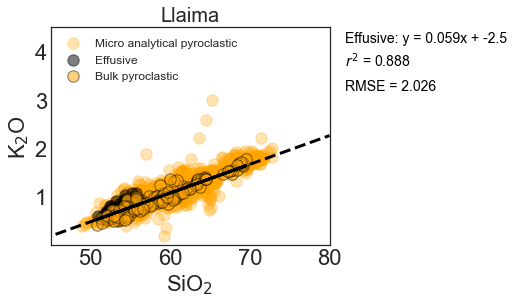

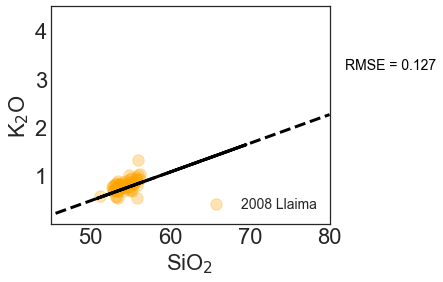

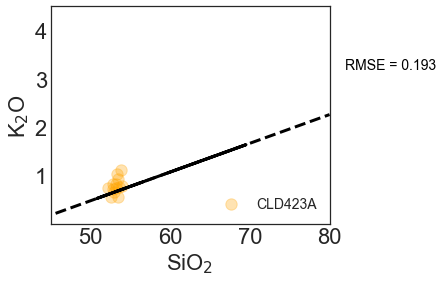

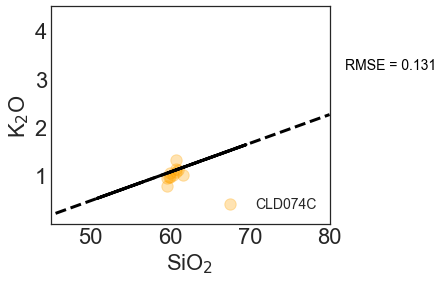

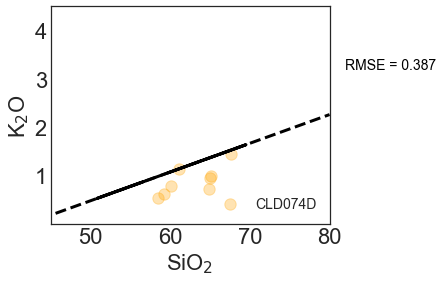

...

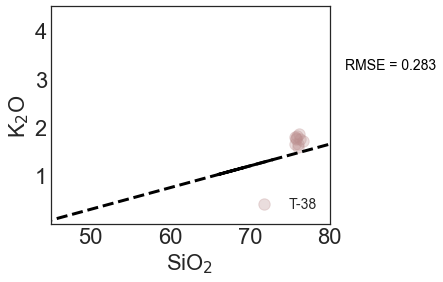

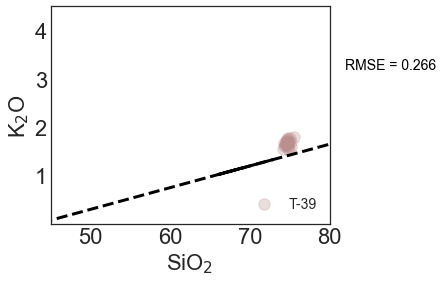

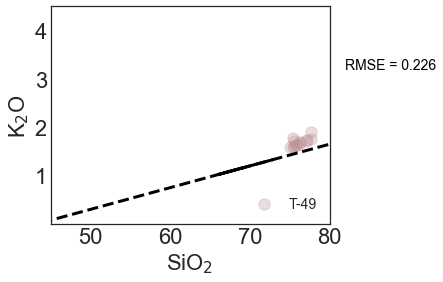

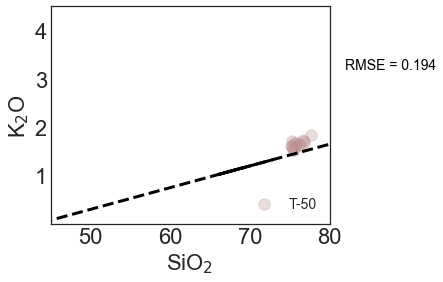

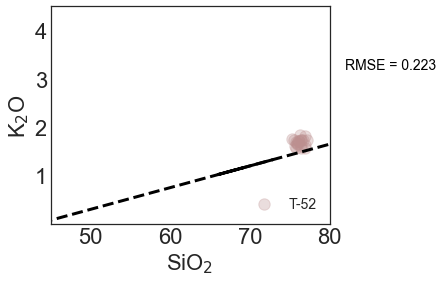

In [34]:
sampleObs_distance_to_fit = pd.DataFrame()
sampleObs_distance_to_fit['Volcano'] = np.nan
sampleObs_distance_to_fit['SampleObservationID'] = Data_glass.SampleObservationID.unique() 
sampleObs_distance_to_fit['SampleObservation_distance_to_regression'] = np.nan

for volcan in fit_info[fit_info['fit case'] != 'Case 0'].Volcano :
    #print(volcan)
    plt.figure(figsize=(5,4));ax = plt.axes()
    Color, Marker  = simbologia(volcan,'Unknown')
    plt.scatter(Data_glass[Data_glass.Volcano == volcan].SiO2,Data_glass[Data_glass.Volcano == volcan].K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label='Micro analytical pyroclastic')
    
    #---------------- plot all 'effusive' or 'bulk pyroclastic' data and regression
    z, rmse, rank, singular_values, rcond = np.polyfit(Data_regression[Data_regression.Volcano == volcan].SiO2,Data_regression[Data_regression.Volcano == volcan].K2O,1,full=True)
    p = np.poly1d(z)
    r2 = r2_score(Data_regression[Data_regression.Volcano == volcan].K2O, p(Data_regression[Data_regression.Volcano == volcan].SiO2))
    plt.scatter(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,color='black',edgecolors ='black',s=130,alpha=0.5,label='Effusive')
    plt.scatter(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,color=Color,edgecolors ='black',s=130,alpha=0.5,label='Bulk pyroclastic')
    plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
    plt.plot(np.array([40,80]),p(np.array([40,80])),color='black',linestyle='--',linewidth=3)
    
    ax.text(82,4.2,"Effusive: y = {}x + {}".format(np.around(z[0],3),np.around(z[1],3)),rotation=0,color='black',fontsize=14)
    ax.text(82,3.7,"$r^{2}$ = "+str(np.around(r2,3)),rotation=0,color='black',fontsize=14)
    ax.text(82,3.2,"RMSE = "+str(np.around(rmse[0],3)),rotation=0,color='black',fontsize=14)    

    leg=plt.legend(fancybox=True,ncol=1,loc='upper left',fontsize=12)
    ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
    plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
    ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
    plt.xlim(45,80);plt.ylim(0,4.5)
    plt.title(volcan, fontsize = 20)
    temp = Data_glass[(Data_glass.Volcano==volcan)]
        
    for sample in temp.SampleID.unique():
        temp2 = temp[temp.SampleID==sample]
        if len(temp2.SiO2)>2:
            #print('.' + sample)
        #print(sample_distance_to_fit[sample_distance_to_fit.SampleID == sample])
         #filter samples with RMSE higher than 0.35 (arbitrary threshold, could change in the future, mainly to higher values)
            #Plot the 'Sample'
            plt.figure(figsize=(5,4));ax = plt.axes()
            plt.scatter(temp2.SiO2,temp2.K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label=sample)
            plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
            plt.plot(np.array([40,80]),p(np.array([40,80])),color='black',linestyle='--',linewidth=3)
            rmse = np.sqrt(mean_squared_error(temp2.K2O, p(temp2.SiO2)))
            ax.text(82,3.2,"RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14) 
        
            leg=plt.legend(fancybox=True,ncol=1,loc='lower right',fontsize=14)
            ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
            plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
            ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
            plt.xlim(45,80);plt.ylim(0,4.5)
                
            for sampleObs in temp2.SampleObservationID.unique().tolist():
                #print('..'+ sampleObs)
                temp3 = temp2[temp2.SampleObservationID==sampleObs]
                a = -z[0]; c = -z[1]; b = 1
                shortestDistance = np.linalg.norm(a*temp3.SiO2+b*temp3.K2O+c)/np.sqrt(a*a+b*b)
                index =  sampleObs_distance_to_fit.index[sampleObs_distance_to_fit.SampleObservationID == sampleObs].tolist()[0]
                
                # save distance of 'SampleObservation' to the regression
                #    if curve is ax + bx + c = 0, then distance of a point to the curve is |aX0 + bx0 + c| / sqrt(a^2 + b^2)) 
                sampleObs_distance_to_fit.loc[index,'SampleObservation_distance_to_regression'] = shortestDistance
                sampleObs_distance_to_fit.loc[index,'Volcano'] = volcan
                
                #Plot the 'SampleObservation'
                #plt.figure(figsize=(5,4));ax = plt.axes()
                #plt.scatter(temp3.SiO2,temp3.K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label=sampleObs)
                #plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
                #ax.text(82,3.2,"Distancia = "+str(np.around(shortestDistance,3)),rotation=0,color='black',fontsize=14) 
                
                #leg=plt.legend(fancybox=True,ncol=1,loc='lower right',fontsize=14)
                #ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
                #plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
                #ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
                #plt.xlim(45,80);plt.ylim(0,4.5)

In [35]:
sampleObs_distance_to_fit.to_excel("../Data/sampleObs_distance_to_fit.xlsx")

In [ ]:
#-------------------- Load data
sampleObs_distance_to_fit = pd.read_excel("../Data/sampleObs_distance_to_fit.xlsx")

In [ ]:
sampleObs_distance_to_fit = sampleObs_distance_to_fit.dropna(subset=['Volcano'])
fig = px.scatter(sampleObs_distance_to_fit, sampleObs_distance_to_fit.Volcano, sampleObs_distance_to_fit.SampleObservation_distance_to_regression,
                 color = 'Volcano', hover_data = ['SampleObservationID','SampleObservation_distance_to_regression'],width=800, height=500)
fig.show()